In [1]:
%matplotlib inline
import pandas as pd
import matplotlib.pyplot as plt
import mpl_toolkits.mplot3d.axes3d as p3
from matplotlib import colors as c
import sklearn as sk
import numpy as np
from numpy import linalg as LA
import warnings

from sklearn.metrics import precision_recall_fscore_support,recall_score,precision_score

from sklearn.feature_selection import mutual_info_classif, RFE, SelectKBest

from sklearn.decomposition import PCA,FactorAnalysis
# Manifold
from sklearn.manifold import TSNE,Isomap,LocallyLinearEmbedding,SpectralEmbedding

from sklearn.preprocessing import Imputer,scale,MinMaxScaler,StandardScaler
# Regression
from sklearn.linear_model import LinearRegression,LogisticRegression
# SVM
from sklearn.svm import SVC,LinearSVC
# N Bayes
from sklearn.naive_bayes import GaussianNB
# Forests
from sklearn.ensemble import RandomForestClassifier,ExtraTreesClassifier

from sklearn.model_selection import train_test_split, KFold,cross_val_score

from sklearn.metrics import confusion_matrix,precision_recall_curve,average_precision_score
import sklearn.metrics as met
import seaborn as sns
sns.set(color_codes=True)
from scipy import stats
import math as mt
import scipy as sp
import statsmodels as sm
import seaborn as sb
import time
#import statistics
from boruta import BorutaPy
warnings.simplefilter('ignore')
import missingno as mno
#-------Importing External Functions 

from Functions.Imputer.imputation import get_indices_of_missing_param,get_means,get_means_list,replacing_missing,get_median,get_median_list,get_mode_list,get_lists_of_values_for_each_class

from Functions.DataAnalysis.fittings import get_best_fitting
from Functions.Imputer.delete_features import delete_column,delete_row

# -----
import json

# Machine Learning 
## " Classification of cardiac arrhythmia using ECG data "
### Studente: Antonio Cruciani



# Indice <a id="indice"></a>
   * #### <a href="#DataAnalysis" style="text-decoration:none;"> Analisi del dataset </a>
       * #### <a href="#Test" style="text-decoration:none;"> Test di significatività </a>
           * #### <a href="#AgeTest" style="text-decoration:none;"> Test chi quadro sull' età dei pazienti </a>
           * #### <a href="#SexTest" style="text-decoration:none;"> Test chi quadro sull' sesso dei pazienti </a>
           * #### <a href="#WeightTest" style="text-decoration:none;"> Test chi quadro sull' pesoforma e peso dei pazienti </a>
           * #### <a href="#QRSTTest" style="text-decoration:none;"> Test chi quadro sui valori QRST dei pazienti </a>
           
           * #### <a href="#Congiunte" style="text-decoration:none;"> Plotting delle distribuzioni congiunte delle features studiate nei test di significatività </a>
        
       * #### <a href="#Imputation" style="text-decoration:none;"> Gestione dei dati mancanti </a>
            * #### <a href="#Delete" style="text-decoration:none;"> Cancellazioni delle features incomplete </a>
            * #### <a href="#Mean" style="text-decoration:none;"> Imputation con valor medio </a>
            * #### <a href="#Median" style="text-decoration:none;"> Imputation con mediano </a>
            * #### <a href="#Mode" style="text-decoration:none;"> Imputation con la moda </a>
            * #### <a href="#DReg" style="text-decoration:none;"> Imputation con Regressione Deterministica </a>
            * #### <a href="#SReg" style="text-decoration:none;"> Imputation con Regressione Stocastica </a>
       * #### <a href="#Distributions" style="text-decoration:none;"> Studio delle distribuzioni delle features più informative dei dataset ottenuti mediante imputation </a>
       
       * #### <a href="#PCAMANI" style="text-decoration:none;"> Visualizzazione dei dati mediante Principal Component Analysis e Metodi Manifolds</a>
  
* #### <a href="#LearningMulti" style="text-decoration:none;"> Applicazione di Algoritmi di Learning per risolvere il task di multiclassificazione</a>
    * #### <a href="#SVM" style="text-decoration:none;"> Support Vector Machines</a>
        
        * #### <a href="#SVMAccuracy" style="text-decoration:none;"> Accuracy sul Test</a>
        
        * #### <a href="#SVMRecall" style="text-decoration:none;"> Recall sul Test</a>
        * #### <a href="#SVMPrecision" style="text-decoration:none;"> Precision sul Test</a>
     
    * #### <a href="#Ensemble" style="text-decoration:none;"> Ensemble Learning</a>
        * #### <a href="#RF" style="text-decoration:none;"> Random Forest</a>
            * #### <a href="#PRF" style="text-decoration:none;"> Precision e Recall su ogni singola classe con Pearson Correlation per la Feature Selection</a>
                * #### <a href="#ACPRF" style="text-decoration:none;"> Accuracy, Precision e Recall con Pearson Correlation per la Feature Selection</a>
            * #### <a href="#RFERF" style="text-decoration:none;"> Precision e Recall su ogni singola classe con Recursive Feature Elimination per la Feature Selection</a>
                * #### <a href="#ACRFERF" style="text-decoration:none;"> Accuracy, Precision e Recall con RFE per la Feature Selection</a>
            * #### <a href="#PCARF" style="text-decoration:none;"> Precision e Recall su ogni singola classe con PCA </a>
                * #### <a href="#ACPCARF" style="text-decoration:none;"> Accuracy, Precision e Recall con PCA </a>
            * #### <a href="#NOFSRF" style="text-decoration:none;"> Precision e Recall su ogni singola classe senza trattamento delle feature</a>
                * #### <a href="#NOFSACCRF" style="text-decoration:none;"> Accuracy, Precision e Recall </a>
            * #### <a href="#SUMMARYRF" style="text-decoration:none;"> Confronto tra le performance dei diversi approcci utilizzati in questa sezione </a>
        * #### <a href="#BOOST" style="text-decoration:none;"> Algoritmi di Boosting</a>
            * #### <a href="#BOOSTNOFS" style="text-decoration:none;"> Boosting senza Feature Selection </a>
                * #### <a href="#BOOSTNOFSSCORES" style="text-decoration:none;"> Risultati e confronti tra i diversi Algoritmi di Boosting senza Feature Selection in termini di Accuracy, Precision e Recall </a>
            * #### <a href="#BOOSTPEAR" style="text-decoration:none;"> Boosting con Pearson Correlation per la Feature Selection </a>
                * #### <a href="#BOOSTPEARSCORES" style="text-decoration:none;"> Risultati e confronti tra i diversi Algoritmi di Boosting utilizzando Pearson Correlation per la Feature Selection in termini di Accuracy, Precision e Recall </a>
            * #### <a href="#BOOSTRFE" style="text-decoration:none;"> Boosting con RFE per la Feature Selection </a>
                * #### <a href="#BOOSTRFESCORES" style="text-decoration:none;"> Risultati e confronti tra i diversi Algoritmi di Boosting utilizzando RFE per la Feature Selection in termini di Accuracy, Precision e Recall </a>
            * #### <a href="#BOOSTPCA" style="text-decoration:none;"> Boosting utilizzando PCA  </a>
                * #### <a href="#BOOSTPCASCORES" style="text-decoration:none;"> Risultati e confronti tra i diversi Algoritmi di Boosting utilizzando PCA in termini di Accuracy, Precision e Recall </a>
            * #### <a href="#SUMMARYBOOST" style="text-decoration:none;"> Confronto tra le performance dei diversi approcci utilizzati in questa sezione </a>
    * #### <a href="#KNN" style="text-decoration:none;"> K-Nearest Neighbour</a>
         * #### <a href="#KNNPRECREC" style="text-decoration:none;"> Precision e Recall sulle singole classi per ogni dataset utilizzando Feature Selection, PCA con il dataset originale</a>
         * #### <a href="#KNNAPR" style="text-decoration:none;"> Confronto tra le Accuracy,Precision e Recall per ogni dataset e per ogni tipo di analisi delle Features  </a>
         * #### <a href="#KNNSUMMARY" style="text-decoration:none;"> Confronto tra le Accuracy utilizzando analsi delle Features differenti </a>
    
    * #### <a href="#Logistic" style="text-decoration:none;"> Logistic Regression</a>
         * #### <a href="#LogPrecisionRecallAccuracy" style="text-decoration:none;"> Precision, Recall e Accuracy per ogni dataset e tipo di analisi delle Features</a>
         * #### <a href="#LogSummaryAccuracy" style="text-decoration:none;"> Confronto tra le Accuracy delle tecniche utilizzate in questa sezione</a>
         * #### <a href="#LogSummaryRecall" style="text-decoration:none;"> Confronto tra le Recall delle tecniche utilizzate in questa sezione</a>
         * #### <a href="#LogSummaryPrecision" style="text-decoration:none;"> Confronto tra le Precision delle tecniche utilizzate in questa sezione</a>
    * #### <a href="#MLP" style="text-decoration:none;"> Multilayer Perceptron</a>
         * #### <a href="#MLPScores" style="text-decoration:none;"> Accuracy MLP sui diversi tipi di datasets</a>
    * #### <a href="#FinalMulticlass" style="text-decoration:none;"> Tabelle dei confronti dei diversi algoritmi di Learning applicati in questa sezione</a>

* #### <a href="#TwoClassifierArch" style="text-decoration:none;"> Approccio al problema utilizzando un'architettutura a due classificatori</a>
    * #### <a href="#Why" style="text-decoration:none;"> Descrizione dell'idea</a>
    * #### <a href="#DatasetTransformation" style="text-decoration:none;"> Preprocessing dei dati e trasformazione del dataset</a>
    * #### <a href="#Binary" style="text-decoration:none;"> Modelli di Learning per le due fasi</a>
         * #### <a href="#SVMB" style="text-decoration:none;"> SVM per capire se un paziente è malato o meno</a>
             * #### <a href="#SCORESVMB" style="text-decoration:none;"> Accuracy, Precision e Recall</a>
         * #### <a href="#SVMM" style="text-decoration:none;"> SVM per Classificare il tipo di aritmia </a>
             * #### <a href="#SCORESVMM" style="text-decoration:none;"> Accuracy, Precision e Recall</a>
         * #### <a href="#KNNB" style="text-decoration:none;"> K-NN per capire se un paziente è malato o meno</a>
         * #### <a href="#KNNM" style="text-decoration:none;"> K-NN per Classificare il tipo di aritmia </a>
         * #### <a href="#LREGB" style="text-decoration:none;"> Logistic Regression per capire se un paziente è malato o meno</a>
             * #### <a href="#SCORELREGB" style="text-decoration:none;"> Accuracy, Precision e Recall</a>
         * #### <a href="#LREGM" style="text-decoration:none;"> Logistic Regression per Classificare il tipo di aritmia </a>
             * #### <a href="#SCORELREGM" style="text-decoration:none;"> Accuracy, Precision e Recall</a>
         * #### <a href="#RFB" style="text-decoration:none;"> Random Forest per capire se un paziente è malato o meno</a>
             * #### <a href="#SCORERFB" style="text-decoration:none;"> Accuracy, Precision e Recall</a>
         * #### <a href="#RFM" style="text-decoration:none;"> Random Forest per Classificare il tipo di aritmia</a>
             * #### <a href="#SCORERFM" style="text-decoration:none;"> Accuracy, Precision e Recall</a>
         * #### <a href="#BOOSTB" style="text-decoration:none;">Algoritmi di Boosting per capire se un paziente è malato o meno</a>
         * #### <a href="#BOOSTM" style="text-decoration:none;"> Algoritmi di Boosting per Classificare il tipo di aritmia</a>
         * #### <a href="#MLPB" style="text-decoration:none;">MLP per capire se un paziente è malato o meno</a>
         * #### <a href="#MLPM" style="text-decoration:none;"> MLP per Classificare il tipo di aritmia</a>
         
    * #### <a href="#FinalChoice" style="text-decoration:none;"> Analisi delle performance e scelta dei due classificatori per l'architettura</a>




<a id="DataAnalysis"></a>
<h3> Analisi del dataset <a href="#indice" style="text-decoration:none;">↑</a></h3>




Il dataset usato in questo progetto è disponibile sull' UCI machine learning algorithm. Esso può essere trovato al seguente indirizzo: https://archive.ics.uci.edu/ml/datasets/Arrhythmia. Consiste di 452 esmpi differenti distribuiti su 16 classi. Dei 452 esempi, 245 sono di persone "normali". Abbiamo, inoltre, 12 tipi differenti di aritmie. Tra tutti questi tipi di aritmie, i più rappresentativi sono la "coronary artery desease" e "Rjgbt boundle branch block".

Abbiamo 279 features, le quali includo età, sesso, peso, altezza dei pazienti e le relative informaizoni derivanti dall'elettrocardiogramma. Osseviamo esplicitamente che il numero di features è relativamente elevato in confronto al numero di esempi di cui siamo a disposizione.


# Workflow:
Descriviamo brevemente i punti fondamentali del nostro workflow:

                1) Analisi del dataset statistiche del dataset
                2) Preprocessing dei dati 
                3) Definizione di modelli predittivi

# Importazione dataset

## Sommario dataset fornito dal sito 

### Attribute documentation



1 Age: Age in years , linear 

2 Sex: Sex (0 = male; 1 = female) , nominal 

3 Height: Height in centimeters , linear 

4 Weight: Weight in kilograms , linear 

5 QRS duration: Average of QRS duration in msec., linear 

6 P-R interval: Average duration between onset of P and Q waves in msec., linear 

7 Q-T interval: Average duration between onset of Q and offset of T waves in msec., linear 

8 T interval: Average duration of T wave in msec., linear 

9 P interval: Average duration of P wave in msec., linear 


Vector angles in degrees on front plane of:, linear 

10 QRS 

11 T 

12 P 

13 QRST 

14 J 


15 Heart rate: Number of heart beats per minute ,linear 

Of channel DI: 
Average width, in msec., of: linear 

16 Q wave 

17 R wave 

18 S wave 

19 R' wave, small peak just after R 

20 S' wave 


21 Number of intrinsic deflections, linear 


22 Existence of ragged R wave, nominal 

23 Existence of diphasic derivation of R wave, nominal 

24 Existence of ragged P wave, nominal 

25 Existence of diphasic derivation of P wave, nominal 

26 Existence of ragged T wave, nominal 

27 Existence of diphasic derivation of T wave, nominal 


Of channel DII: 

28 .. 39 (similar to 16 .. 27 of channel DI) 

Of channels DIII: 

40 .. 51 

Of channel AVR: 

52 .. 63 

Of channel AVL: 

64 .. 75 

Of channel AVF: 

76 .. 87 

Of channel V1: 

88 .. 99 

Of channel V2: 

100 .. 111 

Of channel V3: 

112 .. 123 

Of channel V4: 

124 .. 135 

Of channel V5: 

136 .. 147 

Of channel V6: 

148 .. 159 


Of channel DI: 

Amplitude , * 0.1 milivolt, of 

160 JJ wave, linear 

161 Q wave, linear 

162 R wave, linear 

163 S wave, linear 

164 R' wave, linear 

165 S' wave, linear 

166 P wave, linear 

167 T wave, linear 


168 QRSA , Sum of areas of all segments divided by 10, ( Area= width * height / 2 ), linear 

169 QRSTA = QRSA + 0.5 * width of T wave * 0.1 * height of T wave. (If T is diphasic then the bigger segment is considered), linear 


Of channel DII: 
170 .. 179 

Of channel DIII: 
180 .. 189 

Of channel AVR: 
190 .. 199 

Of channel AVL: 
200 .. 209 

Of channel AVF: 
210 .. 219 

Of channel V1: 
220 .. 229 

Of channel V2: 
230 .. 239 

Of channel V3: 
240 .. 249 

Of channel V4: 
250 .. 259 

Of channel V5: 
260 .. 269 

Of channel V6: 
270 .. 279

## Class distribution

Database:  Arrhythmia
       
       Class code :   Class   :                       Number of instances:
       01             Normal				          245
       02             Ischemic changes (Coronary Artery Disease)   44
       03             Old Anterior Myocardial Infarction           15
       04             Old Inferior Myocardial Infarction           15
       05             Sinus tachycardy			           13
       06             Sinus bradycardy			           25
       07             Ventricular Premature Contraction (PVC)       3
       08             Supraventricular Premature Contraction	    2
       09             Left bundle branch block 		            9	
       10             Right bundle branch block		           50
       11             1. degree AtrioVentricular block	            0	
       12             2. degree AV block		            0
       13             3. degree AV block		            0
       14             Left ventricule hypertrophy 	            4
       15             Atrial Fibrillation or Flutter	            5
       16             Others				           22




In [2]:
#Importo dataset
#Nomi delle caratteristiche (F_i)
header = ["F_"+str(i) for i in range(0,278+1)]
#Inserisco la colonna per il target
header.append("t")
features_name =["Age","Sex","Height_cm","Weight_kg","QRS_Duration","PR_interval","QT_Interval",
                 "T_Interval","P_interval","QRS","T","P","QRST","J","Heart_rate","Q_WAVE","R_WAVE","S_WAVE","R_1_Wave","S_1_Wave"
                ,"Number_of_intrinsic_deflections","E_Ragged_RWAVE","Existence_diphasic_derivation_R_wave","Existence_of_ragged_P_wave"
                ,"Existence_diphasic_derivation_P_wave"," Existence_ragged_T_wave","Existence_diphasic_derivation_T_wave"]


f_n = features_name + header[27:]
#Importo dataset
data = pd.read_csv("dataset.csv",header = None, delimiter=',',names=f_n)

In [3]:
data.head()

,Age,Sex,Height_cm,Weight_kg,QRS_Duration,PR_interval,QT_Interval,T_Interval,P_interval,QRS,...,F_270,F_271,F_272,F_273,F_274,F_275,F_276,F_277,F_278,t
0,75,0,190,80,91,193,371,174,121,-16,...,0.0,9.0,-0.9,0.0,0.0,0.9,2.9,23.3,49.4,8
1,56,1,165,64,81,174,401,149,39,25,...,0.0,8.5,0.0,0.0,0.0,0.2,2.1,20.4,38.8,6
2,54,0,172,95,138,163,386,185,102,96,...,0.0,9.5,-2.4,0.0,0.0,0.3,3.4,12.3,49.0,10
3,55,0,175,94,100,202,380,179,143,28,...,0.0,12.2,-2.2,0.0,0.0,0.4,2.6,34.6,61.6,1
4,75,0,190,80,88,181,360,177,103,-16,...,0.0,13.1,-3.6,0.0,0.0,-0.1,3.9,25.4,62.8,7


In [4]:
#Lista con nomi delle classi 
class_names = ["Normal", 
               "Ischemic changes (CAD)", 
               "Old Anterior Myocardial Infraction",
               "Old Inferior Myocardial Infraction",
               "Sinus tachycardy", 
               "Sinus bradycardy", 
               "Ventricular Premature Contraction (PVC)",
               "Supraventricular Premature Contraction",
               "Left Boundle branch block",
               "Right boundle branch block",
               "1.Degree AtrioVentricular block",
               "2.Degree AV block",
               "3.Degree AV block",
               "Left Ventricule hypertrophy",
               "Atrial Fibrillation or Flutter",
               "Others"]

In [5]:
#Dimensioni della matrice delle caratteristiche
data.shape

(452, 280)

# Analisi del dataset

## Visualizzazione dei dati

Come prima cosa analizziamo il dataset e andiamo a controllare quanti esempi abbiamo per ogni classe

In [6]:
data.loc[:,["Age","Heart_rate"]].dtypes

Age            int64
Heart_rate    object
dtype: object

In [7]:
la = data['t'].value_counts(sort=False).tolist()

In [8]:
#data['Age'].value_counts(sort=False

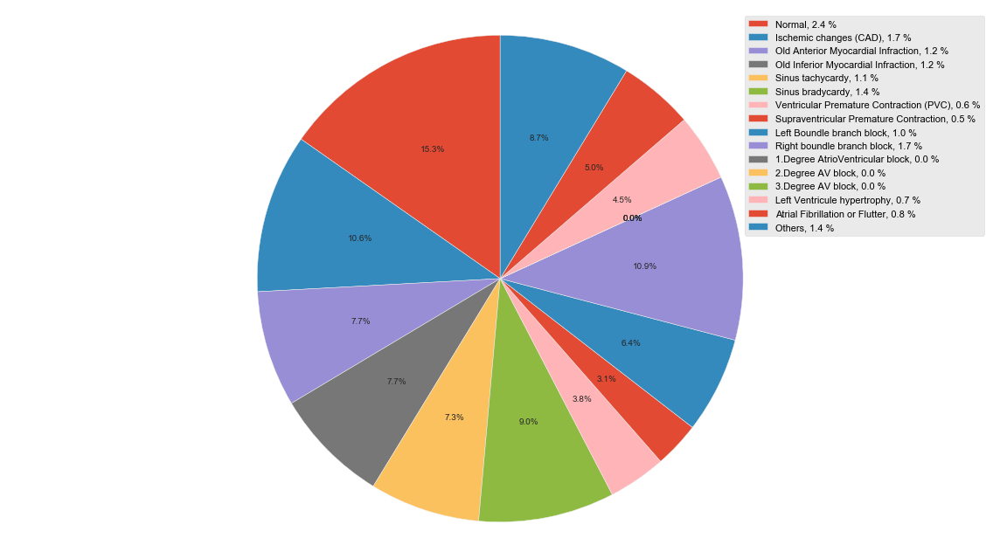

In [11]:
# Grafico a torta delle classi
# Mostriamo la percentuale di campioni per classe
la = data['t'].value_counts(sort=False).tolist()
labels = class_names
values = la[0:10] + [0,0,0] + la[10:13]
#Normalizzo i dati con logaritmo base 10 per poterli "plottare in modo decente"
Log_Norm = []
for i in values:
    Log_Norm.append(mt.log10(i+1))
fig1, ax1 = plt.subplots(figsize=(16,9))
patches = plt.pie(Log_Norm, autopct='%1.1f%%', startangle=90)

leg = plt.legend( loc = 'left', labels=['%s, %1.1f %%' % (l, s) for l, s in zip(labels, Log_Norm)])
plt.axis('equal')

for text in leg.get_texts():
    plt.setp(text, color = 'Black')
plt.tight_layout()
plt.show()


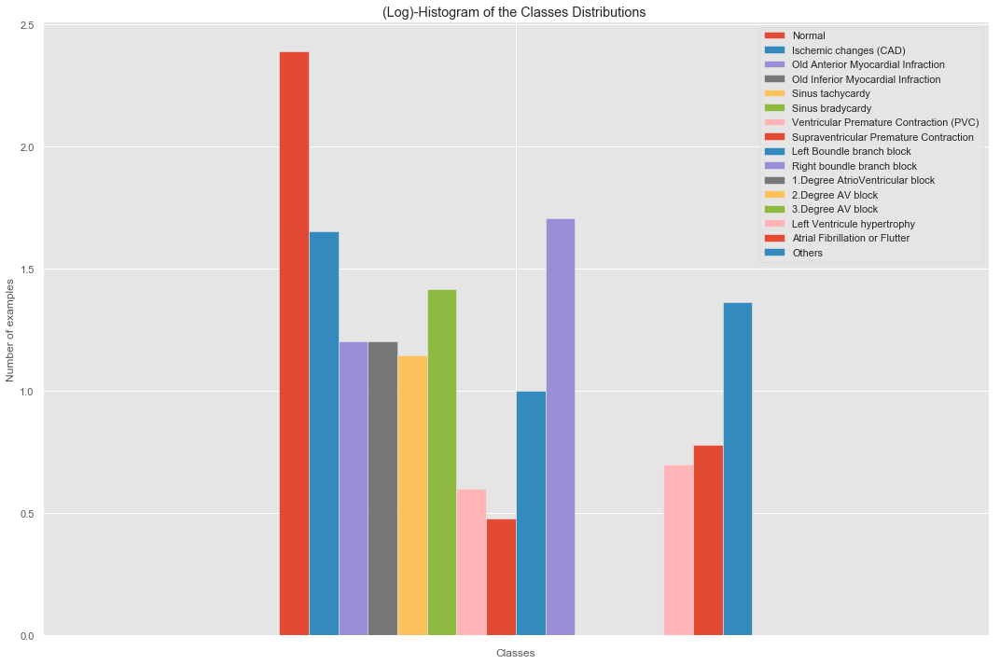

In [9]:
fdict = {}
j = 0
for i in labels:
    fdict[i] = Log_Norm[j]
    j+=1
fdf = pd.DataFrame(fdict,index=[0])
fdf = fdf.rename(index={0: ''})
fig, ax = plt.subplots(figsize=(15,10))
fdf.plot(kind="bar",ax=ax)
ax.set_title("(Log)-Histogram of the Classes Distributions ")
ax.set_ylabel('Number of examples')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()

In [10]:
grouped_mean = data.groupby(["t"]).mean()
grouped_median = data.groupby(["t"]).median()
grouped_mode = data.groupby(["t"]).agg(lambda x: sp.stats.mode(x)[0])
gouped_std = data.groupby(['t']).std()

In [19]:
grouped_median.head()

,Age,Sex,Height_cm,Weight_kg,QRS_Duration,PR_interval,QT_Interval,T_Interval,P_interval,QRS,...,F_269,F_270,F_271,F_272,F_273,F_274,F_275,F_276,F_277,F_278
t,,,,,,,,,,,,,,,,,,,,,
1,46.0,1.0,163.0,68.0,84.0,156.0,367.0,160.0,91.0,41.0,...,-0.1,0.0,9.1,-0.9,0.0,0.0,0.5,1.6,19.10,31.7
2,55.0,1.0,160.5,70.0,90.5,159.0,366.0,176.5,91.0,37.5,...,-0.8,0.0,9.6,-1.3,0.0,0.0,0.5,-0.8,20.05,11.8
3,50.0,0.0,170.0,74.0,93.0,163.0,351.0,196.0,96.0,48.0,...,-0.2,0.0,6.3,-2.0,0.0,0.0,0.8,0.6,12.30,19.3
4,57.0,0.0,165.0,76.0,93.0,157.0,357.0,161.0,95.0,-2.0,...,-0.2,-0.7,6.3,-0.5,0.0,0.0,0.7,0.3,10.90,12.0
5,34.0,1.0,160.0,51.0,82.0,155.0,302.0,153.0,81.0,52.0,...,-0.3,0.0,5.1,-2.1,0.0,0.0,0.5,0.9,6.00,10.7


In [12]:
# Funzione per i test chi quadro
def get_chisquared_list(lista_sani,feature,operator,data,soglia = None):
    lista_risultati = []
    lista_tabelle_contingenza =[]
    for x in range(2,17):
        if operator == ">":
            maschi_malati = data[(data['t']==x)&(data[feature]<soglia)].count()[0]
            femmine_malate = data[(data['t']==x)&(data[feature]>=soglia)].count()[0]
            table= [[lista_sani[0],maschi_malati],[lista_sani[1],femmine_malate]]
        else:
            maschi_malati = data[(data['t']==x)&(data[feature]==0)].count()[0]
            femmine_malate = data[(data['t']==x)&(data[feature]==1)].count()[0]
            table= [[lista_sani[0],maschi_malati],[lista_sani[1],femmine_malate]]
        if(lista_sani[0]!=0 and lista_sani[1]!=0 and maschi_malati !=0 and femmine_malate!=0):
            lista_tabelle_contingenza.append([class_names[x-1],table])
            stat, p, dof, expected = sp.stats.chi2_contingency(table)
            # interpret p-value
            prob = 0.95
            alpha = 1.0 - prob
            if p <= alpha:
                lista_risultati.append([class_names[x-1],'Dipendente (Rigetto H0)',True])

            else:
                 lista_risultati.append([class_names[x-1],'Indipendente (Non posso rigettare H0)',False])
    return lista_risultati,lista_tabelle_contingenza
    

<a id="Test"></a>
<h3> Test di significativatà <a href="#indice" style="text-decoration:none;">↑</a></h3>


<a id="AgeTest"></a>
<h3> Test chi quadro sull' età dei pazienti  <a href="#indice" style="text-decoration:none;">↑</a></h3>


##### Siamo interessati a capire se l'età delle persone influisce sulla loro condizione fisica

In [13]:
lista_classi = []
j = 1
new_class_names =[]
for i in class_names:
   
    if(i != "1.Degree AtrioVentricular block" and i!= '3.Degree AV block' and i!= "2.Degree AV block"  ):
        lista_classi.append([j,i,grouped_mean["Age"][j],grouped_median["Age"][j],grouped_mode["Age"][j],gouped_std["Age"][j]])
        new_class_names.append(i)
    j+=1
AgeClass = {
    "AgeAVG": grouped_mean["Age"],"AgeMdian":grouped_median["Age"],
            "AgeMode": grouped_mode["Age"],"AgeStd":gouped_std['Age'],"Class":new_class_names }
AgeClassDF =pd.DataFrame(AgeClass)

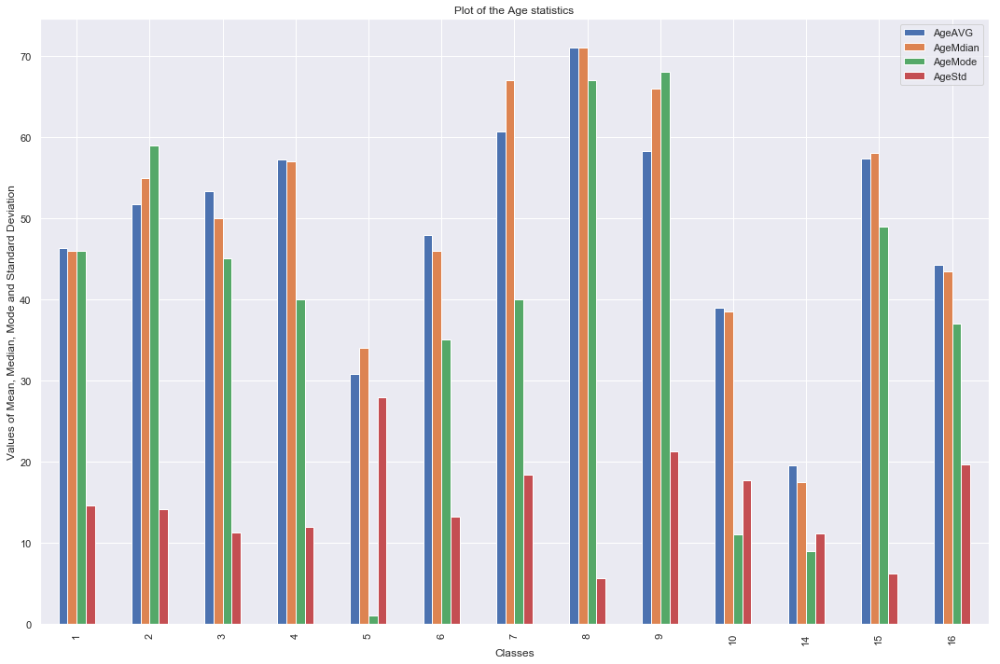

,AgeAVG,AgeMdian,AgeMode,AgeStd,Class
t,,,,,
1,46.273469,46.0,46,14.556092,Normal
2,51.750000,55.0,59,14.160418,Ischemic changes (CAD)
3,53.333333,50.0,45,11.286317,Old Anterior Myocardial Infraction
4,57.266667,57.0,40,11.895177,Old Inferior Myocardial Infraction
5,30.846154,34.0,1,27.904140,Sinus tachycardy
6,47.920000,46.0,35,13.165359,Sinus bradycardy
7,60.666667,67.0,40,18.339393,Ventricular Premature Contraction (PVC)
8,71.000000,71.0,67,5.656854,Supraventricular Premature Contraction
9,58.222222,66.0,68,21.211894,Left Boundle branch block


In [14]:
fig, ax = plt.subplots(figsize=(15,10))
AgeClassDF.plot(kind="bar",ax=ax)
ax.set_title("Plot of the Age statistics")
ax.set_ylabel('Values of Mean, Median, Mode and Standard Deviation')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
AgeClassDF

Facciamo un fitting tra la distribuzione dei dati e la distribuzione empirica che più si adatta a tali dati

Miglior distribuzione  genextreme(c=0.39, loc=41.48, scale=17.23)


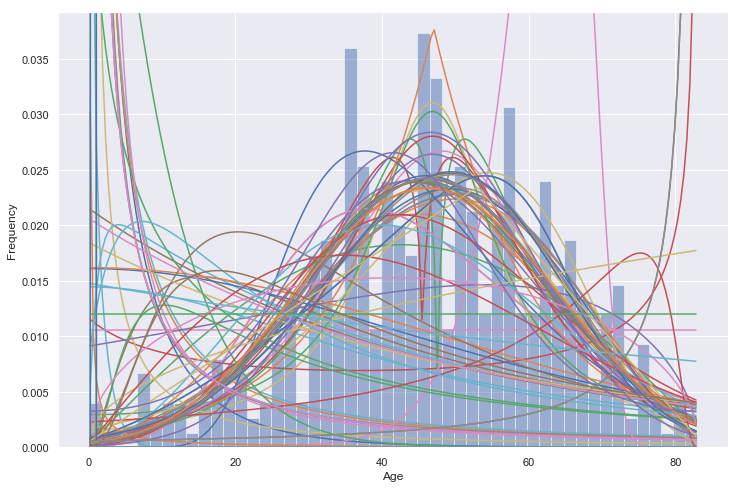

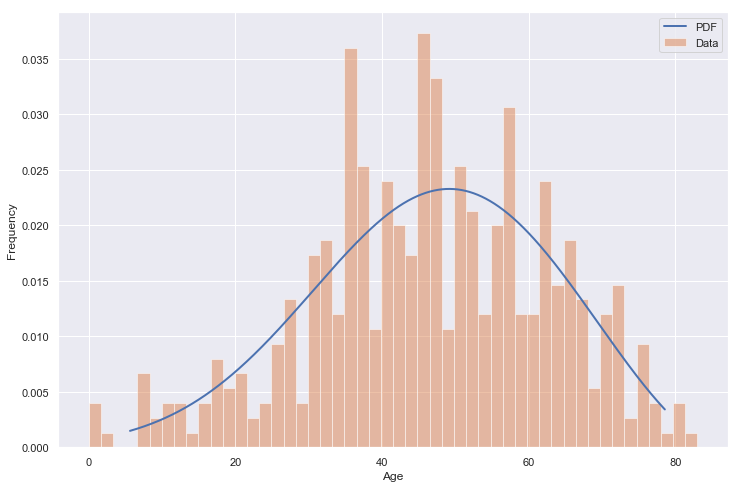

In [24]:
get_best_fitting(data['Age'],'Age')

Definiamo una soglia di eta per la quale consideriamo un individuo anziano
Dato un individuo x diremo che x è anziano se la sua età è superiore a 50 anni

Prepariamo il necessario per il test chi-quadro

In [15]:
soglia_vecchiaia = 50

In [16]:
giovani_sani = data[(data['t'] ==1) & (data['Age'] < soglia_vecchiaia)].count()[0]
vecchi_sane = data[(data['t'] ==1) & (data['Age'] >= soglia_vecchiaia)].count()[0]
risultati_eta,tabelle_eta = get_chisquared_list([giovani_sani,vecchi_sane],'Age','>',data,soglia_vecchiaia)

In [17]:
for i in risultati_eta:
    print("Test per la classe = ",i[0], " Risultato del test = ", i[1])

Test per la classe =  Ischemic changes (CAD)  Risultato del test =  Dipendente (Rigetto H0)
Test per la classe =  Old Anterior Myocardial Infraction  Risultato del test =  Indipendente (Non posso rigettare H0)
Test per la classe =  Old Inferior Myocardial Infraction  Risultato del test =  Dipendente (Rigetto H0)
Test per la classe =  Sinus tachycardy  Risultato del test =  Indipendente (Non posso rigettare H0)
Test per la classe =  Sinus bradycardy  Risultato del test =  Indipendente (Non posso rigettare H0)
Test per la classe =  Ventricular Premature Contraction (PVC)  Risultato del test =  Indipendente (Non posso rigettare H0)
Test per la classe =  Left Boundle branch block  Risultato del test =  Dipendente (Rigetto H0)
Test per la classe =  Right boundle branch block  Risultato del test =  Indipendente (Non posso rigettare H0)
Test per la classe =  Atrial Fibrillation or Flutter  Risultato del test =  Indipendente (Non posso rigettare H0)
Test per la classe =  Others  Risultato del 

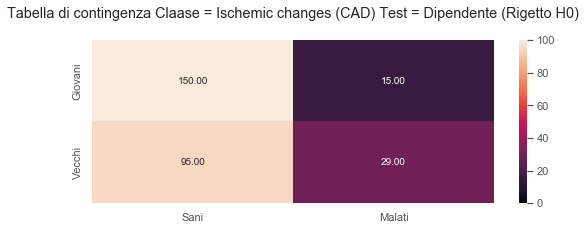

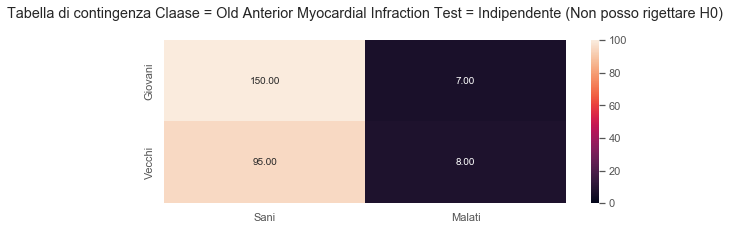

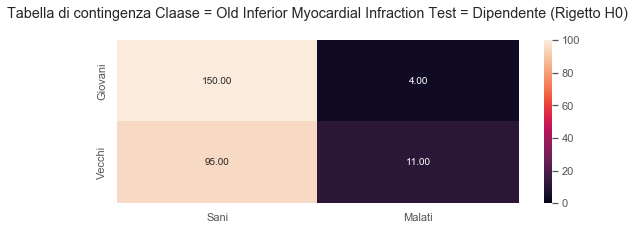

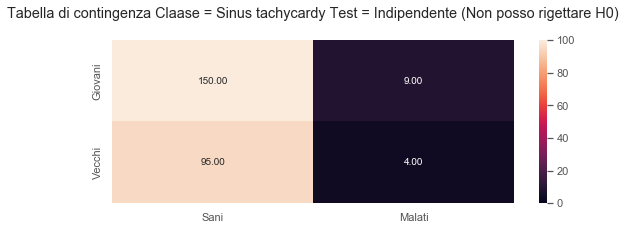

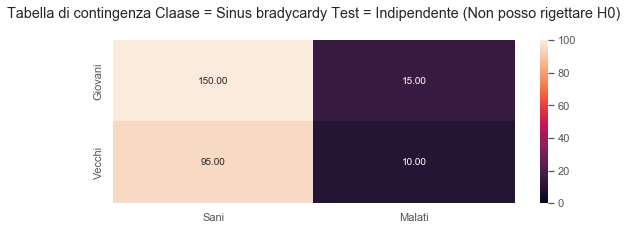

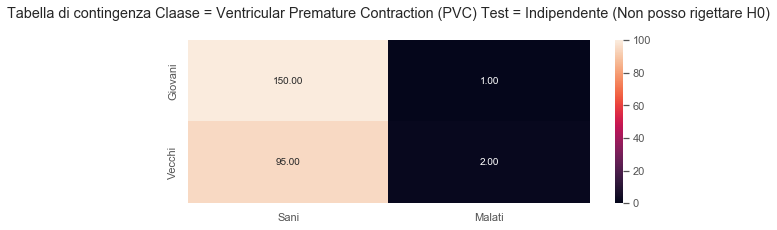

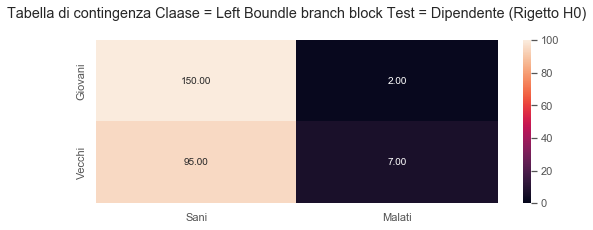

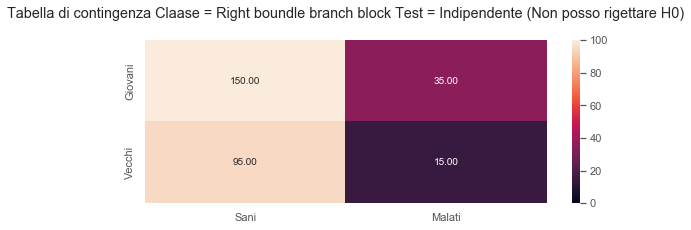

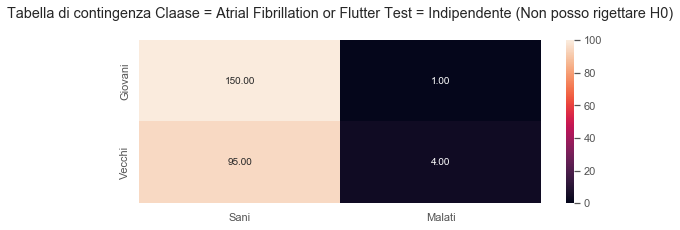

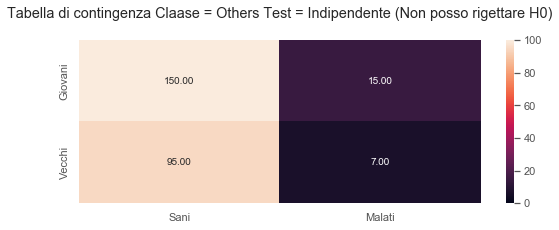

In [17]:
j = 131
for i in range(0,len(tabelle_eta)):
    df_cm = pd.DataFrame(tabelle_eta[i][1], 
                      index = ['Giovani', 'Vecchi'],
                      columns = ['Sani', 'Malati'])
    
    plt.figure(figsize=(9, 3))
    #plt.subplot(j)
    j+=1
    res = sns.heatmap(df_cm, annot=True, vmin=0.0, vmax=100.0, fmt='.2f')
    plt.yticks([0.5,1.5], ['Giovani', 'Vecchi'],va='center')
    
    plt.title('Tabella di contingenza Claase = '+risultati_eta[i][0]+ " Test = " +risultati_eta[i][1]+'\n')
    


<a id="SexTest"></a>
<h3> Test chi quadro sul sesso dei pazienti  <a href="#indice" style="text-decoration:none;">↑</a></h3>


##### Siamo interessati a capire se il sesso delle persone influisce sulla loro condizione 

Impostiamo i test chi-quadro per capire se il sesso del paziente influisce o meno sulla condizione del paziente

Possiamo effettuare un test di significatività.
Dove andiamo a confrontare i di malati di una certa aritmia cardiaca e i non malati per sesso. 
Prima però andiamo ad analizzare le statistiche base dei maschi e delle femmine

In [18]:
lista_classi = []
j = 1
new_class_names =[]
for i in class_names:
   
    if(i != "1.Degree AtrioVentricular block" and i!= '3.Degree AV block' and i!= "2.Degree AV block"  ):
        lista_classi.append([j,i,grouped_mean["Sex"][j],grouped_median["Sex"][j],grouped_mode["Sex"][j],gouped_std["Sex"][j]])
        new_class_names.append(i)
    j+=1
SexClass = {
    "SexAVG": grouped_mean["Sex"],"SexMdian":grouped_median["Sex"],
            "SexMode": grouped_mode["Sex"],"SexStd":gouped_std['Sex'],"Class":new_class_names }
SexClassDF =pd.DataFrame(SexClass)

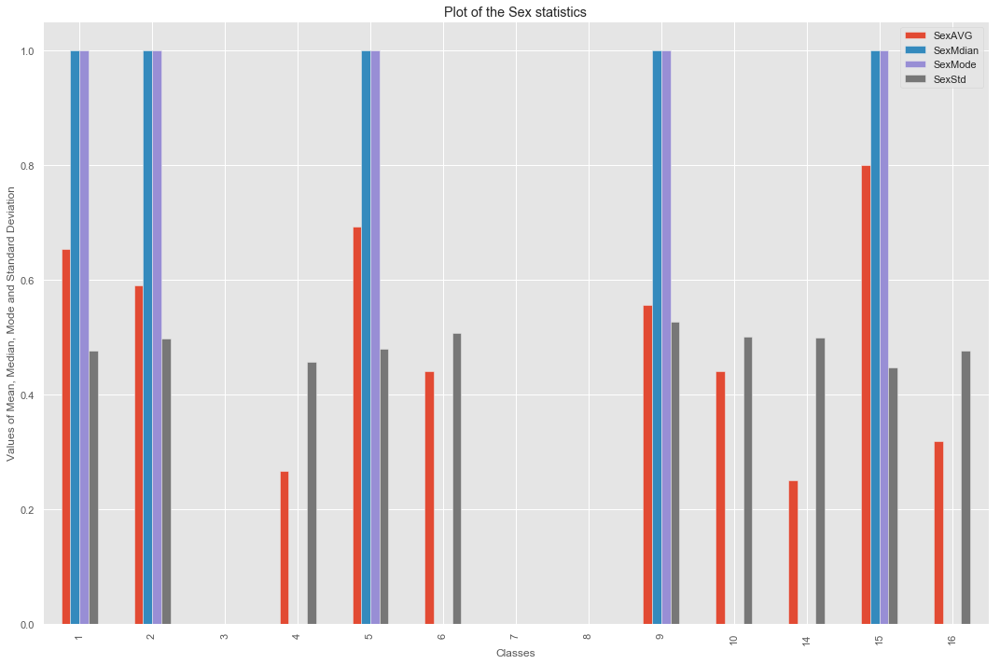

,SexAVG,SexMdian,SexMode,SexStd,Class
t,,,,,
1,0.653061,1.0,1,0.476970,Normal
2,0.590909,1.0,1,0.497350,Ischemic changes (CAD)
3,0.000000,0.0,0,0.000000,Old Anterior Myocardial Infraction
4,0.266667,0.0,0,0.457738,Old Inferior Myocardial Infraction
5,0.692308,1.0,1,0.480384,Sinus tachycardy
6,0.440000,0.0,0,0.506623,Sinus bradycardy
7,0.000000,0.0,0,0.000000,Ventricular Premature Contraction (PVC)
8,0.000000,0.0,0,0.000000,Supraventricular Premature Contraction
9,0.555556,1.0,1,0.527046,Left Boundle branch block


In [19]:
fig, ax = plt.subplots(figsize=(15,10))
SexClassDF.plot(kind="bar",ax=ax)
ax.set_title("Plot of the Sex statistics")
ax.set_ylabel('Values of Mean, Median, Mode and Standard Deviation')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
SexClassDF

In [20]:
maschi_sani = data[(data['t'] ==1) & (data['Sex'] == 0)].count()[0]
femmine_sane = data[(data['t'] ==1) & (data['Sex'] == 1)].count()[0]
risultati_sesso,tabelle_sesso = get_chisquared_list([maschi_sani,femmine_sane],'Sex','=',data)

In [21]:
for i in risultati_sesso:
    print("Test per la classe = ",i[0], " Risultato del test = ", i[1])

Test per la classe =  Ischemic changes (CAD)  Risultato del test =  Indipendente (Non posso rigettare H0)
Test per la classe =  Old Inferior Myocardial Infraction  Risultato del test =  Dipendente (Rigetto H0)
Test per la classe =  Sinus tachycardy  Risultato del test =  Indipendente (Non posso rigettare H0)
Test per la classe =  Sinus bradycardy  Risultato del test =  Indipendente (Non posso rigettare H0)
Test per la classe =  Left Boundle branch block  Risultato del test =  Indipendente (Non posso rigettare H0)
Test per la classe =  Right boundle branch block  Risultato del test =  Dipendente (Rigetto H0)
Test per la classe =  Left Ventricule hypertrophy  Risultato del test =  Indipendente (Non posso rigettare H0)
Test per la classe =  Atrial Fibrillation or Flutter  Risultato del test =  Indipendente (Non posso rigettare H0)
Test per la classe =  Others  Risultato del test =  Dipendente (Rigetto H0)


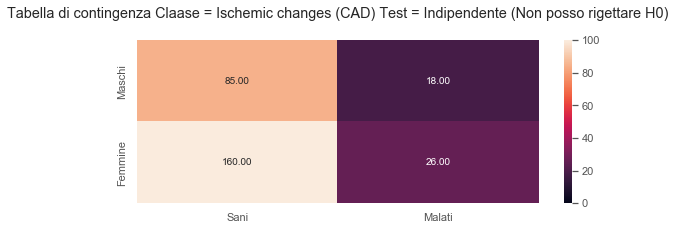

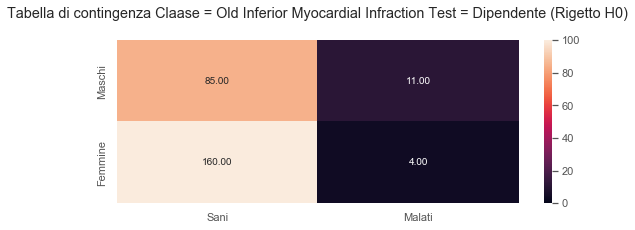

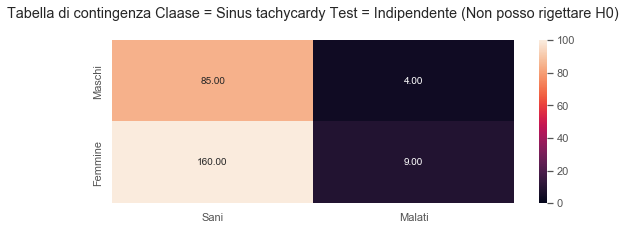

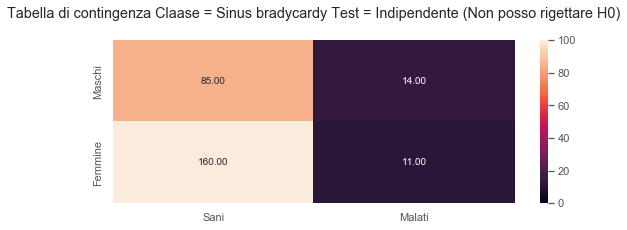

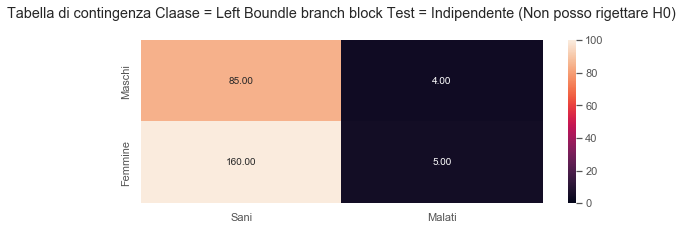

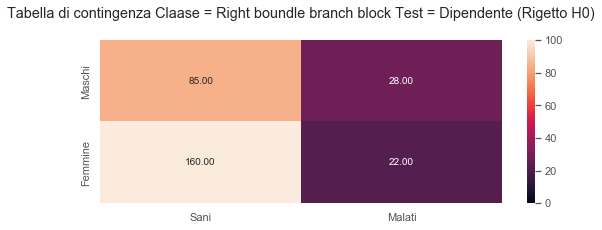

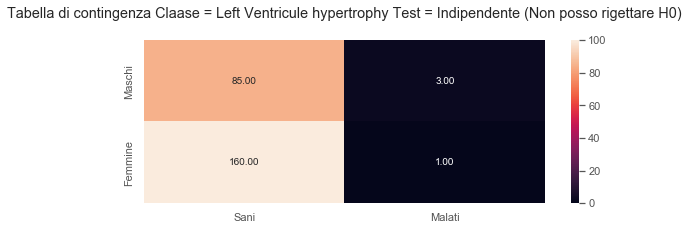

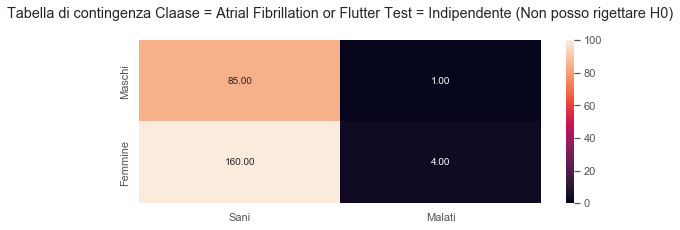

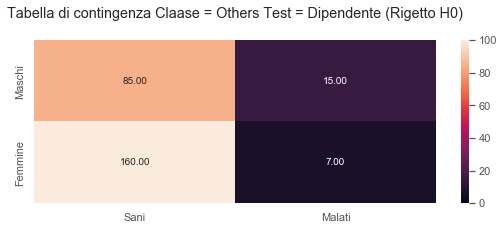

In [22]:
j = 131
for i in range(0,len(tabelle_sesso)):
    df_cm = pd.DataFrame(tabelle_sesso[i][1], 
                      index = ['Maschi', 'Femmine'],
                      columns = ['Sani', 'Malati'])
    
    plt.figure(figsize=(9, 3))
    #plt.subplot(j)
    j+=1
    res = sns.heatmap(df_cm, annot=True, vmin=0.0, vmax=100.0, fmt='.2f')
    plt.yticks([0.5,1.5], ['Maschi', 'Femmine'],va='center')
    
    plt.title('Tabella di contingenza Claase = '+risultati_sesso[i][0]+ " Test = " +risultati_sesso[i][1]+'\n')
    


<a id="WeightTest"></a>
<h3> Test chi quadro sul Peso dei pazienti  <a href="#indice" style="text-decoration:none;">↑</a></h3>


##### Siamo interessati a capire se il peso delle persone influisce sulla loro condizione 

Impostiamo i test chi-quadro per capire se il peso del paziente influisce o meno sulla condizione del paziente

Possiamo effettuare un test di significatività.
Dove andiamo a confrontare i di malati di una certa aritmia cardiaca e i non malati per il peso. 
Prima però andiamo ad analizzare le statistiche base 

In [22]:
lista_classi = []
j = 1
new_class_names =[]
for i in class_names:
   
    if(i != "1.Degree AtrioVentricular block" and i!= '3.Degree AV block' and i!= "2.Degree AV block"  ):
        lista_classi.append([j,i,grouped_mean["Weight_kg"][j],grouped_median["Weight_kg"][j],grouped_mode["Weight_kg"][j],gouped_std["Weight_kg"][j]])
        new_class_names.append(i)
    j+=1
WeightClass = {
    "WeightAVG": grouped_mean["Weight_kg"],"WeightMdian":grouped_median["Weight_kg"],
            "WeightMode": grouped_mode["Weight_kg"],"WeightStd":gouped_std['Weight_kg'],"Class":new_class_names }
WeightClassDF =pd.DataFrame(WeightClass)

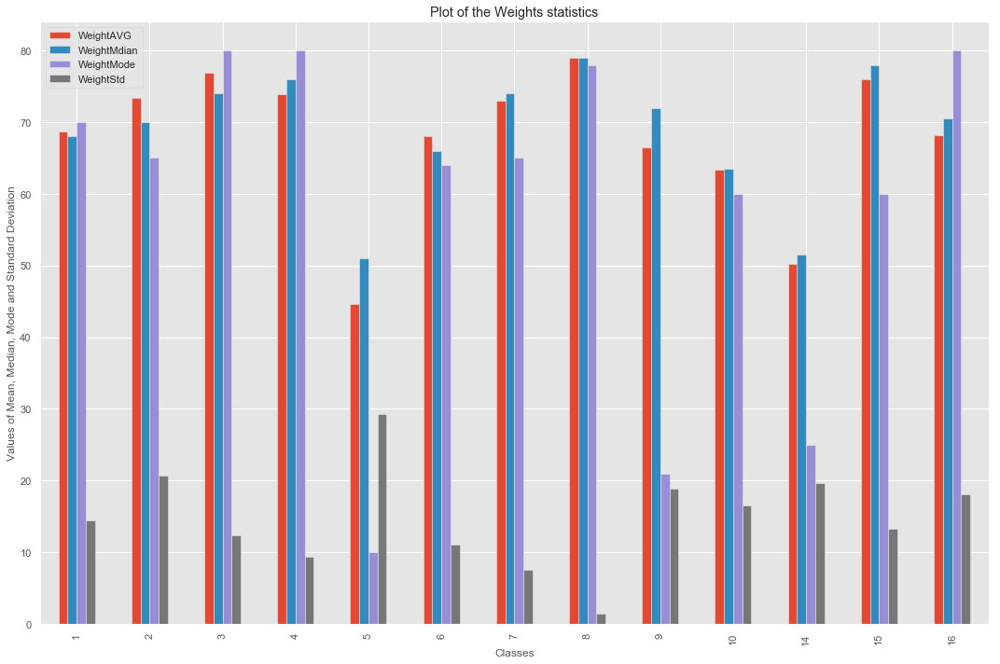

,WeightAVG,WeightMdian,WeightMode,WeightStd,Class
t,,,,,
1,68.669388,68.0,70,14.454595,Normal
2,73.363636,70.0,65,20.617323,Ischemic changes (CAD)
3,76.866667,74.0,80,12.397388,Old Anterior Myocardial Infraction
4,73.866667,76.0,80,9.318696,Old Inferior Myocardial Infraction
5,44.615385,51.0,10,29.259011,Sinus tachycardy
6,68.000000,66.0,64,11.045361,Sinus bradycardy
7,73.000000,74.0,65,7.549834,Ventricular Premature Contraction (PVC)
8,79.000000,79.0,78,1.414214,Supraventricular Premature Contraction
9,66.444444,72.0,21,18.808981,Left Boundle branch block


In [23]:
fig, ax = plt.subplots(figsize=(15,10))
WeightClassDF.plot(kind="bar",ax=ax)
ax.set_title("Plot of the Weights statistics")
ax.set_ylabel('Values of Mean, Median, Mode and Standard Deviation')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
WeightClassDF

Miglior distribuzione  dweibull(c=1.17, loc=68.58, scale=12.85)


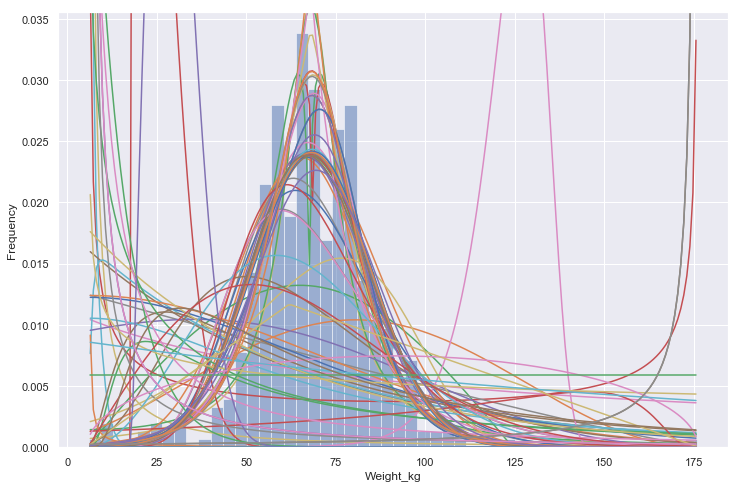

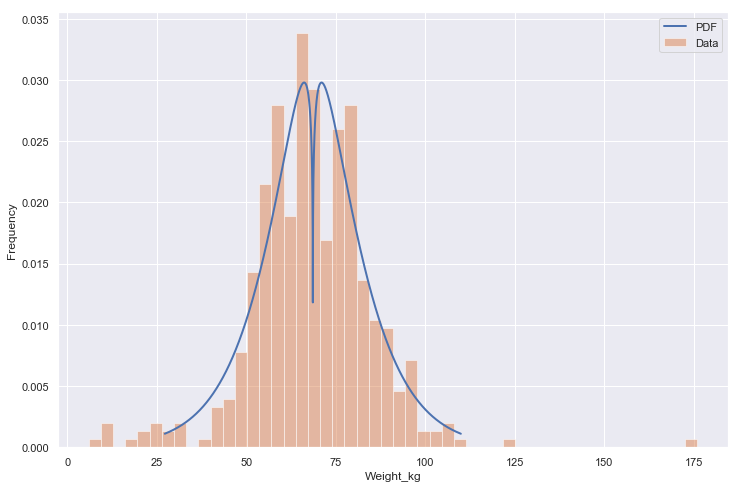

In [43]:
get_best_fitting(data['Weight_kg'],'Weight_kg')

Studiamo anche la distribuzione delle altezze tra gli esempi disponibili

In [24]:
lista_classi = []
j = 1
new_class_names =[]
for i in class_names:
   
    if(i != "1.Degree AtrioVentricular block" and i!= '3.Degree AV block' and i!= "2.Degree AV block"  ):
        lista_classi.append([j,i,grouped_mean["Height_cm"][j],grouped_median["Height_cm"][j],grouped_mode["Height_cm"][j],gouped_std["Height_cm"][j]])
        new_class_names.append(i)
    j+=1
HeightClass = {
    "HeightAVG": grouped_mean["Height_cm"],"HeightMdian":grouped_median["Height_cm"],
            "HeightMode": grouped_mode["Height_cm"],"HeightStd":gouped_std['Height_cm'],"Class":new_class_names }
HeightClassDF =pd.DataFrame(HeightClass)

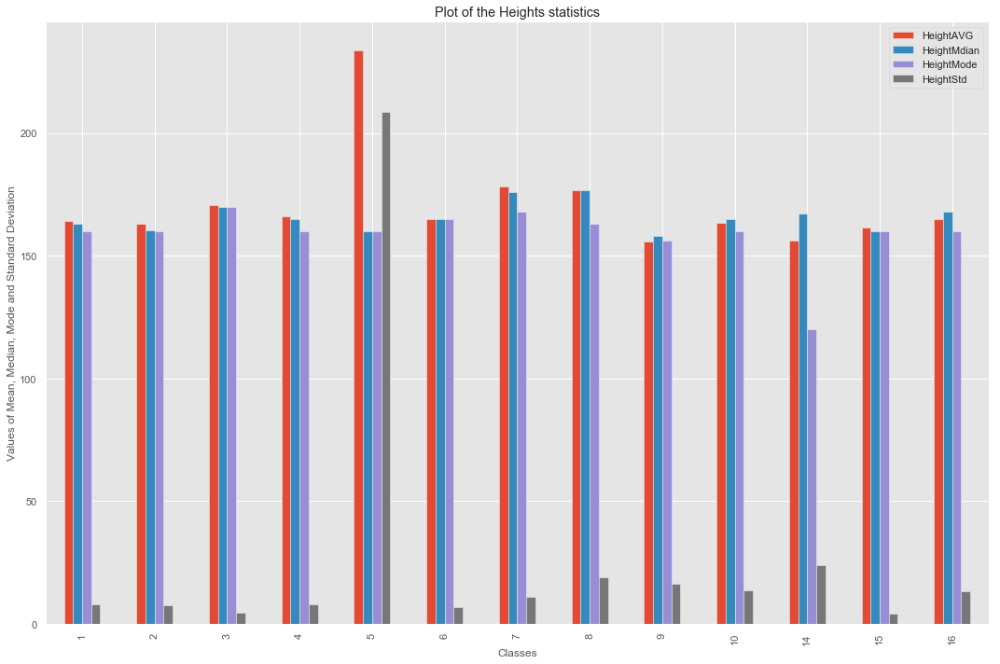

,HeightAVG,HeightMdian,HeightMode,HeightStd,Class
t,,,,,
1,164.102041,163.0,160,8.048126,Normal
2,163.068182,160.5,160,7.456534,Ischemic changes (CAD)
3,170.600000,170.0,170,4.579457,Old Anterior Myocardial Infraction
4,166.000000,165.0,160,7.973169,Old Inferior Myocardial Infraction
5,233.615385,160.0,160,208.500015,Sinus tachycardy
6,165.040000,165.0,165,6.996904,Sinus bradycardy
7,178.000000,176.0,168,11.135529,Ventricular Premature Contraction (PVC)
8,176.500000,176.5,163,19.091883,Supraventricular Premature Contraction
9,155.666667,158.0,156,16.209565,Left Boundle branch block


In [25]:
fig, ax = plt.subplots(figsize=(15,10))
HeightClassDF.plot(kind="bar",ax=ax)
ax.set_title("Plot of the Heights statistics")
ax.set_ylabel('Values of Mean, Median, Mode and Standard Deviation')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
HeightClassDF

Miglior distribuzione  johnsonsu(a=-0.24, b=0.99, loc=162.10, scale=6.75)


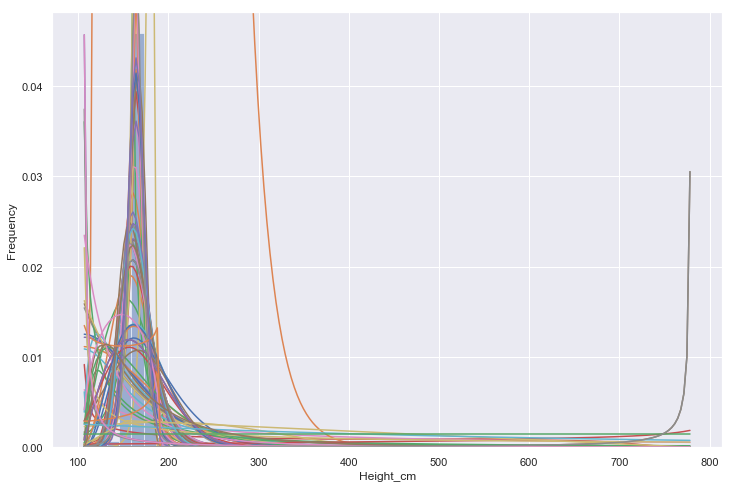

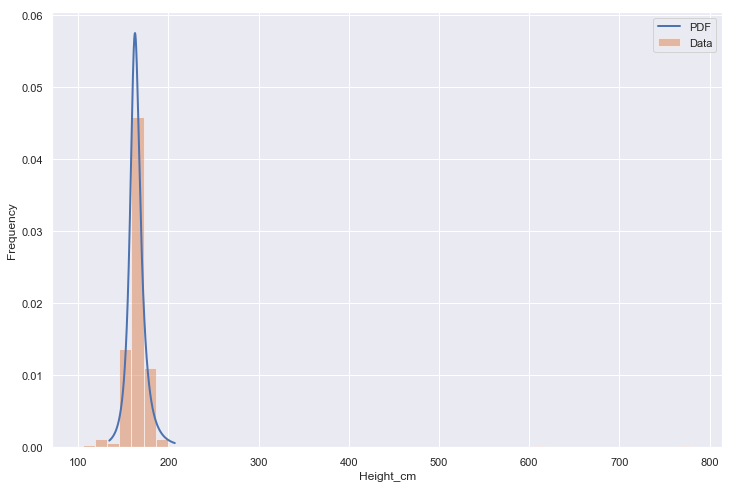

In [46]:
get_best_fitting(data['Height_cm'],'Height_cm')

In [26]:
# Funzione per i test chi quadro
def get_chisquared_weight(lista_sani,data):
    lista_risultati = []
    lista_tabelle_contingenza =[]
    for x in range(2,17):
        
        #pesoforma = data[(data['t']==x)& (data['Weight_kg'] == (0.8*(data['Height_cm']-100)+(data["Age"]/2)))].count()[0]
        #non_pesoforma = data[(data['t']==x)& (data['Weight_kg'] != (0.8*(data['Height_cm']-100)+(data["Age"]/2)))].count()[0]
        Ideal_Weight_m = data[(data['t']==x)&(data['Weight_kg'] == (data['Height_cm']-150)*0.75+50)&(data["Sex"] == 0)].count()[0]
        Not_Ideal_Weight_m = data[(data['t']==1)&(data['Weight_kg'] != (data['Height_cm']-150)*0.75+50)&(data["Sex"] == 0)].count()[0]
        Ideal_Weight_f = data[(data['t']==x)&(data['Weight_kg'] == (data['Height_cm']-150)*0.6+50)&(data["Sex"] == 1)].count()[0]
        Not_Ideal_Weight_f = data[(data['t']==1)&(data['Weight_kg'] != (data['Height_cm']-150)*0.6+50)&(data["Sex"] == 1)].count()[0]
        pesoforma = Ideal_Weight_m + Ideal_Weight_f
        non_pesoforma = Not_Ideal_Weight_m + Not_Ideal_Weight_f
        
        table= [[lista_sani[0],pesoforma],[lista_sani[1],non_pesoforma]]
        #print("Pesoforma = ",pesoforma, " Non PF = ", non_pesoforma,"\n")
        if(lista_sani[0]!=0 and lista_sani[1]!=0 and pesoforma !=0 and non_pesoforma!=0):
            lista_tabelle_contingenza.append([class_names[x-1],table])
            stat, p, dof, expected = sp.stats.chi2_contingency(table)
            # interpret p-value
            prob = 0.95
            alpha = 1.0 - prob
            if p <= alpha:
                lista_risultati.append([class_names[x-1],'Dipendente (Rigetto H0)',True])

            else:
                 lista_risultati.append([class_names[x-1],'Indipendente (Non posso rigettare H0)',False])
    return lista_risultati,lista_tabelle_contingenza
    

Prima di approcciarci al problema in modo semplificato, considerando i casi: persone grasse e persone non grasse, proviamo ad utilizzare uno schema nel quale stabiliamo, dato il peso e l'altezza di un individuo, se non ha problemi di peso-forma o meno. Per capire se un individuo è sotto peso o meno utilizziamo la formula di Wan Der Vael

FORMULA DI WAN DER VAEL

Questa formula considera solo l'altezza

            Peso ideale Uomini = (altezza in cm - 150) x 0,75 + 50 

            Peso ideale Donne = (altezza in cm - 150) x 0,6 + 50



In [27]:
#Ideal_Weight = data[(data['t'] ==1) & (data['Weight_kg'] == (0.8*(data['Heght_cm']-100)+(data["Age"]/2)))].count()[0]
#Not_Ideal_Weight = data[(data['t'] ==1) & (data['Weight_kg'] != (0.8*(data['Heght_cm']-100)+(data["Age"]/2)))].count()[0]
Ideal_Weight_m = data[(data['t']==1)&(data['Weight_kg'] == (data['Height_cm']-150)*0.75+50)&(data["Sex"] == 0)].count()[0]
Not_Ideal_Weight_m = data[(data['t']==1)&(data['Weight_kg'] != (data['Height_cm']-150)*0.75+50)&(data["Sex"] == 0)].count()[0]
Ideal_Weight_f = data[(data['t']==1)&(data['Weight_kg'] == (data['Height_cm']-150)*0.6+50)&(data["Sex"] == 1)].count()[0]
Not_Ideal_Weight_f = data[(data['t']==1)&(data['Weight_kg'] != (data['Height_cm']-150)*0.6+50)&(data["Sex"] == 1)].count()[0]
Ideal_Weight = Ideal_Weight_m + Ideal_Weight_f
Not_Ideal_Weight = Not_Ideal_Weight_m + Not_Ideal_Weight_f

In [28]:
risultati_peso,tabelle_peso = get_chisquared_weight([Ideal_Weight,Not_Ideal_Weight],data)

In [29]:
for i in risultati_peso:
    print("Test per la classe = ",i[0], " Risultato del test = ", i[1])

Test per la classe =  Ventricular Premature Contraction (PVC)  Risultato del test =  Indipendente (Non posso rigettare H0)
Test per la classe =  Supraventricular Premature Contraction  Risultato del test =  Indipendente (Non posso rigettare H0)


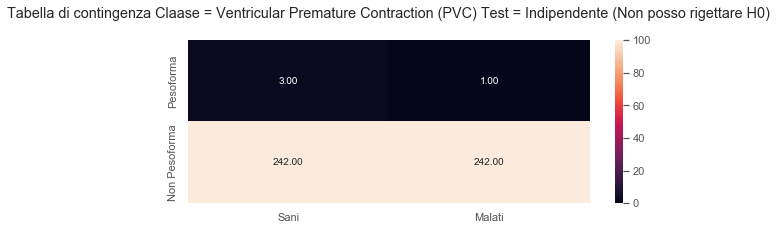

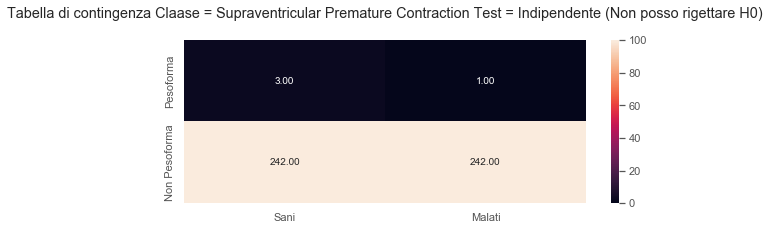

In [32]:
j = 131
for i in range(0,len(tabelle_peso)):
    df_cm = pd.DataFrame(tabelle_peso[i][1], 
                      index = ['Pesoforma', 'Non Pesoforma'],
                      columns = ['Sani', 'Malati'])
    plt.figure(figsize=(9, 3))
    #plt.subplot(j)
    j+=1
    res = sns.heatmap(df_cm, annot=True, vmin=0.0, vmax=100.0, fmt='.2f')
    plt.yticks([0.5,1.5], ['Pesoforma', 'Non Pesoforma'],va='center')
    
    plt.title('Tabella di contingenza Claase = '+risultati_peso[i][0]+ " Test = " +risultati_peso[i][1]+'\n')
    

Come possiamo vedere, per ogni classe, non abbiamo esempi di persone con un giusto pesoforma o di persone che non ne hanno. Procediamo dunque con l'effettuare un test chi quadro solo tra i malati e i non malati ed i pesanti e i leggeri

In [30]:
# Funzione per i test chi quadro
def get_chisquared_weight_soglie(lista_sani,data,soglia_leggeri,soglia_medi):
    lista_risultati = []
    lista_tabelle_contingenza =[]
    for x in range(2,17):
        
        #pesoforma = data[(data['t']==x)& (data['Weight_kg'] == (0.8*(data['Heght_cm']-100)+(data["Age"]/2)))].count()[0]
        #non_pesoforma = data[(data['t']==x)& (data['Weight_kg'] != (0.8*(data['Heght_cm']-100)+(data["Age"]/2)))].count()[0]
        leggeri = data[(data['t']==x)&(data['Weight_kg'] <= soglia_leggeri)].count()[0]
        medi = data[(data['t']==1)&(data['Weight_kg'] > soglia_leggeri)&(data['Weight_kg'] <= soglia_medi)].count()[0]
        pesanti = data[(data['t']==x)&(data['Weight_kg'] > soglia_medi)].count()[0]
      
        table= [[lista_sani[0],leggeri],[lista_sani[1],medi],[lista_sani[2],pesanti]]
        #print("Pesoforma = ",pesoforma, " Non PF = ", non_pesoforma,"\n")
        if(lista_sani[0]!=0 and lista_sani[1]!=0 and leggeri !=0 and medi!=0 and pesanti!=0 ):
            lista_tabelle_contingenza.append([class_names[x-1],table])
            stat, p, dof, expected = sp.stats.chi2_contingency(table)
            # interpret p-value
            prob = 0.95
            alpha = 1.0 - prob
            if p <= alpha:
                lista_risultati.append([class_names[x-1],'Dipendente (Rigetto H0)',True])

            else:
                 lista_risultati.append([class_names[x-1],'Indipendente (Non posso rigettare H0)',False])
    return lista_risultati,lista_tabelle_contingenza
    

In [31]:
soglia_leggeri = 60
soglia_medi = 80

In [32]:
sani_leggeri = data[(data['t']==1)&(data['Weight_kg'] <= soglia_leggeri)].count()[0]
sani_medi = data[(data['t']==1)&(data['Weight_kg'] > soglia_leggeri)&(data['Weight_kg'] <= soglia_medi)].count()[0]
sani_pesanti = data[(data['t']==1)&(data['Weight_kg'] > soglia_medi)].count()[0]

In [33]:
print("S_leggeri = ", sani_leggeri," S_medi = ", sani_medi, " S_pesanti = ", sani_pesanti)

S_leggeri =  76  S_medi =  122  S_pesanti =  47


In [35]:
risultati_peso_soglie,tabelle_peso_soglie =  get_chisquared_weight_soglie([sani_leggeri,sani_medi,sani_pesanti],data,soglia_leggeri,soglia_medi)

In [36]:
for i in risultati_peso_soglie:
    print("Test per la classe = ",i[0], " Risultato del test = ", i[1])

Test per la classe =  Ischemic changes (CAD)  Risultato del test =  Dipendente (Rigetto H0)
Test per la classe =  Old Anterior Myocardial Infraction  Risultato del test =  Dipendente (Rigetto H0)
Test per la classe =  Old Inferior Myocardial Infraction  Risultato del test =  Dipendente (Rigetto H0)
Test per la classe =  Sinus bradycardy  Risultato del test =  Dipendente (Rigetto H0)
Test per la classe =  Left Boundle branch block  Risultato del test =  Dipendente (Rigetto H0)
Test per la classe =  Right boundle branch block  Risultato del test =  Dipendente (Rigetto H0)
Test per la classe =  Atrial Fibrillation or Flutter  Risultato del test =  Dipendente (Rigetto H0)
Test per la classe =  Others  Risultato del test =  Dipendente (Rigetto H0)


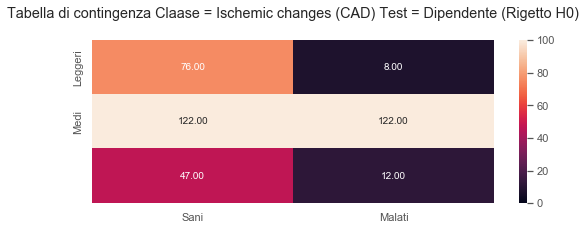

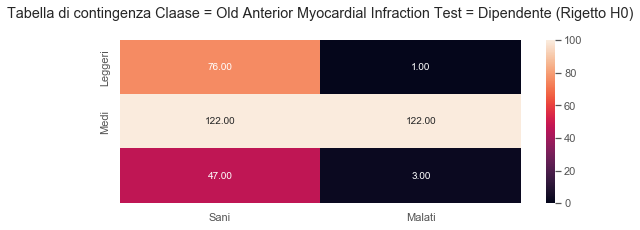

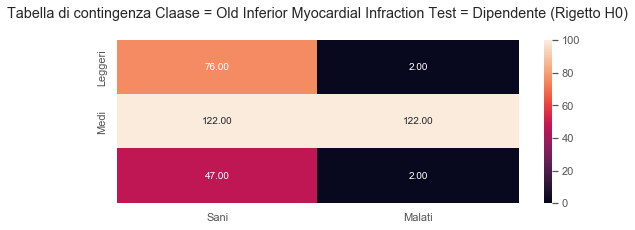

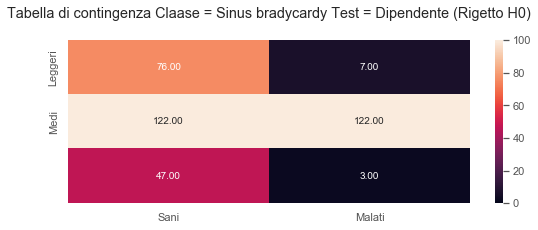

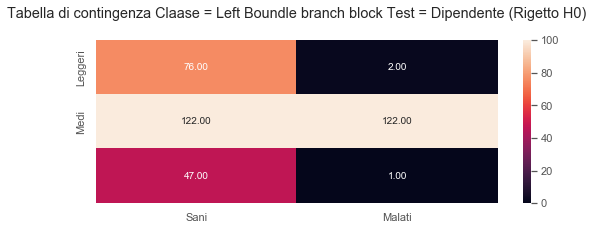

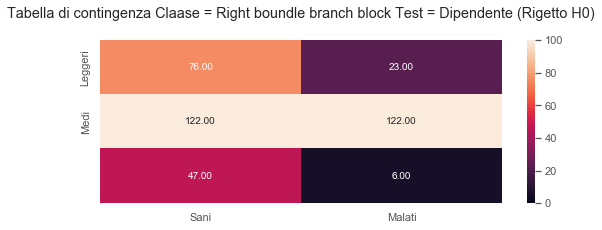

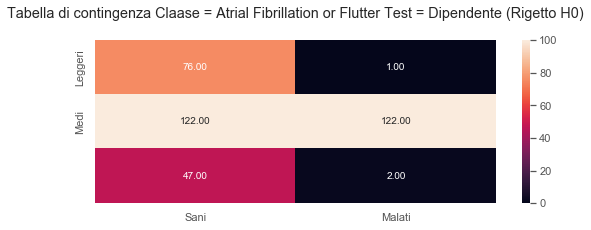

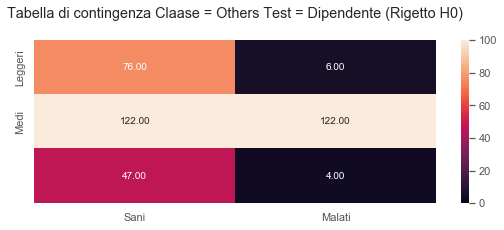

In [39]:
j = 131
for i in range(0,len(tabelle_peso_soglie)):
    df_cm = pd.DataFrame(tabelle_peso_soglie[i][1], 
                      index = ['Leggeri', 'Medi','Pesanti'],
                      columns = ['Sani', 'Malati'])
    
    plt.figure(figsize=(9, 3))
    #plt.subplot(j)
    j+=1
    res = sns.heatmap(df_cm, annot=True, vmin=0.0, vmax=100.0, fmt='.2f')
    plt.yticks([0.5,1.5,2.5], ['Leggeri', 'Medi','Pesanti'],va='center')
    
    plt.title('Tabella di contingenza Claase = '+risultati_peso_soglie[i][0]+ " Test = " +risultati_peso_soglie[i][1]+'\n')
    


<a id="QRSTTest"></a>
<h3> Test chi quadro sui valori QRST dei pazienti  <a href="#indice" style="text-decoration:none;">↑</a></h3>


##### Siamo interessati a capire se i valori del QRST delle persone influisce sulla loro condizione 

Impostiamo i test chi-quadro per capire se il valore QRST del paziente influisce o meno sulla condizione del paziente

E' una combinazione delle onde Q,R ed S. Il "complesso QRS" rappresenta la depolarizzazione ventricolare. Questo temine può essere confuso, poiché non tutti gli ECG contengono tutti e tre questi tipi di onde; 

![title](img/QRSD.png)

<strong> Un intervallo di tempo per il quale il complesso QRS viene considerato "normale" è tra gli 80 e i 100 millisecondi </strong>. Quando il periodo del QRS supera 120 millisecondi viene considerato anormale.Quando la durata è compresa tra 100 e 120 millisecondi, è intermedia o leggermente prolungata ma comunque non anormale.

In [15]:
lista_classi = []
j = 1
new_class_names =[]
for i in class_names:
   
    if(i != "1.Degree AtrioVentricular block" and i!= '3.Degree AV block' and i!= "2.Degree AV block"  ):
        lista_classi.append([j,i,grouped_mean["QRS_Duration"][j],grouped_median["QRS_Duration"][j],grouped_mode["QRS_Duration"][j],gouped_std["QRS_Duration"][j]])
        new_class_names.append(i)
    j+=1
QRSTClass = {
    "QRSDAVG": grouped_mean["QRS_Duration"],"QRSDMdian":grouped_median["QRS_Duration"],
            "QRSDMode": grouped_mode["QRS_Duration"],"QRSDStd":gouped_std['QRS_Duration'],"Class":new_class_names }
QRSTClassDF =pd.DataFrame(QRSTClass)

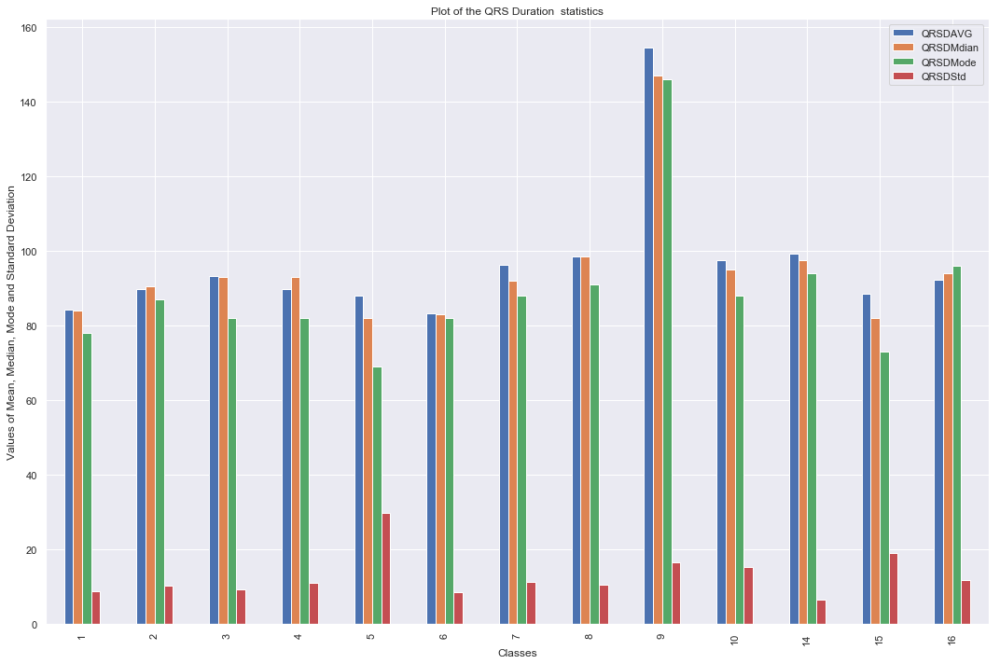

,Class,QRSDAVG,QRSDMdian,QRSDMode,QRSDStd
t,,,,,
1,Normal,84.277551,84.0,78,8.735439
2,Ischemic changes (CAD),89.818182,90.5,87,10.207778
3,Old Anterior Myocardial Infraction,93.333333,93.0,82,9.131317
4,Old Inferior Myocardial Infraction,89.866667,93.0,82,10.979635
5,Sinus tachycardy,88.000000,82.0,69,29.796532
6,Sinus bradycardy,83.160000,83.0,82,8.561931
7,Ventricular Premature Contraction (PVC),96.333333,92.0,88,11.150486
8,Supraventricular Premature Contraction,98.500000,98.5,91,10.606602
9,Left Boundle branch block,154.444444,147.0,146,16.409685


In [16]:
fig, ax = plt.subplots(figsize=(15,10))
QRSTClassDF.plot(kind="bar",ax=ax)
ax.set_title("Plot of the QRS Duration  statistics")
ax.set_ylabel('Values of Mean, Median, Mode and Standard Deviation')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
QRSTClassDF

('Miglior distribuzione ', 'fisk(c=5.66, loc=49.08, scale=37.34)')


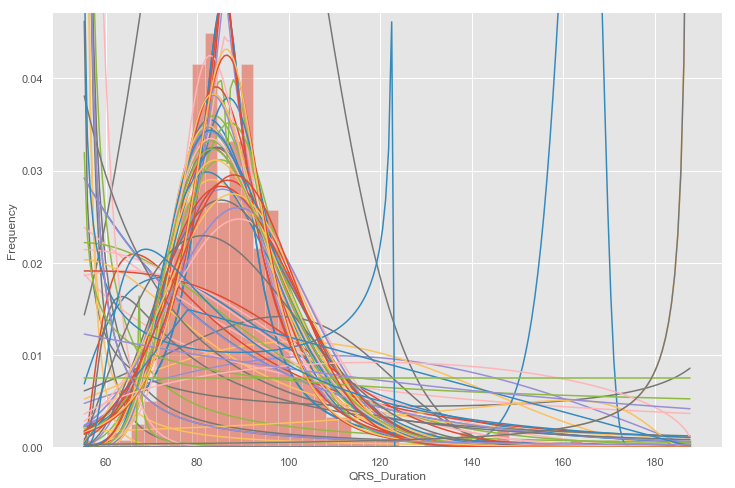

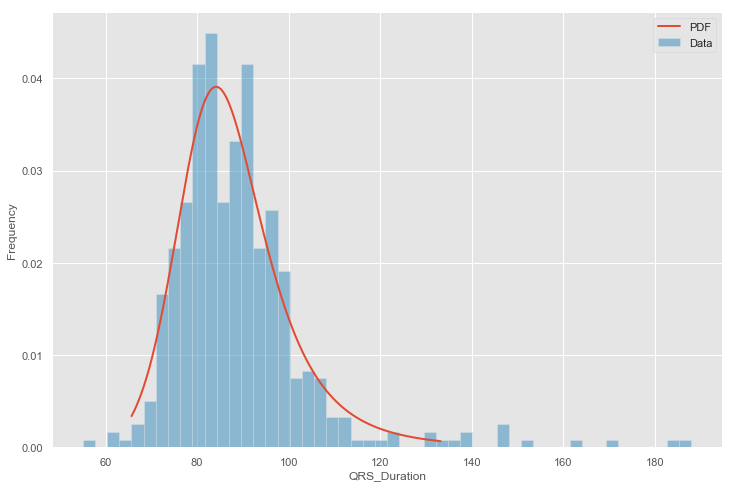

In [22]:
get_best_fitting(data['QRS_Duration'],'QRS_Duration')

In [27]:
# Funzione per i test chi quadro
def get_chisquared_qrsd_soglie(lista_sani,data,soglia_normali,soglia_prolungati):
    lista_risultati = []
    lista_tabelle_contingenza =[]
    for x in range(2,17):
        normali = data[(data['t']==x)&(data['QRS_Duration'] <= soglia_normali)].count()[0]
        prolungati = data[(data['t']==1)&(data['QRS_Duration'] > soglia_normali)&(data['QRS_Duration'] <= soglia_prolungati)].count()[0]
        anormali = data[(data['t']==x)&(data['QRS_Duration'] > soglia_prolungati)].count()[0]
        table= [[lista_sani[0],normali],[lista_sani[1],prolungati],[lista_sani[2],anormali]]
        #print("Pesoforma = ",pesoforma, " Non PF = ", non_pesoforma,"\n")
        if(lista_sani[0]!=0 and lista_sani[1]!=0 and normali !=0 and prolungati!=0 and anormali!=0 ):
            lista_tabelle_contingenza.append([class_names[x-1],table])
            stat, p, dof, expected = sp.stats.chi2_contingency(table)
            # interpret p-value
            prob = 0.95
            alpha = 1.0 - prob
            if p <= alpha:
                lista_risultati.append([class_names[x-1],'Dipendente (Rigetto H0)',True])
            else:
                 lista_risultati.append([class_names[x-1],'Indipendente (Non posso rigettare H0)',False])
    return lista_risultati,lista_tabelle_contingenza
    

In [24]:
soglia_normali = 100
soglia_prolungati = 120

In [25]:
sani_normali = data[(data['t']==1)&(data['QRS_Duration'] <= soglia_normali)].count()[0]
sani_prolungati = data[(data['t']==1)&(data['QRS_Duration'] > soglia_normali)&(data['QRS_Duration'] <= soglia_prolungati)].count()[0]
sani_anormali = data[(data['t']==1)&(data['QRS_Duration'] > soglia_prolungati)].count()[0]

In [26]:
print("S_normali = ", sani_normali," S_prolungati = ", sani_prolungati, " S_anormali = ", sani_anormali)

('S_normali = ', 236, ' S_prolungati = ', 9, ' S_anormali = ', 0)


In [28]:
risultati_qrsd_soglie,tabelle_qrsd_soglie =  get_chisquared_qrsd_soglie([sani_normali,sani_prolungati,sani_anormali],data,soglia_normali,soglia_prolungati)

In [29]:
for i in risultati_qrsd_soglie:
    print("Test per la classe = ",i[0], " Risultato del test = ", i[1])

('Test per la classe = ', 'Sinus tachycardy', ' Risultato del test = ', 'Dipendente (Rigetto H0)')
('Test per la classe = ', 'Right boundle branch block', ' Risultato del test = ', 'Dipendente (Rigetto H0)')
('Test per la classe = ', 'Atrial Fibrillation or Flutter', ' Risultato del test = ', 'Dipendente (Rigetto H0)')


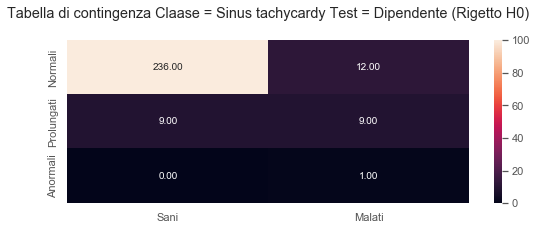

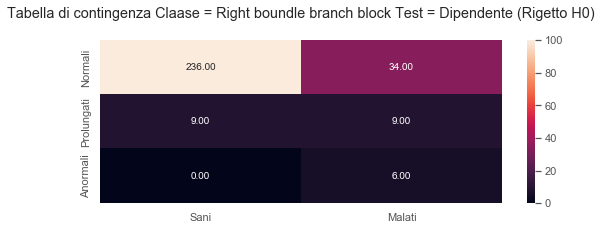

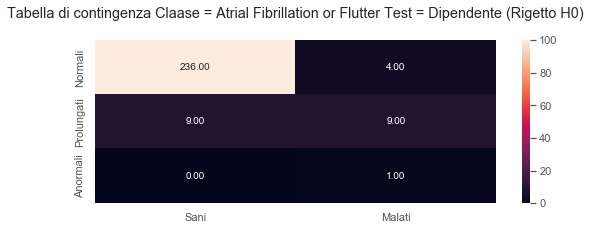

In [33]:
j = 131
for i in range(0,len(tabelle_qrsd_soglie)):
    df_cm = pd.DataFrame(tabelle_qrsd_soglie[i][1], 
                      index = ['Normali', 'Prolungati','Anormali'],
                      columns = ['Sani', 'Malati'])
    
    plt.figure(figsize=(9, 3))
    #plt.subplot(j)
    j+=1
    res = sns.heatmap(df_cm, annot=True, vmin=0.0, vmax=100.0, fmt='.2f')
    plt.yticks([0.5,1.5,2.5], ['Normali', 'Prolungati','Anormali'],va='center')
    
    plt.title('Tabella di contingenza Claase = '+risultati_qrsd_soglie[i][0]+ " Test = " +risultati_qrsd_soglie[i][1]+'\n')
    


<a id="Congiunte"></a>
<h3> Plotting delle distribuzioni  <a href="#indice" style="text-decoration:none;">↑</a></h3>


##### Studiamo le distribuzioni  e le distribuzioni congiunte delle features analizzate sopra

Eseguiamo dei fitting delle distribuzioni delle features con delle distribuzioni empiriche

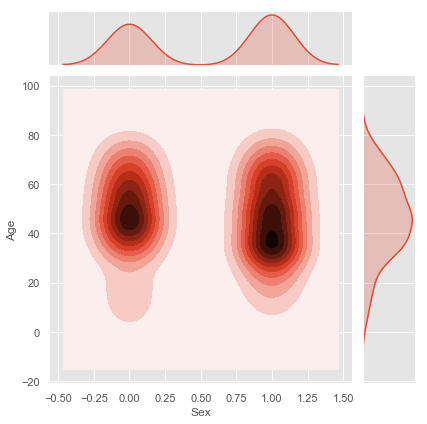

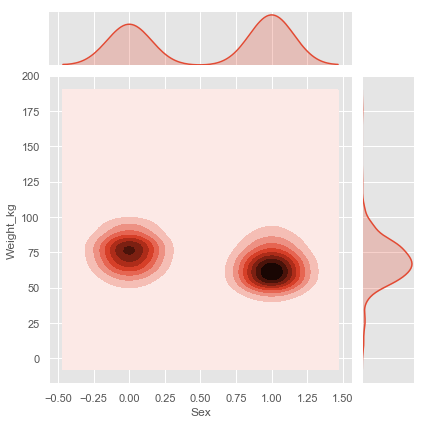

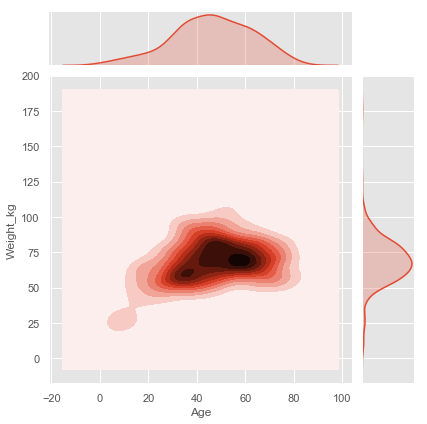

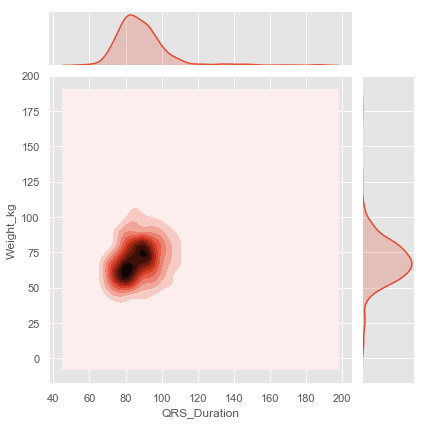

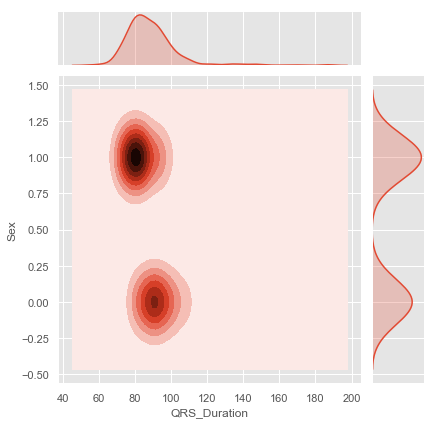

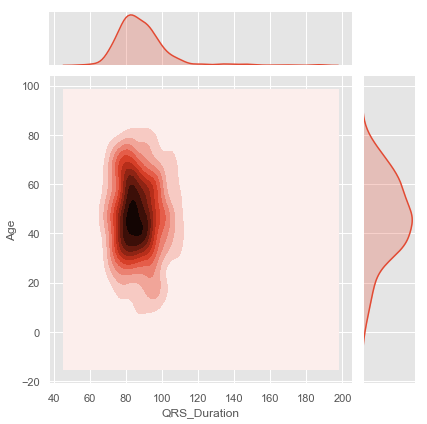

In [35]:
sns.jointplot("Sex", "Age", data=data, kind='kde') 
sns.jointplot("Sex", "Weight_kg", data=data, kind='kde')
sns.jointplot("Age", "Weight_kg", data=data, kind='kde')
sns.jointplot("QRS_Duration", "Weight_kg", data=data, kind='kde')
sns.jointplot("QRS_Duration", "Sex", data=data, kind='kde')
sns.jointplot("QRS_Duration", "Age", data=data, kind='kde')

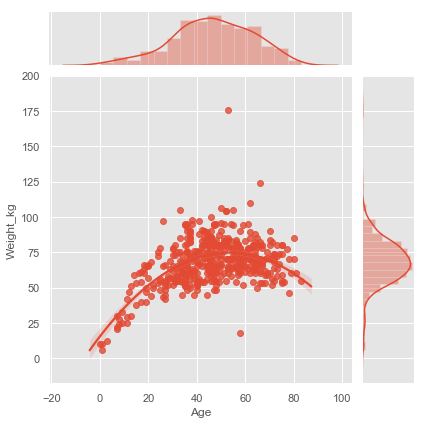

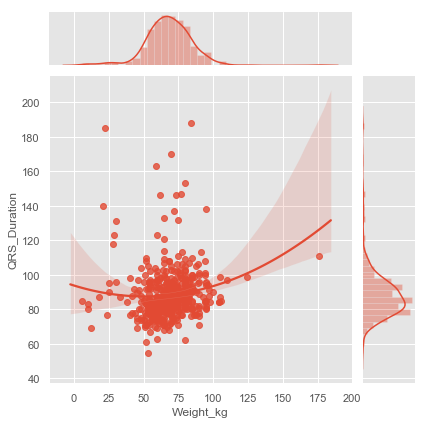

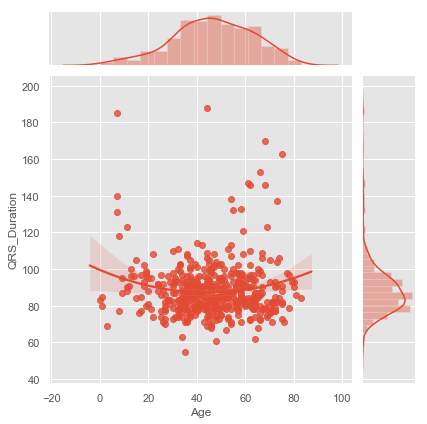

In [39]:
g = sns.JointGrid(x="Age", y="Weight_kg", data=data) 
g.plot_joint(sns.regplot, order=2) 
g.plot_marginals(sns.distplot)

g = sns.JointGrid(x="Weight_kg", y="QRS_Duration", data=data) 
g.plot_joint(sns.regplot, order=2) 
g.plot_marginals(sns.distplot)



g = sns.JointGrid(x="Age", y="QRS_Duration", data=data) 
g.plot_joint(sns.regplot, order=2) 
g.plot_marginals(sns.distplot)





<a id="Imputation"></a>
<h3>Gestione dei dati mancanti <a href="#indice" style="text-decoration:none;">↑</a></h3>




##### Analisi delle feature e degli esempi mancanti del dataset

Le posizioni 0, 11,12 e 13 sono nulle in quanto la classe 0 non esiste e le restanti non compaiono nel dataset di esempio

Come possiamo notare, esistono delle classi che non hanno nessun elemento nel dataset.
Tali classi sono: 
<table>

<tr>
 <th scope="col">Class 11</th>
 <th scope="col">Class 12</th>
 <th scope="col">Class 13</th>
</tr>
<tr>
 <td>1.degree AtrioVentricular block</td>
 <td>2.degree AtrioVentricular block</td>
 <td>3.degree AtrioVentricular block</td>
</tr>
</table>


Controlliamo se il dataset contiene dei valori mancanti

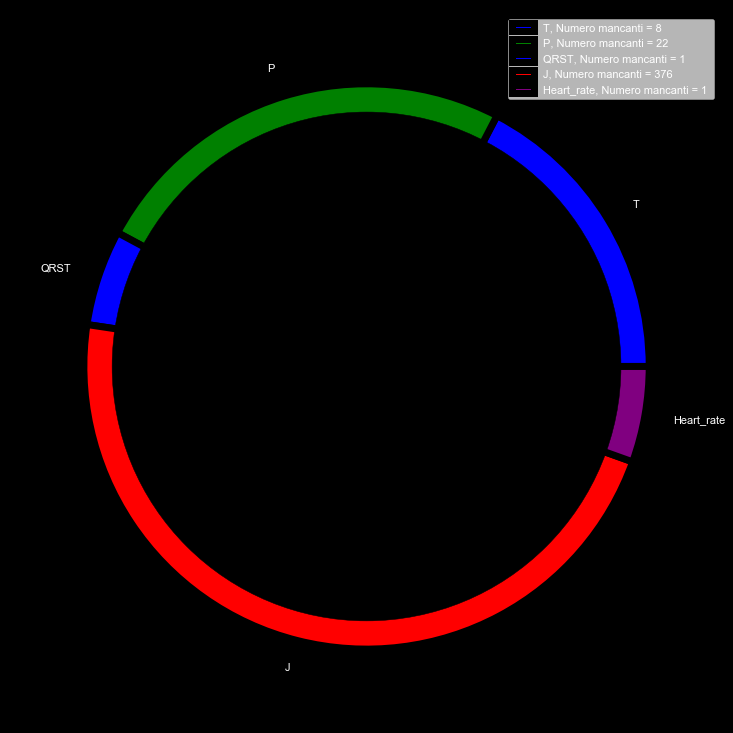

In [9]:
frame = data[(data == '?')].count()
cont_missing = frame[(frame != 0)].tolist()
names = frame[(frame != 0)].index.tolist()
Norm_MN =[]
for i in cont_missing:
    Norm_MN.append(mt.log10(i+1))
size= Norm_MN
# Create a circle for the center of the plot
fig = plt.figure(figsize =(20,13))
fig.patch.set_facecolor('black')
my_circle=plt.Circle( (0,0), 0.9, color='black')
plt.rcParams['text.color'] = 'white'
patches1 = plt.pie(size, labels=names, wedgeprops = { 'linewidth' : 7, 'edgecolor' : 'black' },colors=['blue','green','blue','red','purple'])
leg1 = plt.legend( loc = 'left', labels=['%s, Numero mancanti = %d ' % (l, s) for l, s in zip(names, cont_missing)])
p=plt.gcf()
p.gca().add_artist(my_circle)
plt.show()

Come possiamo osservare abbiamo dei valori mancanti nelle Features: 11,12,13,14 e 15.
Più specificatamente abbiamo che:

In [9]:
j=0
for i in names:
    print ("Feature: ",i,"\t Numero di elementi mancanti: ",cont_missing[j],"\n")
    j+=1

Feature:  T 	 Numero di elementi mancanti:  8 

Feature:  P 	 Numero di elementi mancanti:  22 

Feature:  QRST 	 Numero di elementi mancanti:  1 

Feature:  J 	 Numero di elementi mancanti:  376 

Feature:  Heart_rate 	 Numero di elementi mancanti:  1 



### Plotting del numero di esempi per classe che presentano dei valori mancanti

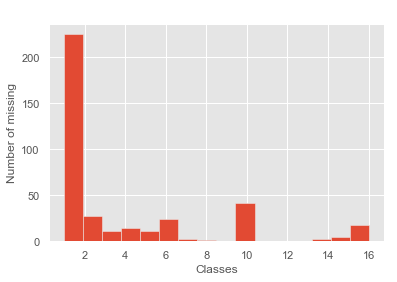

In [10]:
n,m = data.shape
missing_class =[]
for (i,j) in data.iterrows():
    if '?' in j.values:
        missing_class.append(j[-1])

plt.hist(missing_class, density=False, bins=16)
plt.title('Classes');
plt.xlabel('Classes');
plt.ylabel('Number of missing');

In [5]:
features_no_target = f_n.copy()
features_no_target.remove('t')

In [6]:
X  = np.array(data[features_no_target])

## Come risolvere il fenomeno dei dati mancanti
Per risolvere tale problema utilizzeremo due approcci:

                   1) Eliminazione delle features che contengono valori mancanti
                    
                   2) Imputazione statistica dei dati:
                           a) Usando il valore medio
                           b) Usando il mediano
                           c) Mediante Regressione Lineare deterministica e\o stocastica
                           

Poichè abbiamo poche features che contengono valori mancanti, non ci aspettiamo differenze rilevanti in termini di perfomances predittive degli algoritmi di apprendimento automatico applicati nei vari casi.

#### NOTA: La feature J presenta molte mancanze (376) quindi verrà eliminata per ogni caso

<a id="Delete"></a>
<h3>Cancellazioni delle features incomplete <a href="#indice" style="text-decoration:none;">↑</a></h3>



In questo primo approccio siamo intenzionati a eliminare le colonne che contengono valori mancanti.
![title](img/deleting.png)
Dal precedente plotting si evince che la colonna 14 contiene la maggior parte dei dati mancanti.

Procediamo, quindi, con l'eliminazione di tale colonna e l'eliminazione delle altre features che contengono valori mancanti.



In [7]:
# Cancelliamo la colonna J 
X_df = data.copy()
X_df = X_df.drop(['J'],axis=1)
f_n.remove('J')

X = X_df.values
A_del_df = X_df.copy()
# Cancelliamo le altre colonne
A_del_df = A_del_df.drop(['T','P','QRST','Heart_rate'],axis=1)
# Creiamo una copia della lista delle features e cancelliamo quelle che abbiamo rimosso
f_n_del = f_n.copy()
f_n_del.remove('T')
f_n_del.remove('P')
f_n_del.remove('QRST')
f_n_del.remove('Heart_rate')
A_del_with_target_df = A_del_df.copy()
# Togliamo la colonna del target value
A_del_df = A_del_df.drop(['t'],axis=1)
# Convertiamo il restante DataFrame in una matrice numpy
A_del_matrix = A_del_df.values
# Rendiamo la matrice di tipo float
A_del_matrix = A_del_matrix.astype(np.float)

In [8]:
f_n_del.remove('t')

In [9]:
A_deleted = A_del_df.values

### Considerazioni
Se le colonne eliminate contenevano informazioni utili (nei punti che non contenevano '?'), i modelli di learning che andemo ad allenare su tale dataset non avranno accesso a queste informazioni. Inoltre, se i dati del test presentano valori mancanti nei punti in cui non sono stati rilevati i dati di allenamento, ciò comporterà un errore.

Quindi, di solito non è in genere la soluzione migliore. Tuttavia, può essere utile quando mancano la maggior parte dei valori in una colonna

## Data imputation

Anzichè individuare ed eliminare le righe che contengono valori "?" utilizziamo la tecnica dell'imputazione, dove andiamo a sostituire il valore mancante con un numero. Il valore imputato non sarà esattamente corretto nella maggior parte dei casi, ma di solito fornisce modelli più accurati rispetto a quando cancelliamo completamente le colonne.

<a id="Mean"></a>
<h3>Imputation con valor medio <a href="#indice" style="text-decoration:none;">↑</a></h3>



In questa sezione andiamo a sostituire i valori "?" con il valore medio.

Nello specifico, dato un elemento mancante $$X_{i,j}: X_{i,j}=\text{'?'} \text{ tale che } X_{i,.}\in C_k $$

Definiamo $$X_{i,j}=\overline{X}_{i,j}^{(k)} = \frac{1}{n_k}\sum_{x\in C_k}{x_{i}} \quad \text{ ,tale che }X_{i,j}=\text{'?'} $$


![title](img/means.png)

In [10]:
nomi_features = features_name + header[27:]
A_means = data[f_n].values
t,o = np.shape((A_means))

means,indici_medie = get_means_list(A_means)
lis = [[]for i in indici_medie]
k=0
for i in means:
    for j in i:
        lis[k].append(float("{0:.4f}".format(j)))
    k+=1
A_means= replacing_missing(A_means,lis,indici_medie)

A_means_with_target = A_means.copy()
A_means = np.delete(A_means, 278, 1)
A_means=A_means.astype(np.float64)

In [11]:
f_no_t = f_n.copy()
f_no_t.remove('t')

<a id="Median"></a>
<h3>Imputation con mediano <a href="#indice" style="text-decoration:none;">↑</a></h3>



Eseguiamo anche un'imputazione mediante la mediana.

Ricordiamo brevemente che dati $n$ elementi il valore mediano viene calcolato come segue:

   1) si ordinano gli $n$ elementi in ordine crescente;
   
   2) se il numero degli elementi è dispari la mediana corrisponde al valore centrale, ovvero al valore che 
       occupala posizione $(n+1)\over 2$;
   
   3) se il numero $n$ è pari, la mediana è stimata utilizzando i due valori che occupano le posizioni 
       $n\over 2$ e $ {n\over 2}  +1$




In [12]:
liste_mediani,indici_mediani = get_median_list(data[f_n].values)
A_medians = replacing_missing(data[f_n].values,liste_mediani,indici_mediani)
#Ora che non ho ? converto la mia matrice in float
A_medians = A_medians.astype(np.float64)
A_medians_with_target = A_medians
A_medians = np.delete(A_medians, 278, 1)

print(np.shape(A_medians))

(452, 278)



<a id="Mode"></a>
<h3>Imputation con moda <a href="#indice" style="text-decoration:none;">↑</a></h3>



La moda (o norma) di una distribuzione di frequenza $X$ è la modalità (o la classe di modalità) caratterizzata dalla massima frequenza.

In [13]:
#f_n.append('t')
liste_mode_imputate,indici_mode = get_mode_list(data[f_n].values)
A_mode = replacing_missing(data[f_n].values,liste_mode_imputate,indici_mode)
np.shape(X.copy())
A_mode_with_target = A_mode.copy()
A_mode = A_mode.astype(np.float64)
A_mode = np.delete(A_mode, 278, 1)

print(np.shape(A_mode))

(452, 278)


<a id="DReg"></a>
<h3>Imputation con Regressione Deterministica <a href="#indice" style="text-decoration:none;">↑</a></h3>



Quando abbiamo più variabili con valori mancanti, non possiamo semplicemente usare l'Imputazione via regressione per imputare una di esse, poiché i predittori contengono anch'essi dati mancanti. Ma allora, come possiamo imputare una variabile senza imputarne un'altra?

Possiamo evitare questa situazione di Catch-22 imputando inizialmente tutte le variabili con valori mancanti usando alcuni metodi banali come Simple Random Imputation (imputiamo i dati mancanti con valori casuali tra quelli osservati) e successivamente procedere con il task di Regressione  per effettuare l'Imputazione di ciascuna delle variabili in modo iterativo.



In [14]:
data_reg = data.copy()

In [15]:
data_reg.loc[data_reg["J"] == '?', "J"] =np.nan
data_reg.loc[data_reg["P"] == '?', "P"] =np.nan
data_reg.loc[data_reg["T"] == '?', "T"] =np.nan
data_reg.loc[data_reg["QRST"] == '?', "QRST"] =np.nan
data_reg.loc[data_reg["Heart_rate"] == '?', "Heart_rate"] =np.nan

In [16]:
data_reg = data_reg.astype(float)
data_reg_1 = data_reg.copy()

In [17]:
missing_columns = ["J","P","T","QRST","Heart_rate"]

La funzione random_imputation sostituisce i valori mancanti con alcuni valori osservati scelti in modo casuale. Il metodo viene ripetuto per tutte le variabili contenenti valori mancanti, dopodiché vengono usati come parametri nel modello di regressione per stimare altri valori variabili.

L'Imputazione casuale semplice è un metodo grezzo poiché ignora tutti gli altri dati disponibili e quindi viene usato molto raramente. Ma serve come un buon punto di partenza per l'imputazione via regressione.

In [18]:
def random_imputation(df, feature):

    number_missing = df[feature].isnull().sum()
    observed_values = df.loc[df[feature].notnull(), feature]
    df.loc[df[feature].isnull(), feature + '_imp'] = np.random.choice(observed_values, number_missing, replace = True)
    
    return df

In [19]:
for feature in missing_columns:
    data_reg[feature + '_imp'] = data_reg[feature]
    data_reg = random_imputation(data_reg, feature)

<a id="SReg"></a>
<h3>Imputation con Regressione Stocastica <a href="#indice" style="text-decoration:none;">↑</a></h3>


Nell'imputazione mediante regressione deterministica, sostituiamo i dati mancanti con i valori previsti nel nostro modello di regressione e ripetiamo questo processo per ogni variabile.

In [20]:
deter_data = pd.DataFrame(columns = ["Det" + name for name in missing_columns])

In [21]:
for feature in missing_columns:
        
    deter_data["Det" + feature] = data_reg[feature + "_imp"]
    parameters = list(set(data_reg.columns) - set(missing_columns) - {feature + '_imp'})
    
    #Create a Linear Regression model to estimate the missing data
    model = LinearRegression()
    model.fit(X = data_reg[parameters], y = data_reg[feature + '_imp'])
    
    #observe that I preserve the index of the missing data from the original dataframe
    deter_data.loc[data_reg[feature].isnull(), "Det" + feature] = model.predict(data_reg[parameters])[data_reg[feature].isnull()]

Uno degli svantaggi principali di questo metodo è che riduciamo la variabilità intrinseca nella variabile imputata. In altre parole, poiché sostituiamo i dati mancanti con gli output della regressione, i valori previsti giacciono lungo l'iperpiano di regressione in cui la variabile avrebbe effettivamente contenuto del rumore / bias.


Possiamo visualizzare questo fenomeno in diversi modi. Il primo è mediante istogrammi sia per i dati incompleti che per i dati completi in cui possiamo osservare che la trama dei dati completati è più alta e più stretta rispetto a quella dei dati incompleti. In altre parole, i dati completi hanno una deviazione standard minore (quindi una variabilità inferiore) rispetto ai dati incompleti.

Un altro metodo è quello di tracciare un diagramma a "scatole" in cui possiamo osservare che l'intervallo IQ è piuttosto compresso per i dati completi rispetto a quello nei dati incompleti.

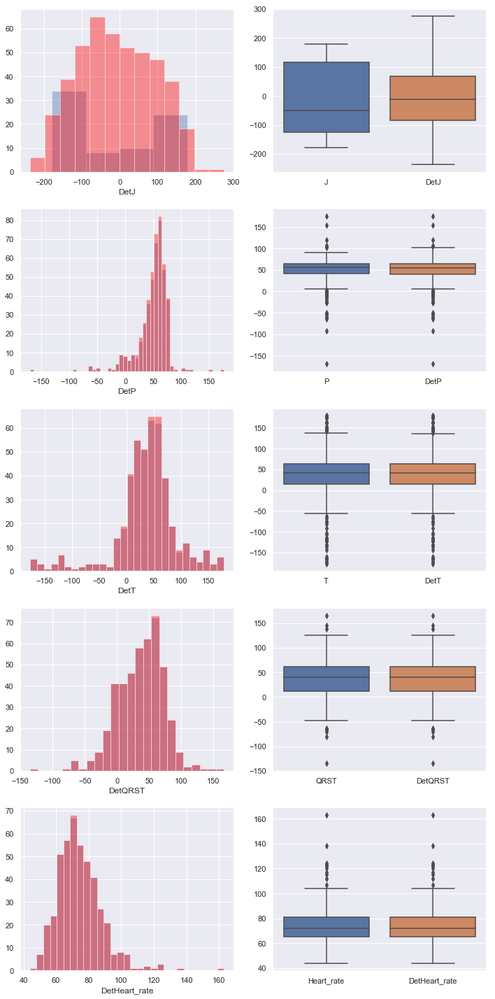

In [22]:
sns.set()
fig, axes = plt.subplots(nrows = len(missing_columns), ncols = 2)
fig.set_size_inches(10, 20)

for index, variable in enumerate(missing_columns):
    sns.distplot(data_reg[variable].dropna(), kde = False, ax = axes[index, 0])
    sns.distplot(deter_data["Det" + variable], kde = False, ax = axes[index, 0], color = 'red')
    
    sns.boxplot(data = pd.concat([data_reg[variable], deter_data["Det" + variable]], axis = 1),
                ax = axes[index, 1])
    
plt.tight_layout()

In [25]:
conc =pd.concat([data_reg[missing_columns], deter_data[["DetJ","DetP","DetT","DetQRST","DetHeart_rate"]]], axis = 1).describe().T

In [26]:
conc

,count,mean,std,min,25%,50%,75%,max
J,76.0,-13.592105,127.220248,-179.000000,-124.500000,-50.500000,117.250000,178.000000
P,430.0,48.913953,29.346409,-170.000000,41.000000,56.000000,65.000000,176.000000
T,444.0,36.150901,57.858255,-177.000000,14.000000,41.000000,63.250000,179.000000
QRST,451.0,36.716186,36.020725,-135.000000,12.000000,40.000000,62.000000,166.000000
Heart_rate,451.0,74.463415,13.870684,44.000000,65.000000,72.000000,81.000000,163.000000
DetJ,452.0,-8.938943,99.429167,-236.507758,-85.189202,-12.892473,67.907062,274.680523
DetP,452.0,48.905812,28.824942,-170.000000,40.000000,55.000000,65.000000,176.000000
DetT,452.0,36.308061,57.481958,-177.000000,14.000000,41.000000,63.000000,179.000000
DetQRST,452.0,36.759450,35.992523,-135.000000,12.000000,40.000000,62.000000,166.000000
DetHeart_rate,452.0,74.454488,13.856598,44.000000,65.000000,72.000000,81.000000,163.000000


In [27]:
data_reg.head()

,Age,Sex,Height_cm,Weight_kg,QRS_Duration,PR_interval,QT_Interval,T_Interval,P_interval,QRS,...,F_275,F_276,F_277,F_278,t,J_imp,P_imp,T_imp,QRST_imp,Heart_rate_imp
0,75.0,0.0,190.0,80.0,91.0,193.0,371.0,174.0,121.0,-16.0,...,0.9,2.9,23.3,49.4,8.0,-44.0,64.0,13.0,-2.0,63.0
1,56.0,1.0,165.0,64.0,81.0,174.0,401.0,149.0,39.0,25.0,...,0.2,2.1,20.4,38.8,6.0,175.0,-17.0,37.0,31.0,53.0
2,54.0,0.0,172.0,95.0,138.0,163.0,386.0,185.0,102.0,96.0,...,0.3,3.4,12.3,49.0,10.0,23.0,70.0,34.0,66.0,75.0
3,55.0,0.0,175.0,94.0,100.0,202.0,380.0,179.0,143.0,28.0,...,0.4,2.6,34.6,61.6,1.0,-157.0,-5.0,11.0,20.0,71.0
4,75.0,0.0,190.0,80.0,88.0,181.0,360.0,177.0,103.0,-16.0,...,-0.1,3.9,25.4,62.8,7.0,36.0,61.0,13.0,3.0,68.0


In [28]:
deter_data.head()

,DetJ,DetP,DetT,DetQRST,DetHeart_rate
0,33.913610,64.0,13.0,-2.0,63.000000
1,74.330840,-17.0,37.0,31.0,53.000000
2,23.000000,70.0,34.0,66.0,75.000000
3,-140.862884,-5.0,11.0,20.0,71.000000
4,91.917351,61.0,13.0,3.0,70.428662


#### Stochastic Regression Imputation

Per aggiungere incertezza ai valori delle variabili imputate, possiamo aggiungere del rumore normalmente distribuito con una media di zero e la varianza uguale all'errore standard delle stime di regressione. Questo metodo è conosciuto come imputazione casuale o imputazione via regressione stocastica

In [29]:
random_data = pd.DataFrame(columns = ["Ran" + name for name in missing_columns])

for feature in missing_columns:
        
    random_data["Ran" + feature] = data_reg[feature + '_imp']
    parameters = list(set(data_reg.columns) - set(missing_columns) - {feature + '_imp'})
    
    model = LinearRegression()
    model.fit(X = data_reg[parameters], y = data_reg[feature + '_imp'])
    
    #Standard Error of the regression estimates is equal to std() of the errors of each estimates
    predict = model.predict(data_reg[parameters])
    std_error = (predict[data_reg[feature].notnull()] - data_reg.loc[data_reg[feature].notnull(), feature + '_imp']).std()
    
    #observe that I preserve the index of the missing data from the original dataframe
    random_predict = np.random.normal(size = data_reg_1[feature].shape[0], 
                                      loc = predict, 
                                      scale = std_error)
    random_data.loc[(data_reg_1[feature].isnull()) & (random_predict > 0), "Ran" + feature] = random_predict[(data_reg_1[feature].isnull()) & 
                                                                            (random_predict > 0)]

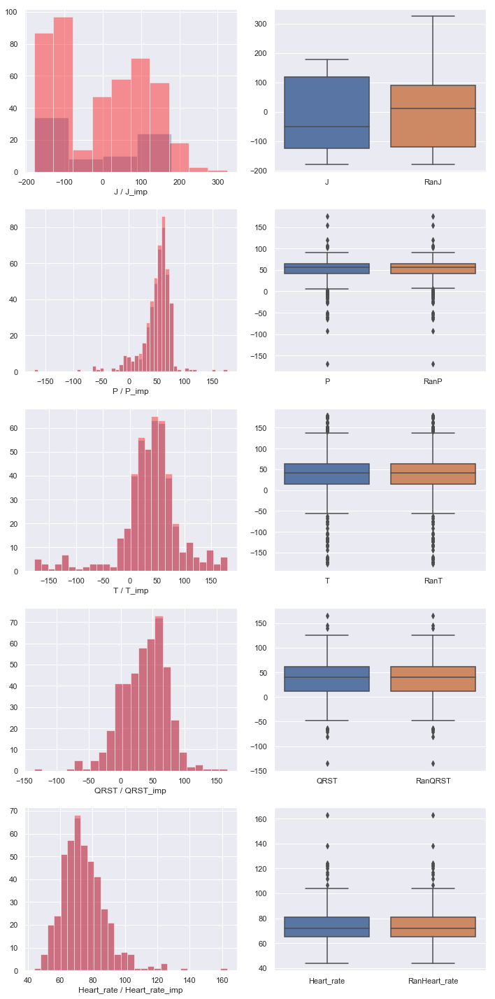

In [30]:
sns.set()
fig, axes = plt.subplots(nrows = len(missing_columns), ncols = 2)
fig.set_size_inches(10, 20)

for index, variable in enumerate(missing_columns):
    sns.distplot(data_reg_1[variable].dropna(), kde = False, ax = axes[index, 0])
    sns.distplot(random_data["Ran" + variable], kde = False, ax = axes[index, 0], color = 'red')
    axes[index, 0].set(xlabel = variable + " / " + variable + '_imp')
    
    sns.boxplot(data = pd.concat([data_reg_1[variable], random_data["Ran" + variable]], axis = 1),
                ax = axes[index, 1])
    
    plt.tight_layout()

In [41]:
conc_ran =pd.concat([data_reg_1[missing_columns], random_data[["RanJ","RanP","RanT","RanQRST","RanHeart_rate"]]], axis = 1).describe().T

In [42]:
conc_ran

,count,mean,std,min,25%,50%,75%,max
J,76.0,-13.592105,127.220248,-179.0,-124.50,-50.500000,117.250000,178.000000
P,430.0,48.913953,29.346409,-170.0,41.00,56.000000,65.000000,176.000000
T,444.0,36.150901,57.858255,-177.0,14.00,41.000000,63.250000,179.000000
QRST,451.0,36.716186,36.020725,-135.0,12.00,40.000000,62.000000,166.000000
Heart_rate,451.0,74.463415,13.870684,44.0,65.00,72.000000,81.000000,163.000000
RanJ,452.0,-6.108845,117.365481,-179.0,-119.50,10.324274,88.606421,324.271917
RanP,452.0,48.910043,28.815723,-170.0,40.75,56.000000,64.512353,176.000000
RanT,452.0,36.368630,57.469630,-177.0,14.00,41.000000,64.000000,179.000000
RanQRST,452.0,36.757256,35.991361,-135.0,12.00,40.000000,62.000000,166.000000
RanHeart_rate,452.0,74.454558,13.856577,44.0,65.00,72.000000,81.000000,163.000000


In [33]:
random_data.head()

,RanJ,RanP,RanT,RanQRST,RanHeart_rate
0,23.508081,64.0,13.0,-2.0,63.000000
1,79.965657,-17.0,37.0,31.0,53.000000
2,23.000000,70.0,34.0,66.0,75.000000
3,-157.000000,-5.0,11.0,20.0,71.000000
4,156.970336,61.0,13.0,3.0,70.460428


In [43]:
linear_d_regression = data.copy()
linear_s_regression = data.copy()

In [44]:
missing_columns

['J', 'P', 'T', 'QRST', 'Heart_rate']

In [45]:
# Sostituisco i valori imputati 
linear_d_regression['J'] = deter_data['DetJ']
linear_d_regression['P'] = deter_data['DetP']
linear_d_regression['T'] = deter_data['DetT']
linear_d_regression['QRST'] = deter_data['DetQRST']
linear_d_regression['Heart_rate'] = deter_data['DetHeart_rate']  

In [46]:
linear_s_regression['J'] = random_data['RanJ']
linear_s_regression['P'] = random_data['RanP']
linear_s_regression['T'] = random_data['RanT']
linear_s_regression['QRST'] = random_data['RanQRST']
linear_s_regression['Heart_rate'] = random_data['RanHeart_rate']

In [47]:
linear_d_regression_t = linear_d_regression.copy()
linear_s_regression_t = linear_s_regression.copy()

In [48]:
linear_d_regression = linear_d_regression.drop(columns='t')
linear_s_regression = linear_s_regression.drop(columns='t')

In [49]:
A_reg_det = np.array(linear_d_regression)
A_reg_det = A_reg_det.astype(np.float64)
A_reg_stoc = np.array(linear_s_regression)
A_reg_stoc = A_reg_stoc.astype(np.float64)

Creo un modello di regressione dove come y abbiamo la colonna dove sono presenti i missing values e sulle x abbiamo la colonna con la quale ha correlazione più alta

 <a id="Distributions"></a>
<h3>Studio delle distribuzioni delle features pià informative dei dataset ottenuti mediante imputation <a href="#indice" style="text-decoration:none;">↑</a></h3>


## Descrizione della sezione

In questa sezione andiamo ad analizzare i dataset ottenuti dalle diverse tecniche di imputation indagando sulle distribuzioni delle 3 features più rilevanti.
Nello specifico il processo sarà il seguente:

Dato un dataset generico, calcoliamo mediante mutua informazione le features "globali" più informative ed eseguiamo dei fittings per trovare le distribuzioni che meglio si adattano a tali features. 



### Prendiamo le features che hanno mutua informazione più alta con i target value

In questa sezione indagheremo il contenuto informativo delle features con i valori target

Calcoleremo mutua informazione per ognuno dei dataset ottenuti tramite imputazione e confronteremo i risultati ottenuti.

Dopodichè studieremo la distribuzione di tali features cercando di eseguire un fitting con delle distribuzioni note

#### Normalizzazione dei dati

In [50]:
target = data['t']
target = np.asarray(target,int)

In [51]:
scaler = StandardScaler()

In [52]:
scaled_matrix_del =scaler.fit_transform(A_del_matrix)

In [53]:
scaled_del_full = scaler.fit_transform(A_del_df)

In [54]:
renamed = {}
j = 0
for i in f_n_del:
    renamed[j] = i
    j+=1

scaled_del_df =  pd.DataFrame(data =scaled_del_full )
scaled_del_df.rename(columns = renamed,inplace = True)
scaled_del_df['t']=target

In [ ]:
f_n_del.remove('t')

In [149]:
renamed = {}
j = 0
for i in f_n_del:
    renamed[j] = i
    j+=1


In [55]:
# Ora per la media
scaled_matrix_means =scaler.fit_transform(A_means)

In [56]:
# Ora per la mediana
scaled_matrix_medians =scaler.fit_transform(A_medians)

In [57]:
#Ora per la moda
scaled_matrix_mode =scaler.fit_transform(A_mode)

In [58]:
#Ora per la regressione
scaled_matrix_det_regression =scaler.fit_transform(A_reg_det)
scaled_matrix_stoc_regression = scaler.fit_transform(A_reg_stoc)

Calcoliamo la mutua informazione sul dataset con il primo tipo di imputazione (eliminazione delle features)

<strong> Mutua informazione per il dataset completo ottenuto cancellando le features mancanti</strong>

In [250]:
mutual_information_deleted = mutual_info_classif(scaled_matrix_del,target)

In [251]:
mutual_information_deleted = np.asarray(mutual_information_deleted)
index_1_deleted = mutual_information_deleted.argmax()
mutual_information_deleted[index_1_deleted] = 0
index_2_deleted = mutual_information_deleted.argmax()
mutual_information_deleted[index_2_deleted] = 0
index_3_deleted = mutual_information_deleted.argmax()
mutual_information_deleted[index_3_deleted] = 0

In [252]:
print("Indici dele features con mutua informazione più alta (no split): \n Indice 1: ",index_1_deleted," Indice 2: ", index_2_deleted, " Indice 3: ",index_3_deleted)

Indici dele features con mutua informazione più alta (no split): 
 Indice 1:  108  Indice 2:  271  Indice 3:  222


<strong>Fitting per la prima feature più informativa</strong>

Senza Splitting: Feature con indice 271 

Miglior distribuzione  dgamma(a=0.91, loc=-0.10, scale=0.48)
Miglior distribuzione  rdist(c=1.22, loc=-0.32, scale=1.44)
Miglior distribuzione  exponweib(a=0.70, c=0.70, loc=-2.54, scale=0.03)
Miglior distribuzione  laplace(loc=0.14, scale=0.36)
Miglior distribuzione  chi(df=0.22, loc=-0.83, scale=1.62)
Miglior distribuzione  johnsonsu(a=2.23, b=0.19, loc=0.63, scale=0.00)
Miglior distribuzione  gausshyper(a=1.09, b=0.18, c=1.38, z=1.11, loc=-2.55, scale=2.94)
Miglior distribuzione  alpha(a=0.00, loc=0.38, scale=0.00)
Miglior distribuzione  chi(df=0.20, loc=2.58, scale=2.06)
Miglior distribuzione  dweibull(c=0.96, loc=0.14, scale=0.80)
Miglior distribuzione  lognorm(s=6.44, loc=0.14, scale=0.00)
Miglior distribuzione  johnsonsu(a=2.19, b=0.20, loc=1.12, scale=0.00)
Miglior distribuzione  gennorm(beta=0.33, loc=0.14, scale=0.01)


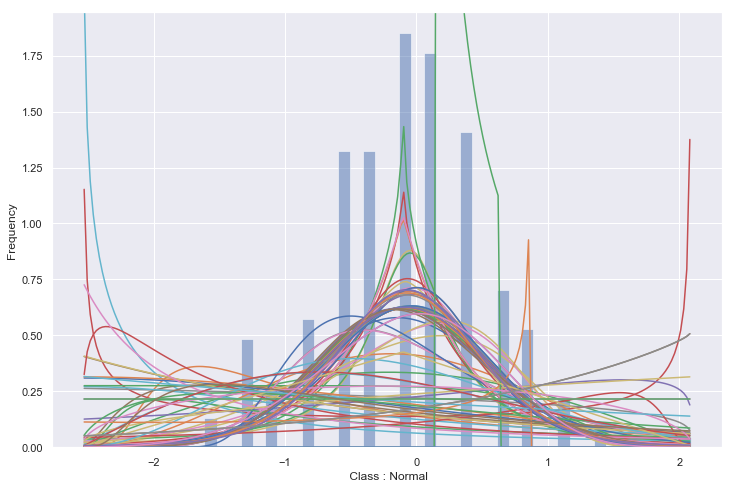

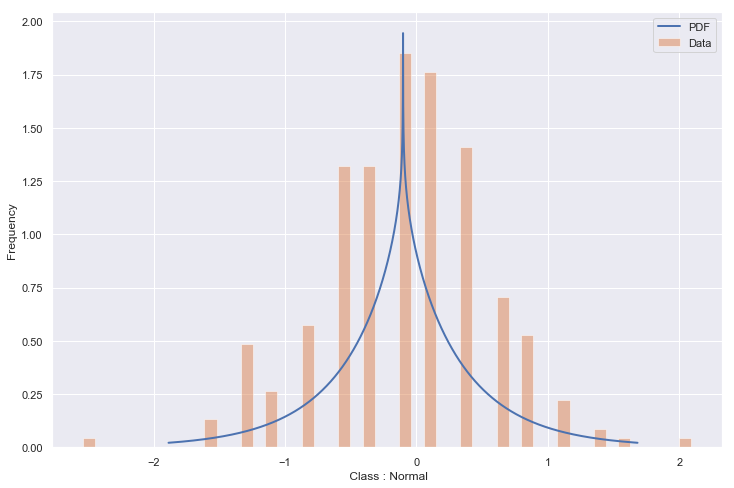

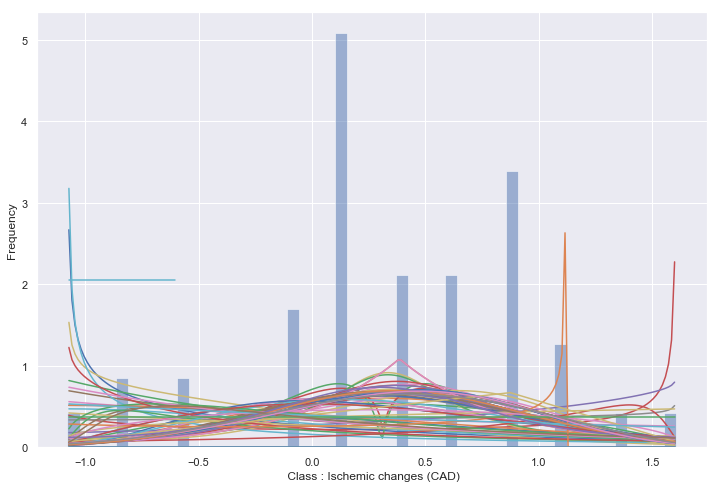

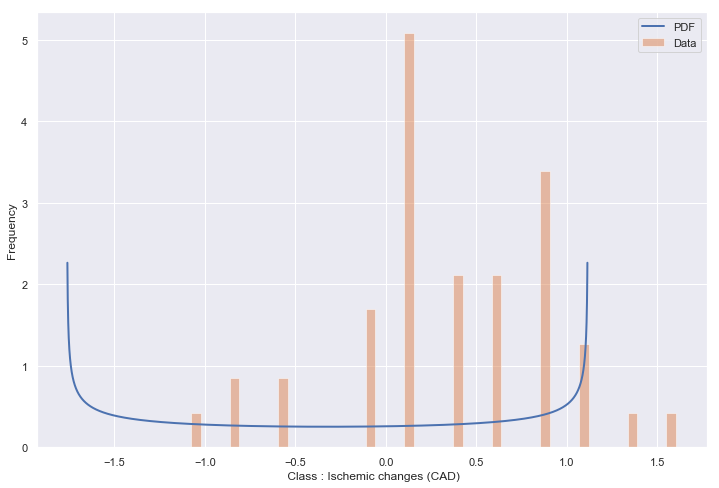

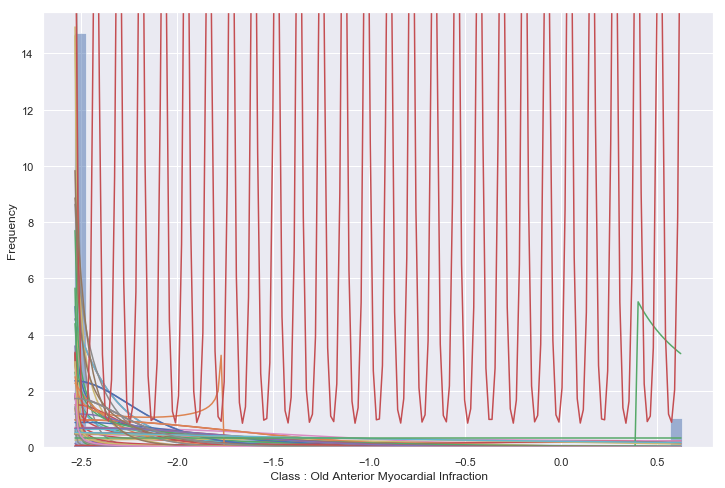

...

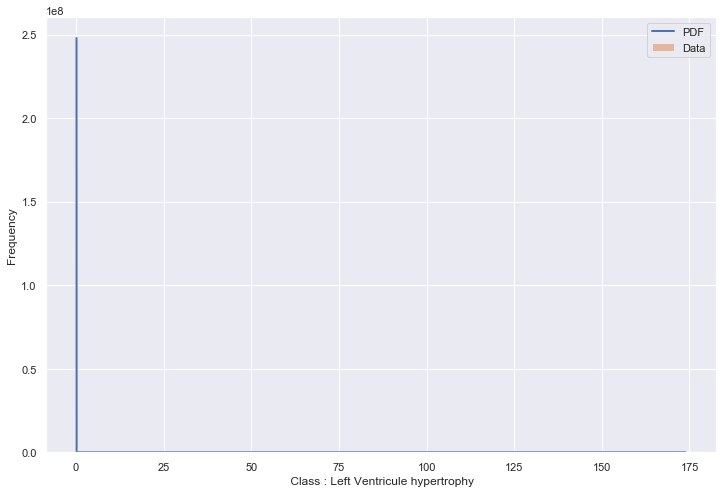

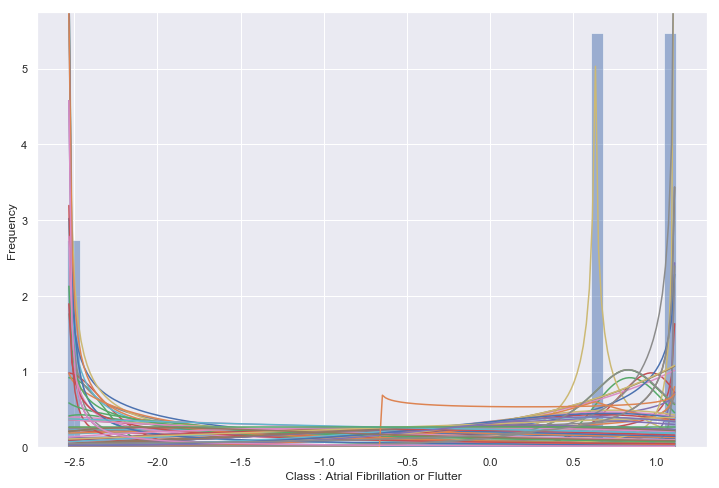

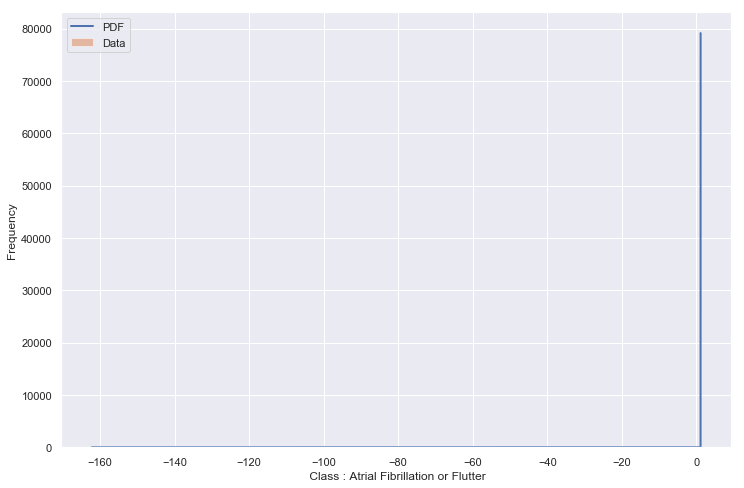

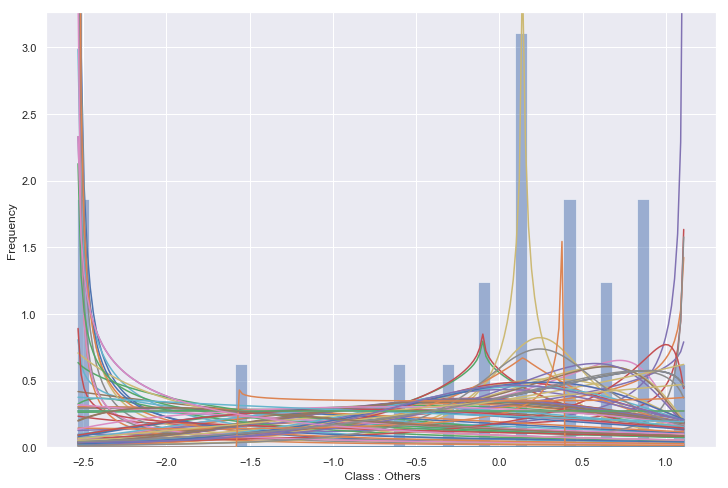

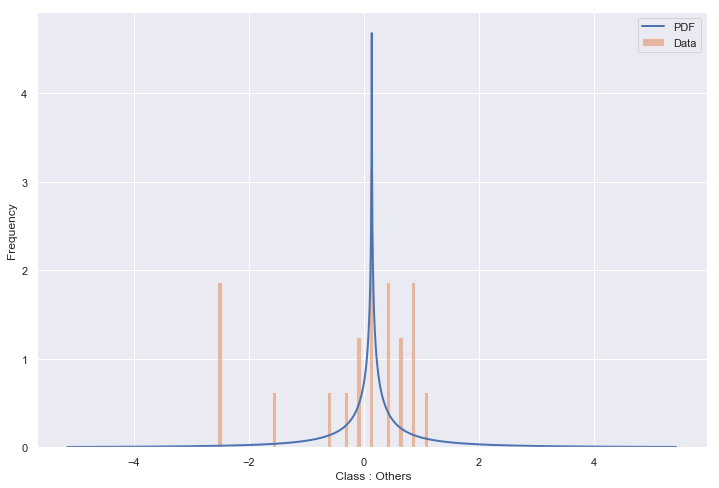

In [255]:
for i in range(1,17):
    if(i not in [11,12,13]):
        get_best_fitting(scaled_del_df[scaled_del_df['t']==i][f_n_del[index_1_deleted]].astype("float")," Class : "+class_names[i-1])

<strong>Fitting per la seconda feature più informativa</strong>

Senza Splitting: Feature con indice 191 

Miglior distribuzione  vonmises_line(kappa=2.74, loc=0.26, scale=0.99)
Miglior distribuzione  gennorm(beta=3.12, loc=-1.30, scale=1.33)
Miglior distribuzione  johnsonsb(a=-0.36, b=0.12, loc=-2.40, scale=2.67)
Miglior distribuzione  gennorm(beta=0.26, loc=-0.65, scale=0.00)
Miglior distribuzione  johnsonsb(a=-0.03, b=0.15, loc=-0.93, scale=2.74)
Miglior distribuzione  kstwobign(loc=-1.59, scale=2.22)
Miglior distribuzione  levy(loc=-1.63, scale=0.00)
Miglior distribuzione  foldcauchy(c=0.01, loc=-0.30, scale=0.00)
Miglior distribuzione  dgamma(a=0.69, loc=-2.19, scale=1.65)
Miglior distribuzione  dgamma(a=1.65, loc=0.48, scale=0.37)
Miglior distribuzione  johnsonsu(a=4.48, b=0.31, loc=1.25, scale=0.00)
Miglior distribuzione  powerlognorm(c=0.39, s=3.57, loc=-2.05, scale=0.00)
Miglior distribuzione  dgamma(a=2.53, loc=-0.24, scale=0.34)


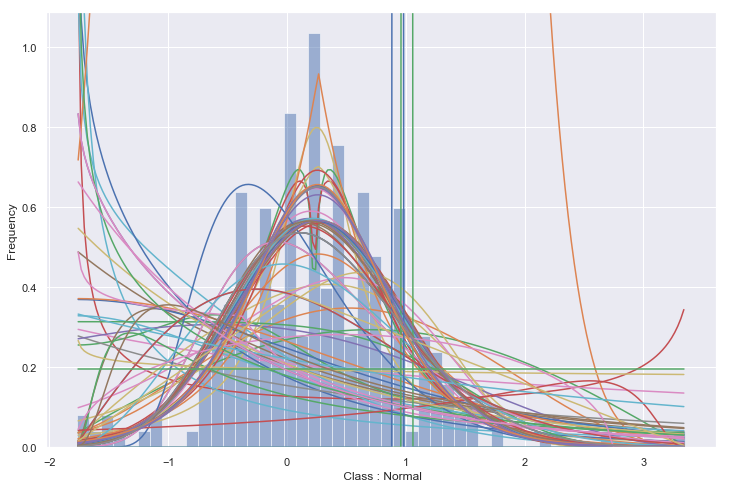

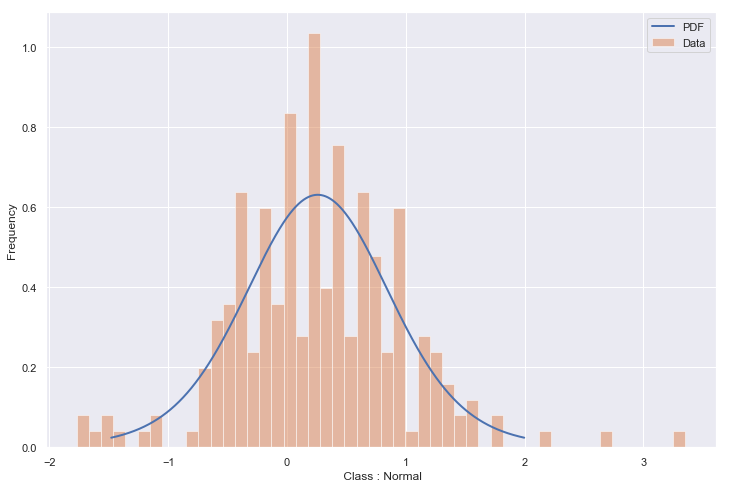

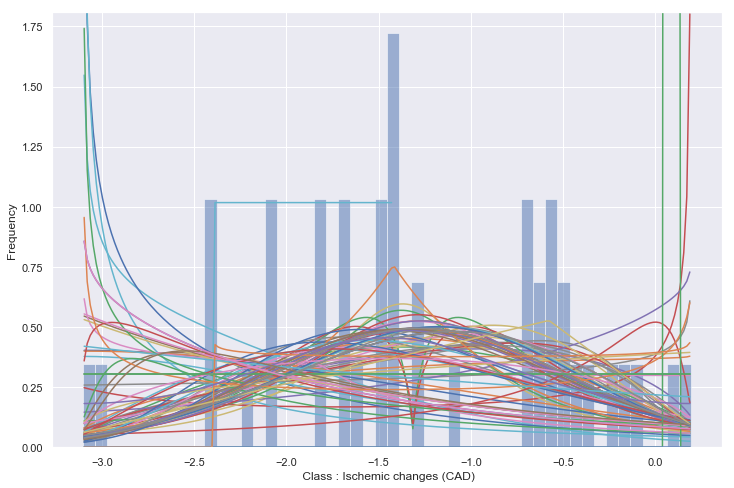

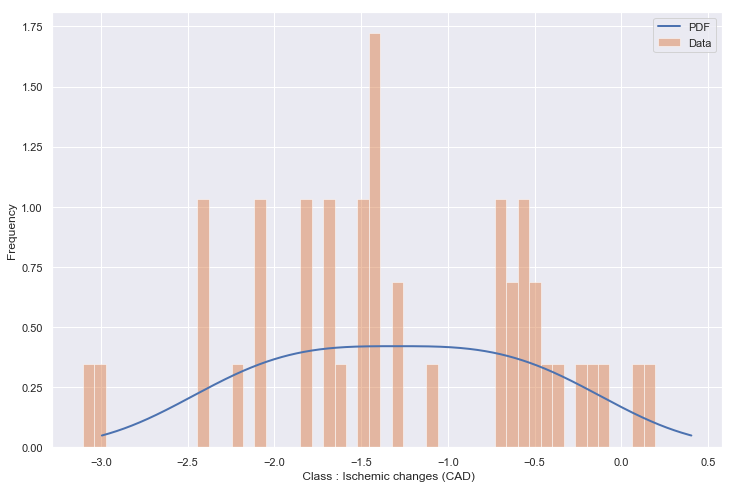

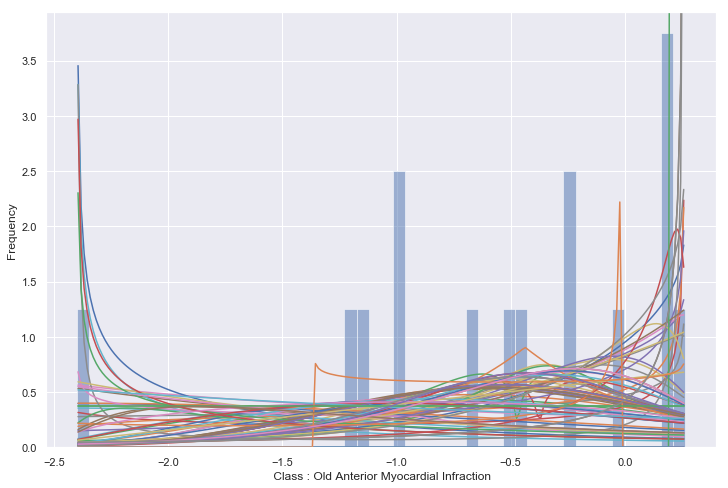

...

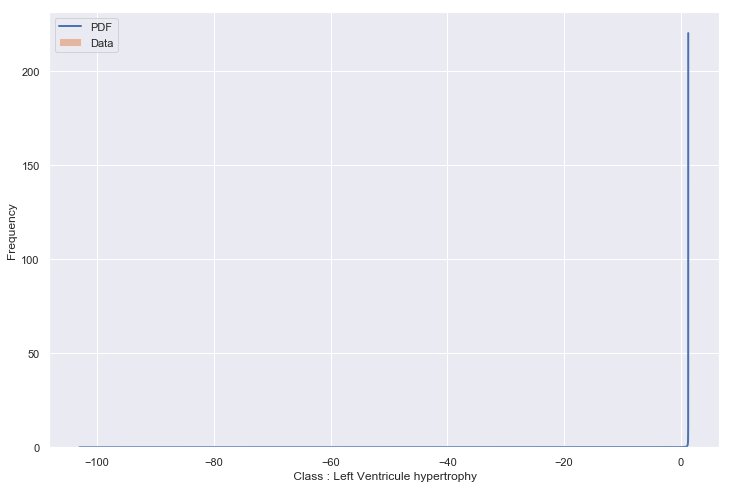

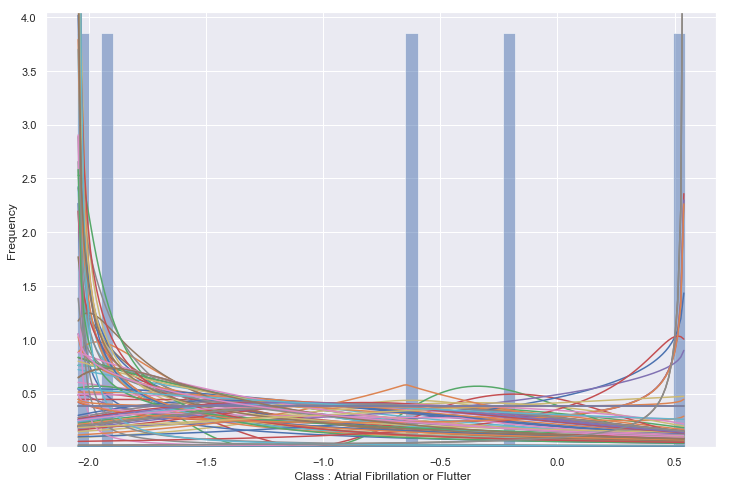

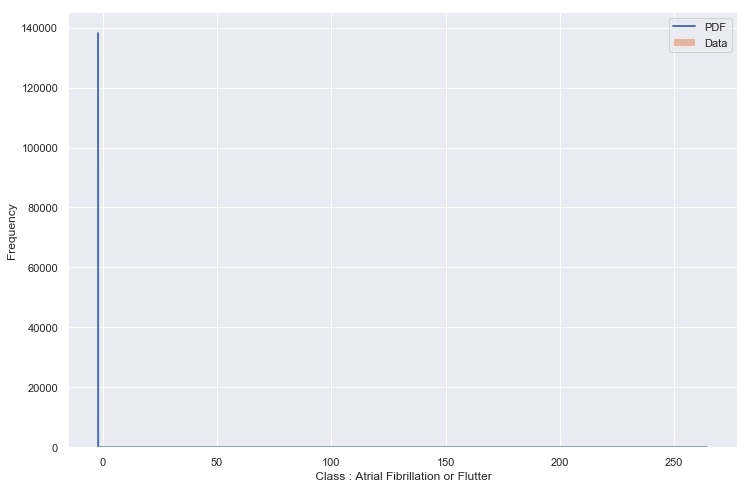

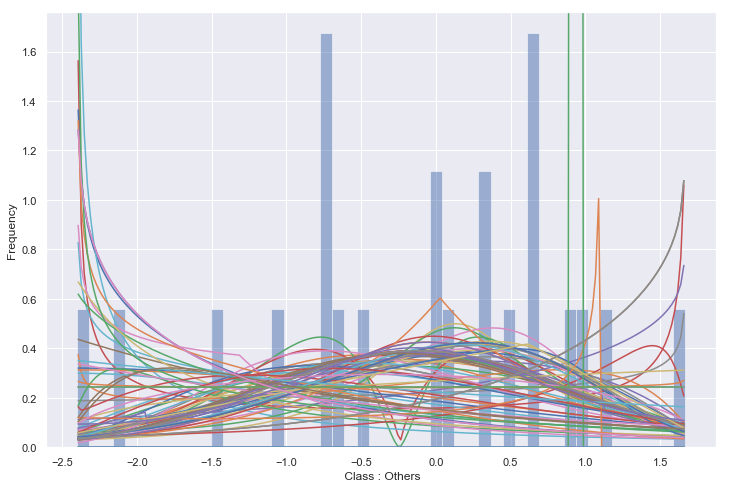

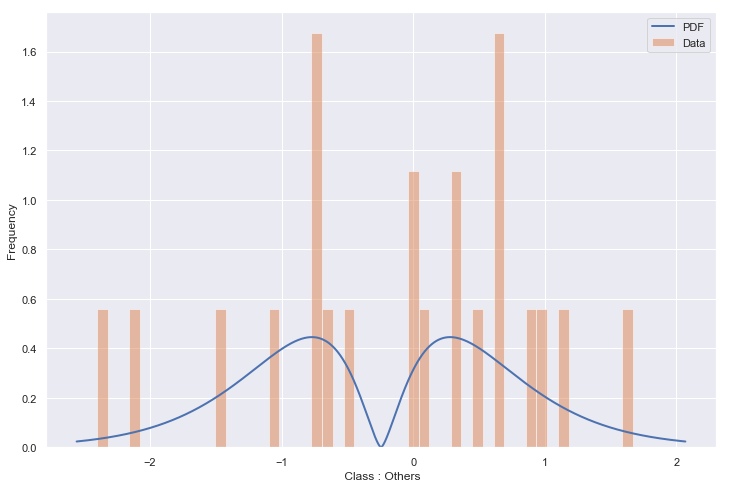

In [256]:
for i in range(1,17):
    if(i not in [11,12,13]):
        get_best_fitting(scaled_del_df[scaled_del_df['t']==i][f_n_del[index_2_deleted]].astype("float")," Class : "+class_names[i-1])

<strong>Fitting per la terza feature più informativa</strong>

Senza Splitting: Feature con indice 108

Miglior distribuzione  exponweib(a=1.70, c=31326238.63, loc=-14065122.40, scale=14065122.37)
Miglior distribuzione  dgamma(a=1.40, loc=-0.18, scale=0.33)
Miglior distribuzione  dweibull(c=0.83, loc=-0.33, scale=0.30)
Miglior distribuzione  dgamma(a=1.79, loc=0.11, scale=0.22)
Miglior distribuzione  johnsonsb(a=0.31, b=0.13, loc=-0.40, scale=3.05)
Miglior distribuzione  vonmises_line(kappa=0.28, loc=-0.00, scale=0.17)
Miglior distribuzione  johnsonsu(a=3.51, b=0.33, loc=-0.25, scale=0.00)
Miglior distribuzione  halfcauchy(loc=-0.22, scale=0.00)
Miglior distribuzione  dgamma(a=0.59, loc=-2.90, scale=1.48)
Miglior distribuzione  dgamma(a=0.57, loc=0.57, scale=1.25)
Miglior distribuzione  betaprime(a=0.22, b=1.27, loc=-1.79, scale=1.10)
Miglior distribuzione  johnsonsb(a=-1.24, b=0.14, loc=0.11, scale=0.28)
Miglior distribuzione  gennorm(beta=0.76, loc=-0.02, scale=0.35)


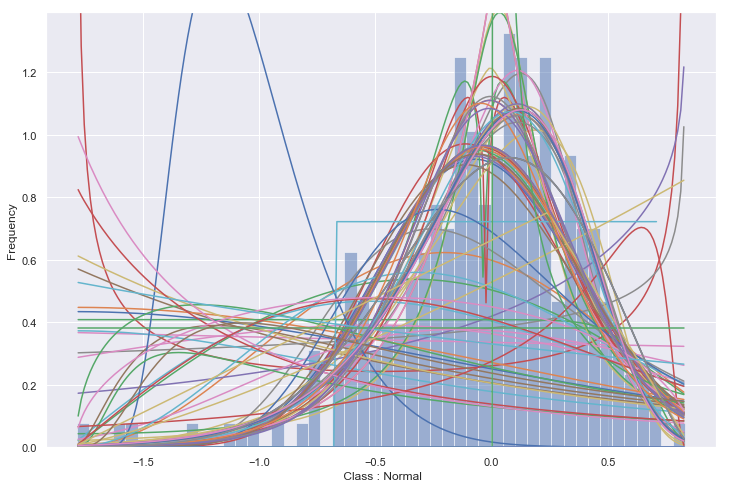

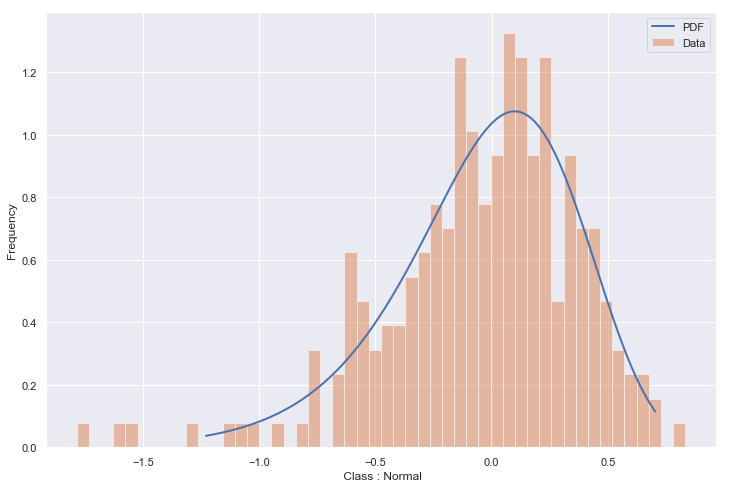

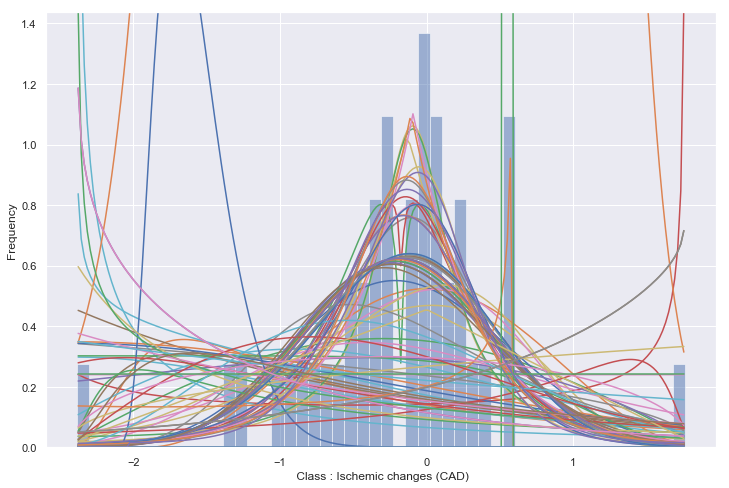

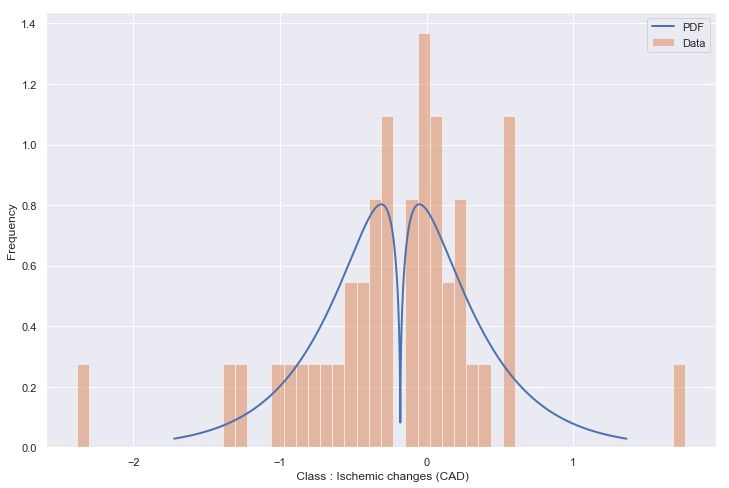

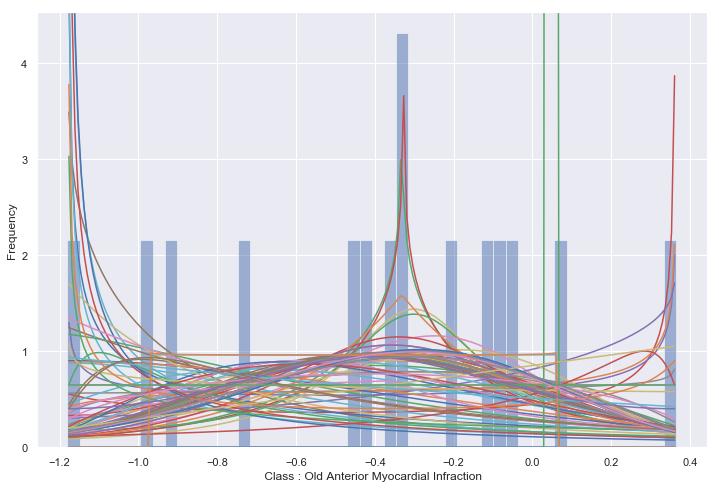

...

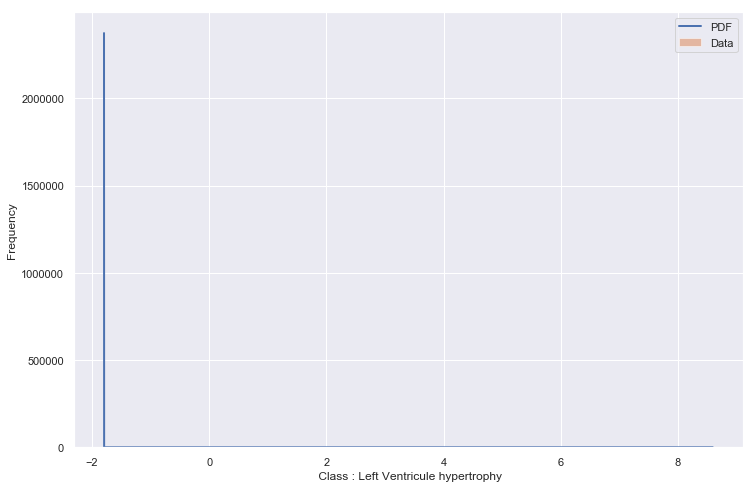

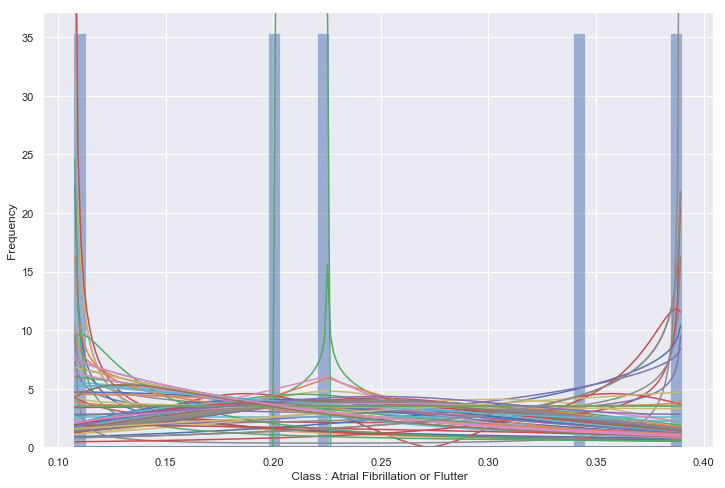

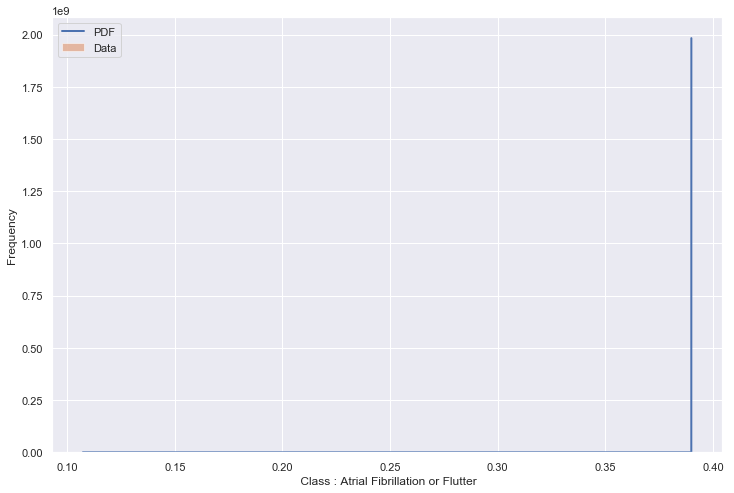

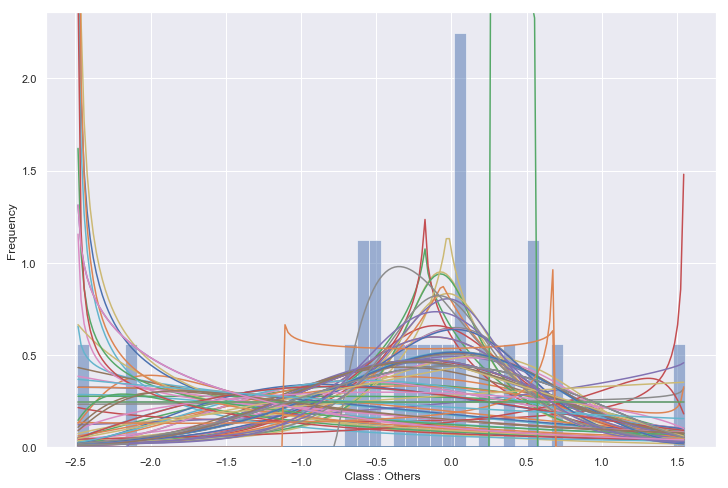

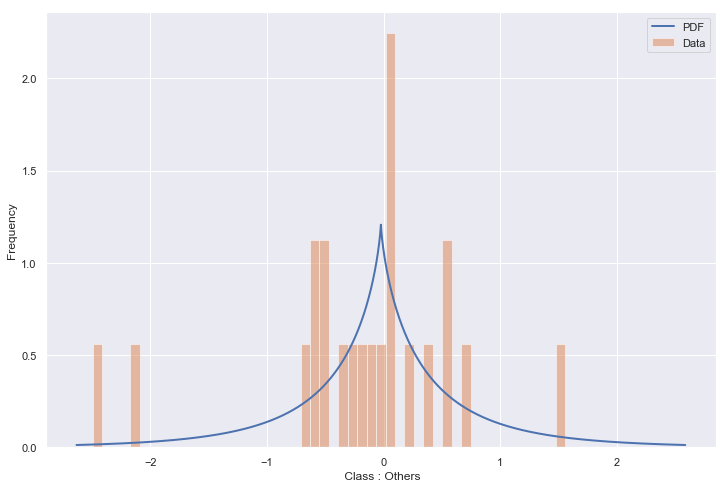

In [257]:
for i in range(1,17):
    if(i not in [11,12,13]):
        get_best_fitting(scaled_del_df[scaled_del_df['t']==i][f_n_del[index_3_deleted]].astype("float")," Class : "+class_names[i-1])

Calcoliamo la mutua informazione sul dataset con il secondo tipo di imputazione (imputazione con valori medi)

<strong> Mutua informazione per il dataset completo ottenuto imputando i valori mancanti con la media</strong>

In [ ]:
#A_means.reshape((452,280))
mutual_information_means = mutual_info_classif(scaled_matrix_means,target)
mutual_information_means = np.asarray(mutual_information_means)
index_1_means = mutual_information_means.argmax()
mutual_information_means[index_1_means] = 0
index_2_means = mutual_information_means.argmax()
mutual_information_means[index_2_means] = 0
index_3_means = mutual_information_means.argmax()
mutual_information_means[index_3_means] = 0


In [65]:
print("Indici dele features con mutua informazione più alta (no split): \n Indice 1: ",index_1_means," Indice 2: ",index_2_means, " Indice 3: ",index_3_means)

Indici dele features con mutua informazione più alta (no split): 
 Indice 1:  13  Indice 2:  195  Indice 3:  112


In [67]:
f_n.remove('t')

In [68]:
A_means_df = pd.DataFrame(scaled_matrix_means,columns = f_n)

In [69]:
A_means_df['t']=target

<strong>Fitting per la prima feature più informativa</strong>

Senza Splitting: Indice feature 13

Miglior distribuzione  johnsonsb(a=1.15, b=1.48, loc=0.06, scale=0.55)
Miglior distribuzione  vonmises_line(kappa=0.76, loc=0.28, scale=0.06)
Miglior distribuzione  arcsine(loc=0.13, scale=0.51)
Miglior distribuzione  arcsine(loc=0.24, scale=0.21)
Miglior distribuzione  gennorm(beta=0.18, loc=0.50, scale=0.00)
Miglior distribuzione  dgamma(a=1.45, loc=0.08, scale=0.02)
Miglior distribuzione  levy_l(loc=0.35, scale=0.00)
Miglior distribuzione  johnsonsu(a=5.76, b=0.47, loc=0.21, scale=0.00)
Miglior distribuzione  johnsonsb(a=-0.59, b=0.14, loc=0.10, scale=0.20)
Miglior distribuzione  dgamma(a=0.74, loc=0.24, scale=0.10)
Miglior distribuzione  erlang(a=0.12, loc=0.32, scale=0.03)
Miglior distribuzione  beta(a=0.19, b=0.30, loc=0.23, scale=0.37)
Miglior distribuzione  triang(c=0.14, loc=0.06, scale=0.50)


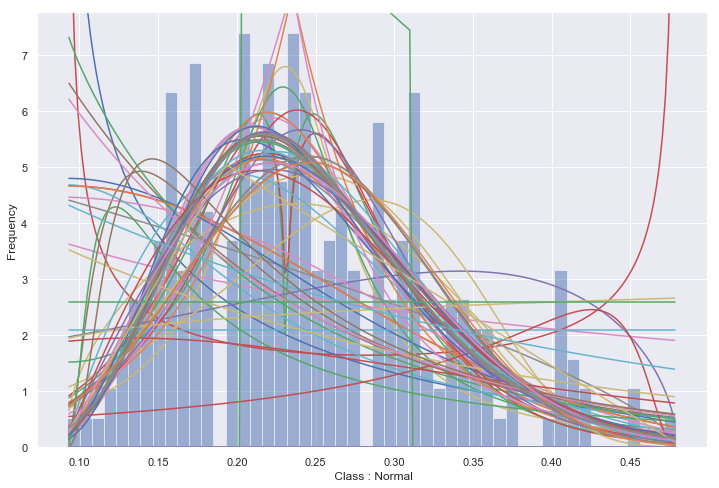

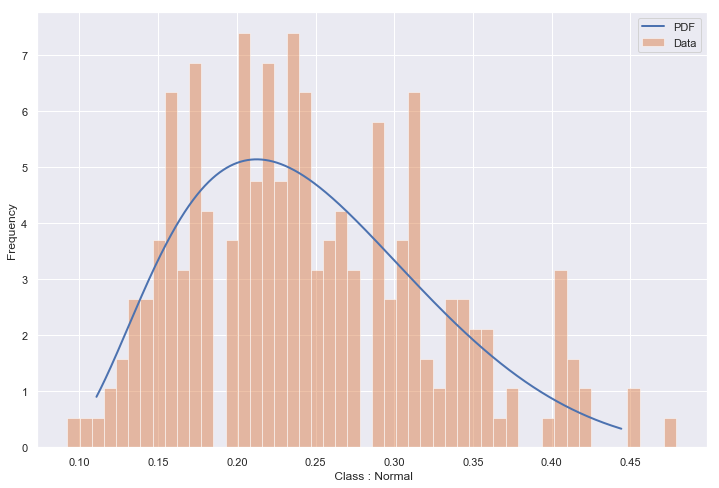

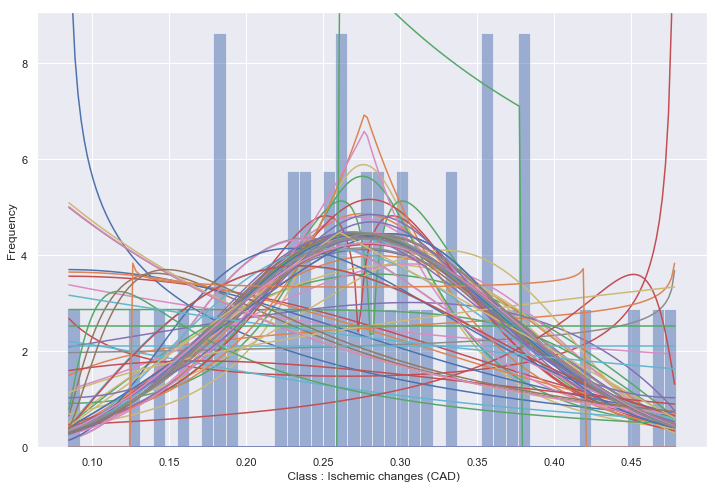

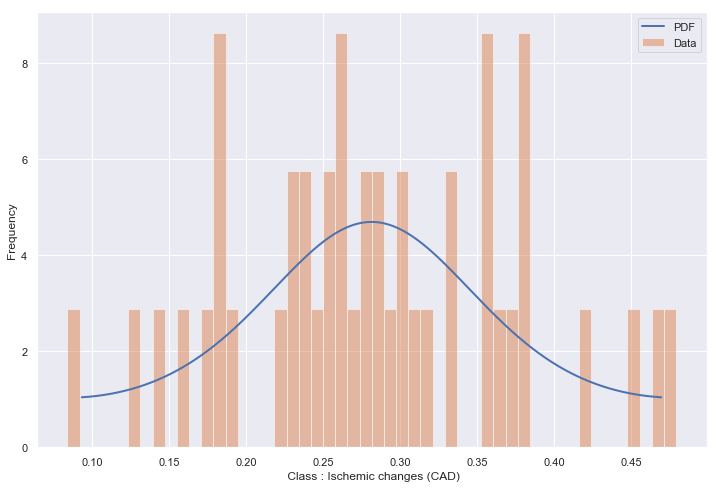

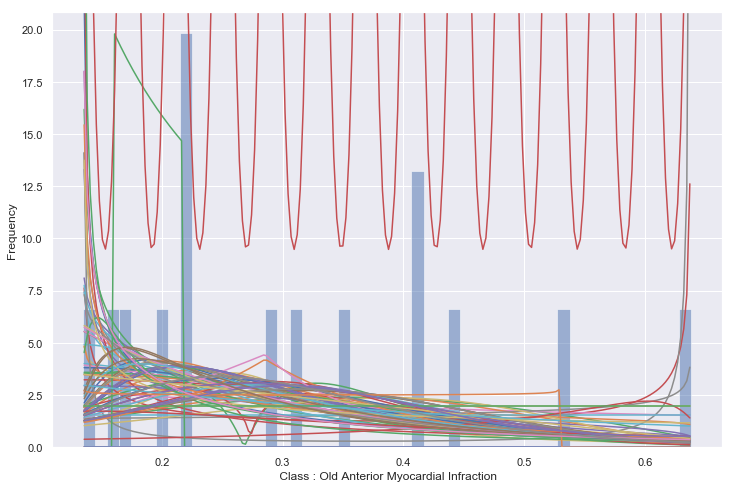

...

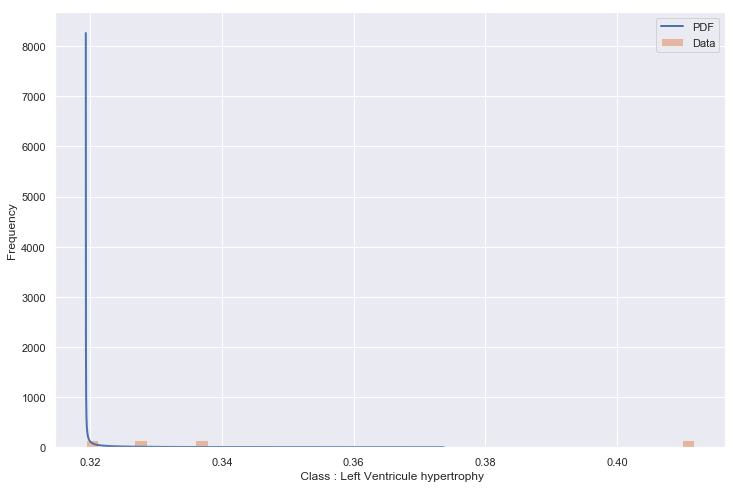

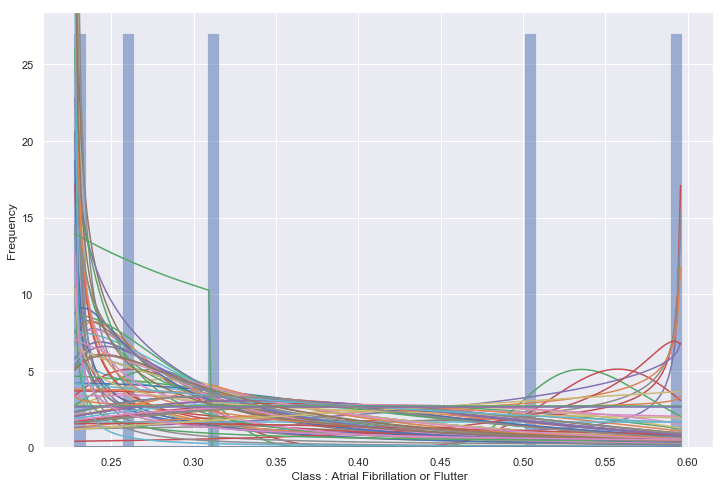

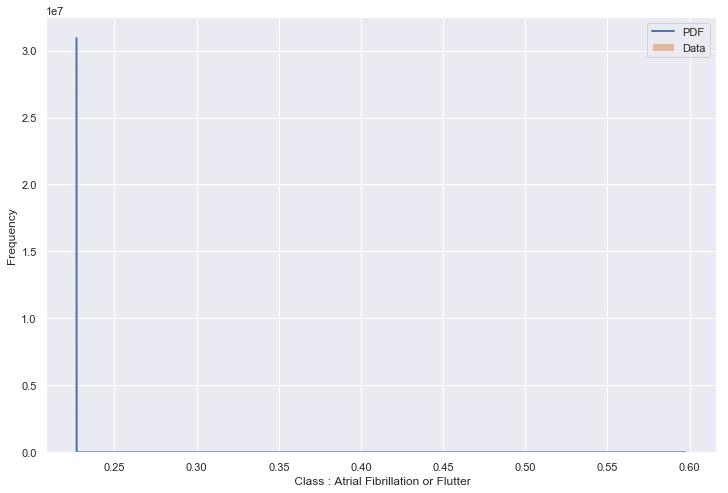

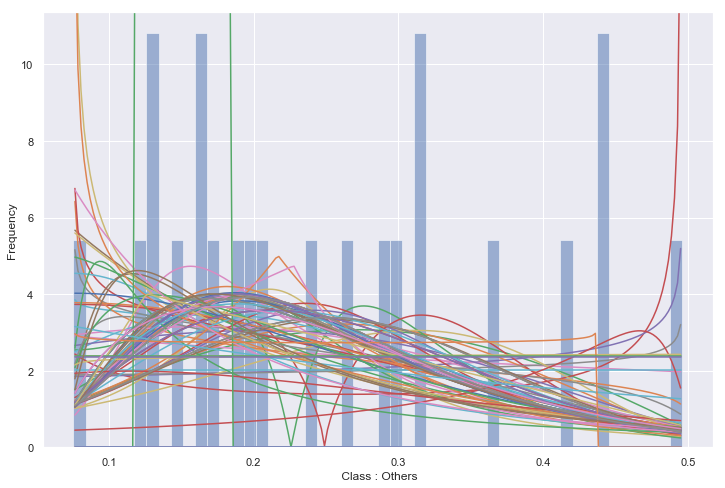

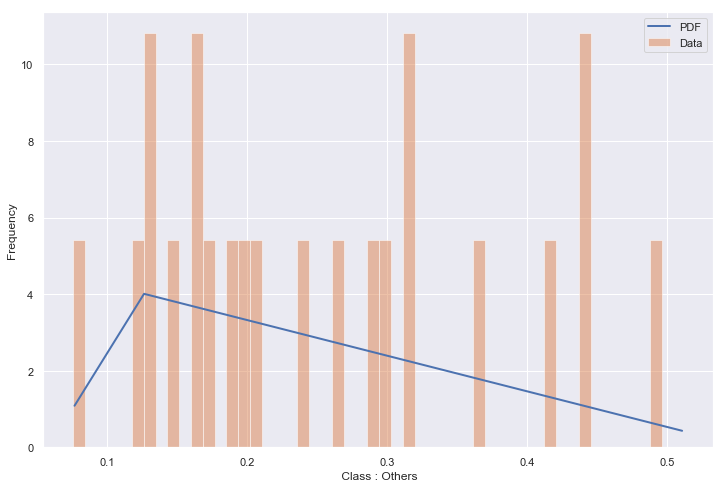

In [257]:
for i in range(1,17):
    if(i not in [11,12,13]):
        get_best_fitting(A_means_df[A_means_df['t']==i][f_n[index_1_means]].astype("float")," Class : "+class_names[i-1])

<strong>Fitting per la seconda feature più informativa</strong>

Senza Splitting: Indice feature 275

Miglior distribuzione  exponnorm(K=0.59, loc=0.59, scale=0.07)
Miglior distribuzione  dgamma(a=2.65, loc=0.47, scale=0.03)
Miglior distribuzione  johnsonsb(a=-0.19, b=0.17, loc=0.32, scale=0.32)
Miglior distribuzione  gennorm(beta=0.09, loc=0.53, scale=0.00)
Miglior distribuzione  johnsonsb(a=-0.25, b=0.22, loc=0.49, scale=0.33)
Miglior distribuzione  kstwobign(loc=0.41, scale=0.26)
Miglior distribuzione  levy(loc=0.41, scale=0.00)
Miglior distribuzione  halfcauchy(loc=0.57, scale=0.00)
Miglior distribuzione  dgamma(a=0.74, loc=0.37, scale=0.18)
Miglior distribuzione  dgamma(a=1.65, loc=0.66, scale=0.04)
Miglior distribuzione  johnsonsu(a=2.79, b=0.19, loc=0.75, scale=0.00)
Miglior distribuzione  lognorm(s=5.85, loc=0.36, scale=0.00)
Miglior distribuzione  dgamma(a=2.53, loc=0.57, scale=0.04)


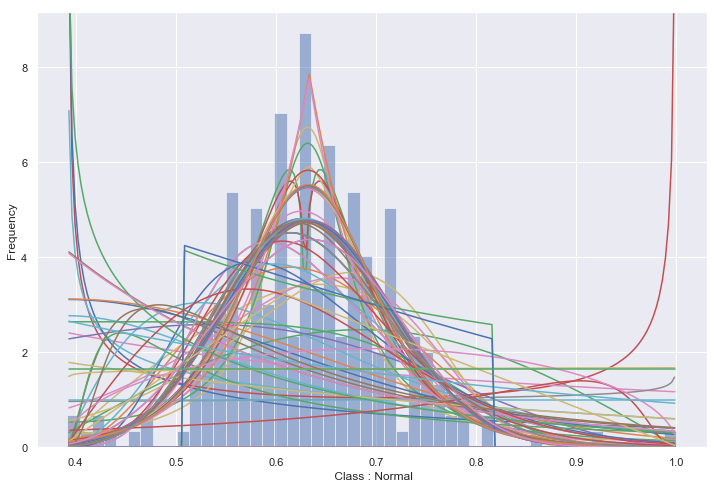

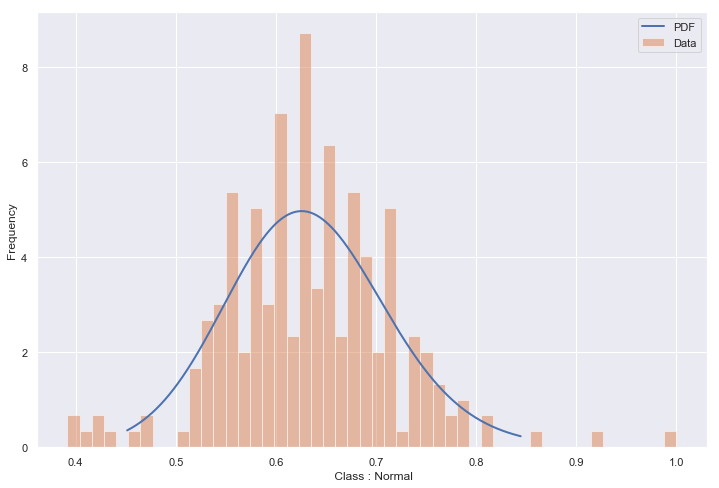

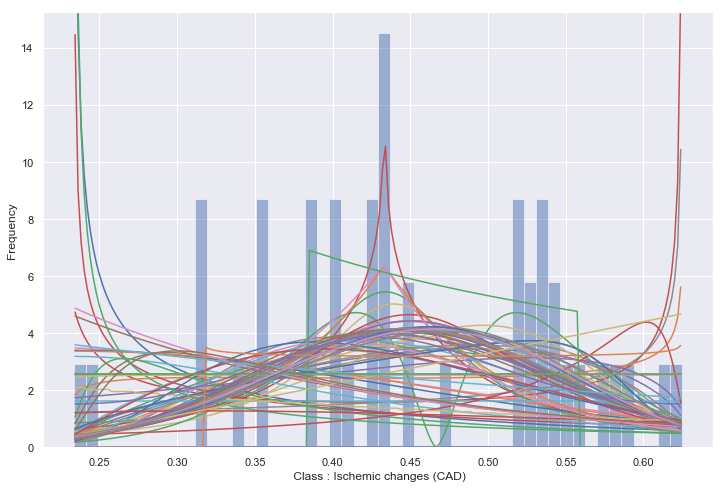

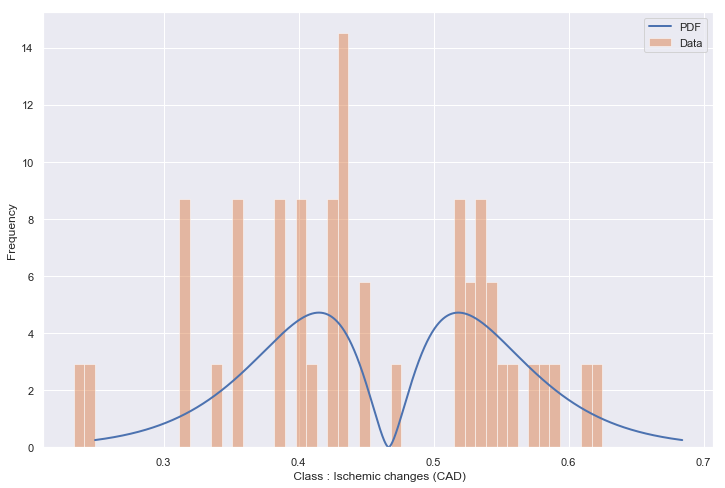

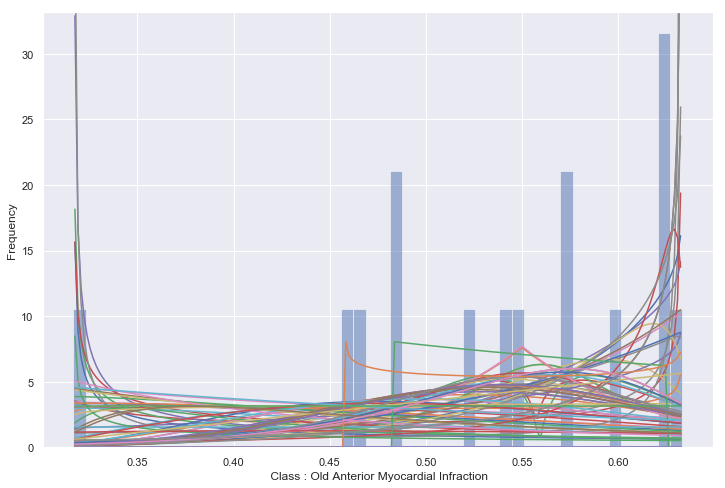

...

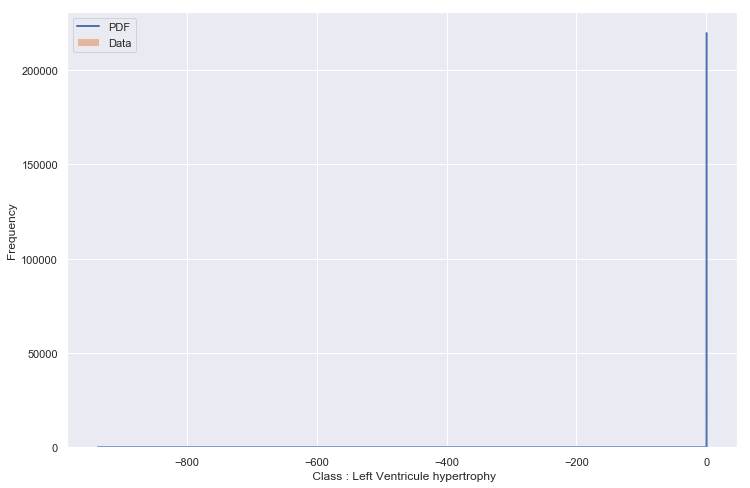

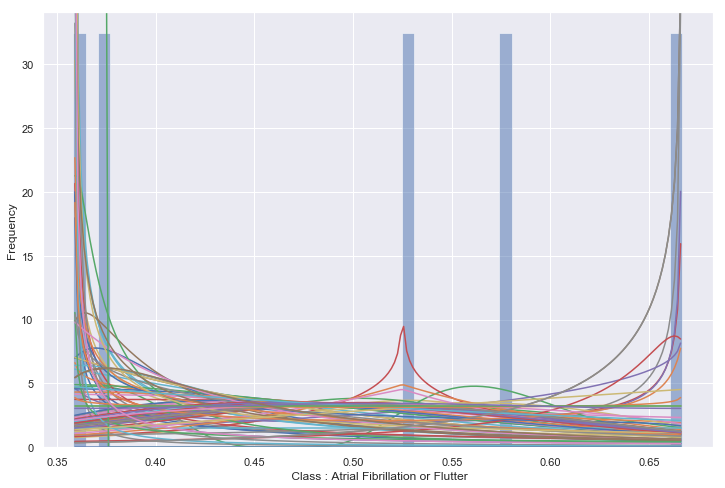

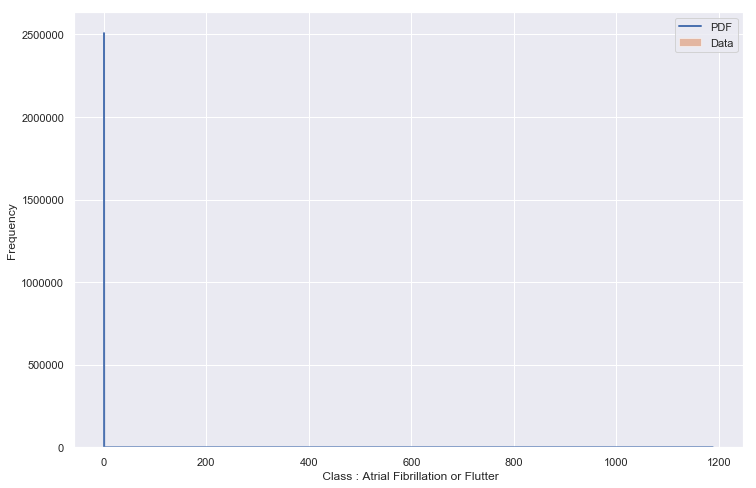

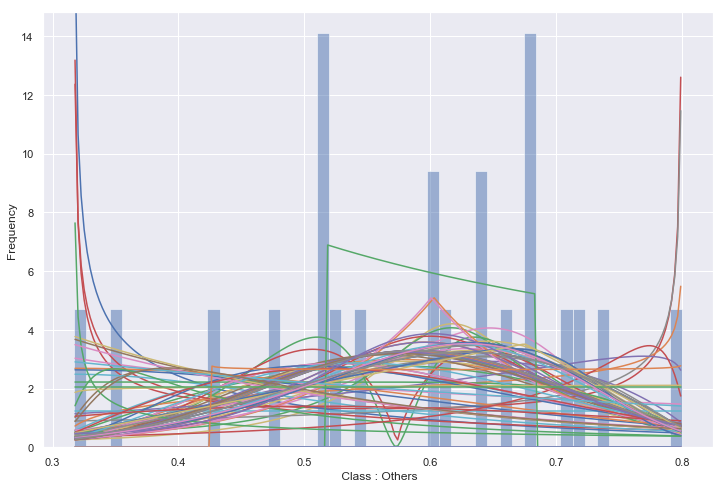

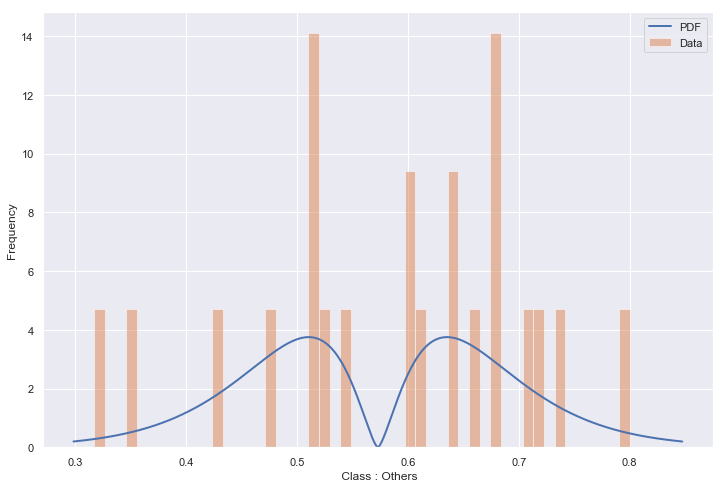

In [259]:
for i in range(1,17):
    if(i not in [11,12,13]):
        get_best_fitting(A_means_df[A_means_df['t']==i][f_n[index_2_means]].astype("float")," Class : "+class_names[i-1])

<strong>Fitting per la seconda feature più informativa</strong>

Senza Splitting: Indice feature 195

Miglior distribuzione  dweibull(c=1.33, loc=0.23, scale=0.07)
Miglior distribuzione  vonmises_line(kappa=0.35, loc=0.39, scale=0.05)
Miglior distribuzione  dgamma(a=0.85, loc=0.33, scale=0.07)
Miglior distribuzione  gennorm(beta=0.10, loc=0.34, scale=0.00)
Miglior distribuzione  dweibull(c=0.51, loc=0.28, scale=0.09)
Miglior distribuzione  dgamma(a=1.64, loc=0.25, scale=0.03)
Miglior distribuzione  genextreme(c=-1.97, loc=0.18, scale=0.00)
Miglior distribuzione  halfcauchy(loc=0.21, scale=0.00)
Miglior distribuzione  pearson3(skew=2.59, loc=0.59, scale=0.12)
Miglior distribuzione  dweibull(c=1.38, loc=0.22, scale=0.07)
Miglior distribuzione  burr(c=0.76, d=0.71, loc=0.10, scale=0.01)
Miglior distribuzione  bradford(c=77229.50, loc=0.28, scale=0.52)
Miglior distribuzione  gausshyper(a=0.77, b=0.93, c=0.59, z=1.54, loc=0.14, scale=0.35)


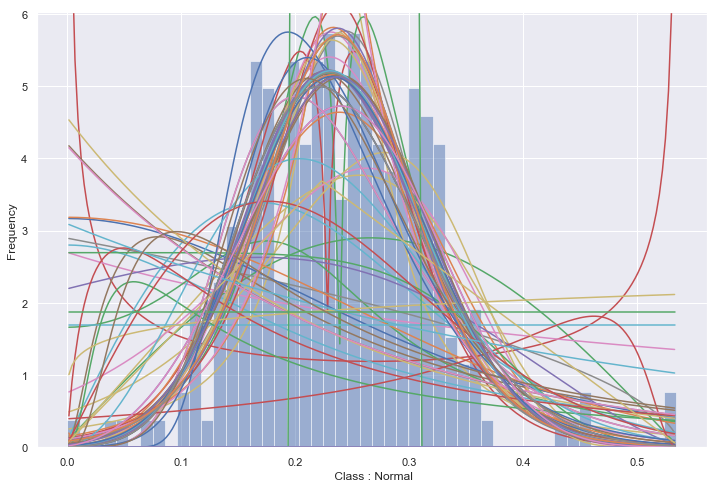

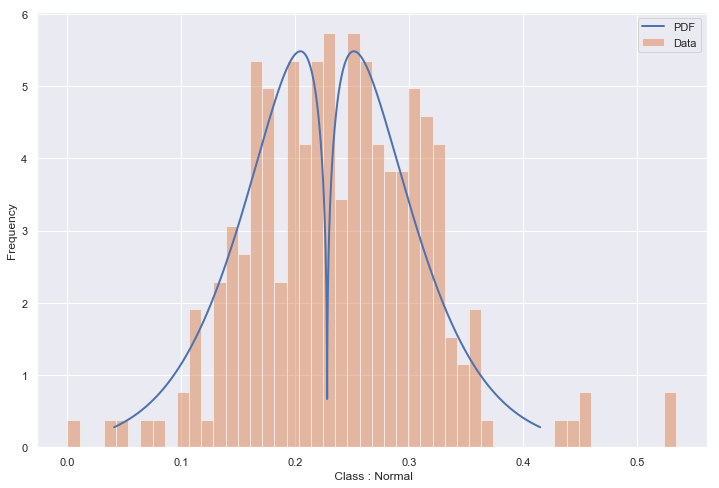

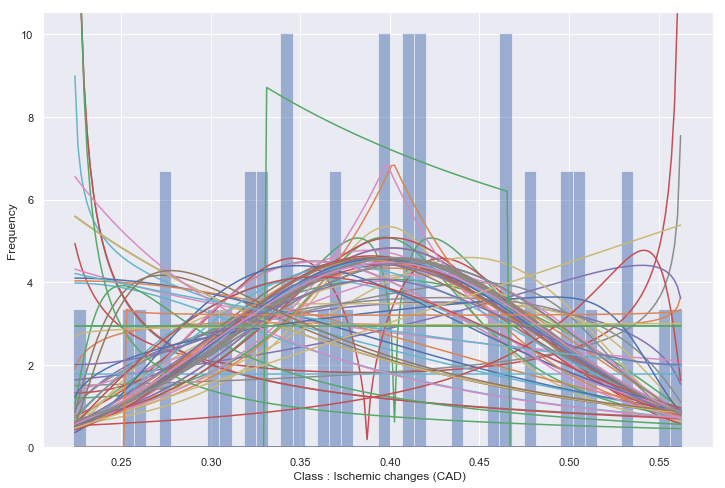

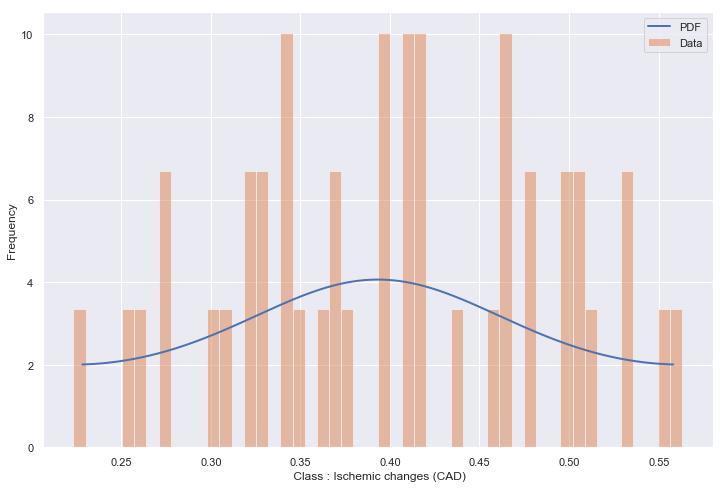

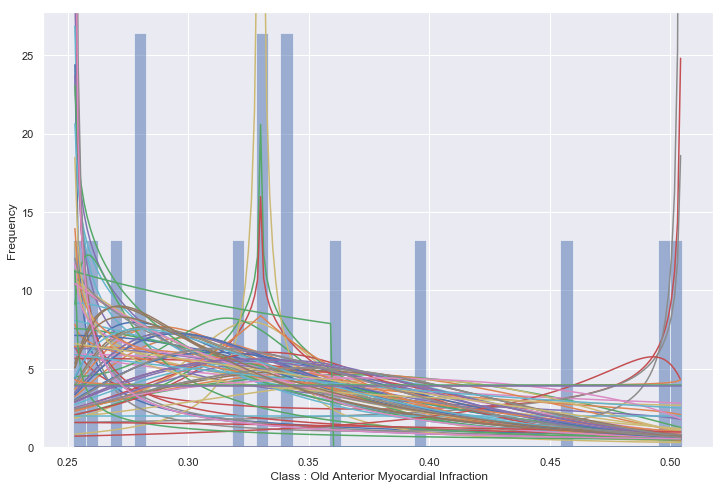

...

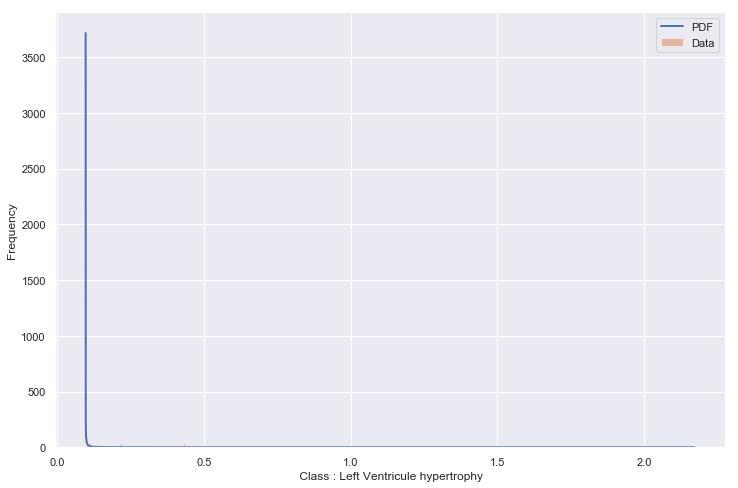

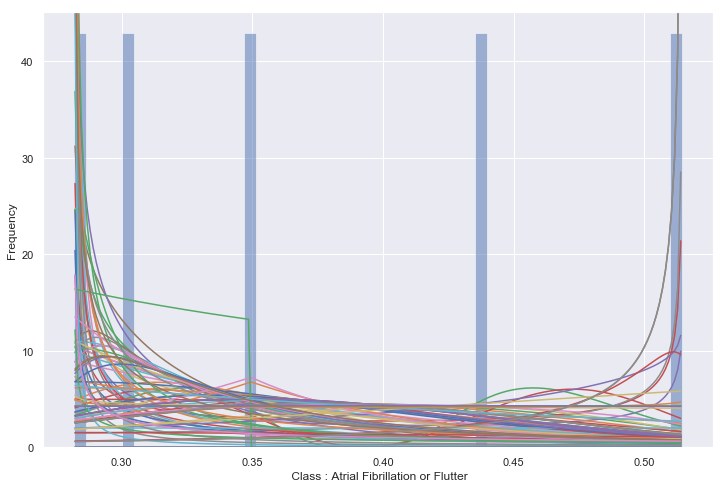

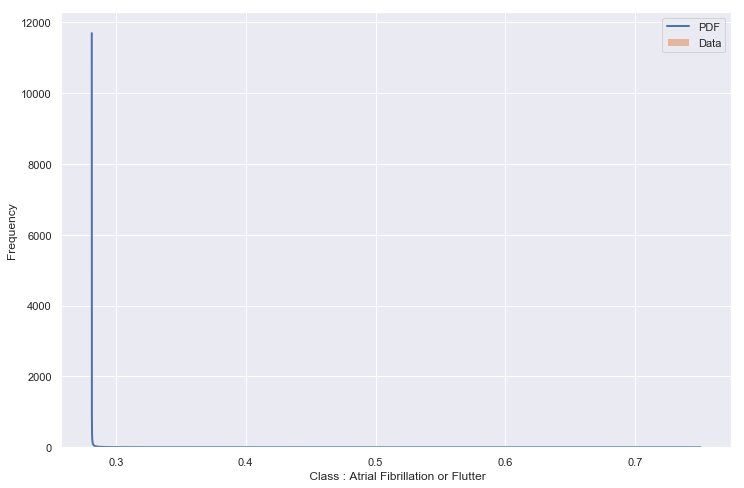

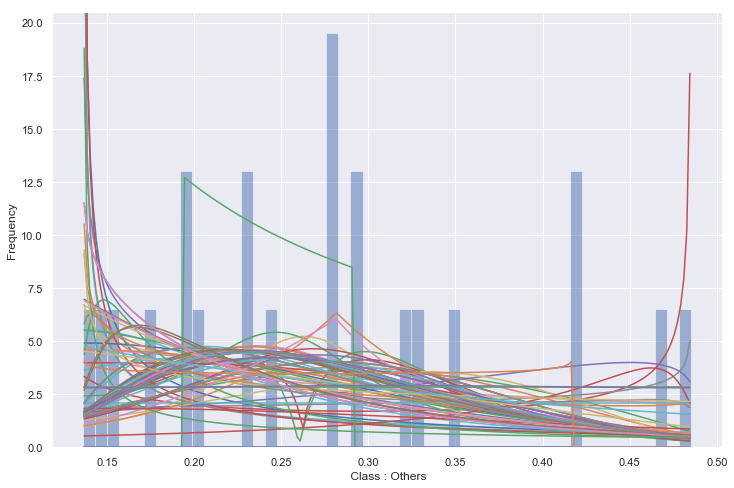

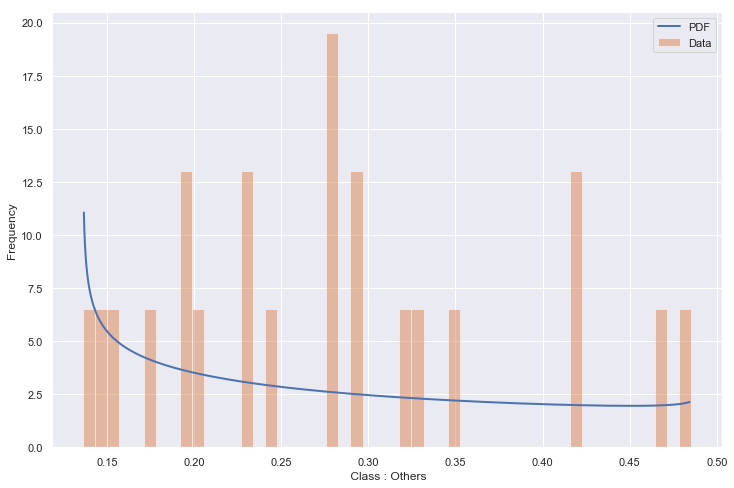

In [261]:
for i in range(1,17):
    if(i not in [11,12,13]):
        get_best_fitting(A_means_df[A_means_df['t']==i][f_n[index_3_means]].astype("float")," Class : "+class_names[i-1])

Studiamo la mutua informazione del dataset con imputazione dei mediani

<strong> Mutua informazione per il dataset ottenuto ottenuto imputando i valori mancanti con la mediana non splittato </strong>

In [70]:
#A_medians.reshape((452,279))
mutual_information_medians = mutual_info_classif(scaled_matrix_medians,target)
mutual_information_medians = np.asarray(mutual_information_medians)
index_1_medians = mutual_information_medians.argmax()
mutual_information_medians[index_1_medians] = 0
index_2_meadians = mutual_information_medians.argmax()
mutual_information_medians[index_2_meadians] = 0
index_3_medians = mutual_information_medians.argmax()
mutual_information_medians[index_3_medians] = 0

In [71]:
print("Indici dele features con mutua informazione più alta (no split) : \n Indice 1: ",index_1_medians," Indice 2: ", index_2_meadians, " Indice 3: ",index_3_medians)

Indici dele features con mutua informazione più alta (no split) : 
 Indice 1:  13  Indice 2:  195  Indice 3:  100


In [ ]:
f_n.remove('t')

In [73]:
A_medians_df = pd.DataFrame(scaled_matrix_medians,columns = f_n)

In [74]:
A_medians_df['t'] = target

<strong>Fitting per la prima feature più informativa</strong>

Senza Splitting: Indice feature 13

Miglior distribuzione  johnsonsb(a=1.15, b=1.48, loc=0.06, scale=0.55)
Miglior distribuzione  vonmises_line(kappa=0.76, loc=0.28, scale=0.06)
Miglior distribuzione  arcsine(loc=0.13, scale=0.51)
Miglior distribuzione  arcsine(loc=0.24, scale=0.21)
Miglior distribuzione  gennorm(beta=0.18, loc=0.50, scale=0.00)
Miglior distribuzione  dgamma(a=1.45, loc=0.08, scale=0.02)
Miglior distribuzione  nct(df=0.35, nc=29.05, loc=0.16, scale=0.00)
Miglior distribuzione  johnsonsu(a=5.76, b=0.47, loc=0.21, scale=0.00)
Miglior distribuzione  johnsonsb(a=-0.59, b=0.14, loc=0.10, scale=0.20)
Miglior distribuzione  dgamma(a=0.74, loc=0.24, scale=0.10)
Miglior distribuzione  erlang(a=0.12, loc=0.32, scale=0.03)
Miglior distribuzione  beta(a=0.19, b=0.30, loc=0.23, scale=0.37)
Miglior distribuzione  triang(c=0.14, loc=0.06, scale=0.50)


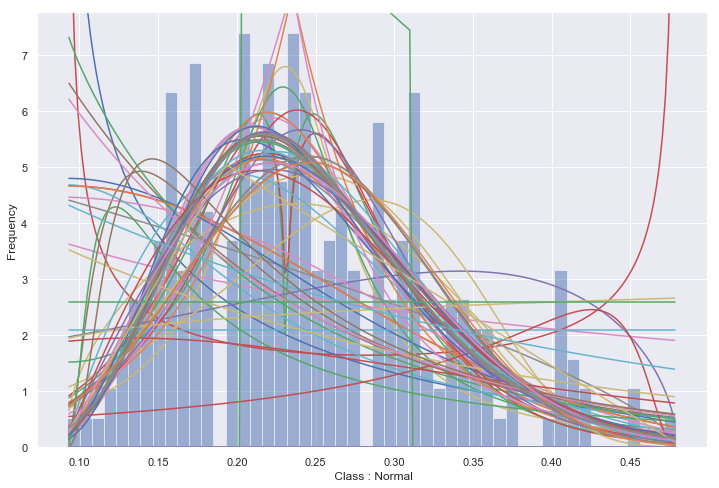

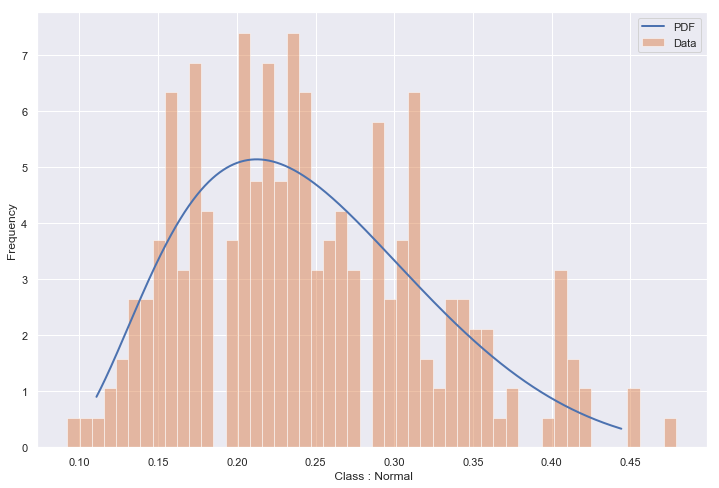

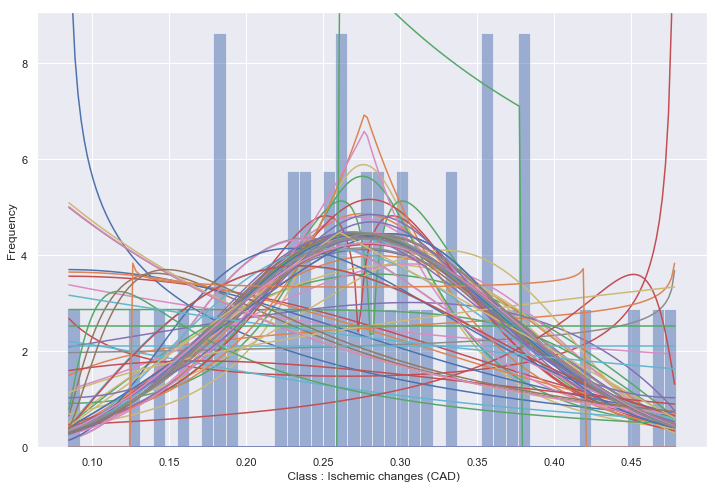

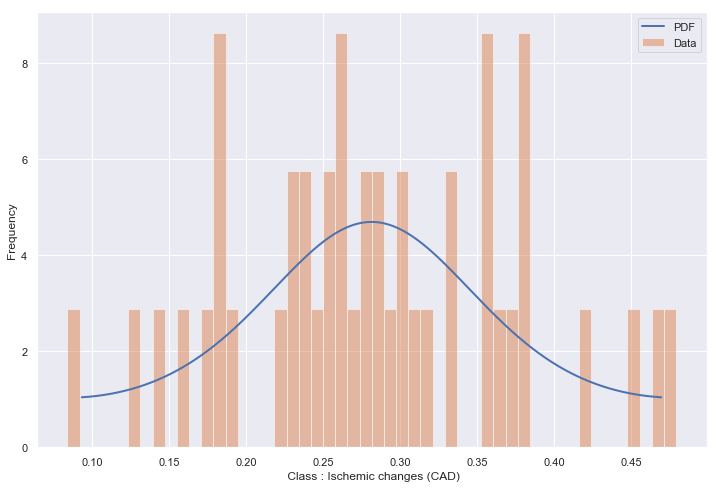

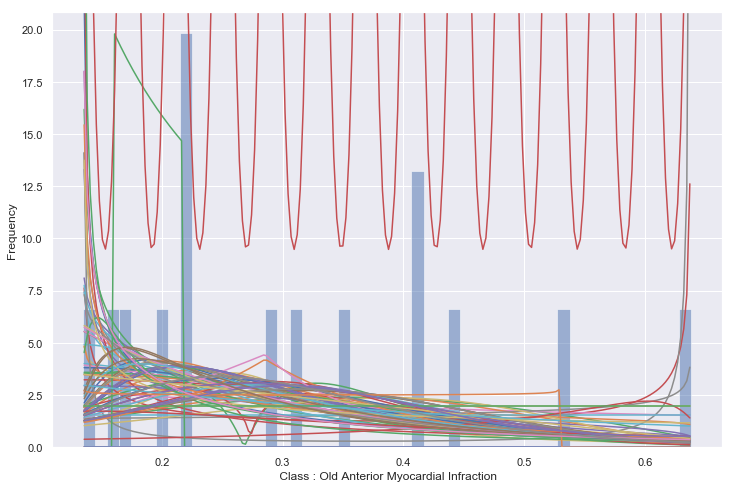

...

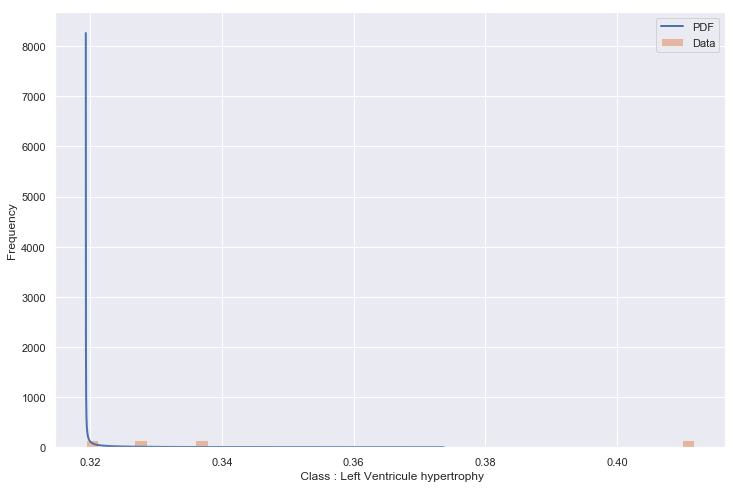

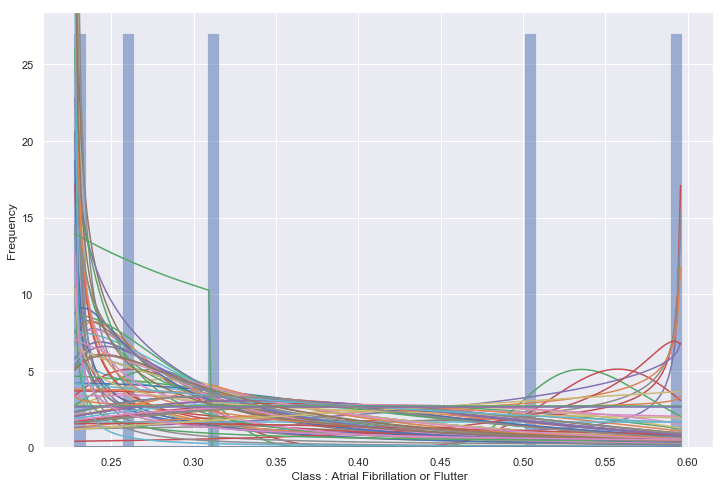

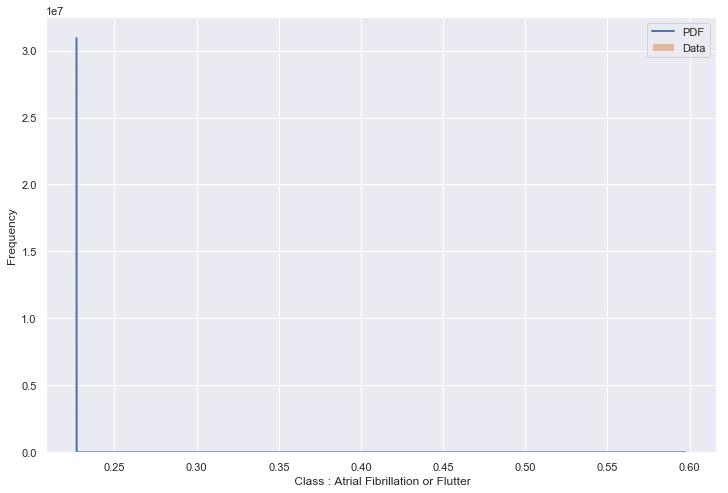

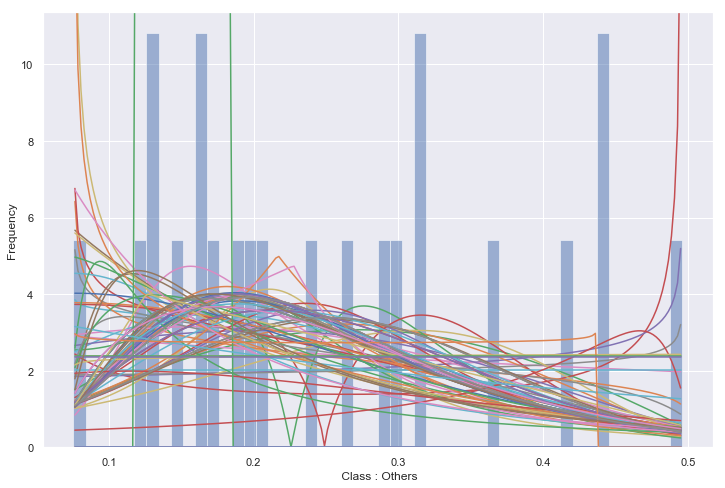

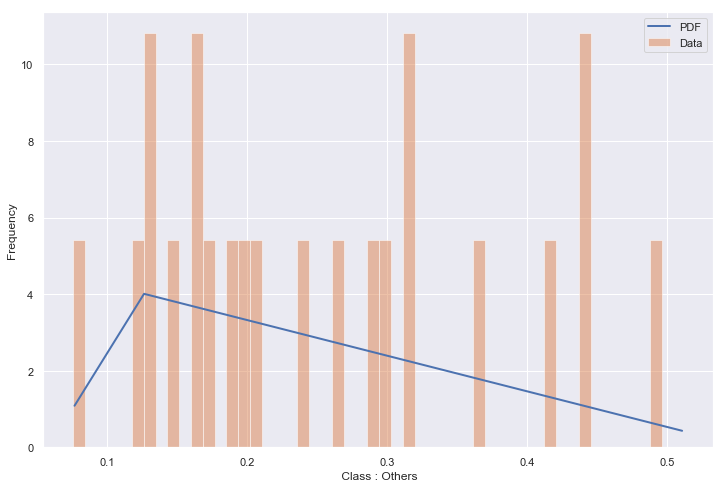

In [281]:
for i in range(1,17):
    if(i not in [11,12,13]):
        get_best_fitting(A_medians_df[A_medians_df['t']==i][f_n[index_1_medians]].astype("float")," Class : "+class_names[i-1])

<strong>Fitting per la seconda feature più informativa</strong>

Senza Splitting: indice feature 112

Miglior distribuzione  exponnorm(K=0.59, loc=0.59, scale=0.07)
Miglior distribuzione  dgamma(a=2.65, loc=0.47, scale=0.03)
Miglior distribuzione  johnsonsb(a=-0.19, b=0.17, loc=0.32, scale=0.32)
Miglior distribuzione  gennorm(beta=0.09, loc=0.53, scale=0.00)
Miglior distribuzione  johnsonsb(a=-0.25, b=0.22, loc=0.49, scale=0.33)
Miglior distribuzione  kstwobign(loc=0.41, scale=0.26)
Miglior distribuzione  levy(loc=0.41, scale=0.00)
Miglior distribuzione  halfcauchy(loc=0.57, scale=0.00)
Miglior distribuzione  dgamma(a=0.74, loc=0.37, scale=0.18)
Miglior distribuzione  dgamma(a=1.65, loc=0.66, scale=0.04)
Miglior distribuzione  johnsonsu(a=2.79, b=0.19, loc=0.75, scale=0.00)
Miglior distribuzione  lognorm(s=5.85, loc=0.36, scale=0.00)
Miglior distribuzione  dgamma(a=2.53, loc=0.57, scale=0.04)


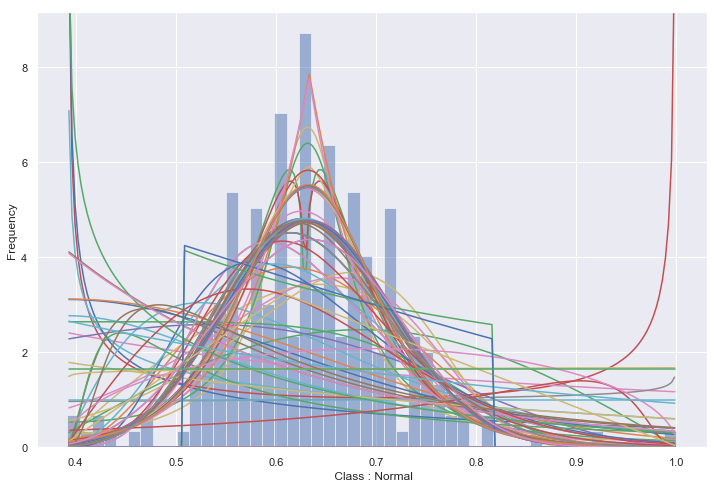

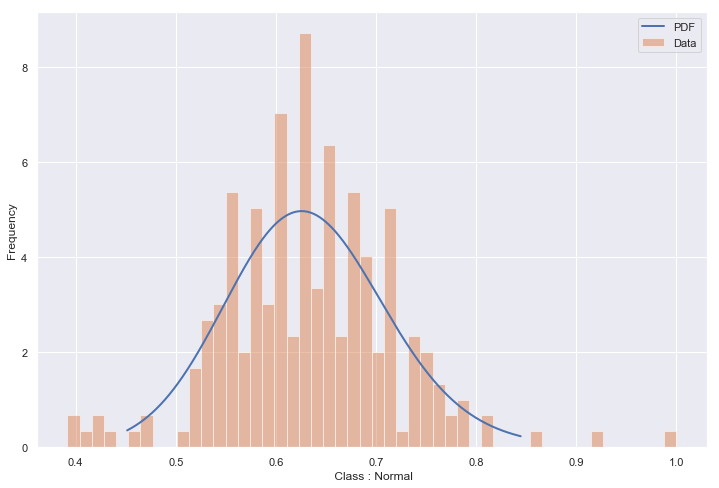

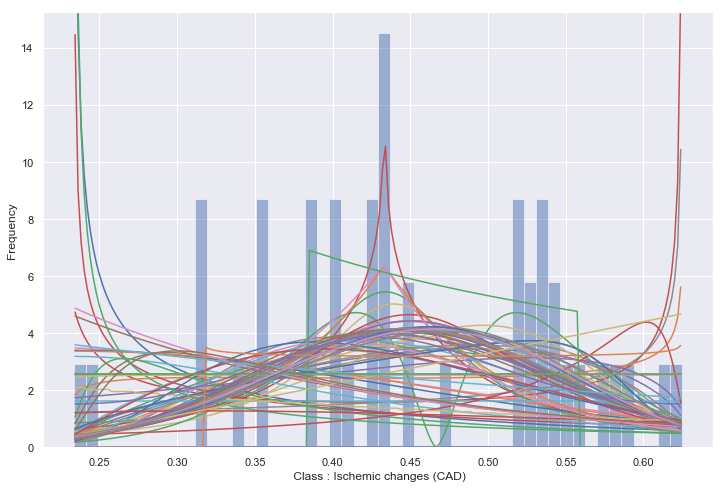

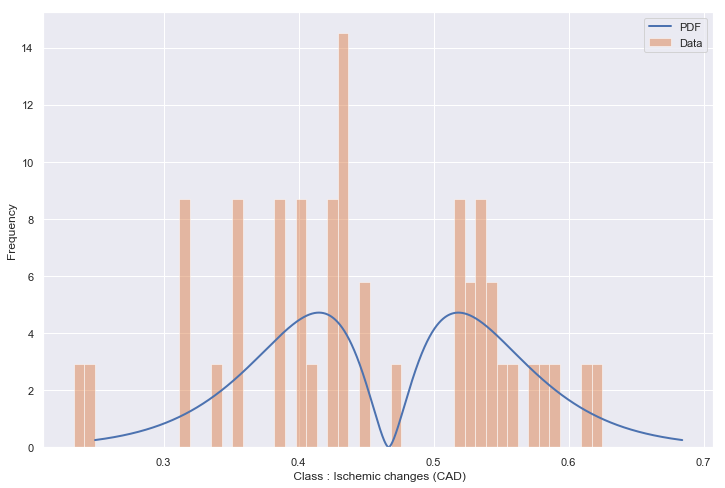

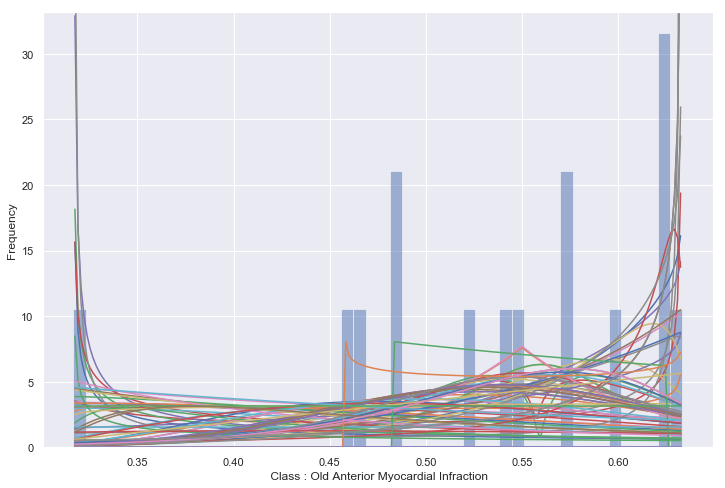

...

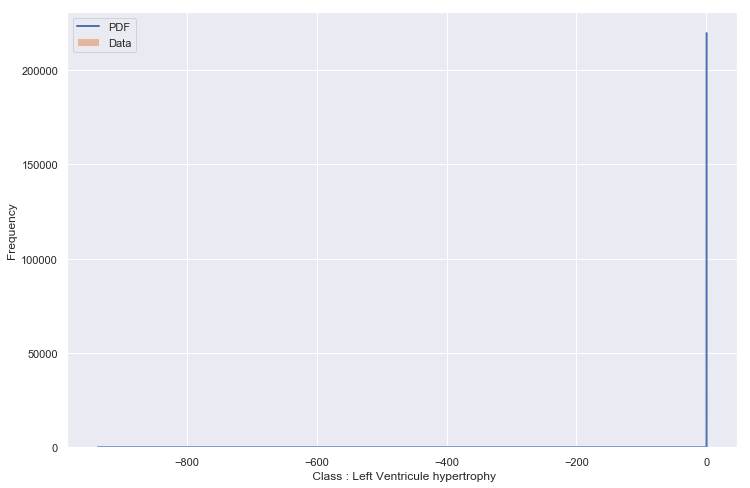

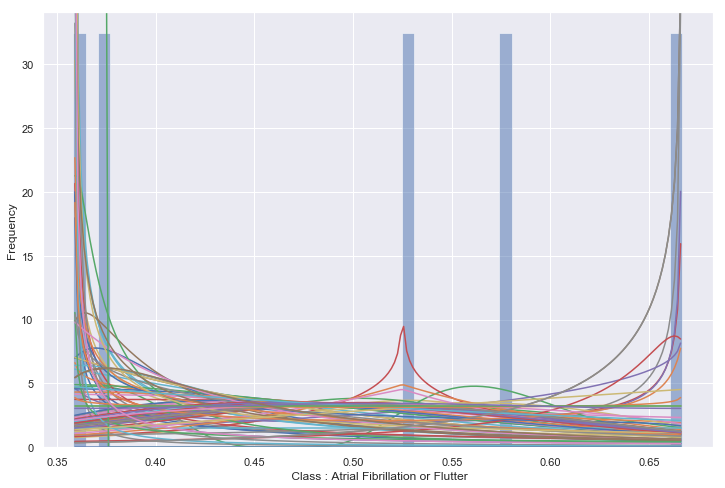

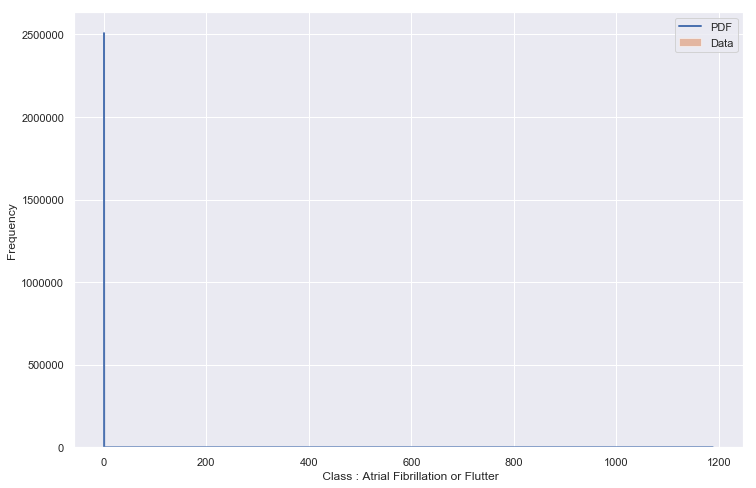

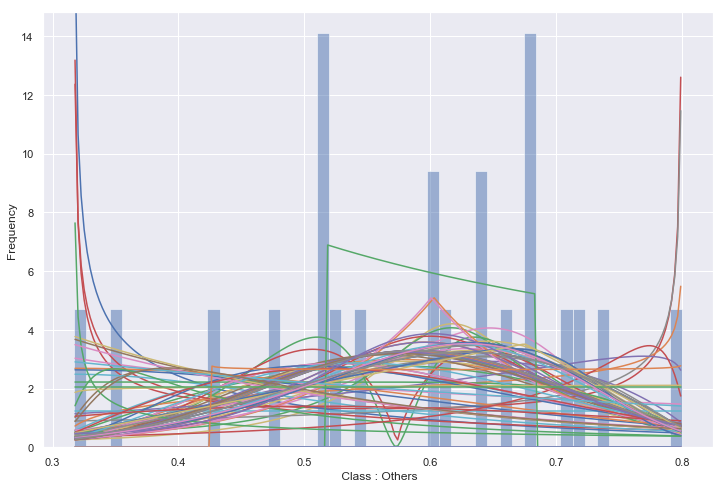

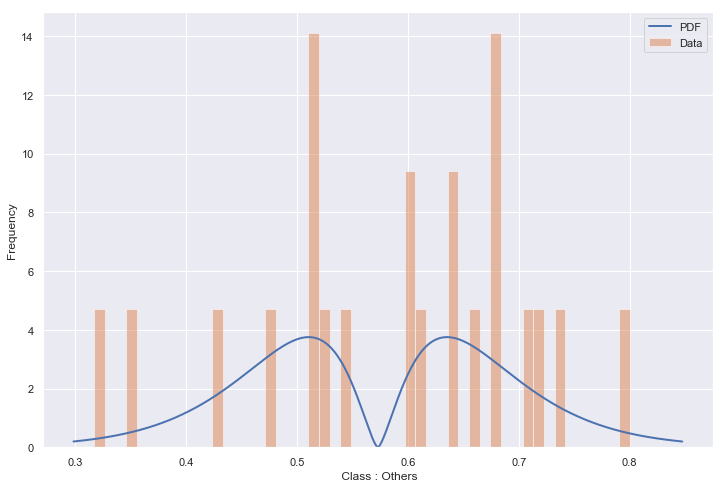

In [283]:
for i in range(1,17):
    if(i not in [11,12,13]):
        get_best_fitting(A_medians_df[A_medians_df['t']==i][f_n[index_2_meadians]].astype("float")," Class : "+class_names[i-1])

<strong>Fitting per la terza feature più informativa</strong>

Senza splitting: indice feature 223

Miglior distribuzione  dweibull(c=1.33, loc=0.23, scale=0.07)
Miglior distribuzione  vonmises_line(kappa=0.35, loc=0.39, scale=0.05)
Miglior distribuzione  dgamma(a=0.85, loc=0.33, scale=0.07)
Miglior distribuzione  gennorm(beta=0.10, loc=0.34, scale=0.00)
Miglior distribuzione  dweibull(c=0.51, loc=0.28, scale=0.09)
Miglior distribuzione  dgamma(a=1.64, loc=0.25, scale=0.03)
Miglior distribuzione  genextreme(c=-1.97, loc=0.18, scale=0.00)
Miglior distribuzione  halfcauchy(loc=0.21, scale=0.00)
Miglior distribuzione  pearson3(skew=2.59, loc=0.59, scale=0.12)
Miglior distribuzione  dweibull(c=1.38, loc=0.22, scale=0.07)
Miglior distribuzione  burr(c=0.76, d=0.71, loc=0.10, scale=0.01)
Miglior distribuzione  bradford(c=77229.50, loc=0.28, scale=0.52)
Miglior distribuzione  gausshyper(a=0.77, b=0.93, c=0.59, z=1.54, loc=0.14, scale=0.35)


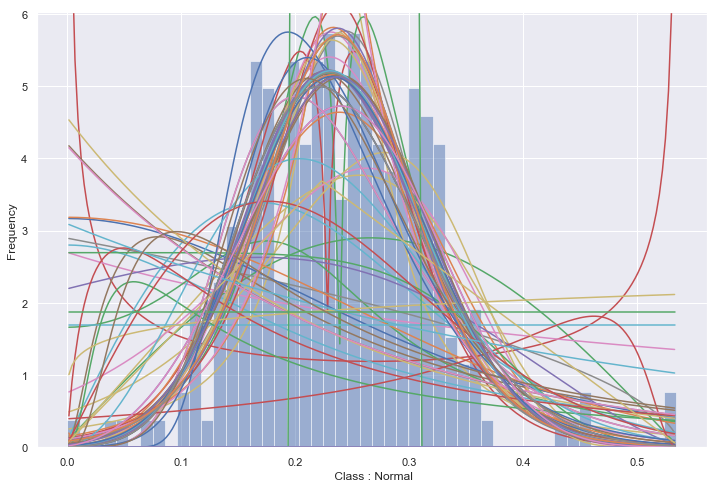

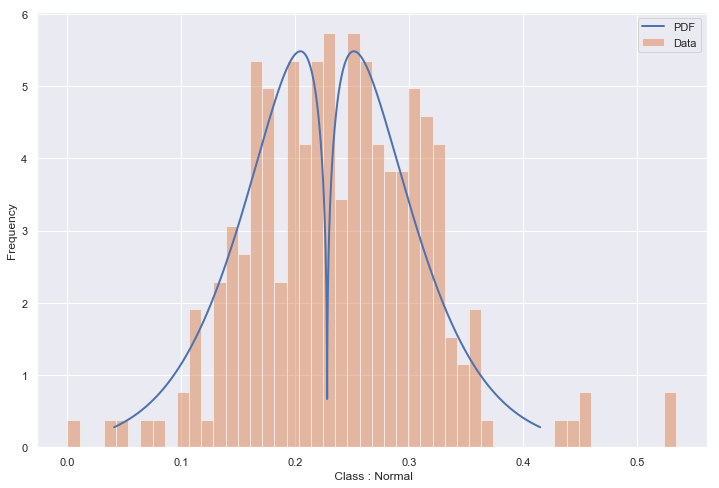

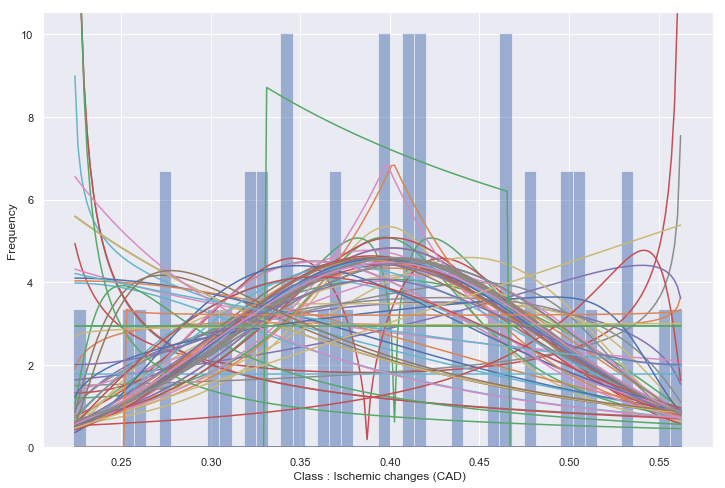

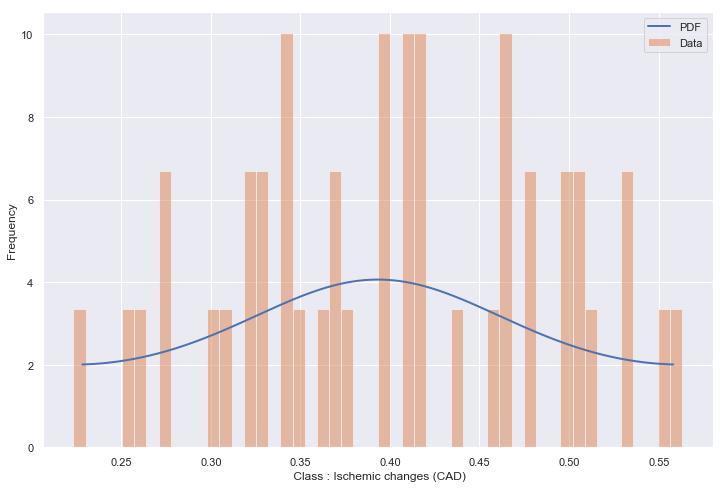

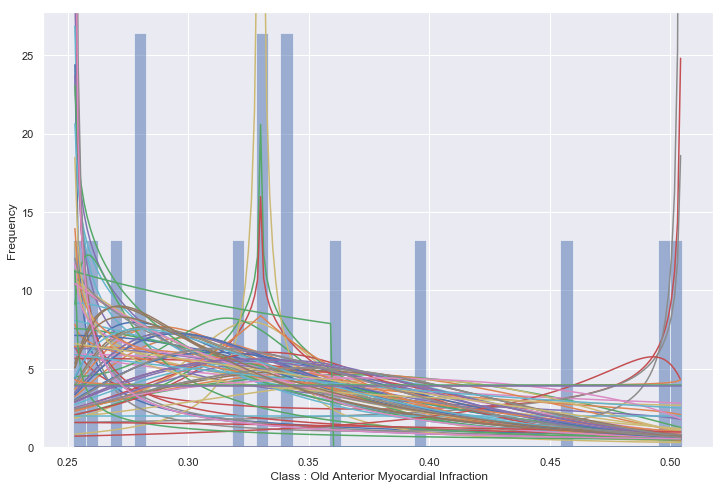

...

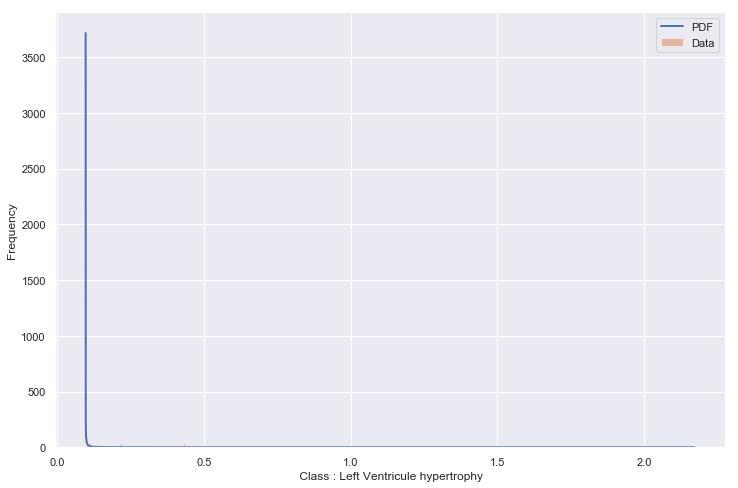

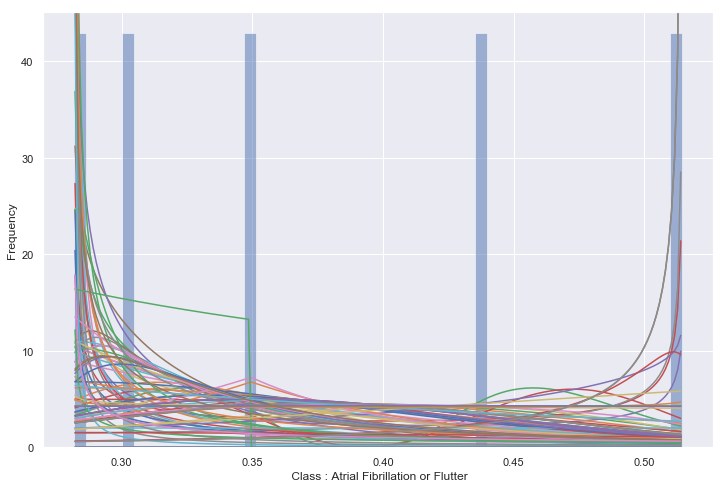

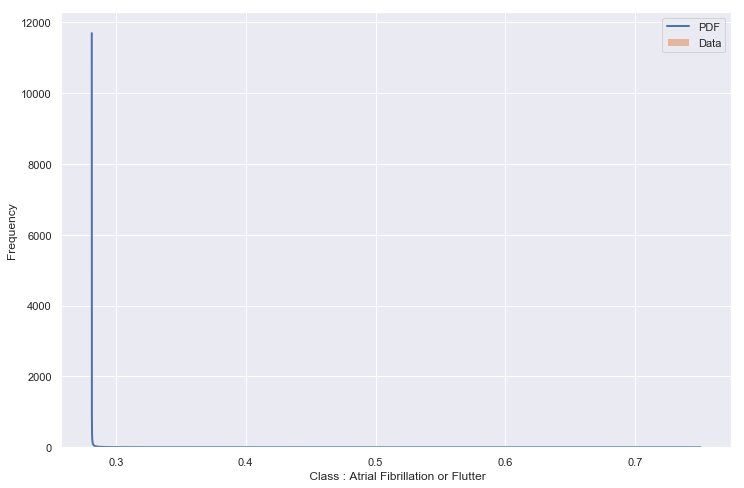

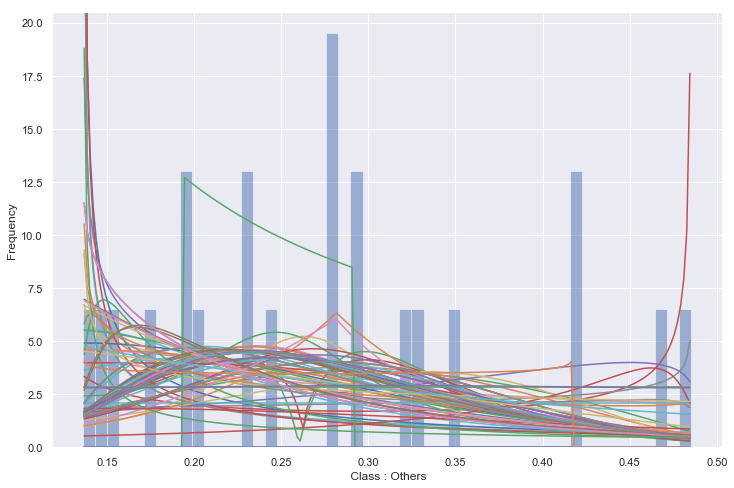

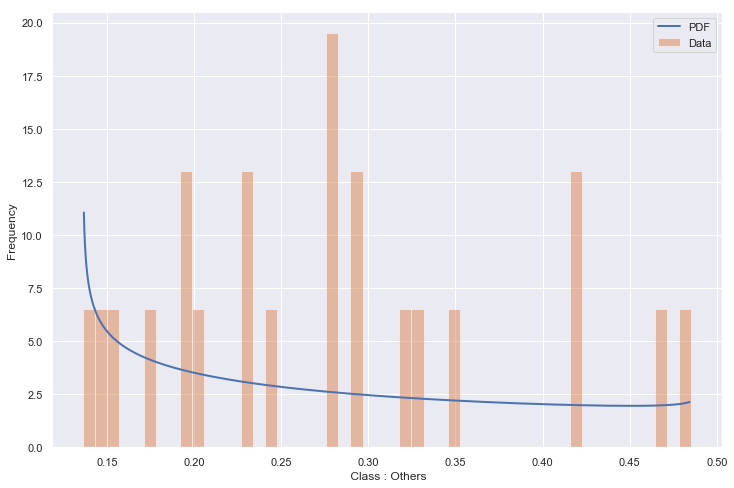

In [285]:
for i in range(1,17):
    if(i not in [11,12,13]):
        get_best_fitting(A_medians_df[A_medians_df['t']==i][f_n[index_3_medians]].astype("float")," Class : "+class_names[i-1])

<strong> Mutua informazione per il dataset ottenuto ottenuto imputando i valori mancanti con la moda non splittato </strong>

In [75]:
#A_mode.reshape((452,280))
mutual_information_mode = mutual_info_classif(scaled_matrix_mode,target)
mutual_information_mode = np.asarray(mutual_information_mode)
index_1_mode = mutual_information_mode.argmax()
mutual_information_mode[index_1_mode] = 0
index_2_mode = mutual_information_mode.argmax()
mutual_information_mode[index_2_mode] = 0
index_3_mode = mutual_information_mode.argmax()
mutual_information_mode[index_3_mode] = 0


In [76]:
print("Indici dele features con mutua informazione più alta: \n Indice 1: ",index_1_mode," Indice 2: ", index_2_mode, " Indice 3: ",index_3_mode)

Indici dele features con mutua informazione più alta: 
 Indice 1:  13  Indice 2:  183  Indice 3:  275


In [77]:
A_mode_df = pd.DataFrame(scaled_matrix_mode,columns = f_n)
A_mode_df['t'] = target

<strong>Fitting per la prima feature più informativa</strong>

Senza splitting: indice feature 13

Miglior distribuzione  johnsonsb(a=1.15, b=1.48, loc=0.32, scale=0.40)
Miglior distribuzione  vonmises_line(kappa=0.74, loc=0.48, scale=0.05)
Miglior distribuzione  powerlaw(a=0.53, loc=0.37, scale=0.38)
Miglior distribuzione  arcsine(loc=0.45, scale=0.15)
Miglior distribuzione  gennorm(beta=0.22, loc=0.63, scale=0.00)
Miglior distribuzione  dgamma(a=1.45, loc=0.33, scale=0.01)
Miglior distribuzione  johnsonsu(a=3.31, b=0.25, loc=0.53, scale=0.00)
Miglior distribuzione  lognorm(s=2.09, loc=0.39, scale=0.00)
Miglior distribuzione  johnsonsb(a=0.16, b=0.14, loc=0.34, scale=0.15)
Miglior distribuzione  foldcauchy(c=3.27, loc=0.31, scale=0.04)
Miglior distribuzione  gamma(a=0.21, loc=0.50, scale=0.02)
Miglior distribuzione  gamma(a=0.12, loc=0.44, scale=0.34)
Miglior distribuzione  triang(c=0.14, loc=0.31, scale=0.36)


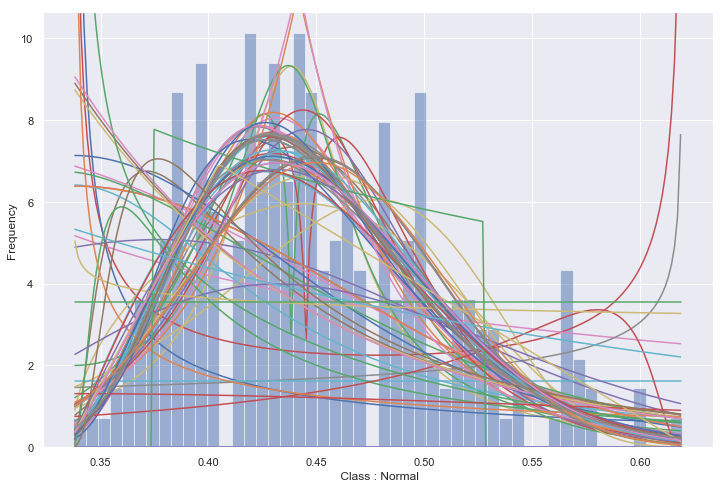

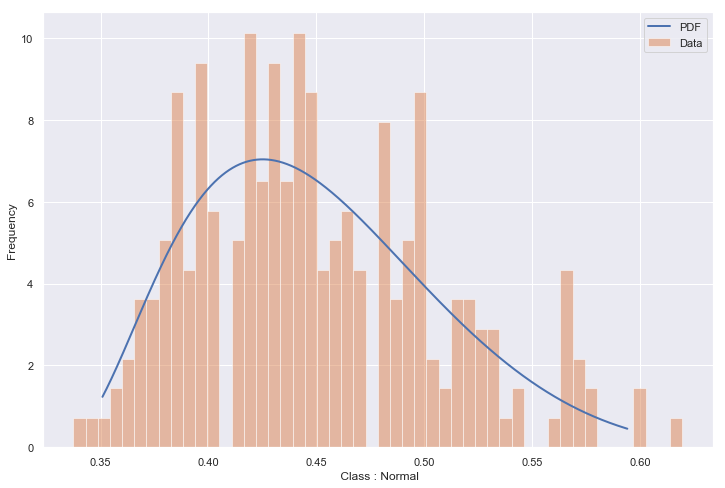

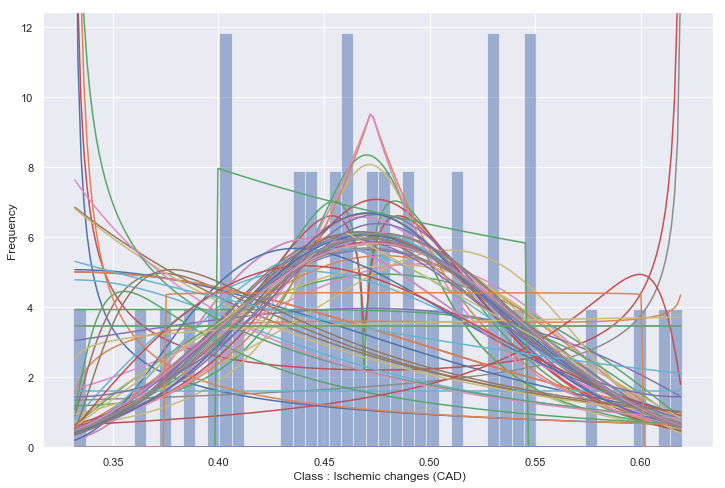

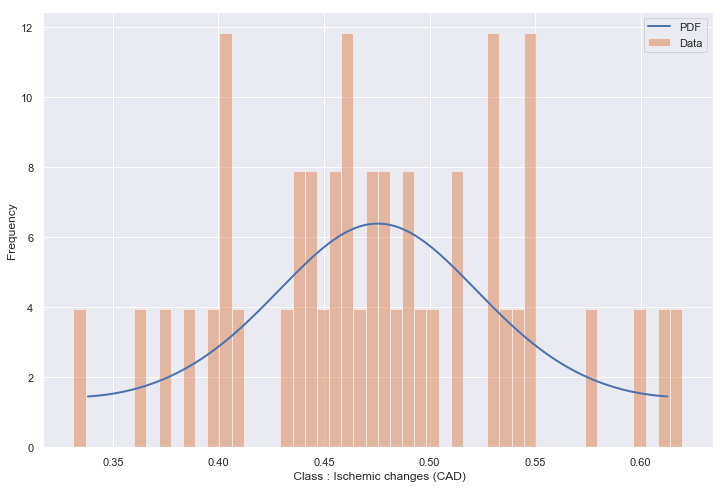

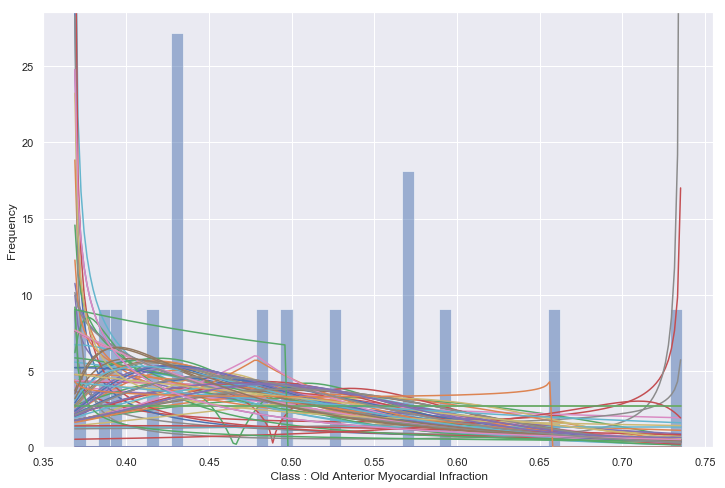

...

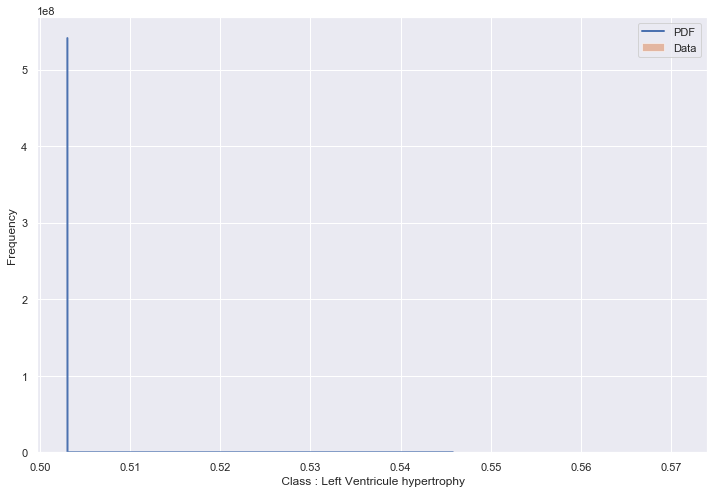

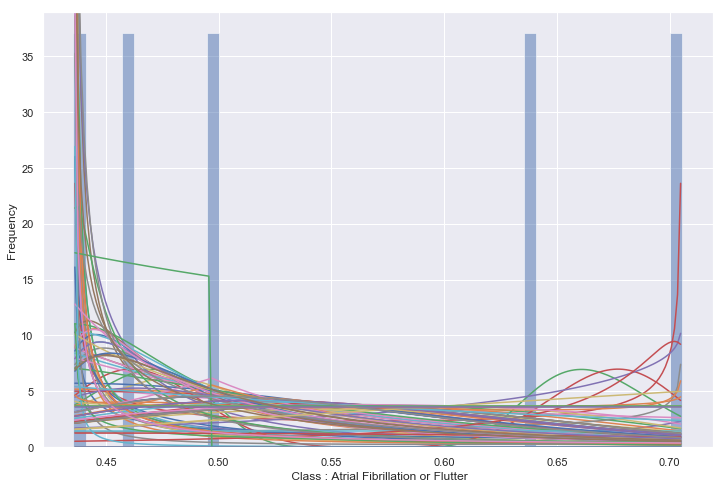

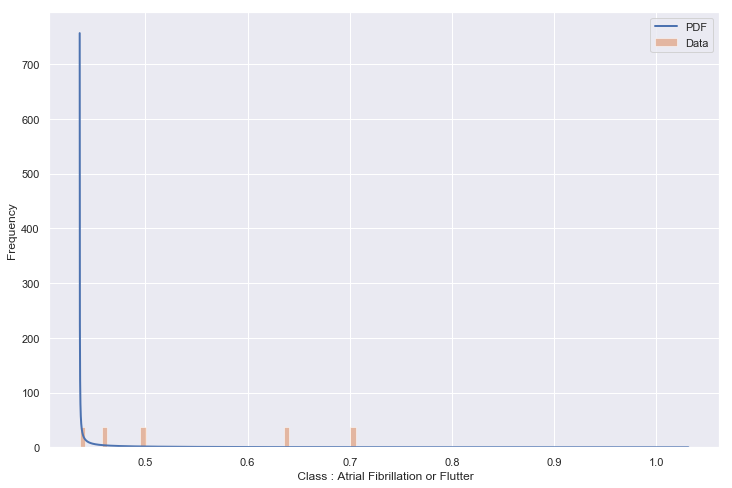

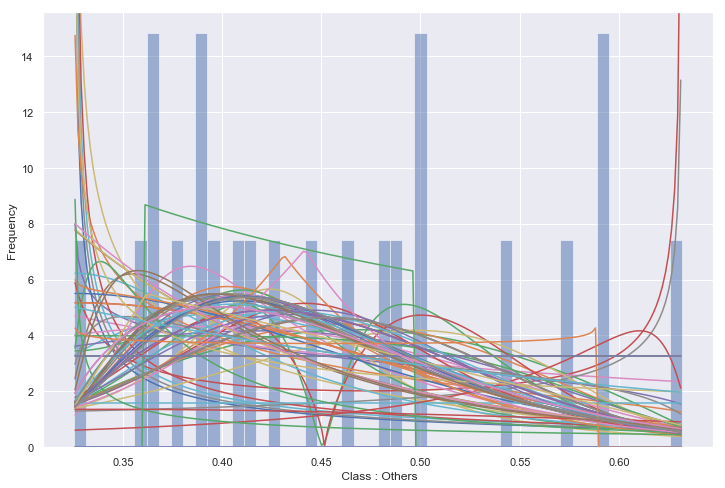

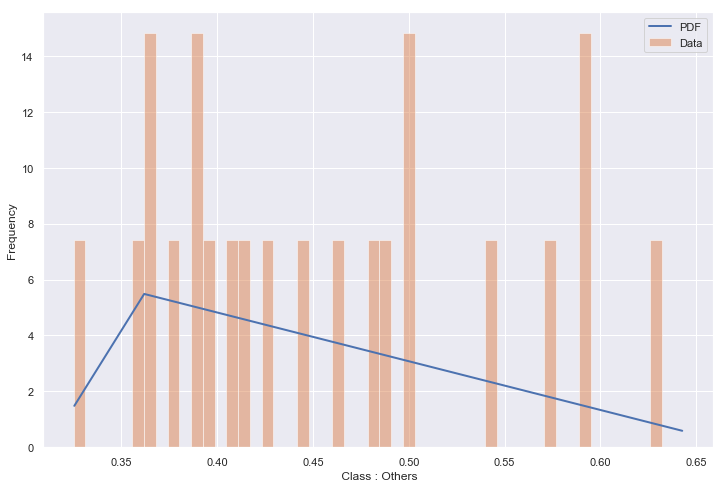

In [309]:
for i in range(1,17):
    if(i not in [11,12,13]):
        get_best_fitting(A_mode_df[A_mode_df['t']==i][f_n[index_1_mode]].astype("float")," Class : "+class_names[i-1])

<strong>Fitting per la seconda feature più informativa</strong>

Senza splitting: indice feature 195

Miglior distribuzione  dweibull(c=1.33, loc=0.23, scale=0.07)
Miglior distribuzione  vonmises_line(kappa=0.35, loc=0.39, scale=0.05)
Miglior distribuzione  dgamma(a=0.85, loc=0.33, scale=0.07)
Miglior distribuzione  gennorm(beta=0.10, loc=0.34, scale=0.00)
Miglior distribuzione  dweibull(c=0.51, loc=0.28, scale=0.09)
Miglior distribuzione  dgamma(a=1.64, loc=0.25, scale=0.03)
Miglior distribuzione  genextreme(c=-1.97, loc=0.18, scale=0.00)
Miglior distribuzione  halfcauchy(loc=0.21, scale=0.00)
Miglior distribuzione  pearson3(skew=2.59, loc=0.59, scale=0.12)
Miglior distribuzione  dweibull(c=1.38, loc=0.22, scale=0.07)
Miglior distribuzione  burr(c=0.76, d=0.71, loc=0.10, scale=0.01)
Miglior distribuzione  bradford(c=77229.50, loc=0.28, scale=0.52)
Miglior distribuzione  gausshyper(a=0.77, b=0.93, c=0.59, z=1.54, loc=0.14, scale=0.35)


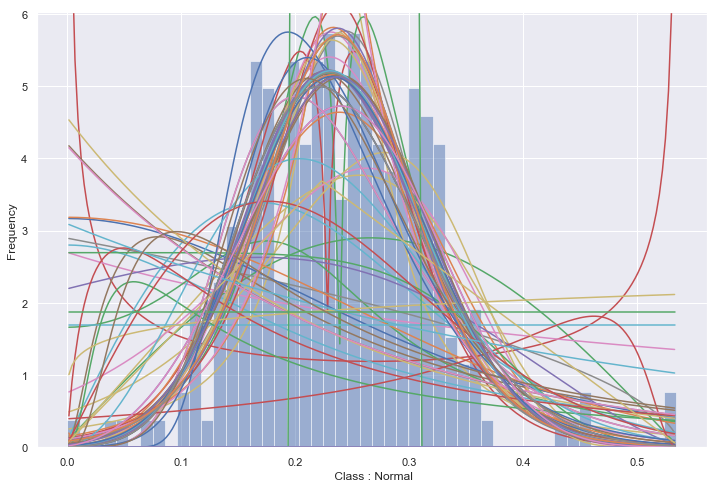

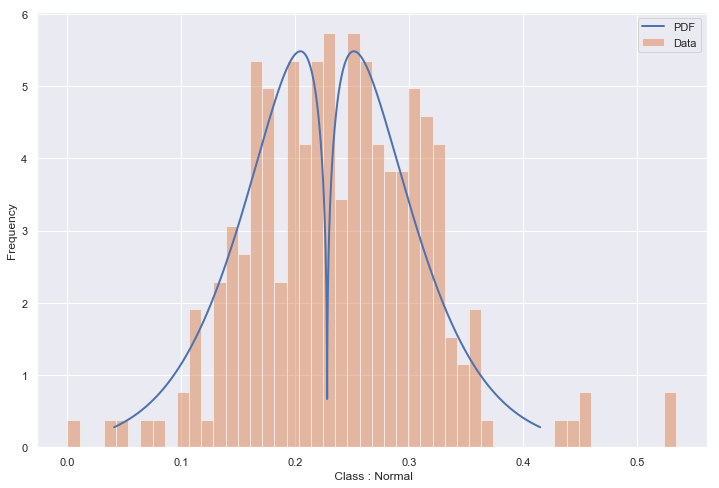

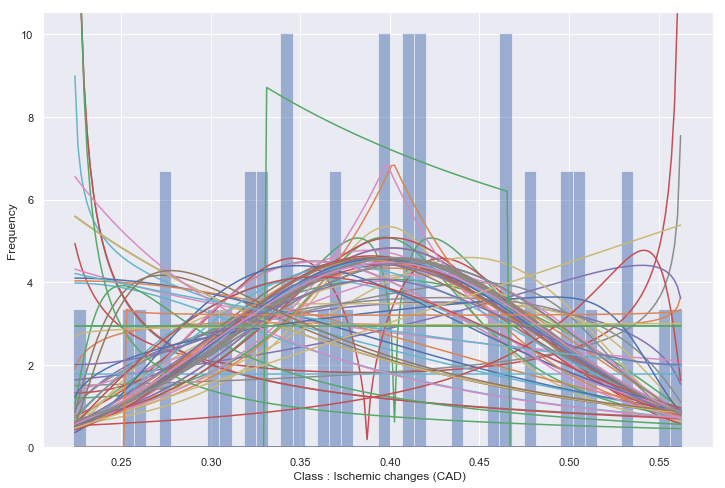

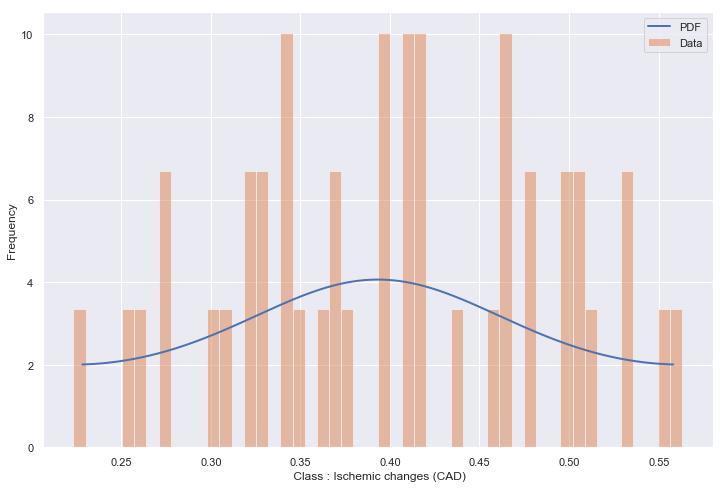

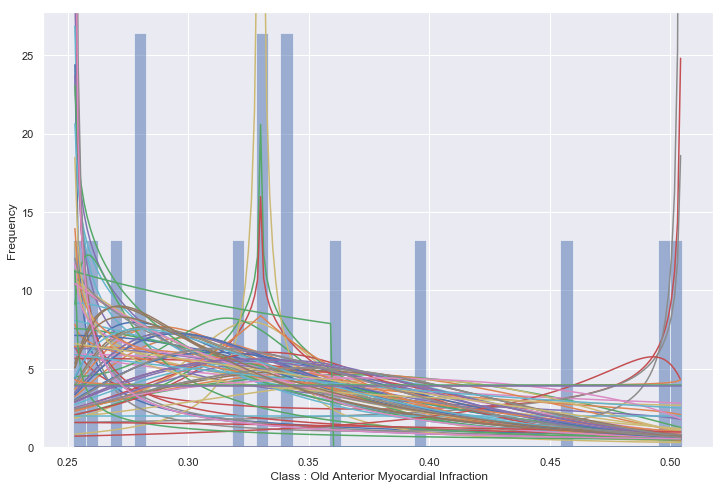

...

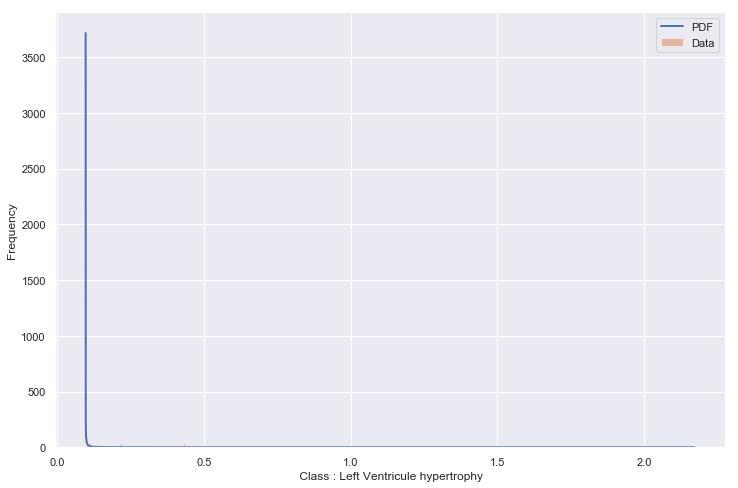

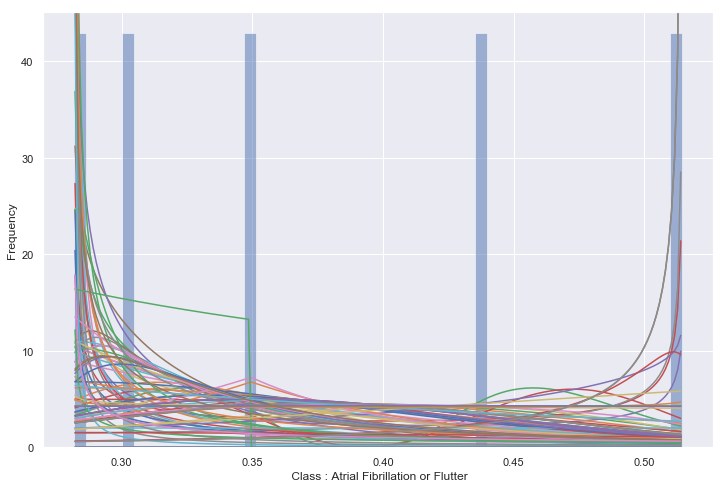

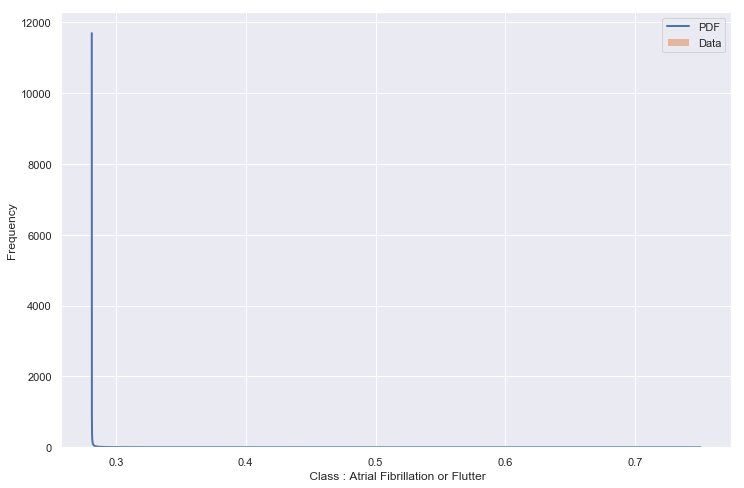

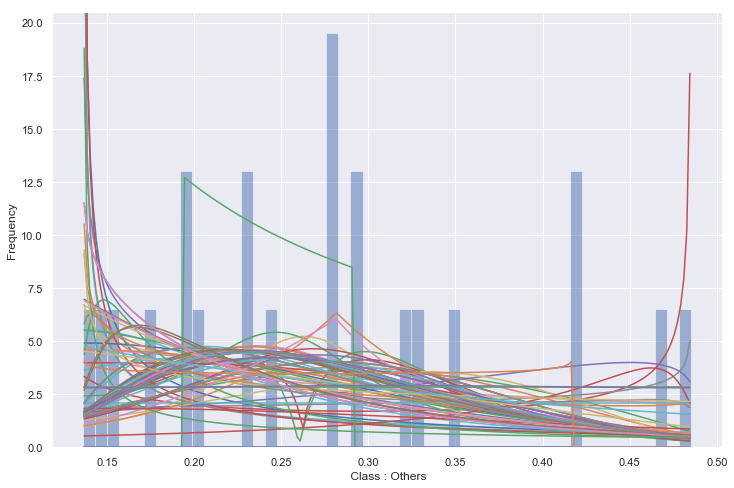

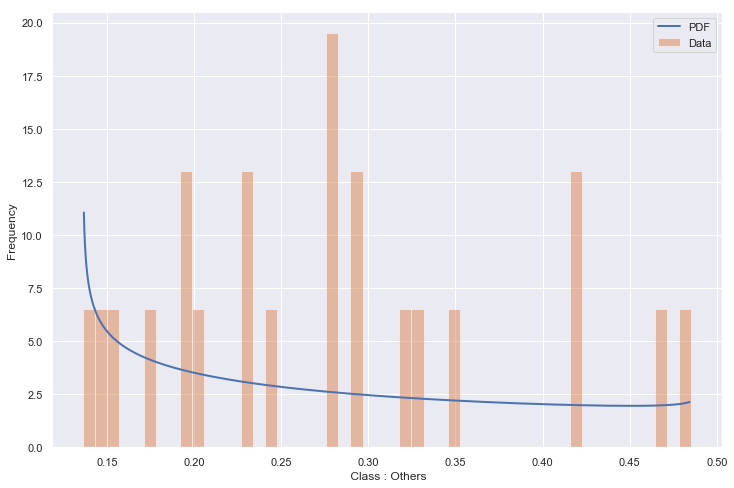

In [312]:
for i in range(1,17):
    if(i not in [11,12,13]):
        get_best_fitting(A_mode_df[A_mode_df['t']==i][f_n[index_2_mode]].astype("float")," Class : "+class_names[i-1])

<strong>Fitting per la terza feature più informativa</strong>

Senza splitting: indice feature 112

Miglior distribuzione  dgamma(a=0.77, loc=0.36, scale=0.08)
Miglior distribuzione  dgamma(a=1.69, loc=0.42, scale=0.04)
Miglior distribuzione  halfgennorm(beta=0.51, loc=-0.00, scale=0.00)
Miglior distribuzione  dgamma(a=0.34, loc=0.39, scale=0.05)
Miglior distribuzione  johnsonsb(a=0.75, b=0.13, loc=0.25, scale=0.30)
Miglior distribuzione  johnsonsu(a=3.66, b=0.25, loc=0.46, scale=0.00)
Miglior distribuzione  beta(a=1.29, b=0.22, loc=-0.09, scale=0.52)
Miglior distribuzione  halfcauchy(loc=0.43, scale=0.00)
Miglior distribuzione  lognorm(s=8.18, loc=0.75, scale=0.00)
Miglior distribuzione  dgamma(a=0.85, loc=0.39, scale=0.12)
Miglior distribuzione  lognorm(s=6.28, loc=0.39, scale=0.00)
Miglior distribuzione  johnsonsu(a=2.95, b=0.27, loc=0.54, scale=0.00)
Miglior distribuzione  johnsonsb(a=0.51, b=0.17, loc=-0.00, scale=0.54)


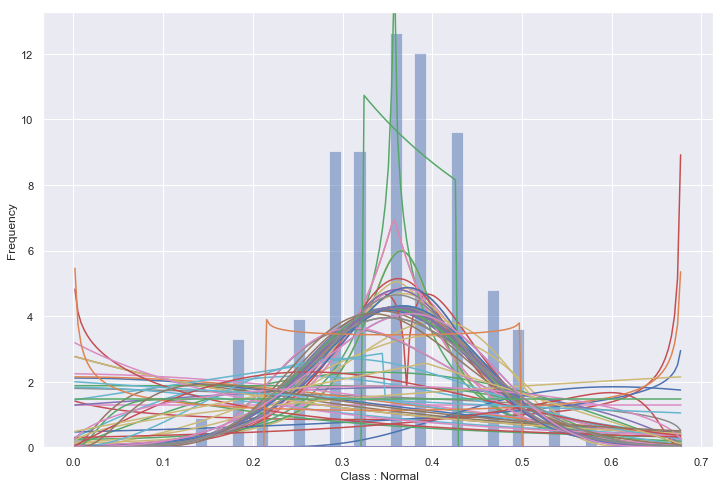

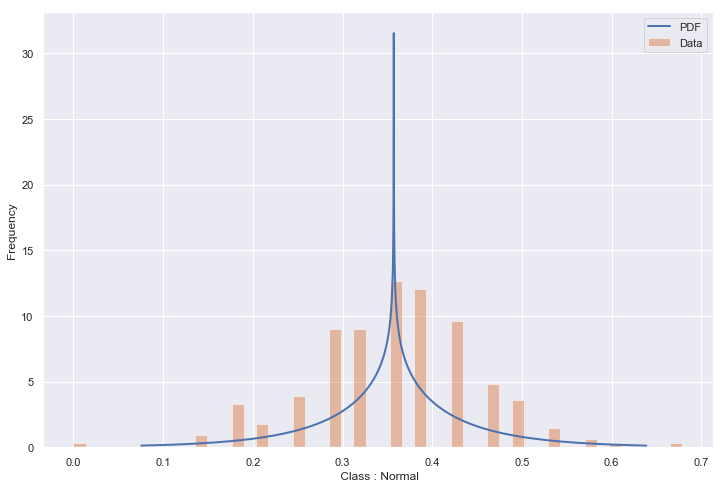

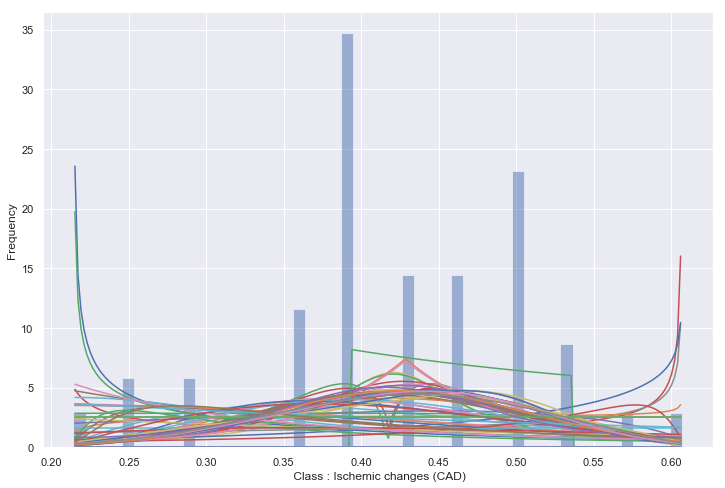

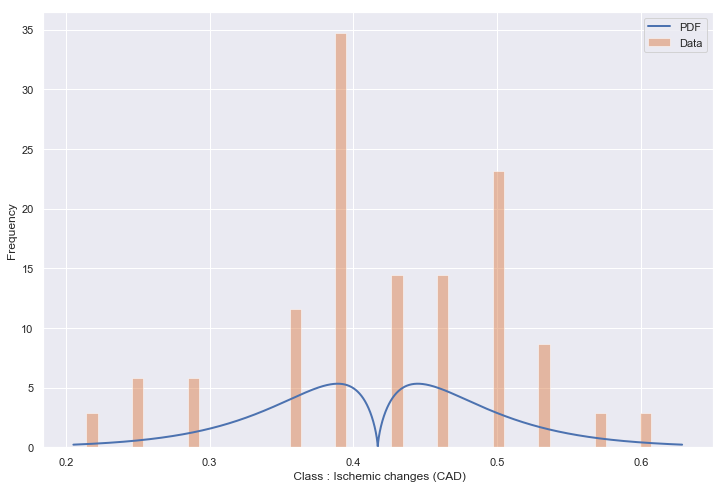

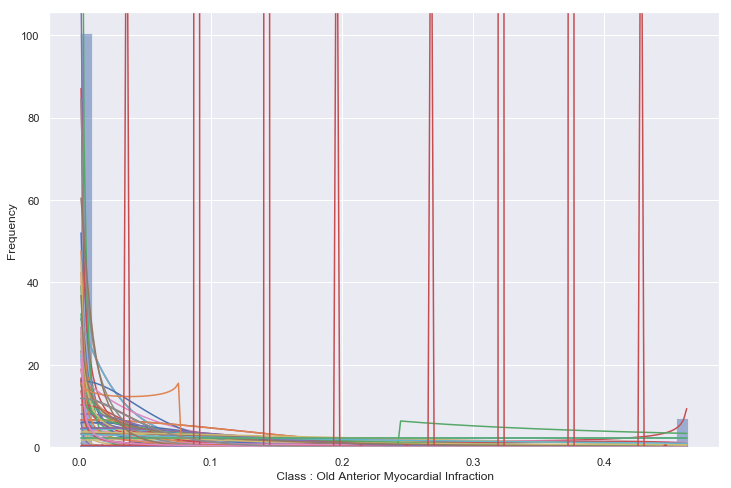

...

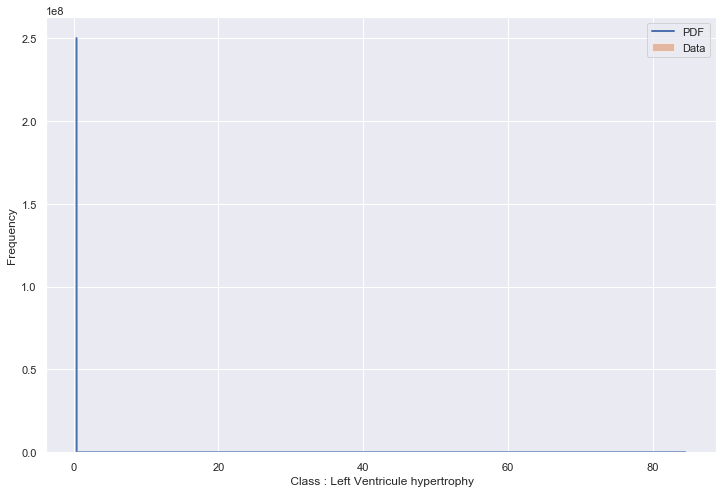

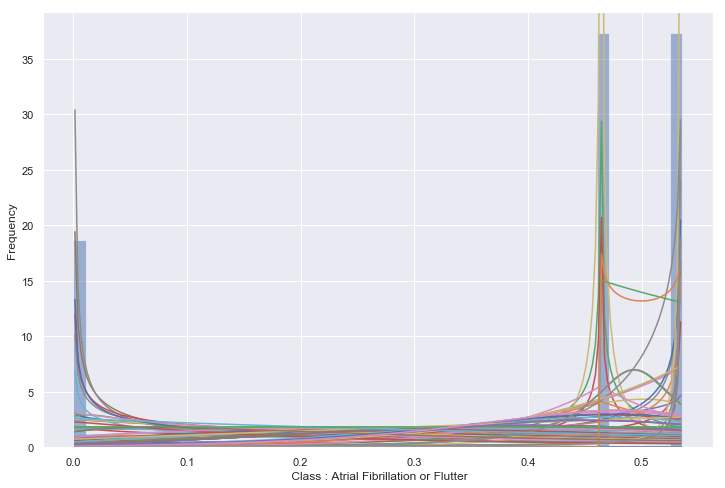

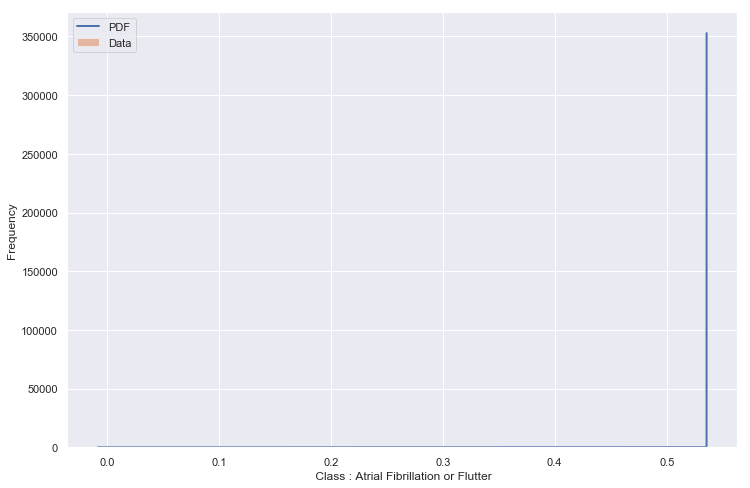

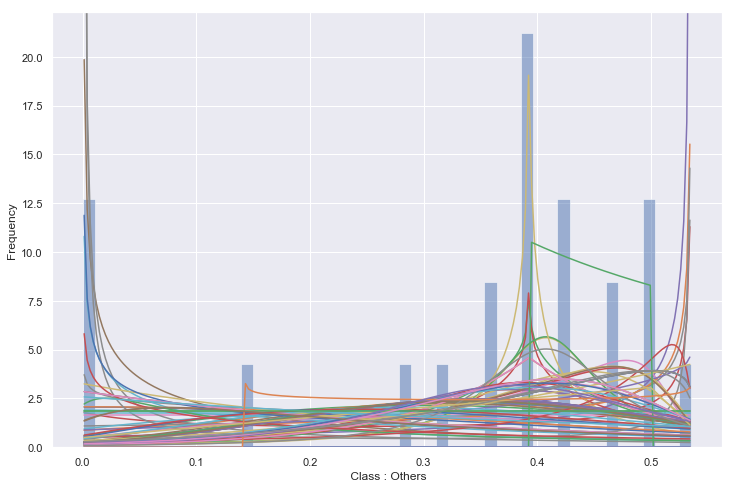

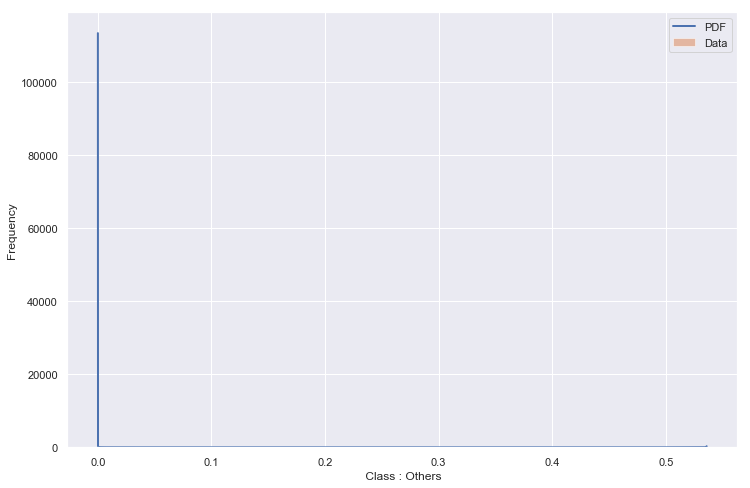

In [310]:
for i in range(1,17):
    if(i not in [11,12,13]):
        get_best_fitting(A_mode_df[A_mode_df['t']==i][f_n[index_3_mode]].astype("float")," Class : "+class_names[i-1])

Studiamo la mutua informazione del dataset con imputazione tramite regressione

<strong> Mutua informazione per il dataset ottenuto ottenuto imputando i valori mancanti utilizzando regressione non splittato </strong>

In [78]:
A_reg = np.array(data_reg[f_n[:-1]])

In [79]:
#A_mode.reshape((452,280))
mutual_information_reg = mutual_info_classif(scaled_matrix_regression,target)
mutual_information_reg = np.asarray(mutual_information_reg)
index_1_reg = mutual_information_mode.argmax()
mutual_information_reg[index_1_reg] = 0
index_2_reg = mutual_information_reg.argmax()
mutual_information_reg[index_2_reg] = 0
index_3_reg = mutual_information_reg.argmax()
mutual_information_reg[index_3_reg] = 0

In [80]:
print("Indici dele features con mutua informazione più alta: \n Indice 1: ",index_1_reg," Indice 2: ", index_2_reg, " Indice 3: ",index_3_reg)

Indici dele features con mutua informazione più alta: 
 Indice 1:  195  Indice 2:  13  Indice 3:  275


In [81]:
A_reg_df = pd.DataFrame(scaled_matrix_regression,columns = f_n)
A_reg_df['t'] = target

<strong>Fitting per la prima feature più informativa</strong>

Senza splitting: indice feature 226

Miglior distribuzione  johnsonsu(a=3.04, b=2.80, loc=0.45, scale=0.03)
Miglior distribuzione  dgamma(a=1.40, loc=0.40, scale=0.02)
Miglior distribuzione  dgamma(a=0.90, loc=0.39, scale=0.02)
Miglior distribuzione  dgamma(a=1.79, loc=0.41, scale=0.01)
Miglior distribuzione  johnsonsb(a=0.20, b=0.12, loc=0.39, scale=0.15)
Miglior distribuzione  vonmises_line(kappa=0.28, loc=0.41, scale=0.01)
Miglior distribuzione  dweibull(c=0.37, loc=0.39, scale=0.01)
Miglior distribuzione  halfcauchy(loc=0.40, scale=0.00)
Miglior distribuzione  dgamma(a=0.51, loc=0.26, scale=0.07)
Miglior distribuzione  dweibull(c=0.63, loc=0.43, scale=0.03)
Miglior distribuzione  johnsonsb(a=-0.20, b=0.10, loc=0.32, scale=0.11)
Miglior distribuzione  johnsonsb(a=-0.21, b=0.25, loc=0.41, scale=0.01)
Miglior distribuzione  dweibull(c=0.93, loc=0.41, scale=0.03)


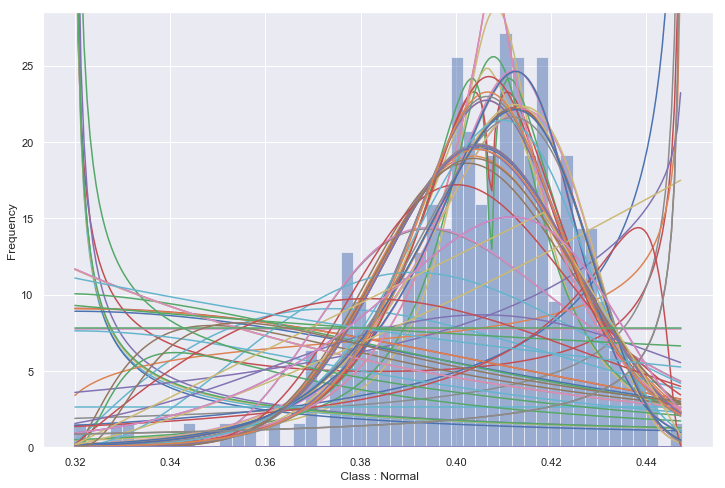

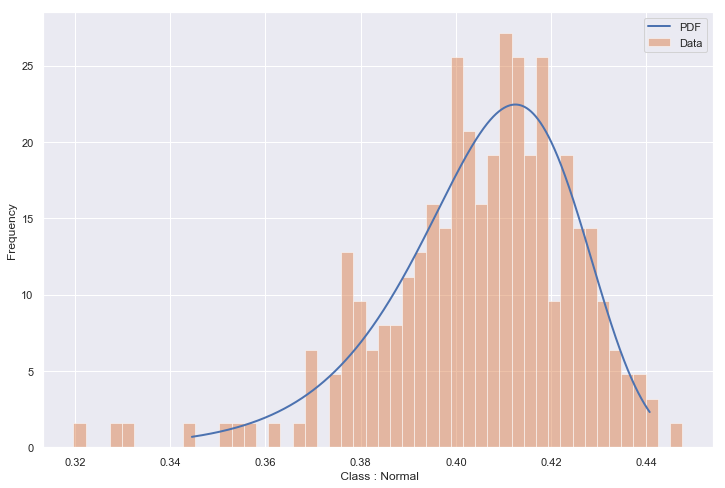

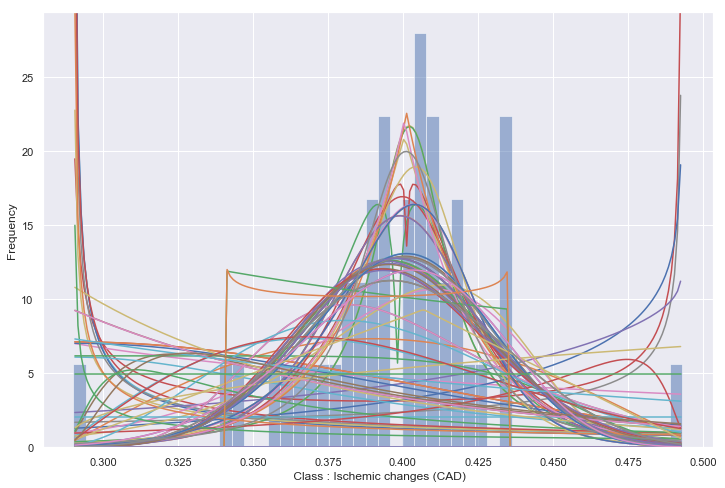

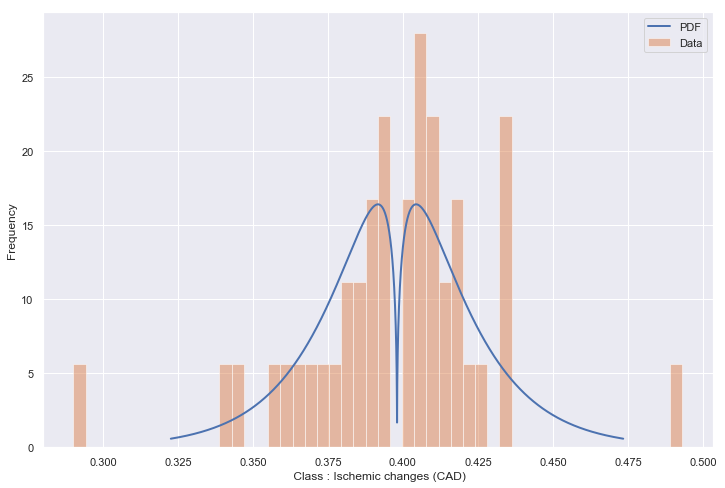

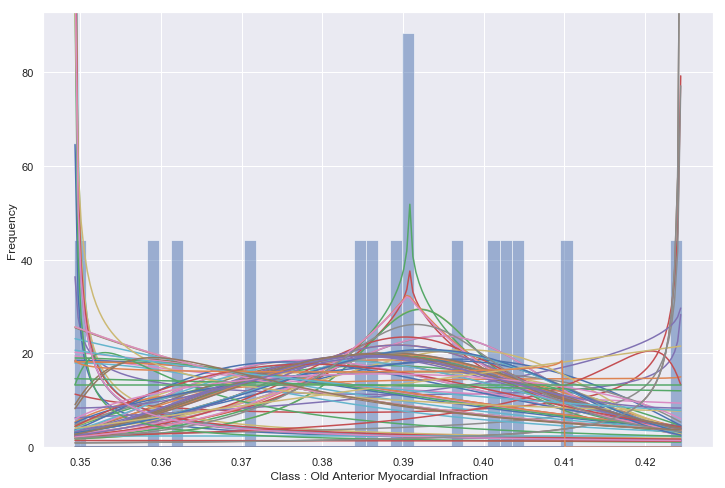

...

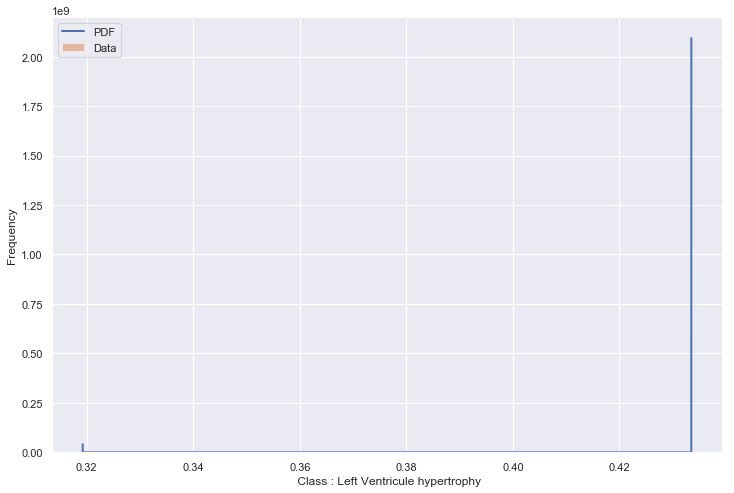

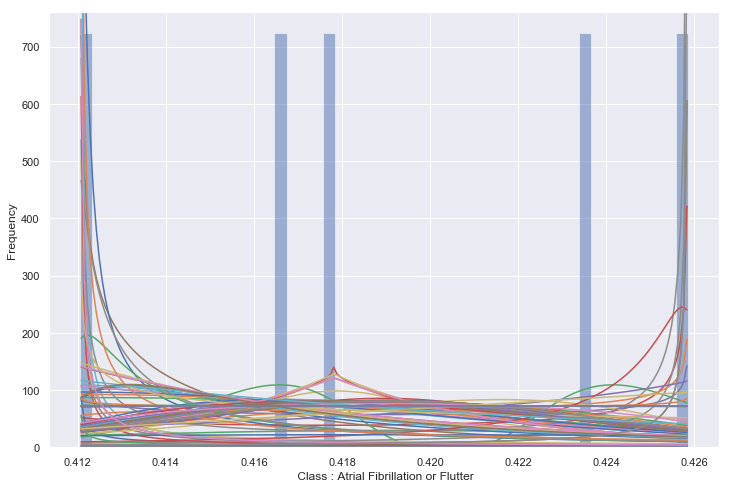

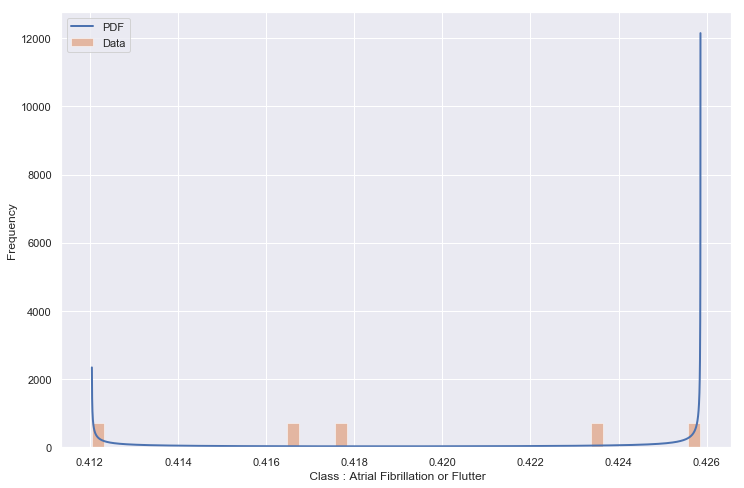

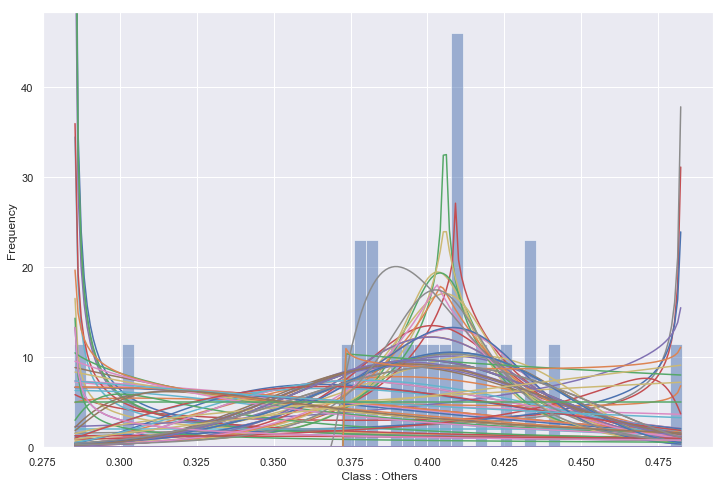

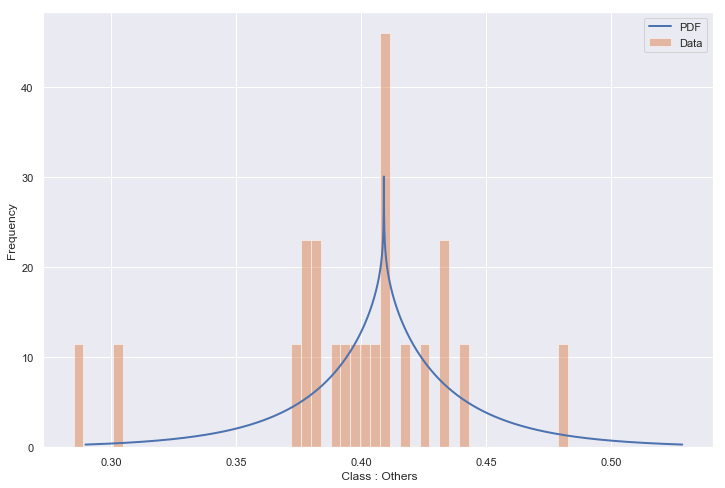

In [323]:
for i in range(1,17):
    if(i not in [11,12,13]):
        get_best_fitting(A_reg_df[A_reg_df['t']==i][f_n[index_1_reg]].astype("float")," Class : "+class_names[i-1])

<strong>Fitting per la seconda feature più informativa</strong>

Senza splitting: indice feature 13

Miglior distribuzione  johnsonsb(a=1.15, b=1.48, loc=0.06, scale=0.55)
Miglior distribuzione  vonmises_line(kappa=0.76, loc=0.28, scale=0.06)
Miglior distribuzione  arcsine(loc=0.13, scale=0.51)
Miglior distribuzione  arcsine(loc=0.24, scale=0.21)
Miglior distribuzione  gennorm(beta=0.18, loc=0.50, scale=0.00)
Miglior distribuzione  dgamma(a=1.45, loc=0.08, scale=0.02)
Miglior distribuzione  levy_l(loc=0.35, scale=0.00)
Miglior distribuzione  johnsonsu(a=5.76, b=0.47, loc=0.21, scale=0.00)
Miglior distribuzione  johnsonsb(a=-0.59, b=0.14, loc=0.10, scale=0.20)
Miglior distribuzione  dgamma(a=0.74, loc=0.24, scale=0.10)
Miglior distribuzione  erlang(a=0.12, loc=0.32, scale=0.03)
Miglior distribuzione  beta(a=0.19, b=0.30, loc=0.23, scale=0.37)
Miglior distribuzione  triang(c=0.14, loc=0.06, scale=0.50)


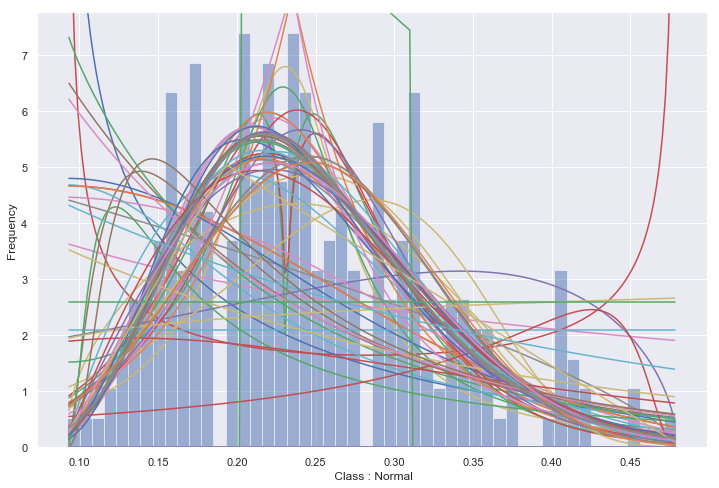

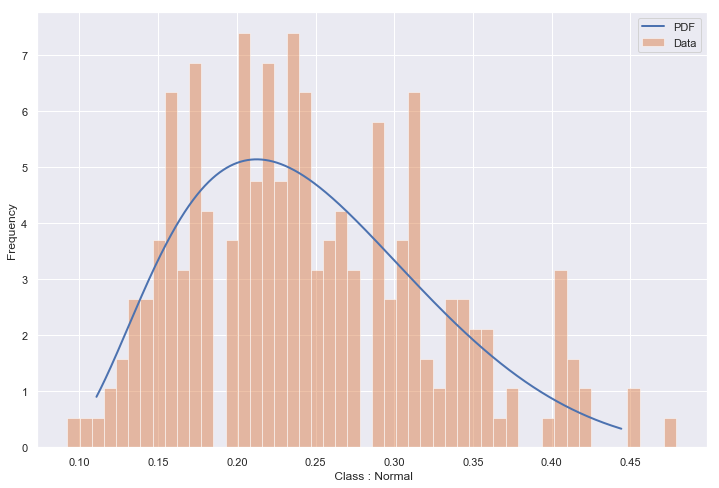

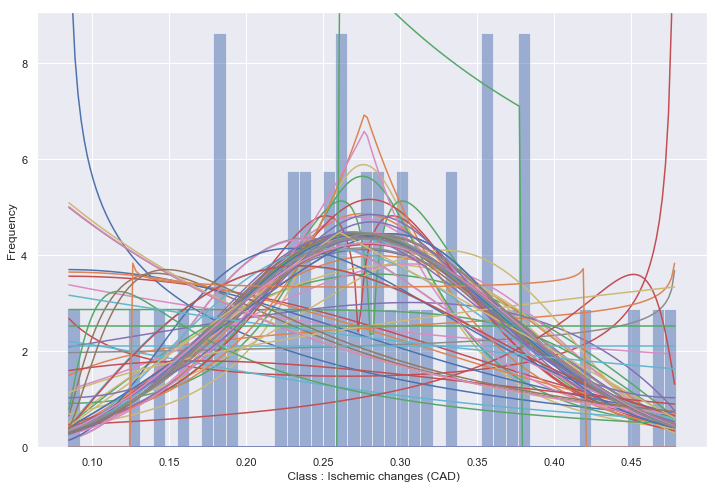

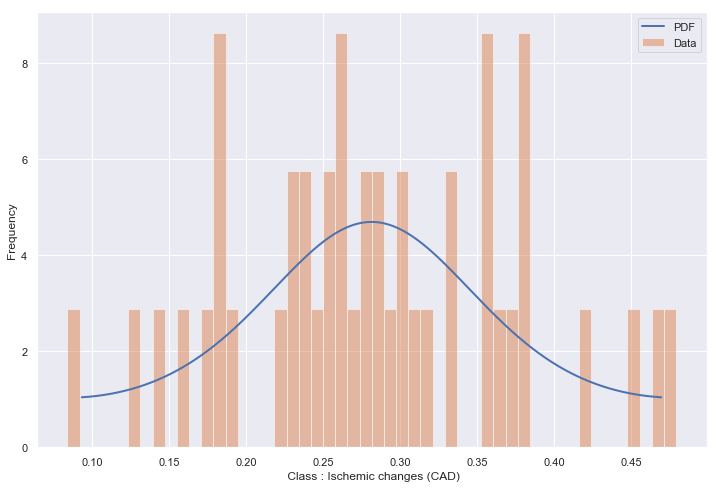

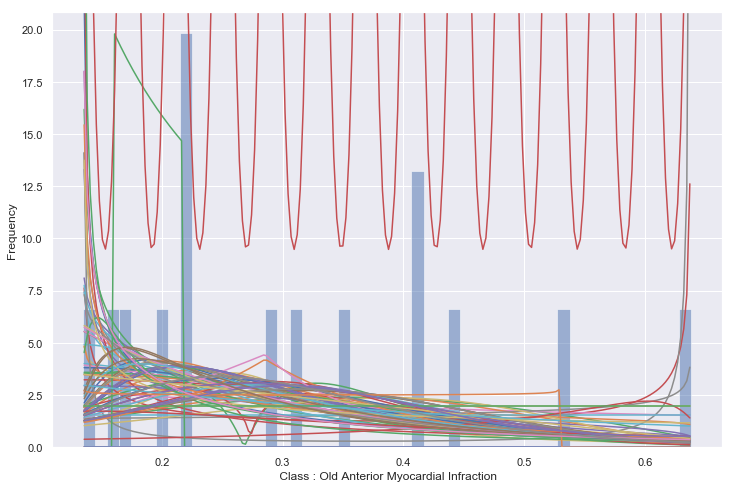

...

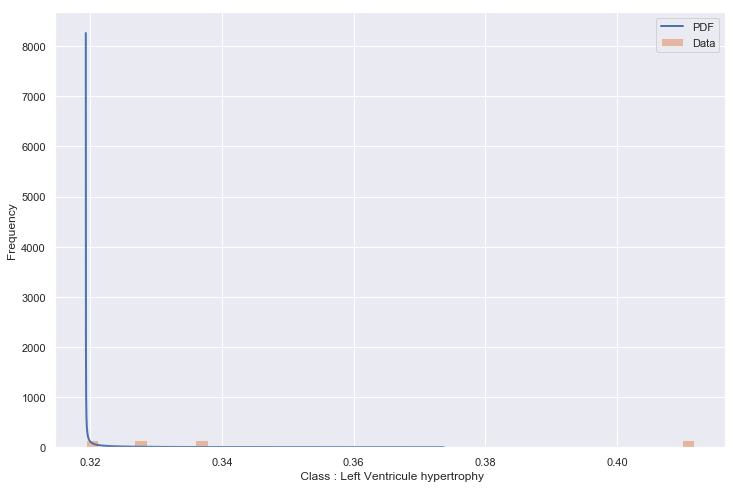

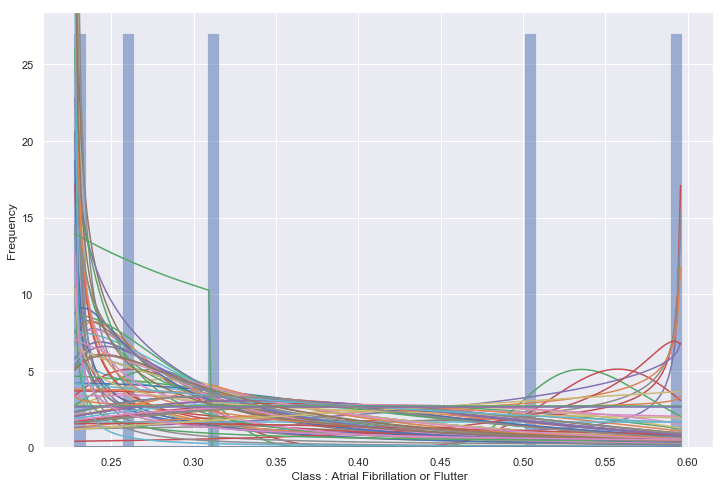

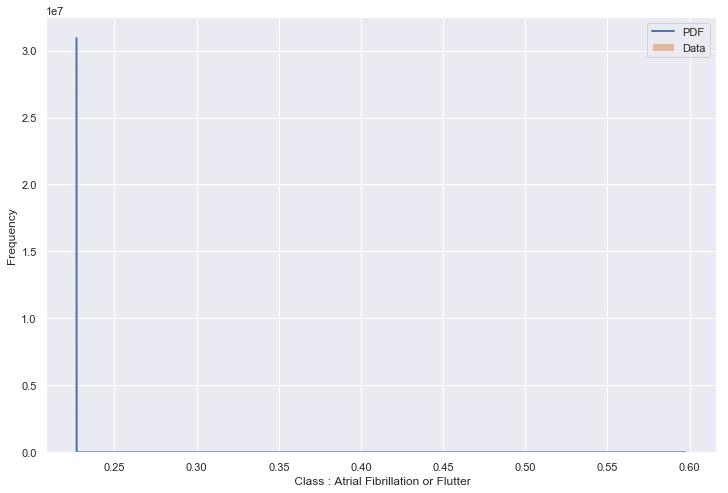

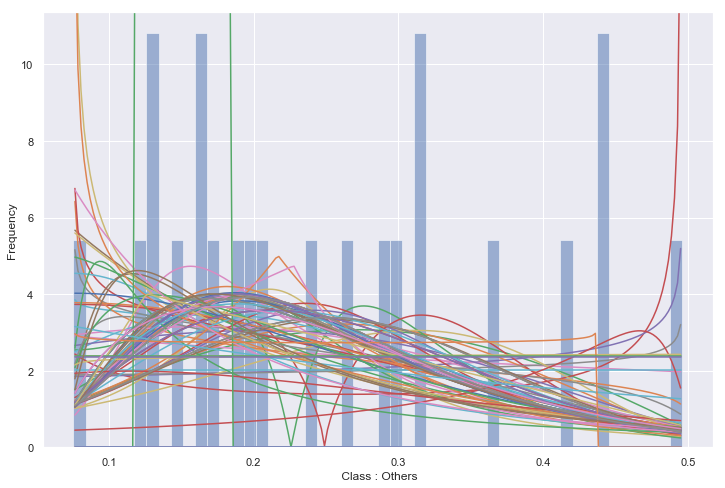

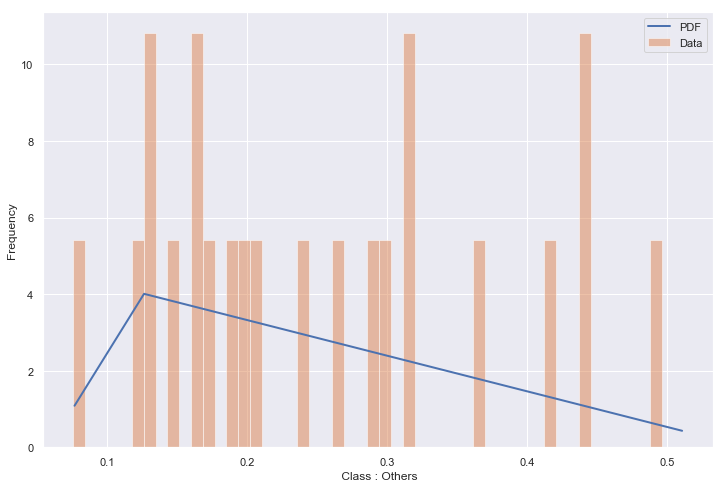

In [324]:
for i in range(1,17):
    if(i not in [11,12,13]):
        get_best_fitting(A_reg_df[A_reg_df['t']==i][f_n[index_2_reg]].astype("float")," Class : "+class_names[i-1])

<strong>Fitting per la terza feature più informativa</strong>

Senza splitting: indice feature 195

Miglior distribuzione  dweibull(c=1.33, loc=0.23, scale=0.07)
Miglior distribuzione  vonmises_line(kappa=0.35, loc=0.39, scale=0.05)
Miglior distribuzione  dgamma(a=0.85, loc=0.33, scale=0.07)
Miglior distribuzione  gennorm(beta=0.10, loc=0.34, scale=0.00)
Miglior distribuzione  dweibull(c=0.51, loc=0.28, scale=0.09)
Miglior distribuzione  dgamma(a=1.64, loc=0.25, scale=0.03)
Miglior distribuzione  genextreme(c=-1.97, loc=0.18, scale=0.00)
Miglior distribuzione  halfcauchy(loc=0.21, scale=0.00)
Miglior distribuzione  pearson3(skew=2.59, loc=0.59, scale=0.12)
Miglior distribuzione  dweibull(c=1.38, loc=0.22, scale=0.07)
Miglior distribuzione  burr(c=0.76, d=0.71, loc=0.10, scale=0.01)
Miglior distribuzione  bradford(c=77229.50, loc=0.28, scale=0.52)
Miglior distribuzione  gausshyper(a=0.77, b=0.93, c=0.59, z=1.54, loc=0.14, scale=0.35)


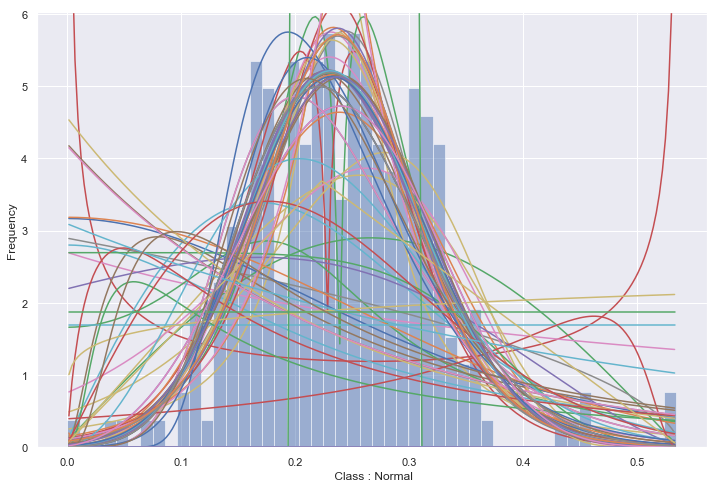

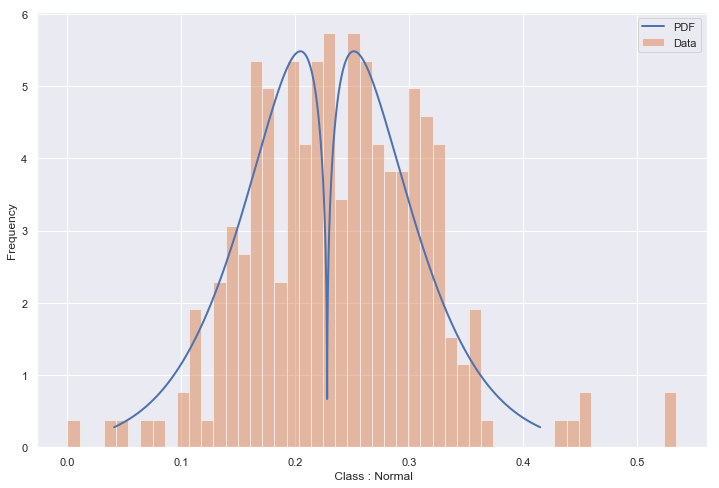

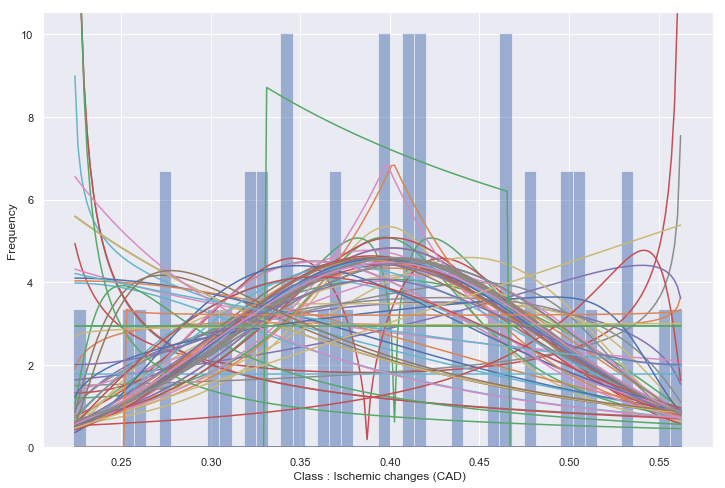

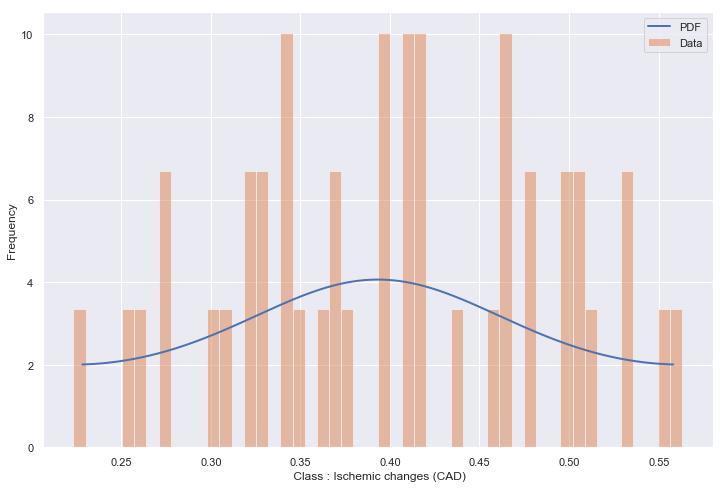

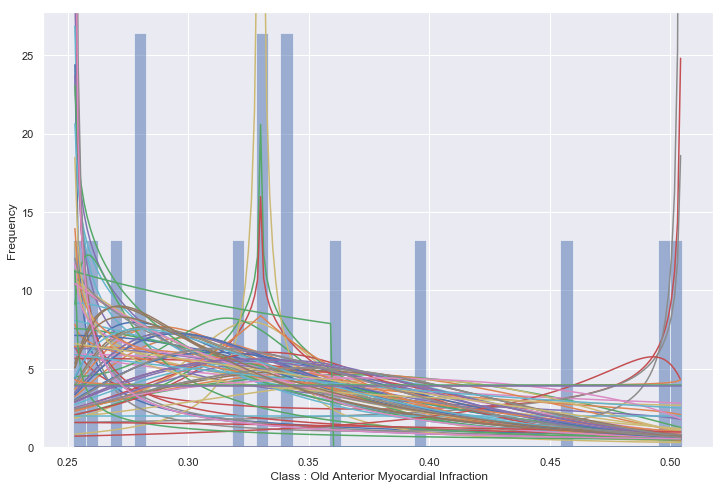

...

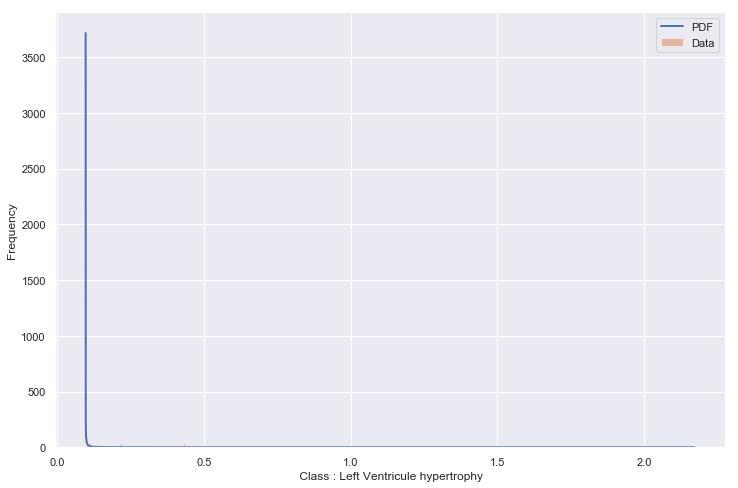

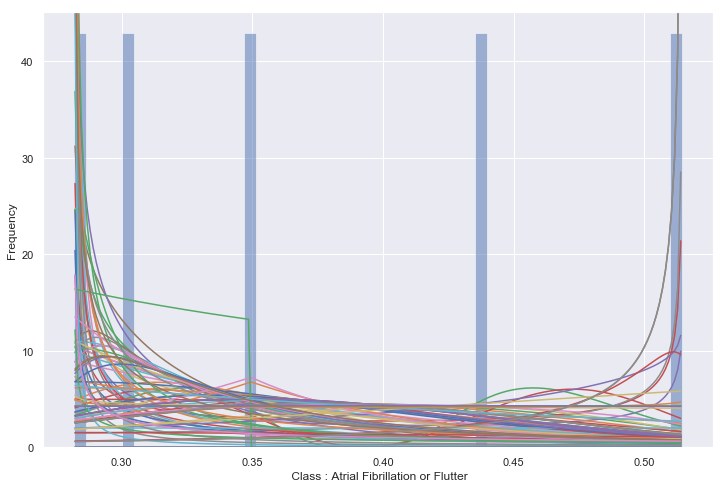

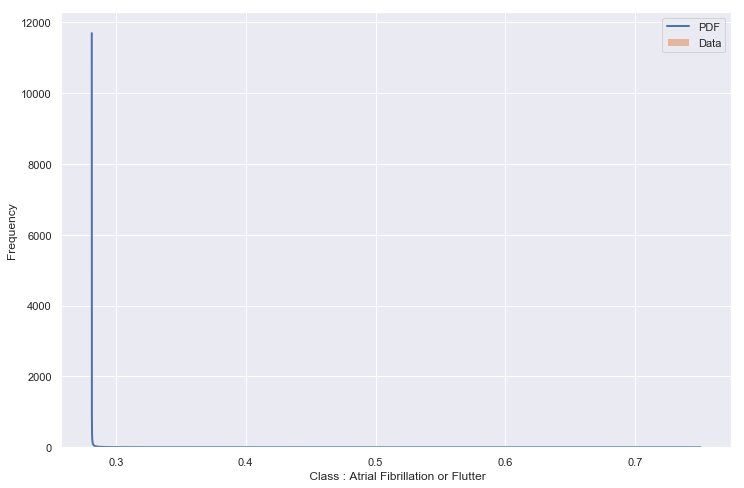

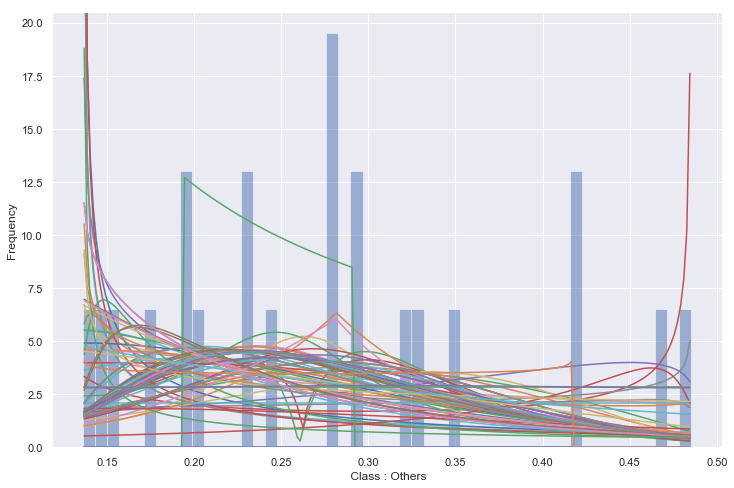

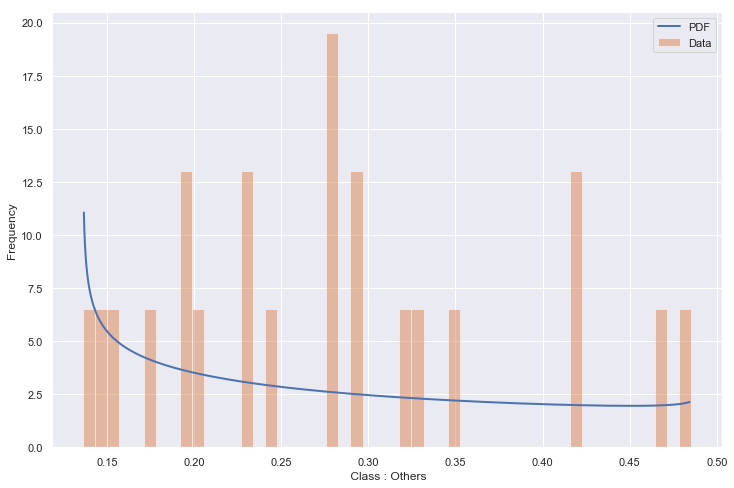

In [328]:
for i in range(1,17):
    if(i not in [11,12,13]):
        get_best_fitting(A_reg_df[A_reg_df['t']==i][f_n[index_3_reg]].astype("float")," Class : "+class_names[i-1])

<a id="PCAMANI"></a>
<h3>Visualizzazione dei dati mediante Principal Component Analysis e Metodi Manifolds<a href="#indice" style="text-decoration:none;">↑</a></h3>


In [52]:
np.random.seed(42)
rndperm = np.random.permutation(data.shape[0])

In [53]:
from Functions.DataAnalysis.fitPcaManifolds import fit_pca_tsne_spectral_isomap,PlotProjection

In [54]:
DelPrincipalDf,MeansPrincipalDf,MediansPrincipalDf,ModePrincipalDf,DetRPrincipalDf,StocRPrincipalDf = fit_pca_tsne_spectral_isomap(rndperm,scaled_matrix_del,scaled_matrix_means,scaled_matrix_medians,scaled_matrix_mode,scaled_matrix_det_regression,scaled_matrix_stoc_regression)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 452 samples in 0.003s...
[t-SNE] Computed neighbors for 452 samples in 0.135s...
[t-SNE] Computed conditional probabilities for sample 452 / 452
[t-SNE] Mean sigma: 4.072104
[t-SNE] KL divergence after 250 iterations with early exaggeration: 135.307236
[t-SNE] KL divergence after 300 iterations: 4.107752
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 452 samples in 0.003s...
[t-SNE] Computed neighbors for 452 samples in 0.099s...
[t-SNE] Computed conditional probabilities for sample 452 / 452
[t-SNE] Mean sigma: 4.110596
[t-SNE] KL divergence after 250 iterations with early exaggeration: 139.648544
[t-SNE] KL divergence after 300 iterations: 4.366568
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 452 samples in 0.003s...
[t-SNE] Computed neighbors for 452 samples in 0.103s...
[t-SNE] Computed conditional probabilities for sample 452 / 452
[t-SNE] Mean sigma: 4.110570
[t-SNE] KL divergence after 250 itera

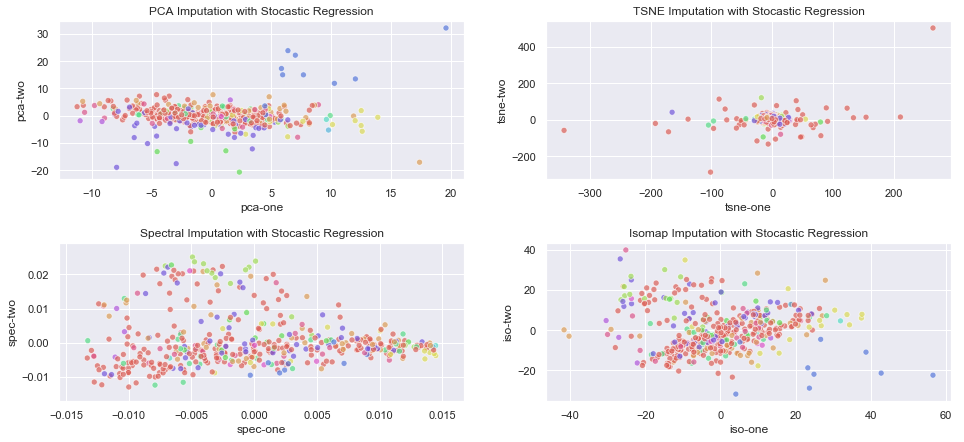

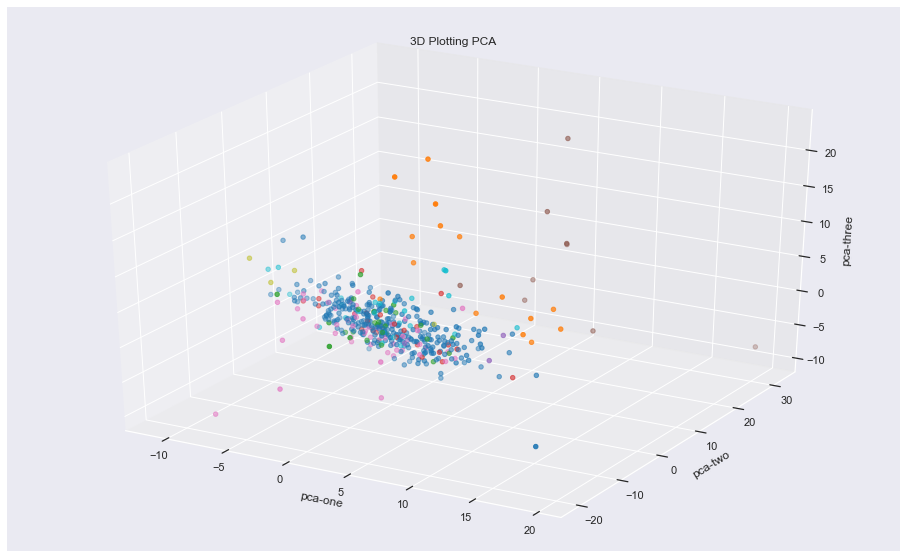

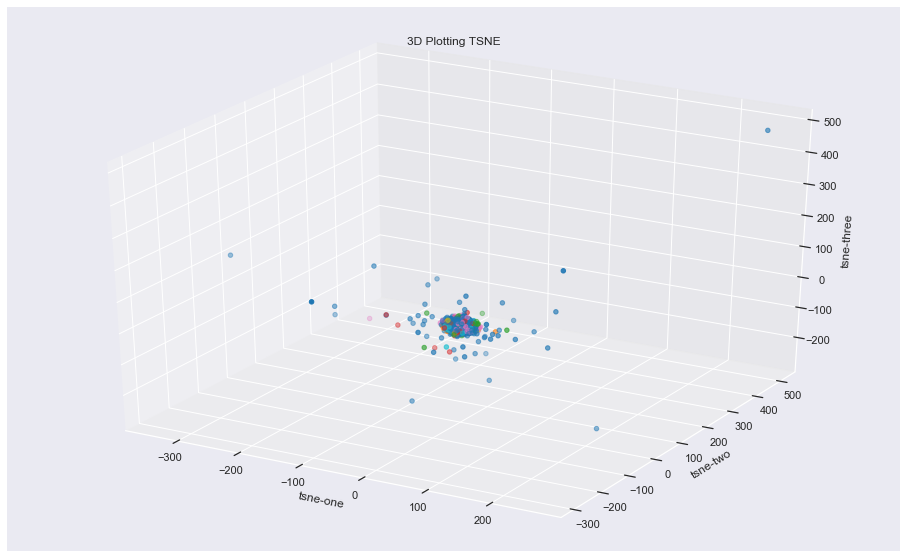

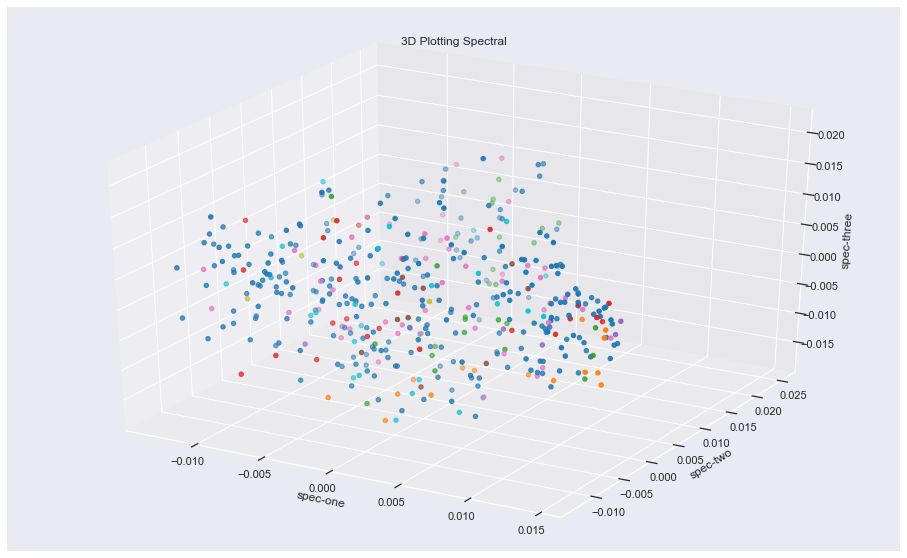

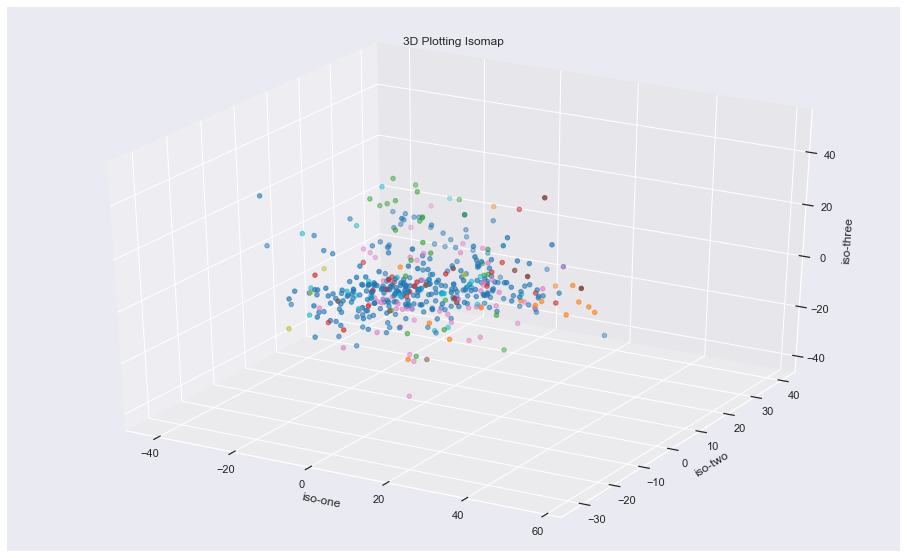

In [55]:
PlotProjection([StocRPrincipalDf],['Imputation with Stocastic Regression'],data,rndperm)

<a id="LearningMulti"></a>
<h3> Applicazione di Algoritmi di Learning per risolvere il task di multiclassificazione <a href="#indice" style="text-decoration:none;">↑</a></h3>

## Datasets Splitting 

In [60]:
test_size = 0.2

In [61]:

X_train_del, X_test_del,Y_train_del,Y_test_del = train_test_split(scaled_matrix_del, target, test_size=test_size, random_state=1)
X_train_means, X_test_means,Y_train_means,Y_test_means = train_test_split(scaled_matrix_means, target, test_size=test_size, random_state=1)
X_train_medians, X_test_medians,Y_train_medians,Y_test_medians = train_test_split(scaled_matrix_medians, target, test_size=test_size, random_state=1)
X_train_mode, X_test_mode,Y_train_mode,Y_test_mode = train_test_split(scaled_matrix_mode, target, test_size=test_size, random_state=1)
X_train_det_r, X_test_det_r,Y_train_det_r,Y_test_det_r = train_test_split(scaled_matrix_det_regression, target, test_size=test_size, random_state=1)
X_train_stoc_r, X_test_stoc_r,Y_train_stoc_r,Y_test_stoc_r = train_test_split(scaled_matrix_stoc_regression, target, test_size=test_size, random_state=1)

In [62]:
Trains = [[X_train_del,Y_train_del],[X_train_means,Y_train_means],[X_train_medians,Y_train_medians],[X_train_mode,Y_train_mode],[X_train_det_r,Y_train_det_r],[X_train_stoc_r,Y_train_stoc_r]]

In [63]:
Datasets = [[X_train_del,Y_train_del,X_test_del,Y_test_del],[X_train_means,Y_train_means,X_test_means,Y_test_means],[X_train_medians,Y_train_medians,X_test_medians,Y_test_medians],[X_train_mode,Y_train_mode,X_test_mode,Y_test_mode],[X_train_det_r,Y_train_det_r,X_test_det_r,Y_test_det_r],[X_train_stoc_r,Y_train_stoc_r,X_test_stoc_r,Y_test_stoc_r]]

<a id="SVM"></a>
<h3>Support Vector Machines <a href="#indice" style="text-decoration:none;">↑</a></h3>

In [48]:
from Functions.SVM.svm import train_svm_k_fold_pca,train_svm_k_fold_pear,train_svm_k_fold_RFE,train_svm_k_fold,test_svm,tune_svm


#### Hyperparameters 

In [156]:
Kernels = ["linear","rbf","poly","sigmoid"]
Degrees = [i for i in range(0,4)]
Cs = [2**(-5), 2**(-3),2**(-1),2**(-15)]
Gamma = [2**(-15),2**(-13),2**(3) ]
nfeats = 15

#### Description of the training process

For the training process we use 

In [ ]:
tune_svm(Kernels,Degrees,Cs,Gamma,nfeats,Trains,Datasets,"ResultsSVM") 

In [75]:
best_scores_nofs = np.load("ResultsSVM/best_scores_nofs.npy")

In [59]:
imputations =["Eliminazione","Media","Mediano","Moda","LR Det","LR Stoc"]

## SVM - No Feature Selection

RECALL Eliminazione 0.5296176046176047
PRECISION Eliminazione 0.463986013986014
RECALL Media 0.6146464646464647
PRECISION Media 0.5190559440559441
RECALL Mediano 0.6146464646464647
PRECISION Mediano 0.5190559440559441
RECALL Moda 0.6082520116418422
PRECISION Moda 0.5190559440559441
RECALL LR Det 0.6238325881768504
PRECISION LR Det 0.5208041958041959
RECALL LR Stoc 0.5297264211198637
PRECISION LR Stoc 0.4718531468531469


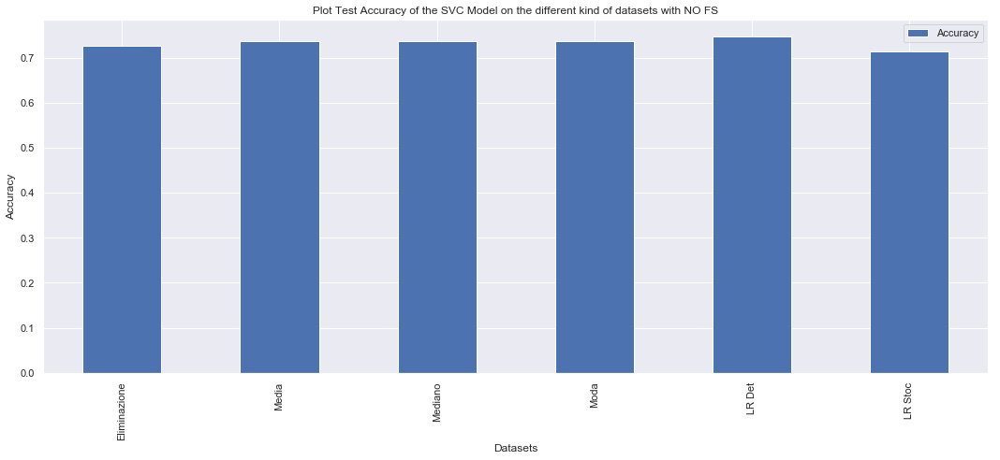

              Accuracy
Eliminazione  0.725275
Media         0.736264
Mediano       0.736264
Moda          0.736264
LR Det        0.747253
LR Stoc       0.714286


In [76]:
svm_nofs_scores,svm_nofs_recall,svm_nofs_precision = test_svm(Datasets,best_scores_nofs,imputations,"NO FS",False)

## SVM - RFE Test Scores

In [77]:
best_scores_rfe = np.load("ResultsSVM/best_scores_rfe.npy")

RECALL Eliminazione 0.45959595959595956
PRECISION Eliminazione 0.4452797202797203
RECALL Media 0.5274385647519977
PRECISION Media 0.4608974358974359
RECALL Mediano 0.5382284382284382
PRECISION Mediano 0.5076340326340326
RECALL Moda 0.46272985514788795
PRECISION Moda 0.4338675213675214
RECALL LR Det 0.5947330447330447
PRECISION LR Det 0.5303613053613053
RECALL LR Stoc 0.4639376218323587
PRECISION LR Stoc 0.4394764957264958


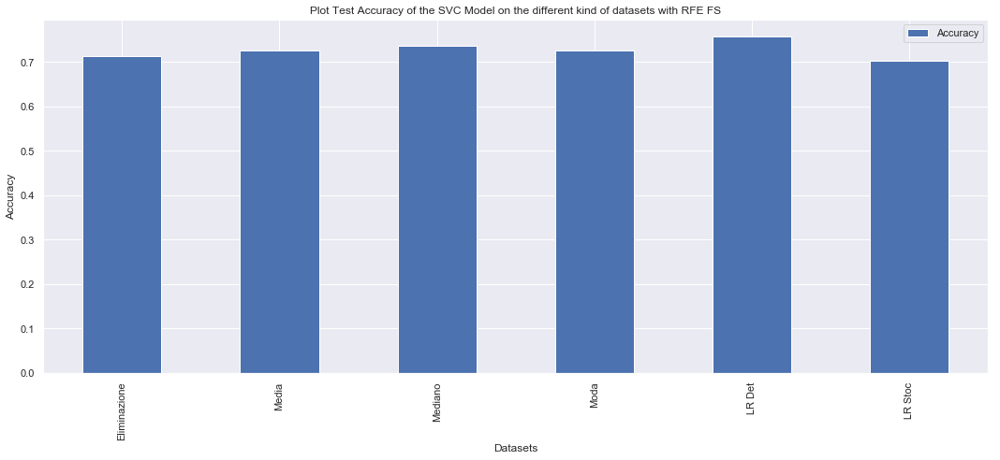

              Accuracy
Eliminazione  0.714286
Media         0.725275
Mediano       0.736264
Moda          0.725275
LR Det        0.758242
LR Stoc       0.703297


In [78]:
svm_rfe_scores,svm_rfe_recall,svm_rfe_precision = test_svm(Datasets,best_scores_rfe,imputations,"RFE FS")

## SVM - Pearson Test Scores

In [79]:
best_scores_pear = np.load("ResultsSVM/best_scores_pear.npy")

RECALL Eliminazione 0.553030303030303
PRECISION Eliminazione 0.4657342657342658
RECALL Media 0.6146464646464647
PRECISION Media 0.5190559440559441
RECALL Mediano 0.6146464646464647
PRECISION Mediano 0.5190559440559441
RECALL Moda 0.6082520116418422
PRECISION Moda 0.5190559440559441
RECALL LR Det 0.6311918955361577
PRECISION LR Det 0.5208041958041959
RECALL LR Stoc 0.5297264211198637
PRECISION LR Stoc 0.4718531468531469


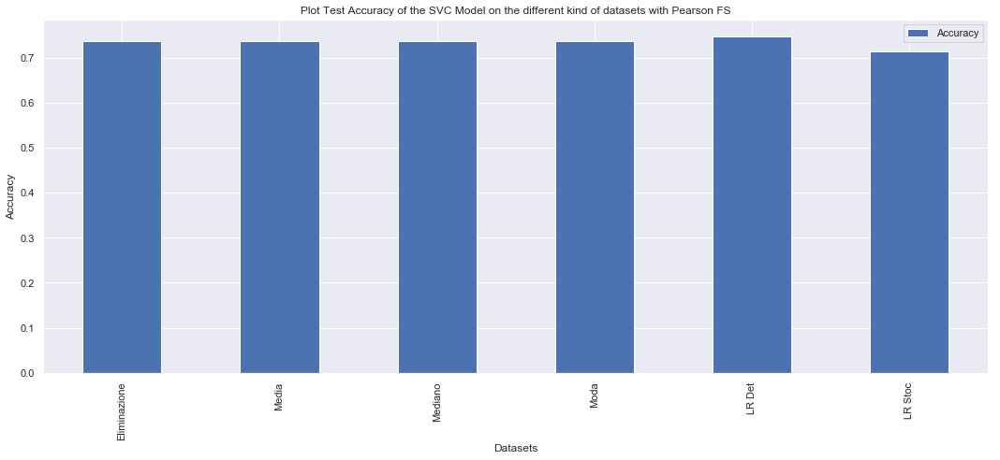

              Accuracy
Eliminazione  0.736264
Media         0.736264
Mediano       0.736264
Moda          0.736264
LR Det        0.747253
LR Stoc       0.714286


In [80]:
svm_pear_scores,svm_pear_recall,svm_pear_precision = test_svm(Datasets,best_scores_pear,imputations,"Pearson FS")

## SVM - PCA Test Scores

In [81]:
best_scores_pca = np.load("ResultsSVM/best_scores_pca.npy")

Somma explained variance:  0.9512342270600365
RECALL Eliminazione 0.051948051948051945
PRECISION Eliminazione 0.09090909090909091
Somma explained variance:  0.9508078435553989
RECALL Media 0.051948051948051945
PRECISION Media 0.09090909090909091
Somma explained variance:  0.950792241293684
RECALL Mediano 0.051948051948051945
PRECISION Mediano 0.09090909090909091
Somma explained variance:  0.9508703134186229
RECALL Moda 0.051948051948051945
PRECISION Moda 0.09090909090909091
Somma explained variance:  0.9501688182493901
RECALL LR Det 0.051948051948051945
PRECISION LR Det 0.09090909090909091
Somma explained variance:  0.9514808356995111
RECALL LR Stoc 0.051948051948051945
PRECISION LR Stoc 0.09090909090909091


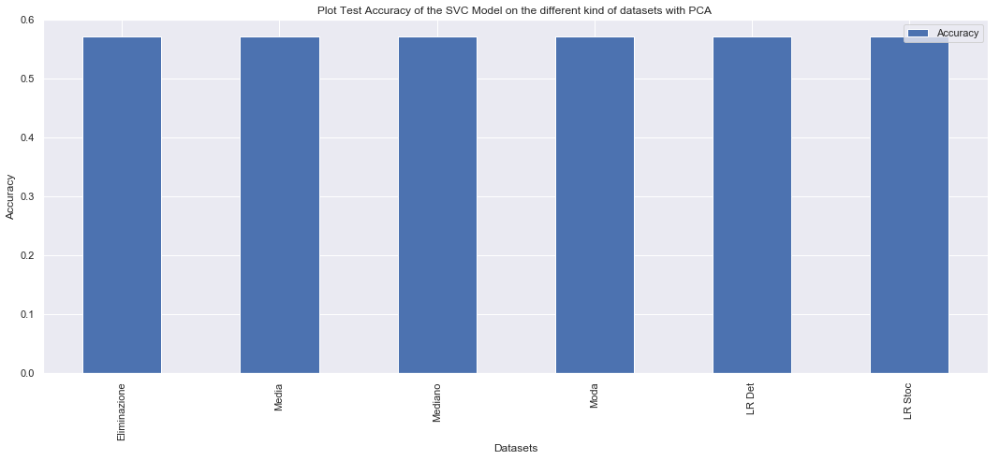

              Accuracy
Eliminazione  0.571429
Media         0.571429
Mediano       0.571429
Moda          0.571429
LR Det        0.571429
LR Stoc       0.571429


In [82]:
svm_pca_scores,svm_pca_recall,svm_pca_precision = test_svm(Datasets,best_scores_pca,imputations,"PCA ",fs = False,pca=True)

In [83]:
svm_scores_dic = {
    "RFE":svm_rfe_scores,
    "Pear":svm_pear_scores,
    "NoFS":svm_nofs_scores,
    "PCA":svm_pca_scores
}

In [84]:
svm_recall_dic = {
    "RFE":svm_rfe_recall,
    "Pear":svm_pear_recall,
    "NoFS":svm_nofs_recall,
    "PCA":svm_pca_recall
}

In [85]:
svm_precision_dic = {
    "RFE":svm_rfe_precision,
    "Pear":svm_pear_precision,
    "NoFS":svm_nofs_precision,
    "PCA":svm_pca_precision
}

In [86]:
imputations

['Eliminazione', 'Media', 'Mediano', 'Moda', 'LR Det', 'LR Stoc']

In [87]:
svm_scores = pd.DataFrame(svm_scores_dic,index=imputations)

In [88]:
svm_recalls = pd.DataFrame(svm_recall_dic,index=imputations)

In [89]:
svm_precision = pd.DataFrame(svm_precision_dic,index=imputations)


<a id="SVMAccuracy"></a>
<h3> Accuracy sul Test <a href="#indice" style="text-decoration:none;">↑</a></h3>



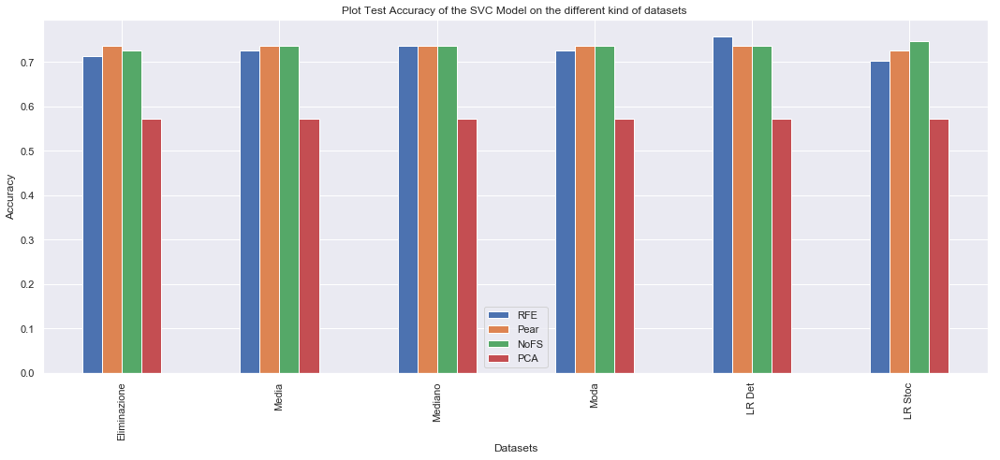

,RFE,Pear,NoFS,PCA
Eliminazione,0.714286,0.736264,0.725275,0.571429
Media,0.725275,0.736264,0.736264,0.571429
Mediano,0.736264,0.736264,0.736264,0.571429
Moda,0.725275,0.736264,0.736264,0.571429
LR Det,0.758242,0.736264,0.736264,0.571429
LR Stoc,0.703297,0.725275,0.747253,0.571429


In [104]:
fig, ax = plt.subplots(figsize=(15,7))
svm_scores.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Accuracy of the SVC Model on the different kind of datasets ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
svm_scores


<a id="SVMRecall"></a>
<h3> Recall sul Test <a href="#indice" style="text-decoration:none;">↑</a></h3>




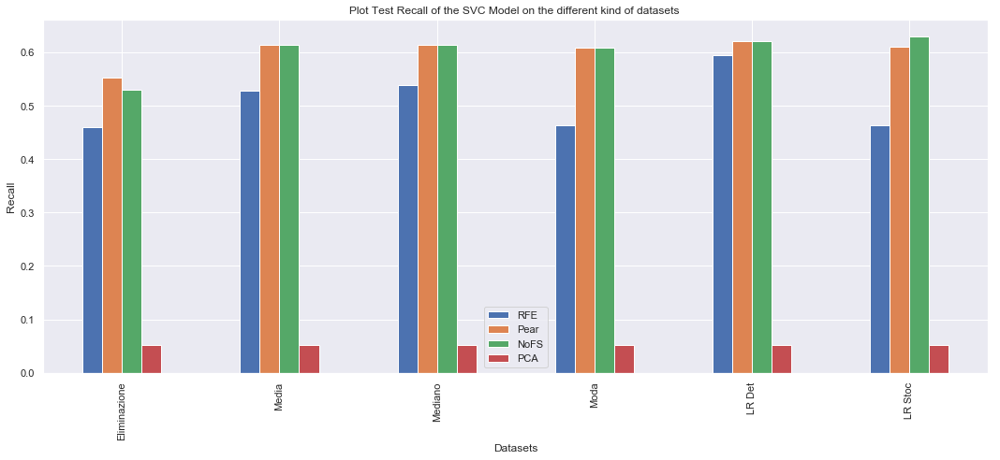

,RFE,Pear,NoFS,PCA
Eliminazione,0.459596,0.553030,0.529618,0.051948
Media,0.527439,0.614646,0.614646,0.051948
Mediano,0.538228,0.614646,0.614646,0.051948
Moda,0.462730,0.608252,0.608252,0.051948
LR Det,0.594733,0.621465,0.621080,0.051948
LR Stoc,0.463938,0.609885,0.630279,0.051948


In [110]:
fig, ax = plt.subplots(figsize=(15,7))
svm_recalls.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Recall of the SVC Model on the different kind of datasets ")
ax.set_ylabel('Recall')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
svm_recalls

<a id="SVMPrecision"></a>
<h3> Precision sul Test <a href="#indice" style="text-decoration:none;">↑</a></h3>


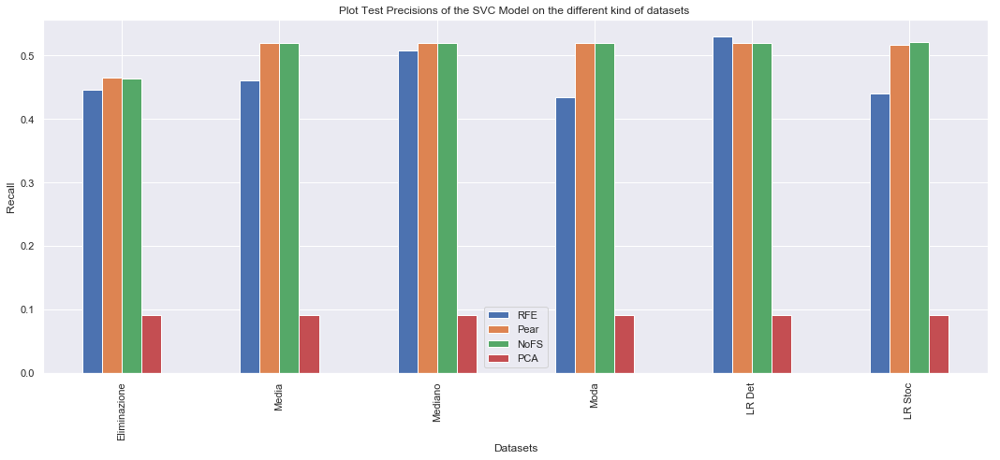

,RFE,Pear,NoFS,PCA
Eliminazione,0.445280,0.465734,0.463986,0.090909
Media,0.460897,0.519056,0.519056,0.090909
Mediano,0.507634,0.519056,0.519056,0.090909
Moda,0.433868,0.519056,0.519056,0.090909
LR Det,0.530361,0.519056,0.519056,0.090909
LR Stoc,0.439476,0.517308,0.520804,0.090909


In [115]:
fig, ax = plt.subplots(figsize=(15,7))
svm_precision.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Precisions of the SVC Model on the different kind of datasets ")
ax.set_ylabel('Recall')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
svm_precision

In [49]:
def precision_recall_classes(confusion_matrix,target):
    precisions=[]
    recalls = []
    #print(confusion_matrix)
    #print("SHAPE",confusion_matrix.shape)
    #print("Len Target ",len(target))
    #print("TARGET VALUES ", target)
    for i in range(0,len(target)):
        #print("CLASS",target[i])
        true_pos = confusion_matrix[i][i]
        #print("True positive", true_pos)
        false_pos = np.sum(confusion_matrix[i,:]) - true_pos
        #print("False pos",false_pos)
        false_neg = np.sum(confusion_matrix[:,i]) - true_pos
        #print("False neg", false_neg)
        precision = np.sum(true_pos / (true_pos + false_pos))
        #print("Precision ",precision)
        recall = np.sum(true_pos / (true_pos + false_neg))
        #print("Recall ",recall)
        precisions.append(precision)
        recalls.append(recall)
    
    single_precision_recall={
        "Precision":precisions,
        "Recall":recalls
    }
    #if(len(target)!= confusion_matrix.shape[0])
    precision_recall = pd.DataFrame(single_precision_recall,index=target)
    #print(single_precision_recall)
    return (precision_recall.dropna(thresh=2))




<a id="Ensemble"></a>
<h3> Ensemble Learning <a href="#indice" style="text-decoration:none;">↑</a></h3>


<a id="RF"></a>
<h3> Random Forest <a href="#indice" style="text-decoration:none;">↑</a></h3>



In questa sezione andremo ad indagare come Random Forest performa sui nostri datasets. 
Indagheremo, soprattuto, le performance in termini di precision e recall per ogni singola classe.
Già dallo studio effettuato mediante SVM è chiaro che esistono classi che vengono riconosciute con più difficoltà.
Questo è dovuto allo scarso numero di esempi a disposizione per tali classi. 

In [64]:
from Functions.Ensemble.ensembleMethods import Pearson_FS,RFE_FS,get_PCA,random_forest_cross_pca,random_forest_cross_pear,random_forest_cross_rfe,random_forest_cross_nofs
from Functions.Ensemble.ensembleMethods import training_random_forest_pearson,training_random_forest_rfe,training_random_forest_pca,training_random_forest_nofs
from Functions.Ensemble.ensembleMethods import training_testing_boosting_algorithms_no_FS,training_testing_boosting_algorithms_PCA,training_testing_boosting_algorithms_Pearson,training_testing_boosting_algorithms_RFE

### Training e Testing di Random Forest utilizzando la Correlazione di Pearson per effettuare Feature Selection

In [78]:
scores_rf_pear,lista_n,confusion_matrix_test_forest_gini,predicted_forest_pear_gini = training_random_forest_pearson(Datasets,imputations)

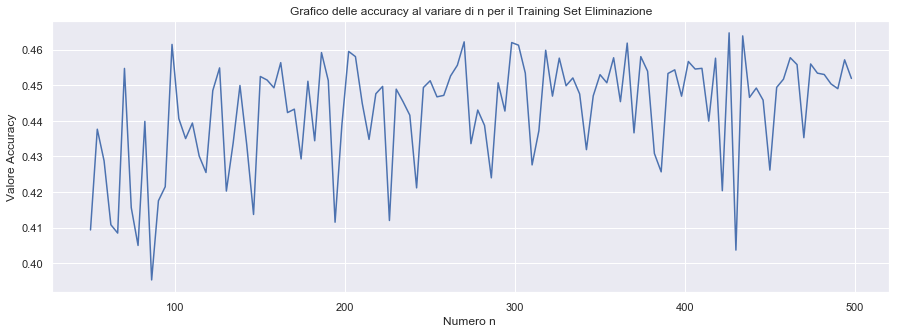

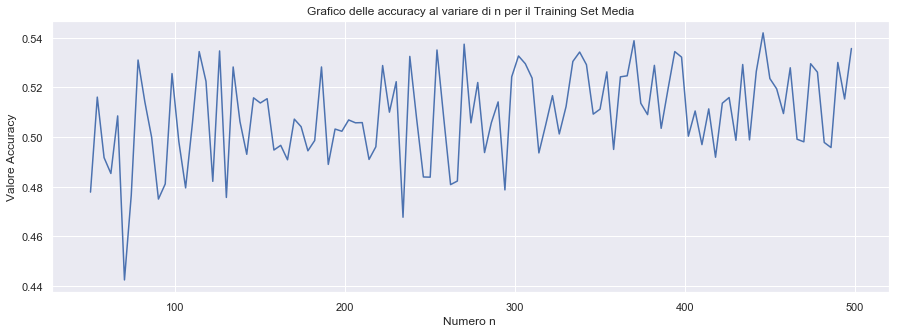

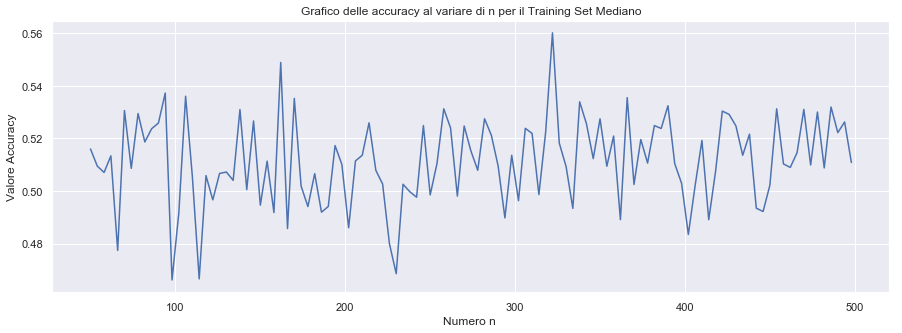

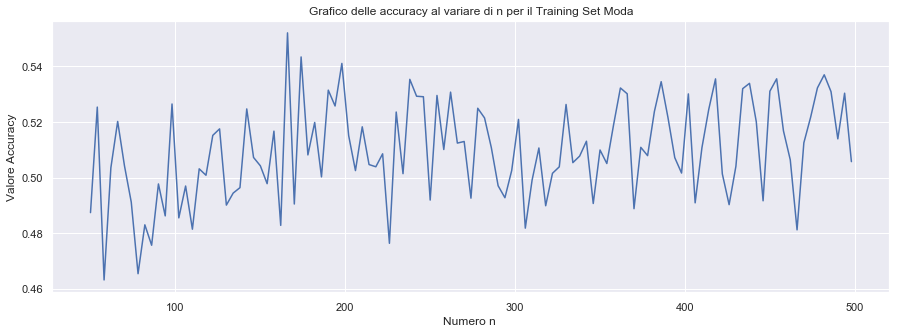

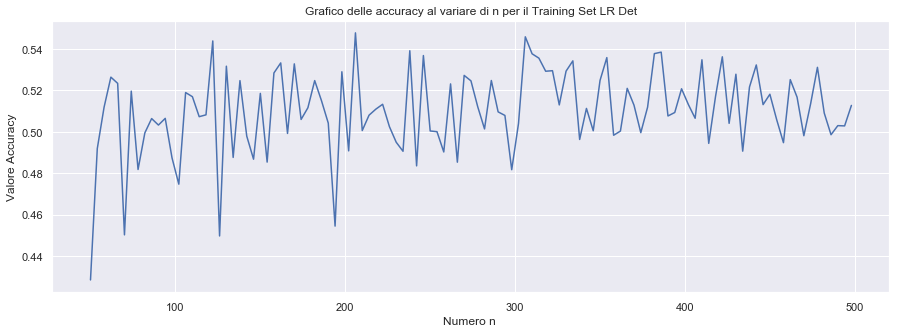

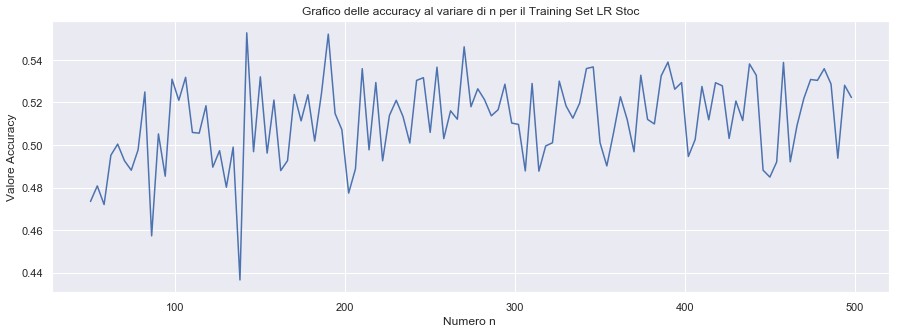

In [80]:
j = 0
for i in lista_n:
    plt.figure(figsize=(15,5))
    plt.plot(i[0], i[1])
    plt.title("Grafico delle accuracy al variare di n per il Training Set "+imputations[j])
    plt.xlabel('Numero n ')
    plt.ylabel('Valore Accuracy')
    plt.show()
    j+=1
    

In [81]:
acc = []
rec = []
prec = []
summary_rf_accuracy_pear_gini = {}
for i in scores_rf_pear:
    acc.append(i[0])
    rec.append(i[1])
    prec.append(i[2])
    #summary_rf_accuracy_pear_gini[imputations[u]] = [i[0],i[1],i[2]]
summary_rf_accuracy_pear_gini["Accuracy"] = acc
summary_rf_accuracy_pear_gini["Recall"] = prec
summary_rf_accuracy_pear_gini["Precision"] = rec

summ_rf_pear_g = pd.DataFrame(summary_rf_accuracy_pear_gini,index=imputations)







<a id="PRF"></a>
<h3>Precision e Recall su ogni singola classe con Pearson per la Feature Selection <a href="#indice" style="text-decoration:none;">↑</a></h3>








### Precision and Recall su ogni singola classe per il dataset con l'eliminazione delle features mancanti

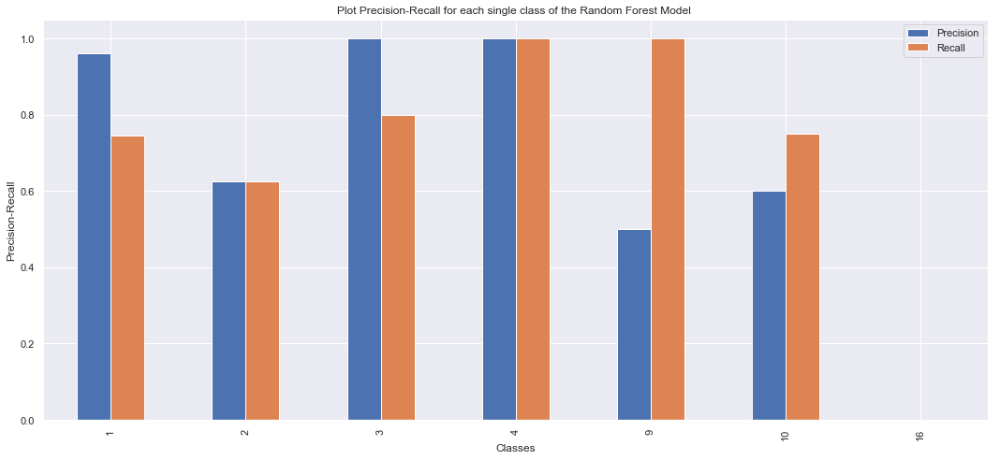

,Precision,Recall
1,0.961538,0.746269
2,0.625000,0.625000
3,1.000000,0.800000
4,1.000000,1.000000
9,0.500000,1.000000
10,0.600000,0.750000
16,0.000000,0.000000


In [83]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_pear[0][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_pear[0][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione della media

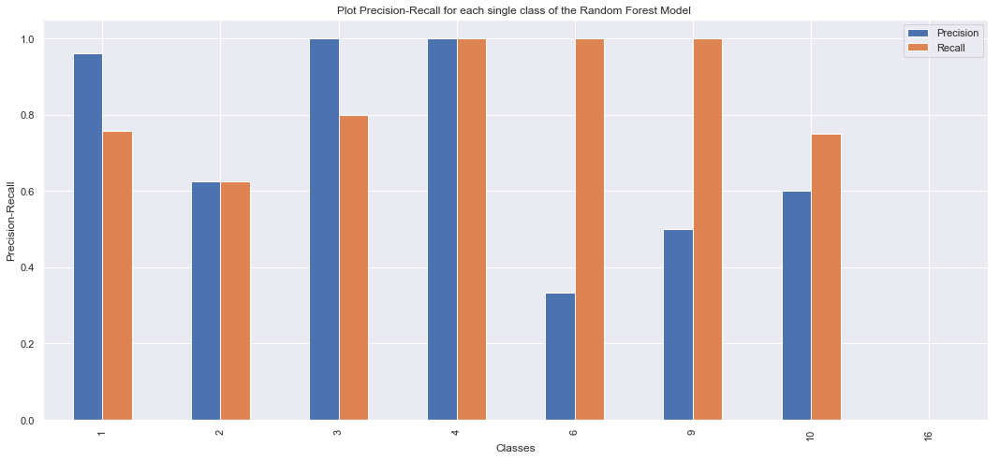

,Precision,Recall
1,0.961538,0.757576
2,0.625000,0.625000
3,1.000000,0.800000
4,1.000000,1.000000
6,0.333333,1.000000
9,0.500000,1.000000
10,0.600000,0.750000
16,0.000000,0.000000


In [84]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_pear[1][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_pear[1][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione della mediana

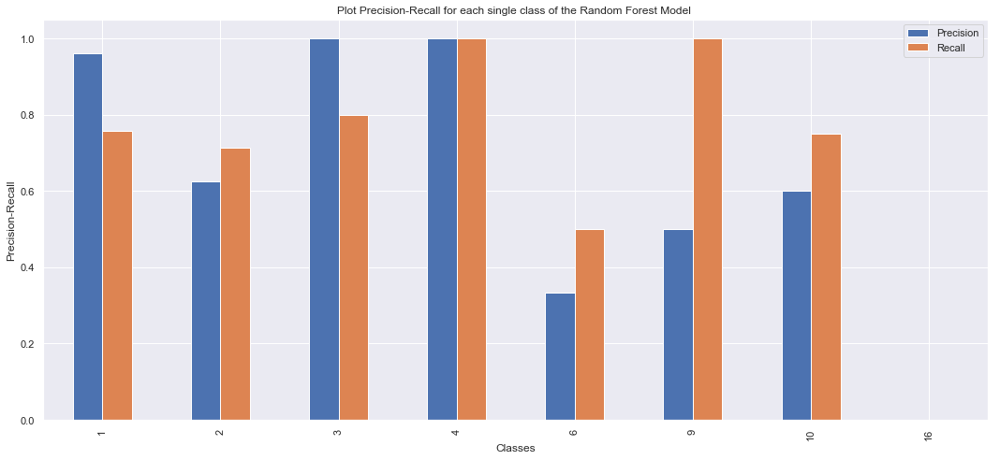

,Precision,Recall
1,0.961538,0.757576
2,0.625000,0.714286
3,1.000000,0.800000
4,1.000000,1.000000
6,0.333333,0.500000
9,0.500000,1.000000
10,0.600000,0.750000
16,0.000000,0.000000


In [85]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_pear[2][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_pear[2][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione della moda

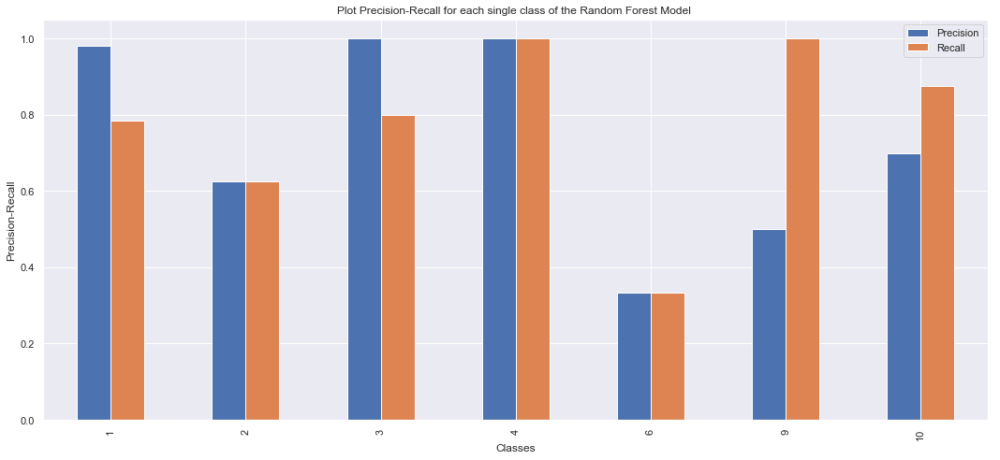

,Precision,Recall
1,0.980769,0.784615
2,0.625000,0.625000
3,1.000000,0.800000
4,1.000000,1.000000
6,0.333333,0.333333
9,0.500000,1.000000
10,0.700000,0.875000


In [86]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_pear[3][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_pear[3][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione mediante Regressione Deterministica

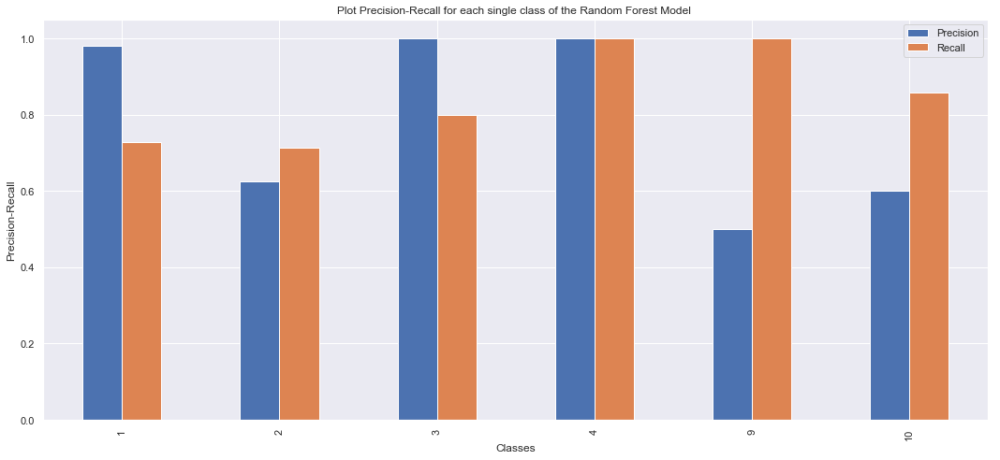

,Precision,Recall
1,0.980769,0.728571
2,0.625000,0.714286
3,1.000000,0.800000
4,1.000000,1.000000
9,0.500000,1.000000
10,0.600000,0.857143


In [87]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_pear[4][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_pear[4][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione mediante Regressione Stocastica

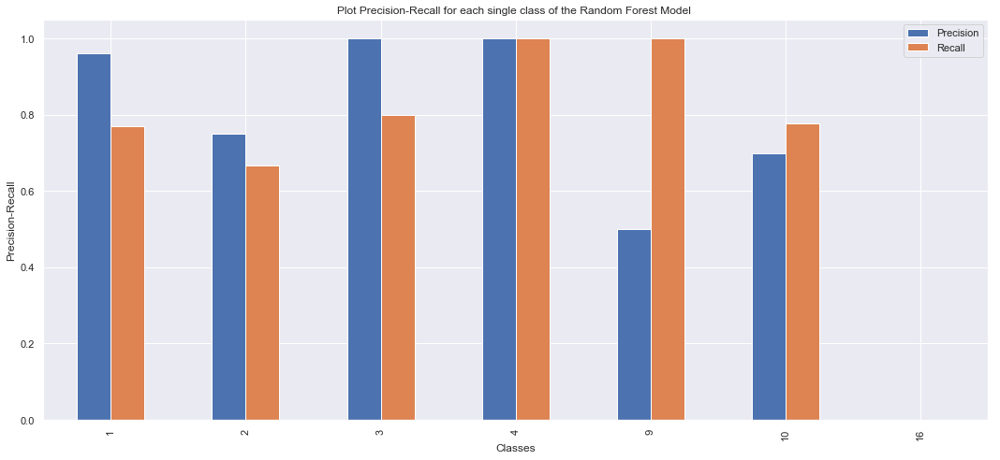

,Precision,Recall
1,0.961538,0.769231
2,0.750000,0.666667
3,1.000000,0.800000
4,1.000000,1.000000
9,0.500000,1.000000
10,0.700000,0.777778
16,0.000000,0.000000


In [88]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_pear[5][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_pear[5][3]

<a id="ACPRF"></a>
<h3>Accuracy, Precision e Recall con Pearson Correlation per la Feature Selection <a href="#indice" style="text-decoration:none;">↑</a></h3>


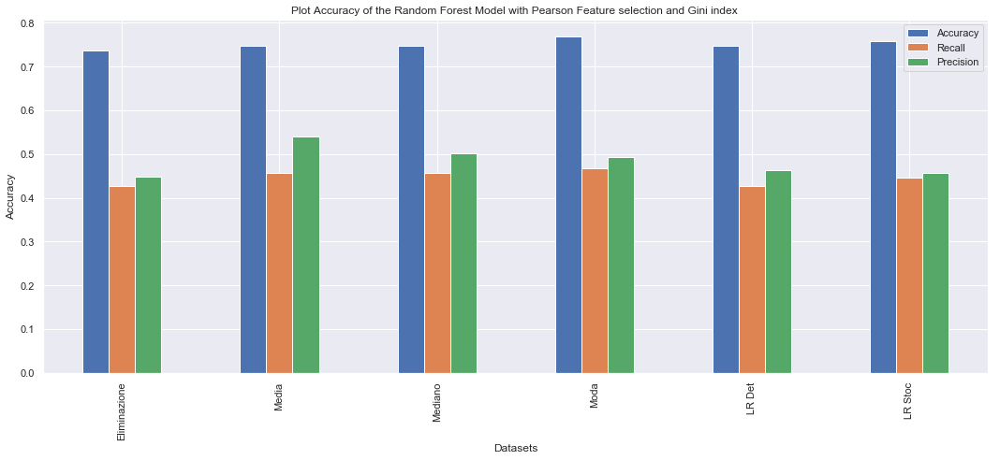

,Accuracy,Recall,Precision
Eliminazione,0.736264,0.426049,0.447388
Media,0.747253,0.456352,0.539325
Mediano,0.747253,0.456352,0.501987
Moda,0.769231,0.467191,0.492541
LR Det,0.747253,0.427797,0.463636
LR Stoc,0.758242,0.446503,0.455789


In [89]:

fig, ax = plt.subplots(figsize=(15,7))
summ_rf_pear_g.plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracy of the Random Forest Model with Pearson Feature selection and Gini index ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
summ_rf_pear_g


### Training e Testing di Random Forest utilizzando Recursive Feature Elimination per effettuare Feature Selection

In [ ]:
scores_rf_rfe,lista_n,confusion_matrix_test_forest_gini_rfe,predicted_forest_rfe_gini = training_random_forest_rfe(Datasets,imputations)

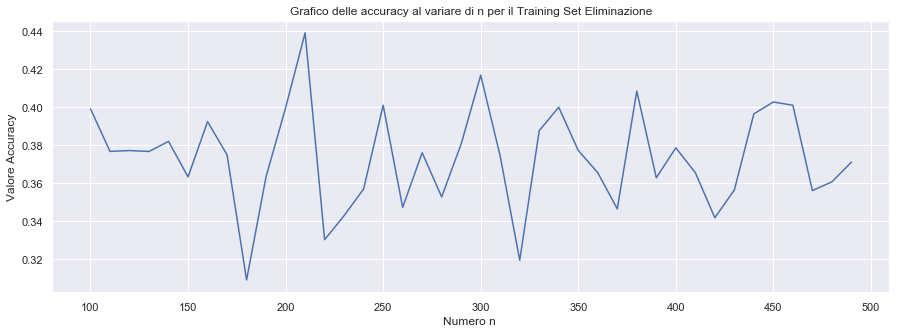

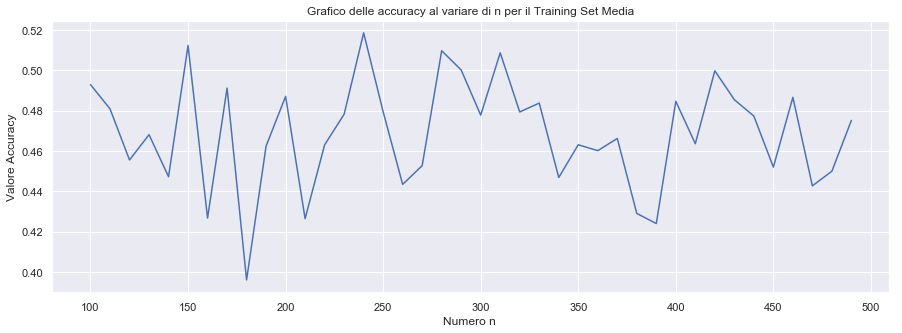

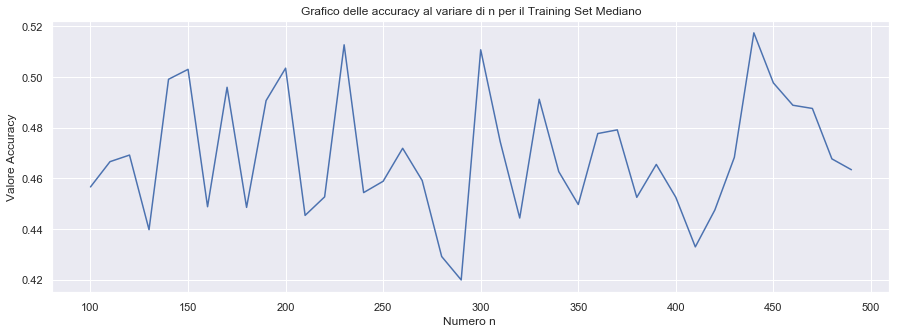

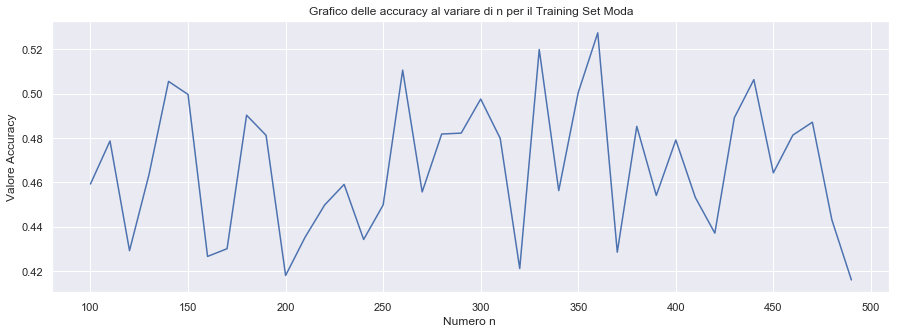

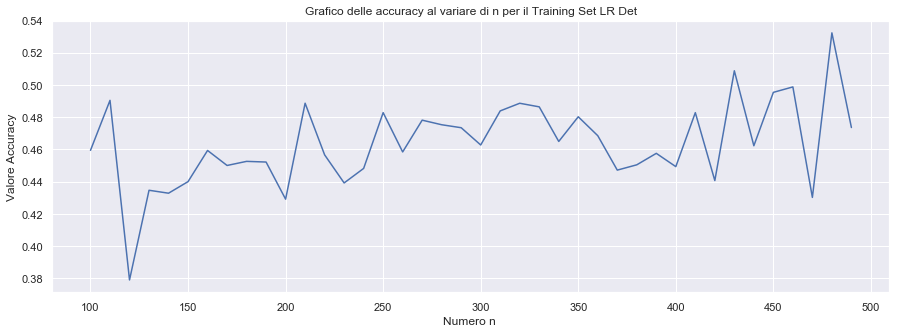

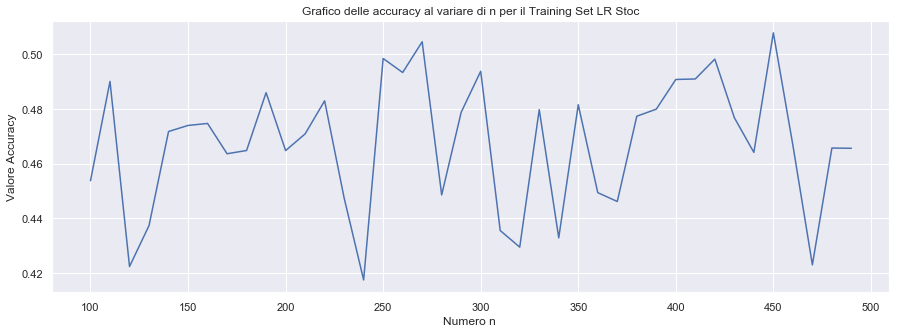

In [66]:
j = 0
for i in lista_n:
    plt.figure(figsize=(15,5))
    plt.plot(i[0], i[1])
    plt.title("Grafico delle accuracy al variare di n per il Training Set "+imputations[j])
    plt.xlabel('Numero n ')
    plt.ylabel('Valore Accuracy')
    plt.show()
    j+=1

In [67]:
acc_rfe = []
rec_rfe = []
prec_rfe = []
summary_rf_accuracy_rfe_gini = {}
for i in scores_rf_rfe:
    acc_rfe.append(i[0])
    rec_rfe.append(i[1])
    prec_rfe.append(i[2])
    #summary_rf_accuracy_pear_gini[imputations[u]] = [i[0],i[1],i[2]]
summary_rf_accuracy_rfe_gini["Accuracy"] = acc_rfe
summary_rf_accuracy_rfe_gini["Recall"] = prec_rfe
summary_rf_accuracy_rfe_gini["Precision"] = rec_rfe

summ_rf_rfe_g = pd.DataFrame(summary_rf_accuracy_rfe_gini,index=imputations)




<a id="RFERF"></a>
<h3>Accuracy, Precision e Recall con RFE per la Feature Selection <a href="#indice" style="text-decoration:none;">↑</a></h3>



### Precision and Recall su ogni singola classe per il dataset dove abbiamo eliminato le feature mancanti 

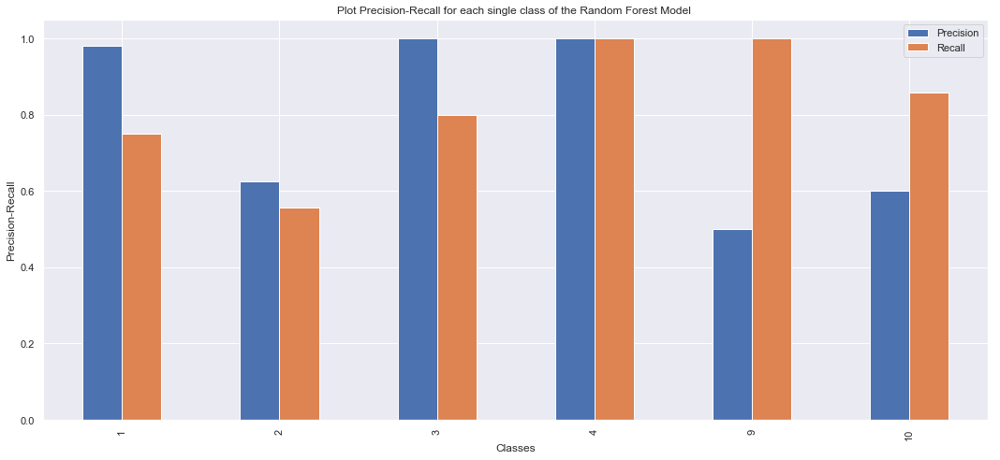

,Precision,Recall
1,0.980769,0.750000
2,0.625000,0.555556
3,1.000000,0.800000
4,1.000000,1.000000
9,0.500000,1.000000
10,0.600000,0.857143


In [68]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_rfe[0][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_rfe[0][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione mediante media

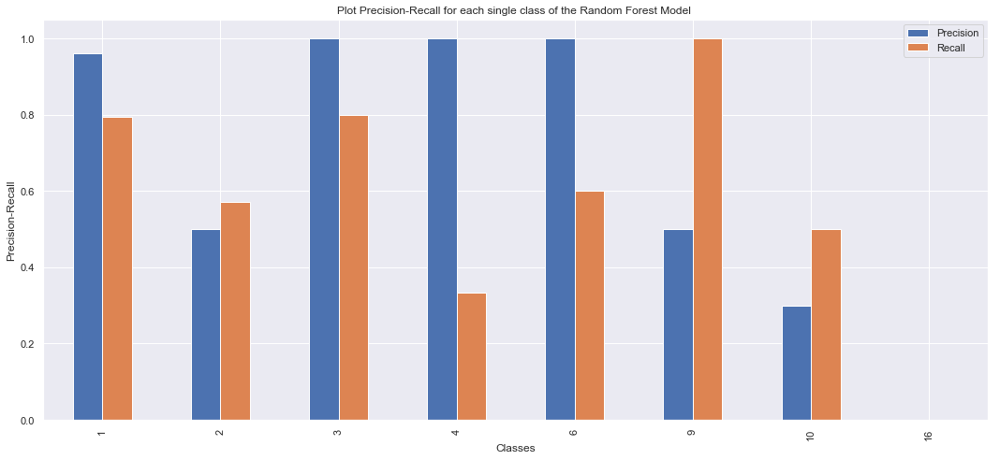

,Precision,Recall
1,0.961538,0.793651
2,0.500000,0.571429
3,1.000000,0.800000
4,1.000000,0.333333
6,1.000000,0.600000
9,0.500000,1.000000
10,0.300000,0.500000
16,0.000000,0.000000


In [69]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_rfe[1][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_rfe[1][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione mediante mediana

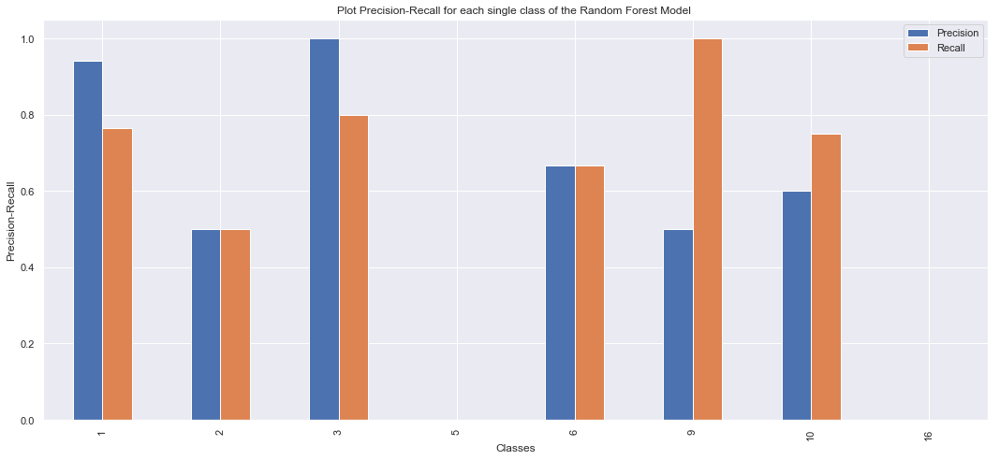

,Precision,Recall
1,0.942308,0.765625
2,0.500000,0.500000
3,1.000000,0.800000
5,0.000000,0.000000
6,0.666667,0.666667
9,0.500000,1.000000
10,0.600000,0.750000
16,0.000000,0.000000


In [70]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_rfe[2][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_rfe[2][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione mediante moda

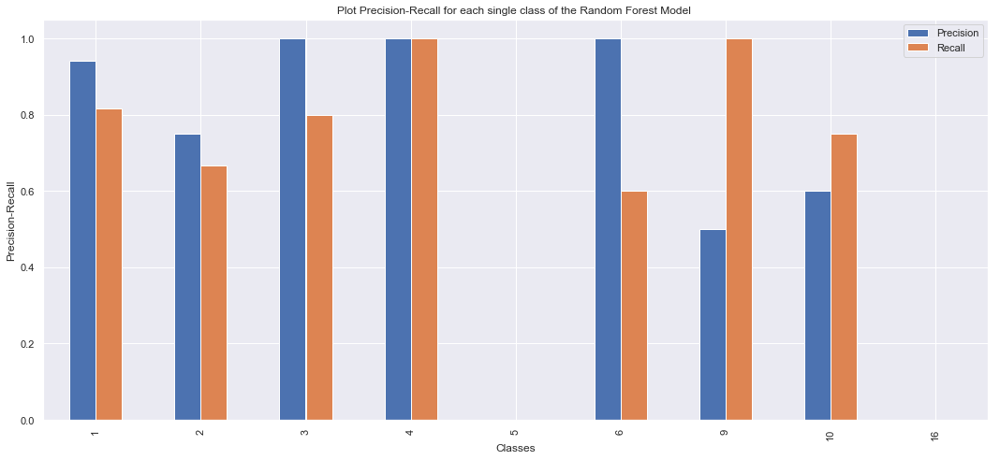

,Precision,Recall
1,0.942308,0.816667
2,0.750000,0.666667
3,1.000000,0.800000
4,1.000000,1.000000
5,0.000000,0.000000
6,1.000000,0.600000
9,0.500000,1.000000
10,0.600000,0.750000
16,0.000000,0.000000


In [71]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_rfe[3][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_rfe[3][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione mediante Regressione Deterministica

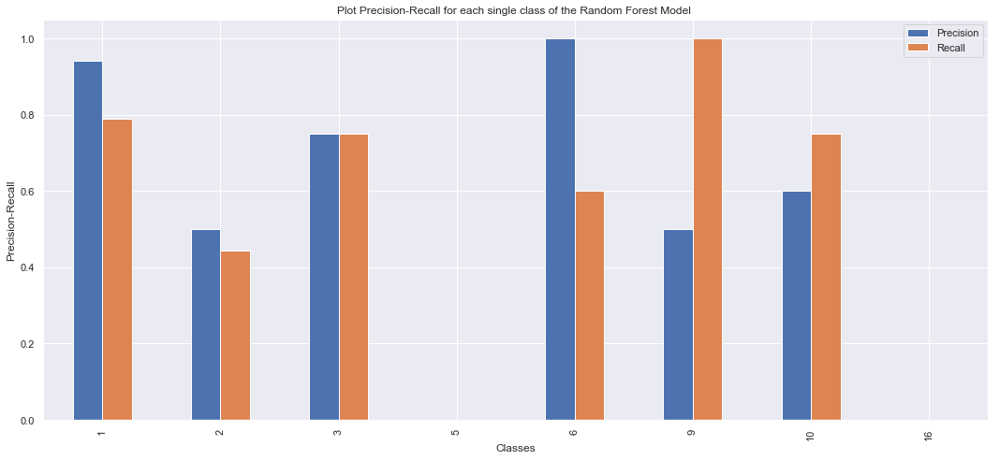

,Precision,Recall
1,0.942308,0.790323
2,0.500000,0.444444
3,0.750000,0.750000
5,0.000000,0.000000
6,1.000000,0.600000
9,0.500000,1.000000
10,0.600000,0.750000
16,0.000000,0.000000


In [72]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_rfe[4][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_rfe[4][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione mediante Regressione Stocastica

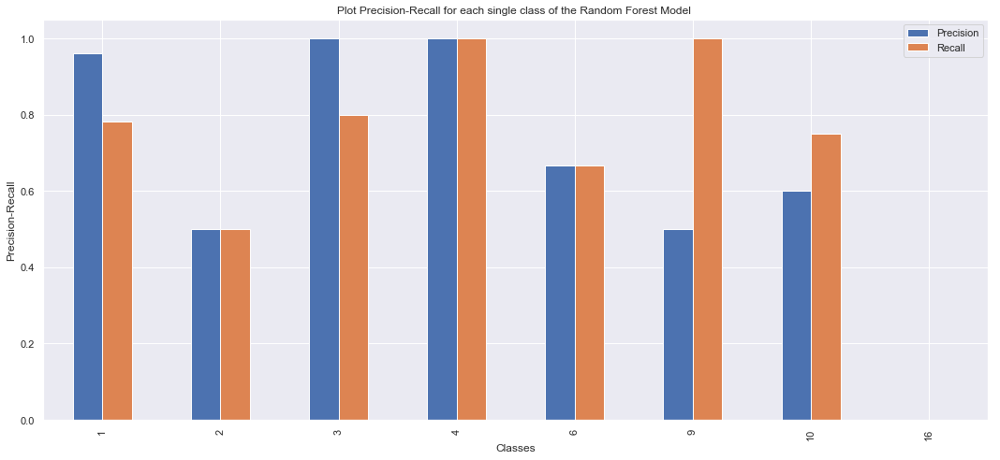

,Precision,Recall
1,0.961538,0.781250
2,0.500000,0.500000
3,1.000000,0.800000
4,1.000000,1.000000
6,0.666667,0.666667
9,0.500000,1.000000
10,0.600000,0.750000
16,0.000000,0.000000


In [73]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_rfe[5][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_rfe[5][3]

<a id="ACRFERF"></a>
<h3>Accuracy, Precision e Recall con RFE per la Feature Selection <a href="#indice" style="text-decoration:none;">↑</a></h3>



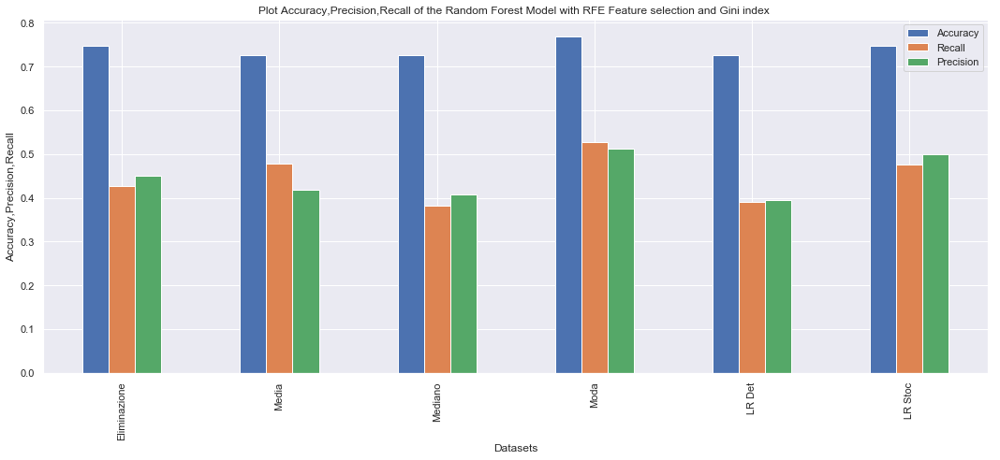

,Accuracy,Recall,Precision
Eliminazione,0.747253,0.427797,0.451154
Media,0.725275,0.478322,0.418038
Mediano,0.725275,0.382634,0.407481
Moda,0.769231,0.526573,0.512121
LR Det,0.725275,0.390210,0.394070
LR Stoc,0.747253,0.475291,0.499811


In [74]:
fig, ax = plt.subplots(figsize=(15,7))
summ_rf_rfe_g.plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracy,Precision,Recall of the Random Forest Model with RFE Feature selection and Gini index ")
ax.set_ylabel('Accuracy,Precision,Recall')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
summ_rf_rfe_g

### Training e Testing di Random Forest utilizzando PCA

In [ ]:
scores_rf_pca,lista_n,confusion_matrix_test_forest_gini_pca,predicted_forest_pca_gini = training_random_forest_pca(Datasets,imputations)

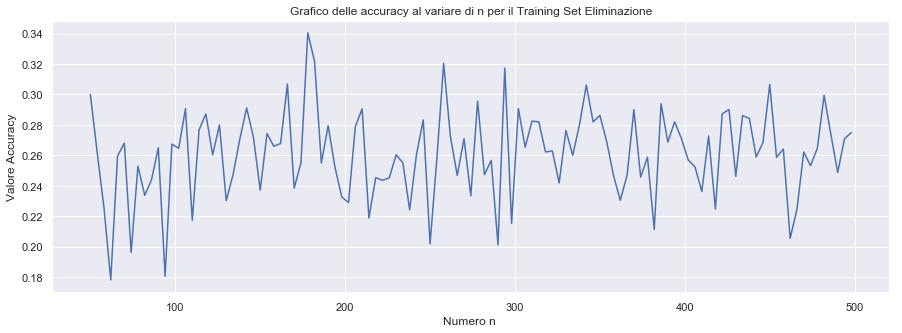

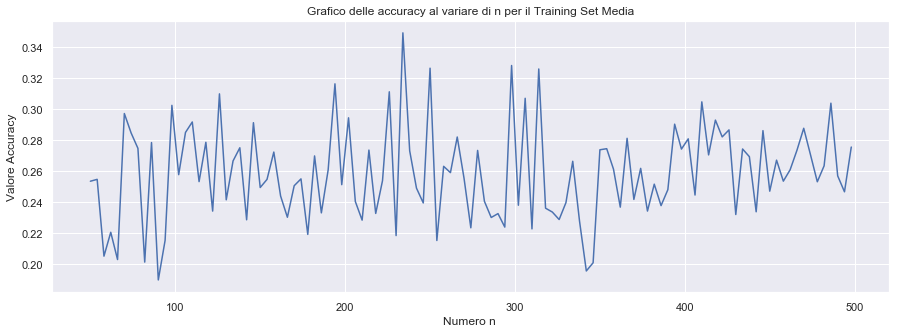

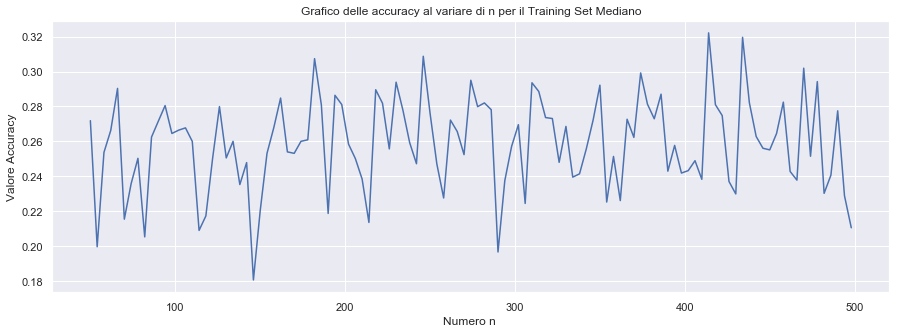

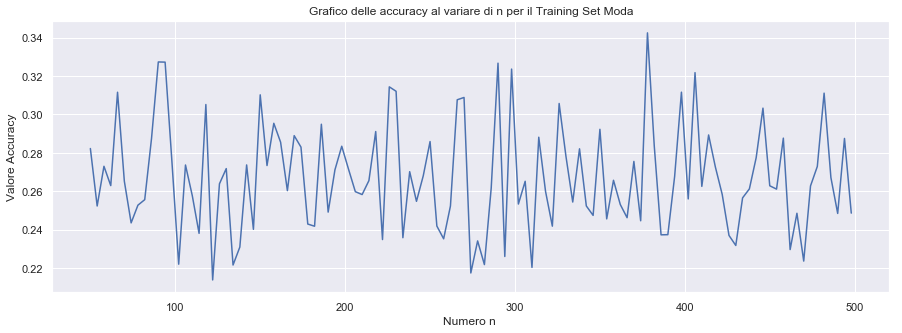

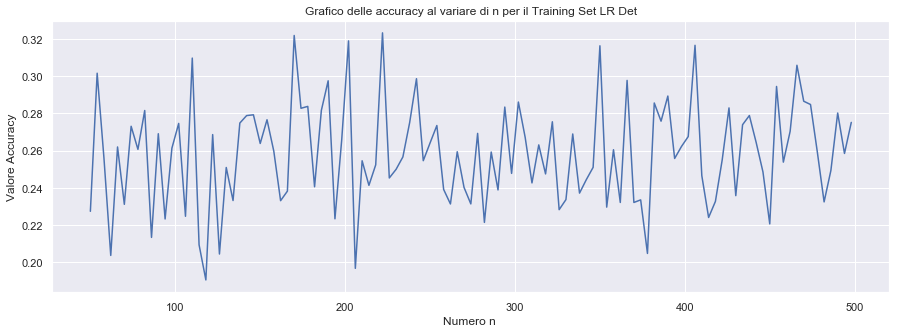

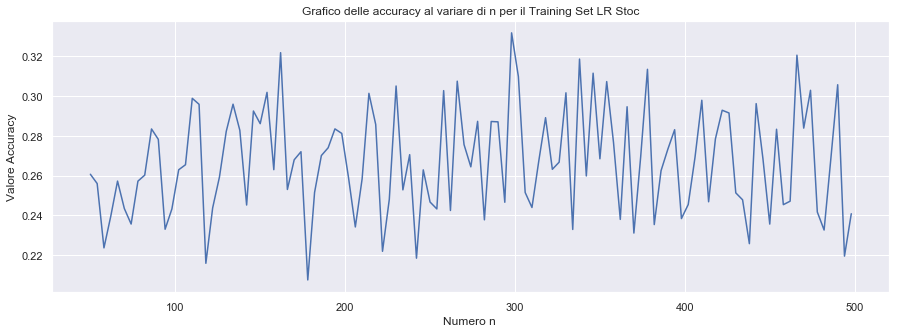

In [113]:
j = 0
for i in lista_n:
    plt.figure(figsize=(15,5))
    plt.plot(i[0], i[1])
    plt.title("Grafico delle accuracy al variare di n per il Training Set "+imputations[j])
    plt.xlabel('Numero n ')
    plt.ylabel('Valore Accuracy')
    plt.show()
    j+=1

In [114]:
acc_pca = []
rec_pca = []
prec_pca = []
summary_rf_accuracy_pca_gini = {}
for i in scores_rf_pca:
    acc_pca.append(i[0])
    rec_pca.append(i[1])
    prec_pca.append(i[2])
    #summary_rf_accuracy_pear_gini[imputations[u]] = [i[0],i[1],i[2]]
summary_rf_accuracy_pca_gini["Accuracy"] = acc_pca
summary_rf_accuracy_pca_gini["Recall"] = prec_pca
summary_rf_accuracy_pca_gini["Precision"] = rec_pca

summ_rf_pca_g = pd.DataFrame(summary_rf_accuracy_pca_gini,index=imputations)


<a id="PCARF"></a>
<h3>Precision e Recall su ogni classe con PCA <a href="#indice" style="text-decoration:none;">↑</a></h3>




### Precision and Recall su ogni singola classe per il dataset con l'eliminazione delle features mancanti

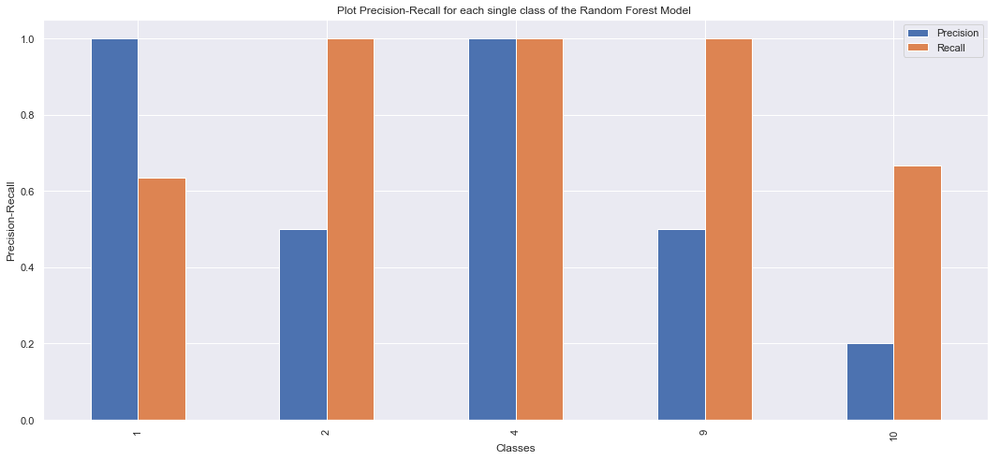

,Precision,Recall
1,1.0,0.634146
2,0.5,1.000000
4,1.0,1.000000
9,0.5,1.000000
10,0.2,0.666667


In [115]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_pca[0][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_pca[0][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione mediante la media

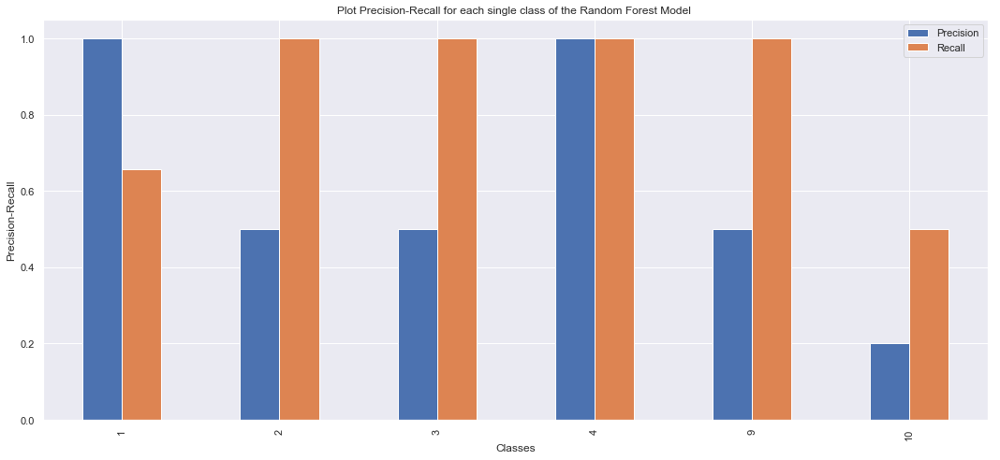

,Precision,Recall
1,1.0,0.658228
2,0.5,1.000000
3,0.5,1.000000
4,1.0,1.000000
9,0.5,1.000000
10,0.2,0.500000


In [116]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_pca[1][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_pca[1][3]


### Precision and Recall su ogni singola classe per il dataset con l'imputazione mediante la mediana

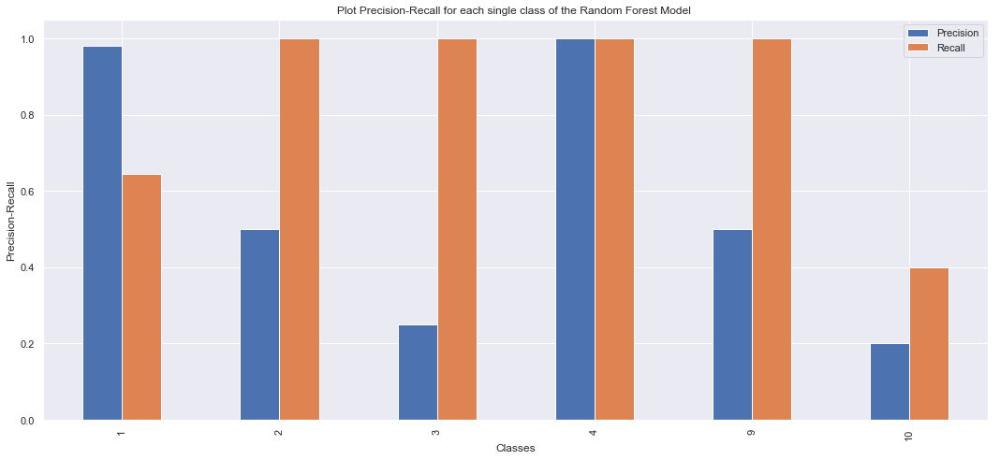

,Precision,Recall
1,0.980769,0.64557
2,0.500000,1.00000
3,0.250000,1.00000
4,1.000000,1.00000
9,0.500000,1.00000
10,0.200000,0.40000


In [117]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_pca[2][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_pca[2][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione mediante la moda

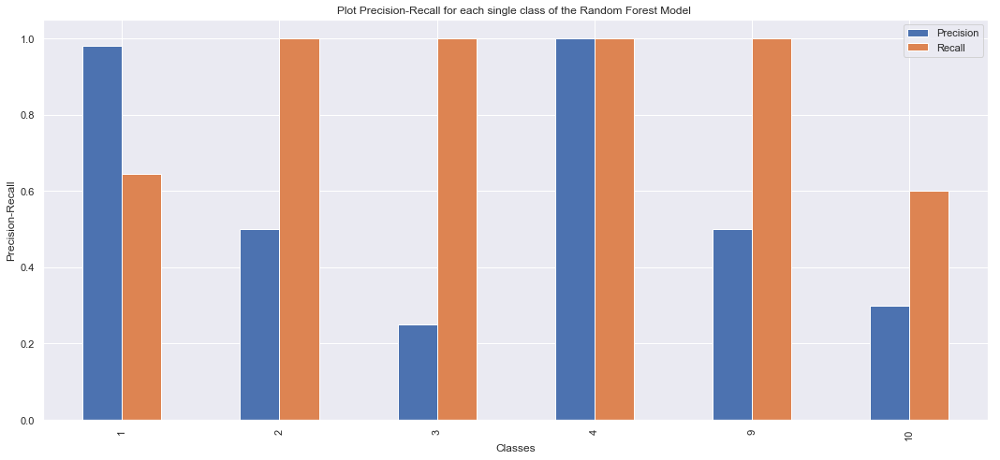

,Precision,Recall
1,1.0,0.658228
2,0.5,1.000000
3,0.5,1.000000
4,1.0,1.000000
9,0.5,1.000000
10,0.3,0.750000


In [118]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_pca[3][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_pca[4][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione mediante Regressione Deterministica

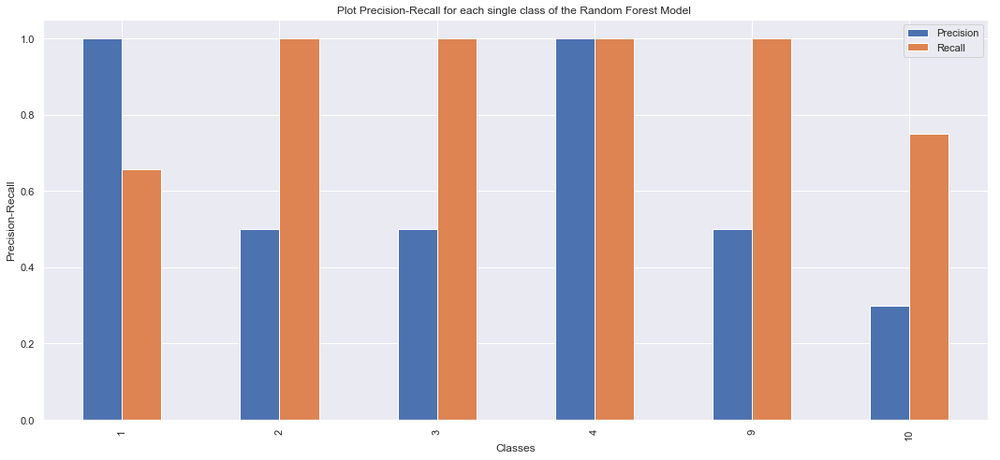

,Precision,Recall
1,1.0,0.658228
2,0.5,1.000000
4,1.0,1.000000
9,0.5,1.000000
10,0.4,0.666667


In [119]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_pca[4][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_pca[5][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione mediante Regressione Stocastica

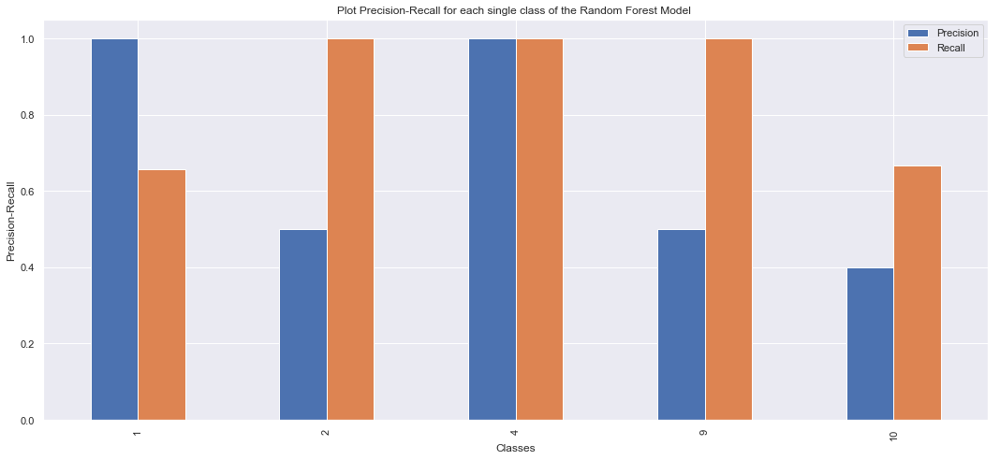

,Precision,Recall
1,1.0,0.658228
2,0.5,1.000000
4,1.0,1.000000
9,0.5,1.000000
10,0.4,0.666667


In [120]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_pca[5][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_pca[5][3]

<a id="ACPCARF"></a>
<h3>Accuracy, Precision e Recall con  PCA <a href="#indice" style="text-decoration:none;">↑</a></h3>


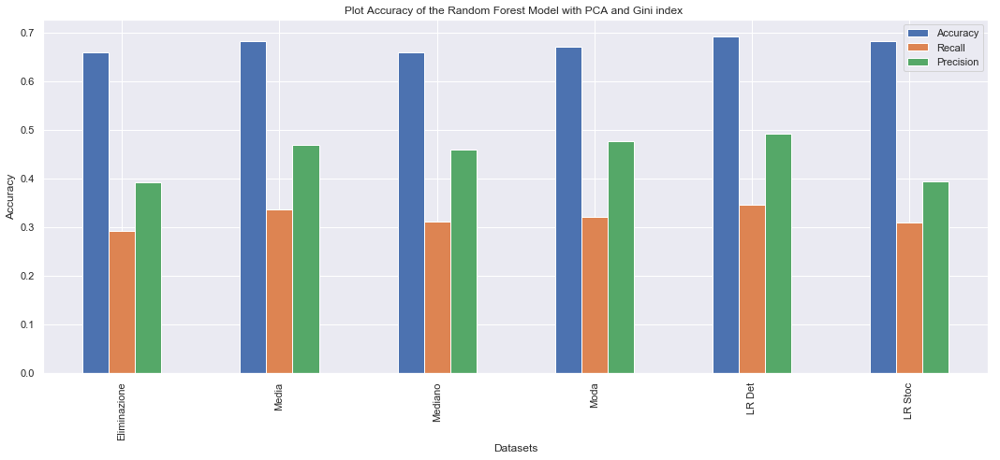

,Accuracy,Recall,Precision
Eliminazione,0.659341,0.290909,0.390983
Media,0.681319,0.336364,0.468930
Mediano,0.659341,0.311888,0.458688
Moda,0.670330,0.320979,0.476870
LR Det,0.692308,0.345455,0.491657
LR Stoc,0.681319,0.309091,0.393172


In [121]:
fig, ax = plt.subplots(figsize=(15,7))
summ_rf_pca_g.plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracy of the Random Forest Model with PCA and Gini index ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
summ_rf_pca_g

## Training e testing di Random Forest senza feature selection o pca

In [ ]:
scores_rf_nofs,lista_n,confusion_matrix_test_forest_gini_nofs,predicted_forest_nofs_gini = training_random_forest_nofs(Datasets,imputations)

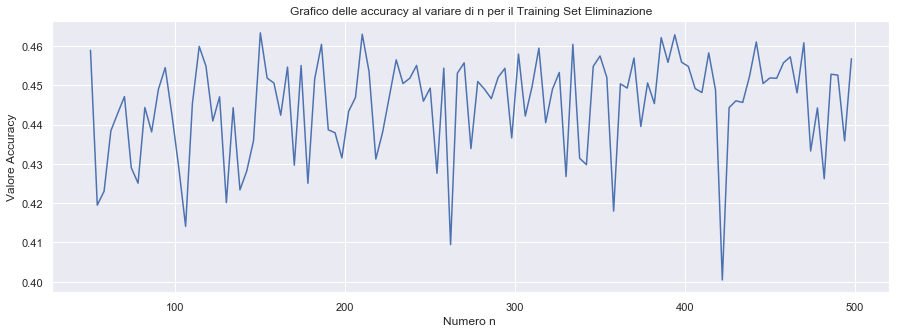

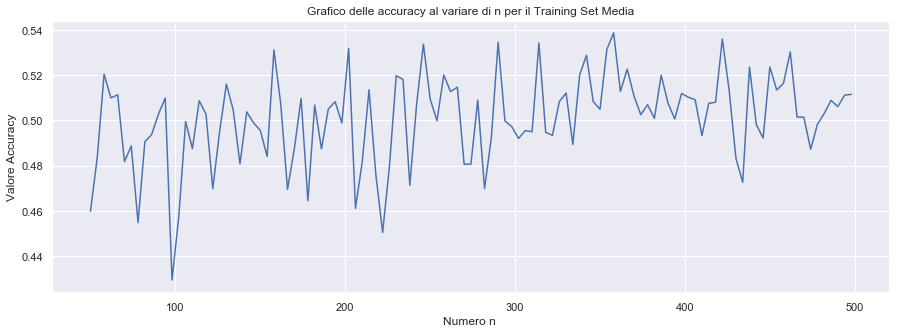

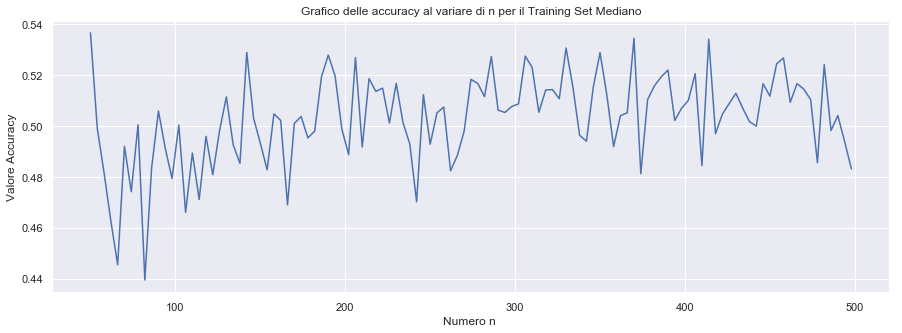

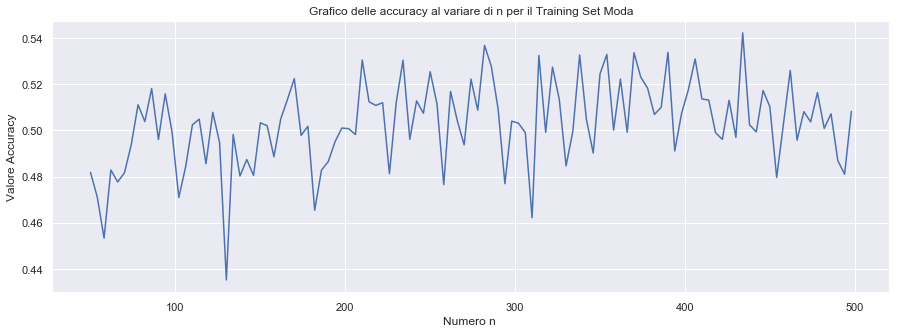

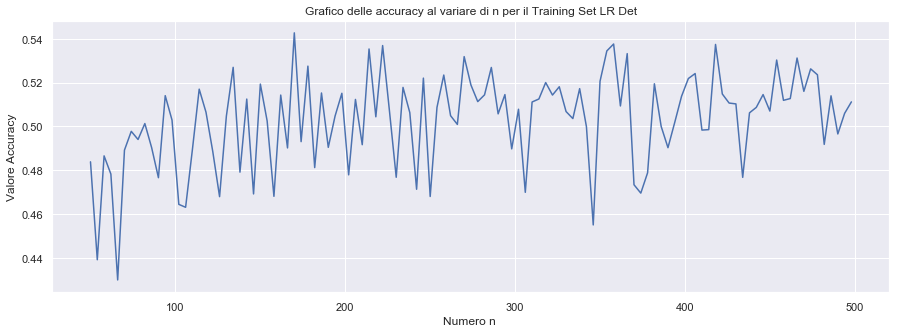

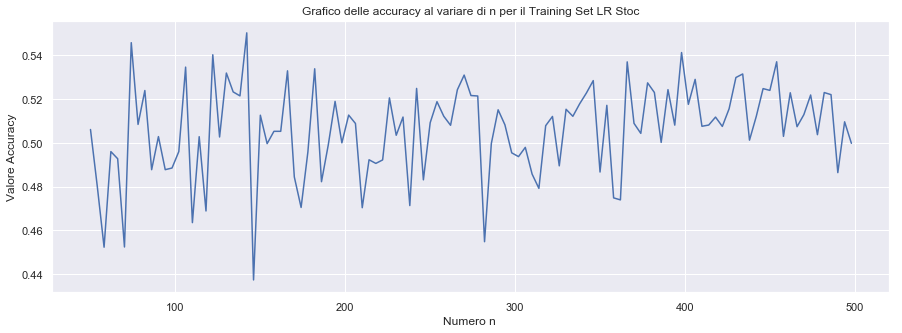

In [111]:
j = 0
for i in lista_n:
    plt.figure(figsize=(15,5))
    plt.plot(i[0], i[1])
    plt.title("Grafico delle accuracy al variare di n per il Training Set "+imputations[j])
    plt.xlabel('Numero n ')
    plt.ylabel('Valore Accuracy')
    plt.show()
    j+=1

In [112]:
acc_nofs = []
rec_nofs = []
prec_nofs = []
summary_rf_accuracy_nofs_gini = {}
for i in scores_rf_nofs:
    acc_nofs.append(i[0])
    rec_nofs.append(i[1])
    prec_nofs.append(i[2])
    #summary_rf_accuracy_pear_gini[imputations[u]] = [i[0],i[1],i[2]]
summary_rf_accuracy_nofs_gini["Accuracy"] = acc_nofs
summary_rf_accuracy_nofs_gini["Recall"] = prec_nofs
summary_rf_accuracy_nofs_gini["Precision"] = rec_nofs

summ_rf_nofs_g = pd.DataFrame(summary_rf_accuracy_nofs_gini,index=imputations)


<a id="NOFSRF"></a>
<h3>Precision e Recall su ogni singola classe senza Feature Selection o PCA <a href="#indice" style="text-decoration:none;">↑</a></h3>



### Precision and Recall su ogni singola classe per il dataset con l'eliminazione delle features mancanti

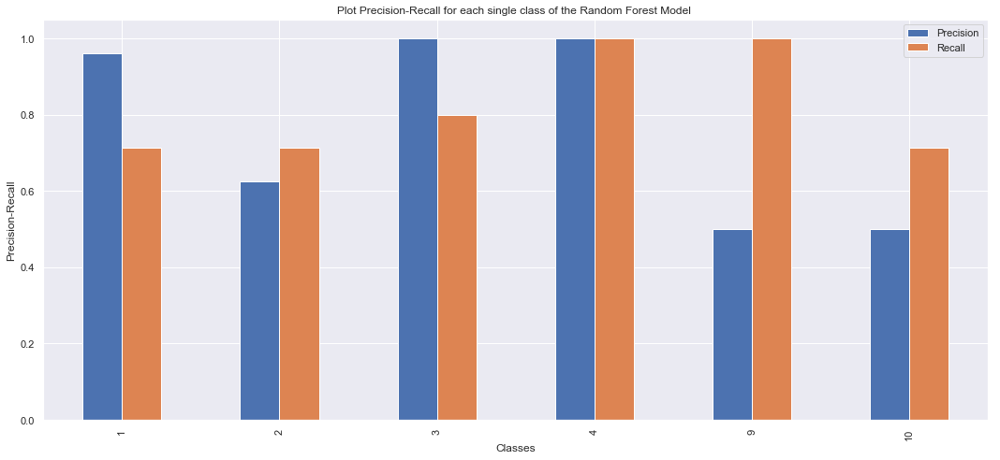

,Precision,Recall
1,0.961538,0.714286
2,0.625000,0.714286
3,1.000000,0.800000
4,1.000000,1.000000
9,0.500000,1.000000
10,0.500000,0.714286


In [113]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_nofs[0][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_nofs[0][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione del valor medio

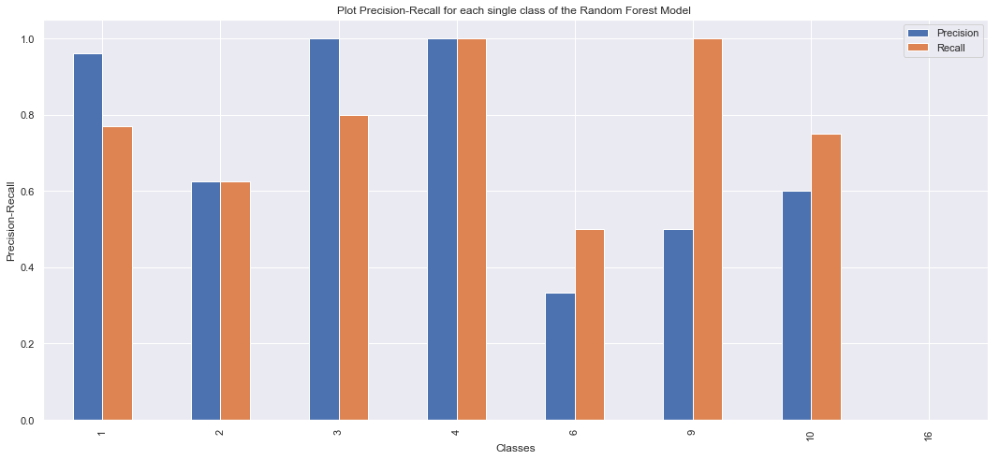

,Precision,Recall
1,0.961538,0.769231
2,0.625000,0.625000
3,1.000000,0.800000
4,1.000000,1.000000
6,0.333333,0.500000
9,0.500000,1.000000
10,0.600000,0.750000
16,0.000000,0.000000


In [114]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_nofs[1][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_nofs[1][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione del mediano

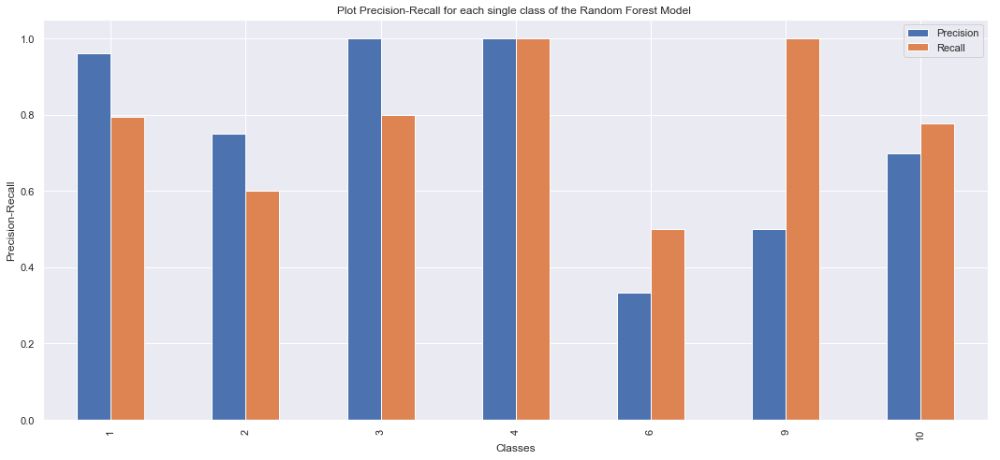

,Precision,Recall
1,0.961538,0.793651
2,0.750000,0.600000
3,1.000000,0.800000
4,1.000000,1.000000
6,0.333333,0.500000
9,0.500000,1.000000
10,0.700000,0.777778


In [115]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_nofs[2][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_nofs[2][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione della moda

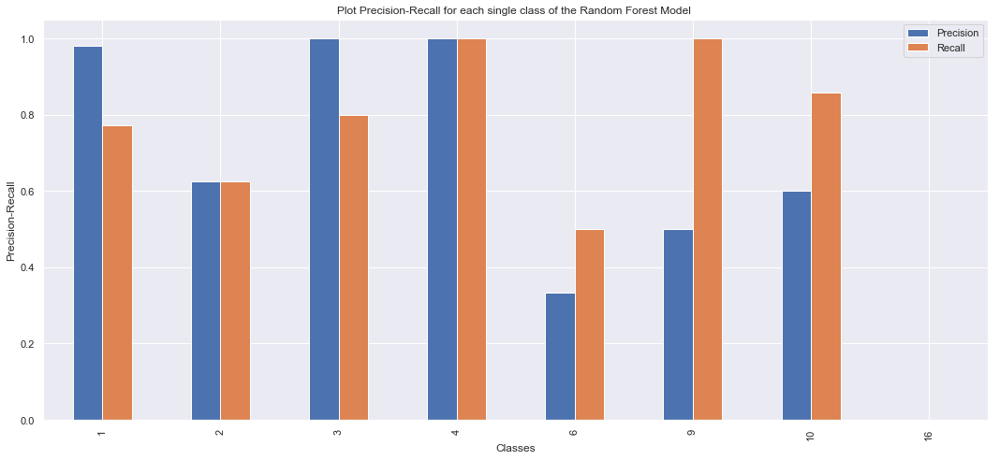

,Precision,Recall
1,0.980769,0.772727
2,0.625000,0.625000
3,1.000000,0.800000
4,1.000000,1.000000
6,0.333333,0.500000
9,0.500000,1.000000
10,0.600000,0.857143
16,0.000000,0.000000


In [116]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_nofs[3][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_nofs[3][3]

### Precision and Recall su ogni singola classe per il dataset con l'imputazione con Regressione Deterministica

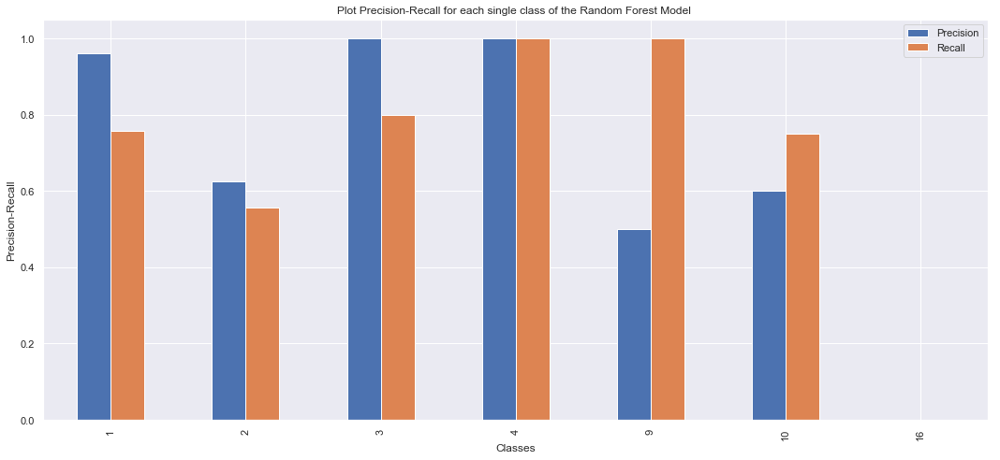

,Precision,Recall
1,0.961538,0.757576
2,0.625000,0.555556
3,1.000000,0.800000
4,1.000000,1.000000
9,0.500000,1.000000
10,0.600000,0.750000
16,0.000000,0.000000


In [117]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_nofs[4][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_nofs[4][3]

### Precision and Recall su ogni singola classe per il dataset con imputazione con Regressione Stocastica

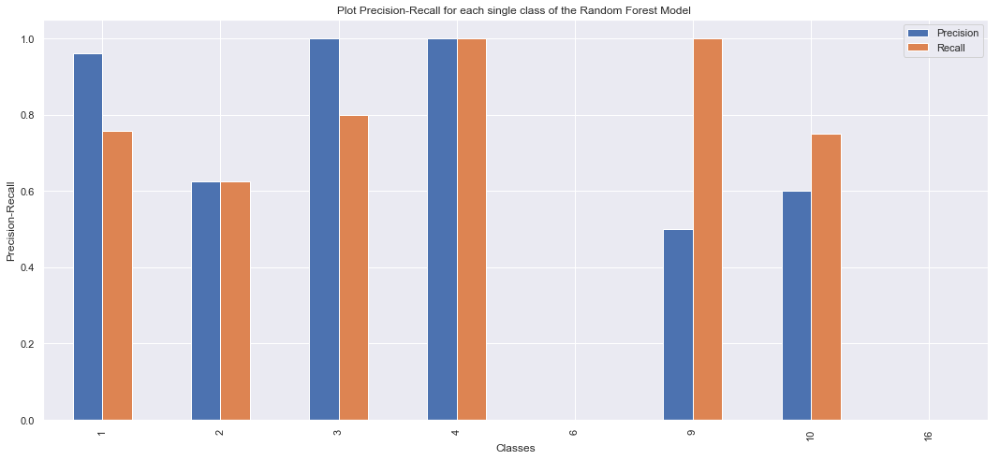

,Precision,Recall
1,0.961538,0.757576
2,0.625000,0.625000
3,1.000000,0.800000
4,1.000000,1.000000
6,0.000000,0.000000
9,0.500000,1.000000
10,0.600000,0.750000
16,0.000000,0.000000


In [118]:
fig, ax = plt.subplots(figsize=(15,7))
scores_rf_nofs[5][3].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision-Recall for each single class of the Random Forest Model ")
ax.set_ylabel('Precision-Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
scores_rf_nofs[5][3]


<a id="NOFSACCRF"></a>
<h3>Accuracy, Precision e Recall senza Feature Selection o PCA <a href="#indice" style="text-decoration:none;">↑</a></h3>



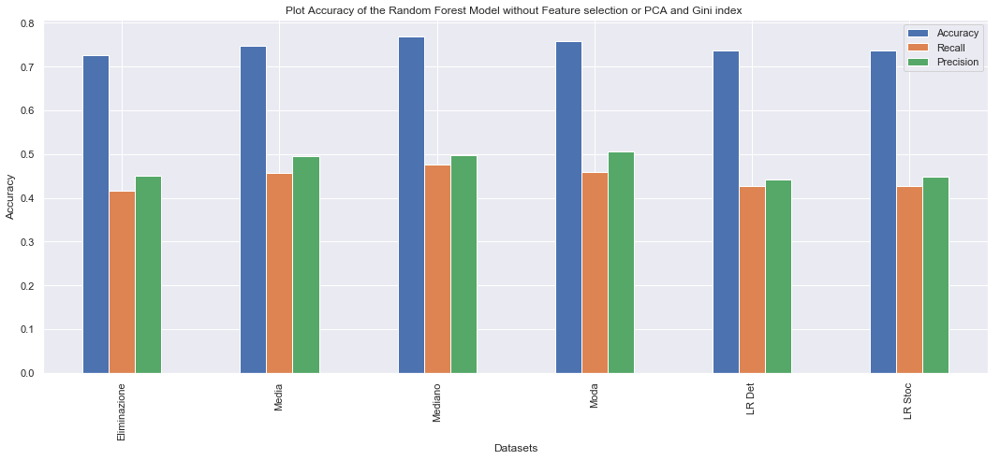

,Accuracy,Recall,Precision
Eliminazione,0.725275,0.416958,0.449351
Media,0.747253,0.456352,0.494930
Mediano,0.769231,0.476807,0.497403
Moda,0.758242,0.458100,0.504988
LR Det,0.736264,0.426049,0.442103
LR Stoc,0.736264,0.426049,0.448416


In [119]:
fig, ax = plt.subplots(figsize=(15,7))
summ_rf_nofs_g.plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracy of the Random Forest Model without Feature selection or PCA and Gini index ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
summ_rf_nofs_g

<a id="SUMMARYRF"></a>
<h3> Confronto tra le performance dei diversi approcci utilizzati in questa sezione <a href="#indice" style="text-decoration:none;">↑</a></h3>




In [120]:
comparison_df ={}
comparison_df["Acc_pear"] = summ_rf_pear_g['Accuracy']
comparison_df["Acc_rfe"] = summ_rf_rfe_g['Accuracy']
comparison_df["Acc_pca"] = summ_rf_pca_g['Accuracy']
comparison_df["Acc_nofs"] = summ_rf_nofs_g['Accuracy']
comparison_df["Rec_pear"] = summ_rf_pear_g['Precision']
comparison_df["Rec_rfe"] = summ_rf_rfe_g['Precision']
comparison_df["Rec_pca"] = summ_rf_pca_g['Precision']
comparison_df["Rec_nofs"] = summ_rf_nofs_g['Precision']
comparison_df["Prec_pear"] = summ_rf_pear_g['Recall']
comparison_df["Prec_rfe"] = summ_rf_rfe_g['Recall']
comparison_df["Prec_pca"] = summ_rf_pca_g['Recall']
comparison_df["Prec_nofs"] = summ_rf_nofs_g['Recall']


summary_final = pd.DataFrame(comparison_df,index=imputations)




## Plotting riassuntivo delle Precision

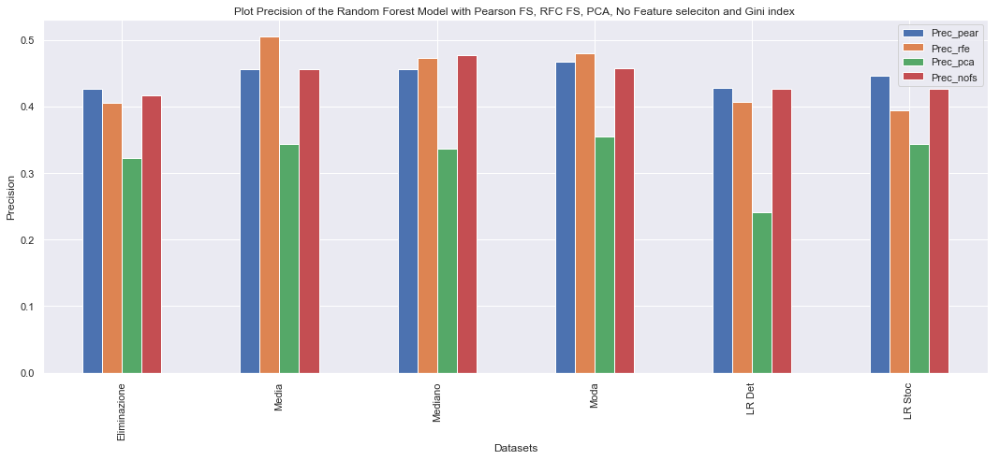

In [121]:
fig, ax = plt.subplots(figsize=(15,7))
summary_final[['Prec_pear','Prec_rfe','Prec_pca',"Prec_nofs"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision of the Random Forest Model with Pearson FS, RFC FS, PCA, No Feature seleciton and Gini index ")
ax.set_ylabel('Precision')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
#summary_final

## Plotting riassuntivo delle Recall

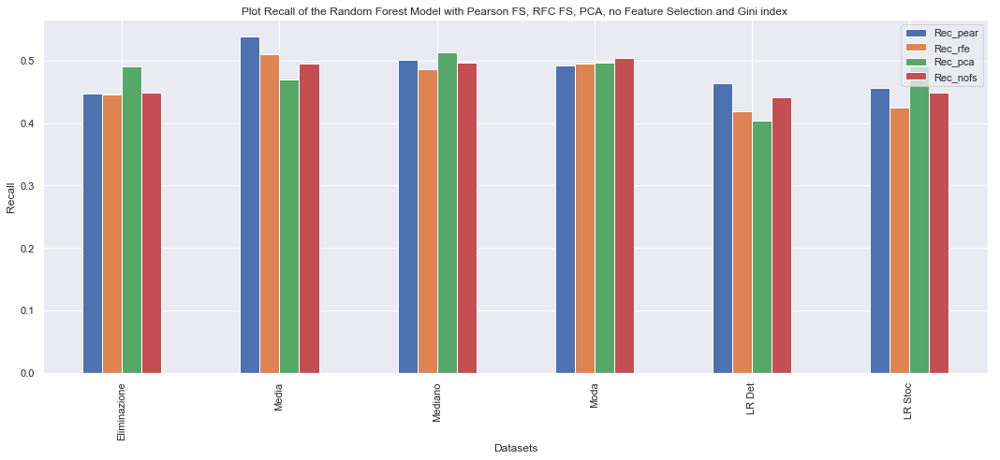

In [122]:
fig, ax = plt.subplots(figsize=(15,7))
summary_final[['Rec_pear','Rec_rfe','Rec_pca',"Rec_nofs"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Recall of the Random Forest Model with Pearson FS, RFC FS, PCA, no Feature Selection and Gini index ")
ax.set_ylabel('Recall')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
#summary_final

## Plotting riassuntivo delle Accuracy

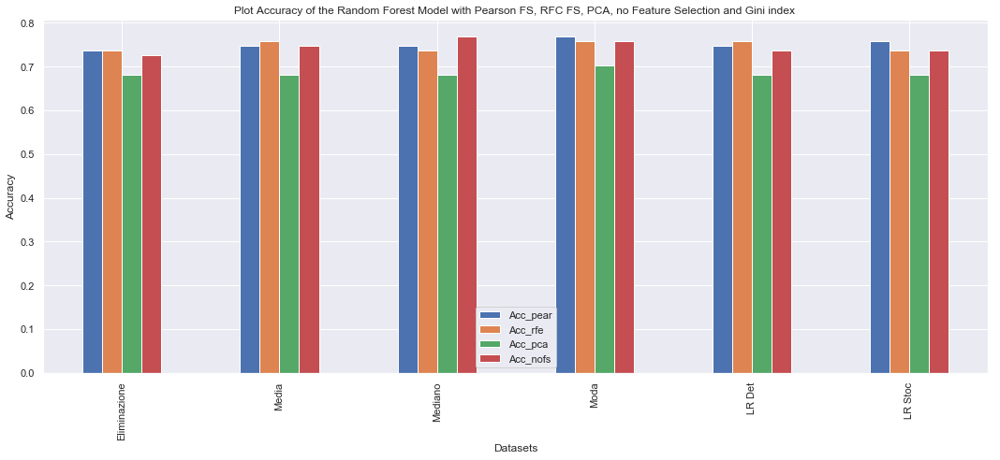

In [123]:
fig, ax = plt.subplots(figsize=(15,7))
summary_final[['Acc_pear','Acc_rfe','Acc_pca',"Acc_nofs"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracy of the Random Forest Model with Pearson FS, RFC FS, PCA, no Feature Selection and Gini index ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()


<a id="BOOST"></a>
<h3>Algoritmi di Boosting <a href="#indice" style="text-decoration:none;">↑</a></h3>



Andremo ad utilizzare Adaptive Boosting, Gradient Boosting ed Extreeme Gradient Boosting

In [178]:
from sklearn.ensemble import AdaBoostClassifier,GradientBoostingClassifier,ExtraTreesClassifier
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score,precision_score,recall_score

In [185]:
def Pearson_FS(dataset):
    dataset_df = pd.DataFrame(dataset)
    corr = dataset_df.corr()
    columns = np.full((corr.shape[0],), True, dtype=bool)
    for i in range(corr.shape[0]):
        for j in range(i+1, corr.shape[0]):
            if corr.iloc[i,j] >= 0.9:
                if columns[j]:
                    columns[j] = False
    j = 0
    indexes = []
    for i in columns:
        if i == True:
            indexes.append(j)
        j+=1
    return(indexes)

def RFE_FS(X_train,y_trains,nfeatures):
   
    model = RandomForestClassifier()
    #rforest = RandomForestClassifier(random_state=101)
    rfe = RFE(estimator = model,n_features_to_select  = nfeatures)
    rfe.fit(X_train,y_trains)

    support = rfe.support_ 

    j = 0
    indexes = []
    for i in support:
        if i == True:
            indexes.append(j)
        j+=1
    return(indexes)

def get_PCA(X_train,X_test):
    components = .95
    #components = "mle"
    pca =  PCA(n_components = components)
    pca.fit(X_train)
    X_train_pca = pca.transform(X_train)
    X_test_pca = pca.transform(X_test)
    return(X_train_pca,X_test_pca)

<a id="BOOSTNOFS"></a>
<h3>Boosting senza Feature Selection <a href="#indice" style="text-decoration:none;">↑</a></h3>


In [ ]:
scores_ada_nofs,scores_gb_nofs,scores_et_nofs,scores_xgb_nofs = training_testing_boosting_algorithms_no_FS(Datasets,imputations)

In [133]:
ensemble_nofs_df = pd.DataFrame()

In [134]:

ensemble_nofs_df['Acc_ADA'] =  [scores_ada_nofs[0][0]] + [scores_ada_nofs[1][0]]+[scores_ada_nofs[2][0]]+[scores_ada_nofs[3][0]]+[scores_ada_nofs[4][0]]+[scores_ada_nofs[5][0]]
ensemble_nofs_df['Rec_ADA'] =  [scores_ada_nofs[0][1]] + [scores_ada_nofs[1][1]]+[scores_ada_nofs[2][1]]+[scores_ada_nofs[3][1]]+[scores_ada_nofs[4][1]]+[scores_ada_nofs[5][1]]
ensemble_nofs_df['Prec_ADA'] =  [scores_ada_nofs[0][2]] + [scores_ada_nofs[1][2]]+[scores_ada_nofs[2][2]]+[scores_ada_nofs[3][2]]+[scores_ada_nofs[4][2]]+[scores_ada_nofs[5][2]]


ensemble_nofs_df['Acc_GB'] =  [scores_gb_nofs[0][0]] + [scores_gb_nofs[1][0]]+[scores_gb_nofs[2][0]]+[scores_gb_nofs[3][0]]+[scores_gb_nofs[4][0]]+[scores_gb_nofs[5][0]]
ensemble_nofs_df['Rec_GB'] =  [scores_gb_nofs[0][1]] + [scores_gb_nofs[1][1]]+[scores_gb_nofs[2][1]]+[scores_gb_nofs[3][1]]+[scores_gb_nofs[4][1]]+[scores_gb_nofs[5][1]]
ensemble_nofs_df['Prec_GB'] =  [scores_gb_nofs[0][2]] + [scores_gb_nofs[1][2]]+[scores_gb_nofs[2][2]]+[scores_gb_nofs[3][2]]+[scores_gb_nofs[4][2]]+[scores_gb_nofs[5][2]]

ensemble_nofs_df['Acc_ET'] =  [scores_et_nofs[0][0]] + [scores_et_nofs[1][0]]+[scores_et_nofs[2][0]]+[scores_et_nofs[3][0]]+[scores_et_nofs[4][0]]+[scores_et_nofs[5][0]]
ensemble_nofs_df['Rec_ET'] =  [scores_et_nofs[0][1]] + [scores_et_nofs[1][1]]+[scores_et_nofs[2][1]]+[scores_et_nofs[3][1]]+[scores_et_nofs[4][1]]+[scores_et_nofs[5][1]]
ensemble_nofs_df['Prec_ET'] =  [scores_et_nofs[0][2]] + [scores_et_nofs[1][2]]+[scores_et_nofs[2][2]]+[scores_et_nofs[3][2]]+[scores_et_nofs[4][2]]+[scores_et_nofs[5][2]]

ensemble_nofs_df['Acc_XGB'] =  [scores_xgb_nofs[0][0]] + [scores_xgb_nofs[1][0]]+[scores_xgb_nofs[2][0]]+[scores_xgb_nofs[3][0]]+[scores_xgb_nofs[4][0]]+[scores_xgb_nofs[5][0]]
ensemble_nofs_df['Rec_XGB'] =  [scores_xgb_nofs[0][1]] + [scores_xgb_nofs[1][1]]+[scores_xgb_nofs[2][1]]+[scores_xgb_nofs[3][1]]+[scores_xgb_nofs[4][1]]+[scores_xgb_nofs[5][1]]
ensemble_nofs_df['Prec_XGB'] =  [scores_xgb_nofs[0][2]] + [scores_xgb_nofs[1][2]]+[scores_xgb_nofs[2][2]]+[scores_xgb_nofs[3][2]]+[scores_xgb_nofs[4][2]]+[scores_xgb_nofs[5][2]]

In [135]:

ensemble_nofs_df = ensemble_nofs_df.set_index([imputations])

### Precision and Recall su ogni singola classe per il dataset con l'eliminazione delle features mancanti

### ADA Boost

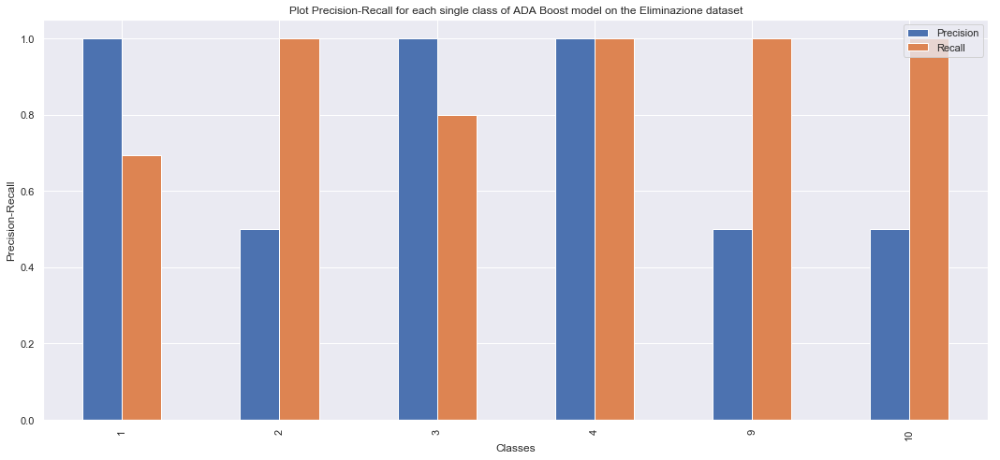

    Precision    Recall
1         1.0  0.693333
2         0.5  1.000000
3         1.0  0.800000
4         1.0  1.000000
9         0.5  1.000000
10        0.5  1.000000


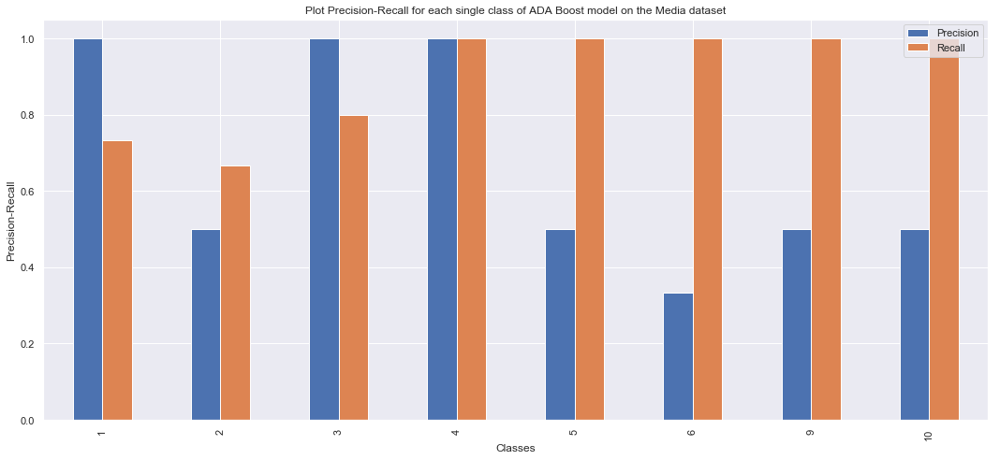

    Precision    Recall
1    1.000000  0.732394
2    0.500000  0.666667
3    1.000000  0.800000
4    1.000000  1.000000
5    0.500000  1.000000
6    0.333333  1.000000
9    0.500000  1.000000
10   0.500000  1.000000


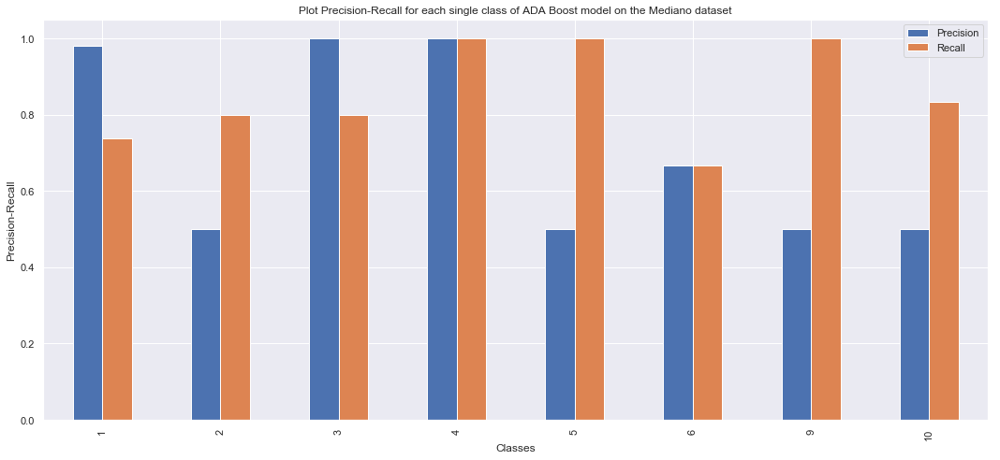

    Precision    Recall
1    0.980769  0.739130
2    0.500000  0.800000
3    1.000000  0.800000
4    1.000000  1.000000
5    0.500000  1.000000
6    0.666667  0.666667
9    0.500000  1.000000
10   0.500000  0.833333


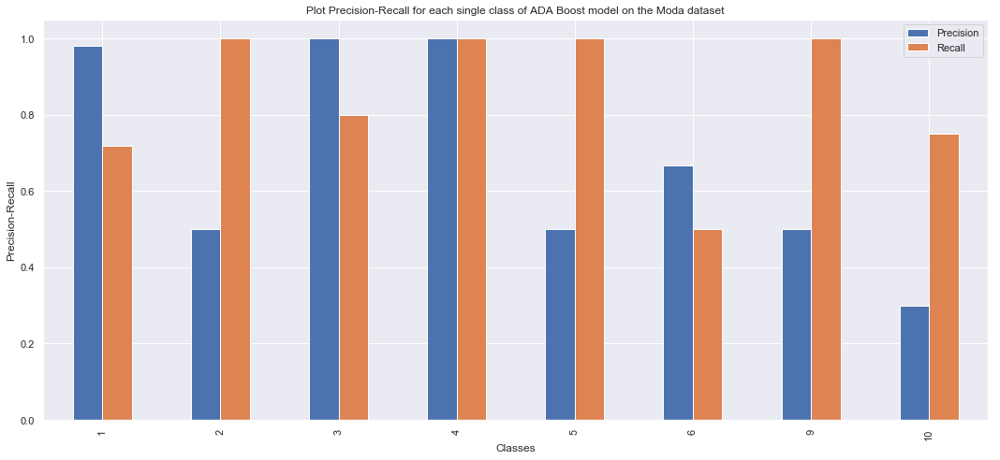

    Precision   Recall
1    0.980769  0.71831
2    0.500000  1.00000
3    1.000000  0.80000
4    1.000000  1.00000
5    0.500000  1.00000
6    0.666667  0.50000
9    0.500000  1.00000
10   0.300000  0.75000


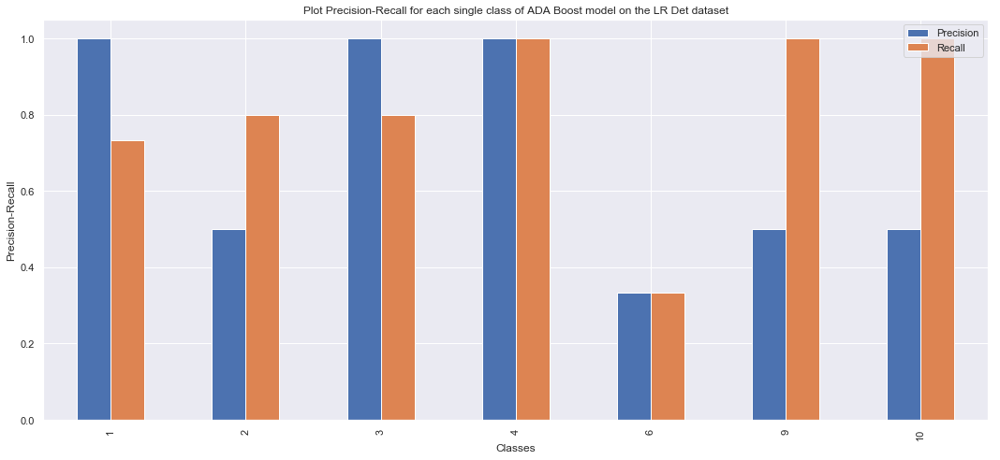

    Precision    Recall
1    1.000000  0.732394
2    0.500000  0.800000
3    1.000000  0.800000
4    1.000000  1.000000
6    0.333333  0.333333
9    0.500000  1.000000
10   0.500000  1.000000


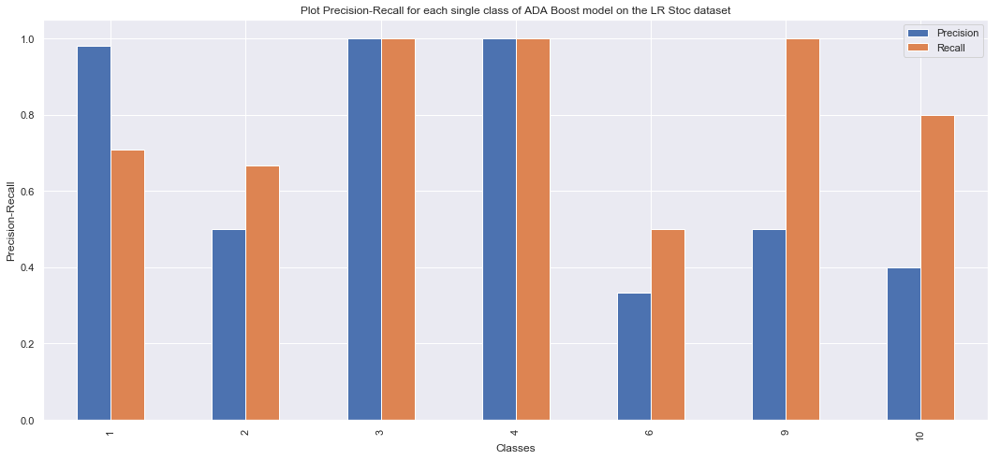

    Precision    Recall
1    0.980769  0.708333
2    0.500000  0.666667
3    1.000000  1.000000
4    1.000000  1.000000
6    0.333333  0.500000
9    0.500000  1.000000
10   0.400000  0.800000


In [136]:
j=0
for i in scores_ada_nofs:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of ADA Boost model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

### Gradient Boosting

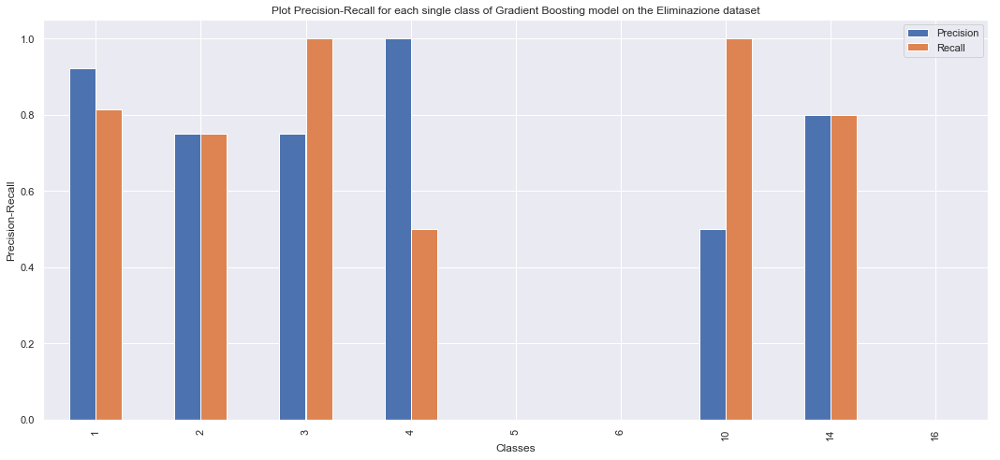

    Precision    Recall
1    0.923077  0.813559
2    0.750000  0.750000
3    0.750000  1.000000
4    1.000000  0.500000
5    0.000000  0.000000
6    0.000000  0.000000
10   0.500000  1.000000
14   0.800000  0.800000
16   0.000000  0.000000


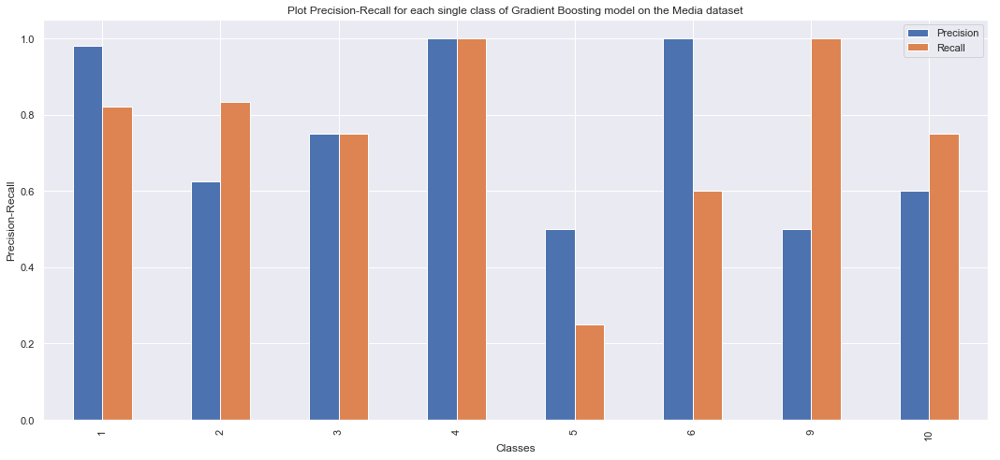

    Precision    Recall
1    0.980769  0.822581
2    0.625000  0.833333
3    0.750000  0.750000
4    1.000000  1.000000
5    0.500000  0.250000
6    1.000000  0.600000
9    0.500000  1.000000
10   0.600000  0.750000


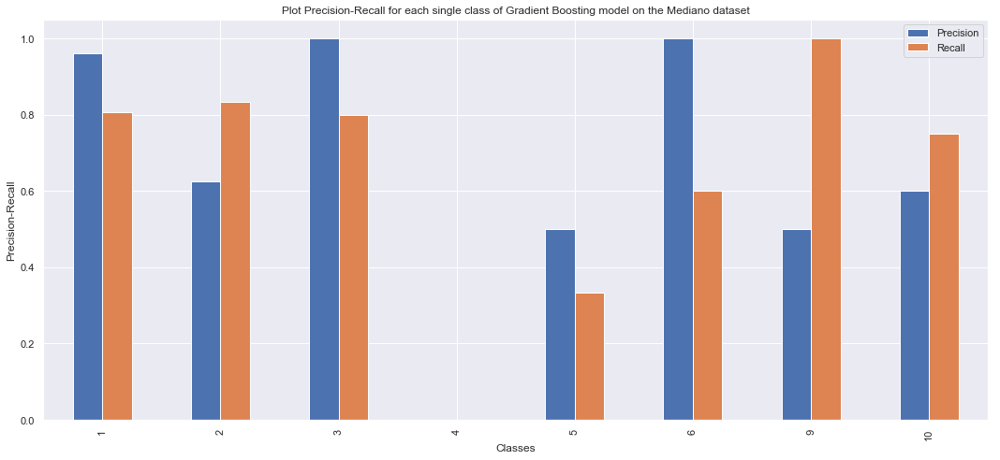

    Precision    Recall
1    0.961538  0.806452
2    0.625000  0.833333
3    1.000000  0.800000
4    0.000000  0.000000
5    0.500000  0.333333
6    1.000000  0.600000
9    0.500000  1.000000
10   0.600000  0.750000


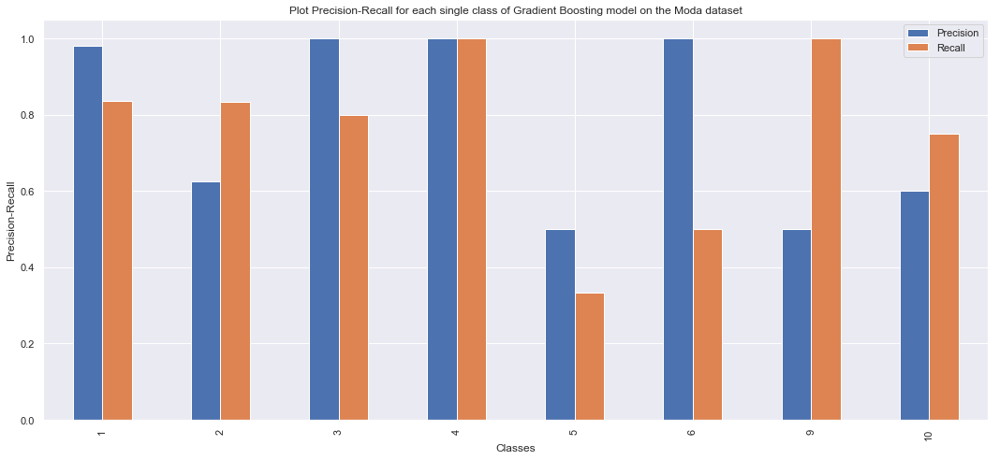

    Precision    Recall
1    0.980769  0.836066
2    0.625000  0.833333
3    1.000000  0.800000
4    1.000000  1.000000
5    0.500000  0.333333
6    1.000000  0.500000
9    0.500000  1.000000
10   0.600000  0.750000


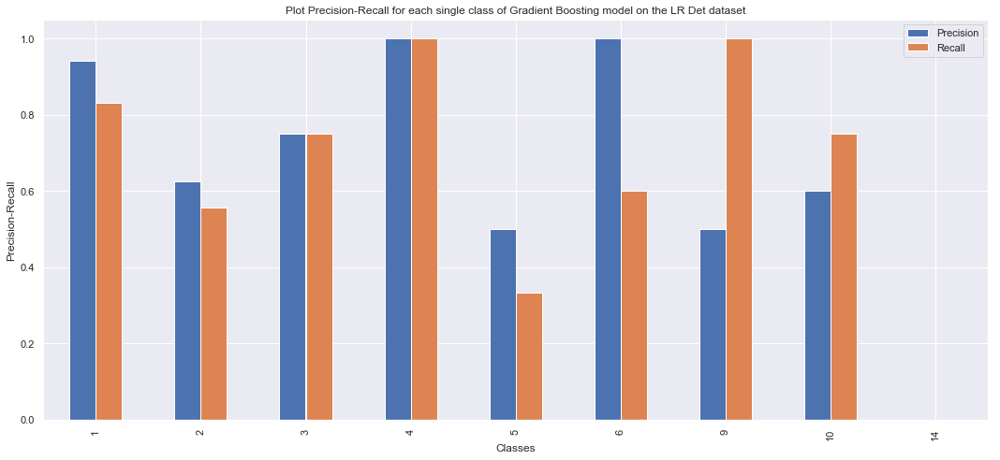

    Precision    Recall
1    0.942308  0.830508
2    0.625000  0.555556
3    0.750000  0.750000
4    1.000000  1.000000
5    0.500000  0.333333
6    1.000000  0.600000
9    0.500000  1.000000
10   0.600000  0.750000
14   0.000000  0.000000


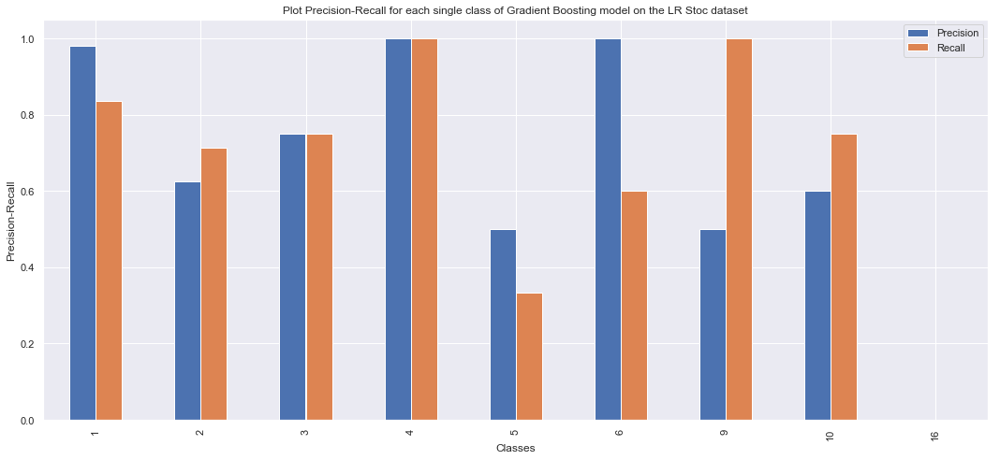

    Precision    Recall
1    0.980769  0.836066
2    0.625000  0.714286
3    0.750000  0.750000
4    1.000000  1.000000
5    0.500000  0.333333
6    1.000000  0.600000
9    0.500000  1.000000
10   0.600000  0.750000
16   0.000000  0.000000


In [137]:
j=0
for i in scores_gb_nofs:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of Gradient Boosting model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

### Extra Tree

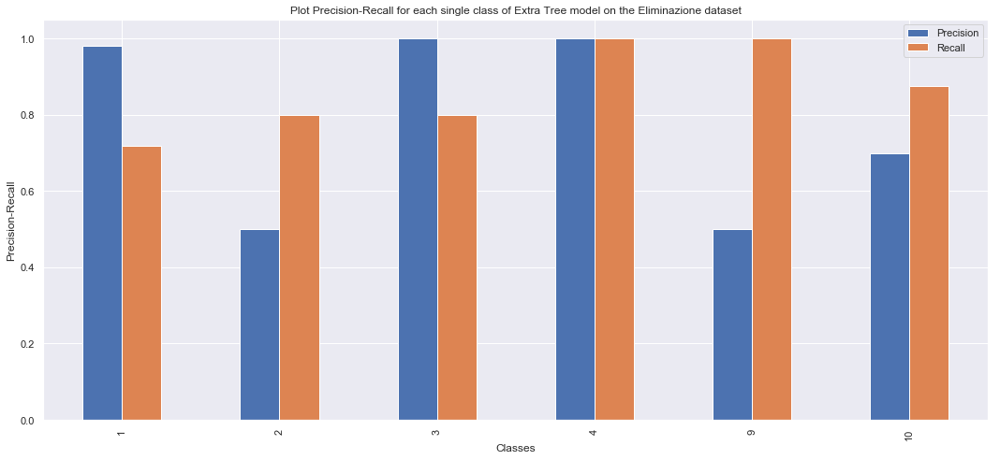

    Precision   Recall
1    0.980769  0.71831
2    0.500000  0.80000
3    1.000000  0.80000
4    1.000000  1.00000
9    0.500000  1.00000
10   0.700000  0.87500


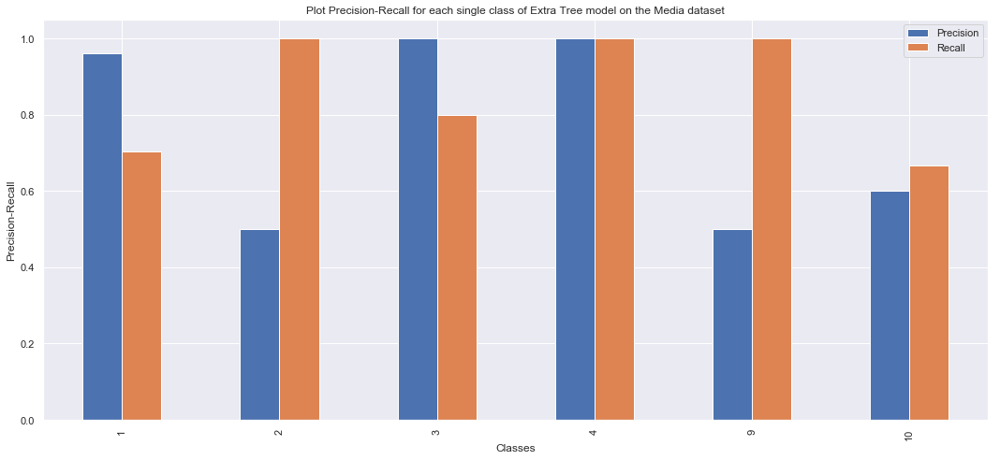

    Precision    Recall
1    0.961538  0.704225
2    0.500000  1.000000
3    1.000000  0.800000
4    1.000000  1.000000
9    0.500000  1.000000
10   0.600000  0.666667


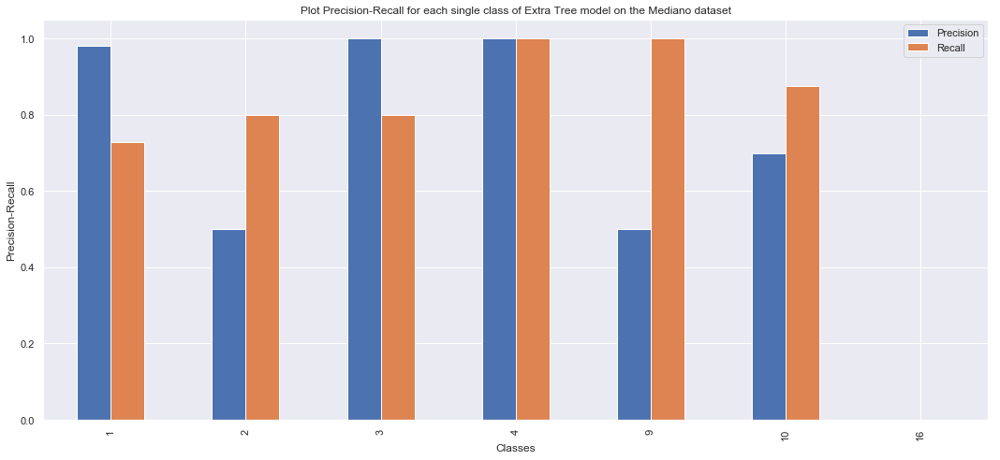

    Precision    Recall
1    0.980769  0.728571
2    0.500000  0.800000
3    1.000000  0.800000
4    1.000000  1.000000
9    0.500000  1.000000
10   0.700000  0.875000
16   0.000000  0.000000


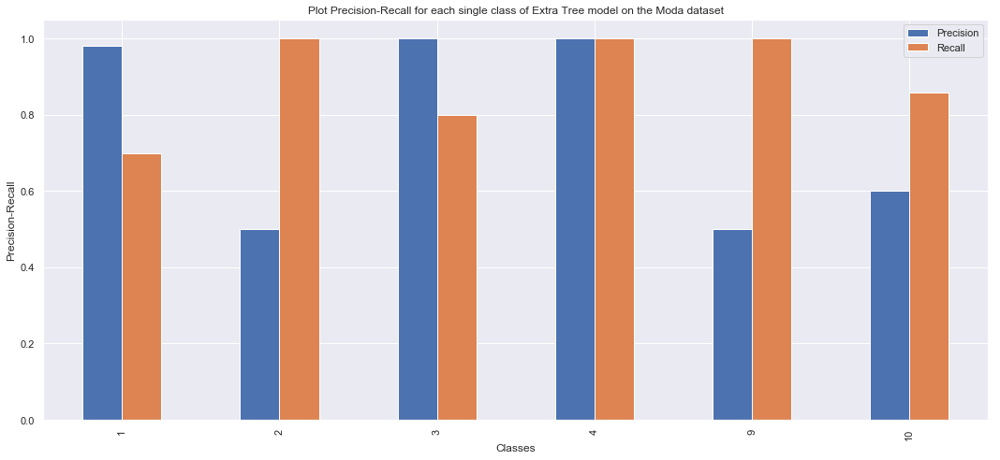

    Precision    Recall
1    0.980769  0.698630
2    0.500000  1.000000
3    1.000000  0.800000
4    1.000000  1.000000
9    0.500000  1.000000
10   0.600000  0.857143


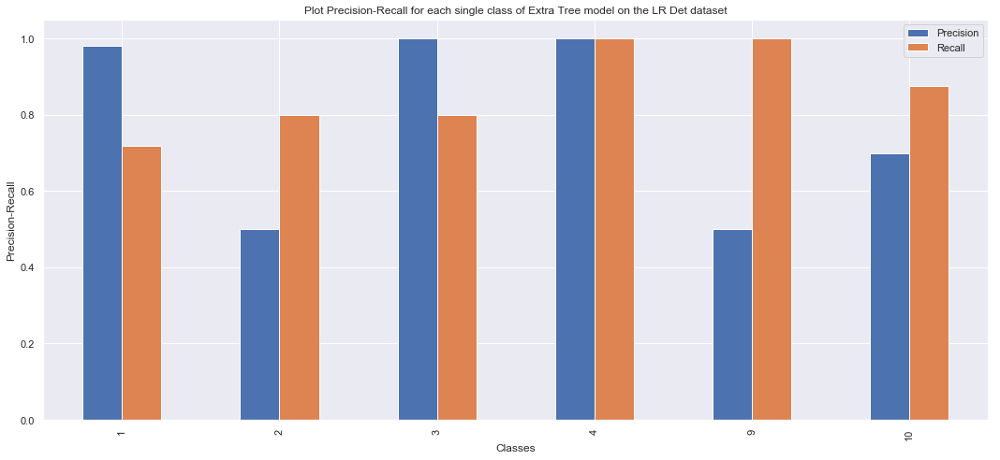

    Precision   Recall
1    0.980769  0.71831
2    0.500000  0.80000
3    1.000000  0.80000
4    1.000000  1.00000
9    0.500000  1.00000
10   0.700000  0.87500


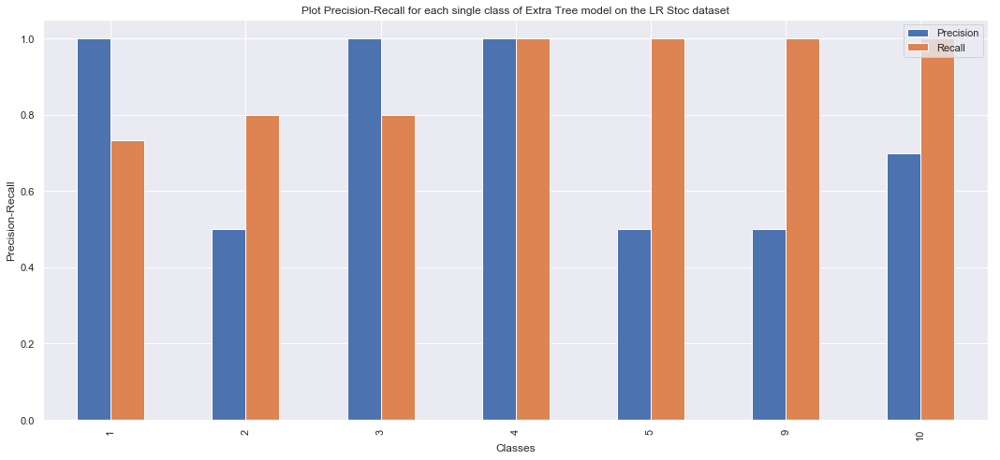

    Precision    Recall
1         1.0  0.732394
2         0.5  0.800000
3         1.0  0.800000
4         1.0  1.000000
5         0.5  1.000000
9         0.5  1.000000
10        0.7  1.000000


In [138]:
j=0
for i in scores_et_nofs:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of Extra Tree model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

### Extreme Gradient Boosting

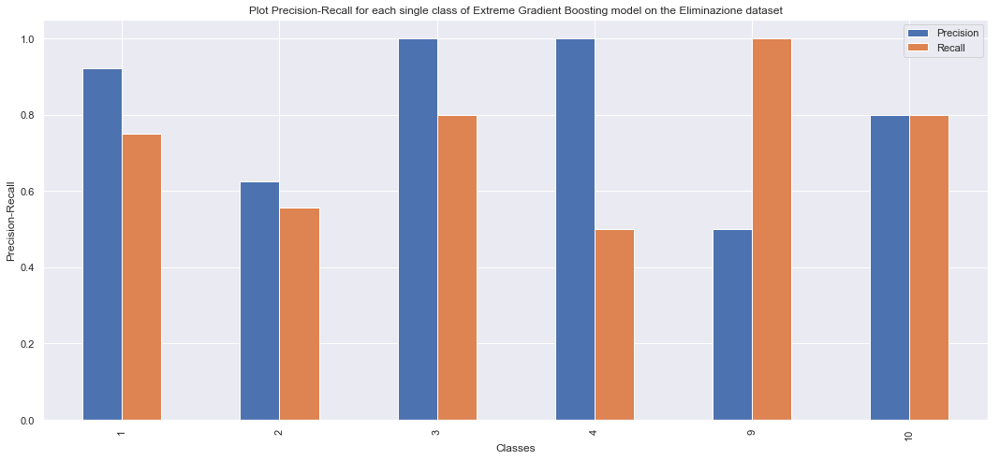

    Precision    Recall
1    0.923077  0.750000
2    0.625000  0.555556
3    1.000000  0.800000
4    1.000000  0.500000
9    0.500000  1.000000
10   0.800000  0.800000


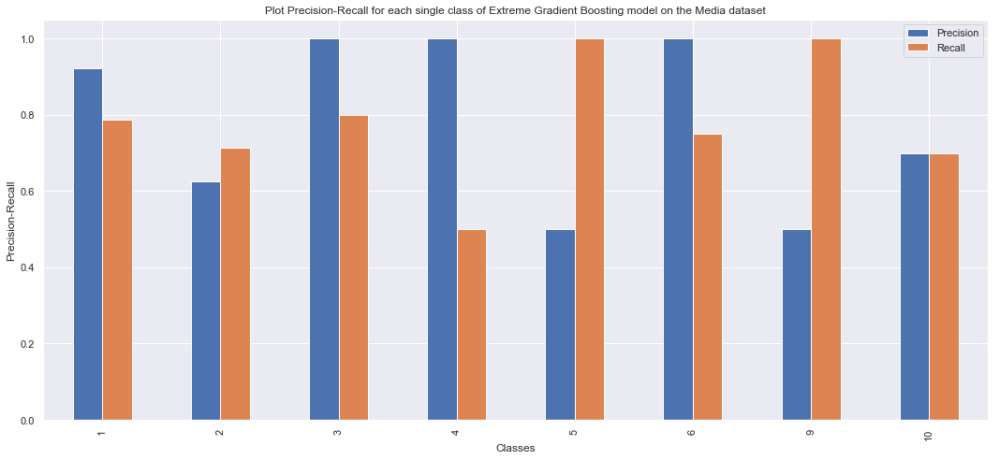

    Precision    Recall
1    0.923077  0.786885
2    0.625000  0.714286
3    1.000000  0.800000
4    1.000000  0.500000
5    0.500000  1.000000
6    1.000000  0.750000
9    0.500000  1.000000
10   0.700000  0.700000


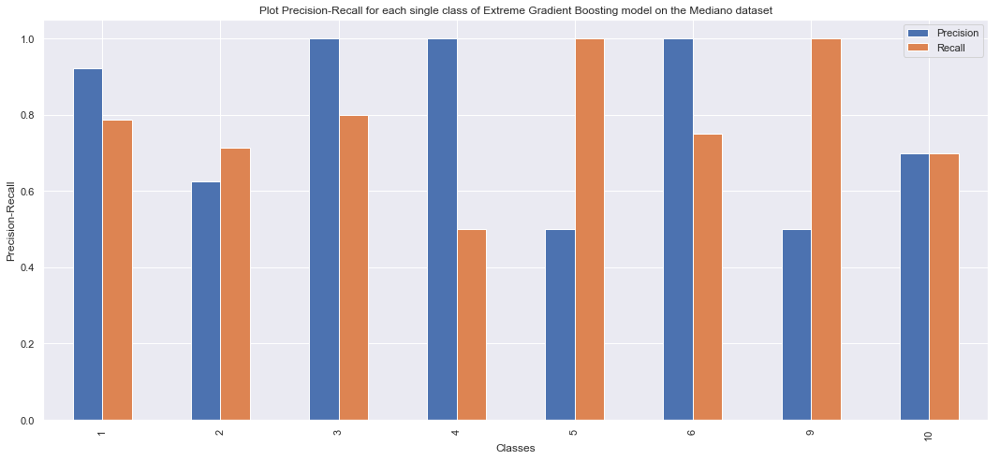

    Precision    Recall
1    0.923077  0.786885
2    0.625000  0.714286
3    1.000000  0.800000
4    1.000000  0.500000
5    0.500000  1.000000
6    1.000000  0.750000
9    0.500000  1.000000
10   0.700000  0.700000


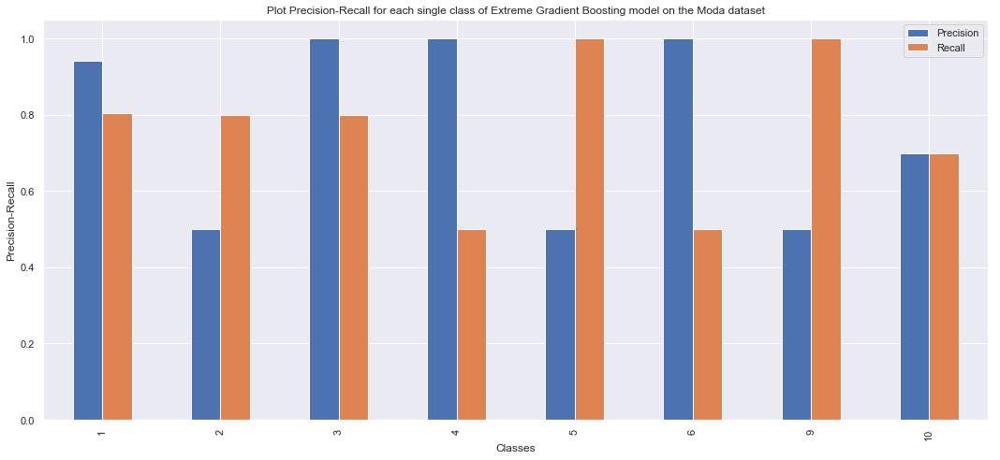

    Precision    Recall
1    0.942308  0.803279
2    0.500000  0.800000
3    1.000000  0.800000
4    1.000000  0.500000
5    0.500000  1.000000
6    1.000000  0.500000
9    0.500000  1.000000
10   0.700000  0.700000


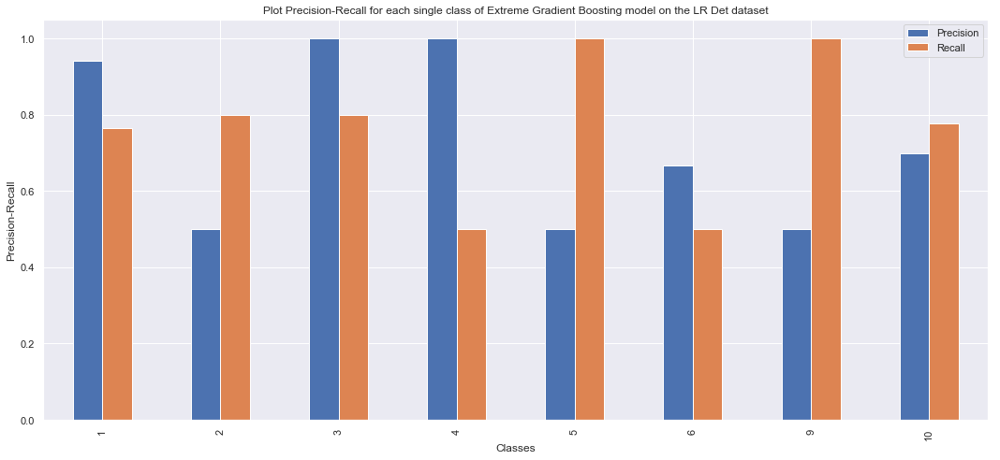

    Precision    Recall
1    0.942308  0.765625
2    0.500000  0.800000
3    1.000000  0.800000
4    1.000000  0.500000
5    0.500000  1.000000
6    0.666667  0.500000
9    0.500000  1.000000
10   0.700000  0.777778


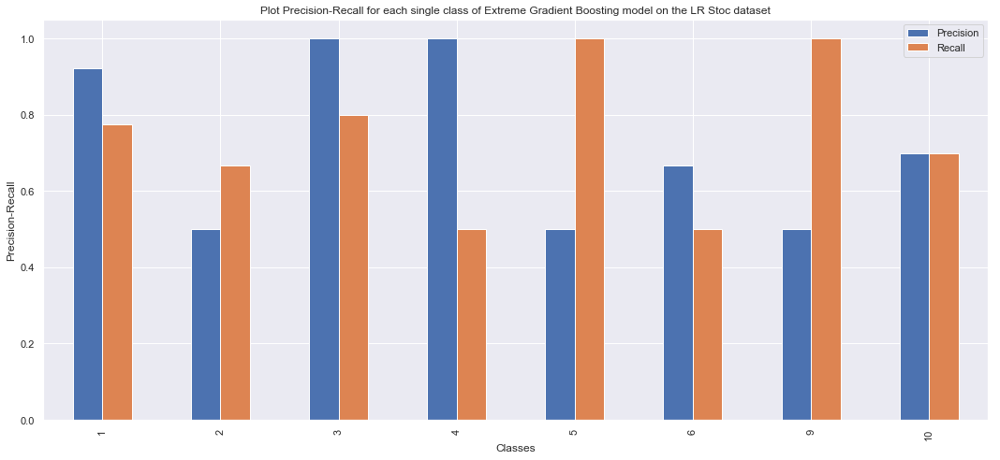

    Precision    Recall
1    0.923077  0.774194
2    0.500000  0.666667
3    1.000000  0.800000
4    1.000000  0.500000
5    0.500000  1.000000
6    0.666667  0.500000
9    0.500000  1.000000
10   0.700000  0.700000


In [139]:
j=0
for i in scores_xgb_nofs:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of Extreme Gradient Boosting model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

<a id="BOOSTNOFSSCORES"></a>
<h3> Risultati e confronti tra i diversi Algoritmi di Boosting senza Feature Selection in termini di Accuracy, Precision e Recall <a href="#indice" style="text-decoration:none;">↑</a></h3>


### Plotting recall totali

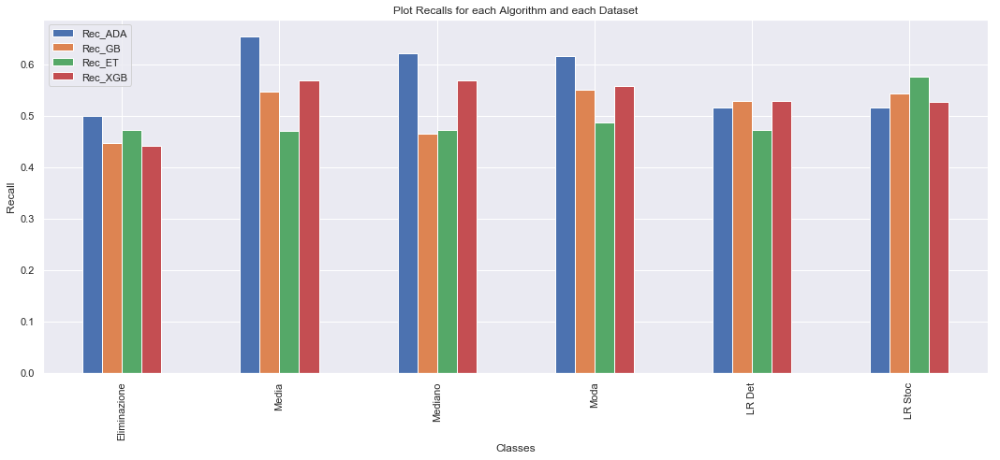

               Rec_ADA    Rec_GB    Rec_ET   Rec_XGB
Eliminazione  0.499394  0.446963  0.472119  0.440734
Media         0.654460  0.545992  0.470081  0.568007
Mediano       0.621739  0.465738  0.473052  0.568007
Moda          0.615301  0.550248  0.486888  0.558392
LR Det        0.515066  0.529036  0.472119  0.528089
LR Stoc       0.515909  0.543971  0.575672  0.526340


In [140]:

fig, ax = plt.subplots(figsize=(15,7))
ensemble_nofs_df[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Recalls for each Algorithm and each Dataset")
ax.set_ylabel('Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_nofs_df[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']])


### Plotting Precision totali

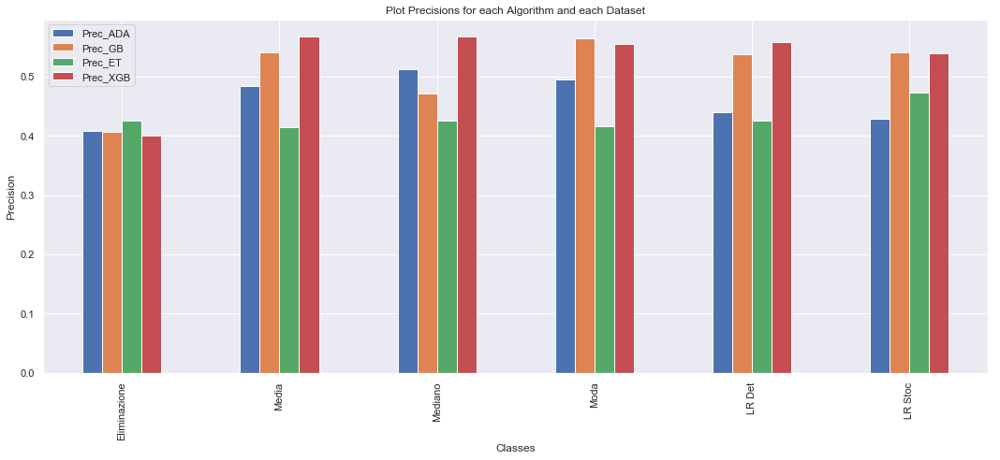

              Prec_ADA   Prec_GB   Prec_ET  Prec_XGB
Eliminazione  0.409091  0.407479  0.425524  0.400505
Media         0.484848  0.541434  0.414685  0.568288
Mediano       0.513403  0.471503  0.425524  0.568288
Moda          0.495221  0.564161  0.416434  0.554844
LR Det        0.439394  0.537937  0.425524  0.558491
LR Stoc       0.428555  0.541434  0.472727  0.540078


In [141]:

fig, ax = plt.subplots(figsize=(15,7))
ensemble_nofs_df[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Precisions for each Algorithm and each Dataset")
ax.set_ylabel('Precision')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_nofs_df[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']])


### Plotting Accuracy totali

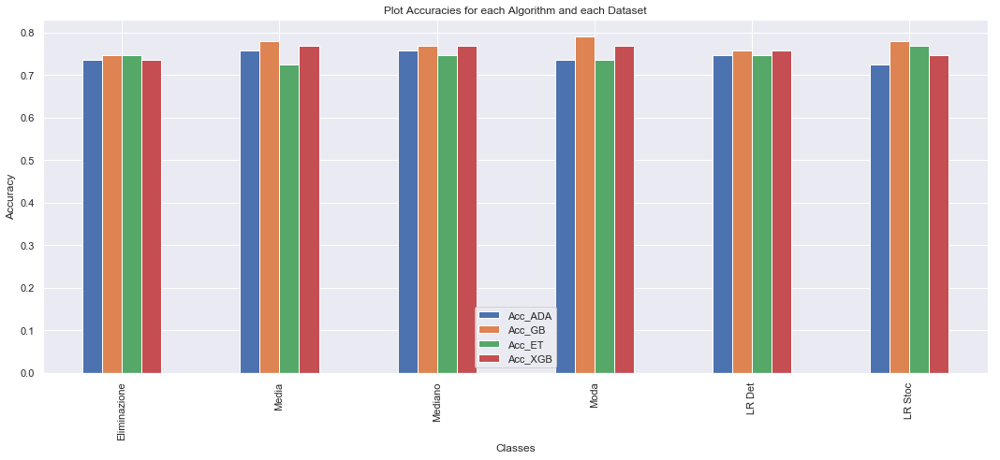

               Acc_ADA    Acc_GB    Acc_ET   Acc_XGB
Eliminazione  0.736264  0.747253  0.747253  0.736264
Media         0.758242  0.780220  0.725275  0.769231
Mediano       0.758242  0.769231  0.747253  0.769231
Moda          0.736264  0.791209  0.736264  0.769231
LR Det        0.747253  0.758242  0.747253  0.758242
LR Stoc       0.725275  0.780220  0.769231  0.747253


In [142]:

fig, ax = plt.subplots(figsize=(15,7))
ensemble_nofs_df[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_nofs_df[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']])


<a id="BOOSTPEAR"></a>
<h3> Boosting con Pearson Correlation per la Feature Selection <a href="#indice" style="text-decoration:none;">↑</a></h3>


### Training e Testing degli algoritmi di Boosting utilizzando la Correlazione di Pearson per effettuare Feature Selection

In [ ]:
scores_ada_pearson,scores_gb_pearson,scores_et_pearson,scores_xgb_pearson = training_testing_boosting_algorithms_Pearson(Datasets,imputations)

In [144]:
ensemble_pearson_df = pd.DataFrame()

In [145]:
ensemble_pearson_df['Acc_ADA'] =  [scores_ada_pearson[0][0]] + [scores_ada_pearson[1][0]]+[scores_ada_pearson[2][0]]+[scores_ada_pearson[3][0]]+[scores_ada_pearson[4][0]]+[scores_ada_pearson[5][0]]
ensemble_pearson_df['Rec_ADA'] =  [scores_ada_pearson[0][1]] + [scores_ada_pearson[1][1]]+[scores_ada_pearson[2][1]]+[scores_ada_pearson[3][1]]+[scores_ada_pearson[4][1]]+[scores_ada_pearson[5][1]]
ensemble_pearson_df['Prec_ADA'] =  [scores_ada_pearson[0][2]] + [scores_ada_pearson[1][2]]+[scores_ada_pearson[2][2]]+[scores_ada_pearson[3][2]]+[scores_ada_pearson[4][2]]+[scores_ada_pearson[5][2]]

In [146]:
ensemble_pearson_df['Acc_GB'] =  [scores_gb_pearson[0][0]] + [scores_gb_pearson[1][0]]+[scores_gb_pearson[2][0]]+[scores_gb_pearson[3][0]]+[scores_gb_pearson[4][0]]+[scores_gb_pearson[5][0]]
ensemble_pearson_df['Rec_GB'] =  [scores_gb_pearson[0][1]] + [scores_gb_pearson[1][1]]+[scores_gb_pearson[2][1]]+[scores_gb_pearson[3][1]]+[scores_gb_pearson[4][1]]+[scores_gb_pearson[5][1]]
ensemble_pearson_df['Prec_GB'] =  [scores_gb_pearson[0][2]] + [scores_gb_pearson[1][2]]+[scores_gb_pearson[2][2]]+[scores_gb_pearson[3][2]]+[scores_gb_pearson[4][2]]+[scores_gb_pearson[5][2]]

In [147]:
ensemble_pearson_df['Acc_ET'] =  [scores_et_pearson[0][0]] + [scores_et_pearson[1][0]]+[scores_et_pearson[2][0]]+[scores_et_pearson[3][0]]+[scores_et_pearson[4][0]]+[scores_et_pearson[5][0]]
ensemble_pearson_df['Rec_ET'] =  [scores_et_pearson[0][1]] + [scores_et_pearson[1][1]]+[scores_et_pearson[2][1]]+[scores_et_pearson[3][1]]+[scores_et_pearson[4][1]]+[scores_et_pearson[5][1]]
ensemble_pearson_df['Prec_ET'] =  [scores_et_pearson[0][2]] + [scores_et_pearson[1][2]]+[scores_et_pearson[2][2]]+[scores_et_pearson[3][2]]+[scores_et_pearson[4][2]]+[scores_et_pearson[5][2]]

In [148]:
ensemble_pearson_df['Acc_XGB'] =  [scores_xgb_pearson[0][0]] + [scores_xgb_pearson[1][0]]+[scores_xgb_pearson[2][0]]+[scores_xgb_pearson[3][0]]+[scores_xgb_pearson[4][0]]+[scores_xgb_pearson[5][0]]
ensemble_pearson_df['Rec_XGB'] =  [scores_xgb_pearson[0][1]] + [scores_xgb_pearson[1][1]]+[scores_xgb_pearson[2][1]]+[scores_xgb_pearson[3][1]]+[scores_xgb_pearson[4][1]]+[scores_xgb_pearson[5][1]]
ensemble_pearson_df['Prec_XGB'] =  [scores_xgb_pearson[0][2]] + [scores_xgb_pearson[1][2]]+[scores_xgb_pearson[2][2]]+[scores_xgb_pearson[3][2]]+[scores_xgb_pearson[4][2]]+[scores_xgb_pearson[5][2]]

In [149]:
ensemble_pearson_df = ensemble_pearson_df.set_index([imputations])

### Plotting delle precision e recall sulle singole classi per ogni modello e per ogni dataset 

### ADA Boost

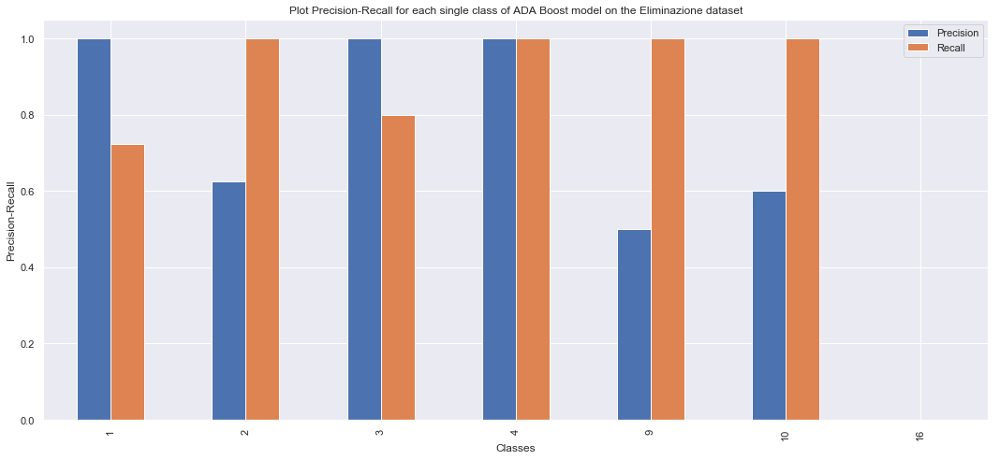

    Precision    Recall
1       1.000  0.722222
2       0.625  1.000000
3       1.000  0.800000
4       1.000  1.000000
9       0.500  1.000000
10      0.600  1.000000
16      0.000  0.000000


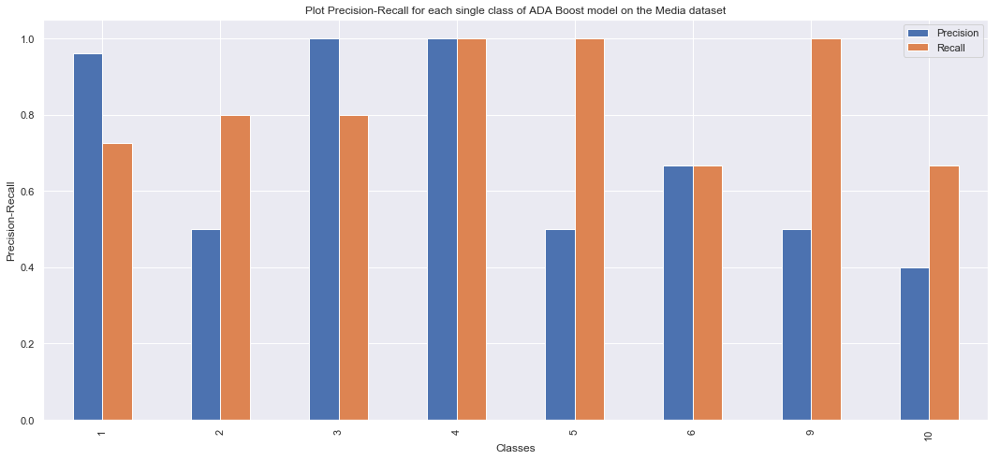

    Precision    Recall
1    0.961538  0.724638
2    0.500000  0.800000
3    1.000000  0.800000
4    1.000000  1.000000
5    0.500000  1.000000
6    0.666667  0.666667
9    0.500000  1.000000
10   0.400000  0.666667


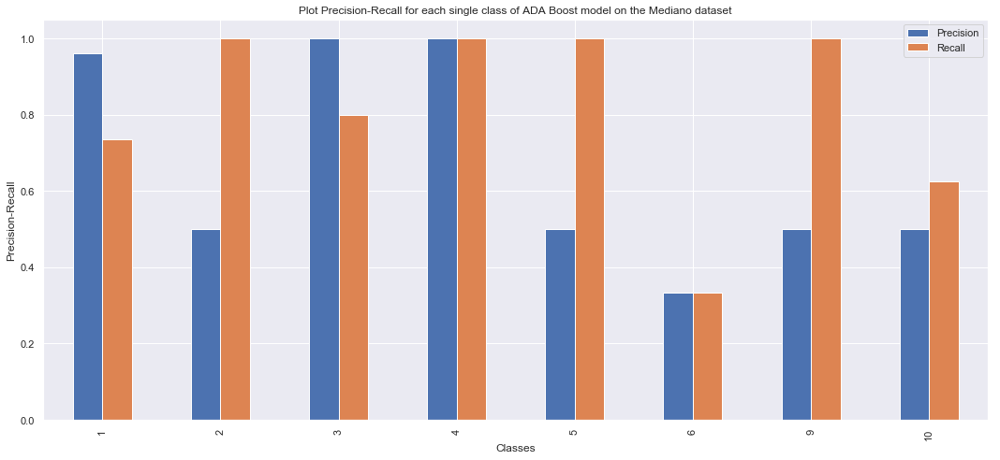

    Precision    Recall
1    0.961538  0.735294
2    0.500000  1.000000
3    1.000000  0.800000
4    1.000000  1.000000
5    0.500000  1.000000
6    0.333333  0.333333
9    0.500000  1.000000
10   0.500000  0.625000


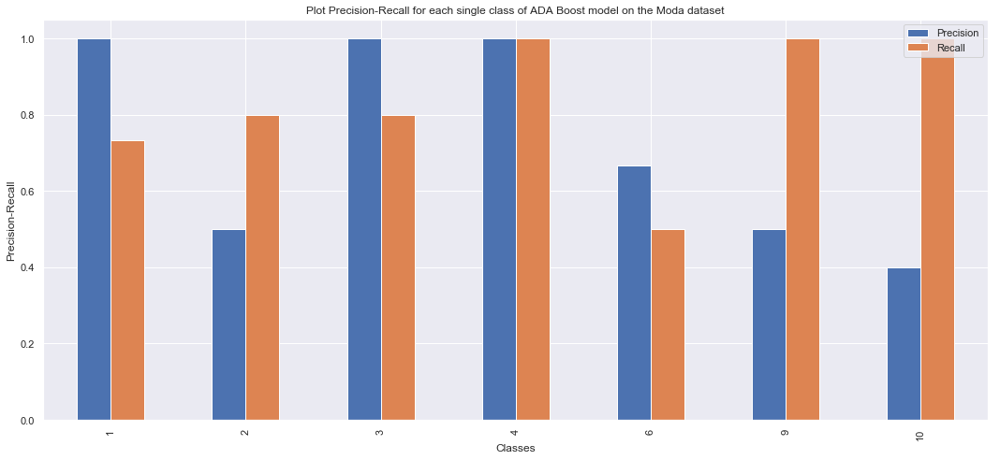

    Precision    Recall
1    1.000000  0.732394
2    0.500000  0.800000
3    1.000000  0.800000
4    1.000000  1.000000
6    0.666667  0.500000
9    0.500000  1.000000
10   0.400000  1.000000


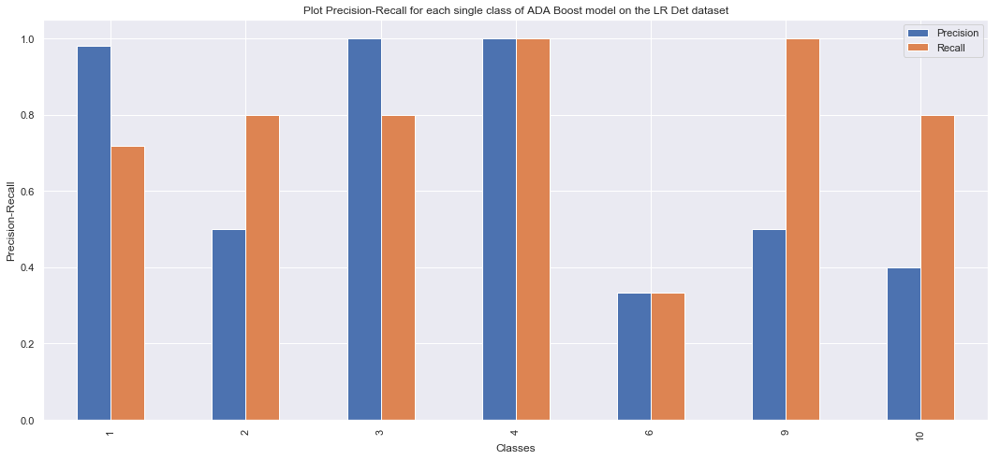

    Precision    Recall
1    0.980769  0.718310
2    0.500000  0.800000
3    1.000000  0.800000
4    1.000000  1.000000
6    0.333333  0.333333
9    0.500000  1.000000
10   0.400000  0.800000


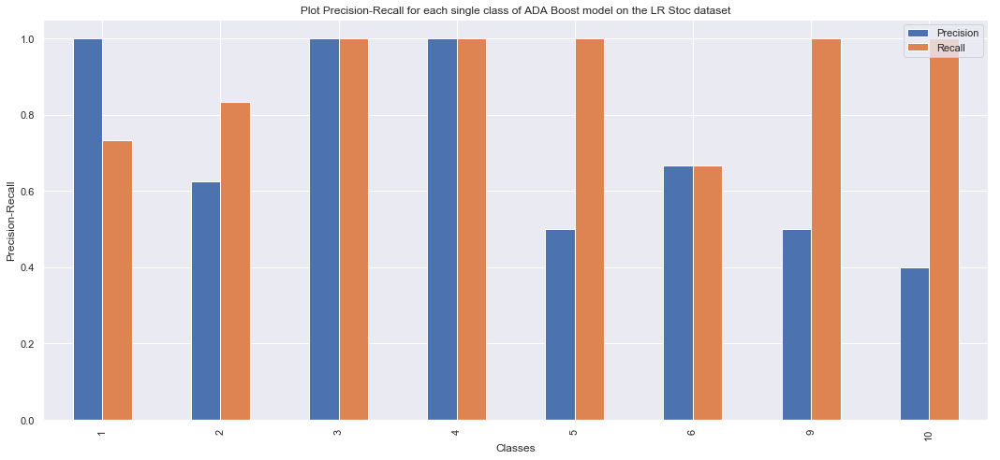

    Precision    Recall
1    1.000000  0.732394
2    0.625000  0.833333
3    1.000000  1.000000
4    1.000000  1.000000
5    0.500000  1.000000
6    0.666667  0.666667
9    0.500000  1.000000
10   0.400000  1.000000


In [150]:
j=0
for i in scores_ada_pearson:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of ADA Boost model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

### Gradient Boosting

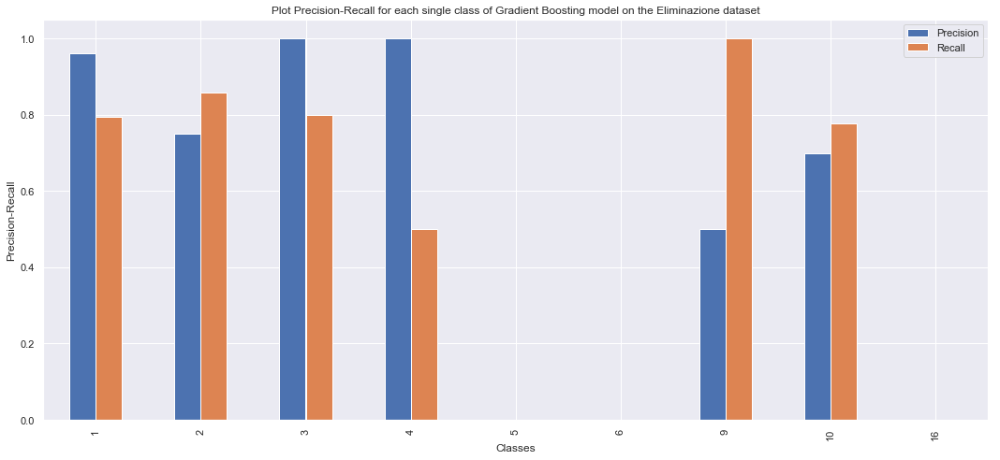

    Precision    Recall
1    0.961538  0.793651
2    0.750000  0.857143
3    1.000000  0.800000
4    1.000000  0.500000
5    0.000000  0.000000
6    0.000000  0.000000
9    0.500000  1.000000
10   0.700000  0.777778
16   0.000000  0.000000


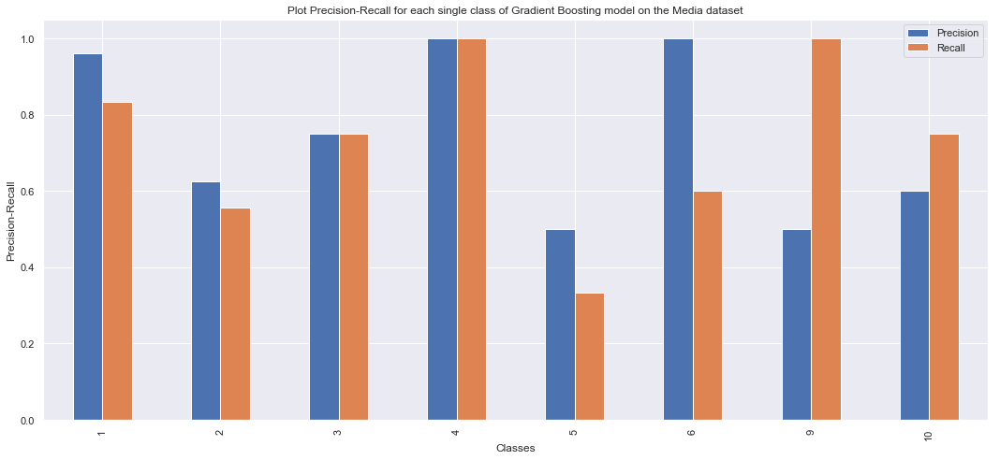

    Precision    Recall
1    0.961538  0.833333
2    0.625000  0.555556
3    0.750000  0.750000
4    1.000000  1.000000
5    0.500000  0.333333
6    1.000000  0.600000
9    0.500000  1.000000
10   0.600000  0.750000


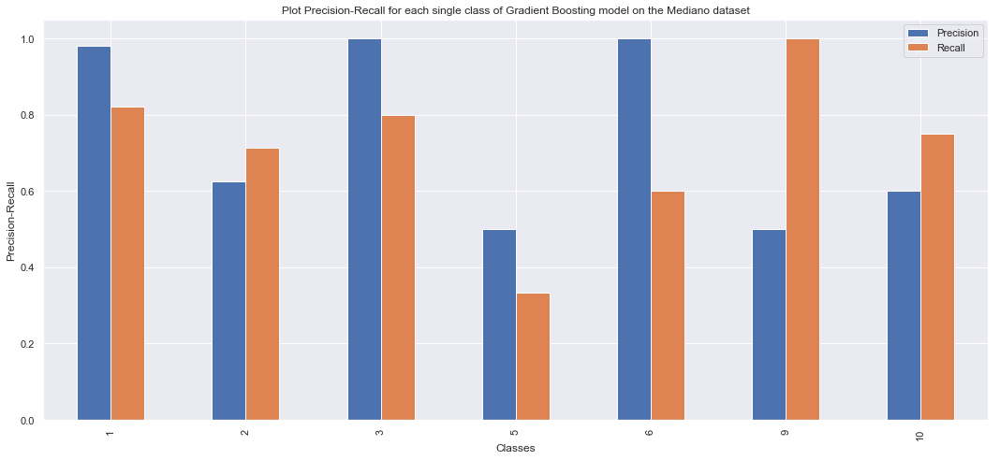

    Precision    Recall
1    0.980769  0.822581
2    0.625000  0.714286
3    1.000000  0.800000
5    0.500000  0.333333
6    1.000000  0.600000
9    0.500000  1.000000
10   0.600000  0.750000


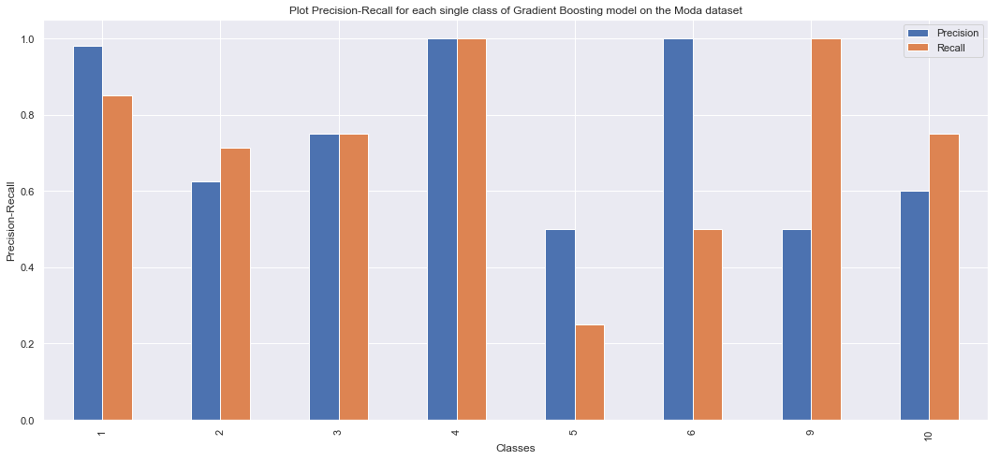

    Precision    Recall
1    0.980769  0.850000
2    0.625000  0.714286
3    0.750000  0.750000
4    1.000000  1.000000
5    0.500000  0.250000
6    1.000000  0.500000
9    0.500000  1.000000
10   0.600000  0.750000


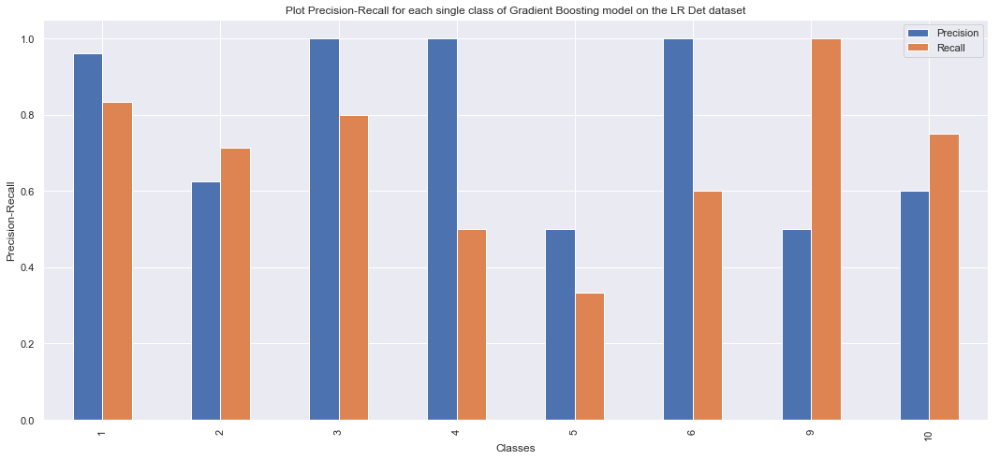

    Precision    Recall
1    0.961538  0.833333
2    0.625000  0.714286
3    1.000000  0.800000
4    1.000000  0.500000
5    0.500000  0.333333
6    1.000000  0.600000
9    0.500000  1.000000
10   0.600000  0.750000


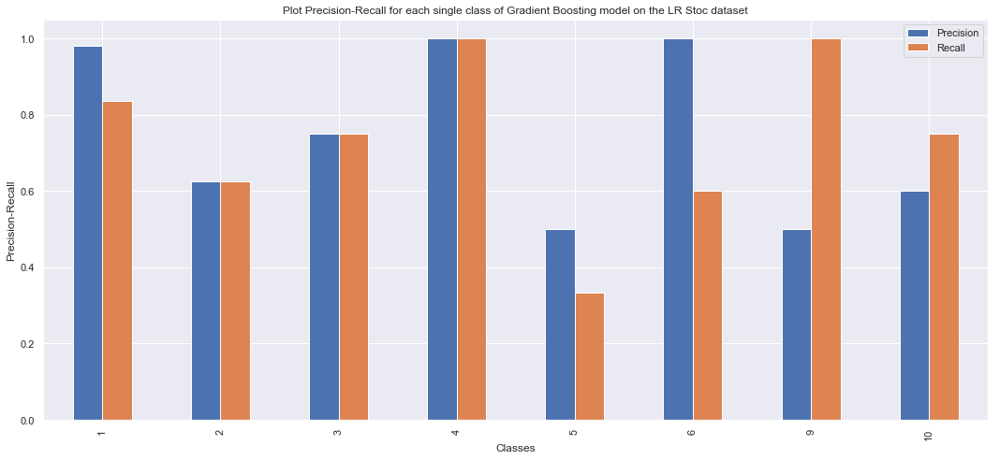

    Precision    Recall
1    0.980769  0.836066
2    0.625000  0.625000
3    0.750000  0.750000
4    1.000000  1.000000
5    0.500000  0.333333
6    1.000000  0.600000
9    0.500000  1.000000
10   0.600000  0.750000


In [151]:
j=0
for i in scores_gb_pearson:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of Gradient Boosting model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

### Extra Tree

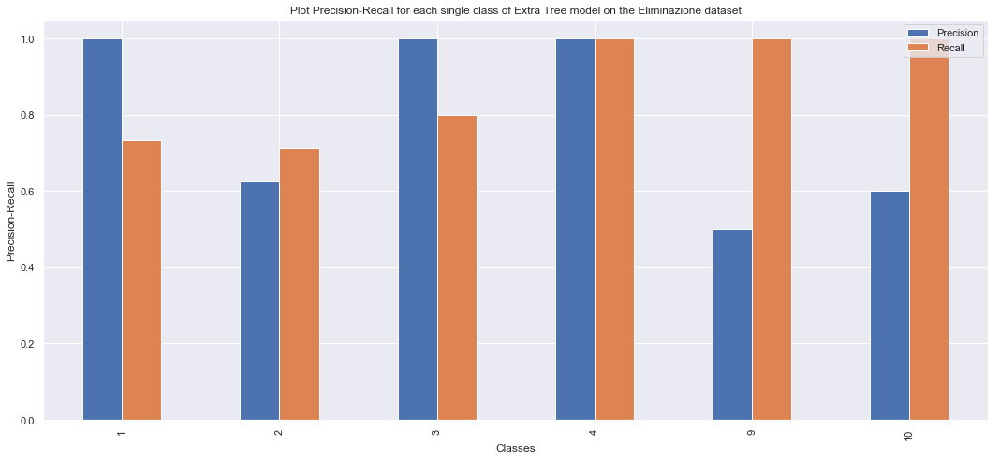

    Precision    Recall
1       1.000  0.732394
2       0.625  0.714286
3       1.000  0.800000
4       1.000  1.000000
9       0.500  1.000000
10      0.600  1.000000


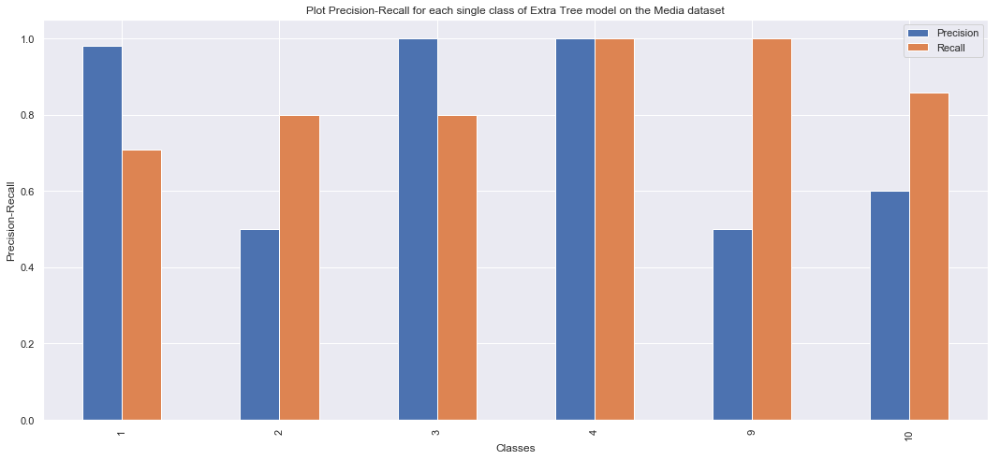

    Precision    Recall
1    0.980769  0.708333
2    0.500000  0.800000
3    1.000000  0.800000
4    1.000000  1.000000
9    0.500000  1.000000
10   0.600000  0.857143


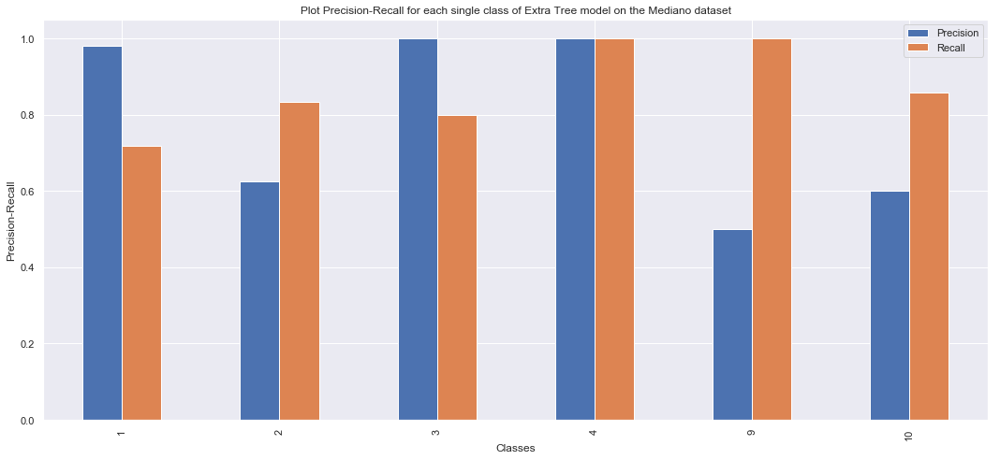

    Precision    Recall
1    0.980769  0.718310
2    0.625000  0.833333
3    1.000000  0.800000
4    1.000000  1.000000
9    0.500000  1.000000
10   0.600000  0.857143


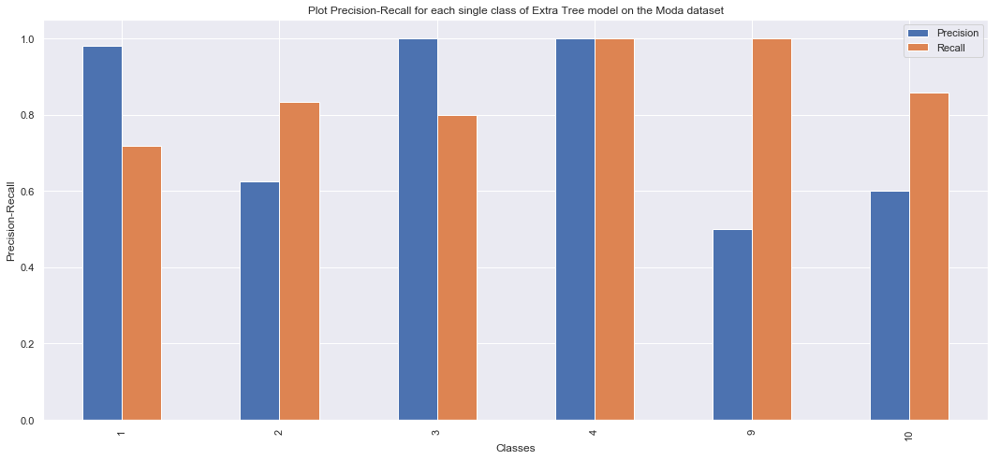

    Precision    Recall
1    0.980769  0.718310
2    0.625000  0.833333
3    1.000000  0.800000
4    1.000000  1.000000
9    0.500000  1.000000
10   0.600000  0.857143


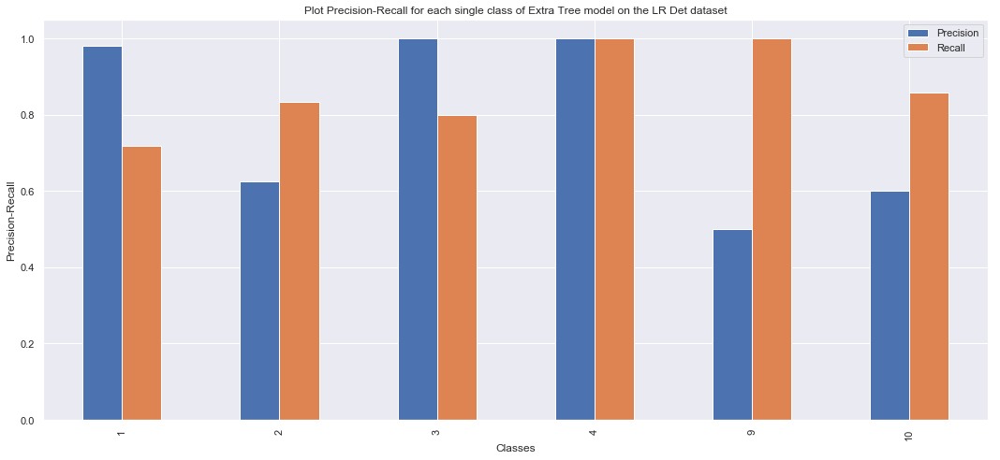

    Precision    Recall
1    0.980769  0.718310
2    0.625000  0.833333
3    1.000000  0.800000
4    1.000000  1.000000
9    0.500000  1.000000
10   0.600000  0.857143


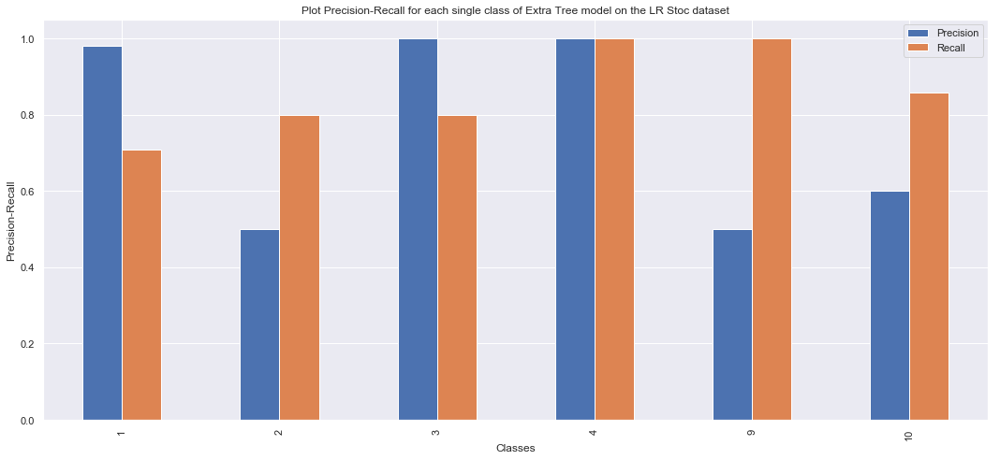

    Precision    Recall
1    0.980769  0.708333
2    0.500000  0.800000
3    1.000000  0.800000
4    1.000000  1.000000
9    0.500000  1.000000
10   0.600000  0.857143


In [152]:
j=0
for i in scores_et_pearson:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of Extra Tree model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

### Extreme Gradient Boosting

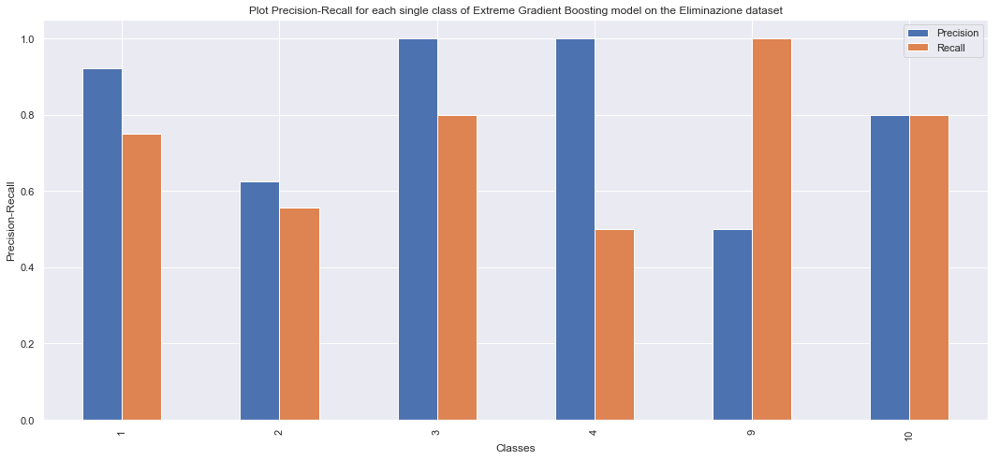

    Precision    Recall
1    0.923077  0.750000
2    0.625000  0.555556
3    1.000000  0.800000
4    1.000000  0.500000
9    0.500000  1.000000
10   0.800000  0.800000


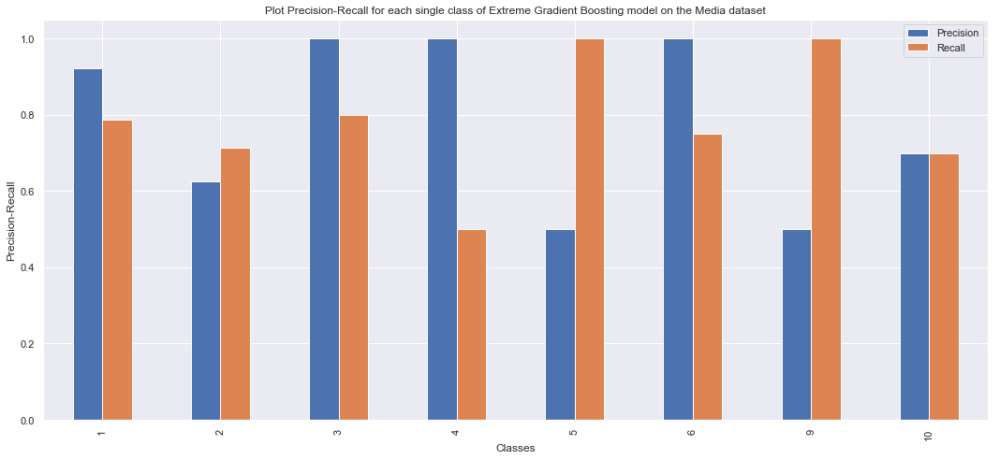

    Precision    Recall
1    0.923077  0.786885
2    0.625000  0.714286
3    1.000000  0.800000
4    1.000000  0.500000
5    0.500000  1.000000
6    1.000000  0.750000
9    0.500000  1.000000
10   0.700000  0.700000


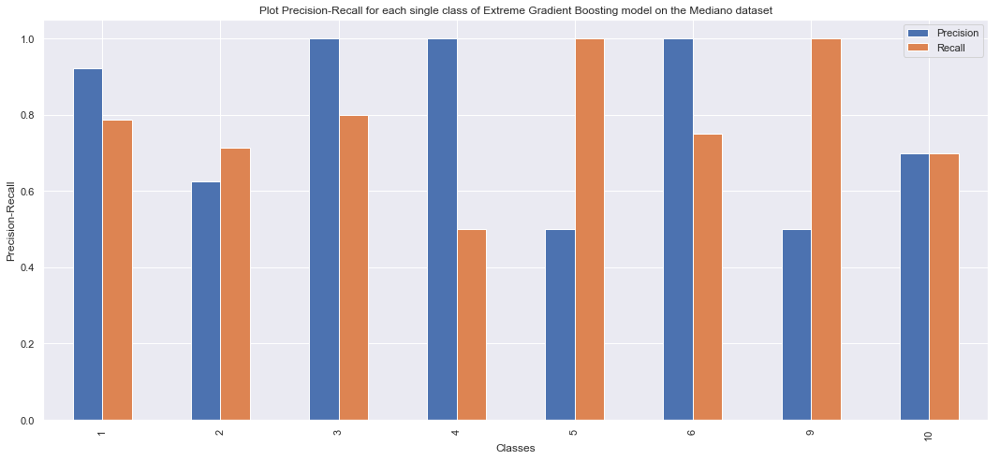

    Precision    Recall
1    0.923077  0.786885
2    0.625000  0.714286
3    1.000000  0.800000
4    1.000000  0.500000
5    0.500000  1.000000
6    1.000000  0.750000
9    0.500000  1.000000
10   0.700000  0.700000


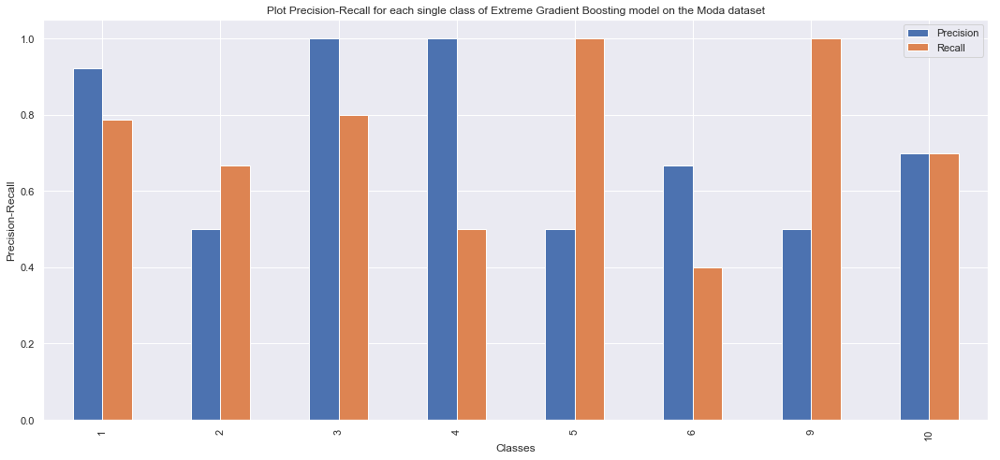

    Precision    Recall
1    0.923077  0.786885
2    0.500000  0.666667
3    1.000000  0.800000
4    1.000000  0.500000
5    0.500000  1.000000
6    0.666667  0.400000
9    0.500000  1.000000
10   0.700000  0.700000


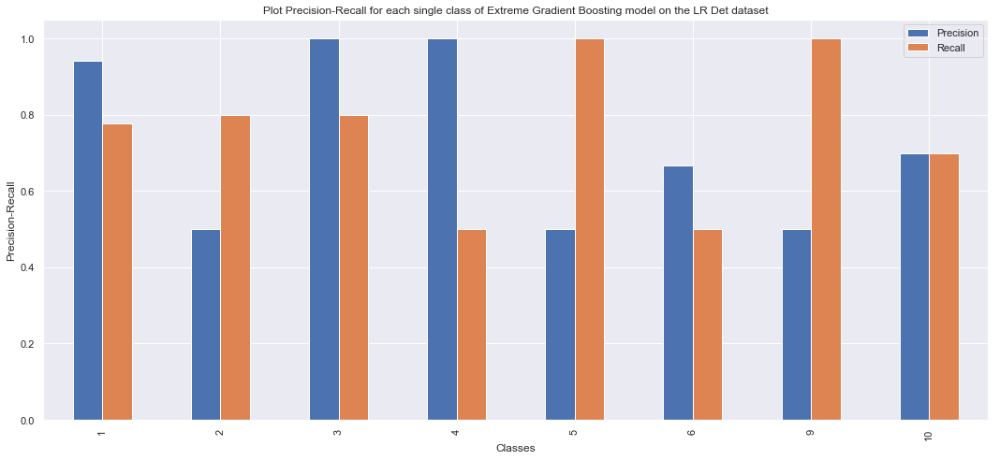

    Precision    Recall
1    0.942308  0.777778
2    0.500000  0.800000
3    1.000000  0.800000
4    1.000000  0.500000
5    0.500000  1.000000
6    0.666667  0.500000
9    0.500000  1.000000
10   0.700000  0.700000


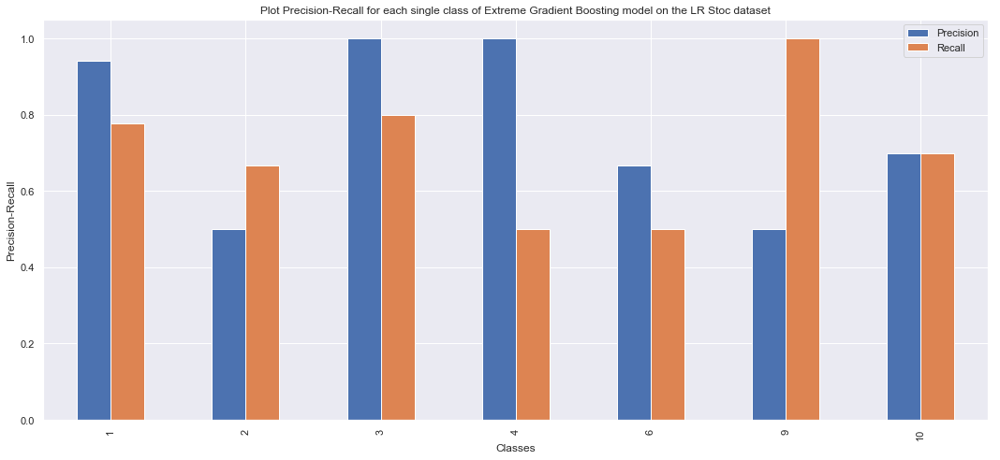

    Precision    Recall
1    0.942308  0.777778
2    0.500000  0.666667
3    1.000000  0.800000
4    1.000000  0.500000
6    0.666667  0.500000
9    0.500000  1.000000
10   0.700000  0.700000


In [153]:
j=0
for i in scores_xgb_pearson:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of Extreme Gradient Boosting model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1


<a id="BOOSTPEARSCORES"></a>
<h3> Risultati e confronti tra i diversi Algoritmi di Boosting utilizzando Pearson Correlation per la Feature Selection in termini di Accuracy, Precision e Recall <a href="#indice" style="text-decoration:none;">↑</a></h3>



### Total Recalls

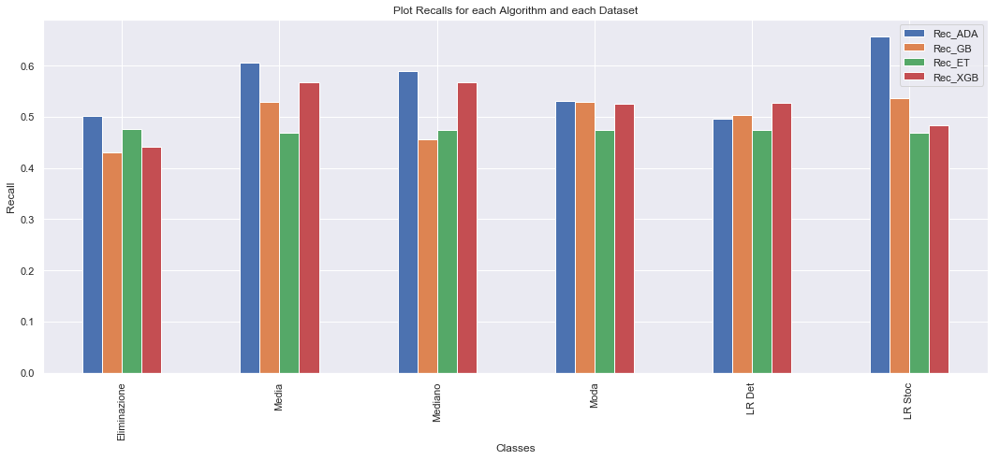

               Rec_ADA    Rec_GB    Rec_ET   Rec_XGB
Eliminazione  0.502020  0.429870  0.476971  0.440734
Media         0.605270  0.529293  0.469589  0.568007
Mediano       0.590330  0.456382  0.473526  0.568007
Moda          0.530218  0.528571  0.473526  0.526340
LR Det        0.495604  0.502814  0.473526  0.528089
LR Stoc       0.657490  0.535854  0.469589  0.482634


In [154]:

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pearson_df[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Recalls for each Algorithm and each Dataset")
ax.set_ylabel('Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pearson_df[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']])


## Total Precisions

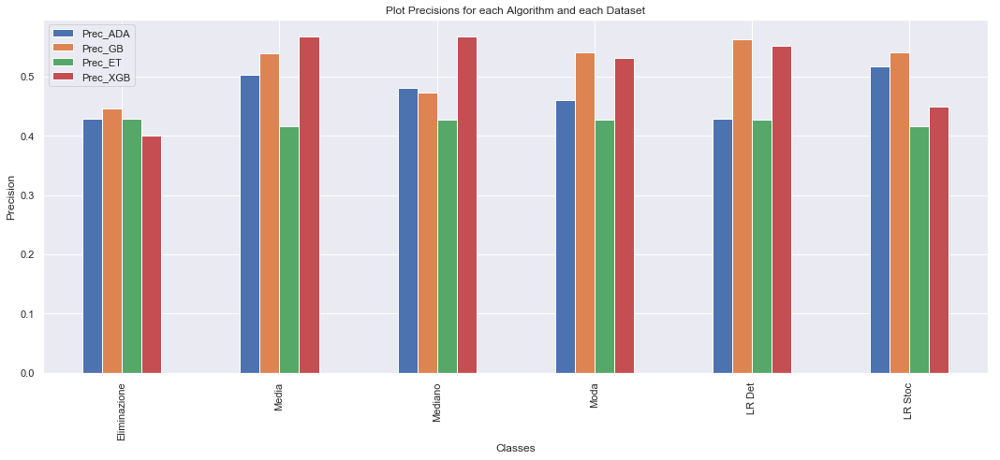

              Prec_ADA   Prec_GB   Prec_ET  Prec_XGB
Eliminazione  0.429545  0.446503  0.429545  0.400505
Media         0.502564  0.539685  0.416434  0.568288
Mediano       0.481352  0.473252  0.427797  0.568288
Moda          0.460606  0.541434  0.427797  0.532141
LR Det        0.428555  0.562413  0.427797  0.552525
LR Stoc       0.517424  0.541434  0.416434  0.449495


In [155]:

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pearson_df[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Precisions for each Algorithm and each Dataset")
ax.set_ylabel('Precision')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pearson_df[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']])


## Total Accuracies

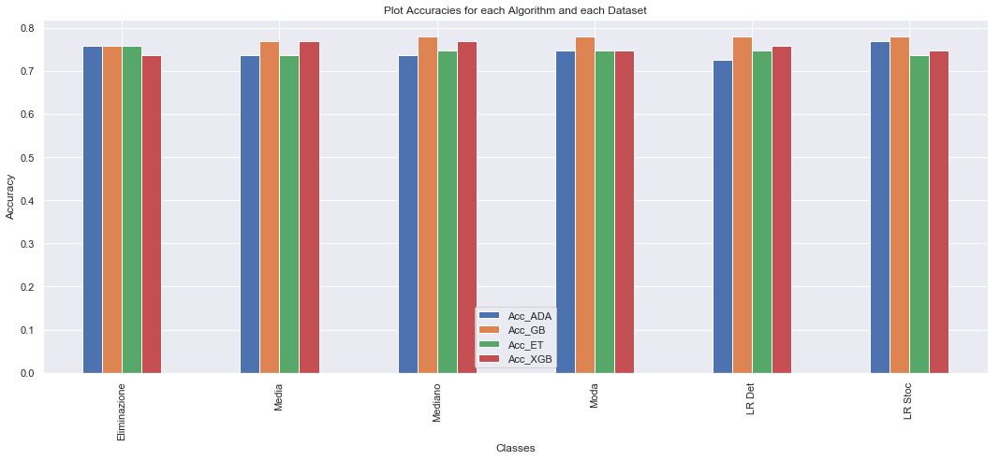

               Acc_ADA    Acc_GB    Acc_ET   Acc_XGB
Eliminazione  0.758242  0.758242  0.758242  0.736264
Media         0.736264  0.769231  0.736264  0.769231
Mediano       0.736264  0.780220  0.747253  0.769231
Moda          0.747253  0.780220  0.747253  0.747253
LR Det        0.725275  0.780220  0.747253  0.758242
LR Stoc       0.769231  0.780220  0.736264  0.747253


In [156]:

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pearson_df[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pearson_df[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']])


<a id="BOOSTRFE"></a>
<h3> Boosting con RFE per la Feature Selection <a href="#indice" style="text-decoration:none;">↑</a></h3>



### Training e Testing degli algoritmi di Boosting utilizzando Recursive Feature Elimination per effettuare Feature Selection

In [ ]:
scores_ada_rfe,scores_gb_rfe,scores_et_rfe,scores_xgb_rfe = training_testing_boosting_algorithms_RFE(Datasets,imputations)

In [160]:
ensemble_rfe_df = pd.DataFrame()

ensemble_rfe_df['Acc_ADA'] =  [scores_ada_rfe[0][0]] + [scores_ada_rfe[1][0]]+[scores_ada_rfe[2][0]]+[scores_ada_rfe[3][0]]+[scores_ada_rfe[4][0]]+[scores_ada_rfe[5][0]]
ensemble_rfe_df['Rec_ADA'] =  [scores_ada_rfe[0][1]] + [scores_ada_rfe[1][1]]+[scores_ada_rfe[2][1]]+[scores_ada_rfe[3][1]]+[scores_ada_rfe[4][1]]+[scores_ada_rfe[5][1]]
ensemble_rfe_df['Prec_ADA'] =  [scores_ada_rfe[0][2]] + [scores_ada_rfe[1][2]]+[scores_ada_rfe[2][2]]+[scores_ada_rfe[3][2]]+[scores_ada_rfe[4][2]]+[scores_ada_rfe[5][2]]

ensemble_rfe_df['Acc_GB'] =  [scores_gb_rfe[0][0]] + [scores_gb_rfe[1][0]]+[scores_gb_rfe[2][0]]+[scores_gb_rfe[3][0]]+[scores_gb_rfe[4][0]]+[scores_gb_rfe[5][0]]
ensemble_rfe_df['Rec_GB'] =  [scores_gb_rfe[0][1]] + [scores_gb_rfe[1][1]]+[scores_gb_rfe[2][1]]+[scores_gb_rfe[3][1]]+[scores_gb_rfe[4][1]]+[scores_gb_rfe[5][1]]
ensemble_rfe_df['Prec_GB'] =  [scores_gb_rfe[0][2]] + [scores_gb_rfe[1][2]]+[scores_gb_rfe[2][2]]+[scores_gb_rfe[3][2]]+[scores_gb_rfe[4][2]]+[scores_gb_rfe[5][2]]

ensemble_rfe_df['Acc_ET'] =  [scores_et_rfe[0][0]] + [scores_et_rfe[1][0]]+[scores_et_rfe[2][0]]+[scores_et_rfe[3][0]]+[scores_et_rfe[4][0]]+[scores_et_rfe[5][0]]
ensemble_rfe_df['Rec_ET'] =  [scores_et_rfe[0][1]] + [scores_et_rfe[1][1]]+[scores_et_rfe[2][1]]+[scores_et_rfe[3][1]]+[scores_et_rfe[4][1]]+[scores_et_rfe[5][1]]
ensemble_rfe_df['Prec_ET'] =  [scores_et_rfe[0][2]] + [scores_et_rfe[1][2]]+[scores_et_rfe[2][2]]+[scores_et_rfe[3][2]]+[scores_et_rfe[4][2]]+[scores_et_rfe[5][2]]

ensemble_rfe_df['Acc_XGB'] =  [scores_xgb_rfe[0][0]] + [scores_xgb_rfe[1][0]]+[scores_xgb_rfe[2][0]]+[scores_xgb_rfe[3][0]]+[scores_xgb_rfe[4][0]]+[scores_xgb_rfe[5][0]]
ensemble_rfe_df['Rec_XGB'] =  [scores_xgb_rfe[0][1]] + [scores_xgb_rfe[1][1]]+[scores_xgb_rfe[2][1]]+[scores_xgb_rfe[3][1]]+[scores_xgb_rfe[4][1]]+[scores_xgb_rfe[5][1]]
ensemble_rfe_df['Prec_XGB'] =  [scores_xgb_rfe[0][2]] + [scores_xgb_rfe[1][2]]+[scores_xgb_rfe[2][2]]+[scores_xgb_rfe[3][2]]+[scores_xgb_rfe[4][2]]+[scores_xgb_rfe[5][2]]

In [161]:
ensemble_rfe_df = ensemble_rfe_df.set_index([imputations])

### Plotting delle precision e recall sulle singole classi per ogni modello e per ogni dataset 

### ADA Boost

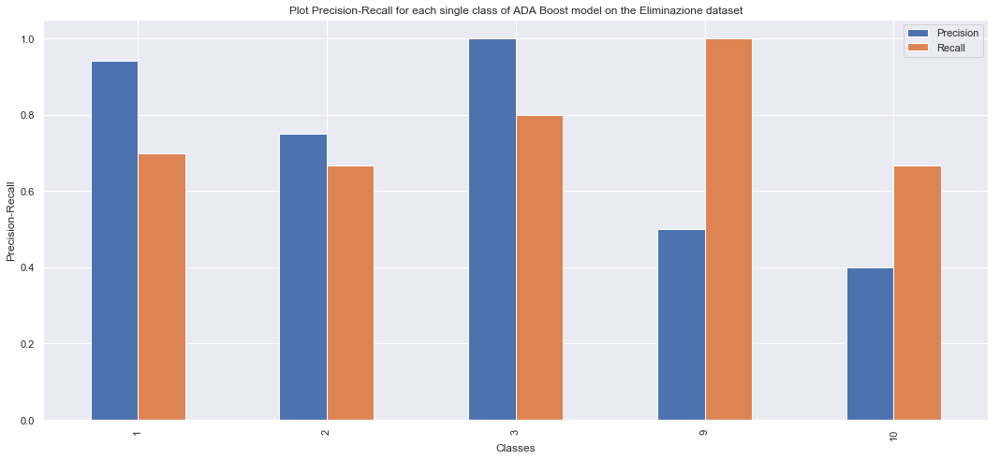

    Precision    Recall
1    0.942308  0.700000
2    0.750000  0.666667
3    1.000000  0.800000
9    0.500000  1.000000
10   0.400000  0.666667


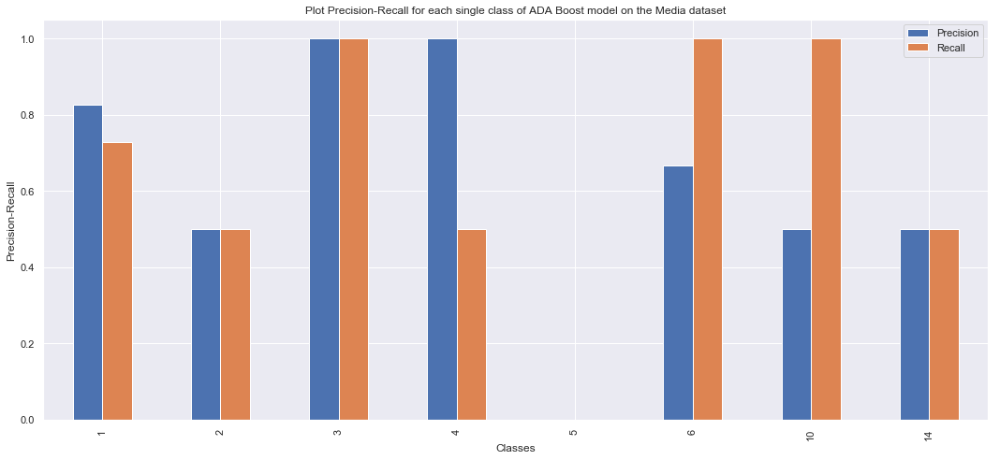

    Precision    Recall
1    0.826923  0.728814
2    0.500000  0.500000
3    1.000000  1.000000
4    1.000000  0.500000
5    0.000000  0.000000
6    0.666667  1.000000
10   0.500000  1.000000
14   0.500000  0.500000


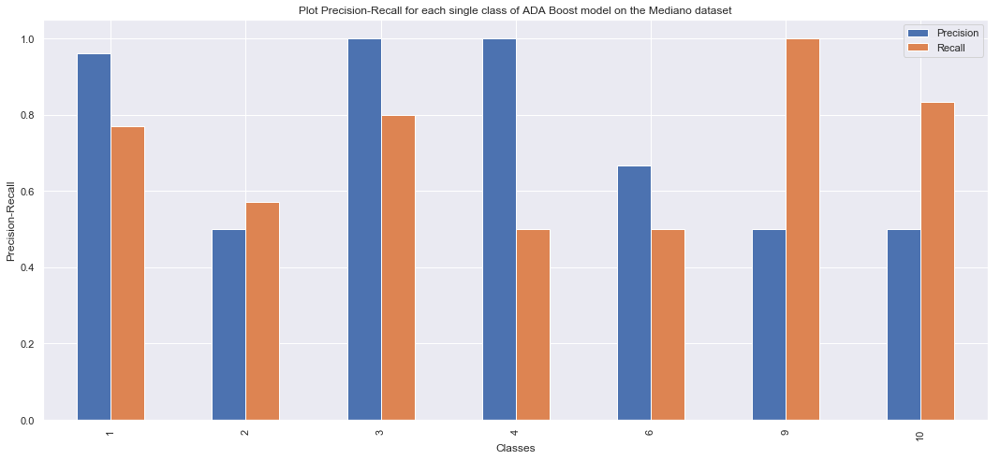

    Precision    Recall
1    0.961538  0.769231
2    0.500000  0.571429
3    1.000000  0.800000
4    1.000000  0.500000
6    0.666667  0.500000
9    0.500000  1.000000
10   0.500000  0.833333


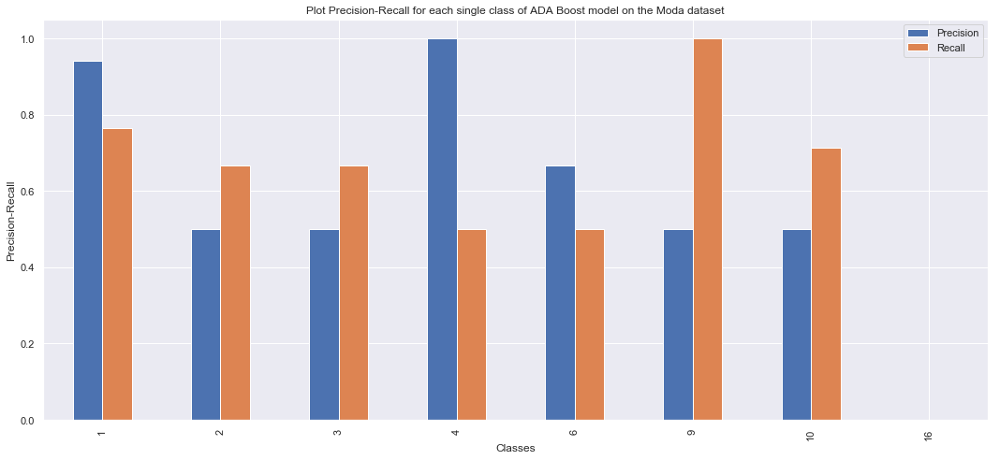

    Precision    Recall
1    0.942308  0.765625
2    0.500000  0.666667
3    0.500000  0.666667
4    1.000000  0.500000
6    0.666667  0.500000
9    0.500000  1.000000
10   0.500000  0.714286
16   0.000000  0.000000


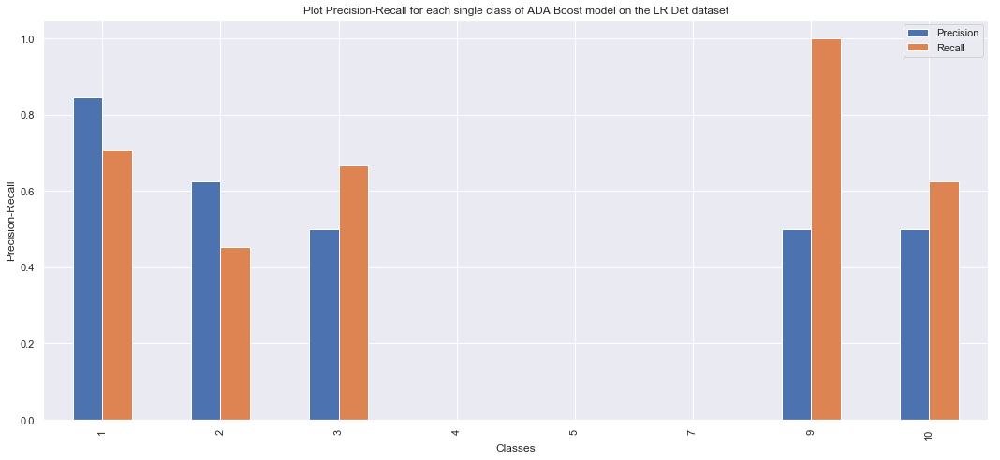

    Precision    Recall
1    0.846154  0.709677
2    0.625000  0.454545
3    0.500000  0.666667
4    0.000000  0.000000
5    0.000000  0.000000
7    0.000000  0.000000
9    0.500000  1.000000
10   0.500000  0.625000


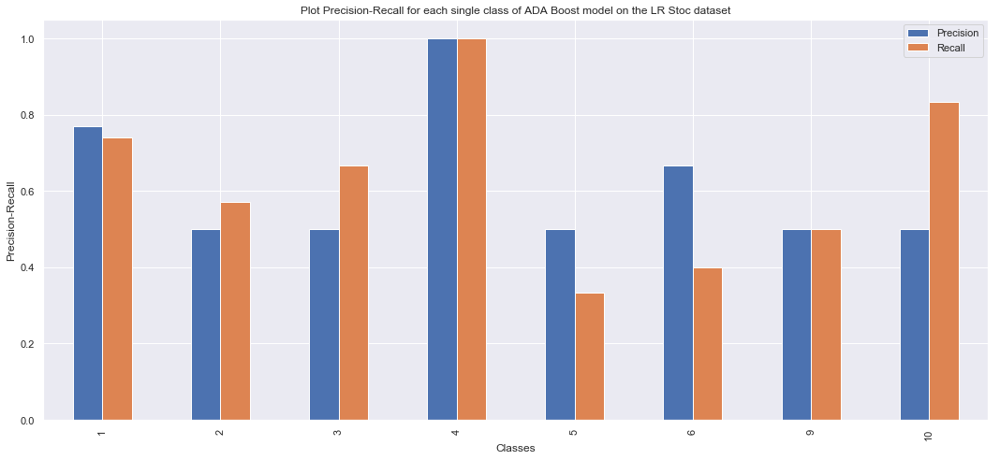

    Precision    Recall
1    0.769231  0.740741
2    0.500000  0.571429
3    0.500000  0.666667
4    1.000000  1.000000
5    0.500000  0.333333
6    0.666667  0.400000
9    0.500000  0.500000
10   0.500000  0.833333


In [162]:
j=0
for i in scores_ada_rfe:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of ADA Boost model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

### Gradient Boosting

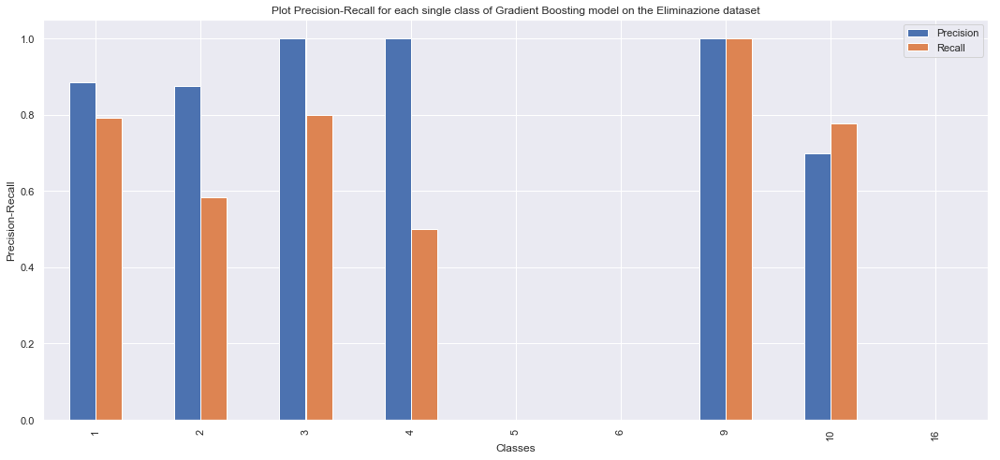

    Precision    Recall
1    0.884615  0.793103
2    0.875000  0.583333
3    1.000000  0.800000
4    1.000000  0.500000
5    0.000000  0.000000
6    0.000000  0.000000
9    1.000000  1.000000
10   0.700000  0.777778
16   0.000000  0.000000


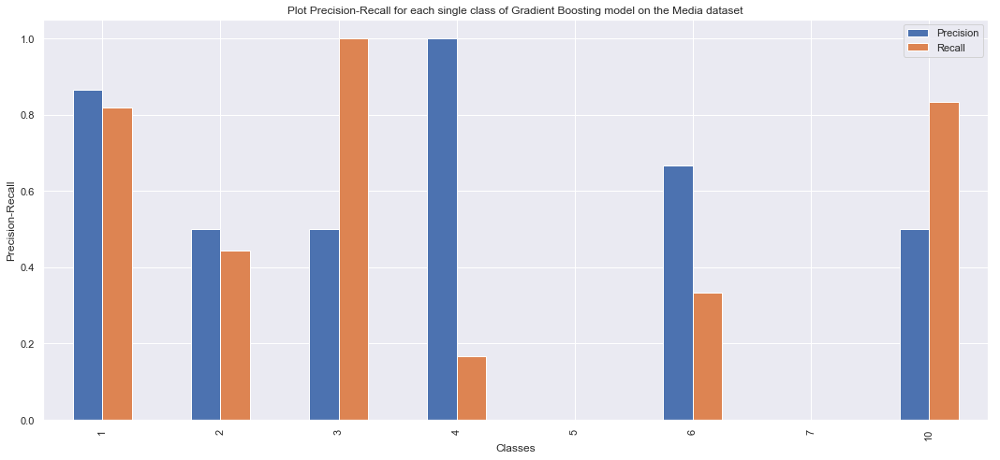

    Precision    Recall
1    0.865385  0.818182
2    0.500000  0.444444
3    0.500000  1.000000
4    1.000000  0.166667
5    0.000000  0.000000
6    0.666667  0.333333
7    0.000000  0.000000
10   0.500000  0.833333


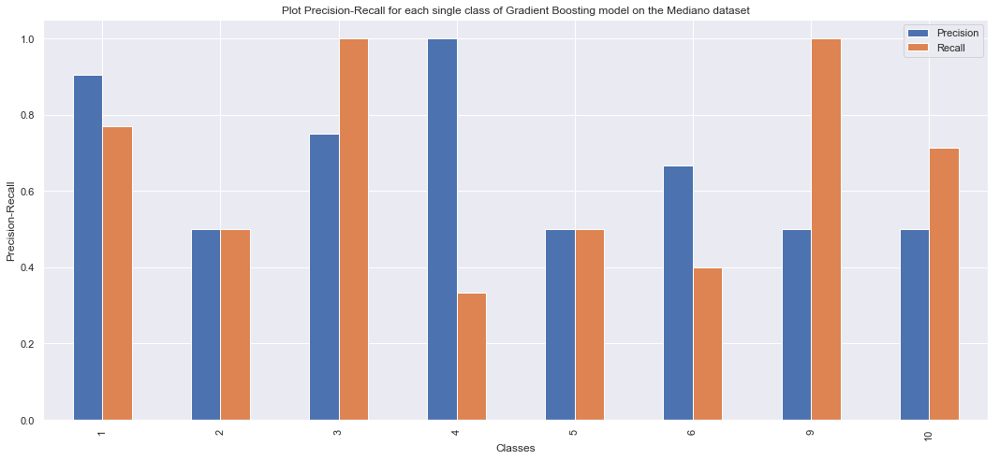

    Precision    Recall
1    0.903846  0.770492
2    0.500000  0.500000
3    0.750000  1.000000
4    1.000000  0.333333
5    0.500000  0.500000
6    0.666667  0.400000
9    0.500000  1.000000
10   0.500000  0.714286


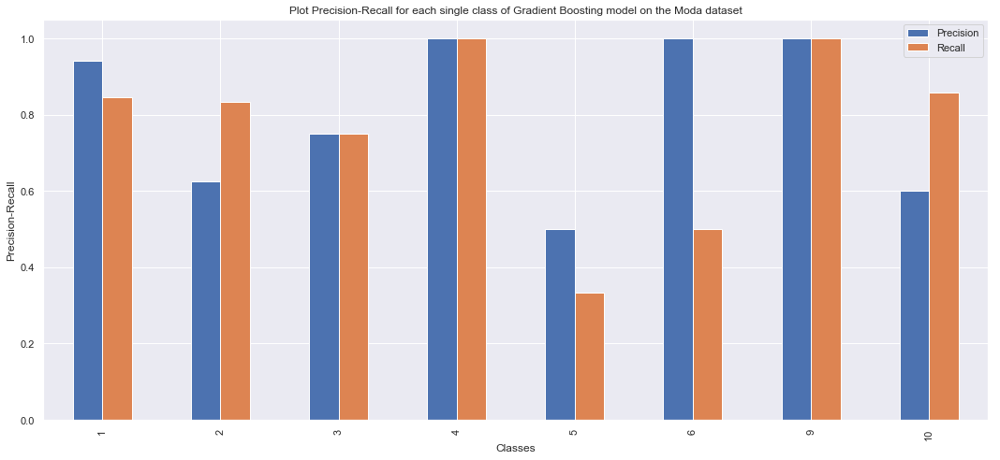

    Precision    Recall
1    0.942308  0.844828
2    0.625000  0.833333
3    0.750000  0.750000
4    1.000000  1.000000
5    0.500000  0.333333
6    1.000000  0.500000
9    1.000000  1.000000
10   0.600000  0.857143


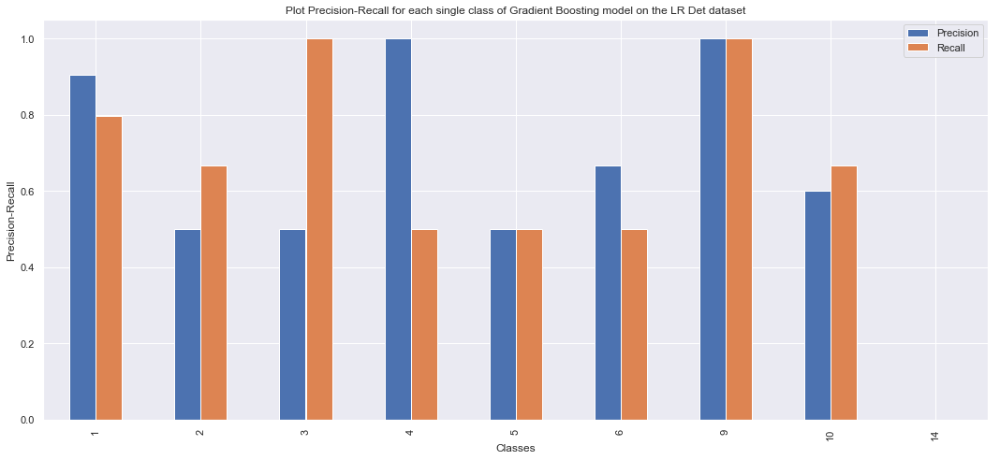

    Precision    Recall
1    0.903846  0.796610
2    0.500000  0.666667
3    0.500000  1.000000
4    1.000000  0.500000
5    0.500000  0.500000
6    0.666667  0.500000
9    1.000000  1.000000
10   0.600000  0.666667
14   0.000000  0.000000


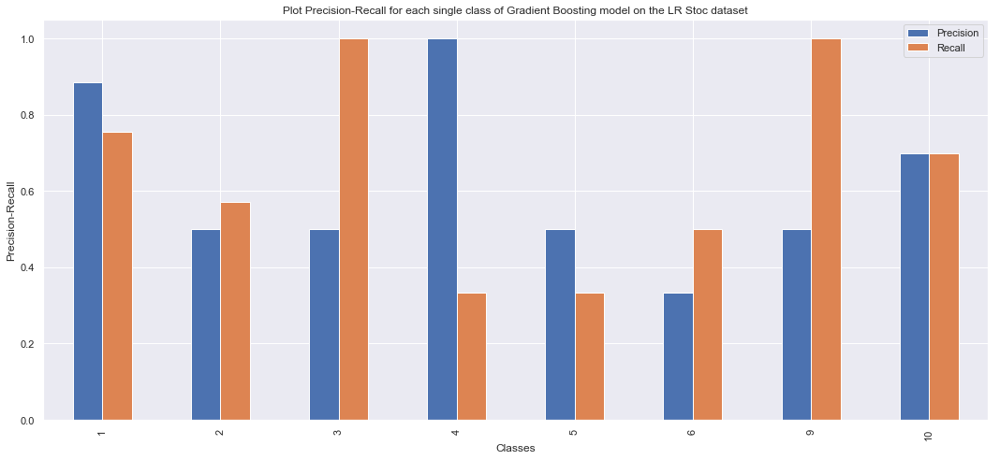

    Precision    Recall
1    0.884615  0.754098
2    0.500000  0.571429
3    0.500000  1.000000
4    1.000000  0.333333
5    0.500000  0.333333
6    0.333333  0.500000
9    0.500000  1.000000
10   0.700000  0.700000


In [163]:
j=0
for i in scores_gb_rfe:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of Gradient Boosting model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

### Extra Tree

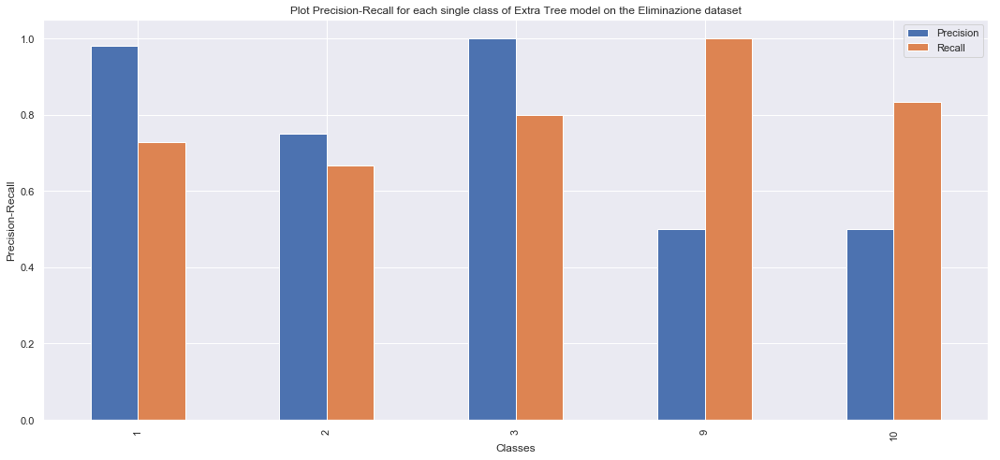

    Precision    Recall
1    0.980769  0.728571
2    0.750000  0.666667
3    1.000000  0.800000
9    0.500000  1.000000
10   0.500000  0.833333


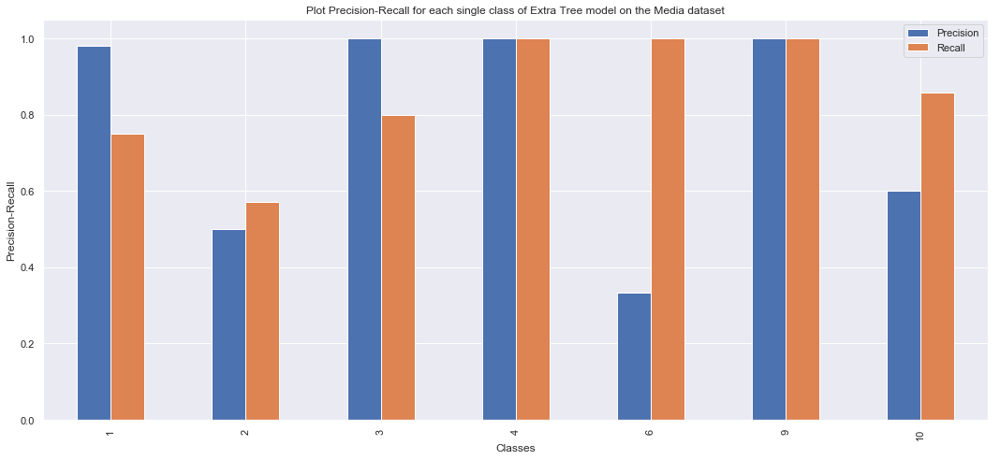

    Precision    Recall
1    0.980769  0.750000
2    0.500000  0.571429
3    1.000000  0.800000
4    1.000000  1.000000
6    0.333333  1.000000
9    1.000000  1.000000
10   0.600000  0.857143


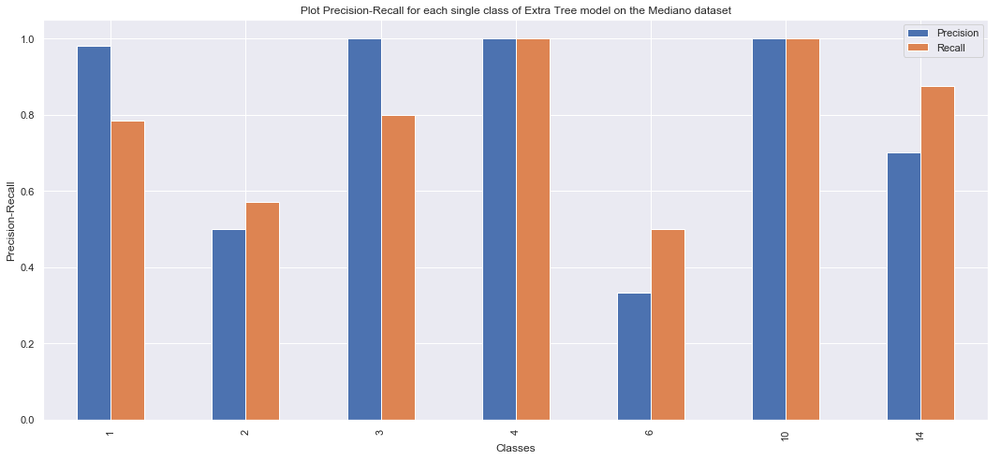

    Precision    Recall
1    0.980769  0.784615
2    0.500000  0.571429
3    1.000000  0.800000
4    1.000000  1.000000
6    0.333333  0.500000
10   1.000000  1.000000
14   0.700000  0.875000


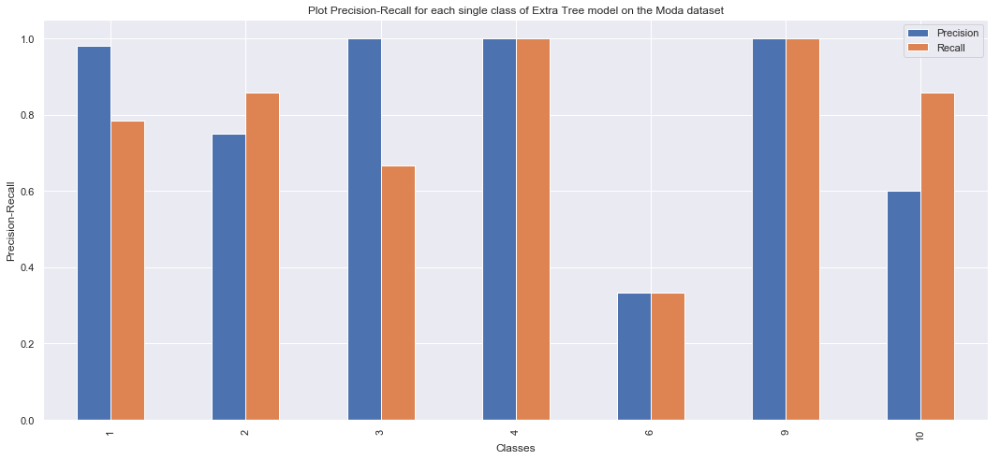

    Precision    Recall
1    0.980769  0.784615
2    0.750000  0.857143
3    1.000000  0.666667
4    1.000000  1.000000
6    0.333333  0.333333
9    1.000000  1.000000
10   0.600000  0.857143


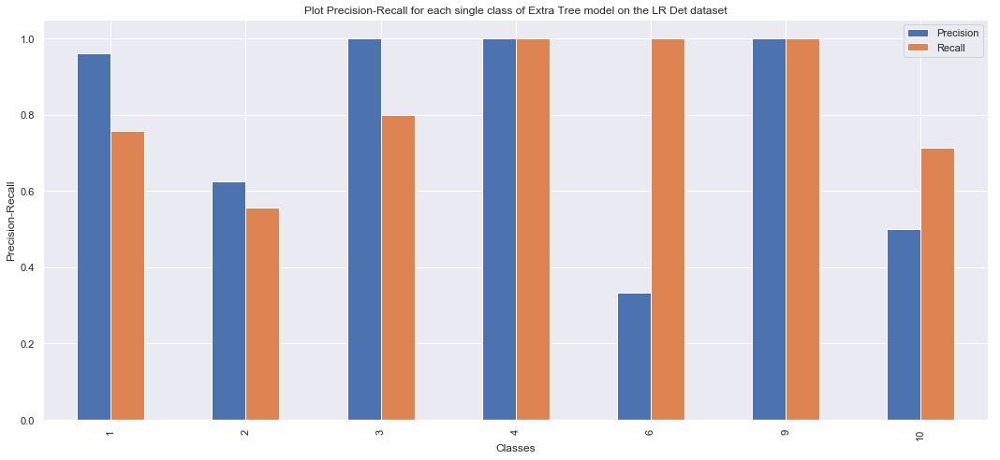

    Precision    Recall
1    0.961538  0.757576
2    0.625000  0.555556
3    1.000000  0.800000
4    1.000000  1.000000
6    0.333333  1.000000
9    1.000000  1.000000
10   0.500000  0.714286


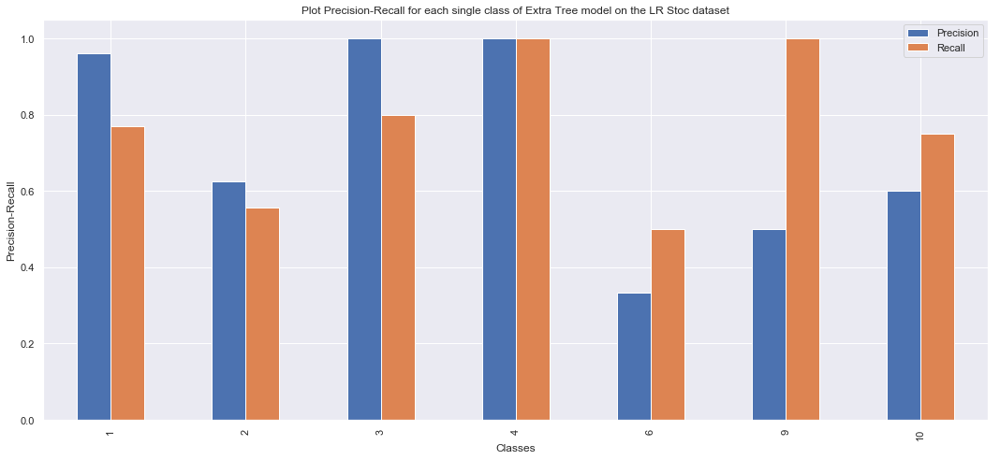

    Precision    Recall
1    0.961538  0.769231
2    0.625000  0.555556
3    1.000000  0.800000
4    1.000000  1.000000
6    0.333333  0.500000
9    0.500000  1.000000
10   0.600000  0.750000


In [164]:
j=0
for i in scores_et_rfe:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of Extra Tree model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

### Extreme Gradient Boosting

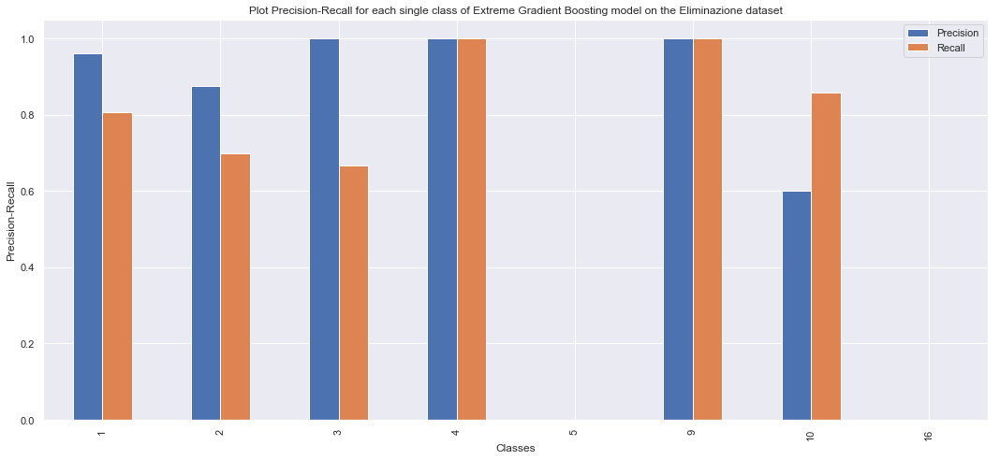

    Precision    Recall
1    0.961538  0.806452
2    0.875000  0.700000
3    1.000000  0.666667
4    1.000000  1.000000
5    0.000000  0.000000
9    1.000000  1.000000
10   0.600000  0.857143
16   0.000000  0.000000


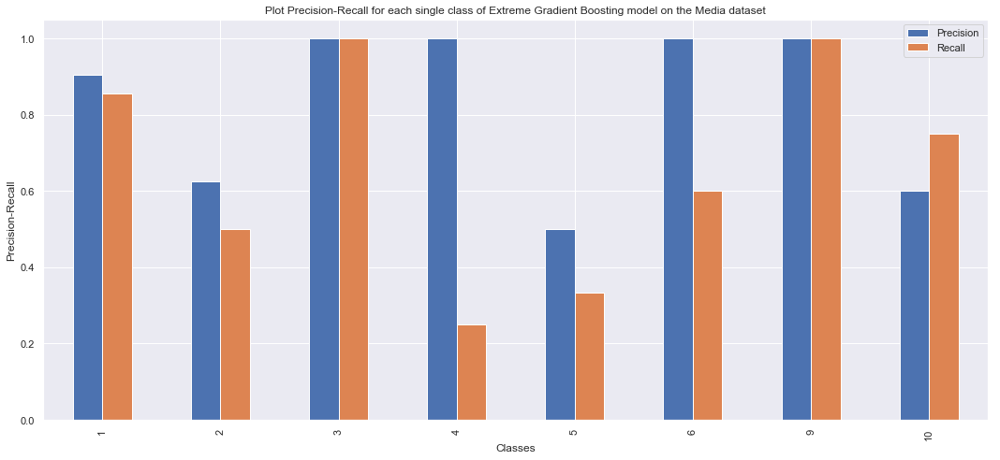

    Precision    Recall
1    0.903846  0.854545
2    0.625000  0.500000
3    1.000000  1.000000
4    1.000000  0.250000
5    0.500000  0.333333
6    1.000000  0.600000
9    1.000000  1.000000
10   0.600000  0.750000


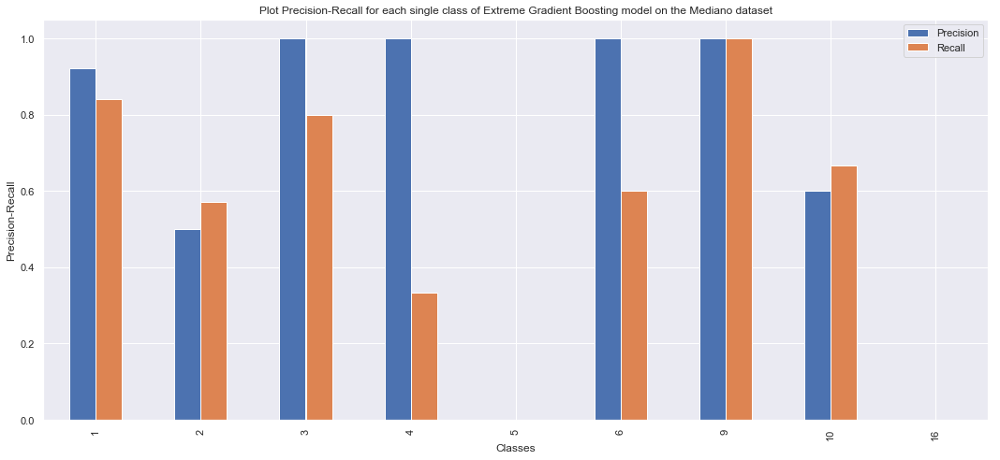

    Precision    Recall
1    0.923077  0.842105
2    0.500000  0.571429
3    1.000000  0.800000
4    1.000000  0.333333
5    0.000000  0.000000
6    1.000000  0.600000
9    1.000000  1.000000
10   0.600000  0.666667
16   0.000000  0.000000


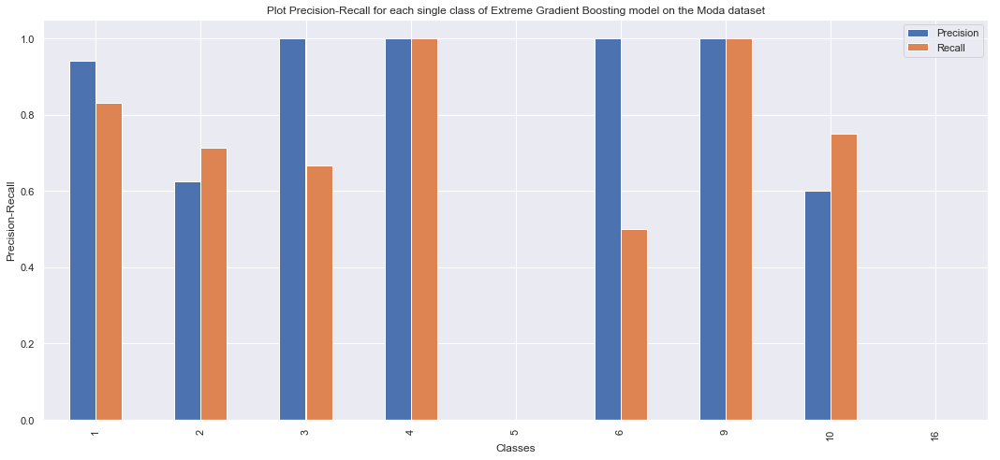

    Precision    Recall
1    0.942308  0.830508
2    0.625000  0.714286
3    1.000000  0.666667
4    1.000000  1.000000
5    0.000000  0.000000
6    1.000000  0.500000
9    1.000000  1.000000
10   0.600000  0.750000
16   0.000000  0.000000


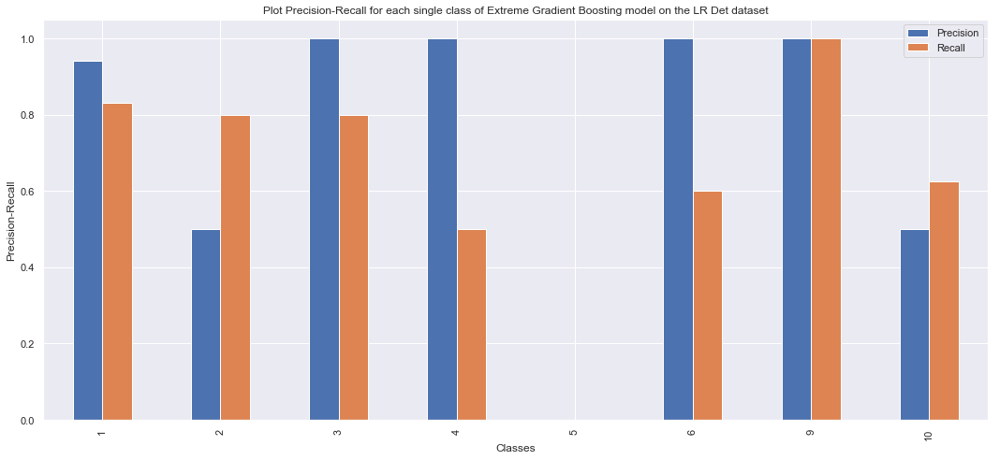

    Precision    Recall
1    0.942308  0.830508
2    0.500000  0.800000
3    1.000000  0.800000
4    1.000000  0.500000
5    0.000000  0.000000
6    1.000000  0.600000
9    1.000000  1.000000
10   0.500000  0.625000


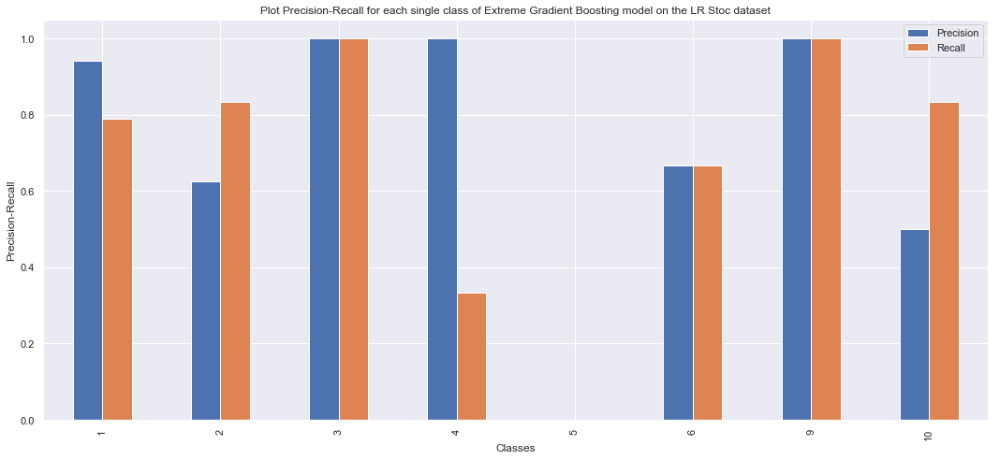

    Precision    Recall
1    0.942308  0.790323
2    0.625000  0.833333
3    1.000000  1.000000
4    1.000000  0.333333
5    0.000000  0.000000
6    0.666667  0.666667
9    1.000000  1.000000
10   0.500000  0.833333


In [165]:
j=0
for i in scores_xgb_rfe:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of Extreme Gradient Boosting model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1


<a id="BOOSTRFESCORES"></a>
<h3> Risultati e confronti tra i diversi Algoritmi di Boosting utilizzando RFE per la Feature Selection in termini di Accuracy, Precision e Recall  <a href="#indice" style="text-decoration:none;">↑</a></h3>



## Total Recalls

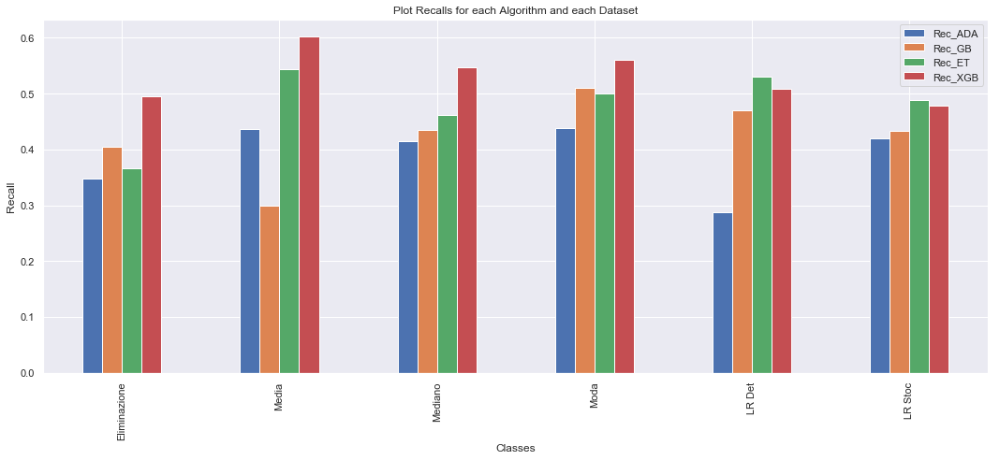

               Rec_ADA    Rec_GB    Rec_ET   Rec_XGB
Eliminazione  0.348485  0.404929  0.366234  0.494231
Media         0.435734  0.299663  0.543506  0.602622
Mediano       0.414499  0.434843  0.460920  0.547552
Moda          0.437568  0.509886  0.499900  0.560664
LR Det        0.287991  0.469162  0.529765  0.509081
LR Stoc       0.420459  0.432683  0.488617  0.477831


In [166]:

fig, ax = plt.subplots(figsize=(15,7))
ensemble_rfe_df[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Recalls for each Algorithm and each Dataset")
ax.set_ylabel('Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_rfe_df[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']])


## Total Precisions

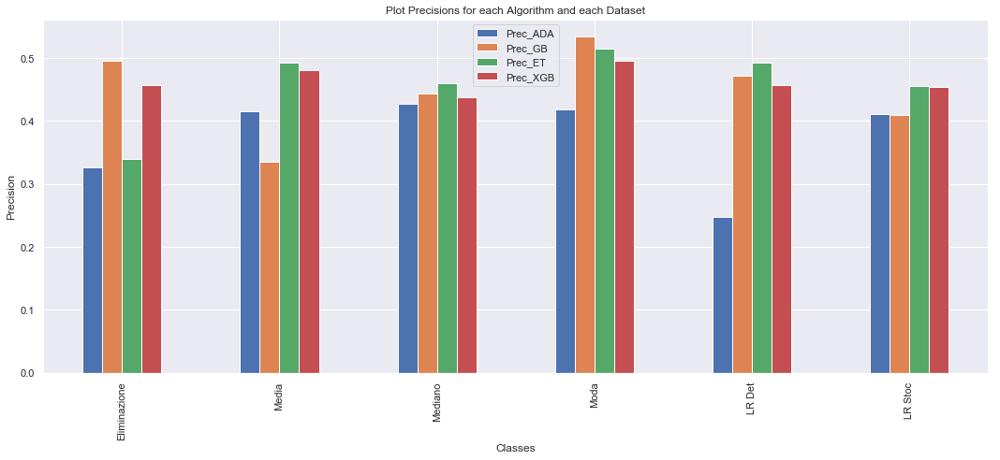

              Prec_ADA   Prec_GB   Prec_ET  Prec_XGB
Eliminazione  0.326573  0.496329  0.339161  0.457296
Media         0.416132  0.336004  0.492191  0.480716
Mediano       0.427350  0.443376  0.459509  0.437594
Moda          0.418998  0.534776  0.514918  0.496496
LR Det        0.247596  0.472543  0.492716  0.457403
LR Stoc       0.411325  0.409829  0.456352  0.454749


In [167]:

fig, ax = plt.subplots(figsize=(15,7))
ensemble_rfe_df[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Precisions for each Algorithm and each Dataset")
ax.set_ylabel('Precision')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_rfe_df[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']])


## Total Accuracies

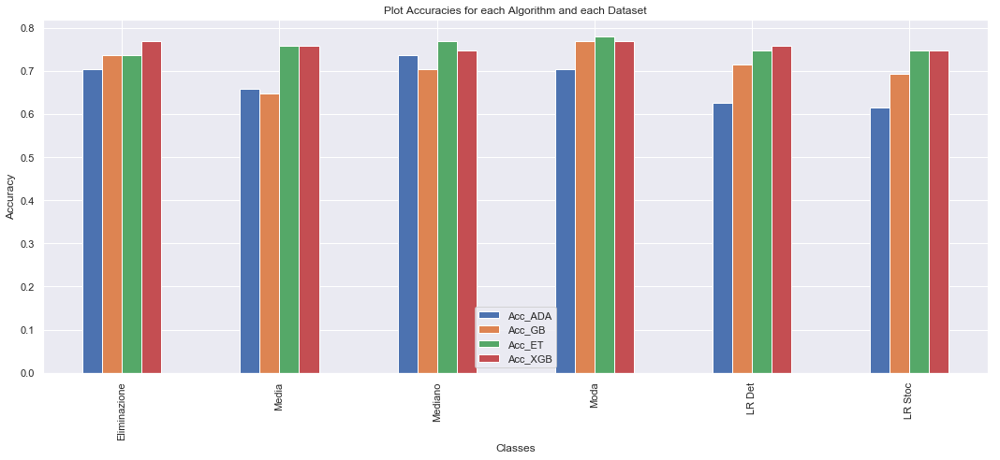

               Acc_ADA    Acc_GB    Acc_ET   Acc_XGB
Eliminazione  0.703297  0.736264  0.736264  0.769231
Media         0.659341  0.648352  0.758242  0.758242
Mediano       0.736264  0.703297  0.769231  0.747253
Moda          0.703297  0.769231  0.780220  0.769231
LR Det        0.626374  0.714286  0.747253  0.758242
LR Stoc       0.615385  0.692308  0.747253  0.747253


In [168]:

fig, ax = plt.subplots(figsize=(15,7))
ensemble_rfe_df[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_rfe_df[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']])



<a id="BOOSTPCA"></a>
<h3> Boosting utilizzando PCA <a href="#indice" style="text-decoration:none;">↑</a></h3>



In [ ]:
scores_ada_pca,scores_gb_pca,scores_et_pca,scores_xgb_pca = training_testing_boosting_algorithms_PCA(Datasets,imputations)

In [170]:
ensemble_pca_df = pd.DataFrame()

ensemble_pca_df['Acc_ADA'] =  [scores_ada_pca[0][0]] + [scores_ada_pca[1][0]]+[scores_ada_pca[2][0]]+[scores_ada_pca[3][0]]+[scores_ada_pca[4][0]]+[scores_ada_pca[5][0]]
ensemble_pca_df['Rec_ADA'] =  [scores_ada_pca[0][1]] + [scores_ada_pca[1][1]]+[scores_ada_pca[2][1]]+[scores_ada_pca[3][1]]+[scores_ada_pca[4][1]]+[scores_ada_pca[5][1]]
ensemble_pca_df['Prec_ADA'] =  [scores_ada_pca[0][2]] + [scores_ada_pca[1][2]]+[scores_ada_pca[2][2]]+[scores_ada_pca[3][2]]+[scores_ada_pca[4][2]]+[scores_ada_pca[5][2]]

ensemble_pca_df['Acc_GB'] =  [scores_gb_pca[0][0]] + [scores_gb_pca[1][0]]+[scores_gb_pca[2][0]]+[scores_gb_pca[3][0]]+[scores_gb_pca[4][0]]+[scores_gb_pca[5][0]]
ensemble_pca_df['Rec_GB'] =  [scores_gb_pca[0][1]] + [scores_gb_pca[1][1]]+[scores_gb_pca[2][1]]+[scores_gb_pca[3][1]]+[scores_gb_pca[4][1]]+[scores_gb_pca[5][1]]
ensemble_pca_df['Prec_GB'] =  [scores_gb_pca[0][2]] + [scores_gb_pca[1][2]]+[scores_gb_pca[2][2]]+[scores_gb_pca[3][2]]+[scores_gb_pca[4][2]]+[scores_gb_pca[5][2]]

ensemble_pca_df['Acc_ET'] =  [scores_et_pca[0][0]] + [scores_et_pca[1][0]]+[scores_et_pca[2][0]]+[scores_et_pca[3][0]]+[scores_et_pca[4][0]]+[scores_et_pca[5][0]]
ensemble_pca_df['Rec_ET'] =  [scores_et_pca[0][1]] + [scores_et_pca[1][1]]+[scores_et_pca[2][1]]+[scores_et_pca[3][1]]+[scores_et_pca[4][1]]+[scores_et_pca[5][1]]
ensemble_pca_df['Prec_ET'] =  [scores_et_pca[0][2]] + [scores_et_pca[1][2]]+[scores_et_pca[2][2]]+[scores_et_pca[3][2]]+[scores_et_pca[4][2]]+[scores_et_pca[5][2]]

ensemble_pca_df['Acc_XGB'] =  [scores_xgb_pca[0][0]] + [scores_xgb_pca[1][0]]+[scores_xgb_pca[2][0]]+[scores_xgb_pca[3][0]]+[scores_xgb_pca[4][0]]+[scores_xgb_pca[5][0]]
ensemble_pca_df['Rec_XGB'] =  [scores_xgb_pca[0][1]] + [scores_xgb_pca[1][1]]+[scores_xgb_pca[2][1]]+[scores_xgb_pca[3][1]]+[scores_xgb_pca[4][1]]+[scores_xgb_pca[5][1]]
ensemble_pca_df['Prec_XGB'] =  [scores_xgb_pca[0][2]] + [scores_xgb_pca[1][2]]+[scores_xgb_pca[2][2]]+[scores_xgb_pca[3][2]]+[scores_xgb_pca[4][2]]+[scores_xgb_pca[5][2]]

In [171]:
ensemble_pca_df = ensemble_pca_df.set_index([imputations])

### Plotting delle precision e recall sulle singole classi per ogni modello e per ogni dataset 

## ADA Boost

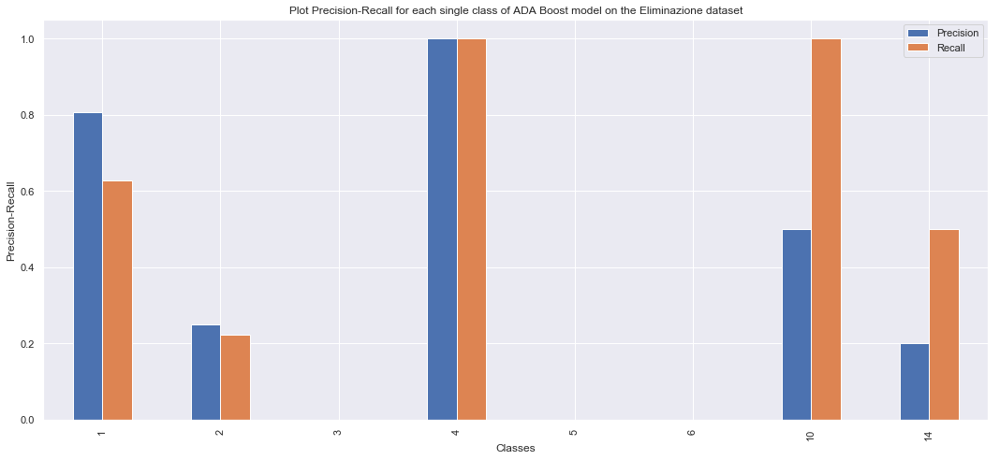

    Precision    Recall
1    0.807692  0.626866
2    0.250000  0.222222
3    0.000000  0.000000
4    1.000000  1.000000
5    0.000000  0.000000
6    0.000000  0.000000
10   0.500000  1.000000
14   0.200000  0.500000


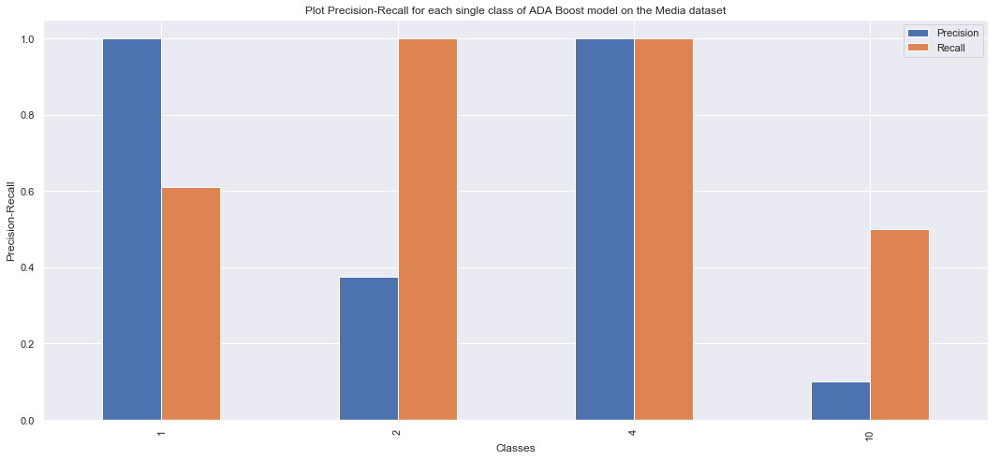

    Precision    Recall
1       1.000  0.611765
2       0.375  1.000000
4       1.000  1.000000
10      0.100  0.500000


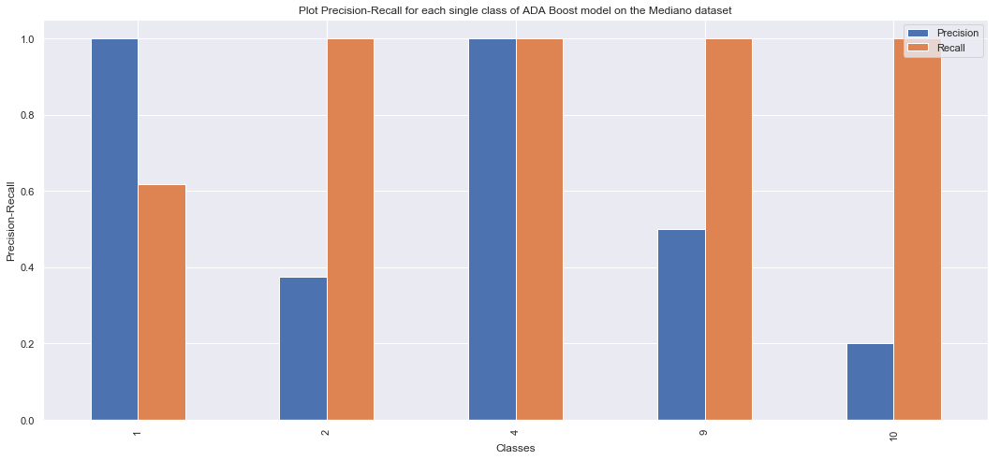

    Precision    Recall
1       1.000  0.619048
2       0.375  1.000000
4       1.000  1.000000
9       0.500  1.000000
10      0.200  1.000000


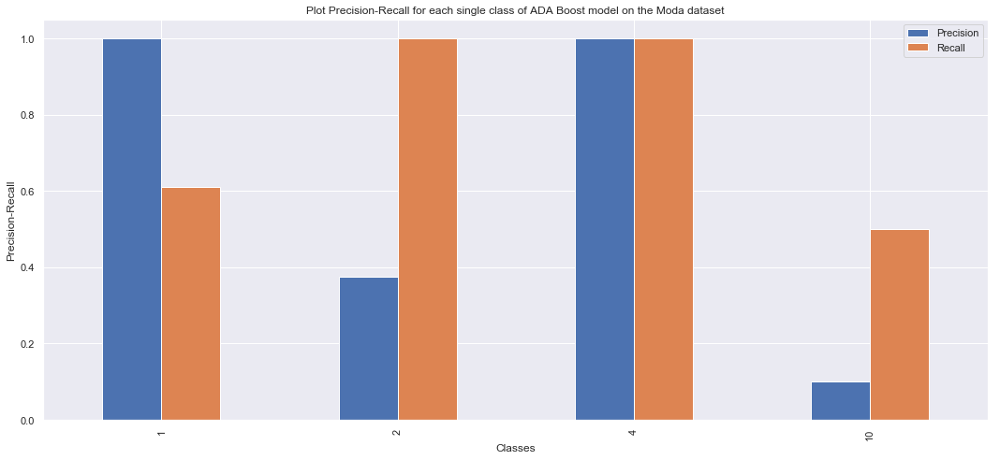

    Precision    Recall
1       1.000  0.611765
2       0.375  1.000000
4       1.000  1.000000
10      0.100  0.500000


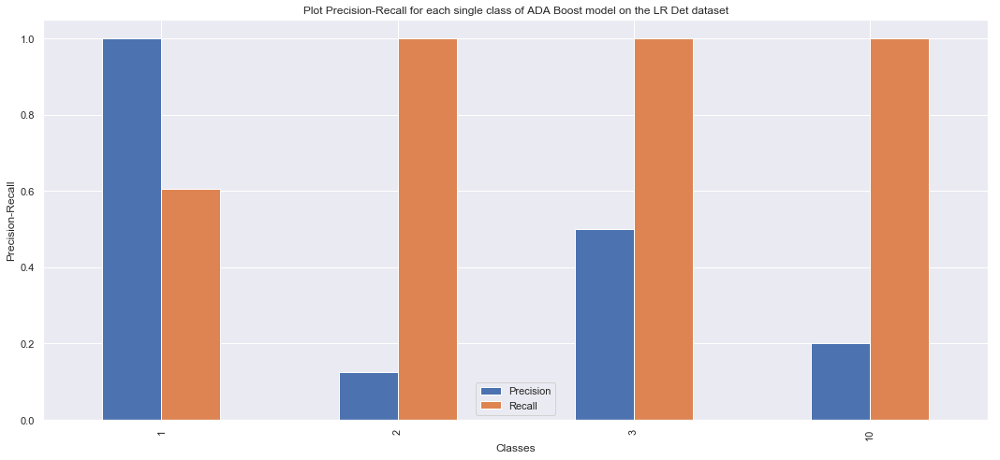

    Precision    Recall
1       1.000  0.604651
2       0.125  1.000000
3       0.500  1.000000
10      0.200  1.000000


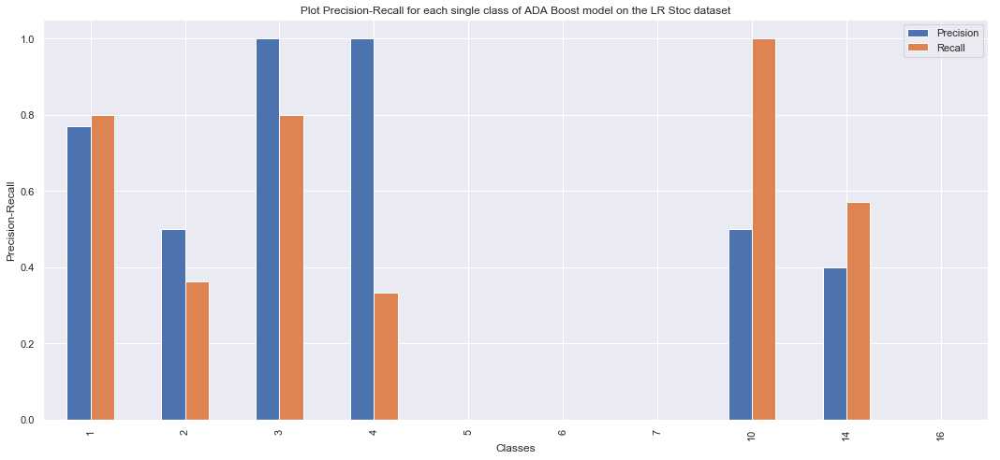

    Precision    Recall
1    0.769231  0.800000
2    0.500000  0.363636
3    1.000000  0.800000
4    1.000000  0.333333
5    0.000000  0.000000
6    0.000000  0.000000
7    0.000000  0.000000
10   0.500000  1.000000
14   0.400000  0.571429
16   0.000000  0.000000


In [172]:
j=0
for i in scores_ada_pca:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of ADA Boost model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

## Gradient Boosting

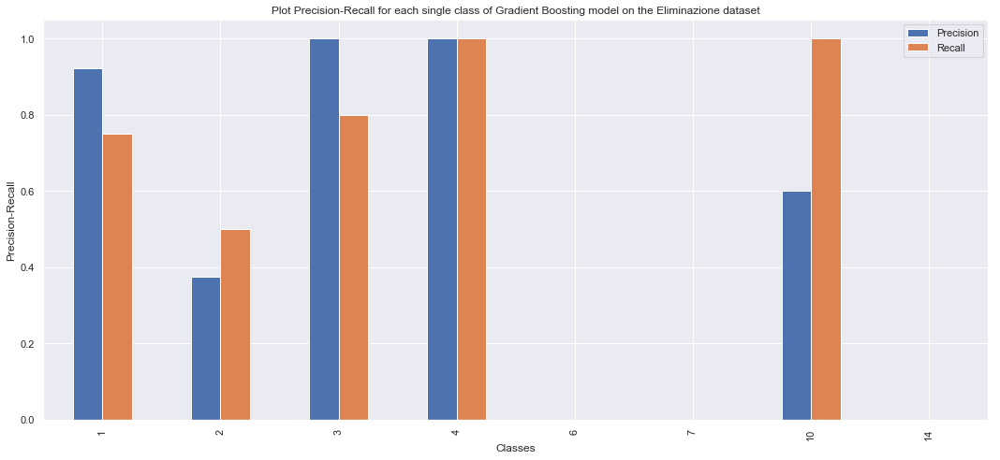

    Precision  Recall
1    0.923077    0.75
2    0.375000    0.50
3    1.000000    0.80
4    1.000000    1.00
6    0.000000    0.00
7    0.000000    0.00
10   0.600000    1.00
14   0.000000    0.00


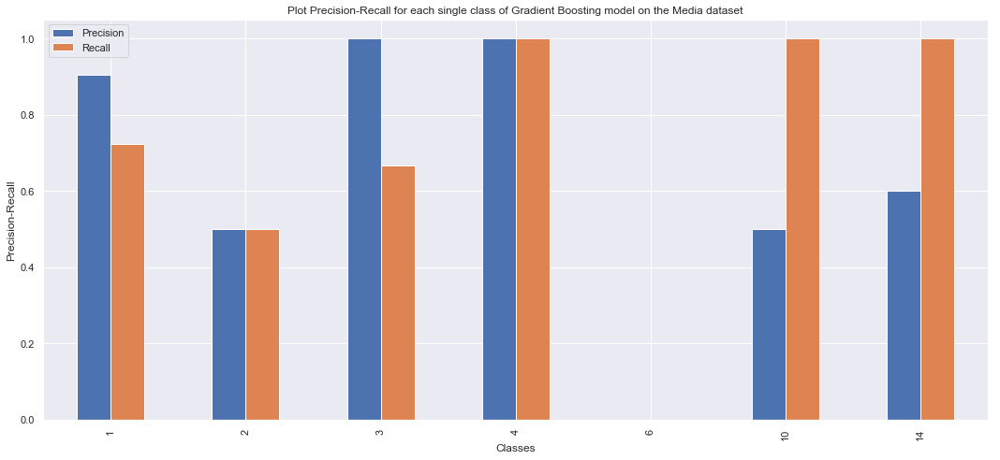

    Precision    Recall
1    0.903846  0.723077
2    0.500000  0.500000
3    1.000000  0.666667
4    1.000000  1.000000
6    0.000000  0.000000
10   0.500000  1.000000
14   0.600000  1.000000


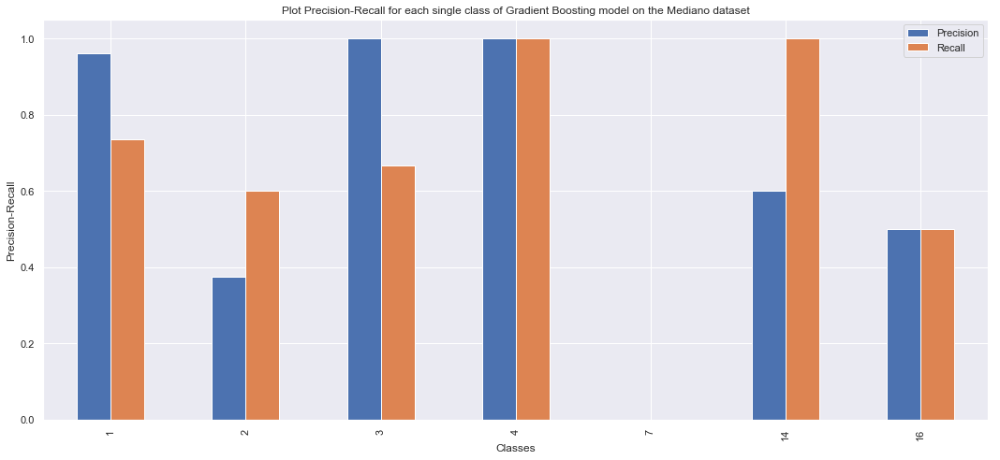

    Precision    Recall
1    0.961538  0.735294
2    0.375000  0.600000
3    1.000000  0.666667
4    1.000000  1.000000
7    0.000000  0.000000
14   0.600000  1.000000
16   0.500000  0.500000


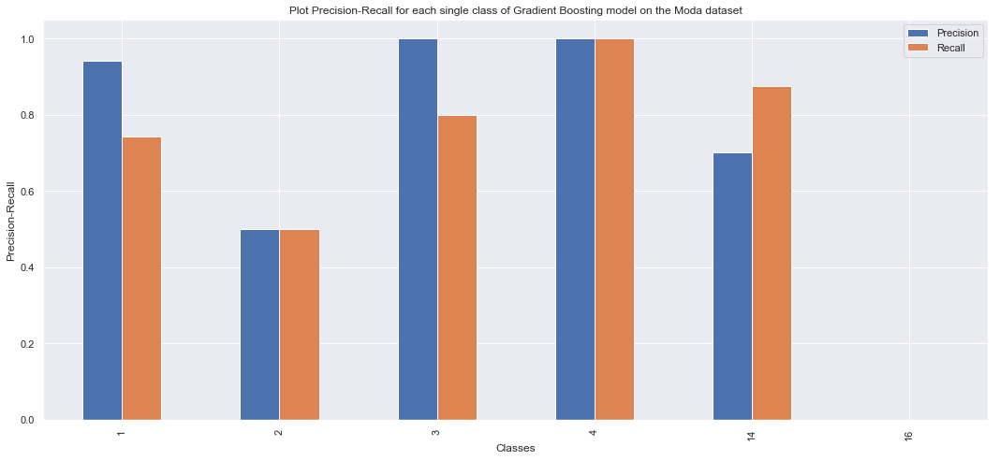

    Precision    Recall
1    0.942308  0.742424
2    0.500000  0.500000
3    1.000000  0.800000
4    1.000000  1.000000
14   0.700000  0.875000
16   0.000000  0.000000


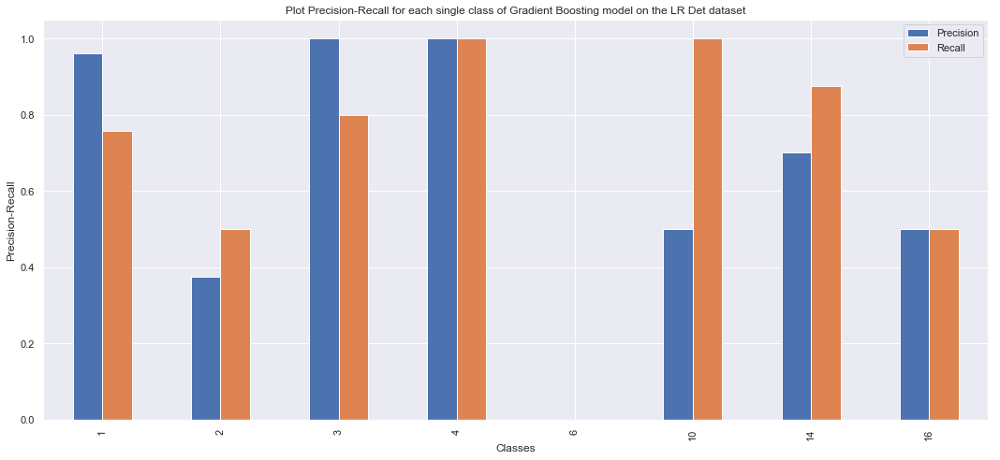

    Precision    Recall
1    0.961538  0.757576
2    0.375000  0.500000
3    1.000000  0.800000
4    1.000000  1.000000
6    0.000000  0.000000
10   0.500000  1.000000
14   0.700000  0.875000
16   0.500000  0.500000


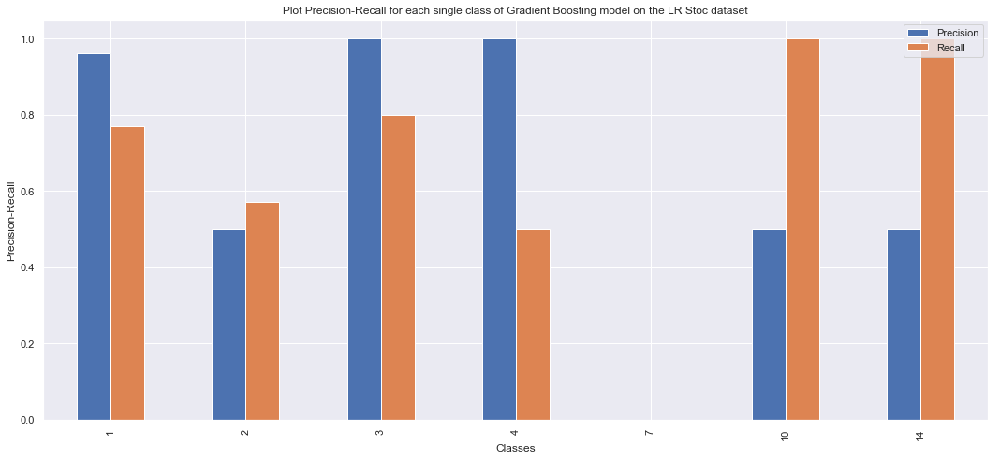

    Precision    Recall
1    0.961538  0.769231
2    0.500000  0.571429
3    1.000000  0.800000
4    1.000000  0.500000
7    0.000000  0.000000
10   0.500000  1.000000
14   0.500000  1.000000


In [173]:
j=0
for i in scores_gb_pca:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of Gradient Boosting model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

## Extra Tree

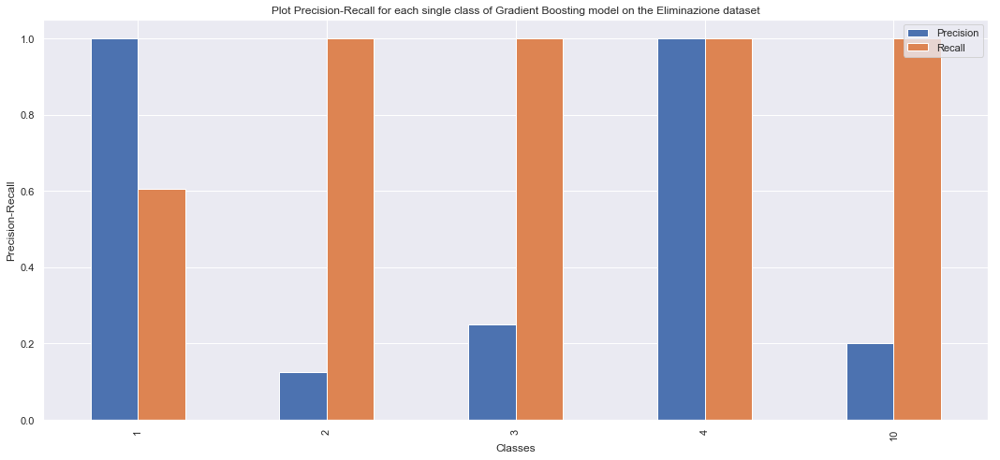

    Precision    Recall
1       1.000  0.604651
2       0.125  1.000000
3       0.250  1.000000
4       1.000  1.000000
10      0.200  1.000000


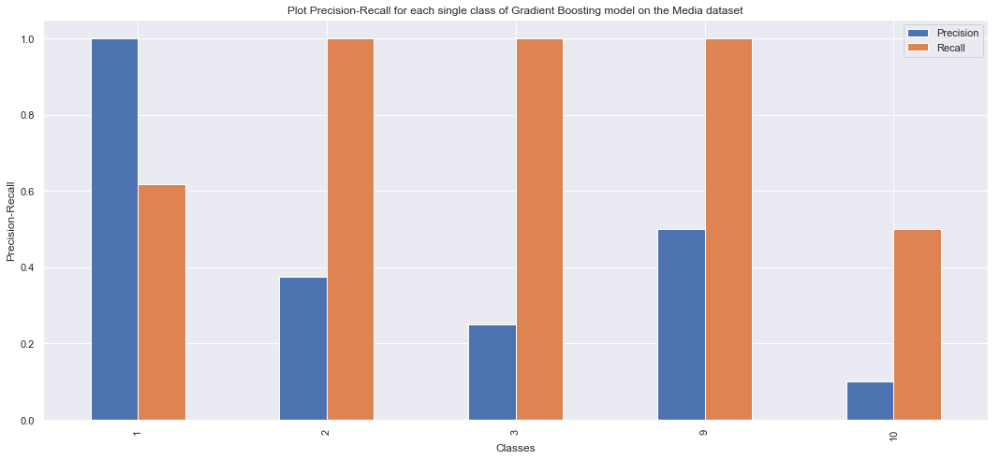

    Precision    Recall
1       1.000  0.619048
2       0.375  1.000000
3       0.250  1.000000
9       0.500  1.000000
10      0.100  0.500000


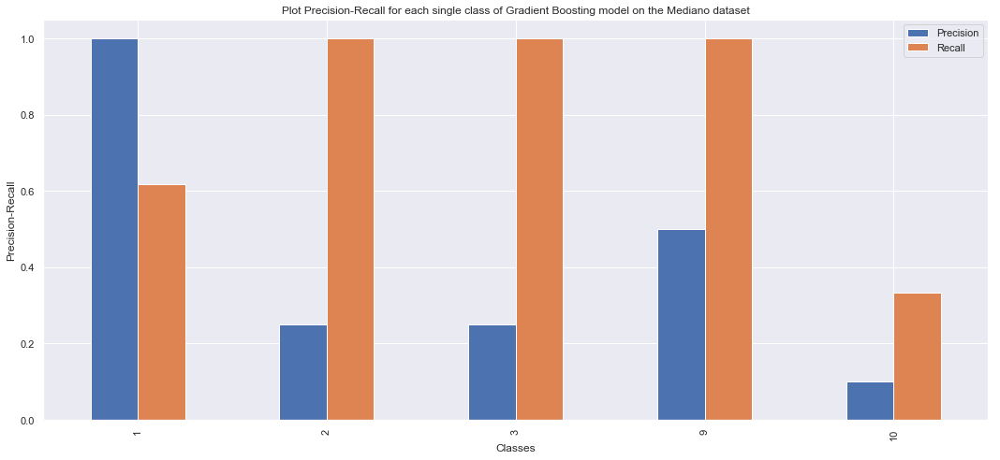

    Precision    Recall
1        1.00  0.619048
2        0.25  1.000000
3        0.25  1.000000
9        0.50  1.000000
10       0.10  0.333333


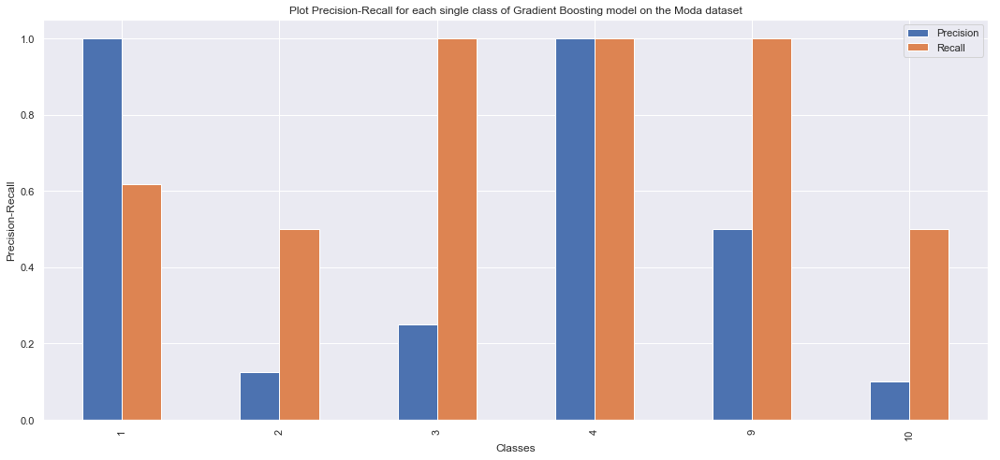

    Precision    Recall
1       1.000  0.619048
2       0.125  0.500000
3       0.250  1.000000
4       1.000  1.000000
9       0.500  1.000000
10      0.100  0.500000


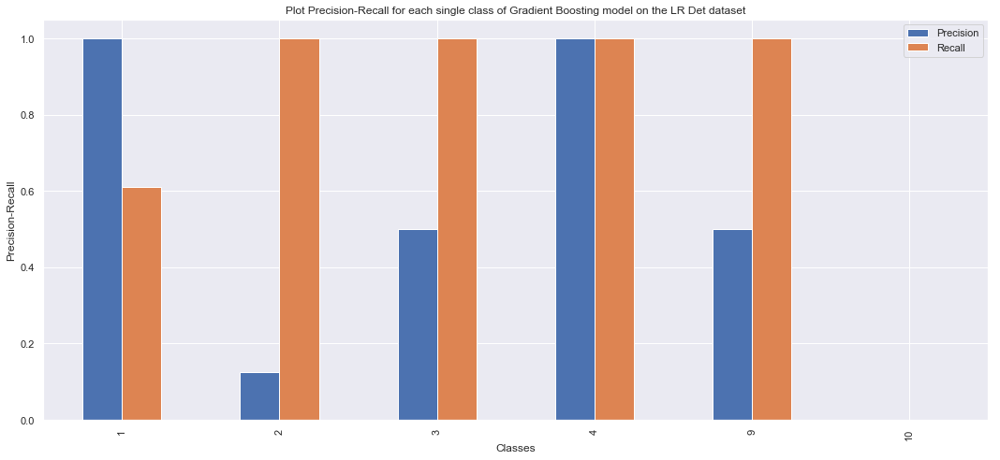

    Precision    Recall
1       1.000  0.611765
2       0.125  1.000000
3       0.500  1.000000
4       1.000  1.000000
9       0.500  1.000000
10      0.000  0.000000


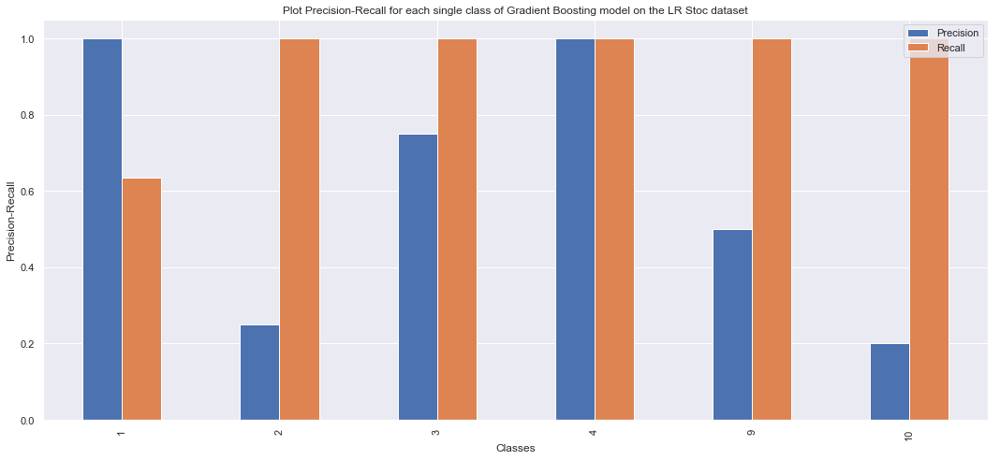

    Precision    Recall
1        1.00  0.634146
2        0.25  1.000000
3        0.75  1.000000
4        1.00  1.000000
9        0.50  1.000000
10       0.20  1.000000


In [174]:
j=0
for i in scores_et_pca:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of Gradient Boosting model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

## Extreme Gradient Boosting

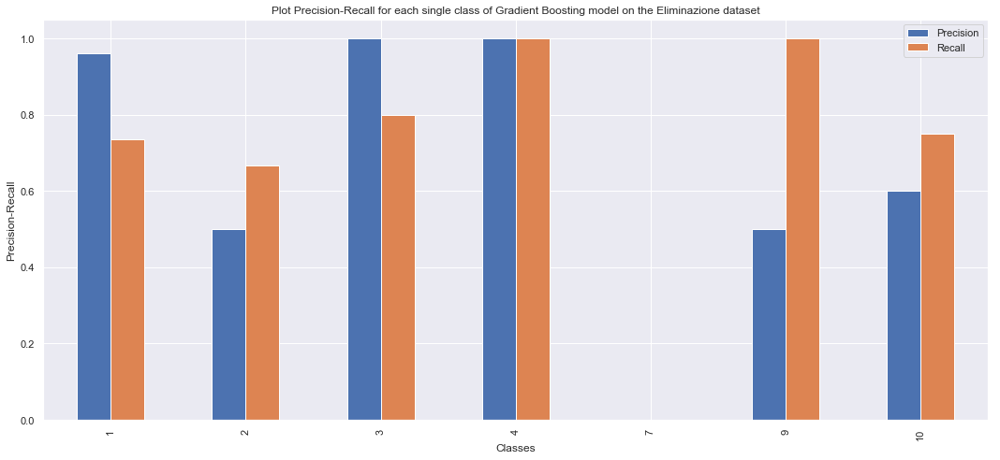

    Precision    Recall
1    0.961538  0.735294
2    0.500000  0.666667
3    1.000000  0.800000
4    1.000000  1.000000
7    0.000000  0.000000
9    0.500000  1.000000
10   0.600000  0.750000


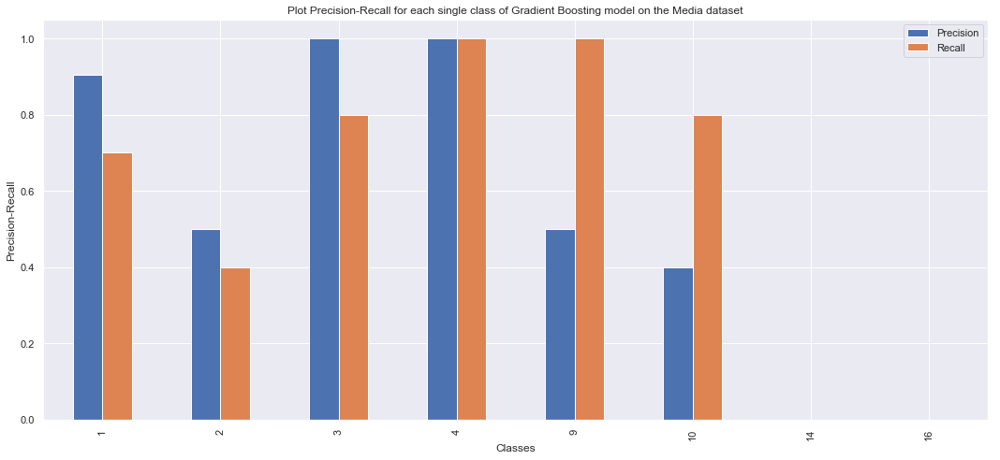

    Precision    Recall
1    0.903846  0.701493
2    0.500000  0.400000
3    1.000000  0.800000
4    1.000000  1.000000
9    0.500000  1.000000
10   0.400000  0.800000
14   0.000000  0.000000
16   0.000000  0.000000


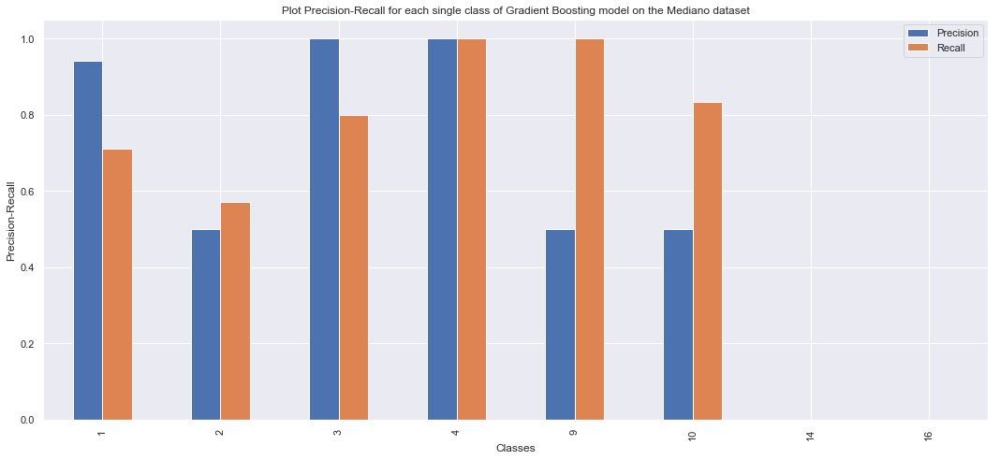

    Precision    Recall
1    0.942308  0.710145
2    0.500000  0.571429
3    1.000000  0.800000
4    1.000000  1.000000
9    0.500000  1.000000
10   0.500000  0.833333
14   0.000000  0.000000
16   0.000000  0.000000


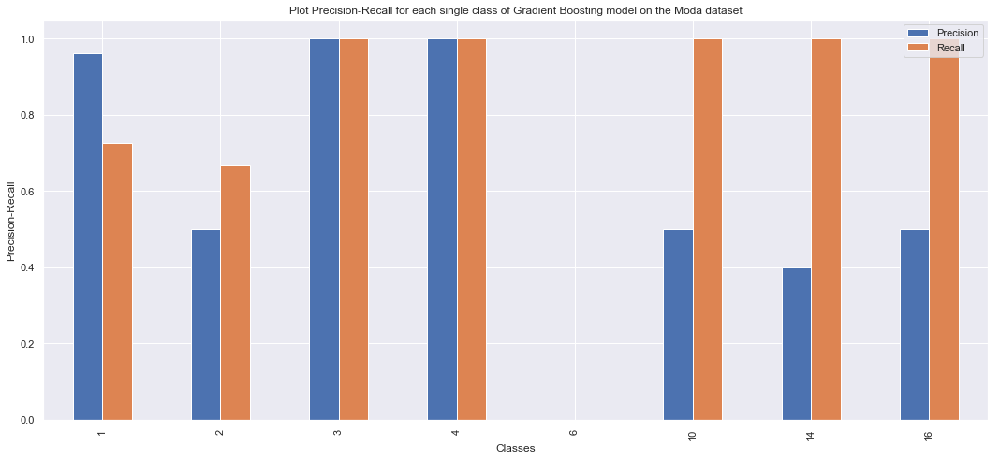

    Precision    Recall
1    0.961538  0.724638
2    0.500000  0.666667
3    1.000000  1.000000
4    1.000000  1.000000
6    0.000000  0.000000
10   0.500000  1.000000
14   0.400000  1.000000
16   0.500000  1.000000


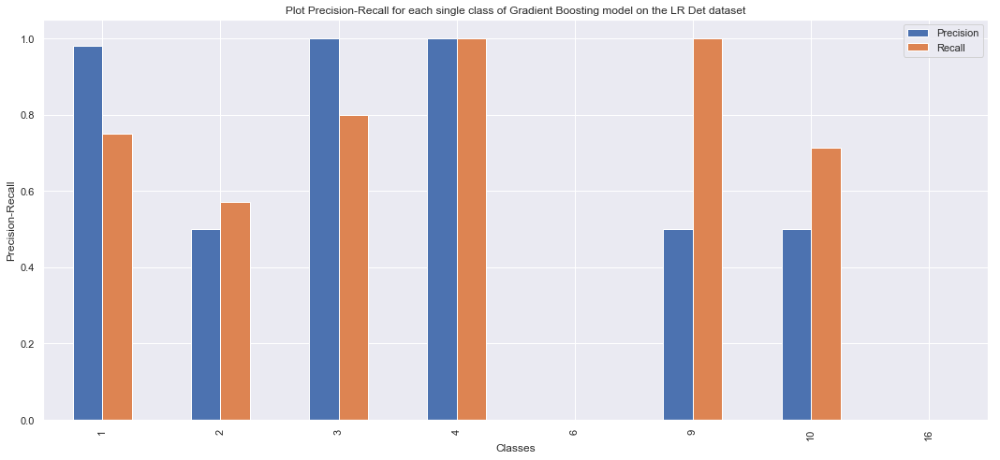

    Precision    Recall
1    0.980769  0.750000
2    0.500000  0.571429
3    1.000000  0.800000
4    1.000000  1.000000
6    0.000000  0.000000
9    0.500000  1.000000
10   0.500000  0.714286
16   0.000000  0.000000


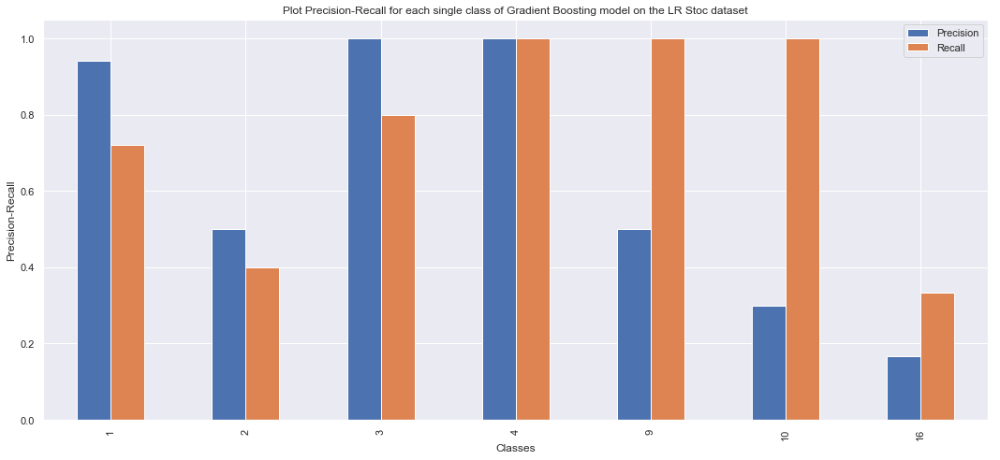

    Precision    Recall
1    0.942308  0.720588
2    0.500000  0.400000
3    1.000000  0.800000
4    1.000000  1.000000
9    0.500000  1.000000
10   0.300000  1.000000
16   0.166667  0.333333


In [175]:
j=0
for i in scores_xgb_pca:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of Gradient Boosting model on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1


<a id="BOOSTPCASCORES"></a>
<h3>  Risultati e confronti tra i diversi Algoritmi di Boosting utilizzando PCA in termini di Accuracy, Precision e Recall <a href="#indice" style="text-decoration:none;">↑</a></h3>



## Total Recall

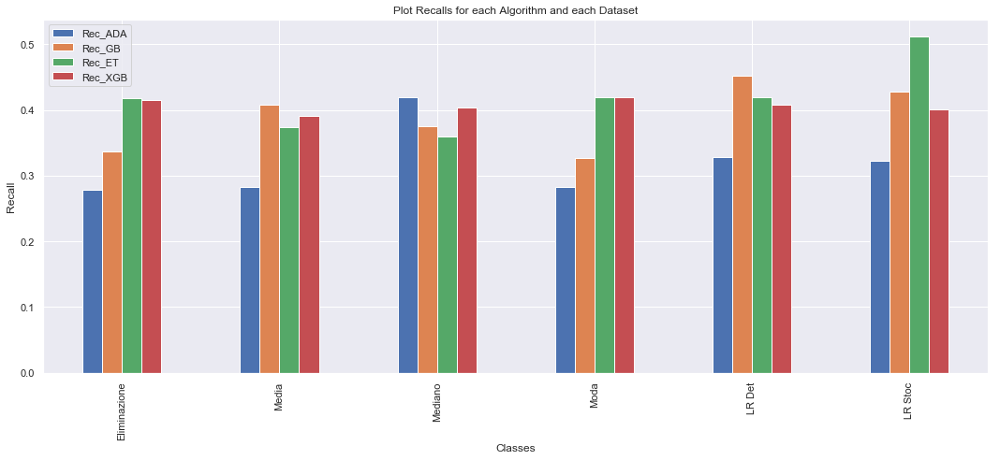

               Rec_ADA    Rec_GB    Rec_ET   Rec_XGB
Eliminazione  0.279091  0.337500  0.418605  0.414685
Media         0.282888  0.407479  0.374459  0.391259
Mediano       0.419913  0.375163  0.359307  0.403846
Moda          0.282888  0.326452  0.419913  0.419017
LR Det        0.327696  0.452715  0.419251  0.407343
LR Stoc       0.322367  0.428388  0.512195  0.400816


In [176]:

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pca_df[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Recalls for each Algorithm and each Dataset")
ax.set_ylabel('Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pca_df[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']])


## Total Precision

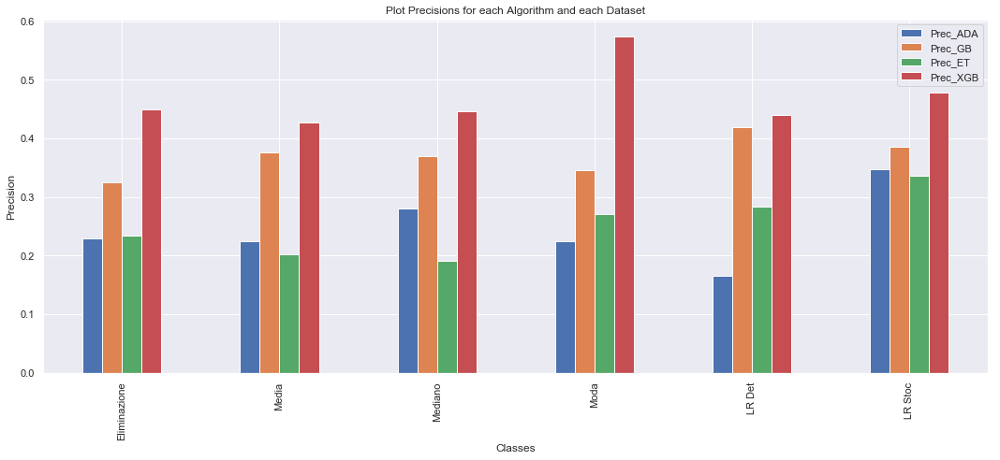

              Prec_ADA   Prec_GB   Prec_ET  Prec_XGB
Eliminazione  0.229808  0.324840  0.234091  0.450178
Media         0.225000  0.375321  0.202273  0.427408
Mediano       0.279545  0.369712  0.190909  0.446810
Moda          0.225000  0.345192  0.270455  0.574275
LR Det        0.165909  0.419712  0.284091  0.439610
LR Stoc       0.347436  0.385684  0.336364  0.477629


In [177]:

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pca_df[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Precisions for each Algorithm and each Dataset")
ax.set_ylabel('Precision')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pca_df[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']])


## Total Accuracy

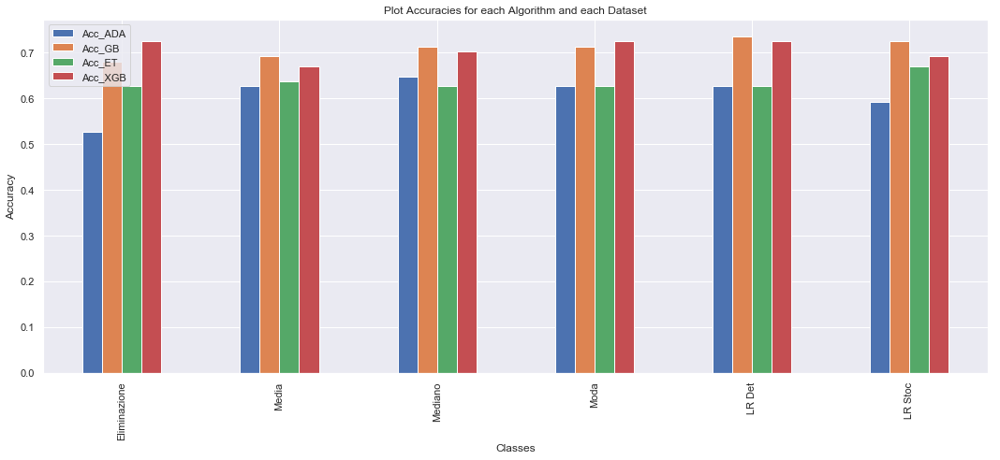

               Acc_ADA    Acc_GB    Acc_ET   Acc_XGB
Eliminazione  0.527473  0.681319  0.626374  0.725275
Media         0.626374  0.692308  0.637363  0.670330
Mediano       0.648352  0.714286  0.626374  0.703297
Moda          0.626374  0.714286  0.626374  0.725275
LR Det        0.626374  0.736264  0.626374  0.725275
LR Stoc       0.593407  0.725275  0.670330  0.692308


In [178]:

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pca_df[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pca_df[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']])


<a id="SUMMARYBOOST"></a>
<h3> Confronto tra le performance dei diversi approcci utilizzati in questa sezione <a href="#indice" style="text-decoration:none;">↑</a></h3>



In [179]:
accuracy_overview = pd.DataFrame()

accuracy_overview["ADA_NoFs"] = ensemble_nofs_df['Acc_ADA']
accuracy_overview["GB_NoFs"] = ensemble_nofs_df['Acc_GB']
accuracy_overview["ET_NoFs"] = ensemble_nofs_df['Acc_ET']
accuracy_overview["XGB_NoFs"] = ensemble_nofs_df['Acc_XGB']

accuracy_overview["ADA_Pear"] = ensemble_pearson_df['Acc_ADA']
accuracy_overview["GB_Pear"] = ensemble_pearson_df['Acc_GB']
accuracy_overview["ET_Pear"] = ensemble_pearson_df['Acc_ET']
accuracy_overview["XGB_Pear"] = ensemble_pearson_df['Acc_XGB']

accuracy_overview["ADA_RFE"] = ensemble_rfe_df['Acc_ADA']
accuracy_overview["GB_RFE"]  = ensemble_rfe_df['Acc_GB']
accuracy_overview["ET_RFE"]  = ensemble_rfe_df['Acc_ET']
accuracy_overview["XGB_RFE"]  = ensemble_rfe_df['Acc_XGB']

accuracy_overview["ADA_PCA"] = ensemble_pca_df['Acc_ADA']
accuracy_overview["GB_PCA"]  = ensemble_pca_df['Acc_GB']
accuracy_overview["ET_PCA"]  = ensemble_pca_df['Acc_ET']
accuracy_overview["XGB_PCA"]  = ensemble_pca_df['Acc_XGB']

accuracy_overview = accuracy_overview.set_index([imputations])


### Confronto delle Accuacies di ADA Boost

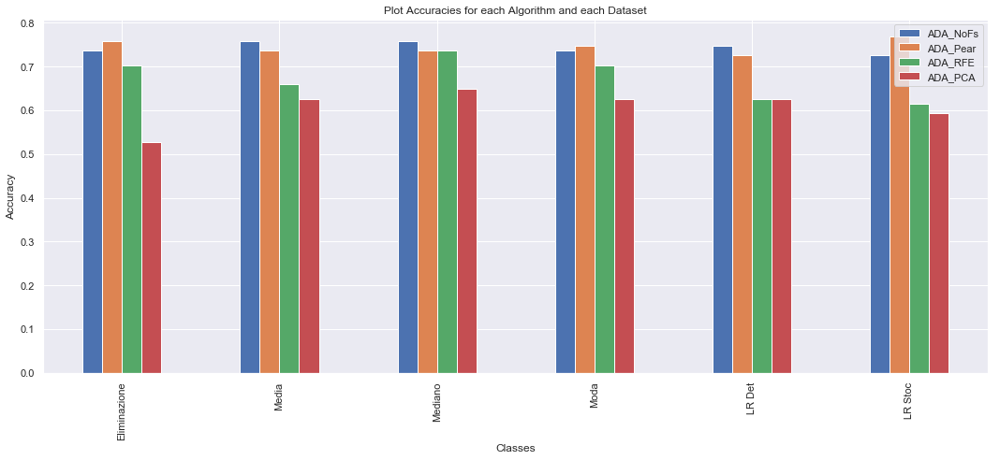

              ADA_NoFs  ADA_Pear   ADA_RFE   ADA_PCA
Eliminazione  0.736264  0.758242  0.703297  0.527473
Media         0.758242  0.736264  0.659341  0.626374
Mediano       0.758242  0.736264  0.736264  0.648352
Moda          0.736264  0.747253  0.703297  0.626374
LR Det        0.747253  0.725275  0.626374  0.626374
LR Stoc       0.725275  0.769231  0.615385  0.593407


In [180]:

fig, ax = plt.subplots(figsize=(15,7))
accuracy_overview[["ADA_NoFs","ADA_Pear","ADA_RFE","ADA_PCA"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(accuracy_overview[["ADA_NoFs","ADA_Pear","ADA_RFE","ADA_PCA"]])


## Confronto delle Accuracies di Gradient Boosting

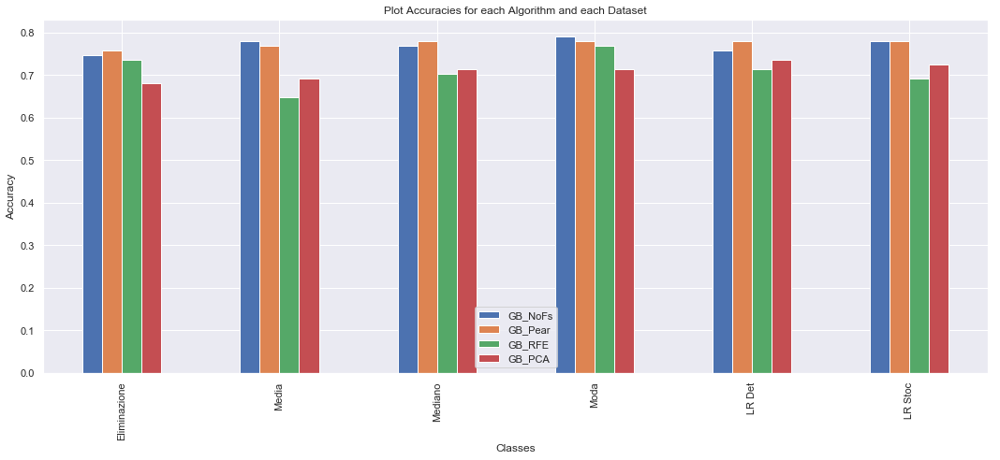

               GB_NoFs   GB_Pear    GB_RFE    GB_PCA
Eliminazione  0.747253  0.758242  0.736264  0.681319
Media         0.780220  0.769231  0.648352  0.692308
Mediano       0.769231  0.780220  0.703297  0.714286
Moda          0.791209  0.780220  0.769231  0.714286
LR Det        0.758242  0.780220  0.714286  0.736264
LR Stoc       0.780220  0.780220  0.692308  0.725275


In [181]:

fig, ax = plt.subplots(figsize=(15,7))
accuracy_overview[["GB_NoFs","GB_Pear","GB_RFE","GB_PCA"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(accuracy_overview[["GB_NoFs","GB_Pear","GB_RFE","GB_PCA"]])


## Confronto delle Accuracies di Extra Tree

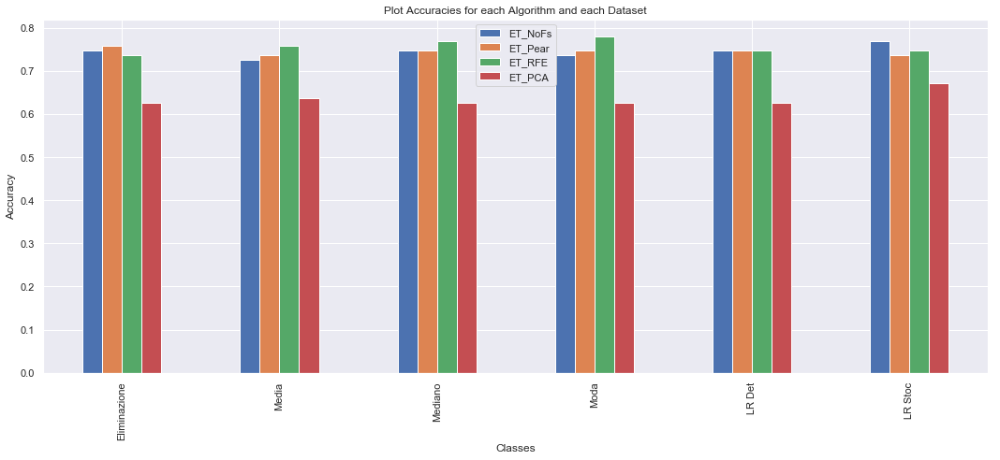

               ET_NoFs   ET_Pear    ET_RFE    ET_PCA
Eliminazione  0.747253  0.758242  0.736264  0.626374
Media         0.725275  0.736264  0.758242  0.637363
Mediano       0.747253  0.747253  0.769231  0.626374
Moda          0.736264  0.747253  0.780220  0.626374
LR Det        0.747253  0.747253  0.747253  0.626374
LR Stoc       0.769231  0.736264  0.747253  0.670330


In [182]:

fig, ax = plt.subplots(figsize=(15,7))
accuracy_overview[["ET_NoFs","ET_Pear","ET_RFE","ET_PCA"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(accuracy_overview[["ET_NoFs","ET_Pear","ET_RFE","ET_PCA"]])


## Confronto delle Accuracies di Extreme Gradient Boosting

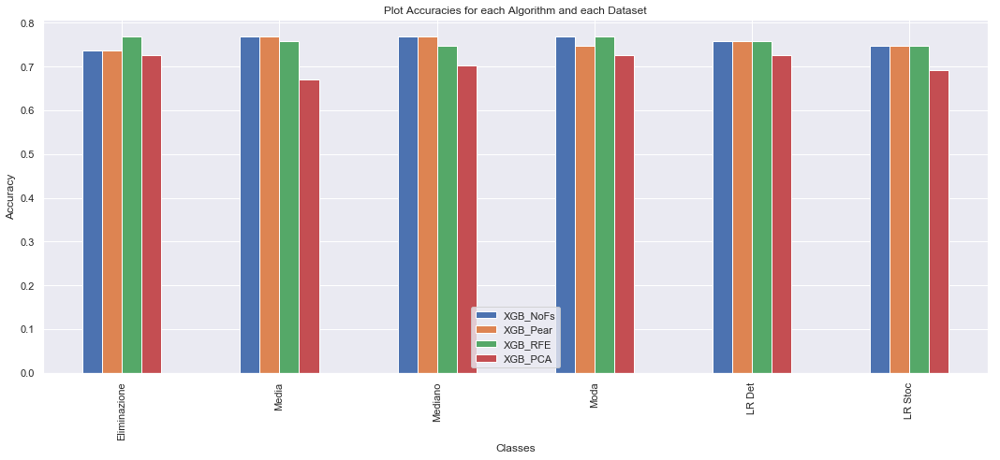

              XGB_NoFs  XGB_Pear   XGB_RFE   XGB_PCA
Eliminazione  0.736264  0.736264  0.769231  0.725275
Media         0.769231  0.769231  0.758242  0.670330
Mediano       0.769231  0.769231  0.747253  0.703297
Moda          0.769231  0.747253  0.769231  0.725275
LR Det        0.758242  0.758242  0.758242  0.725275
LR Stoc       0.747253  0.747253  0.747253  0.692308


In [183]:

fig, ax = plt.subplots(figsize=(15,7))
accuracy_overview[["XGB_NoFs","XGB_Pear","XGB_RFE","XGB_PCA"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(accuracy_overview[["XGB_NoFs","XGB_Pear","XGB_RFE","XGB_PCA"]])




<a id="KNN"></a>
<h3>K-Nearest Neighbour <a href="#indice" style="text-decoration:none;">↑</a></h3>



In [175]:
from sklearn.neighbors import KNeighborsClassifier as KNN


def sceltak(x_train,y_train):
    valorik = list(range(1,20))
    valorik_dispari = filter(lambda x: x % 2 != 0, valorik) #limitazione a valori dispari
    cv_scores = []   #punteggi ottenuti al variare di k
    for k in valorik_dispari:
        knn = KNN(n_neighbors=k)
        risultato = cross_val_score(knn, x_train, y_train, cv=10, scoring='accuracy')
        cv_scores.append(risultato.mean())
    
    j=1
    massimo = 0
    indice = 0
    for i in cv_scores:
        if(j%2 !=0 ):
            if i> massimo:
                massimo = i
                indice = j
           
        j+=1
    
    print("OPTIMAL K: ",indice)
    print("ACCURACY: ", massimo)
    return(indice)

    

In [187]:
lista_knn_pear = []
lista_knn_rfe = []
lista_knn_pca = []
lista_knn_nofs = []
j=0
for i in Datasets:
    print("DATASET :",imputations[j])
    # --- No FS
    x_train_nofs = i[0]
    x_test_nofs = i[2]
    # --- Pearson FS
    indexes_p = Pearson_FS(i[0])
    x_train_p = i[0][:,indexes_p]
    x_test_p = i[2][:,indexes_p]
    
    # --- RFE FS
    
    indexes_rfe = RFE_FS(i[0],i[1],15)
    x_train_rfe =i[0][:,indexes_rfe]
    x_test_rfe = i[2][:,indexes_rfe]
    
    # -- PCA
    x_train_pca,x_test_pca = get_PCA(i[0],i[2])
    
    
    y_train = i[1]
    y_test =i[3]
    
    # -- KNN NO FS
    
    opt_k_nofs = sceltak(x_train_nofs,y_train)
    print("OPT K- NO FS :", opt_k_nofs)
    #scelta del parametro k per approccio DatasetOriginale
    knn_nofs = KNN(n_neighbors=opt_k_nofs,weights="distance")
    knn_nofs.fit(x_train_nofs,y_train)
    knn_nofs_predictions= knn_nofs.predict(x_test_nofs)
    knn_nofs_score = knn_nofs.score(x_test_nofs,y_test)
    rec_knn_nofs = recall_score(knn_nofs_predictions,y_test,average = "macro")
    prec_knn_nofs = precision_score(knn_nofs_predictions,y_test,average = "macro")
     
    lista_knn_nofs.append([knn_nofs_score,prec_knn_nofs,rec_knn_nofs,precision_recall_classes(confusion_matrix(y_test,knn_nofs_predictions),list(set(y_test)))])
    
    
    
    # -- KNN Pearson
    opt_k_pearson = sceltak(x_train_p,y_train)
    print("OPT K- Pearson :", opt_k_pearson)
    #scelta del parametro k per approccio DatasetOriginale
    knn_p = KNN(n_neighbors=opt_k_pearson,weights="distance")
    knn_p.fit(x_train_p,y_train)
    knn_p_predictions= knn_p.predict(x_test_p)
    knn_p_score = knn_p.score(x_test_p,y_test)
    rec_knn_p = recall_score(knn_p_predictions,y_test,average = "macro")
    prec_knn_p = precision_score(knn_p_predictions,y_test,average = "macro")
     
    lista_knn_pear.append([knn_p_score,prec_knn_p,rec_knn_p,precision_recall_classes(confusion_matrix(y_test,knn_p_predictions),list(set(y_test)))])
    
    # -- KNN RFE
    
    opt_k_rfe = sceltak(x_train_rfe,y_train)
    print("OPT K- RFE :", opt_k_rfe)
    #scelta del parametro k per approccio DatasetOriginale
    knn_r = KNN(n_neighbors=opt_k_rfe,weights="distance")
    knn_r.fit(x_train_rfe,y_train)
    knn_r_predictions= knn_r.predict(x_test_rfe)
    knn_r_score = knn_r.score(x_test_rfe,y_test)
    rec_knn_r = recall_score(knn_r_predictions,y_test,average = "macro")
    prec_knn_r = precision_score(knn_r_predictions,y_test,average = "macro")
 
    lista_knn_rfe.append([knn_r_score,prec_knn_r,rec_knn_r,precision_recall_classes(confusion_matrix(y_test,knn_r_predictions),list(set(y_test)))])
    
    # -- KNN PCA
    
    opt_k_pca = sceltak(x_train_pca,y_train)
    print("OPT K- PCA :", opt_k_pca)
    #scelta del parametro k per approccio DatasetOriginale
    knn_pca = KNN(n_neighbors=opt_k_pca,weights="distance")
    knn_pca.fit(x_train_pca,y_train)
    knn_pca_predictions= knn_pca.predict(x_test_pca)
    knn_pca_score = knn_pca.score(x_test_pca,y_test)
    rec_knn_pca = recall_score(knn_pca_predictions,y_test,average = "macro")
    prec_knn_pca = precision_score(knn_pca_predictions,y_test,average = "macro")
 
    lista_knn_pca.append([knn_pca_score,prec_knn_pca,rec_knn_pca,precision_recall_classes(confusion_matrix(y_test,knn_pca_predictions),list(set(y_test)))])
    
    print("NOFS\t ACCURACY:",knn_nofs_score," Recall ", rec_knn_nofs," Precision ",prec_knn_nofs,"\n")
    print("PEARSON\t ACCURACY:",knn_p_score," Recall ", rec_knn_p," Precision ",prec_knn_p,"\n")
    print("RFE\t ACCURACY:",knn_r_score," Recall ", rec_knn_r," Precision ",prec_knn_r, "\n")
    print("PCA\t ACCURACY:",knn_pca_score," Recall ", rec_knn_pca," Precision ",prec_knn_pca, "\n")
    print("\n\n")
    j+=1

    

dic = {"Scores_Pear": lista_knn_pear,
       "K_Pear":opt_k_pearson,
      "Scores_RFE":lista_knn_rfe,
       "K_RFE":opt_k_rfe,
       "Scores_Pca": lista_knn_pca,
       "K_PCA":opt_k_pca,
       "Scores_NoFs": lista_knn_nofs,
       "K_NoFs": opt_k_nofs
      
      }
np.save("ResultsKNN/KnnResults.npy", dic)



DATASET : Eliminazione
OPTIMAL K:  3
ACCURACY:  0.5694775264841054
OPT K- NO FS : 3
OPTIMAL K:  3
ACCURACY:  0.572376962574331
OPT K- Pearson : 3
OPTIMAL K:  3
ACCURACY:  0.657967252539621
OPT K- RFE : 3
OPTIMAL K:  3
ACCURACY:  0.5819061833535517
OPT K- PCA : 3
NOFS	 ACCURACY: 0.6593406593406593  Recall  0.4860606060606061  Precision  0.3399184149184149 

PEARSON	 ACCURACY: 0.6593406593406593  Recall  0.5003987240829346  Precision  0.3399184149184149 

RFE	 ACCURACY: 0.6483516483516484  Recall  0.5549923195084486  Precision  0.4564685314685315 

PCA	 ACCURACY: 0.6483516483516484  Recall  0.4537480063795854  Precision  0.3328671328671329 




DATASET : Media
OPTIMAL K:  3
ACCURACY:  0.5753052291868082
OPT K- NO FS : 3
OPTIMAL K:  3
ACCURACY:  0.569001336007915
OPT K- Pearson : 3
OPTIMAL K:  3
ACCURACY:  0.6634496612128191
OPT K- RFE : 3
OPTIMAL K:  3
ACCURACY:  0.58017458162195
OPT K- PCA : 3
NOFS	 ACCURACY: 0.6593406593406593  Recall  0.5132336018411968  Precision  0.3399184149184149 

In [193]:
knn_df = pd.DataFrame()

knn_df['Acc_NoFs'] =  [lista_knn_nofs[0][0]] + [lista_knn_nofs[1][0]]+[lista_knn_nofs[2][0]]+[lista_knn_nofs[3][0]]+[lista_knn_nofs[4][0]]+[lista_knn_nofs[5][0]]
knn_df['Rec_NoFs'] = [lista_knn_nofs[0][1]] + [lista_knn_nofs[1][1]]+[lista_knn_nofs[2][1]]+[lista_knn_nofs[3][1]]+[lista_knn_nofs[4][1]]+[lista_knn_nofs[5][1]]
knn_df['Prec_NoFs'] =  [lista_knn_nofs[0][2]] + [lista_knn_nofs[1][2]]+[lista_knn_nofs[2][2]]+[lista_knn_nofs[3][2]]+[lista_knn_nofs[4][2]]+[lista_knn_nofs[5][2]]

knn_df['Acc_Pear'] =  [lista_knn_pear[0][0]] + [lista_knn_pear[1][0]]+[lista_knn_pear[2][0]]+[lista_knn_pear[3][0]]+[lista_knn_pear[4][0]]+[lista_knn_pear[5][0]]
knn_df['Rec_Pear'] =  [lista_knn_pear[0][1]] + [lista_knn_pear[1][1]]+[lista_knn_pear[2][1]]+[lista_knn_pear[3][1]]+[lista_knn_pear[4][1]]+[lista_knn_pear[5][1]]
knn_df['Prec_Pear'] =  [lista_knn_pear[0][2]] + [lista_knn_pear[1][2]]+[lista_knn_pear[2][2]]+[lista_knn_pear[3][2]]+[lista_knn_pear[4][2]]+[lista_knn_pear[5][2]]


knn_df['Acc_RFE'] =  [lista_knn_rfe[0][0]] + [lista_knn_rfe[1][0]]+[lista_knn_rfe[2][0]]+[lista_knn_rfe[3][0]]+[lista_knn_rfe[4][0]]+[lista_knn_rfe[5][0]]
knn_df['Rec_RFE'] =  [lista_knn_rfe[0][1]] + [lista_knn_rfe[1][1]]+[lista_knn_rfe[2][1]]+[lista_knn_rfe[3][1]]+[lista_knn_rfe[4][1]]+[lista_knn_rfe[5][1]]
knn_df['Prec_RFE'] =  [lista_knn_rfe[0][2]] + [lista_knn_rfe[1][2]]+[lista_knn_rfe[2][2]]+[lista_knn_rfe[3][2]]+[lista_knn_rfe[4][2]]+[lista_knn_rfe[5][2]]

knn_df['Acc_PCA'] =  [lista_knn_pca[0][0]] + [lista_knn_pca[1][0]]+[lista_knn_pca[2][0]]+[lista_knn_pca[3][0]]+[lista_knn_pca[4][0]]+[lista_knn_pca[5][0]]
knn_df['Rec_PCA'] =  [lista_knn_pca[0][1]] + [lista_knn_pca[1][1]]+[lista_knn_pca[2][1]]+[lista_knn_pca[3][1]]+[lista_knn_pca[4][1]]+[lista_knn_pca[5][1]]
knn_df['Prec_PCA'] =  [lista_knn_pca[0][2]] + [lista_knn_pca[1][2]]+[lista_knn_pca[2][2]]+[lista_knn_pca[3][2]]+[lista_knn_pca[4][2]]+[lista_knn_pca[5][2]]

knn_df = knn_df.set_index([imputations])



<a id="KNNPRECREC"></a>
<h3> Precision e Recall sulle singole classi per ogni dataset utilizzando Feature Selection, PCA con il dataset originale <a href="#indice" style="text-decoration:none;">↑</a></h3>





### No Feature Selection

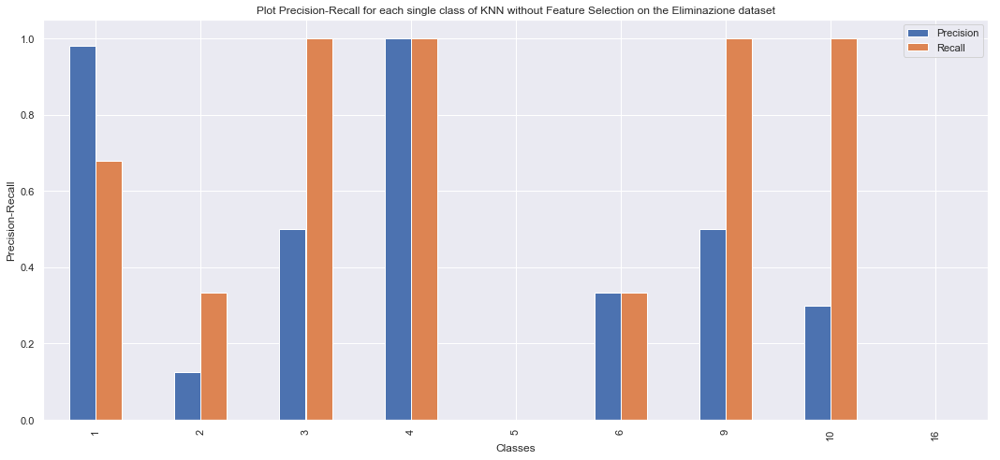

    Precision    Recall
1    0.980769  0.680000
2    0.125000  0.333333
3    0.500000  1.000000
4    1.000000  1.000000
5    0.000000  0.000000
6    0.333333  0.333333
9    0.500000  1.000000
10   0.300000  1.000000
16   0.000000  0.000000


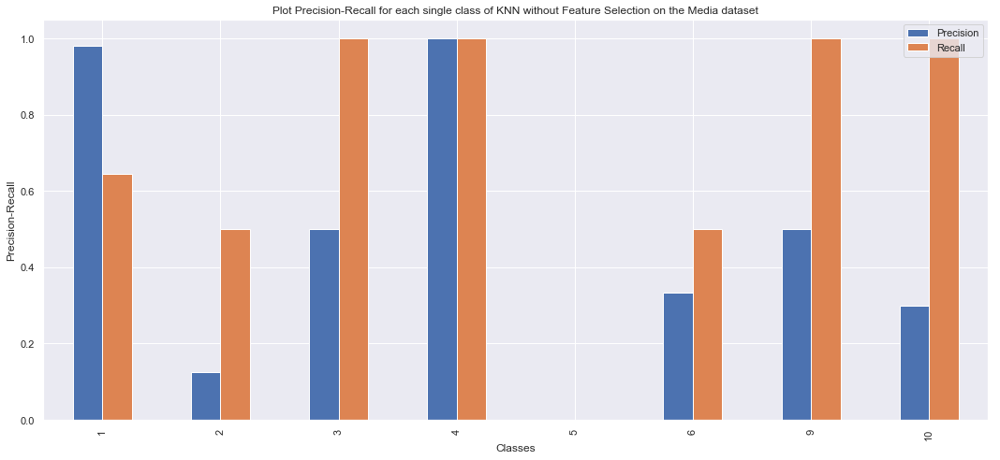

    Precision   Recall
1    0.980769  0.64557
2    0.125000  0.50000
3    0.500000  1.00000
4    1.000000  1.00000
5    0.000000  0.00000
6    0.333333  0.50000
9    0.500000  1.00000
10   0.300000  1.00000


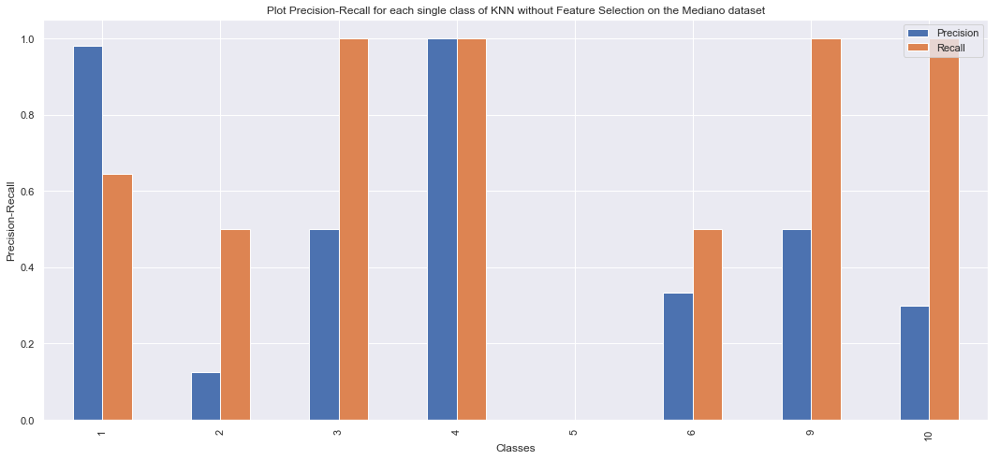

    Precision   Recall
1    0.980769  0.64557
2    0.125000  0.50000
3    0.500000  1.00000
4    1.000000  1.00000
5    0.000000  0.00000
6    0.333333  0.50000
9    0.500000  1.00000
10   0.300000  1.00000


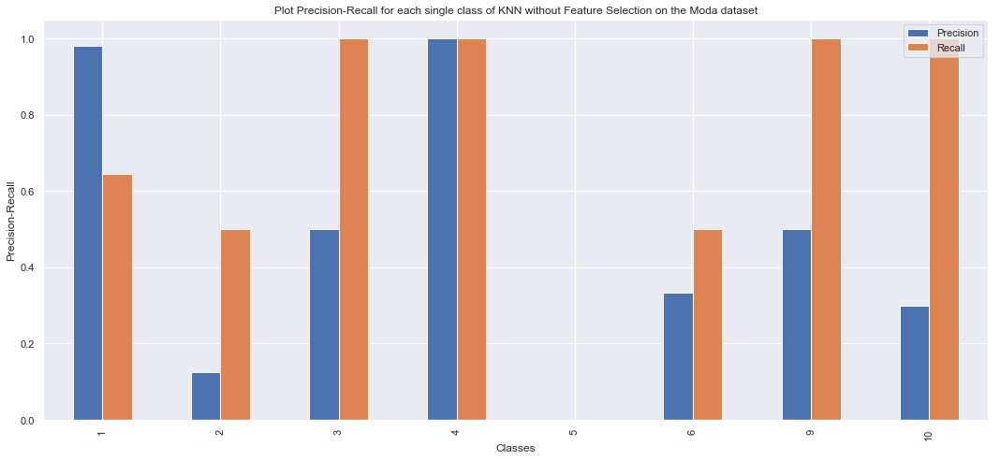

    Precision   Recall
1    0.980769  0.64557
2    0.125000  0.50000
3    0.500000  1.00000
4    1.000000  1.00000
5    0.000000  0.00000
6    0.333333  0.50000
9    0.500000  1.00000
10   0.300000  1.00000


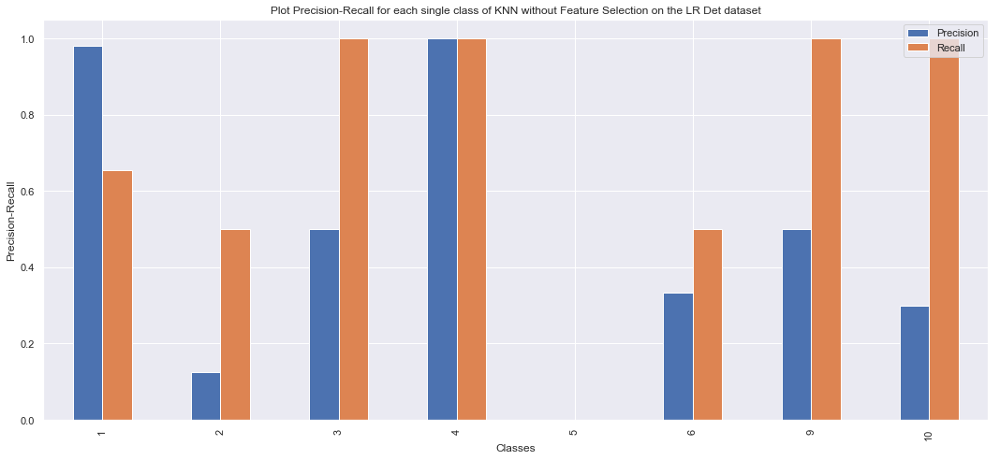

    Precision    Recall
1    0.980769  0.653846
2    0.125000  0.500000
3    0.500000  1.000000
4    1.000000  1.000000
5    0.000000  0.000000
6    0.333333  0.500000
9    0.500000  1.000000
10   0.300000  1.000000


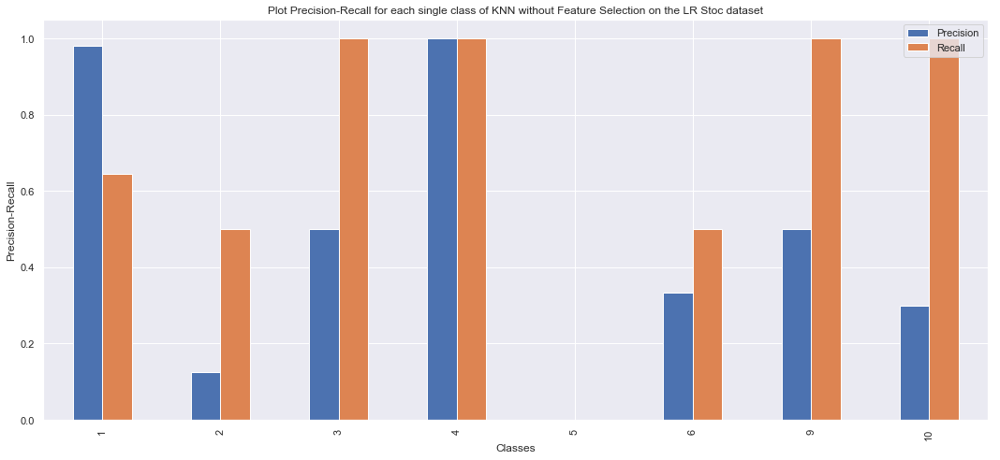

    Precision   Recall
1    0.980769  0.64557
2    0.125000  0.50000
3    0.500000  1.00000
4    1.000000  1.00000
5    0.000000  0.00000
6    0.333333  0.50000
9    0.500000  1.00000
10   0.300000  1.00000


In [189]:
j=0
for i in lista_knn_nofs:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of KNN without Feature Selection on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

### Pearson Feature Selection

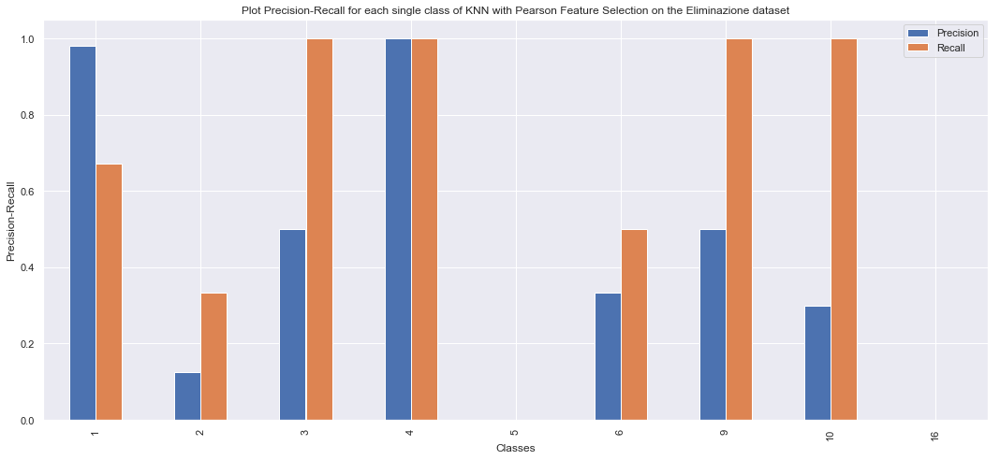

    Precision    Recall
1    0.980769  0.671053
2    0.125000  0.333333
3    0.500000  1.000000
4    1.000000  1.000000
5    0.000000  0.000000
6    0.333333  0.500000
9    0.500000  1.000000
10   0.300000  1.000000
16   0.000000  0.000000


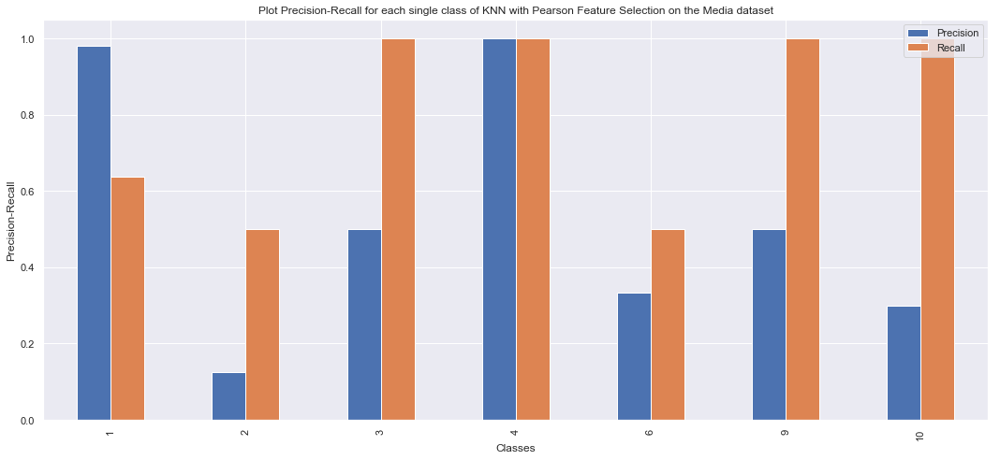

    Precision  Recall
1    0.980769  0.6375
2    0.125000  0.5000
3    0.500000  1.0000
4    1.000000  1.0000
6    0.333333  0.5000
9    0.500000  1.0000
10   0.300000  1.0000


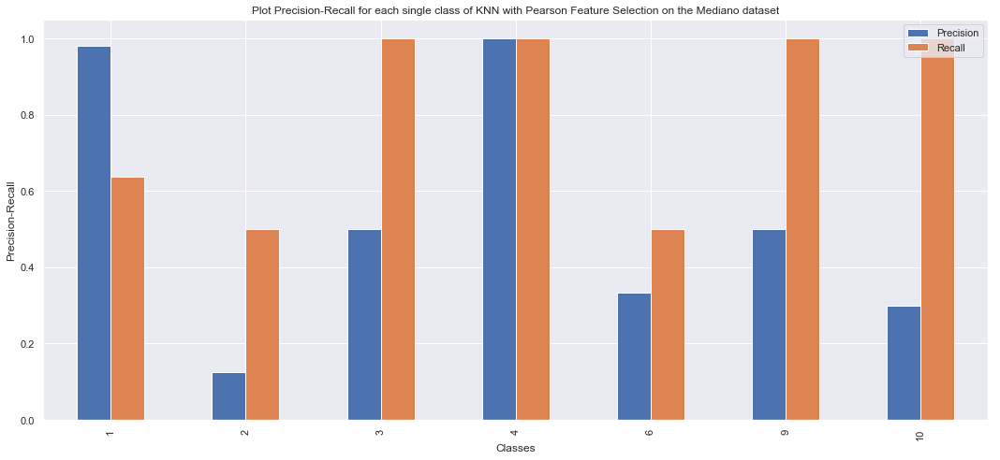

    Precision  Recall
1    0.980769  0.6375
2    0.125000  0.5000
3    0.500000  1.0000
4    1.000000  1.0000
6    0.333333  0.5000
9    0.500000  1.0000
10   0.300000  1.0000


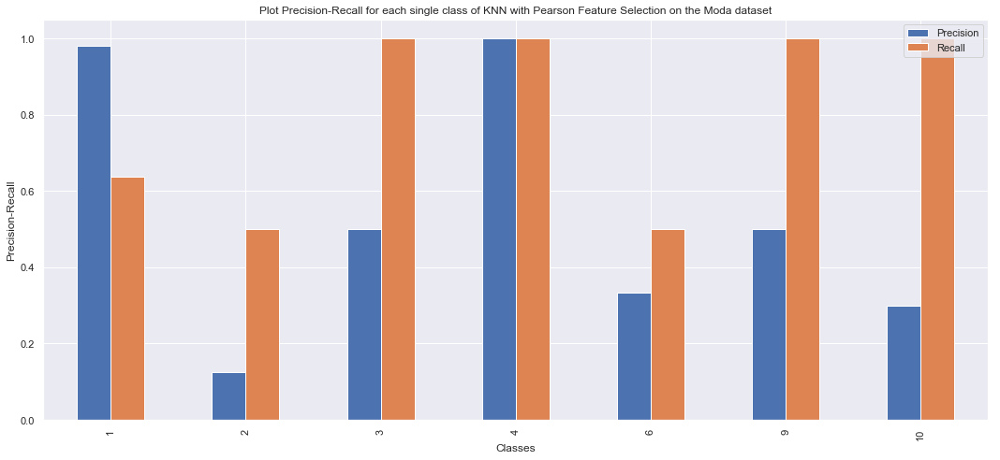

    Precision  Recall
1    0.980769  0.6375
2    0.125000  0.5000
3    0.500000  1.0000
4    1.000000  1.0000
6    0.333333  0.5000
9    0.500000  1.0000
10   0.300000  1.0000


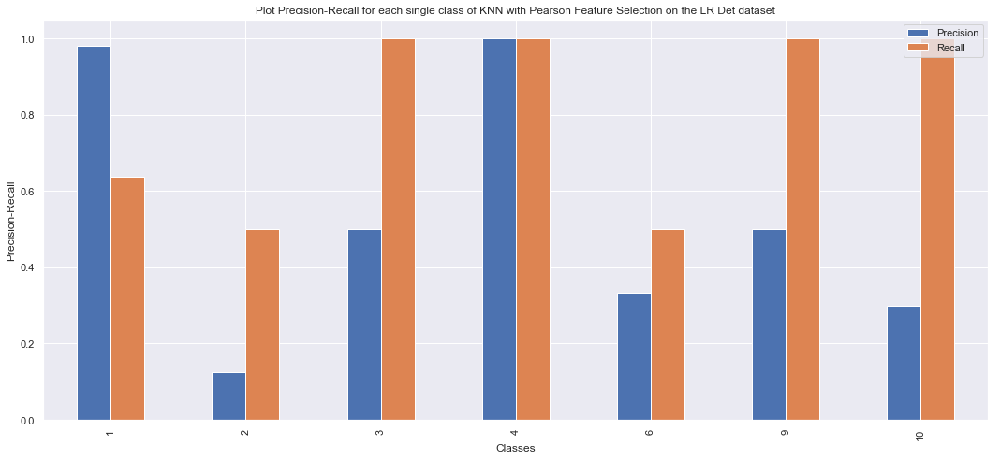

    Precision  Recall
1    0.980769  0.6375
2    0.125000  0.5000
3    0.500000  1.0000
4    1.000000  1.0000
6    0.333333  0.5000
9    0.500000  1.0000
10   0.300000  1.0000


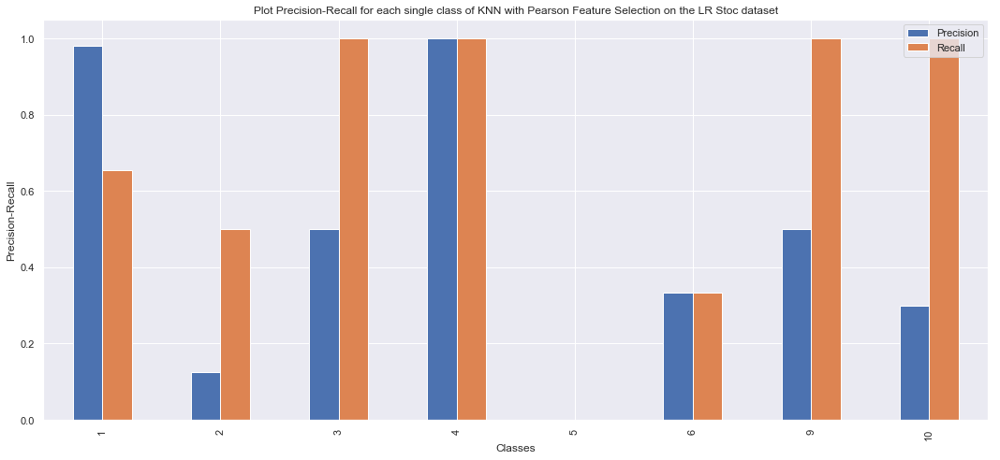

    Precision    Recall
1    0.980769  0.653846
2    0.125000  0.500000
3    0.500000  1.000000
4    1.000000  1.000000
5    0.000000  0.000000
6    0.333333  0.333333
9    0.500000  1.000000
10   0.300000  1.000000


In [645]:
j=0
for i in lista_knn_pear:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of KNN with Pearson Feature Selection on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

### RFE Feature Selection

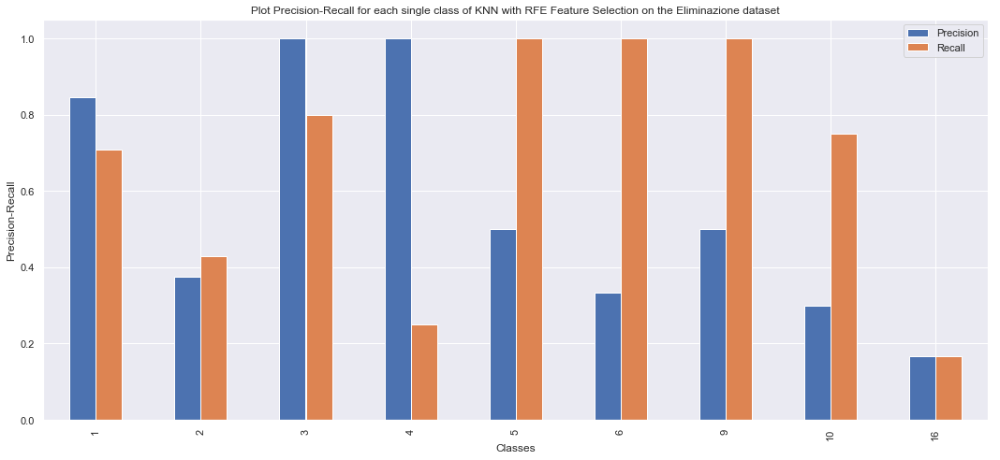

    Precision    Recall
1    0.846154  0.709677
2    0.375000  0.428571
3    1.000000  0.800000
4    1.000000  0.250000
5    0.500000  1.000000
6    0.333333  1.000000
9    0.500000  1.000000
10   0.300000  0.750000
16   0.166667  0.166667


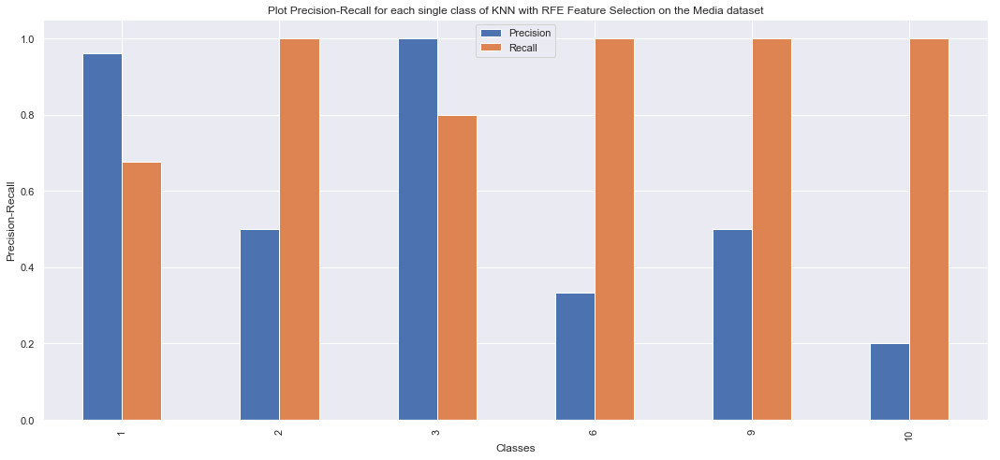

    Precision    Recall
1    0.961538  0.675676
2    0.500000  1.000000
3    1.000000  0.800000
6    0.333333  1.000000
9    0.500000  1.000000
10   0.200000  1.000000


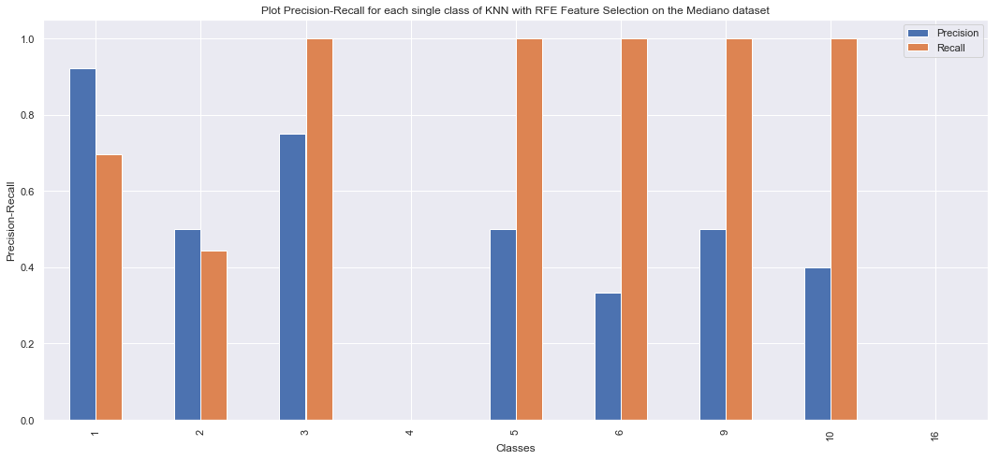

    Precision    Recall
1    0.923077  0.695652
2    0.500000  0.444444
3    0.750000  1.000000
4    0.000000  0.000000
5    0.500000  1.000000
6    0.333333  1.000000
9    0.500000  1.000000
10   0.400000  1.000000
16   0.000000  0.000000


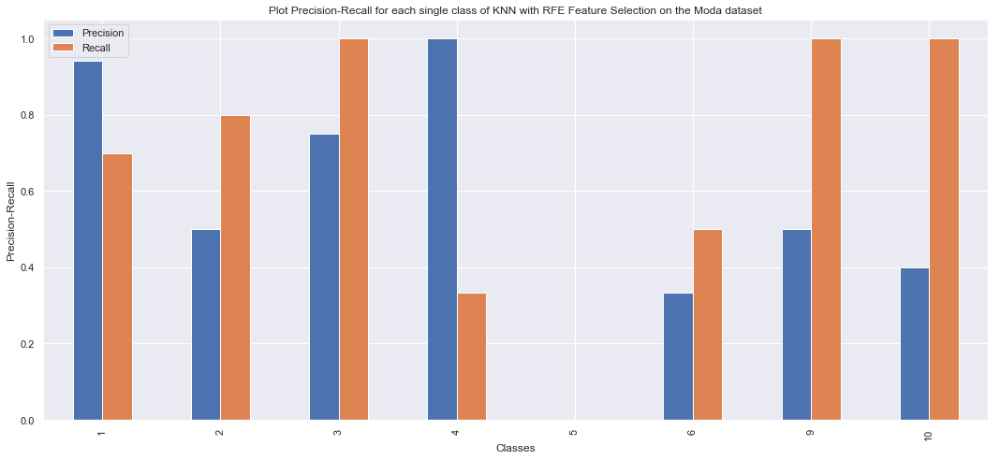

    Precision    Recall
1    0.942308  0.700000
2    0.500000  0.800000
3    0.750000  1.000000
4    1.000000  0.333333
5    0.000000  0.000000
6    0.333333  0.500000
9    0.500000  1.000000
10   0.400000  1.000000


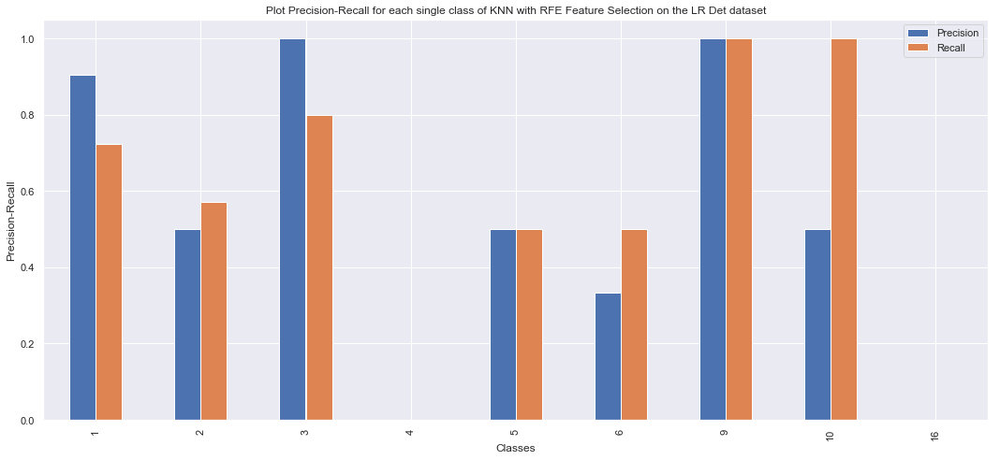

    Precision    Recall
1    0.903846  0.723077
2    0.500000  0.571429
3    1.000000  0.800000
4    0.000000  0.000000
5    0.500000  0.500000
6    0.333333  0.500000
9    1.000000  1.000000
10   0.500000  1.000000
16   0.000000  0.000000


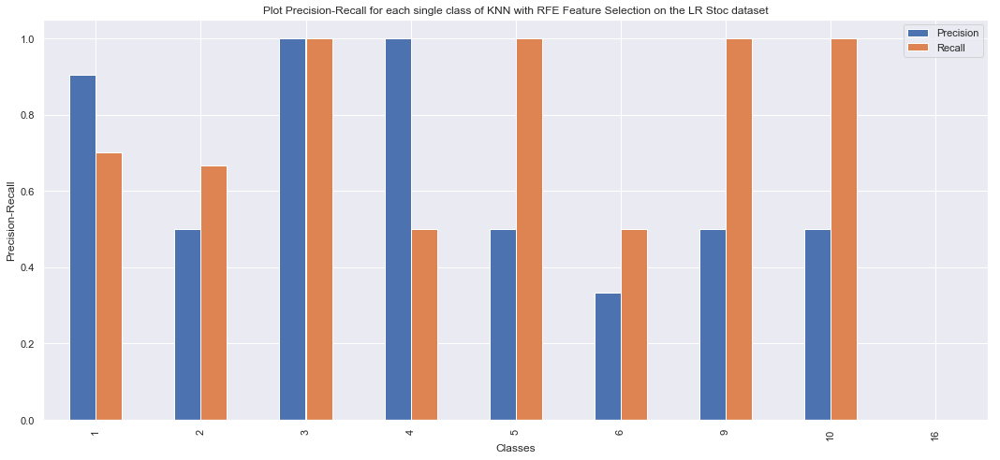

    Precision    Recall
1    0.903846  0.701493
2    0.500000  0.666667
3    1.000000  1.000000
4    1.000000  0.500000
5    0.500000  1.000000
6    0.333333  0.500000
9    0.500000  1.000000
10   0.500000  1.000000
16   0.000000  0.000000


In [191]:
j=0
for i in lista_knn_rfe:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of KNN with RFE Feature Selection on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

### PCA

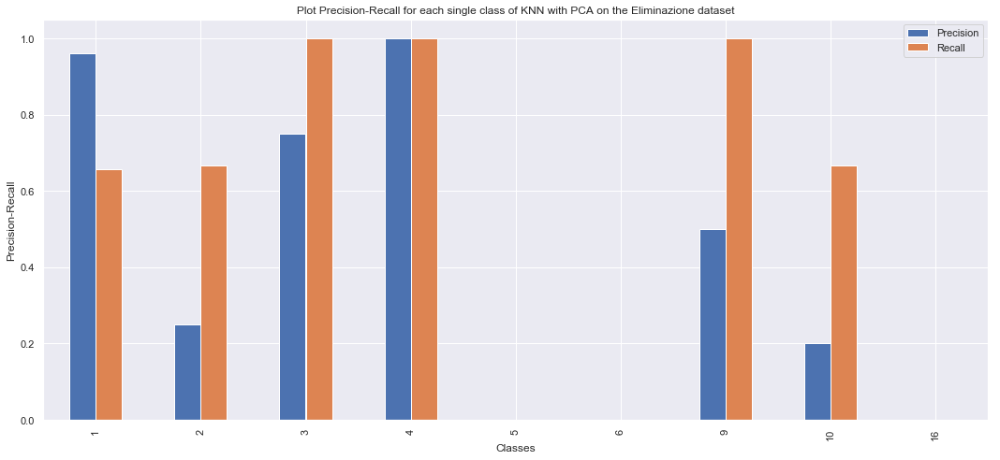

    Precision    Recall
1    0.961538  0.657895
2    0.250000  0.666667
3    0.750000  1.000000
4    1.000000  1.000000
5    0.000000  0.000000
6    0.000000  0.000000
9    0.500000  1.000000
10   0.200000  0.666667
16   0.000000  0.000000


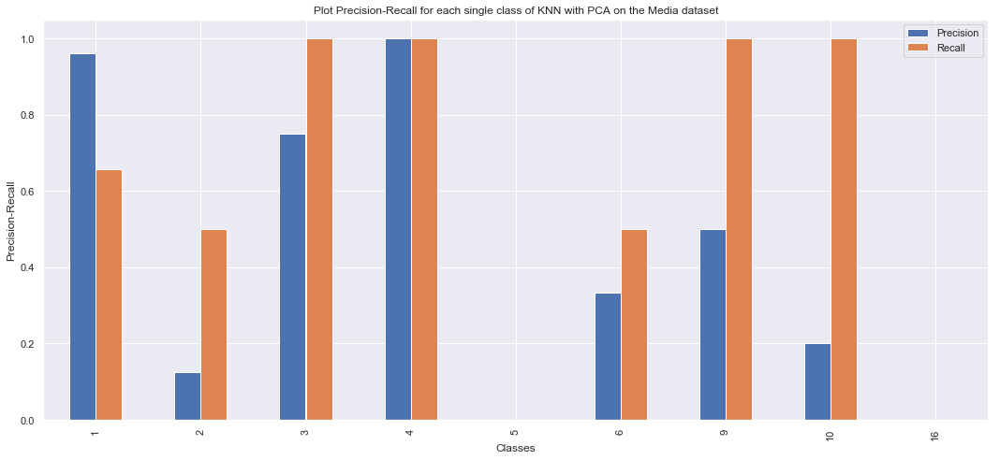

    Precision    Recall
1    0.961538  0.657895
2    0.125000  0.500000
3    0.750000  1.000000
4    1.000000  1.000000
5    0.000000  0.000000
6    0.333333  0.500000
9    0.500000  1.000000
10   0.200000  1.000000
16   0.000000  0.000000


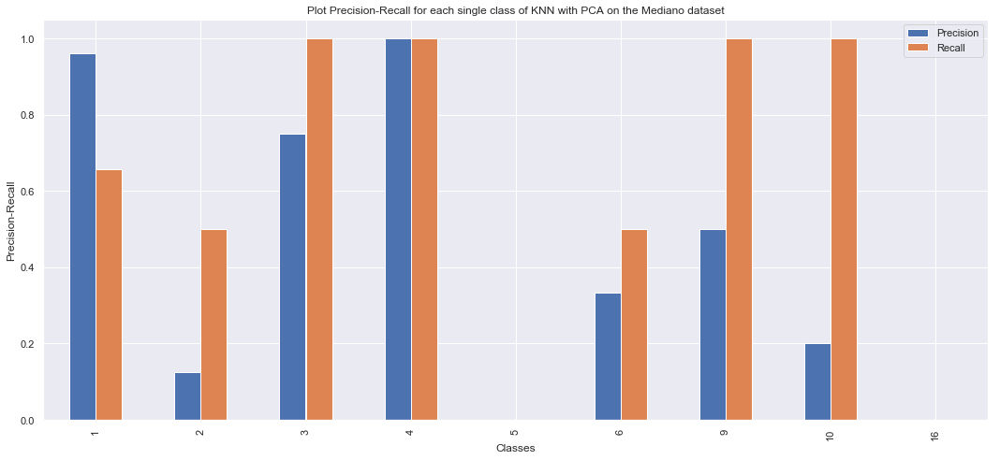

    Precision    Recall
1    0.961538  0.657895
2    0.125000  0.500000
3    0.750000  1.000000
4    1.000000  1.000000
5    0.000000  0.000000
6    0.333333  0.500000
9    0.500000  1.000000
10   0.200000  1.000000
16   0.000000  0.000000


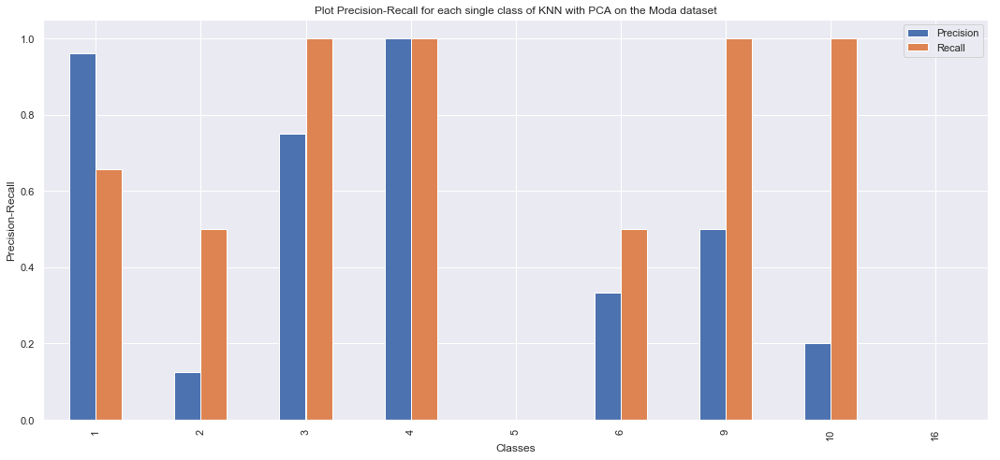

    Precision    Recall
1    0.961538  0.657895
2    0.125000  0.500000
3    0.750000  1.000000
4    1.000000  1.000000
5    0.000000  0.000000
6    0.333333  0.500000
9    0.500000  1.000000
10   0.200000  1.000000
16   0.000000  0.000000


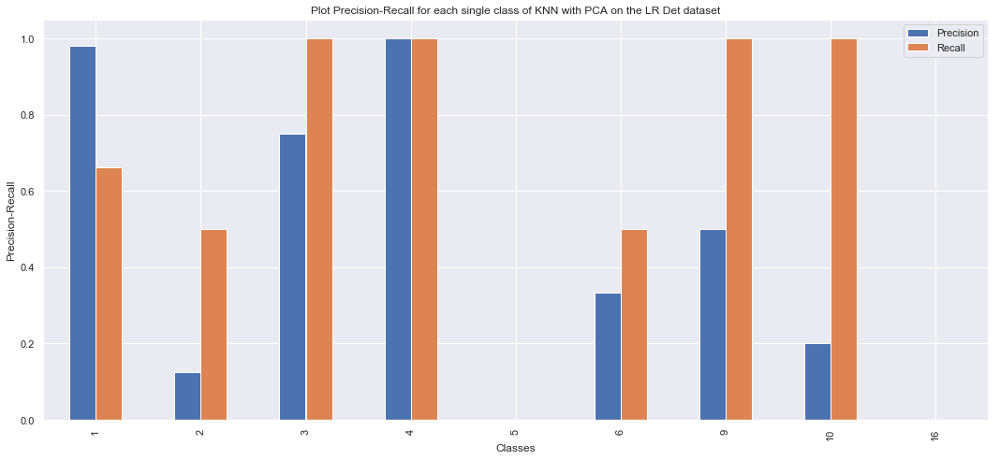

    Precision    Recall
1    0.980769  0.662338
2    0.125000  0.500000
3    0.750000  1.000000
4    1.000000  1.000000
5    0.000000  0.000000
6    0.333333  0.500000
9    0.500000  1.000000
10   0.200000  1.000000
16   0.000000  0.000000


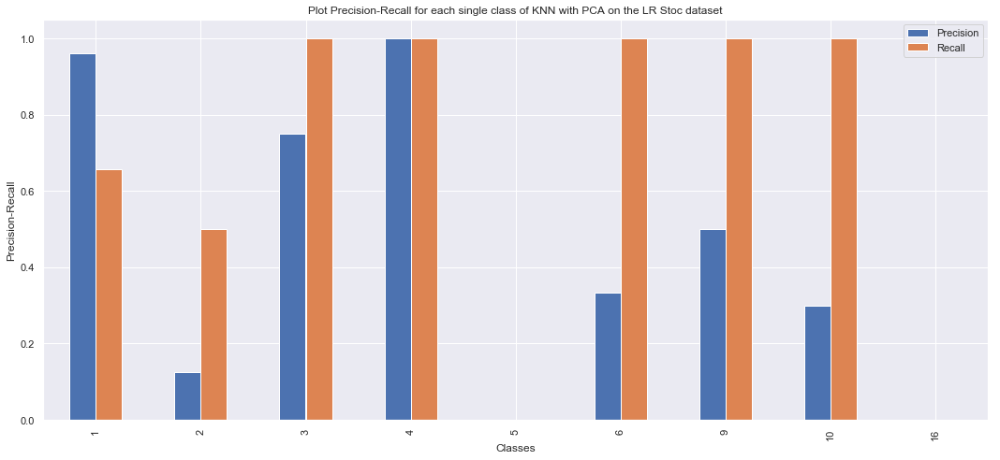

    Precision    Recall
1    0.961538  0.657895
2    0.125000  0.500000
3    0.750000  1.000000
4    1.000000  1.000000
5    0.000000  0.000000
6    0.333333  1.000000
9    0.500000  1.000000
10   0.300000  1.000000
16   0.000000  0.000000


In [190]:
j=0
for i in lista_knn_pca:
    fig, ax = plt.subplots(figsize=(15,7))
    i[3].plot(kind="bar",ax=ax)
    ax.set_title("Plot Precision-Recall for each single class of KNN with PCA on the "+imputations[j]+" dataset")
    ax.set_ylabel('Precision-Recall')
    ax.set_xlabel('Classes')
    fig.tight_layout()
    plt.show()
    print(i[3])
    j+=1

### Accuracy, Precision and Recall of KNN without Feature Selection

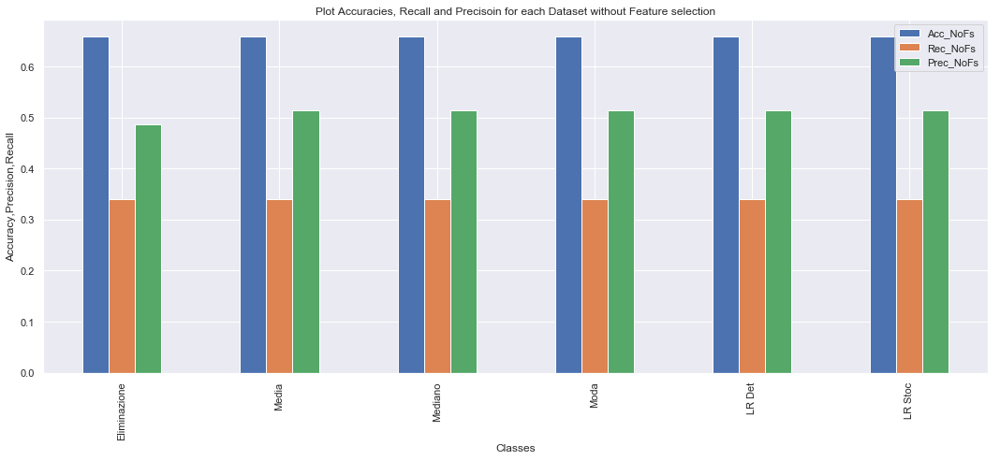

              Acc_NoFs  Rec_NoFs  Prec_NoFs
Eliminazione  0.659341  0.339918   0.486061
Media         0.659341  0.339918   0.513234
Mediano       0.659341  0.339918   0.513234
Moda          0.659341  0.339918   0.513234
LR Det        0.659341  0.339918   0.513986
LR Stoc       0.659341  0.339918   0.513234


In [194]:

fig, ax = plt.subplots(figsize=(15,7))
knn_df[["Acc_NoFs","Rec_NoFs","Prec_NoFs"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies, Recall and Precisoin for each Dataset without Feature selection")
ax.set_ylabel('Accuracy,Precision,Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(knn_df[["Acc_NoFs","Rec_NoFs","Prec_NoFs"]])



<a id="KNNAPR"></a>
<h3> Confronto tra le Accuracy,Precision e Recall per ogni dataset e per ogni tipo di analisi delle Features  <a href="#indice" style="text-decoration:none;">↑</a></h3>


### Accuracy, Precision and Recall of KNN with Pearson Feature Selection

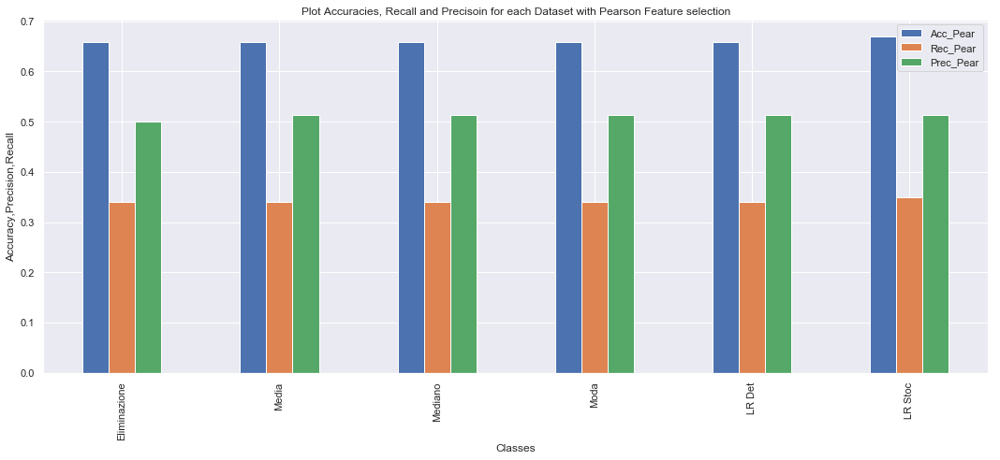

              Acc_Pear  Rec_Pear  Prec_Pear
Eliminazione  0.659341  0.339918   0.500399
Media         0.659341  0.339918   0.512500
Mediano       0.659341  0.339918   0.512500
Moda          0.659341  0.339918   0.512500
LR Det        0.659341  0.339918   0.512500
LR Stoc       0.670330  0.349009   0.513986


In [195]:

fig, ax = plt.subplots(figsize=(15,7))
knn_df[["Acc_Pear","Rec_Pear","Prec_Pear"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies, Recall and Precisoin for each Dataset with Pearson Feature selection")
ax.set_ylabel('Accuracy,Precision,Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(knn_df[["Acc_Pear","Rec_Pear","Prec_Pear"]])


### Accuracy, Precision and Recall of KNN with RFE Feature Selection

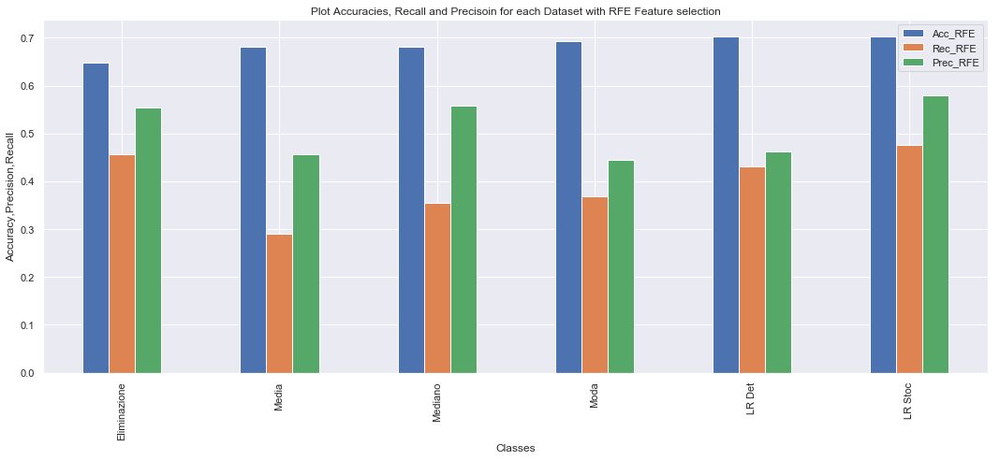

               Acc_RFE   Rec_RFE  Prec_RFE
Eliminazione  0.648352  0.456469  0.554992
Media         0.681319  0.291239  0.456306
Mediano       0.681319  0.355128  0.558191
Moda          0.692308  0.368803  0.444444
LR Det        0.703297  0.430653  0.463137
LR Stoc       0.703297  0.476107  0.578924


In [196]:

fig, ax = plt.subplots(figsize=(15,7))
knn_df[["Acc_RFE","Rec_RFE","Prec_RFE"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies, Recall and Precisoin for each Dataset with RFE Feature selection")
ax.set_ylabel('Accuracy,Precision,Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(knn_df[["Acc_RFE","Rec_RFE","Prec_RFE"]])


### Accuracy, Precision and Recall of KNN with PCA

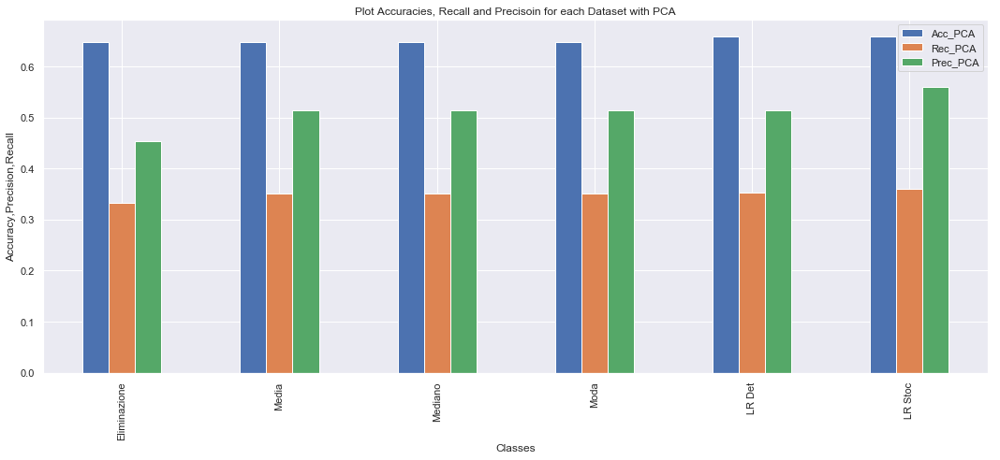

               Acc_PCA   Rec_PCA  Prec_PCA
Eliminazione  0.648352  0.332867  0.453748
Media         0.648352  0.351807  0.514354
Mediano       0.648352  0.351807  0.514354
Moda          0.648352  0.351807  0.514354
LR Det        0.659341  0.353555  0.514758
LR Stoc       0.659341  0.360897  0.559809


In [197]:

fig, ax = plt.subplots(figsize=(15,7))
knn_df[["Acc_PCA","Rec_PCA","Prec_PCA"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies, Recall and Precisoin for each Dataset with PCA")
ax.set_ylabel('Accuracy,Precision,Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(knn_df[["Acc_PCA","Rec_PCA","Prec_PCA"]])



<a id="KNNSUMMARY"></a>
<h3> Confronto tra le Accuracy utilizzando analsi delle Features differenti <a href="#indice" style="text-decoration:none;">↑</a></h3>


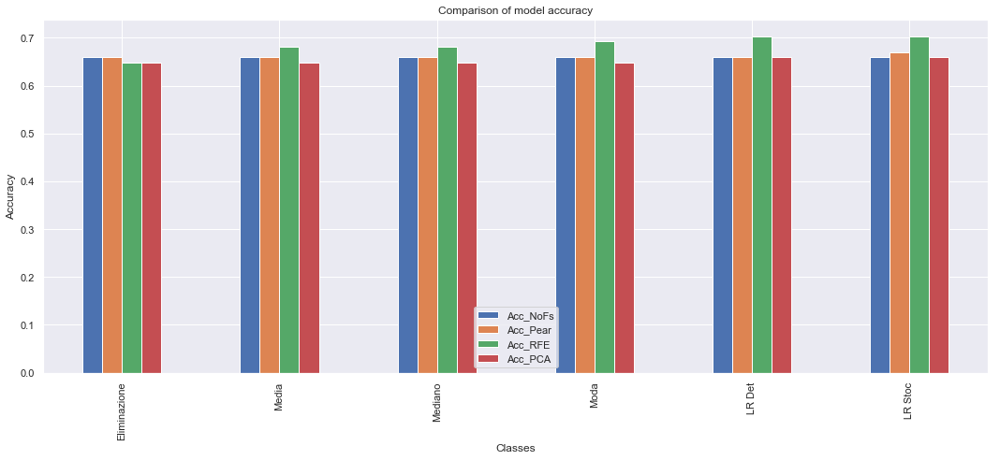

              Acc_NoFs  Acc_Pear   Acc_RFE   Acc_PCA
Eliminazione  0.659341  0.659341  0.648352  0.648352
Media         0.659341  0.659341  0.681319  0.648352
Mediano       0.659341  0.659341  0.681319  0.648352
Moda          0.659341  0.659341  0.692308  0.648352
LR Det        0.659341  0.659341  0.703297  0.659341
LR Stoc       0.659341  0.670330  0.703297  0.659341


In [198]:

fig, ax = plt.subplots(figsize=(15,7))
knn_df[["Acc_NoFs","Acc_Pear","Acc_RFE","Acc_PCA"]].plot(kind="bar",ax=ax)
ax.set_title("Comparison of model accuracy")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(knn_df[["Acc_NoFs","Acc_Pear","Acc_RFE","Acc_PCA"]])



<a id="Logistic"></a>
<h3>  Logistic Regression <a href="#indice" style="text-decoration:none;">↑</a></h3>




In [54]:
from Functions.LOGREG.lreg import test_lreg,train_logistic_regression

In [55]:
C= [0.0001,0.001,0.3,0.5,0.7,1]
penalty = ["l1","l2","elasticnet"]


In [ ]:
train_logistic_regression(Datasets,C,penalty,imputations,"ResultsLREG")

<a id="LogPrecisionRecallAccuracy"></a>
<h3>  Precision, Recall e Accuracy per ogni dataset e tipo di analisi delle Features <a href="#indice" style="text-decoration:none;">↑</a></h3>


In [56]:
best_scores_nofs_lr = np.load("ResultsLREG/best_scores_nofs.npy")


RECALL Eliminazione 0.4709956709956709
PRECISION Eliminazione 0.45681818181818185
RECALL Media 0.4709956709956709
PRECISION Media 0.45681818181818185
RECALL Mediano 0.4709956709956709
PRECISION Mediano 0.45681818181818185
RECALL Moda 0.4721320346320347
PRECISION Moda 0.45681818181818185
RECALL LR Det 0.4709956709956709
PRECISION LR Det 0.45681818181818185
RECALL LR Stoc 0.47071158008658015
PRECISION LR Stoc 0.45506993006993013


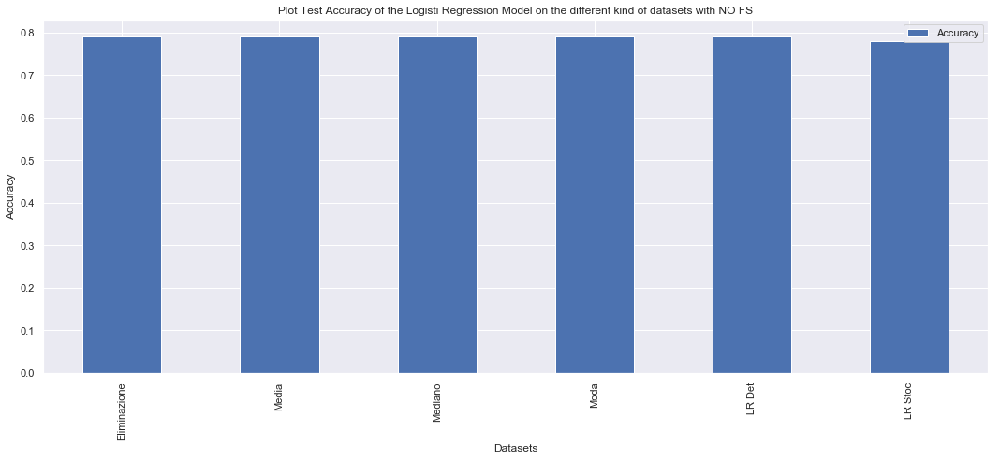

              Accuracy
Eliminazione  0.791209
Media         0.791209
Mediano       0.791209
Moda          0.791209
LR Det        0.791209
LR Stoc       0.780220


In [61]:
lreg_nofs_scores,lreg_nofs_recall,lreg_nofs_precision = test_lreg(Datasets,best_scores_nofs_lr,imputations,"NO FS",False)

RECALL Eliminazione 0.46843380500096915
PRECISION Eliminazione 0.43566433566433566
RECALL Media 0.5545125164690382
PRECISION Media 0.44726107226107226
RECALL Mediano 0.5228209601343929
PRECISION Mediano 0.46998834498834496
RECALL Moda 0.508080808080808
PRECISION Moda 0.500058275058275
RECALL LR Det 0.5365967365967367
PRECISION LR Det 0.4722610722610723
RECALL LR Stoc 0.5578304048892284
PRECISION LR Stoc 0.47575757575757577


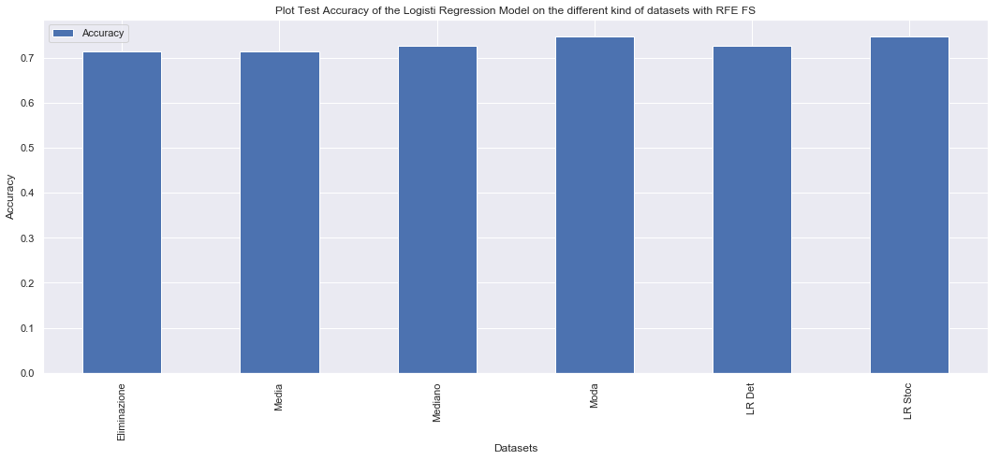

              Accuracy
Eliminazione  0.714286
Media         0.714286
Mediano       0.725275
Moda          0.747253
LR Det        0.725275
LR Stoc       0.747253


In [62]:
best_scores_rfe_lr = np.load("ResultsLREG/best_scores_rfe.npy")
lreg_rfe_scores,lreg_rfe_recall,lreg_rfe_precision = test_lreg(Datasets,best_scores_rfe_lr,imputations,"RFE FS")

RECALL Eliminazione 0.5010146103896104
PRECISION Eliminazione 0.47022144522144527
RECALL Media 0.4755793226381462
PRECISION Media 0.4454545454545455
RECALL Mediano 0.4755793226381462
PRECISION Mediano 0.4454545454545455
RECALL Moda 0.47661691542288553
PRECISION Moda 0.4454545454545455
RECALL LR Det 0.5164502164502164
PRECISION LR Det 0.47196969696969704
RECALL LR Stoc 0.4755793226381462
PRECISION LR Stoc 0.4454545454545455


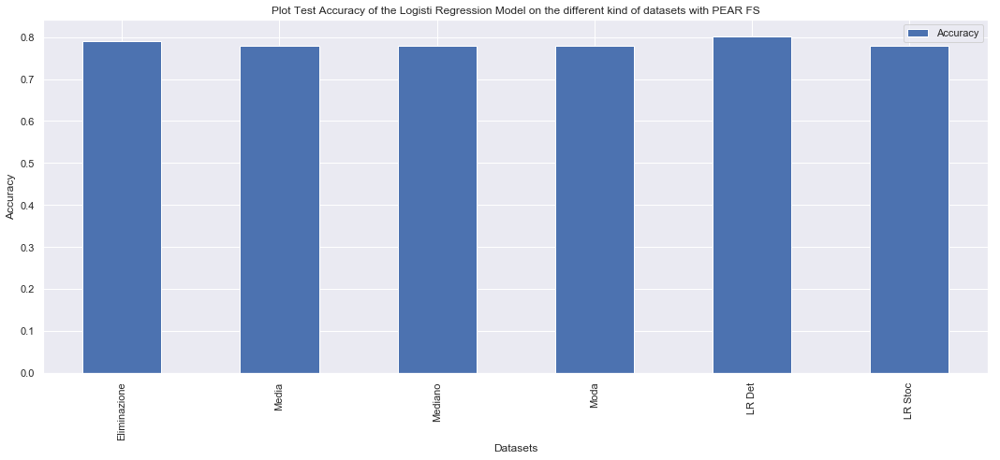

              Accuracy
Eliminazione  0.791209
Media         0.780220
Mediano       0.780220
Moda          0.780220
LR Det        0.802198
LR Stoc       0.780220


In [63]:
best_scores_pear_lr = np.load("ResultsLREG/best_scores_pear.npy")
lreg_pear_scores,lreg_pear_recall,lreg_pear_precision = test_lreg(Datasets,best_scores_pear_lr,imputations,"PEAR FS")

Somma explained variance:  0.9512342270600365
RECALL Eliminazione 0.5754820936639118
PRECISION Eliminazione 0.4810606060606061
Somma explained variance:  0.9508078435553989
RECALL Media 0.57049815855786
PRECISION Media 0.4611305361305362
Somma explained variance:  0.950792241293684
RECALL Mediano 0.5769886363636364
PRECISION Mediano 0.4906759906759907
Somma explained variance:  0.9508703134186229
RECALL Moda 0.5781385281385281
PRECISION Moda 0.4906759906759907
Somma explained variance:  0.9501688182493901
RECALL LR Det 0.5251082251082251
PRECISION LR Det 0.4815850815850817
Somma explained variance:  0.9514808356995111
RECALL LR Stoc 0.5608553063098518
PRECISION LR Stoc 0.48892773892773894


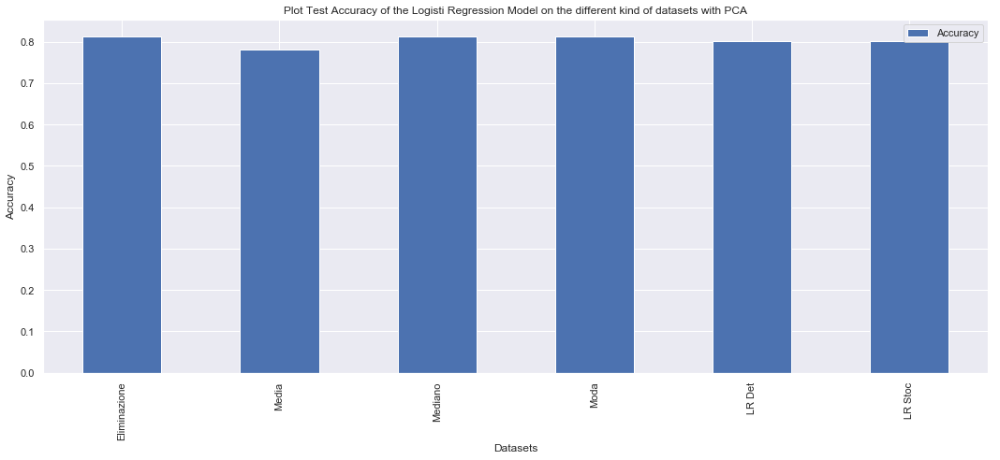

              Accuracy
Eliminazione  0.813187
Media         0.780220
Mediano       0.813187
Moda          0.813187
LR Det        0.802198
LR Stoc       0.802198


In [64]:
best_scores_pca_lr = np.load("ResultsLREG/best_scores_pca.npy")
lreg_pca_scores,lreg_pca_recall,lreg_pca_precision = test_lreg(Datasets,best_scores_pca_lr,imputations,"PCA",fs=False,pca=True)

In [65]:
lr_scores_dic = {
    "RFE":lreg_rfe_scores,
    "Pear":lreg_pear_scores,
    "NoFS":lreg_nofs_scores,
    "PCA":lreg_pca_scores
}
lr_recall_dic = {
    "RFE":lreg_rfe_recall,
    "Pear":lreg_pear_recall,
    "NoFS":lreg_nofs_recall,
    "PCA":lreg_pca_recall
}
lr_precision_dic = {
    "RFE":lreg_rfe_precision,
    "Pear":lreg_pear_precision,
    "NoFS":lreg_nofs_precision,
    "PCA":lreg_pca_precision
}
lr_scores = pd.DataFrame(lr_scores_dic,index=imputations)
lr_recalls = pd.DataFrame(lr_recall_dic,index=imputations)
lr_precision = pd.DataFrame(lr_precision_dic,index=imputations)




<a id="LogSummaryAccuracy"></a>
<h3>  Confronto tra le Accuracy delle tecniche utilizzate in questa sezione <a href="#indice" style="text-decoration:none;">↑</a></h3>


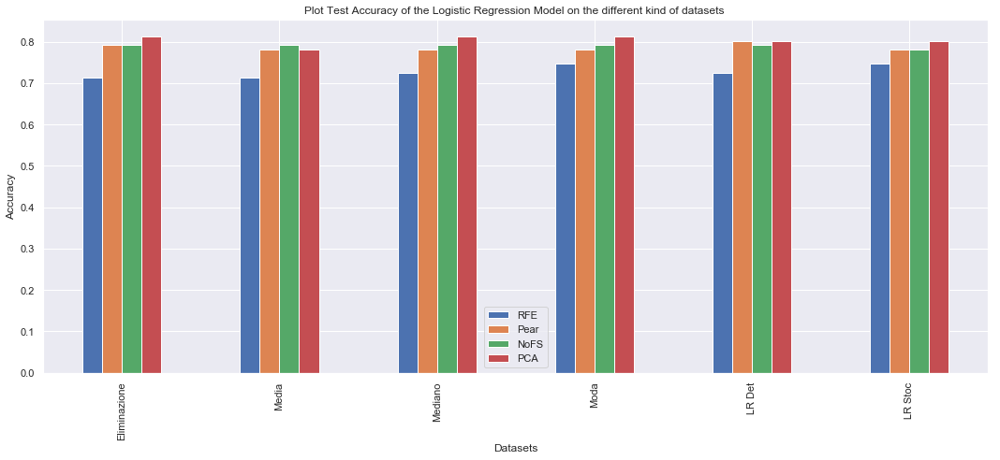

,RFE,Pear,NoFS,PCA
Eliminazione,0.714286,0.791209,0.791209,0.813187
Media,0.714286,0.780220,0.791209,0.780220
Mediano,0.725275,0.780220,0.791209,0.813187
Moda,0.747253,0.780220,0.791209,0.813187
LR Det,0.725275,0.802198,0.791209,0.802198
LR Stoc,0.747253,0.780220,0.780220,0.802198


In [66]:
fig, ax = plt.subplots(figsize=(15,7))
lr_scores.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Accuracy of the Logistic Regression Model on the different kind of datasets ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
lr_scores




<a id="LogSummaryRecall"></a>
<h3>  Confronto tra le Recall delle tecniche utilizzate in questa sezione <a href="#indice" style="text-decoration:none;">↑</a></h3>

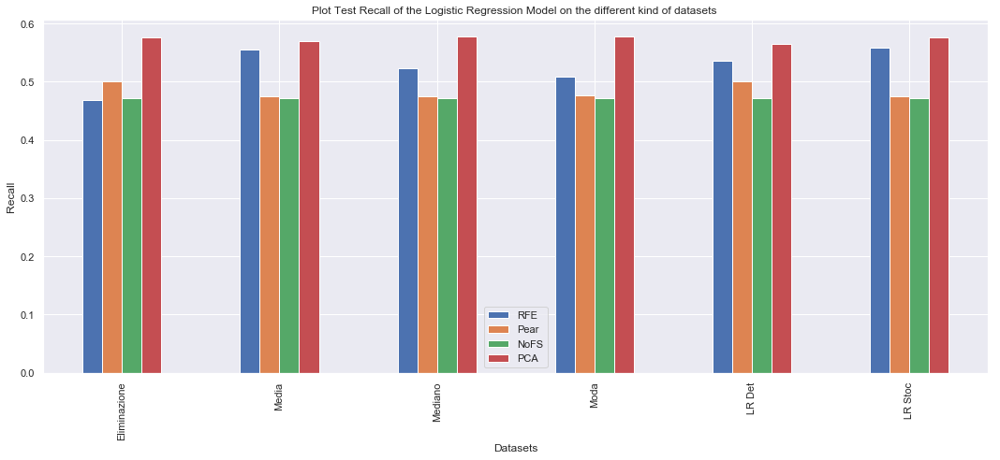

,RFE,Pear,NoFS,PCA
Eliminazione,0.468434,0.501015,0.470996,0.575482
Media,0.554513,0.475579,0.470996,0.570498
Mediano,0.522821,0.475579,0.470996,0.576989
Moda,0.508081,0.476617,0.471861,0.578139
LR Det,0.535537,0.501015,0.470996,0.564363
LR Stoc,0.557830,0.475579,0.470996,0.575482


In [740]:
fig, ax = plt.subplots(figsize=(15,7))
lr_recalls.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Recall of the Logistic Regression Model on the different kind of datasets ")
ax.set_ylabel('Recall')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
lr_recalls



<a id="LogSummaryPrecision"></a>
<h3>  Confronto tra le Precision delle tecniche utilizzate in questa sezione <a href="#indice" style="text-decoration:none;">↑</a></h3>

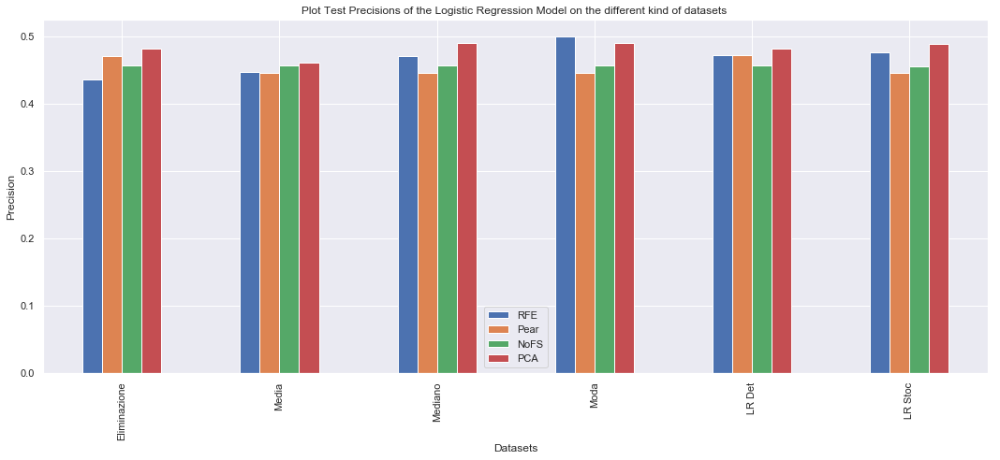

,RFE,Pear,NoFS,PCA
Eliminazione,0.435664,0.470221,0.456818,0.481061
Media,0.447261,0.445455,0.456818,0.461131
Mediano,0.469988,0.445455,0.456818,0.490676
Moda,0.500058,0.445455,0.456818,0.490676
LR Det,0.472261,0.471970,0.456818,0.481585
LR Stoc,0.475758,0.445455,0.455070,0.488928


In [67]:
fig, ax = plt.subplots(figsize=(15,7))
lr_precision.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Precisions of the Logistic Regression Model on the different kind of datasets ")
ax.set_ylabel('Precision')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
lr_precision

<a id="MLP"></a>
<h3> Multilayer Perceptron <a href="#indice" style="text-decoration:none;">↑</a></h3>


In [68]:
import IPython

import keras

Using TensorFlow backend.


In [69]:


def MLP(x_train,y_train_in,x_test,y_test_in):
    print(set(y_train_in))
    print(len(set(y_train_in)))
    n_classes = len(set(y_train_in))
    num_features = x_train.shape[1]
    # 1 to k
    print(x_train.shape)
    y_train_cat = []
    for i in range(len(y_train_in)):
        y_train_cat.append(keras.utils.to_categorical(y_train_in[i], num_classes=len(set(y_train_in))))
    y_train = np.asarray(y_train_cat)
    linmodel = keras.models.Sequential()
    linmodel.add(keras.layers.Dense(units=400, input_dim=num_features,activation='relu'))
    linmodel.add(keras.layers.Dropout(0.2))
    linmodel.add(keras.layers.Dense(units=1000,activation='relu'))
    linmodel.add(keras.layers.Dropout(0.2))
    linmodel.add(keras.layers.Dense(units=500,activation='relu'))
    linmodel.add(keras.layers.Dropout(0.2))
    #linmodel.add(keras.layers.Dense(units=8 ,activation='relu'))
    linmodel.add(keras.layers.Dense(units=len(set(y_train_in)), activation='softmax'))

    linmodel.compile(optimizer='adam', loss='categorical_crossentropy',
                            metrics=['accuracy'])
    epochs = 30
    linhistory = linmodel.fit(x_train, 
                              y_train,
                              validation_split=0.1,
                              epochs=epochs, 
                              batch_size=32,
                              verbose=1)
    print(linmodel.summary())
    plt.figure(figsize=(5,3))
    plt.plot(linhistory.epoch,linhistory.history['loss'])
    plt.title('loss')

    plt.figure(figsize=(5,3))
    plt.plot(linhistory.epoch,linhistory.history['accuracy'])
    plt.title('accuracy');

  
    
    
    predictions = linmodel.predict(x_test)
    y_test_cat = []
    for i in range(len(y_test_in)):
        y_test_cat.append(keras.utils.to_categorical(y_test_in[i], num_classes=len(set(y_train_in))))
    y_test = np.asarray(y_test_cat)
    print(linmodel.evaluate(x_test,y_test))
    return(linmodel.evaluate(x_test,y_test))

In [96]:
def preprocessing(y_train,y_test):
    y_train_multi = y_train
    y_test_multi = y_test
    dic = {}
    k= 0
    for i in set(y_train):
        dic[i] = k
        k+=1

    for x,k in zip(y_train,range(len(y_train))):
        y_train_multi[k] = dic[x]


    for x,k in zip(y_test,range(len(y_test))):
        y_test_multi[k] = dic[x]

    return(y_train_multi,y_test_multi)

In [ ]:
lista_NN_acc = []
for dataset in Datasets:
    y_train,y_test = preprocessing(dataset[1],dataset[3])
    x_train = dataset[0] 
    x_test = dataset[2]
    lista_NN_acc.append(MLP(x_train,y_train,x_test,y_test)[1])

In [71]:
dic_mlp = {
    "Accuracy": lista_NN_acc
}
accuracy_mlp_df = pd.DataFrame(dic_mlp,index=imputations)


<a id="MLPScores"></a>
<h3> Accuracy MLP sui diversi tipi di datasets<a href="#indice" style="text-decoration:none;">↑</a></h3>


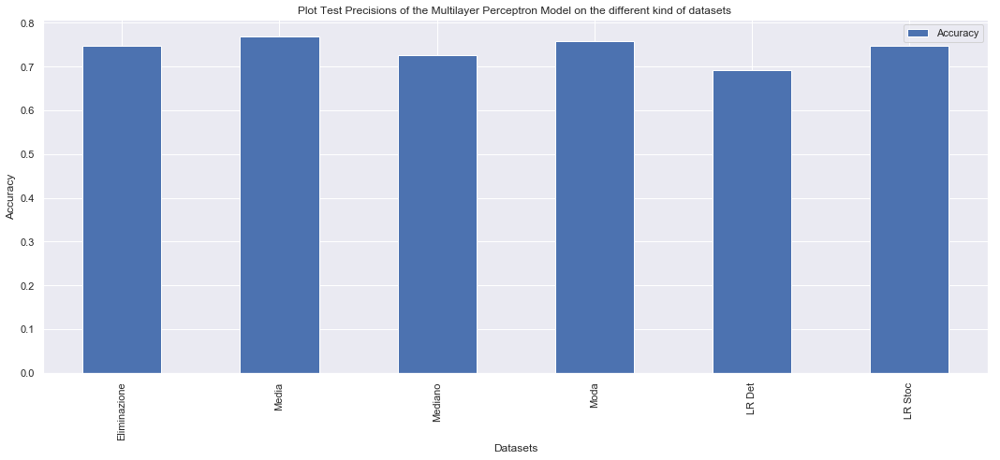

,Accuracy
Eliminazione,0.747253
Media,0.769231
Mediano,0.725275
Moda,0.758242
LR Det,0.692308
LR Stoc,0.747253


In [72]:

fig, ax = plt.subplots(figsize=(15,7))
accuracy_mlp_df.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Precisions of the Multilayer Perceptron Model on the different kind of datasets ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
accuracy_mlp_df

<a id="FinalMulticlass"></a>
<h3> Tabelle dei confronti dei diversi algoritmi di Learning applicati in questa sezione <a href="#indice" style="text-decoration:none;">↑</a></h3>


###### Tabella delle Accuracy dei modelli utilizzati con il Dataset ottenuto eliminando le features mancanti
<style type="text/css">
.tg  {border-collapse:collapse;border-spacing:0;}
.tg td{font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;}
.tg th{font-family:Arial, sans-serif;font-size:14px;font-weight:normal;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;}
.tg .tg-c3ow{border-color:inherit;text-align:center;vertical-align:top}
.tg .tg-fymr{font-weight:bold;border-color:inherit;text-align:left;vertical-align:top}
.tg .tg-0pky{border-color:inherit;text-align:left;vertical-align:top}
</style>
<table class="tg">
  <tr>
    <th class="tg-fymr">No Imputation</th>
    <th class="tg-0pky">Pearson</th>
    <th class="tg-0pky">RFE</th>
    <th class="tg-0pky">NOFS</th>
    <th class="tg-0pky">PCA</th>
  </tr>
  <tr>
    <td class="tg-0pky">SVM</td>
    <td class="tg-c3ow">0.74</td>
    <td class="tg-c3ow">0.71</td>
    <td class="tg-c3ow">0.73</td>
    <td class="tg-c3ow">0.57</td>
  </tr>
  <tr>
    <td class="tg-0pky">Random Forest</td>
    <td class="tg-c3ow">0.74</td>
    <td class="tg-c3ow">0.73</td>
    <td class="tg-c3ow">0.73</td>
    <td class="tg-c3ow">0.66</td>
  </tr>
  <tr>
    <td class="tg-0pky">ADA Boost</td>
    <td class="tg-c3ow">0.76</td>
    <td class="tg-c3ow">0.70</td>
    <td class="tg-c3ow">0.74</td>
    <td class="tg-c3ow">0.53</td>
  </tr>
  <tr>
    <td class="tg-0pky">Extra Trees</td>
    <td class="tg-c3ow">0.76</td>
    <td class="tg-c3ow">0.74</td>
    <td class="tg-c3ow">0.75</td>
    <td class="tg-c3ow">0.63</td>
  </tr>
  <tr>
    <td class="tg-0pky">Gradient Boosting</td>
    <td class="tg-c3ow">0.76</td>
    <td class="tg-c3ow">0.74</td>
    <td class="tg-c3ow">0.75</td>
    <td class="tg-c3ow">0.68</td>
  </tr>
  <tr>
    <td class="tg-0pky">XGradient Boosting</td>
    <td class="tg-c3ow">0.74</td>
    <td class="tg-c3ow">0.79</td>
    <td class="tg-c3ow">0.74</td>
    <td class="tg-c3ow">0.73</td>
  </tr>
  <tr>
    <td class="tg-0pky">Logistic Regression</td>
    <td class="tg-c3ow">0.79</td>
    <td class="tg-c3ow">0.71</td>
    <td class="tg-c3ow">0.79</td>
    <td class="tg-c3ow">0.81</td>
  </tr>
  <tr>
    <td class="tg-0pky">MLP<br></td>
    <td class="tg-c3ow">X</td>
    <td class="tg-c3ow">X</td>
    <td class="tg-c3ow">0.75</td>
    <td class="tg-c3ow">X</td>
  </tr>
  <tr>
    <td class="tg-0pky">K-NN</td>
    <td class="tg-c3ow">0.66</td>
    <td class="tg-c3ow">0.65</td>
    <td class="tg-c3ow">0.66</td>
    <td class="tg-c3ow">0.65</td>
  </tr>
</table>

Osserviamo esplicitamente che i migliori score di accuracy sono quelli della Logistic Regression. 

Dagli esperimenti effettuati, l'utilizzo della <strong>PCA per la Feature Extraction e della Logistic Regression</strong> per la classificazione sembrano essere la combinazione di tecniche che permettono di ottenere un livello di Accuracy molto elevato senza perdere di Precision e di Recall (si guardi la sezione dedicata).

Per quanto riguarda gli altri dataset ottenuti con i diversi tipi di imputazione, abbiamo ottenuto score di accuracy simili. Per ognuno di questi dataset la Regressione Logistica è risultato essere il metodo di learning più efficace sia in termini di accuracy che di precision e recall.

<a id="TwoClassifierArch"></a>
<h2> Approccio al problema utilizzando un'architettutura a due classificatori <a href="#indice" style="text-decoration:none;">↑</a></h3>



<a id="Why"></a>
<h3> Descrizione dell'idea <a href="#indice" style="text-decoration:none;">↑</a></h3>



L'idea è quella di dividere il processo di learning in due fasi.

Nella prima si esegue un task di classificazione binaria dove si cerca di capire se un dato paziente è sano oppure no.

Se il paziente risulta malato, si prosegue con la seconda fase nella quale si effettua una classificazione multipla per diagnosticare il tipo di aritmia cardiaca del paziente.

Si è scelto di effettuare questo tipo di analisi a due fasi poiché è molto importante, in un task di learning medico, rilevare i pazienti malati (se lo sono).



In [54]:
features = f_n.copy()
features.remove('t')

In [55]:
linear_s_regression[linear_s_regression!='t'].head()

,Age,Sex,Height_cm,Weight_kg,QRS_Duration,PR_interval,QT_Interval,T_Interval,P_interval,QRS,...,F_269,F_270,F_271,F_272,F_273,F_274,F_275,F_276,F_277,F_278
0,75,0,190,80,91,193,371,174,121,-16,...,-0.3,0.0,9.0,-0.9,0.0,0.0,0.9,2.9,23.3,49.4
1,56,1,165,64,81,174,401,149,39,25,...,-0.5,0.0,8.5,0.0,0.0,0.0,0.2,2.1,20.4,38.8
2,54,0,172,95,138,163,386,185,102,96,...,0.9,0.0,9.5,-2.4,0.0,0.0,0.3,3.4,12.3,49.0
3,55,0,175,94,100,202,380,179,143,28,...,0.1,0.0,12.2,-2.2,0.0,0.0,0.4,2.6,34.6,61.6
4,75,0,190,80,88,181,360,177,103,-16,...,-0.4,0.0,13.1,-3.6,0.0,0.0,-0.1,3.9,25.4,62.8


<a id="DatasetTransformation"></a>
<h3> Preprocessing dei dati e trasformazione del dataset <a href="#indice" style="text-decoration:none;">↑</a></h3>



In [94]:
# Sta bene = 0 male = 1

In [56]:
from sklearn.model_selection import StratifiedShuffleSplit

In [62]:
def preprocessing_datasets(dataset,target):
    X = dataset
    y = np.array(target)
    stratSplit = StratifiedShuffleSplit(n_splits=5, test_size=0.3, random_state=42)
    
    for train_idx, test_idx in stratSplit.split(X,y):
        X_train=X[train_idx]
        y_train=y[train_idx]
        X_test = X[test_idx]
        y_test = y[test_idx]
        
        
    y_train_bin = []
    y_test_bin = []
    for i in y_train:
        if(i == 1):
            y_train_bin.append(0)
        else:
            y_train_bin.append(1)
    for i in y_test:
        if(i == 1):
            y_test_bin.append(0)
        else:
            y_test_bin.append(1)
    

    y_train_multi = []
    y_test_multi = []
    L_train_multi = []
    L_test_multi = []
    j= 0 
    for i in y_train:
        if(i != 1):
            y_train_multi.append(i)
            L_train_multi.append(j)
        j+=1
    j=0
    for i in y_test:
        if(i != 1):
            y_test_multi.append(i)
            L_test_multi.append(j)
        j+=1
    X_train_multi = X_train[L_train_multi]
    X_test_multi = X_test[L_test_multi]

    dic = {}
    k= 0
    for i in set(y_train_multi):
        dic[i] = k
        k+=1

    for x,k in zip(y_train_multi,range(len(y_train_multi))):
        y_train_multi[k] = dic[x]


    for x,k in zip(y_test_multi,range(len(y_test_multi))):
        y_test_multi[k] = dic[x]

    return(X_train,X_test,X_train_multi,X_test_multi,y_train_bin,y_test_bin,y_train_multi,y_test_multi)


<a id="Binary"></a>
<h3> Modelli di Learning per le due fasi <a href="#indice" style="text-decoration:none;">↑</a></h3>


In [58]:
X_train,X_test,X_train_multi,X_test_multi,y_train_bin,y_test_bin,y_train_multi,y_test_multi = preprocessing_datasets(scaled_matrix_stoc_regression,data['t'])

In [59]:
Dataset = [[X_train,y_train_bin,X_test,y_test_bin]]

In [60]:
Dataset_m = [[X_train_multi,np.array(y_train_multi),X_test_multi,np.array(y_test_multi)]]


<a id="SVMB"></a>
<h3> SVM per capire se un paziente è malato o meno <a href="#indice" style="text-decoration:none;">↑</a></h3>



In [ ]:

tune_svm(Kernels,Degrees,Cs,Gamma,nfeats,[[X_train,np.array(y_train_bin)]],[[X_train,np.array(y_train_bin)]],"ResultsSVMBin") 

In [170]:
best_scores_binary_nofs = np.load("ResultsSVMBin/best_scores_nofs.npy")
best_scores_binary_pear = np.load("ResultsSVMBin/best_scores_pear.npy")
best_scores_binary_rfe = np.load("ResultsSVMBin/best_scores_rfe.npy")
best_scores_binary_pca = np.load("ResultsSVMBin/best_scores_pca.npy")


RECALL Stocastic Regression 0.8238636363636364
PRECISION Stocastic Regression 0.7981691368788143


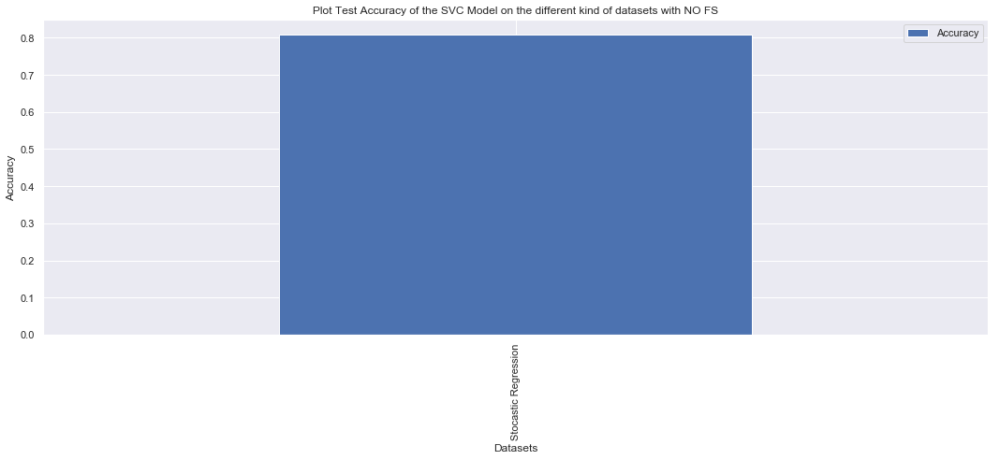

                      Accuracy
Stocastic Regression  0.808824
RECALL Stocastic Regression 0.27205882352941174
PRECISION Stocastic Regression 0.5


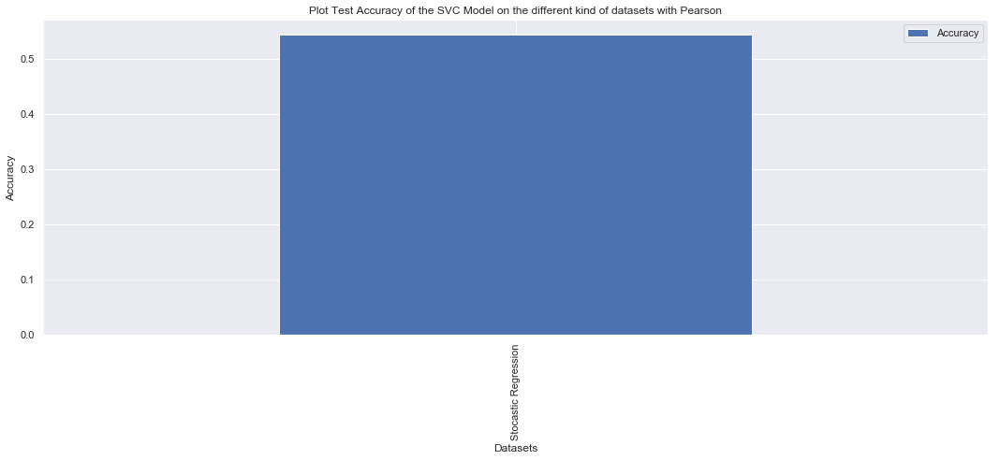

                      Accuracy
Stocastic Regression  0.544118
RECALL Stocastic Regression 0.725792349726776
PRECISION Stocastic Regression 0.7251525719267655


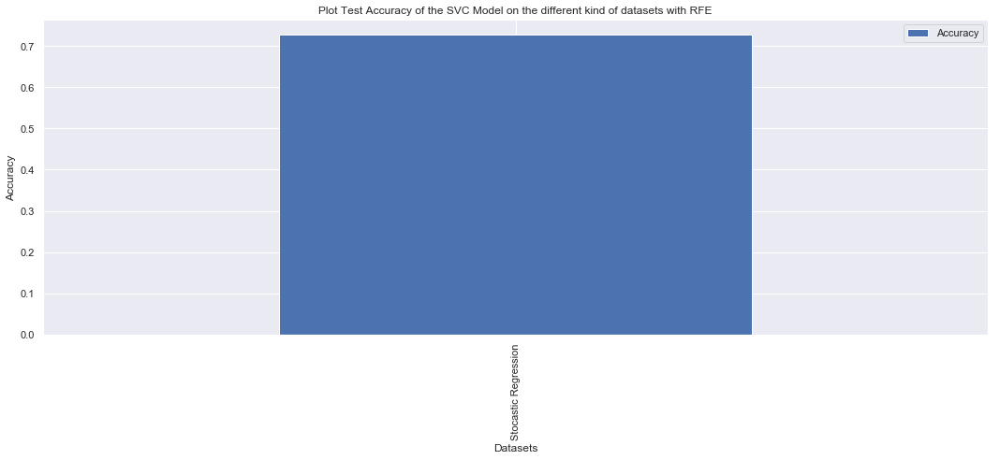

                      Accuracy
Stocastic Regression  0.727941
Somma explained variance:  0.9515521830710587
RECALL Stocastic Regression 0.27205882352941174
PRECISION Stocastic Regression 0.5


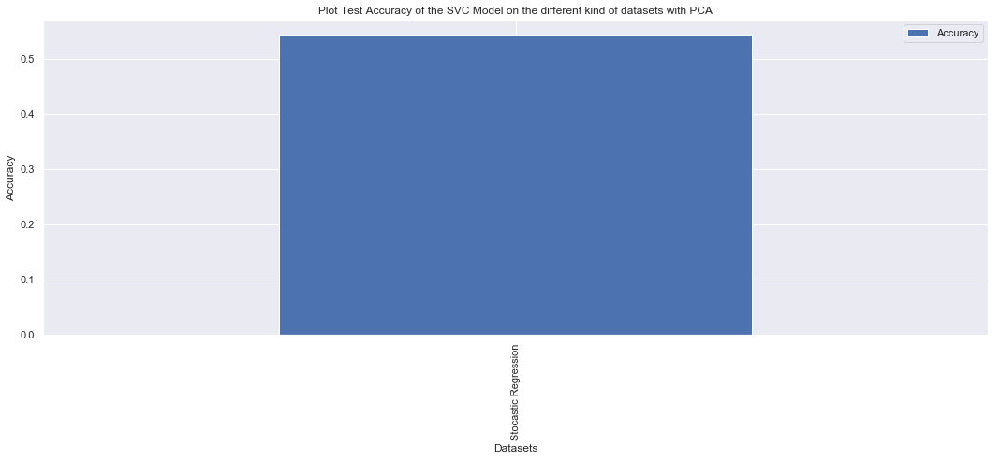

                      Accuracy
Stocastic Regression  0.544118


In [173]:
svm_nofs_scores_bin,svm_nofs_recall_bin,svm_nofs_precision_bin = test_svm([[X_train,np.array(y_train_bin),X_test,np.array(y_test_bin)]],best_scores_binary_nofs,["Stocastic Regression"],"NO FS",False)
svm_pear_scores_bin,svm_pear_recall_bin,svm_pear_precision_bin = test_svm([[X_train,np.array(y_train_bin),X_test,np.array(y_test_bin)]],best_scores_binary_pear,["Stocastic Regression"],"Pearson",True)
svm_rfe_scores_bin,svm_rfe_recall_bin,svm_rfe_precision_bin = test_svm([[X_train,np.array(y_train_bin),X_test,np.array(y_test_bin)]],best_scores_binary_rfe,["Stocastic Regression"],"RFE",True)
svm_pca_scores_bin,svm_pca_recall_bin,svm_pca_precision_bin = test_svm([[X_train,np.array(y_train_bin),X_test,np.array(y_test_bin)]],best_scores_binary_pca,["Stocastic Regression"],"PCA",False,True)




<a id="SCORESVMB"></a>
<h3> Accuracy, Precision e Recall <a href="#indice" style="text-decoration:none;">↑</a></h3>


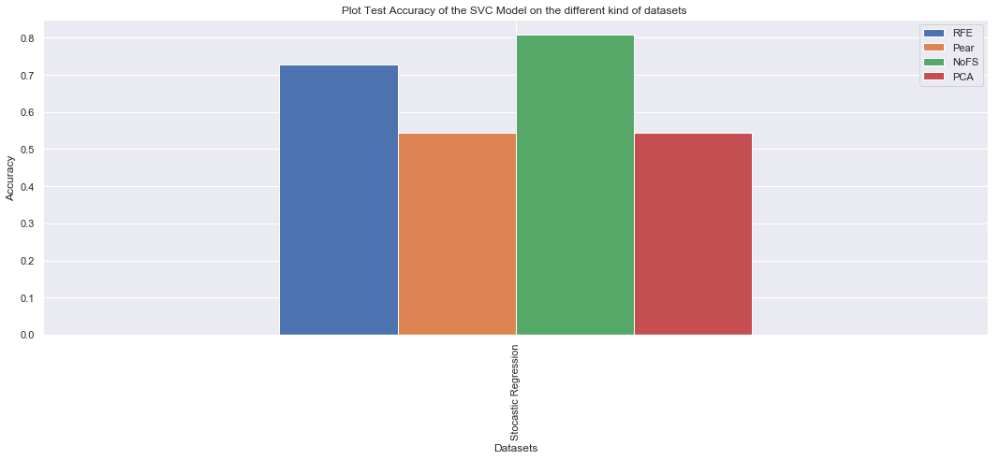

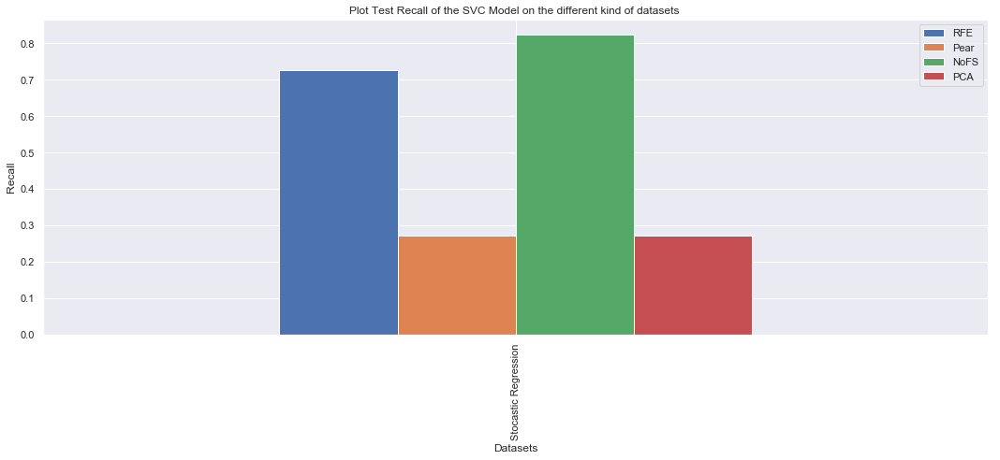

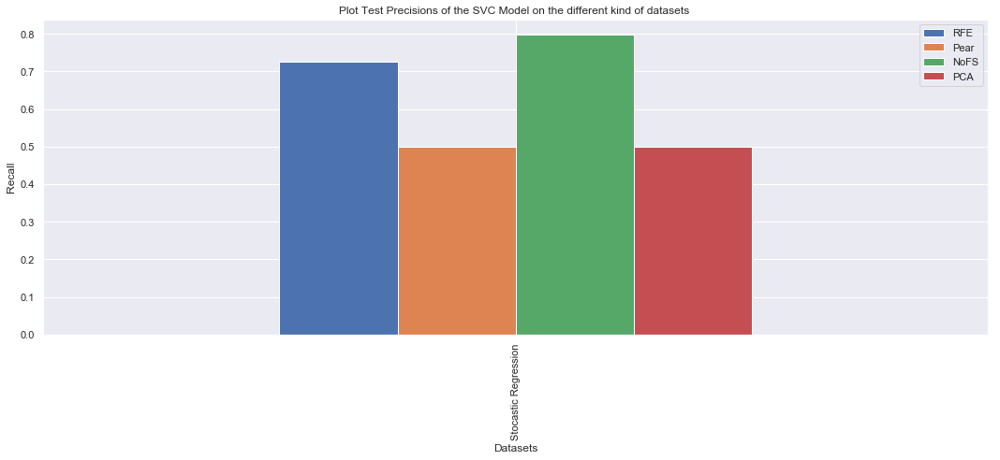

,RFE,Pear,NoFS,PCA
Stocastic Regression,0.725153,0.5,0.798169,0.5


In [174]:
svm_scores_dic = {
    "RFE":svm_rfe_scores_bin,
    "Pear":svm_pear_scores_bin,
    "NoFS":svm_nofs_scores_bin,
    "PCA":svm_pca_scores_bin
}
svm_recall_dic = {
    "RFE":svm_rfe_recall_bin,
    "Pear":svm_pear_recall_bin,
    "NoFS":svm_nofs_recall_bin,
    "PCA":svm_pca_recall_bin
}
svm_precision_dic = {
    "RFE":svm_rfe_precision_bin,
    "Pear":svm_pear_precision_bin,
    "NoFS":svm_nofs_precision_bin,
    "PCA":svm_pca_precision_bin
}
svm_scores = pd.DataFrame(svm_scores_dic,index=["Stocastic Regression"])
svm_recalls = pd.DataFrame(svm_recall_dic,index=["Stocastic Regression"])
svm_precision = pd.DataFrame(svm_precision_dic,index=["Stocastic Regression"])

fig, ax = plt.subplots(figsize=(15,7))
svm_scores.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Accuracy of the SVC Model on the different kind of datasets ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
svm_scores

fig, ax = plt.subplots(figsize=(15,7))
svm_recalls.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Recall of the SVC Model on the different kind of datasets ")
ax.set_ylabel('Recall')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
svm_recalls

fig, ax = plt.subplots(figsize=(15,7))
svm_precision.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Precisions of the SVC Model on the different kind of datasets ")
ax.set_ylabel('Recall')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
svm_precision



<a id="SVMM"></a>
<h3> SVM per Classificare il tipo di aritmia <a href="#indice" style="text-decoration:none;">↑</a></h3>



In [278]:

tune_svm(Kernels,Degrees,Cs,Gamma,nfeats,[[X_train_multi,np.array(y_train_multi)]],[[X_train_multi,np.array(y_train_multi)]],"ResultsSVMAnomaly") 


DATASET ELIMINAZIONE COLONNE
Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535059609522
Somma explained variance:  0.951993806159216
Somma explained variance:  0.9502709755026704
Somma explained variance:  0.9510752346770884
 FINE ESECUZIONE SVM
Kenrel linear
C 0.03125
 RISULTATI ACCURACY 
------ RFE------
0.5776190476190476
-----PEAR-------
0.5633333333333332
-----NO FS-------
0.5766666666666667
 ----- PCA ----- 
0.5928571428571429
Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance

Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535059609522
Somma explained variance:  0.951993806159216
Somma explained variance:  0.9502709755026704
Somma explained variance:  0.9510752346770884
FINE ESECUZIONE SVM 
Kernel  rbf
Grado 0
C 0.5
Gamma 8
 RISULTATI ACCURACY 
------ RFE------
0.20619047619047617
-----PEAR-------
0.20619047619047617
 ----- NO FS----- 
0.20619047619047617
 ----- PCA ----- 
0.21333333333333332
Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.950653505

Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535059609522
Somma explained variance:  0.951993806159216
Somma explained variance:  0.9502709755026704
Somma explained variance:  0.9510752346770884
FINE ESECUZIONE SVM 
Kernel  rbf
Grado 1
C 0.5
Gamma 8
 RISULTATI ACCURACY 
------ RFE------
0.20619047619047617
-----PEAR-------
0.20619047619047617
 ----- NO FS----- 
0.20619047619047617
 ----- PCA ----- 
0.21333333333333332
Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.950653505

Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535059609522
Somma explained variance:  0.951993806159216
Somma explained variance:  0.9502709755026704
Somma explained variance:  0.9510752346770884
FINE ESECUZIONE SVM 
Kernel  rbf
Grado 2
C 0.5
Gamma 8
 RISULTATI ACCURACY 
------ RFE------
0.20619047619047617
-----PEAR-------
0.20619047619047617
 ----- NO FS----- 
0.20619047619047617
 ----- PCA ----- 
0.21333333333333332
Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.950653505

Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535059609522
Somma explained variance:  0.951993806159216
Somma explained variance:  0.9502709755026704
Somma explained variance:  0.9510752346770884
FINE ESECUZIONE SVM 
Kernel  rbf
Grado 3
C 0.5
Gamma 8
 RISULTATI ACCURACY 
------ RFE------
0.20619047619047617
-----PEAR-------
0.20619047619047617
 ----- NO FS----- 
0.20619047619047617
 ----- PCA ----- 
0.21333333333333332
Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.950653505

Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535059609522
Somma explained variance:  0.951993806159216
Somma explained variance:  0.9502709755026704
Somma explained variance:  0.9510752346770884
FINE ESECUZIONE SVM 
Kernel  poly
Grado 0
C 0.5
Gamma 8
 RISULTATI ACCURACY 
------ RFE------
0.20619047619047617
-----PEAR-------
0.20619047619047617
 ----- NO FS----- 
0.20619047619047617
 ----- PCA ----- 
0.20619047619047617
Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.95065350

Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535059609522
Somma explained variance:  0.951993806159216
Somma explained variance:  0.9502709755026704
Somma explained variance:  0.9510752346770884
FINE ESECUZIONE SVM 
Kernel  poly
Grado 1
C 0.5
Gamma 8
 RISULTATI ACCURACY 
------ RFE------
0.5857142857142857
-----PEAR-------
0.6338095238095238
 ----- NO FS----- 
0.6057142857142856
 ----- PCA ----- 
0.6128571428571429
Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.950653505960

Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535059609522
Somma explained variance:  0.951993806159216
Somma explained variance:  0.9502709755026704
Somma explained variance:  0.9510752346770884
FINE ESECUZIONE SVM 
Kernel  poly
Grado 2
C 0.5
Gamma 8
 RISULTATI ACCURACY 
------ RFE------
0.47523809523809524
-----PEAR-------
0.4685714285714285
 ----- NO FS----- 
0.44857142857142857
 ----- PCA ----- 
0.4757142857142857
Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535059

Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535059609522
Somma explained variance:  0.951993806159216
Somma explained variance:  0.9502709755026704
Somma explained variance:  0.9510752346770884
FINE ESECUZIONE SVM 
Kernel  poly
Grado 3
C 0.5
Gamma 8
 RISULTATI ACCURACY 
------ RFE------
0.530952380952381
-----PEAR-------
0.46238095238095234
 ----- NO FS----- 
0.46238095238095234
 ----- PCA ----- 
0.4480952380952381
Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.95065350596

Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535059609522
Somma explained variance:  0.951993806159216
Somma explained variance:  0.9502709755026704
Somma explained variance:  0.9510752346770884
FINE ESECUZIONE SVM 
Kernel  sigmoid
Grado 0
C 0.5
Gamma 8
 RISULTATI ACCURACY 
------ RFE------
0.3771428571428571
-----PEAR-------
0.46238095238095234
 ----- NO FS----- 
0.42428571428571427
 ----- PCA ----- 
0.4742857142857142
Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535

Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535059609522
Somma explained variance:  0.951993806159216
Somma explained variance:  0.9502709755026704
Somma explained variance:  0.9510752346770884
FINE ESECUZIONE SVM 
Kernel  sigmoid
Grado 1
C 0.5
Gamma 8
 RISULTATI ACCURACY 
------ RFE------
0.3771428571428571
-----PEAR-------
0.46238095238095234
 ----- NO FS----- 
0.42428571428571427
 ----- PCA ----- 
0.4742857142857142
Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535

Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535059609522
Somma explained variance:  0.951993806159216
Somma explained variance:  0.9502709755026704
Somma explained variance:  0.9510752346770884
FINE ESECUZIONE SVM 
Kernel  sigmoid
Grado 2
C 0.5
Gamma 8
 RISULTATI ACCURACY 
------ RFE------
0.3771428571428571
-----PEAR-------
0.46238095238095234
 ----- NO FS----- 
0.42428571428571427
 ----- PCA ----- 
0.4742857142857142
Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535

Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535059609522
Somma explained variance:  0.951993806159216
Somma explained variance:  0.9502709755026704
Somma explained variance:  0.9510752346770884
FINE ESECUZIONE SVM 
Kernel  sigmoid
Grado 3
C 0.5
Gamma 8
 RISULTATI ACCURACY 
------ RFE------
0.3771428571428571
-----PEAR-------
0.46238095238095234
 ----- NO FS----- 
0.42428571428571427
 ----- PCA ----- 
0.4742857142857142
Somma explained variance:  0.9521466166692079
Somma explained variance:  0.9516115890527914
Somma explained variance:  0.9500990093419173
Somma explained variance:  0.9511751626726809
Somma explained variance:  0.9511670070074709
Somma explained variance:  0.9502014892689534
Somma explained variance:  0.9506535

In [279]:
best_scores_multi_nofs = np.load("ResultsSVMAnomaly/best_scores_nofs.npy")
best_scores_multi_pear = np.load("ResultsSVMAnomaly/best_scores_pear.npy")
best_scores_multi_rfe = np.load("ResultsSVMAnomaly/best_scores_rfe.npy")
best_scores_multi_pca = np.load("ResultsSVMAnomaly/best_scores_pca.npy")


RECALL Stocastic Regression 0.44186507936507935
PRECISION Stocastic Regression 0.4241987179487179


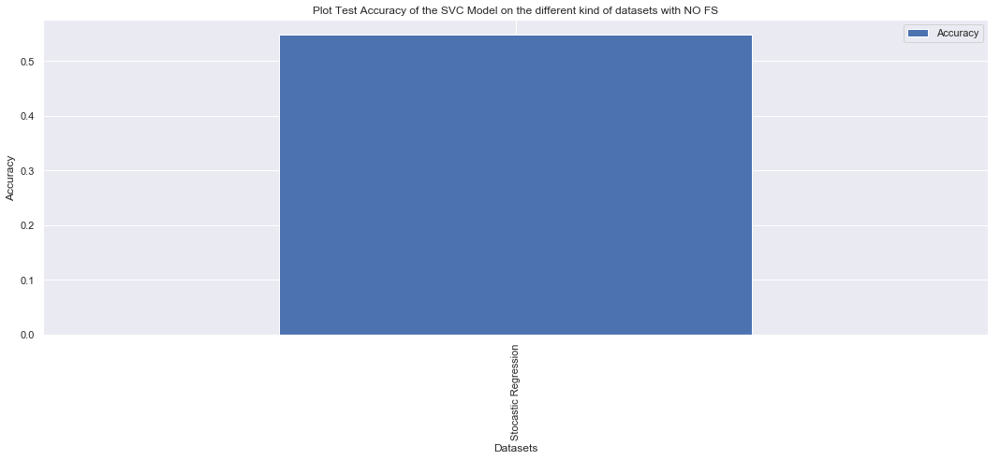

                      Accuracy
Stocastic Regression  0.548387
RECALL Stocastic Regression 0.45406746031746037
PRECISION Stocastic Regression 0.4569978632478633


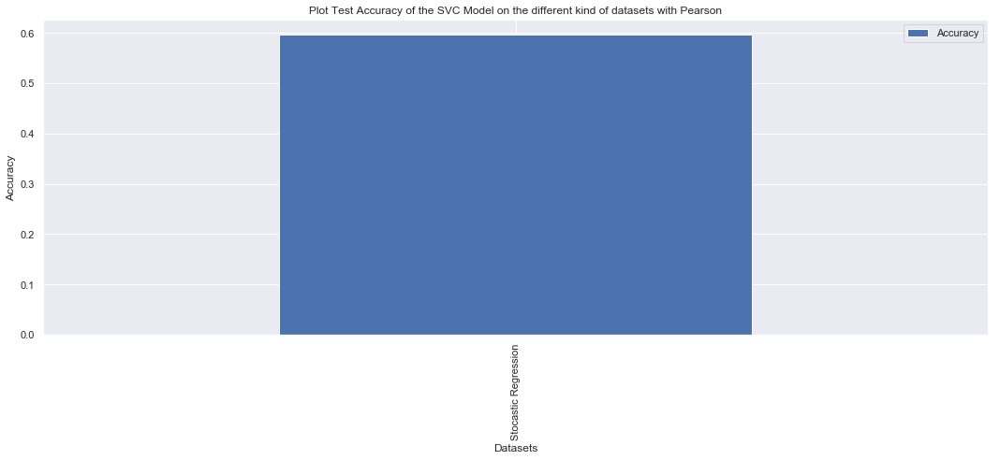

                      Accuracy
Stocastic Regression  0.596774
RECALL Stocastic Regression 0.3564018769901123
PRECISION Stocastic Regression 0.3902701465201466


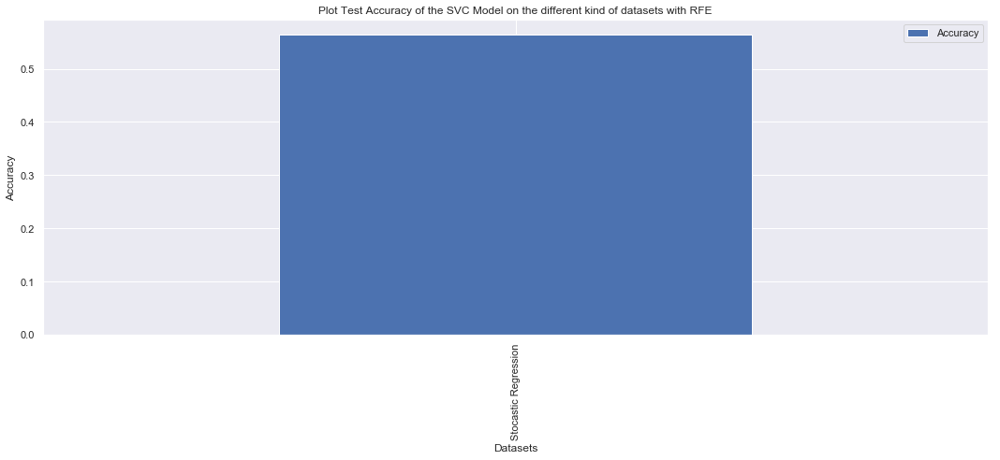

                      Accuracy
Stocastic Regression  0.564516
Somma explained variance:  0.9517844127520001
RECALL Stocastic Regression 0.4108630952380952
PRECISION Stocastic Regression 0.45213675213675214


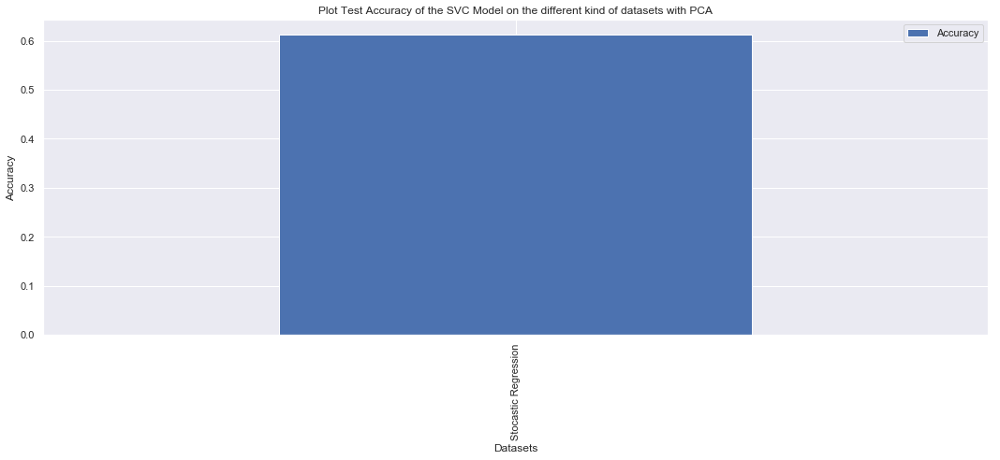

                      Accuracy
Stocastic Regression  0.612903


In [280]:
svm_nofs_scores_multi,svm_nofs_recall_multi,svm_nofs_precision_multi = test_svm([[X_train_multi,np.array(y_train_multi),X_test_multi,np.array(y_test_multi)]],best_scores_multi_nofs,["Stocastic Regression"],"NO FS",False)
svm_pear_scores_multi,svm_pear_recall_multi,svm_pear_precision_multi = test_svm([[X_train_multi,np.array(y_train_multi),X_test_multi,np.array(y_test_multi)]],best_scores_multi_pear,["Stocastic Regression"],"Pearson",True)
svm_rfe_scores_multi,svm_rfe_recall_multi,svm_rfe_precision_multi = test_svm([[X_train_multi,np.array(y_train_multi),X_test_multi,np.array(y_test_multi)]],best_scores_multi_rfe,["Stocastic Regression"],"RFE",True)
svm_pca_scores_multi,svm_pca_recall_multi,svm_pca_precision_multi = test_svm([[X_train_multi,np.array(y_train_multi),X_test_multi,np.array(y_test_multi)]],best_scores_multi_pca,["Stocastic Regression"],"PCA",False,True)





<a id="SCORESVMM"></a>
<h3> Accuracy, Precision e Recall <a href="#indice" style="text-decoration:none;">↑</a></h3>




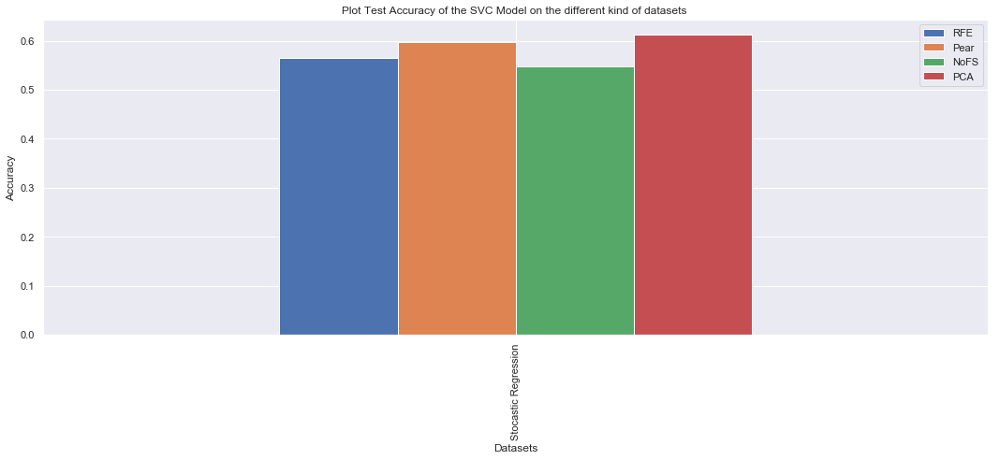

,RFE,Pear,NoFS,PCA
Stocastic Regression,0.564516,0.596774,0.548387,0.612903


In [291]:
svm_scores_dic = {
    "RFE":svm_rfe_scores_multi,
    "Pear":svm_pear_scores_multi,
    "NoFS":svm_nofs_scores_multi,
    "PCA":svm_pca_scores_multi
}
svm_recall_dic = {
    "RFE":svm_rfe_recall_multi,
    "Pear":svm_pear_recall_multi,
    "NoFS":svm_nofs_recall_multi,
    "PCA":svm_pca_recall_multi
}
svm_precision_dic = {
    "RFE":svm_rfe_precision_multi,
    "Pear":svm_pear_precision_multi,
    "NoFS":svm_nofs_precision_multi,
    "PCA":svm_pca_precision_multi
}
svm_scores = pd.DataFrame(svm_scores_dic,index=["Stocastic Regression"])
svm_recalls = pd.DataFrame(svm_recall_dic,index=["Stocastic Regression"])
svm_precision = pd.DataFrame(svm_precision_dic,index=["Stocastic Regression"])

fig, ax = plt.subplots(figsize=(15,7))
svm_scores.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Accuracy of the SVC Model on the different kind of datasets ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
svm_scores



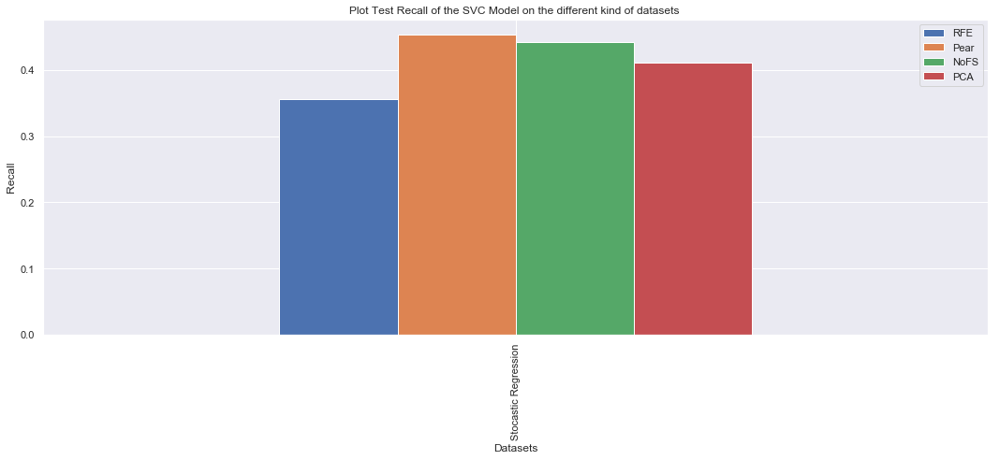

,RFE,Pear,NoFS,PCA
Stocastic Regression,0.356402,0.454067,0.441865,0.410863


In [292]:
fig, ax = plt.subplots(figsize=(15,7))
svm_recalls.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Recall of the SVC Model on the different kind of datasets ")
ax.set_ylabel('Recall')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
svm_recalls



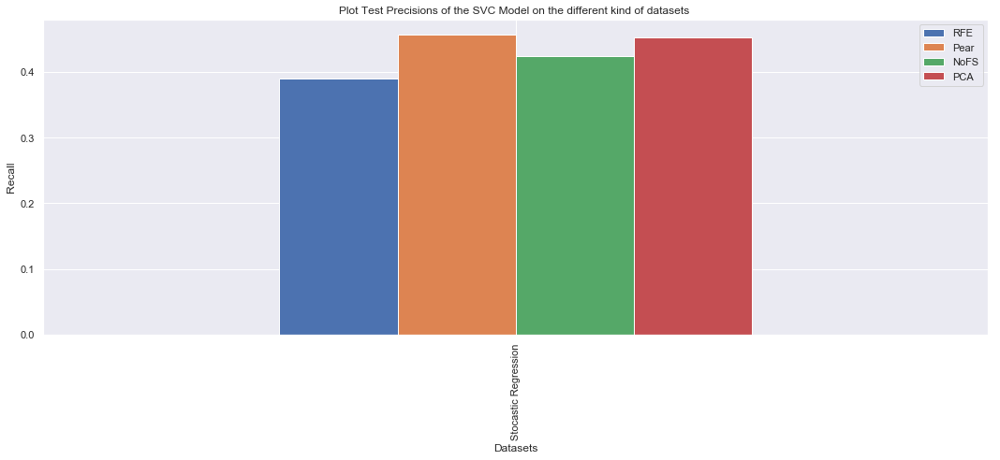

,RFE,Pear,NoFS,PCA
Stocastic Regression,0.39027,0.456998,0.424199,0.452137


In [293]:
fig, ax = plt.subplots(figsize=(15,7))
svm_precision.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Precisions of the SVC Model on the different kind of datasets ")
ax.set_ylabel('Recall')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
svm_precision

<a id="KNNB"></a>
<h3> K-NN per capire se un paziente è malato o meno <a href="#indice" style="text-decoration:none;">↑</a></h3>


In [186]:
lista_knn_pear = []
lista_knn_rfe = []
lista_knn_pca = []
lista_knn_nofs = []
j=0

for i in Dataset:
    print("DATASET :",imputations[j])
    # --- No FS
    x_train_nofs = i[0]
    x_test_nofs = i[2]
    # --- Pearson FS
    indexes_p = Pearson_FS(i[0])
    x_train_p = i[0][:,indexes_p]
    x_test_p = i[2][:,indexes_p]
    
    # --- RFE FS


    indexes_rfe = RFE_FS(i[0],i[1],15)
    x_train_rfe =i[0][:,indexes_rfe]
    x_test_rfe = i[2][:,indexes_rfe]
    
    # -- PCA
    x_train_pca,x_test_pca = get_PCA(i[0],i[2])
    
    
    y_train = i[1]
    y_test =i[3]
    
    # -- KNN NO FS
    
    opt_k_nofs = sceltak(x_train_nofs,y_train)
    print("OPT K- NO FS :", opt_k_nofs)
    #scelta del parametro k per approccio DatasetOriginale
    knn_nofs = KNN(n_neighbors=opt_k_nofs,weights="distance")
    knn_nofs.fit(x_train_nofs,y_train)
    knn_nofs_predictions= knn_nofs.predict(x_test_nofs)
    knn_nofs_score = knn_nofs.score(x_test_nofs,y_test)
    rec_knn_nofs = recall_score(knn_nofs_predictions,y_test,average = "macro")
    prec_knn_nofs = precision_score(knn_nofs_predictions,y_test,average = "macro")
     
    lista_knn_nofs.append([knn_nofs_score,prec_knn_nofs,rec_knn_nofs,precision_recall_classes(confusion_matrix(y_test,knn_nofs_predictions),list(set(y_test)))])
    
    
    
    # -- KNN Pearson
    opt_k_pearson = sceltak(x_train_p,y_train)
    print("OPT K- Pearson :", opt_k_pearson)
    #scelta del parametro k per approccio DatasetOriginale
    knn_p = KNN(n_neighbors=opt_k_pearson,weights="distance")
    knn_p.fit(x_train_p,y_train)
    knn_p_predictions= knn_p.predict(x_test_p)
    knn_p_score = knn_p.score(x_test_p,y_test)
    rec_knn_p = recall_score(knn_p_predictions,y_test,average = "macro")
    prec_knn_p = precision_score(knn_p_predictions,y_test,average = "macro")
     
    lista_knn_pear.append([knn_p_score,prec_knn_p,rec_knn_p,precision_recall_classes(confusion_matrix(y_test,knn_p_predictions),list(set(y_test)))])
    
    # -- KNN RFE
    
    opt_k_rfe = sceltak(x_train_rfe,y_train)
    print("OPT K- RFE :", opt_k_rfe)
    #scelta del parametro k per approccio DatasetOriginale
    knn_r = KNN(n_neighbors=opt_k_rfe,weights="distance")
    knn_r.fit(x_train_rfe,y_train)
    knn_r_predictions= knn_r.predict(x_test_rfe)
    knn_r_score = knn_r.score(x_test_rfe,y_test)
    rec_knn_r = recall_score(knn_r_predictions,y_test,average = "macro")
    prec_knn_r = precision_score(knn_r_predictions,y_test,average = "macro")
 
    lista_knn_rfe.append([knn_r_score,prec_knn_r,rec_knn_r,precision_recall_classes(confusion_matrix(y_test,knn_r_predictions),list(set(y_test)))])
    
    # -- KNN PCA
    
    opt_k_pca = sceltak(x_train_pca,y_train)
    print("OPT K- PCA :", opt_k_pca)
    #scelta del parametro k per approccio DatasetOriginale
    knn_pca = KNN(n_neighbors=opt_k_pca,weights="distance")
    knn_pca.fit(x_train_pca,y_train)
    knn_pca_predictions= knn_pca.predict(x_test_pca)
    knn_pca_score = knn_pca.score(x_test_pca,y_test)
    rec_knn_pca = recall_score(knn_pca_predictions,y_test,average = "macro")
    prec_knn_pca = precision_score(knn_pca_predictions,y_test,average = "macro")
 
    lista_knn_pca.append([knn_pca_score,prec_knn_pca,rec_knn_pca,precision_recall_classes(confusion_matrix(y_test,knn_pca_predictions),list(set(y_test)))])
    
    print("NOFS\t ACCURACY:",knn_nofs_score," Recall ", rec_knn_nofs," Precision ",prec_knn_nofs,"\n")
    print("PEARSON\t ACCURACY:",knn_p_score," Recall ", rec_knn_p," Precision ",prec_knn_p,"\n")
    print("RFE\t ACCURACY:",knn_r_score," Recall ", rec_knn_r," Precision ",prec_knn_r, "\n")
    print("PCA\t ACCURACY:",knn_pca_score," Recall ", rec_knn_pca," Precision ",prec_knn_pca, "\n")
    print("\n\n")
    j+=1

    

dic = [{"Scores_Pear": lista_knn_pear,
       "K_Pear":opt_k_pearson,
      "Scores_RFE":lista_knn_rfe,
       "K_RFE":opt_k_rfe,
       "Scores_Pca": lista_knn_pca,
       "K_PCA":opt_k_pca,
       "Scores_NoFs": lista_knn_nofs,
       "K_NoFs": opt_k_nofs
      
      }]
np.save("ResultsKNN/KnnResults_binary.npy", dic)



DATASET : Eliminazione
OPTIMAL K:  3
ACCURACY:  0.6327010019550343
OPT K- NO FS : 3
OPTIMAL K:  3
ACCURACY:  0.6262432795698925
OPT K- Pearson : 3
OPTIMAL K:  3
ACCURACY:  0.7406708211143695
OPT K- RFE : 3
OPTIMAL K:  3
ACCURACY:  0.63309811827957
OPT K- PCA : 3
NOFS	 ACCURACY: 0.6544117647058824  Recall  0.7008154943934761  Precision  0.6288142981691369 

PEARSON	 ACCURACY: 0.6397058823529411  Recall  0.6777098199116547  Precision  0.6139930252833479 

RFE	 ACCURACY: 0.7573529411764706  Recall  0.7788197049262315  Precision  0.743025283347864 

PCA	 ACCURACY: 0.6691176470588235  Recall  0.7061443932411674  Precision  0.6462510897994769 






<a id="KNNM"></a>
<h3> K-NN per Classificare il tipo di aritmia<a href="#indice" style="text-decoration:none;">↑</a></h3>


In [282]:
lista_knn_pear = []
lista_knn_rfe = []
lista_knn_pca = []
lista_knn_nofs = []
j=0
Dataset = [[X_train_multi,y_train_multi,X_test_multi,y_test_multi]]
for i in Dataset:
    print("DATASET :",imputations[j])
    # --- No FS
    x_train_nofs = i[0]
    x_test_nofs = i[2]
    # --- Pearson FS
    indexes_p = Pearson_FS(i[0])
    x_train_p = i[0][:,indexes_p]
    x_test_p = i[2][:,indexes_p]
    
    # --- RFE FS


    indexes_rfe = RFE_FS(i[0],i[1],15)
    x_train_rfe =i[0][:,indexes_rfe]
    x_test_rfe = i[2][:,indexes_rfe]
    
    # -- PCA
    x_train_pca,x_test_pca = get_PCA(i[0],i[2])
    
    
    y_train = i[1]
    y_test =i[3]
    
    # -- KNN NO FS
    
    opt_k_nofs = sceltak(x_train_nofs,y_train)
    print("OPT K- NO FS :", opt_k_nofs)
    #scelta del parametro k per approccio DatasetOriginale
    knn_nofs = KNN(n_neighbors=opt_k_nofs,weights="distance")
    knn_nofs.fit(x_train_nofs,y_train)
    knn_nofs_predictions= knn_nofs.predict(x_test_nofs)
    knn_nofs_score = knn_nofs.score(x_test_nofs,y_test)
    rec_knn_nofs = recall_score(knn_nofs_predictions,y_test,average = "macro")
    prec_knn_nofs = precision_score(knn_nofs_predictions,y_test,average = "macro")
     
    lista_knn_nofs.append([knn_nofs_score,prec_knn_nofs,rec_knn_nofs,precision_recall_classes(confusion_matrix(y_test,knn_nofs_predictions),list(set(y_test)))])
    
    
    
    # -- KNN Pearson
    opt_k_pearson = sceltak(x_train_p,y_train)
    print("OPT K- Pearson :", opt_k_pearson)
    #scelta del parametro k per approccio DatasetOriginale
    knn_p = KNN(n_neighbors=opt_k_pearson,weights="distance")
    knn_p.fit(x_train_p,y_train)
    knn_p_predictions= knn_p.predict(x_test_p)
    knn_p_score = knn_p.score(x_test_p,y_test)
    rec_knn_p = recall_score(knn_p_predictions,y_test,average = "macro")
    prec_knn_p = precision_score(knn_p_predictions,y_test,average = "macro")
     
    lista_knn_pear.append([knn_p_score,prec_knn_p,rec_knn_p,precision_recall_classes(confusion_matrix(y_test,knn_p_predictions),list(set(y_test)))])
    
    # -- KNN RFE
    
    opt_k_rfe = sceltak(x_train_rfe,y_train)
    print("OPT K- RFE :", opt_k_rfe)
    #scelta del parametro k per approccio DatasetOriginale
    knn_r = KNN(n_neighbors=opt_k_rfe,weights="distance")
    knn_r.fit(x_train_rfe,y_train)
    knn_r_predictions= knn_r.predict(x_test_rfe)
    knn_r_score = knn_r.score(x_test_rfe,y_test)
    rec_knn_r = recall_score(knn_r_predictions,y_test,average = "macro")
    prec_knn_r = precision_score(knn_r_predictions,y_test,average = "macro")
 
    lista_knn_rfe.append([knn_r_score,prec_knn_r,rec_knn_r,precision_recall_classes(confusion_matrix(y_test,knn_r_predictions),list(set(y_test)))])
    
    # -- KNN PCA
    
    opt_k_pca = sceltak(x_train_pca,y_train)
    print("OPT K- PCA :", opt_k_pca)
    #scelta del parametro k per approccio DatasetOriginale
    knn_pca = KNN(n_neighbors=opt_k_pca,weights="distance")
    knn_pca.fit(x_train_pca,y_train)
    knn_pca_predictions= knn_pca.predict(x_test_pca)
    knn_pca_score = knn_pca.score(x_test_pca,y_test)
    rec_knn_pca = recall_score(knn_pca_predictions,y_test,average = "macro")
    prec_knn_pca = precision_score(knn_pca_predictions,y_test,average = "macro")
 
    lista_knn_pca.append([knn_pca_score,prec_knn_pca,rec_knn_pca,precision_recall_classes(confusion_matrix(y_test,knn_pca_predictions),list(set(y_test)))])
    
    print("NOFS\t ACCURACY:",knn_nofs_score," Recall ", rec_knn_nofs," Precision ",prec_knn_nofs,"\n")
    print("PEARSON\t ACCURACY:",knn_p_score," Recall ", rec_knn_p," Precision ",prec_knn_p,"\n")
    print("RFE\t ACCURACY:",knn_r_score," Recall ", rec_knn_r," Precision ",prec_knn_r, "\n")
    print("PCA\t ACCURACY:",knn_pca_score," Recall ", rec_knn_pca," Precision ",prec_knn_pca, "\n")
    print("\n\n")
    j+=1

    






DATASET : Eliminazione
OPTIMAL K:  5
ACCURACY:  0.5574224713195302
OPT K- NO FS : 5
OPTIMAL K:  7
ACCURACY:  0.5812822798116917
OPT K- Pearson : 7
OPTIMAL K:  3
ACCURACY:  0.6390881667352255
OPT K- RFE : 3
OPTIMAL K:  1
ACCURACY:  0.542645916175328
OPT K- PCA : 1
NOFS	 ACCURACY: 0.4838709677419355  Recall  0.36112914862914863  Precision  0.31485042735042734 

PEARSON	 ACCURACY: 0.5483870967741935  Recall  0.42037037037037034  Precision  0.3540598290598291 

RFE	 ACCURACY: 0.5645161290322581  Recall  0.3692742374727669  Precision  0.37868589743589737 

PCA	 ACCURACY: 0.43548387096774194  Recall  0.3292186571598336  Precision  0.2938568376068376 






<a id="LREGB"></a>
<h3> Logistic Regression per capire se un paziente è malato o meno <a href="#indice" style="text-decoration:none;">↑</a></h3>


In [71]:
Dataset = [[X_train,np.array(y_train_bin),X_test,np.array(y_test_bin)]]

In [ ]:
train_logistic_regression(Dataset,C,penalty,['Stocastic Regression'],"ResultsLREGBin")

In [202]:
best_scores_nofs_lr_bin = np.load("ResultsLREGBin/best_scores_nofs.npy")
best_scores_pear_lr_bin = np.load("ResultsLREGBin/best_scores_pear.npy")
best_scores_rfe_lr_bin = np.load("ResultsLREGBin/best_scores_rfe.npy")
best_scores_pca_lr_bin = np.load("ResultsLREGBin/best_scores_pca.npy")

RECALL Stocastic Regression 0.8344489600765002
PRECISION Stocastic Regression 0.804925893635571


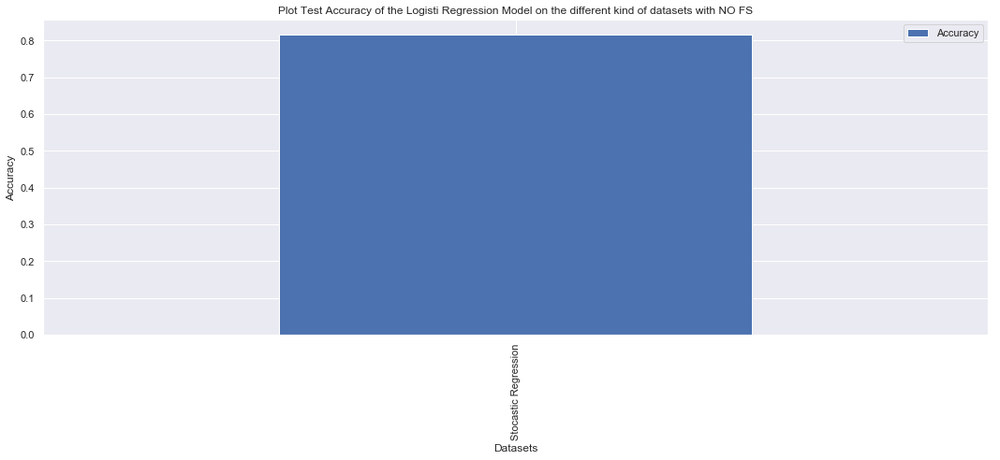

                      Accuracy
Stocastic Regression  0.816176
RECALL Stocastic Regression 0.8344489600765002
PRECISION Stocastic Regression 0.804925893635571


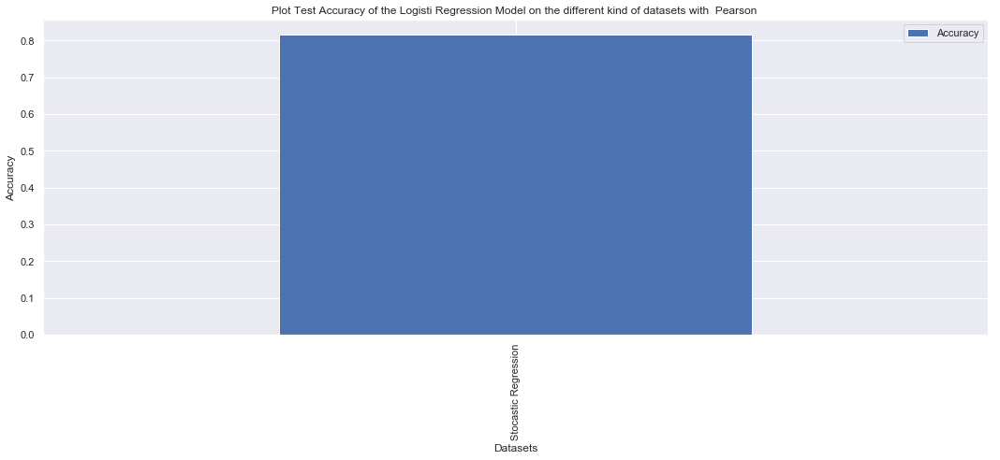

                      Accuracy
Stocastic Regression  0.816176
RECALL Stocastic Regression 0.8019364092756395
PRECISION Stocastic Regression 0.775283347863993


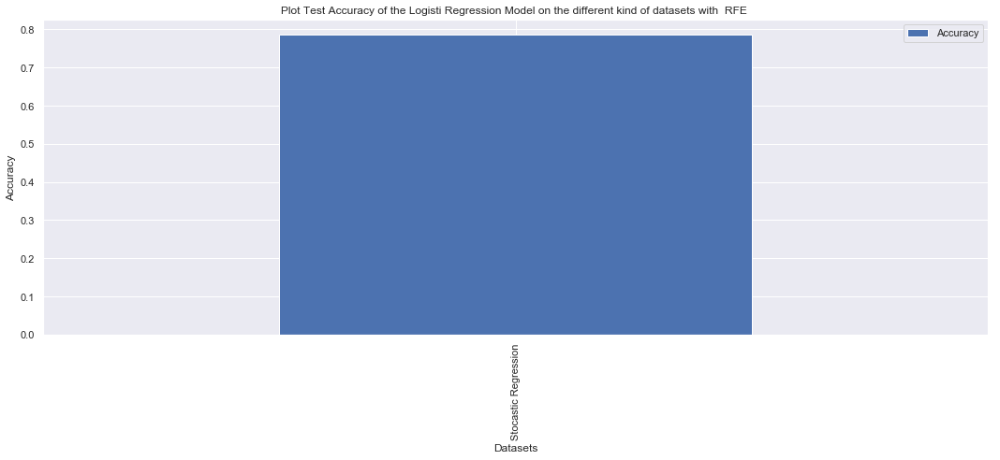

                      Accuracy
Stocastic Regression  0.786765
Somma explained variance:  0.9515521830710587
RECALL Stocastic Regression 0.7916666666666667
PRECISION Stocastic Regression 0.7685265911072363


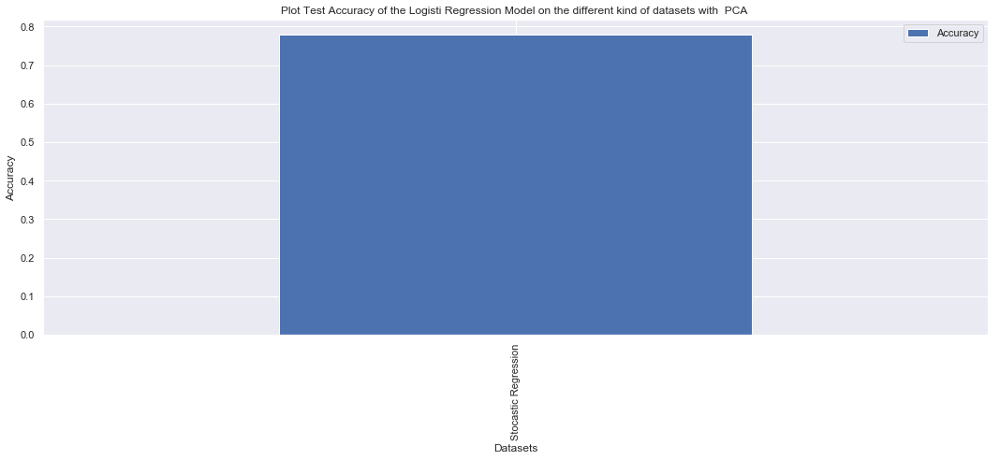

                      Accuracy
Stocastic Regression  0.779412


In [203]:
lreg_nofs_scores_bin,lreg_nofs_recall_bin,lreg_nofs_precision_bin = test_lreg(Dataset,best_scores_nofs_lr_bin,["Stocastic Regression"],"NO FS",False)
lreg_pear_scores_bin,lreg_pear_recall_bin,lreg_pear_precision_bin = test_lreg(Dataset,best_scores_pear_lr_bin,["Stocastic Regression"]," Pearson ",True)
lreg_rfe_scores_bin,lreg_rfe_recall_bin,lreg_rfe_precision_bin = test_lreg(Dataset,best_scores_rfe_lr_bin,["Stocastic Regression"]," RFE ",True)
lreg_pca_scores_bin,lreg_pca_recall_bin,lreg_pca_precision_bin = test_lreg(Dataset,best_scores_pca_lr_bin,["Stocastic Regression"]," PCA ",False,True)


In [204]:
lr_scores_dic = {
    "RFE":lreg_rfe_scores_bin,
    "Pear":lreg_pear_scores_bin,
    "NoFS":lreg_nofs_scores_bin,
    "PCA":lreg_pca_scores_bin
}
lr_recall_dic = {
    "RFE":lreg_rfe_recall_bin,
    "Pear":lreg_pear_recall_bin,
    "NoFS":lreg_nofs_recall_bin,
    "PCA":lreg_pca_recall_bin
}
lr_precision_dic = {
    "RFE":lreg_rfe_precision_bin,
    "Pear":lreg_pear_precision_bin,
    "NoFS":lreg_nofs_precision_bin,
    "PCA":lreg_pca_precision_bin
}
lr_scores = pd.DataFrame(lr_scores_dic,index=['Stocastic Regression'])
lr_recalls = pd.DataFrame(lr_recall_dic,index=['Stocastic Regression'])
lr_precision = pd.DataFrame(lr_precision_dic,index=['Stocastic Regression'])





<a id="SCORELREGB"></a>
<h3> Accuracy, Precision e Recall <a href="#indice" style="text-decoration:none;">↑</a></h3>


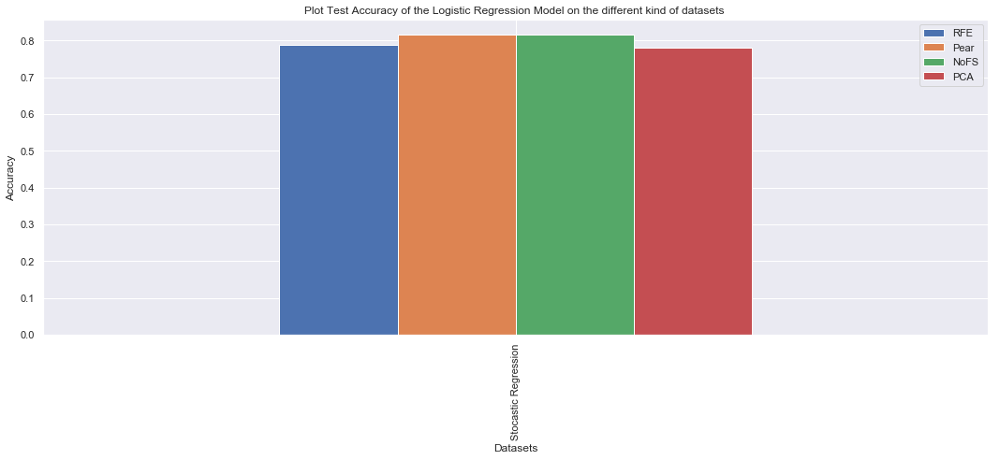

,RFE,Pear,NoFS,PCA
Stocastic Regression,0.786765,0.816176,0.816176,0.779412


In [205]:
fig, ax = plt.subplots(figsize=(15,7))
lr_scores.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Accuracy of the Logistic Regression Model on the different kind of datasets ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
lr_scores


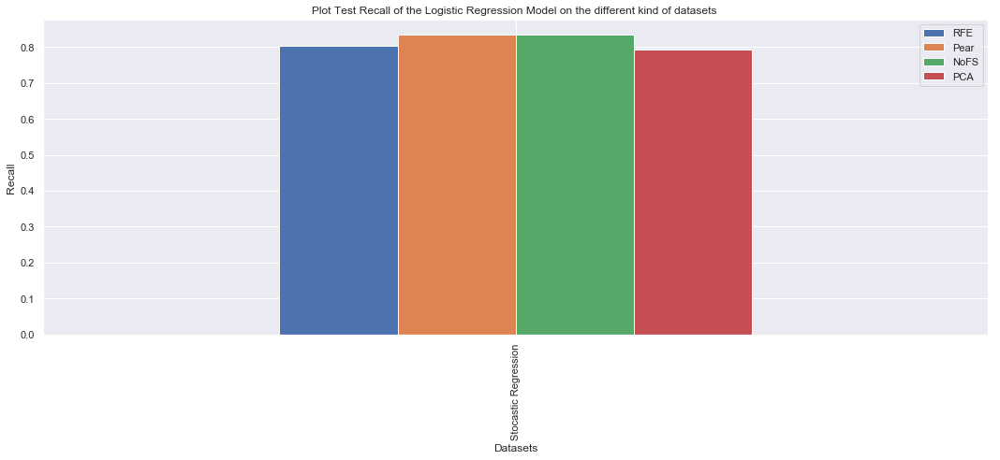

,RFE,Pear,NoFS,PCA
Stocastic Regression,0.801936,0.834449,0.834449,0.791667


In [206]:
fig, ax = plt.subplots(figsize=(15,7))
lr_recalls.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Recall of the Logistic Regression Model on the different kind of datasets ")
ax.set_ylabel('Recall')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
lr_recalls


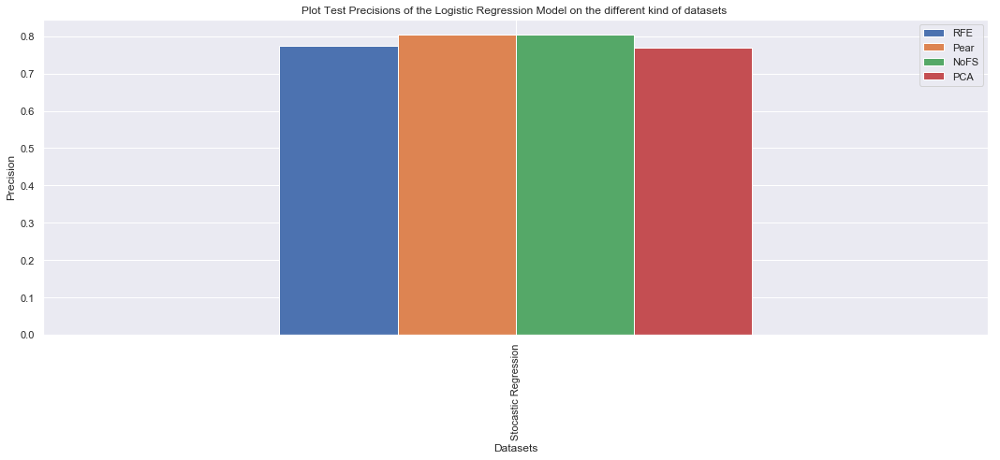

,RFE,Pear,NoFS,PCA
Stocastic Regression,0.775283,0.804926,0.804926,0.768527


In [207]:
fig, ax = plt.subplots(figsize=(15,7))
lr_precision.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Precisions of the Logistic Regression Model on the different kind of datasets ")
ax.set_ylabel('Precision')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
lr_precision

<a id="LREGM"></a>
<h3> Logistic Regression per Classificare il tipo di aritmia<a href="#indice" style="text-decoration:none;">↑</a></h3>



In [ ]:
train_logistic_regression(Dataset_m,C,penalty,['Stocastic Regression'],"ResultsLREGAnomaly")

In [285]:
best_scores_nofs_lr_m = np.load("ResultsLREGAnomaly/best_scores_nofs.npy")
best_scores_pear_lr_m = np.load("ResultsLREGAnomaly/best_scores_pear.npy")
best_scores_rfe_lr_m = np.load("ResultsLREGAnomaly/best_scores_rfe.npy")
best_scores_pca_lr_m = np.load("ResultsLREGAnomaly/best_scores_pca.npy")

RECALL Stocastic Regression 0.4995979532163742
PRECISION Stocastic Regression 0.48711843711843716


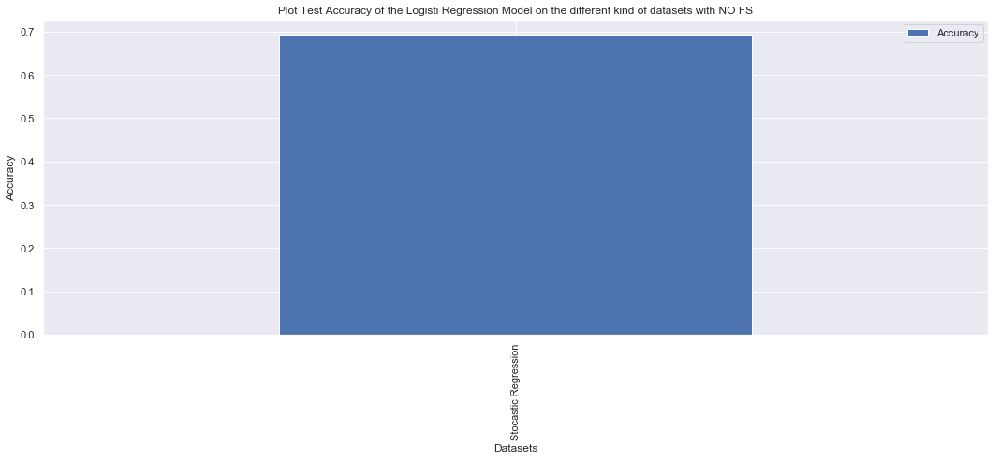

                      Accuracy
Stocastic Regression  0.693548
RECALL Stocastic Regression 0.4866898148148147
PRECISION Stocastic Regression 0.4807081807081808


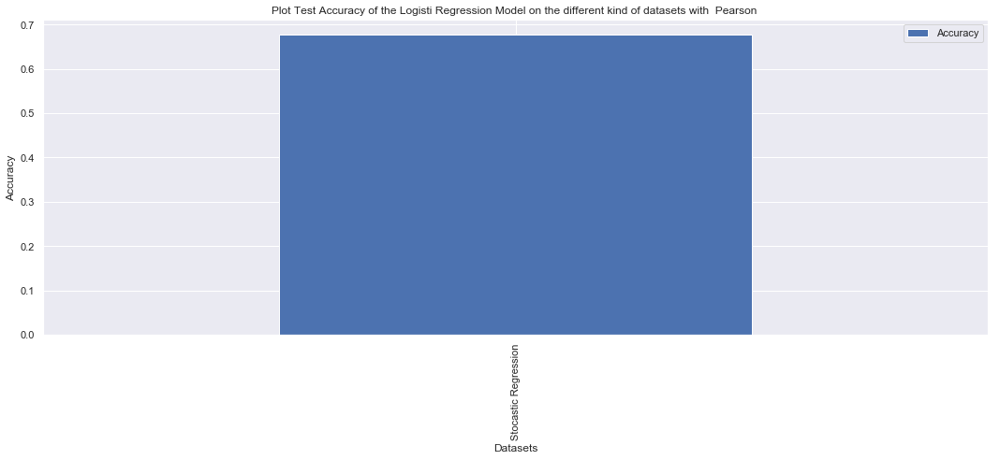

                      Accuracy
Stocastic Regression  0.677419
RECALL Stocastic Regression 0.4533730158730158
PRECISION Stocastic Regression 0.4407509157509158


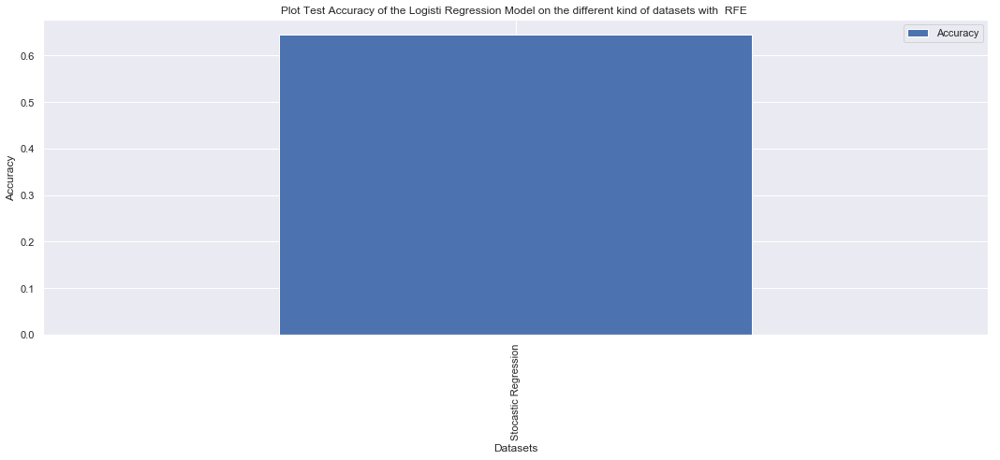

                      Accuracy
Stocastic Regression  0.645161
Somma explained variance:  0.9517844127520001
RECALL Stocastic Regression 0.4419478182636077
PRECISION Stocastic Regression 0.417094017094017


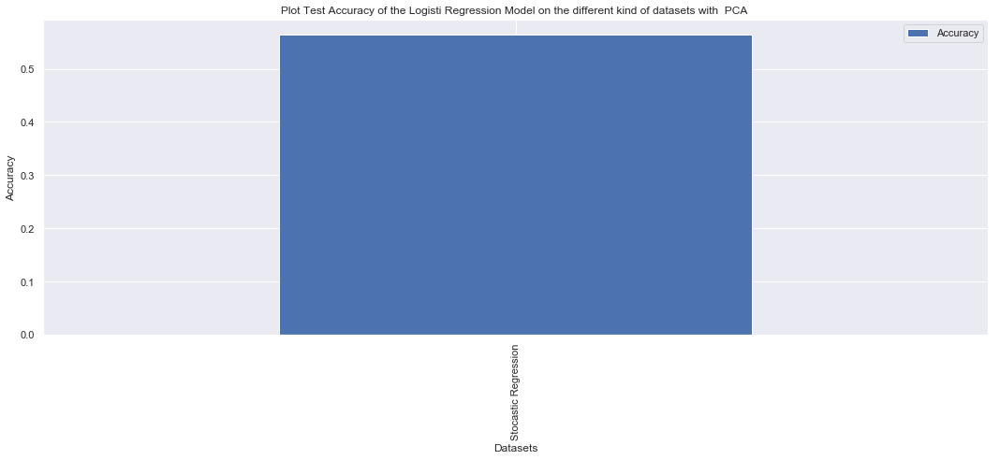

                      Accuracy
Stocastic Regression  0.564516


In [286]:
lreg_nofs_scores_m,lreg_nofs_recall_m,lreg_nofs_precision_m = test_lreg(Dataset_m,best_scores_nofs_lr_m,["Stocastic Regression"],"NO FS",False)
lreg_pear_scores_m,lreg_pear_recall_m,lreg_pear_precision_m = test_lreg(Dataset_m,best_scores_pear_lr_m,["Stocastic Regression"]," Pearson ",True)
lreg_rfe_scores_m,lreg_rfe_recall_m,lreg_rfe_precision_m = test_lreg(Dataset_m,best_scores_rfe_lr_m,["Stocastic Regression"]," RFE ",True)
lreg_pca_scores_m,lreg_pca_recall_m,lreg_pca_precision_m = test_lreg(Dataset_m,best_scores_pca_lr_m,["Stocastic Regression"]," PCA ",False,True)


In [287]:
lr_scores_dic = {
    "RFE":lreg_rfe_scores_m,
    "Pear":lreg_pear_scores_m,
    "NoFS":lreg_nofs_scores_m,
    "PCA":lreg_pca_scores_m
}
lr_recall_dic = {
    "RFE":lreg_rfe_recall_m,
    "Pear":lreg_pear_recall_m,
    "NoFS":lreg_nofs_recall_m,
    "PCA":lreg_pca_recall_m
}
lr_precision_dic = {
    "RFE":lreg_rfe_precision_m,
    "Pear":lreg_pear_precision_m,
    "NoFS":lreg_nofs_precision_m,
    "PCA":lreg_pca_precision_m
}
lr_scores_m = pd.DataFrame(lr_scores_dic,index=['Stocastic Regression'])
lr_recalls_m = pd.DataFrame(lr_recall_dic,index=['Stocastic Regression'])
lr_precision_m = pd.DataFrame(lr_precision_dic,index=['Stocastic Regression'])





<a id="SCORELREGM"></a>
<h3> Accuracy, Precision e Recall <a href="#indice" style="text-decoration:none;">↑</a></h3>



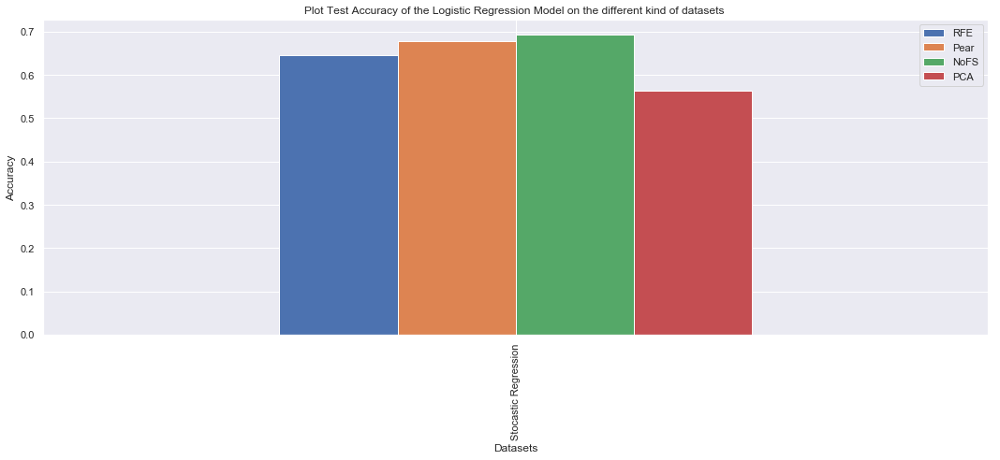

,RFE,Pear,NoFS,PCA
Stocastic Regression,0.645161,0.677419,0.693548,0.564516


In [288]:
fig, ax = plt.subplots(figsize=(15,7))
lr_scores_m.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Accuracy of the Logistic Regression Model on the different kind of datasets ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
lr_scores_m


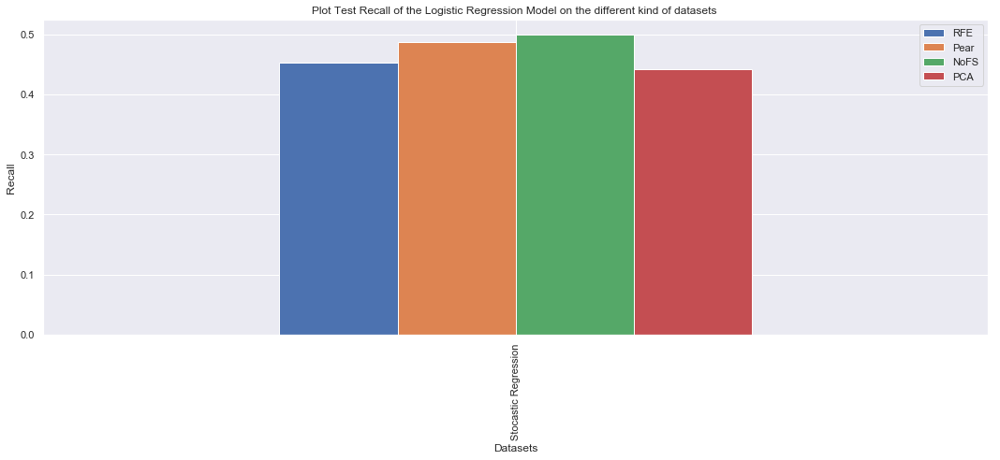

,RFE,Pear,NoFS,PCA
Stocastic Regression,0.453373,0.48669,0.499598,0.441948


In [289]:
fig, ax = plt.subplots(figsize=(15,7))
lr_recalls_m.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Recall of the Logistic Regression Model on the different kind of datasets ")
ax.set_ylabel('Recall')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
lr_recalls_m


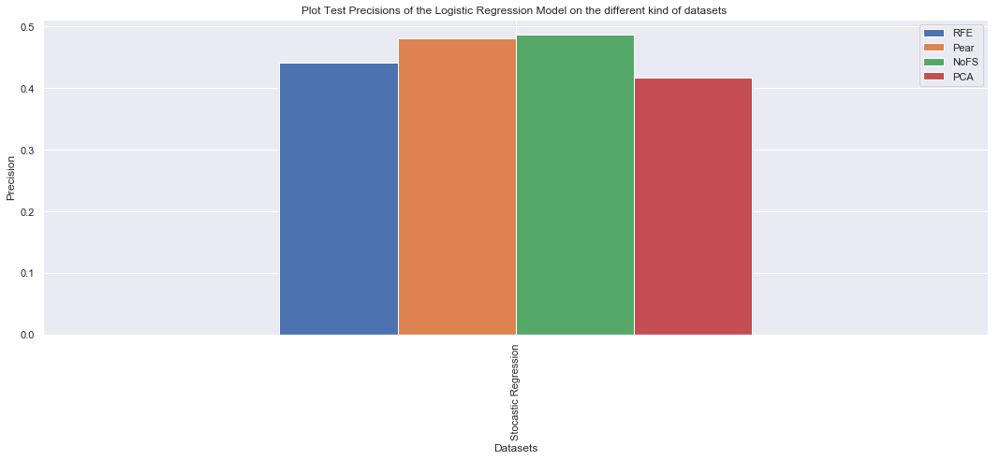

,RFE,Pear,NoFS,PCA
Stocastic Regression,0.440751,0.480708,0.487118,0.417094


In [290]:
fig, ax = plt.subplots(figsize=(15,7))
lr_precision_m.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Precisions of the Logistic Regression Model on the different kind of datasets ")
ax.set_ylabel('Precision')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
lr_precision_m


<a id="RFM"></a>
<h3> Random Forest per capire se un paziente è malato o meno <a href="#indice" style="text-decoration:none;">↑</a></h3>



In [ ]:
scores_rf_pear_bin,lista_n,confusion_matrix_test_forest_gini_bin,predicted_forest_pear_gini_bin = training_random_forest_pearson(Dataset,["Stocastic Regression"])

In [ ]:
scores_rf_rfe_bin,lista_n,confusion_matrix_test_forest_gini_rfe_bin,predicted_forest_rfe_gini_bin = training_random_forest_rfe(Dataset,["Stocastic Regression"])


In [ ]:
scores_rf_pca_bin,lista_n,confusion_matrix_test_forest_gini_pca_bin,predicted_forest_pca_gini_bin= training_random_forest_pca(Dataset,["Stocastic Regression"]) 


In [ ]:
scores_rf_nofs_bin,lista_n,confusion_matrix_test_forest_gini_nofs_bin,predicted_forest_nofs_gini_bin =training_random_forest_nofs(Dataset,["Stocastic Regression"])

In [218]:

acc_pca = []
rec_pca = []
prec_pca = []
summary_rf_accuracy_pca_gini_bin = {}
for i in scores_rf_pca_bin:
    acc_pca.append(i[0])
    rec_pca.append(i[1])
    prec_pca.append(i[2])
    #summary_rf_accuracy_pear_gini[imputations[u]] = [i[0],i[1],i[2]]
summary_rf_accuracy_pca_gini_bin["Accuracy"] = acc_pca
summary_rf_accuracy_pca_gini_bin["Recall"] = prec_pca
summary_rf_accuracy_pca_gini_bin["Precision"] = rec_pca

summ_rf_pca_g_bin = pd.DataFrame(summary_rf_accuracy_pca_gini_bin,index=["Stocastic Regression"])

acc = []
rec = []
prec = []
summary_rf_accuracy_pear_gini_bin = {}
for i in scores_rf_pear_bin:
    acc.append(i[0])
    rec.append(i[1])
    prec.append(i[2])
    #summary_rf_accuracy_pear_gini[imputations[u]] = [i[0],i[1],i[2]]
summary_rf_accuracy_pear_gini_bin["Accuracy"] = acc
summary_rf_accuracy_pear_gini_bin["Recall"] = prec
summary_rf_accuracy_pear_gini_bin["Precision"] = rec

summ_rf_pear_g_bin = pd.DataFrame(summary_rf_accuracy_pear_gini_bin,index=["Stocastic Regression"])

acc_rfe = []
rec_rfe = []
prec_rfe = []
summary_rf_accuracy_rfe_gini_bin = {}
for i in scores_rf_rfe_bin:
    acc_rfe.append(i[0])
    rec_rfe.append(i[1])
    prec_rfe.append(i[2])
    #summary_rf_accuracy_pear_gini[imputations[u]] = [i[0],i[1],i[2]]
summary_rf_accuracy_rfe_gini_bin["Accuracy"] = acc_rfe
summary_rf_accuracy_rfe_gini_bin["Recall"] = prec_rfe
summary_rf_accuracy_rfe_gini_bin["Precision"] = rec_rfe

summ_rf_rfe_g_bin = pd.DataFrame(summary_rf_accuracy_rfe_gini_bin,index=["Stocastic Regression"])

acc_nofs = []
rec_nofs = []
prec_nofs = []
summary_rf_accuracy_nofs_gini_bin = {}
for i in scores_rf_nofs:
    acc_nofs.append(i[0])
    rec_nofs.append(i[1])
    prec_nofs.append(i[2])
    #summary_rf_accuracy_pear_gini[imputations[u]] = [i[0],i[1],i[2]]
summary_rf_accuracy_nofs_gini_bin["Accuracy"] = acc_nofs
summary_rf_accuracy_nofs_gini_bin["Recall"] = prec_nofs
summary_rf_accuracy_nofs_gini_bin["Precision"] = rec_nofs

summ_rf_nofs_g_bin = pd.DataFrame(summary_rf_accuracy_nofs_gini_bin,index=["Stocastic Regression"])


In [219]:
comparison_df_bin ={}
comparison_df_bin["Acc_pear"] = summ_rf_pear_g_bin['Accuracy']
comparison_df_bin["Acc_rfe"] = summ_rf_rfe_g_bin['Accuracy']
comparison_df_bin["Acc_pca"] = summ_rf_pca_g_bin['Accuracy']
comparison_df_bin["Acc_nofs"] = summ_rf_nofs_g_bin['Accuracy']
comparison_df_bin["Rec_pear"] = summ_rf_pear_g_bin['Precision']
comparison_df_bin["Rec_rfe"] = summ_rf_rfe_g_bin['Precision']
comparison_df_bin["Rec_pca"] = summ_rf_pca_g_bin['Precision']
comparison_df_bin["Rec_nofs"] = summ_rf_nofs_g_bin['Precision']
comparison_df_bin["Prec_pear"] = summ_rf_pear_g_bin['Recall']
comparison_df_bin["Prec_rfe"] = summ_rf_rfe_g_bin['Recall']
comparison_df_bin["Prec_pca"] = summ_rf_pca_g_bin['Recall']
comparison_df_bin["Prec_nofs"] = summ_rf_nofs_g_bin['Recall']


summary_final_bin = pd.DataFrame(comparison_df_bin,index=["Stocastic Regression"])








<a id="SCORERFB"></a>
<h3> Accuracy, Precision e Recall <a href="#indice" style="text-decoration:none;">↑</a></h3>



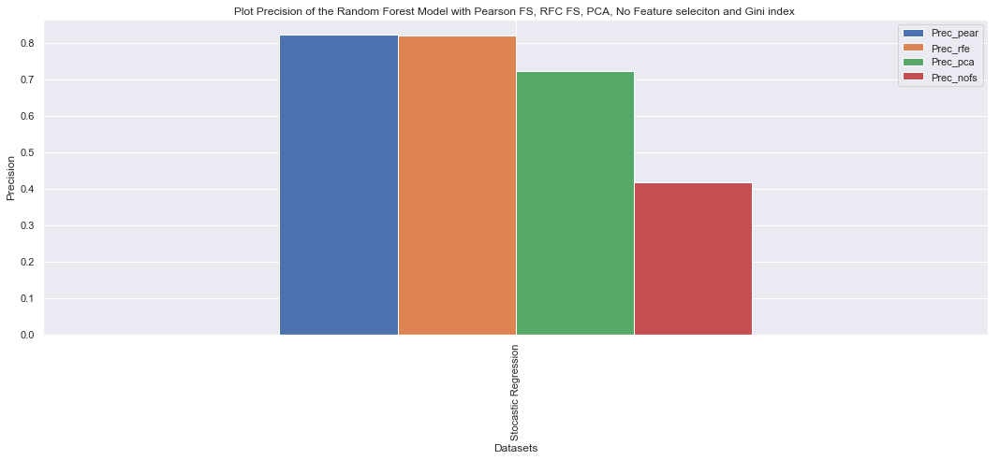

,Prec_pear,Prec_rfe,Prec_pca,Prec_nofs
Stocastic Regression,0.82367,0.819529,0.724063,0.416958


In [228]:
fig, ax = plt.subplots(figsize=(15,7))
summary_final_bin[['Prec_pear','Prec_rfe','Prec_pca',"Prec_nofs"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision of the Random Forest Model with Pearson FS, RFC FS, PCA, No Feature seleciton and Gini index ")
ax.set_ylabel('Precision')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
summary_final_bin[['Prec_pear','Prec_rfe','Prec_pca',"Prec_nofs"]]

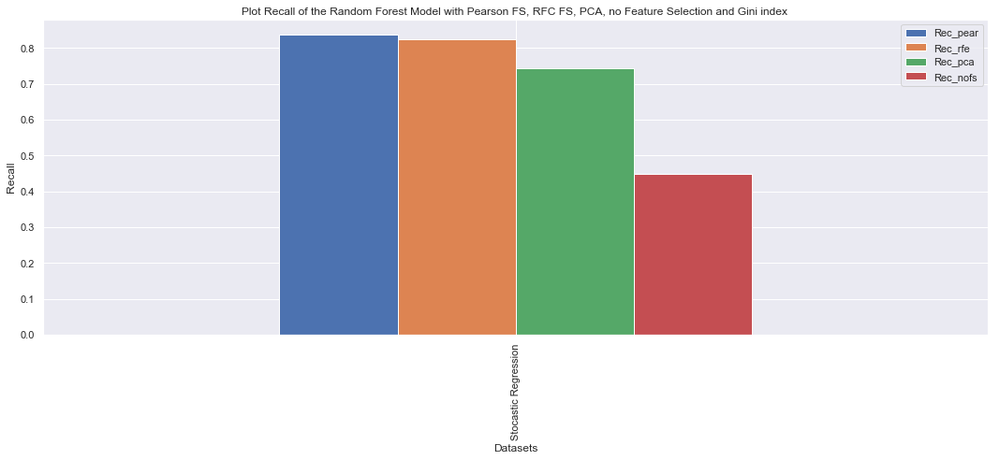

,Rec_pear,Rec_rfe,Rec_pca,Rec_nofs
Stocastic Regression,0.837577,0.82405,0.743371,0.449351


In [227]:
fig, ax = plt.subplots(figsize=(15,7))
summary_final_bin[['Rec_pear','Rec_rfe','Rec_pca',"Rec_nofs"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Recall of the Random Forest Model with Pearson FS, RFC FS, PCA, no Feature Selection and Gini index ")
ax.set_ylabel('Recall')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
summary_final_bin[['Rec_pear','Rec_rfe','Rec_pca',"Rec_nofs"]]

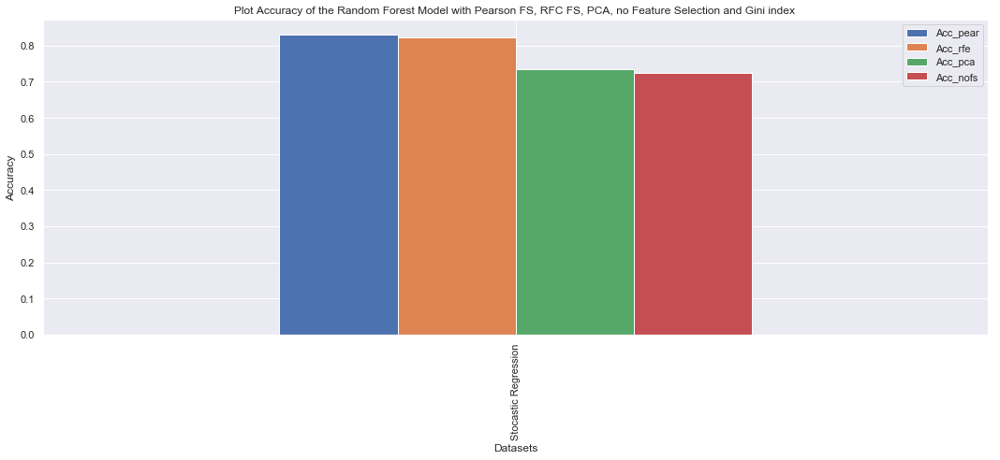

,Acc_pear,Acc_rfe,Acc_pca,Acc_nofs
Stocastic Regression,0.830882,0.823529,0.735294,0.725275


In [226]:
fig, ax = plt.subplots(figsize=(15,7))
summary_final_bin[['Acc_pear','Acc_rfe','Acc_pca',"Acc_nofs"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracy of the Random Forest Model with Pearson FS, RFC FS, PCA, no Feature Selection and Gini index ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
summary_final_bin[['Acc_pear','Acc_rfe','Acc_pca',"Acc_nofs"]]

<a id="RFM"></a>
<h3> Random Forest per Classificare il tipo di aritmia<a href="#indice" style="text-decoration:none;">↑</a></h3>



In [ ]:
scores_rf_rfe_multi,lista_n,confusion_matrix_test_forest_gini_rfe_multi,predicted_forest_rfe_gini_multi = training_random_forest_rfe(Dataset_m,["Stocastic Regression"])
scores_rf_pca_multi,lista_n,confusion_matrix_test_forest_gini_pca_multi,predicted_forest_pca_gini_multi= training_random_forest_pca(Dataset_m,["Stocastic Regression"]) 
scores_rf_nofs_multi,lista_n,confusion_matrix_test_forest_gini_nofs_multi,predicted_forest_nofs_gini_multi =training_random_forest_nofs(Dataset_m,["Stocastic Regression"])

scores_rf_pear_multi,lista_n,confusion_matrix_test_forest_gini_pear_multi,predicted_forest_pear_gini_multi =training_random_forest_pearson(Dataset_m,["Stocastic Regression"])

In [61]:

acc_pca = []
rec_pca = []
prec_pca = []
summary_rf_accuracy_pca_gini_multi = {}
for i in scores_rf_pca_multi:
    acc_pca.append(i[0])
    rec_pca.append(i[1])
    prec_pca.append(i[2])
    #summary_rf_accuracy_pear_gini[imputations[u]] = [i[0],i[1],i[2]]
summary_rf_accuracy_pca_gini_multi["Accuracy"] = acc_pca
summary_rf_accuracy_pca_gini_multi["Recall"] = prec_pca
summary_rf_accuracy_pca_gini_multi["Precision"] = rec_pca

summ_rf_pca_g_multi = pd.DataFrame(summary_rf_accuracy_pca_gini_multi,index=["Stocastic Regression"])

acc = []
rec = []
prec = []
summary_rf_accuracy_pear_gini_multi = {}
for i in scores_rf_pear_multi:
    acc.append(i[0])
    rec.append(i[1])
    prec.append(i[2])
    #summary_rf_accuracy_pear_gini[imputations[u]] = [i[0],i[1],i[2]]
summary_rf_accuracy_pear_gini_multi["Accuracy"] = acc
summary_rf_accuracy_pear_gini_multi["Recall"] = prec
summary_rf_accuracy_pear_gini_multi["Precision"] = rec

summ_rf_pear_g_multi = pd.DataFrame(summary_rf_accuracy_pear_gini_multi,index=["Stocastic Regression"])

acc_rfe = []
rec_rfe = []
prec_rfe = []
summary_rf_accuracy_rfe_gini_multi = {}
for i in scores_rf_rfe_multi:
    acc_rfe.append(i[0])
    rec_rfe.append(i[1])
    prec_rfe.append(i[2])
    #summary_rf_accuracy_pear_gini[imputations[u]] = [i[0],i[1],i[2]]
summary_rf_accuracy_rfe_gini_multi["Accuracy"] = acc_rfe
summary_rf_accuracy_rfe_gini_multi["Recall"] = prec_rfe
summary_rf_accuracy_rfe_gini_multi["Precision"] = rec_rfe

summ_rf_rfe_g_multi = pd.DataFrame(summary_rf_accuracy_rfe_gini_multi,index=["Stocastic Regression"])

acc_nofs = []
rec_nofs = []
prec_nofs = []
summary_rf_accuracy_nofs_gini_multi = {}
for i in scores_rf_nofs_multi:
    acc_nofs.append(i[0])
    rec_nofs.append(i[1])
    prec_nofs.append(i[2])
    #summary_rf_accuracy_pear_gini[imputations[u]] = [i[0],i[1],i[2]]
summary_rf_accuracy_nofs_gini_multi["Accuracy"] = acc_nofs
summary_rf_accuracy_nofs_gini_multi["Recall"] = prec_nofs
summary_rf_accuracy_nofs_gini_multi["Precision"] = rec_nofs

summ_rf_nofs_g_multi = pd.DataFrame(summary_rf_accuracy_nofs_gini_multi,index=["Stocastic Regression"])


In [62]:
comparison_df_multi ={}
comparison_df_multi["Acc_pear"] = summ_rf_pear_g_multi['Accuracy']
comparison_df_multi["Acc_rfe"] = summ_rf_rfe_g_multi['Accuracy']
comparison_df_multi["Acc_pca"] = summ_rf_pca_g_multi['Accuracy']
comparison_df_multi["Acc_nofs"] = summ_rf_nofs_g_multi['Accuracy']
comparison_df_multi["Rec_pear"] = summ_rf_pear_g_multi['Precision']
comparison_df_multi["Rec_rfe"] = summ_rf_rfe_g_multi['Precision']
comparison_df_multi["Rec_pca"] = summ_rf_pca_g_multi['Precision']
comparison_df_multi["Rec_nofs"] = summ_rf_nofs_g_multi['Precision']
comparison_df_multi["Prec_pear"] = summ_rf_pear_g_multi['Recall']
comparison_df_multi["Prec_rfe"] = summ_rf_rfe_g_multi['Recall']
comparison_df_multi["Prec_pca"] = summ_rf_pca_g_multi['Recall']
comparison_df_multi["Prec_nofs"] = summ_rf_nofs_g_multi['Recall']


summary_final_multi = pd.DataFrame(comparison_df_multi,index=["Stocastic Regression"])




<a id="SCORERFM"></a>
<h3> Accuracy, Precision e Recall <a href="#indice" style="text-decoration:none;">↑</a></h3>


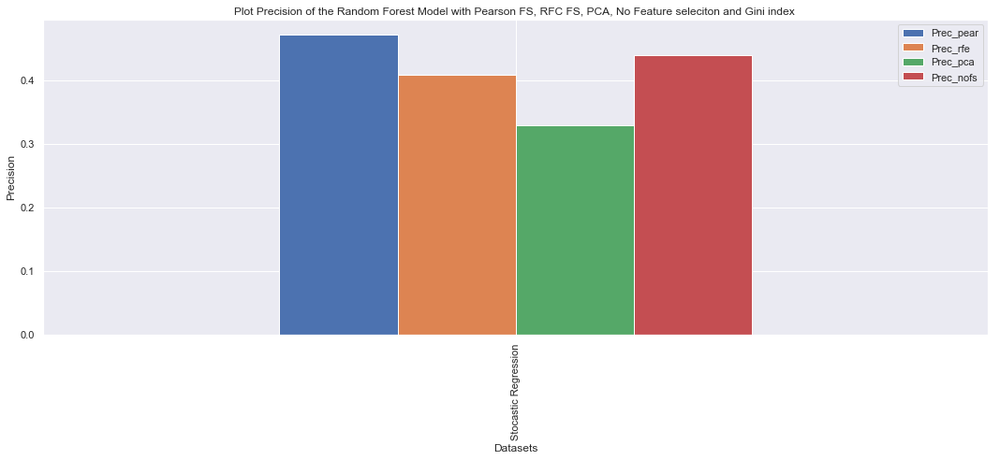

,Prec_pear,Prec_rfe,Prec_pca,Prec_nofs
Stocastic Regression,0.471841,0.408013,0.328312,0.439103


In [63]:
fig, ax = plt.subplots(figsize=(15,7))
summary_final_multi[['Prec_pear','Prec_rfe','Prec_pca',"Prec_nofs"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Precision of the Random Forest Model with Pearson FS, RFC FS, PCA, No Feature seleciton and Gini index ")
ax.set_ylabel('Precision')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
summary_final_multi[['Prec_pear','Prec_rfe','Prec_pca',"Prec_nofs"]]

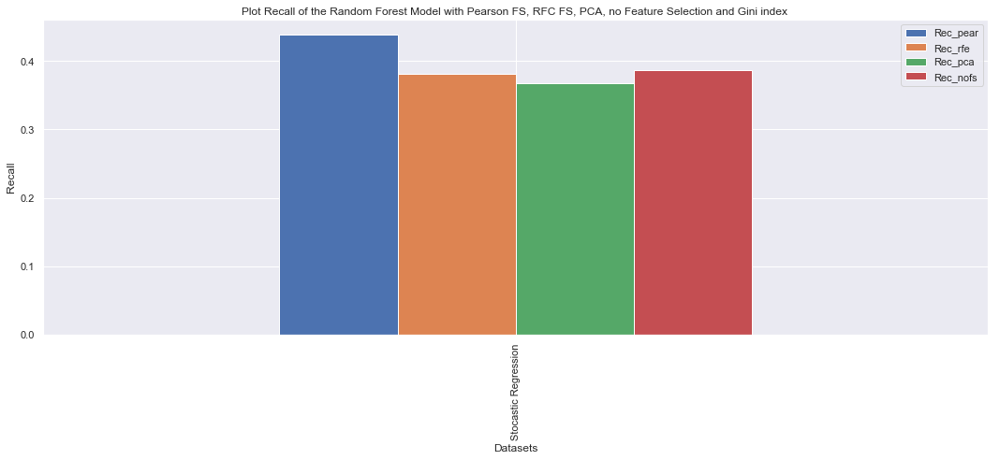

,Rec_pear,Rec_rfe,Rec_pca,Rec_nofs
Stocastic Regression,0.438685,0.380556,0.366931,0.386806


In [64]:
fig, ax = plt.subplots(figsize=(15,7))
summary_final_multi[['Rec_pear','Rec_rfe','Rec_pca',"Rec_nofs"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Recall of the Random Forest Model with Pearson FS, RFC FS, PCA, no Feature Selection and Gini index ")
ax.set_ylabel('Recall')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
summary_final_multi[['Rec_pear','Rec_rfe','Rec_pca',"Rec_nofs"]]

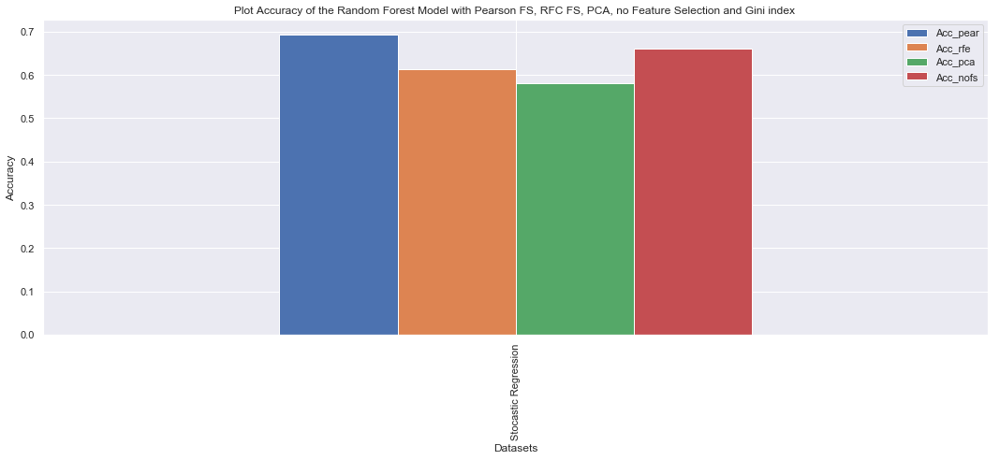

,Acc_pear,Acc_rfe,Acc_pca,Acc_nofs
Stocastic Regression,0.693548,0.612903,0.580645,0.66129


In [65]:
fig, ax = plt.subplots(figsize=(15,7))
summary_final_multi[['Acc_pear','Acc_rfe','Acc_pca',"Acc_nofs"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracy of the Random Forest Model with Pearson FS, RFC FS, PCA, no Feature Selection and Gini index ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
summary_final_multi[['Acc_pear','Acc_rfe','Acc_pca',"Acc_nofs"]]


<a id="BOOSTB"></a>
<h3>Algoritmi di Boosting per capire se un paziente è malato o meno <a href="#indice" style="text-decoration:none;">↑</a></h3>

In [58]:
scores_ada_nofs_bin,scores_gb_nofs_bin,scores_et_nofs_bin,scores_xgb_nofs_bin = training_testing_boosting_algorithms_no_FS(Dataset,['Stocastic Regression'])

DATASET  Stocastic Regression
ADA-BOOST
Accuracy 0.7573529411764706
Precision 0.745640802092415
Recall 0.7694238584747788
2
2
TEST
{0, 1}
PREDETTE
{0, 1}
GRADIENT BOOSTING
Accuracy 0.8602941176470589
Precision 0.8559285091543156
Recall 0.8626471241394625
EXTRA TREE
Accuracy 0.8088235294117647
Precision 0.8020924149956408
Recall 0.8130081300813008
X-GRADIENT BOOSTING
Accuracy 0.8676470588235294
Precision 0.8691423519009726
Recall 0.8639930252833479


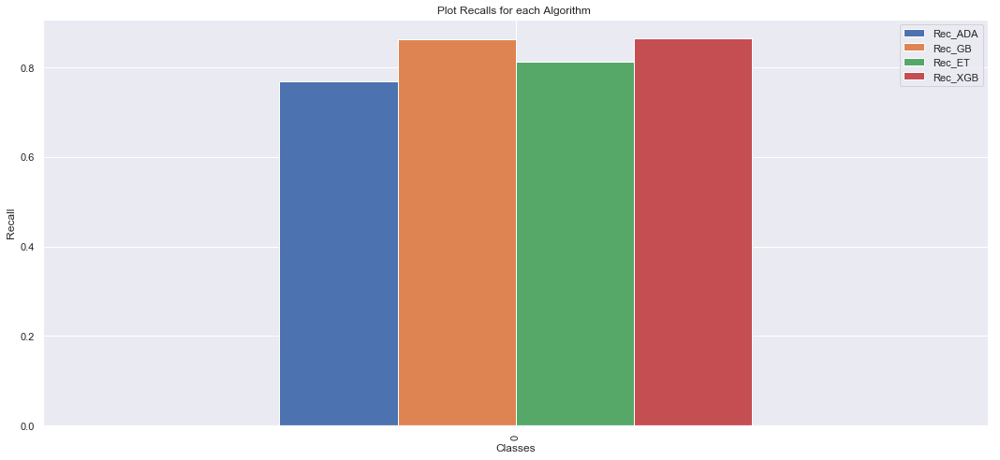

    Rec_ADA    Rec_GB    Rec_ET   Rec_XGB
0  0.769424  0.862647  0.813008  0.863993


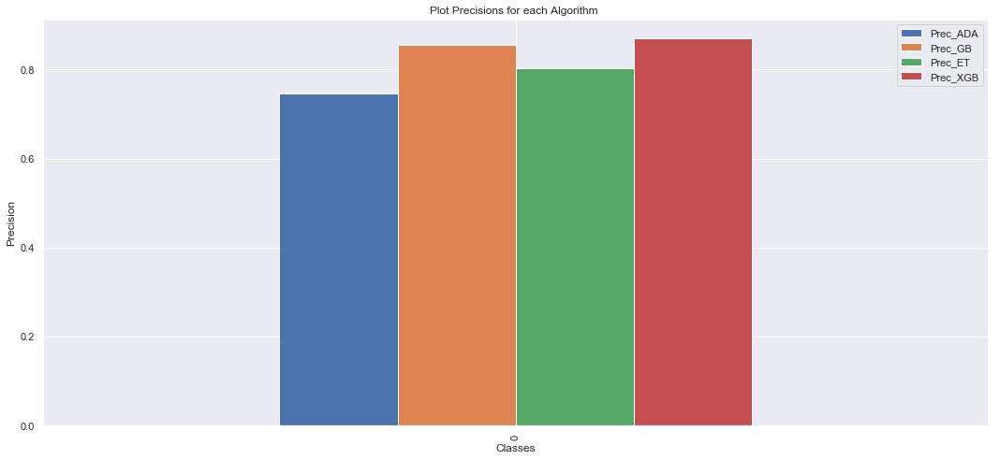

   Prec_ADA   Prec_GB   Prec_ET  Prec_XGB
0  0.745641  0.855929  0.802092  0.869142


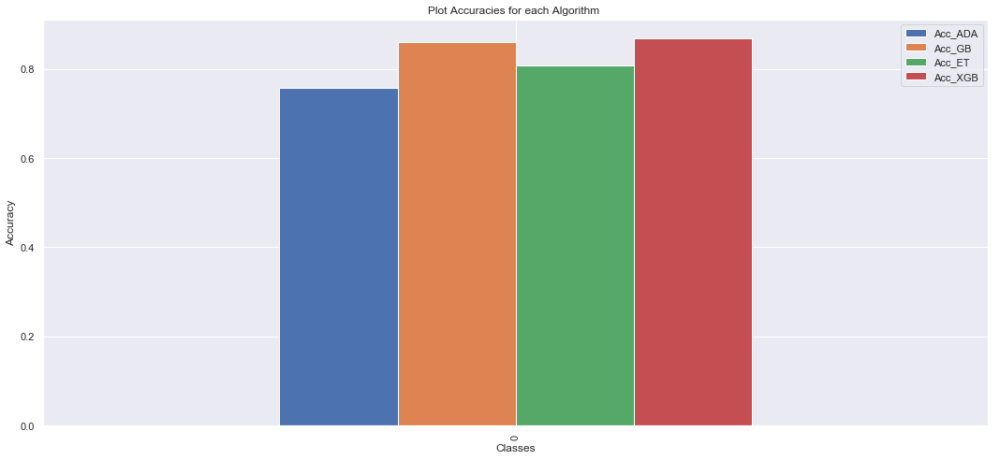

    Acc_ADA    Acc_GB    Acc_ET   Acc_XGB
0  0.757353  0.860294  0.808824  0.867647


In [59]:

ensemble_nofs_df_bin = pd.DataFrame()
ensemble_nofs_df_bin['Acc_ADA'] =  [scores_ada_nofs_bin[0][0]] 
ensemble_nofs_df_bin['Rec_ADA'] =  [scores_ada_nofs_bin[0][1]] 
ensemble_nofs_df_bin['Prec_ADA'] =  [scores_ada_nofs_bin[0][2]] 


ensemble_nofs_df_bin['Acc_GB'] =  [scores_gb_nofs_bin[0][0]] 
ensemble_nofs_df_bin['Rec_GB'] =  [scores_gb_nofs_bin[0][1]] 
ensemble_nofs_df_bin['Prec_GB'] =  [scores_gb_nofs_bin[0][2]] 

ensemble_nofs_df_bin['Acc_ET'] =  [scores_et_nofs_bin[0][0]]
ensemble_nofs_df_bin['Rec_ET'] =  [scores_et_nofs_bin[0][1]] 
ensemble_nofs_df_bin['Prec_ET'] =  [scores_et_nofs_bin[0][2]] 

ensemble_nofs_df_bin['Acc_XGB'] =  [scores_xgb_nofs_bin[0][0]] 
ensemble_nofs_df_bin['Rec_XGB'] =  [scores_xgb_nofs_bin[0][1]] 
ensemble_nofs_df_bin['Prec_XGB'] =  [scores_xgb_nofs_bin[0][2]] 

fig, ax = plt.subplots(figsize=(15,7))
ensemble_nofs_df_bin[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Recalls for each Algorithm ")
ax.set_ylabel('Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_nofs_df_bin[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_nofs_df_bin[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Precisions for each Algorithm ")
ax.set_ylabel('Precision')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_nofs_df_bin[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_nofs_df_bin[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_nofs_df_bin[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']])


In [60]:
scores_ada_pearson_bin,scores_gb_pearson_bin,scores_et_pearson_bin,scores_xgb_pearson_bin = training_testing_boosting_algorithms_Pearson(Dataset,['Stocastic Regression'])

DATASET  Stocastic Regression
ADA-BOOST
Accuracy 0.7867647058823529
Precision 0.775283347863993
Recall 0.8019364092756395
2
2
TEST
{0, 1}
PREDETTE
{0, 1}
GRADIENT BOOSTING
Accuracy 0.8676470588235294
Precision 0.8639930252833479
Recall 0.8691423519009726
EXTRA TREE
Accuracy 0.8235294117647058
Precision 0.8142981691368789
Recall 0.8353488372093023
X-GRADIENT BOOSTING
Accuracy 0.8602941176470589
Precision 0.8626471241394625
Recall 0.8559285091543156


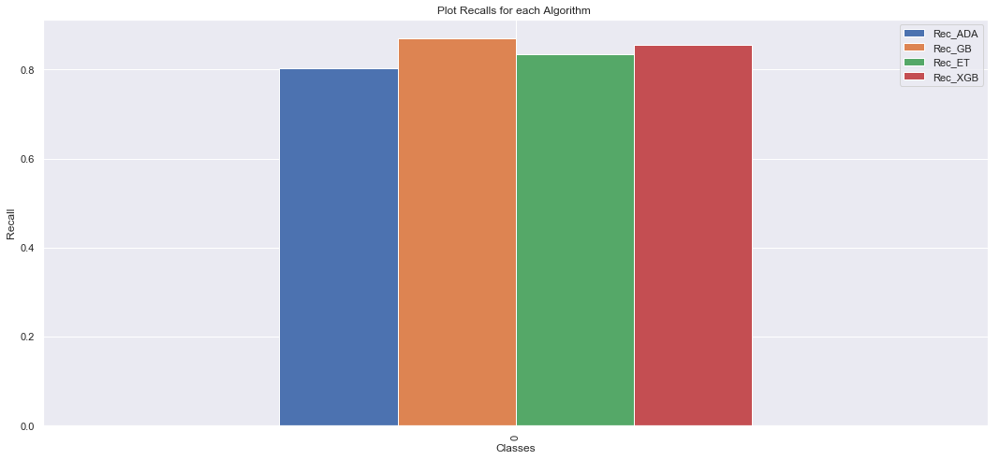

    Rec_ADA    Rec_GB    Rec_ET   Rec_XGB
0  0.801936  0.869142  0.835349  0.855929


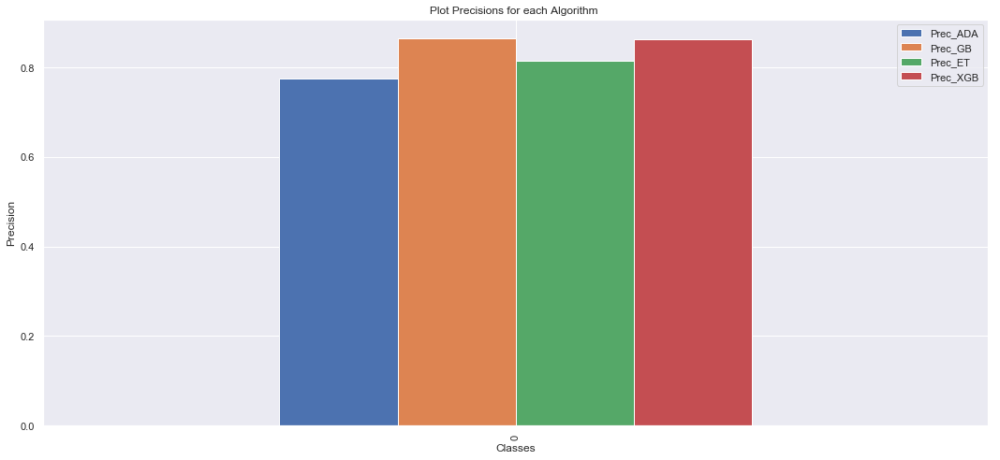

   Prec_ADA   Prec_GB   Prec_ET  Prec_XGB
0  0.775283  0.863993  0.814298  0.862647


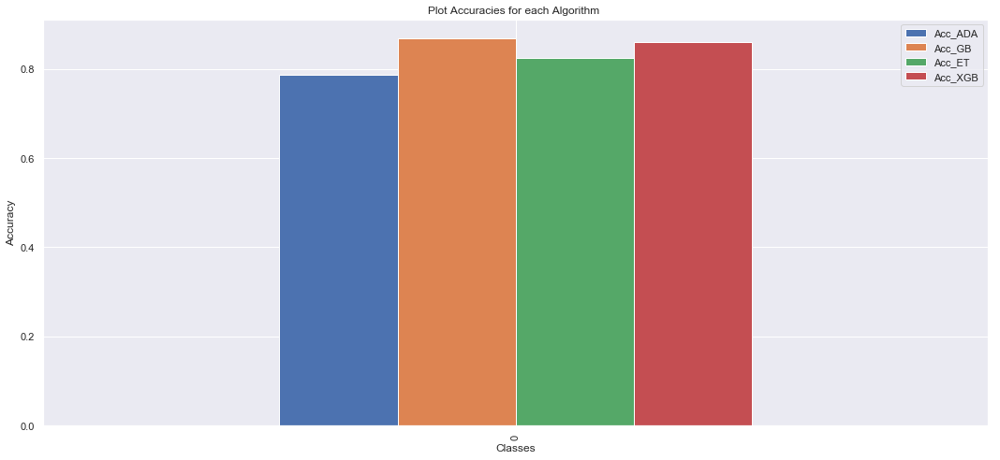

    Acc_ADA    Acc_GB    Acc_ET   Acc_XGB
0  0.786765  0.867647  0.823529  0.860294


In [61]:
ensemble_pear_df_bin = pd.DataFrame()
ensemble_pear_df_bin['Acc_ADA'] =  [scores_ada_pearson_bin[0][0]] 
ensemble_pear_df_bin['Rec_ADA'] =  [scores_ada_pearson_bin[0][1]] 
ensemble_pear_df_bin['Prec_ADA'] =  [scores_ada_pearson_bin[0][2]] 


ensemble_pear_df_bin['Acc_GB'] =  [scores_gb_pearson_bin[0][0]] 
ensemble_pear_df_bin['Rec_GB'] =  [scores_gb_pearson_bin[0][1]] 
ensemble_pear_df_bin['Prec_GB'] =  [scores_gb_pearson_bin[0][2]] 

ensemble_pear_df_bin['Acc_ET'] =  [scores_et_pearson_bin[0][0]]
ensemble_pear_df_bin['Rec_ET'] =  [scores_et_pearson_bin[0][1]] 
ensemble_pear_df_bin['Prec_ET'] =  [scores_et_pearson_bin[0][2]] 

ensemble_pear_df_bin['Acc_XGB'] =  [scores_xgb_pearson_bin[0][0]] 
ensemble_pear_df_bin['Rec_XGB'] =  [scores_xgb_pearson_bin[0][1]] 
ensemble_pear_df_bin['Prec_XGB'] =  [scores_xgb_pearson_bin[0][2]] 

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pear_df_bin[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Recalls for each Algorithm ")
ax.set_ylabel('Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pear_df_bin[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pear_df_bin[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Precisions for each Algorithm ")
ax.set_ylabel('Precision')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pear_df_bin[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pear_df_bin[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pear_df_bin[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']])


In [62]:
scores_ada_rfe_bin,scores_gb_rfe_bin,scores_et_rfe_bin,scores_xgb_rfe_bin = training_testing_boosting_algorithms_RFE(Dataset,['Stocastic Regression'])

DATASET  Stocastic Regression
ADA-BOOST
Accuracy 0.8014705882352942
Precision 0.7966434176111595
Recall 0.8022429491450145
2
2
TEST
{0, 1}
PREDETTE
{0, 1}
GRADIENT BOOSTING
Accuracy 0.8161764705882353
Precision 0.8114646904969486
Recall 0.8173439928936265
EXTRA TREE
Accuracy 0.8455882352941176
Precision 0.8397994768962511
Recall 0.8499438832772166
X-GRADIENT BOOSTING
Accuracy 0.8161764705882353
Precision 0.8173439928936265
Recall 0.8114646904969486


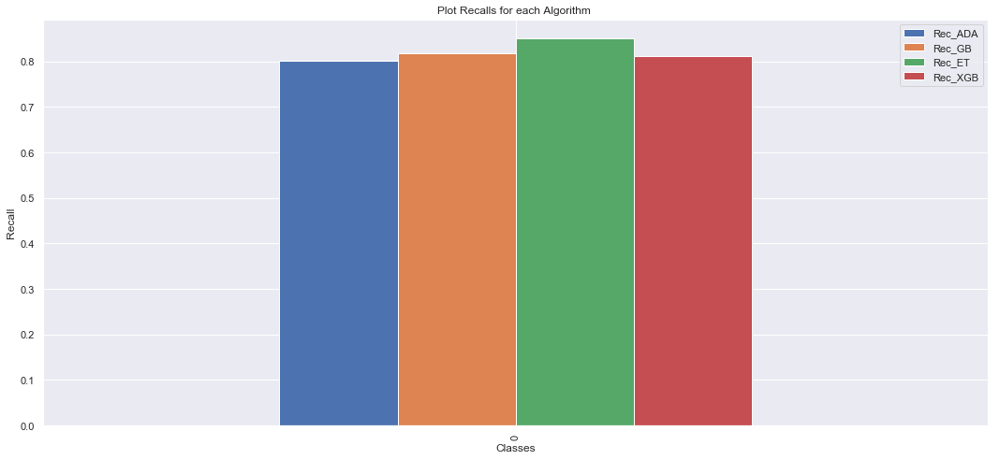

    Rec_ADA    Rec_GB    Rec_ET   Rec_XGB
0  0.802243  0.817344  0.849944  0.811465


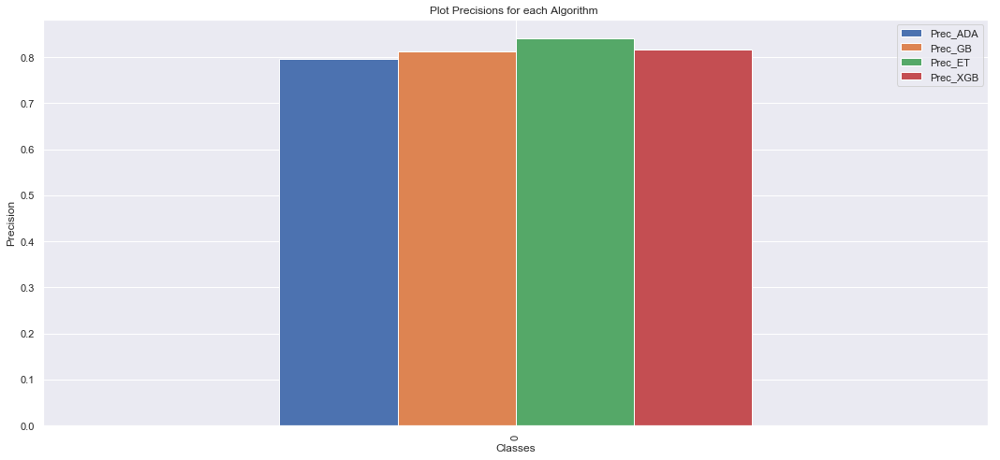

   Prec_ADA   Prec_GB   Prec_ET  Prec_XGB
0  0.796643  0.811465  0.839799  0.817344


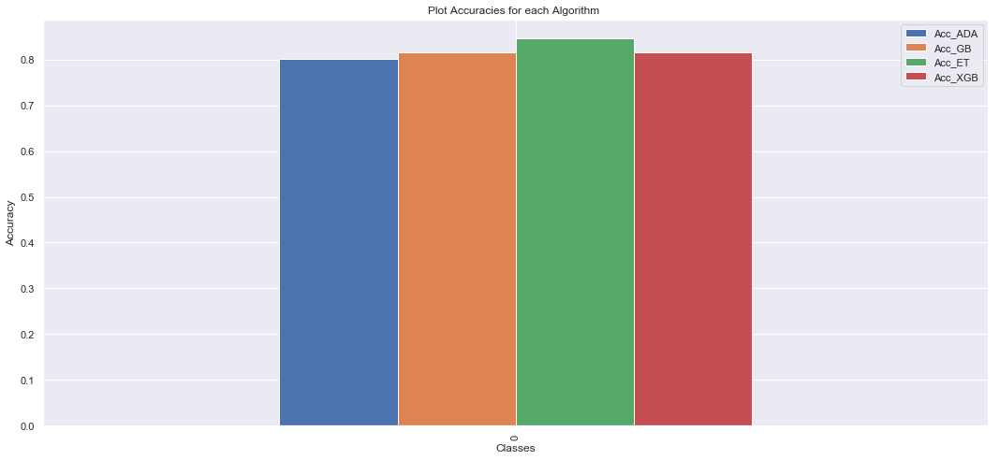

    Acc_ADA    Acc_GB    Acc_ET   Acc_XGB
0  0.801471  0.816176  0.845588  0.816176


In [63]:
ensemble_rfe_df_bin = pd.DataFrame()
ensemble_rfe_df_bin['Acc_ADA'] =  [scores_ada_rfe_bin[0][0]] 
ensemble_rfe_df_bin['Rec_ADA'] =  [scores_ada_rfe_bin[0][1]] 
ensemble_rfe_df_bin['Prec_ADA'] =  [scores_ada_rfe_bin[0][2]] 


ensemble_rfe_df_bin['Acc_GB'] =  [scores_gb_rfe_bin[0][0]] 
ensemble_rfe_df_bin['Rec_GB'] =  [scores_gb_rfe_bin[0][1]] 
ensemble_rfe_df_bin['Prec_GB'] =  [scores_gb_rfe_bin[0][2]] 

ensemble_rfe_df_bin['Acc_ET'] =  [scores_et_rfe_bin[0][0]]
ensemble_rfe_df_bin['Rec_ET'] =  [scores_et_rfe_bin[0][1]] 
ensemble_rfe_df_bin['Prec_ET'] =  [scores_et_rfe_bin[0][2]] 

ensemble_rfe_df_bin['Acc_XGB'] =  [scores_xgb_rfe_bin[0][0]] 
ensemble_rfe_df_bin['Rec_XGB'] =  [scores_xgb_rfe_bin[0][1]] 
ensemble_rfe_df_bin['Prec_XGB'] =  [scores_xgb_rfe_bin[0][2]] 

fig, ax = plt.subplots(figsize=(15,7))
ensemble_rfe_df_bin[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Recalls for each Algorithm ")
ax.set_ylabel('Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_rfe_df_bin[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_rfe_df_bin[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Precisions for each Algorithm ")
ax.set_ylabel('Precision')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_rfe_df_bin[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_rfe_df_bin[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_rfe_df_bin[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']])


In [64]:
scores_ada_pca_bin,scores_gb_pca_bin,scores_et_pca_bin,scores_xgb_pca_bin = training_testing_boosting_algorithms_PCA(Dataset,['Stocastic Regression'])

DATASET  Stocastic Regression
ADA-BOOST
Accuracy 0.7352941176470589
Precision 0.7253705318221447
Recall 0.7404651162790697
2
2
TEST
{0, 1}
PREDETTE
{0, 1}
GRADIENT BOOSTING
Accuracy 0.7794117647058824
Precision 0.7711421098517872
Recall 0.7847985347985348
EXTRA TREE
Accuracy 0.7352941176470589
Precision 0.7227550130775937
Recall 0.7468599033816425
X-GRADIENT BOOSTING
Accuracy 0.75
Precision 0.7632850241545894
Recall 0.7375762859633828


In [65]:

ensemble_pca_df_bin = pd.DataFrame()

ensemble_pca_df_bin['Acc_ADA'] =  [scores_ada_pca_bin[0][0]]
ensemble_pca_df_bin['Rec_ADA'] =  [scores_ada_pca_bin[0][1]] 
ensemble_pca_df_bin['Prec_ADA'] =  [scores_ada_pca_bin[0][2]]

ensemble_pca_df_bin['Acc_GB'] =  [scores_gb_pca_bin[0][0]] 
ensemble_pca_df_bin['Rec_GB'] =  [scores_gb_pca_bin[0][1]] 
ensemble_pca_df_bin['Prec_GB'] =  [scores_gb_pca_bin[0][2]] 

ensemble_pca_df_bin['Acc_ET'] =  [scores_et_pca_bin[0][0]] 
ensemble_pca_df_bin['Rec_ET'] =  [scores_et_pca_bin[0][1]] 
ensemble_pca_df_bin['Prec_ET'] =  [scores_et_pca_bin[0][2]]

ensemble_pca_df_bin['Acc_XGB'] =  [scores_xgb_pca_bin[0][0]] 
ensemble_pca_df_bin['Rec_XGB'] =  [scores_xgb_pca_bin[0][1]] 
ensemble_pca_df_bin['Prec_XGB'] =  [scores_xgb_pca_bin[0][2]]

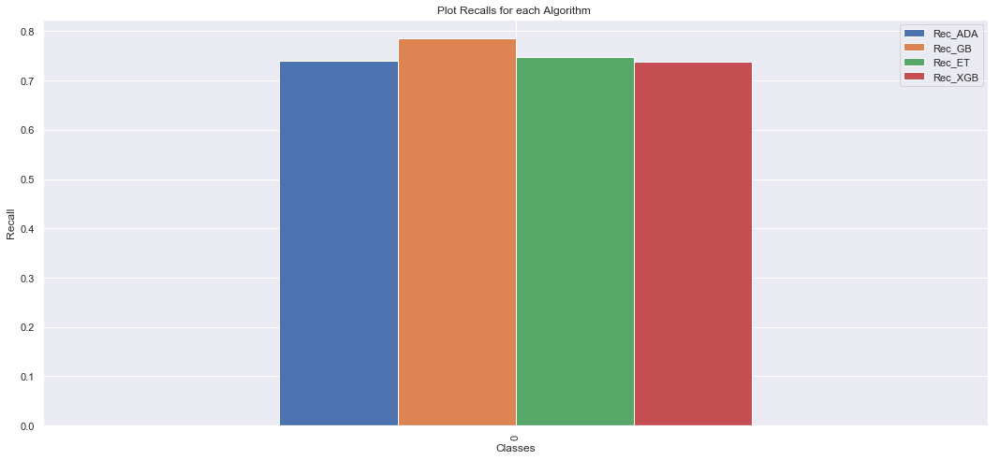

    Rec_ADA    Rec_GB   Rec_ET   Rec_XGB
0  0.740465  0.784799  0.74686  0.737576


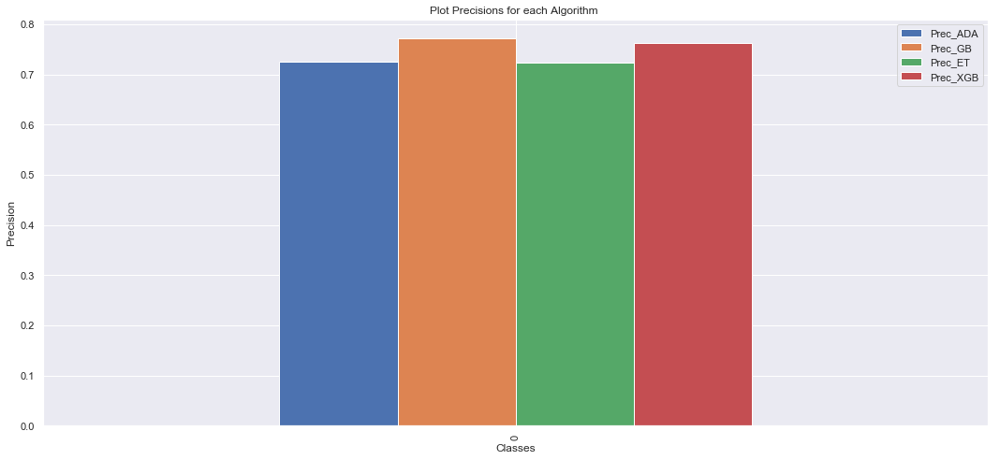

   Prec_ADA   Prec_GB   Prec_ET  Prec_XGB
0  0.725371  0.771142  0.722755  0.763285


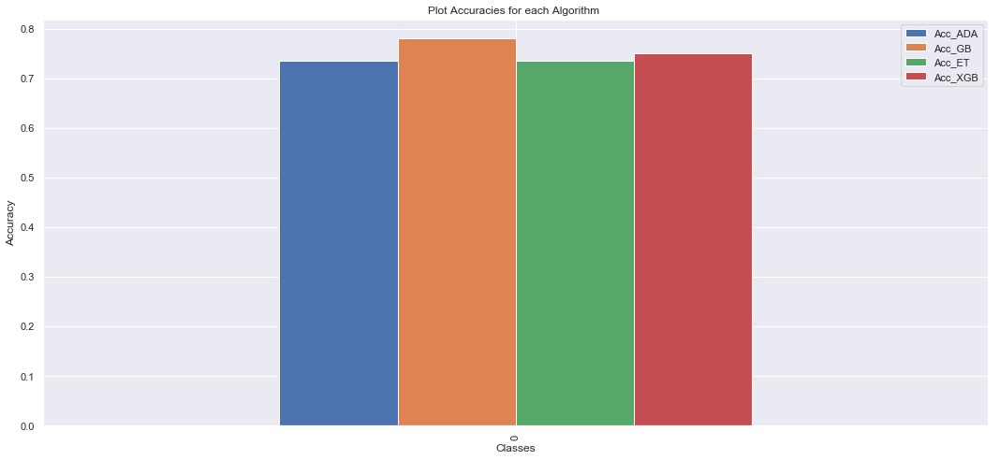

    Acc_ADA    Acc_GB    Acc_ET  Acc_XGB
0  0.735294  0.779412  0.735294     0.75


In [66]:

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pca_df_bin[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Recalls for each Algorithm ")
ax.set_ylabel('Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pca_df_bin[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pca_df_bin[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Precisions for each Algorithm ")
ax.set_ylabel('Precision')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pca_df_bin[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pca_df_bin[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pca_df_bin[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']])


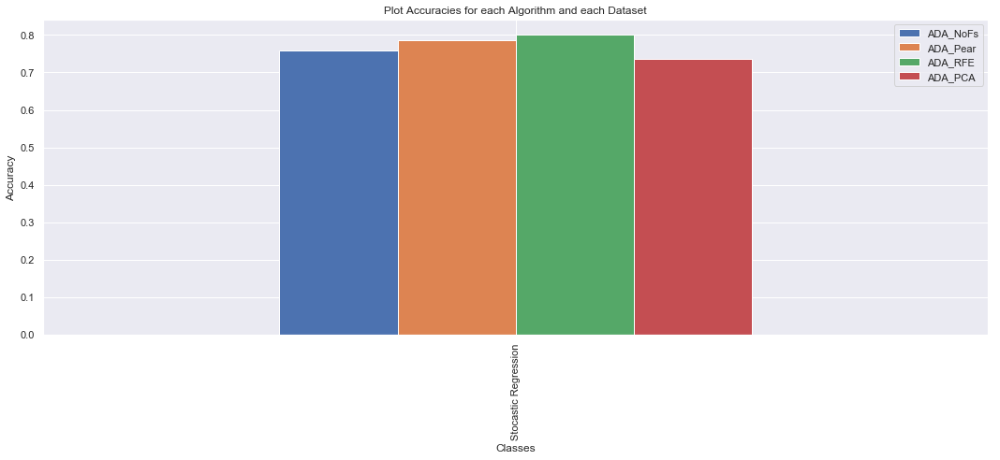

                      ADA_NoFs  ADA_Pear   ADA_RFE   ADA_PCA
Stocastic Regression  0.757353  0.786765  0.801471  0.735294


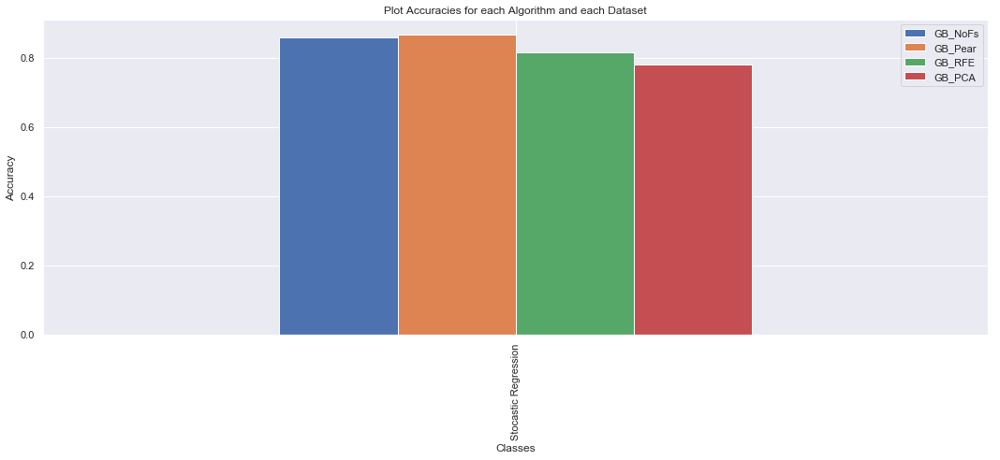

                       GB_NoFs   GB_Pear    GB_RFE    GB_PCA
Stocastic Regression  0.860294  0.867647  0.816176  0.779412


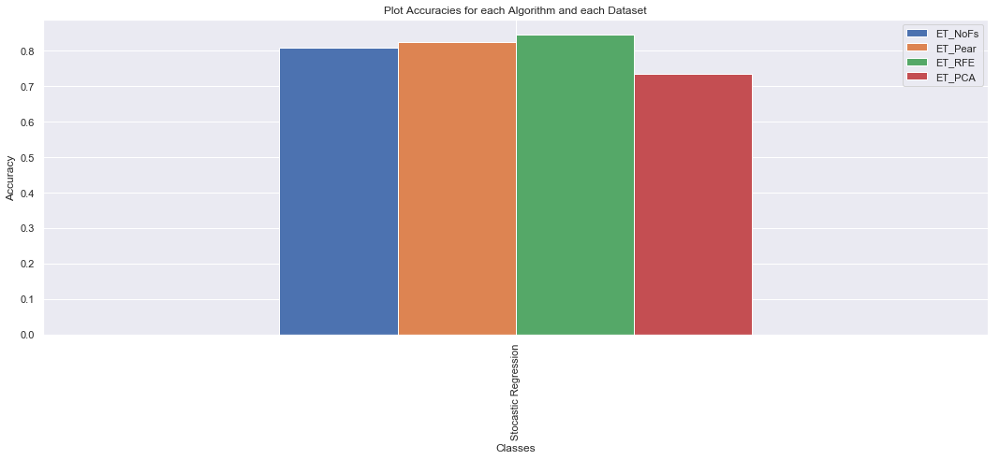

                       ET_NoFs   ET_Pear    ET_RFE    ET_PCA
Stocastic Regression  0.808824  0.823529  0.845588  0.735294


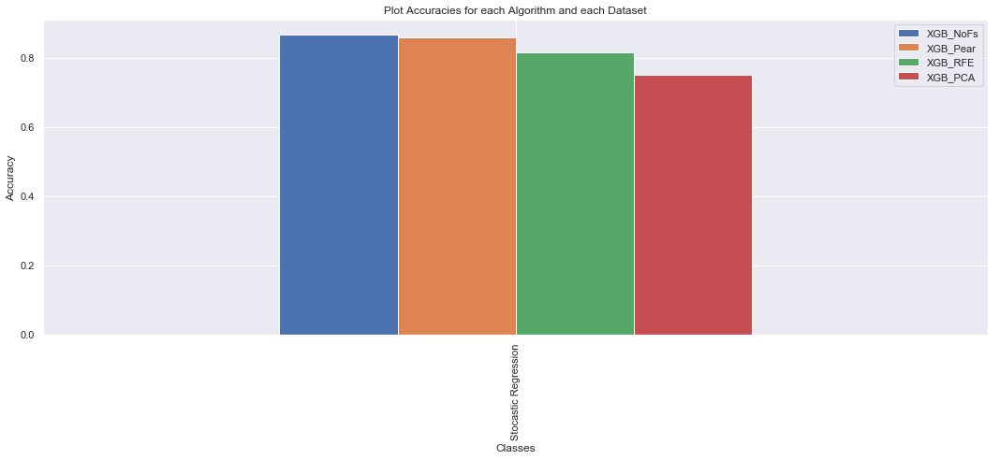

                      XGB_NoFs  XGB_Pear   XGB_RFE  XGB_PCA
Stocastic Regression  0.867647  0.860294  0.816176     0.75


In [67]:
accuracy_overview = pd.DataFrame()

accuracy_overview["ADA_NoFs"] = ensemble_nofs_df_bin['Acc_ADA']
accuracy_overview["GB_NoFs"] = ensemble_nofs_df_bin['Acc_GB']
accuracy_overview["ET_NoFs"] = ensemble_nofs_df_bin['Acc_ET']
accuracy_overview["XGB_NoFs"] = ensemble_nofs_df_bin['Acc_XGB']

accuracy_overview["ADA_Pear"] = ensemble_pear_df_bin['Acc_ADA']
accuracy_overview["GB_Pear"] = ensemble_pear_df_bin['Acc_GB']
accuracy_overview["ET_Pear"] = ensemble_pear_df_bin['Acc_ET']
accuracy_overview["XGB_Pear"] = ensemble_pear_df_bin['Acc_XGB']

accuracy_overview["ADA_RFE"] = ensemble_rfe_df_bin['Acc_ADA']
accuracy_overview["GB_RFE"]  = ensemble_rfe_df_bin['Acc_GB']
accuracy_overview["ET_RFE"]  = ensemble_rfe_df_bin['Acc_ET']
accuracy_overview["XGB_RFE"]  = ensemble_rfe_df_bin['Acc_XGB']

accuracy_overview["ADA_PCA"] = ensemble_pca_df_bin['Acc_ADA']
accuracy_overview["GB_PCA"]  = ensemble_pca_df_bin['Acc_GB']
accuracy_overview["ET_PCA"]  = ensemble_pca_df_bin['Acc_ET']
accuracy_overview["XGB_PCA"]  = ensemble_pca_df_bin['Acc_XGB']

accuracy_overview = accuracy_overview.set_index([["Stocastic Regression"]])

fig, ax = plt.subplots(figsize=(15,7))
accuracy_overview[["ADA_NoFs","ADA_Pear","ADA_RFE","ADA_PCA"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(accuracy_overview[["ADA_NoFs","ADA_Pear","ADA_RFE","ADA_PCA"]])

fig, ax = plt.subplots(figsize=(15,7))
accuracy_overview[["GB_NoFs","GB_Pear","GB_RFE","GB_PCA"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(accuracy_overview[["GB_NoFs","GB_Pear","GB_RFE","GB_PCA"]])

fig, ax = plt.subplots(figsize=(15,7))
accuracy_overview[["ET_NoFs","ET_Pear","ET_RFE","ET_PCA"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(accuracy_overview[["ET_NoFs","ET_Pear","ET_RFE","ET_PCA"]])

fig, ax = plt.subplots(figsize=(15,7))
accuracy_overview[["XGB_NoFs","XGB_Pear","XGB_RFE","XGB_PCA"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(accuracy_overview[["XGB_NoFs","XGB_Pear","XGB_RFE","XGB_PCA"]])



<a id="BOOSTM"></a>
<h3> Algoritmi di Boosting per Classificare il tipo di aritmia<a href="#indice" style="text-decoration:none;">↑</a></h3>

In [68]:
scores_ada_nofs_multi,scores_gb_nofs_multi,scores_et_nofs_multi,scores_xgb_nofs_multi = training_testing_boosting_algorithms_no_FS(Dataset_m,['Stocastic Regression'])

DATASET  Stocastic Regression
ADA-BOOST
Accuracy 0.5161290322580645
Precision 0.3216804029304029
Recall 0.3643849206349206
11
12
TEST
{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11}
PREDETTE
{0, 1, 2, 3, 4, 6, 7, 8, 9, 10, 11}
GRADIENT BOOSTING
Accuracy 0.6612903225806451
Precision 0.5287240537240537
Recall 0.538320962663068
EXTRA TREE
Accuracy 0.6935483870967742
Precision 0.4718406593406594
Recall 0.4744867149758454
X-GRADIENT BOOSTING
Accuracy 0.6774193548387096
Precision 0.4658088235294118
Recall 0.4944978632478632


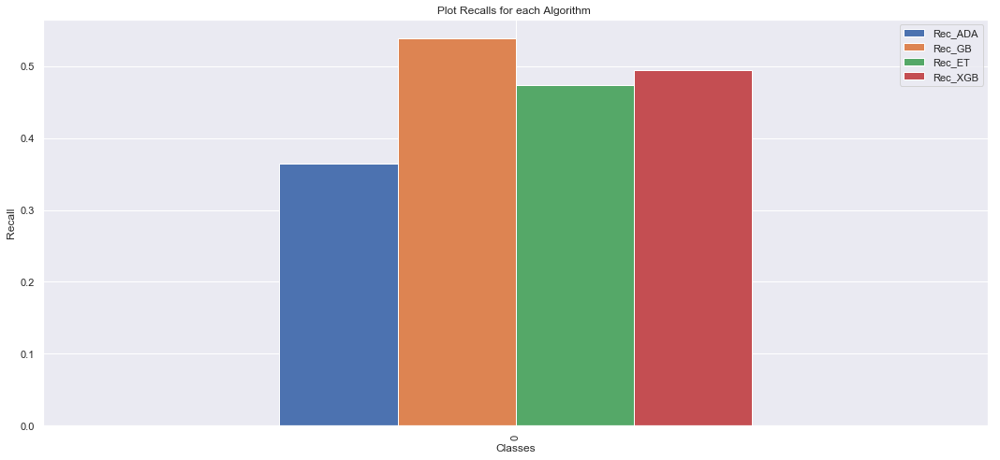

    Rec_ADA    Rec_GB    Rec_ET   Rec_XGB
0  0.364385  0.538321  0.474487  0.494498


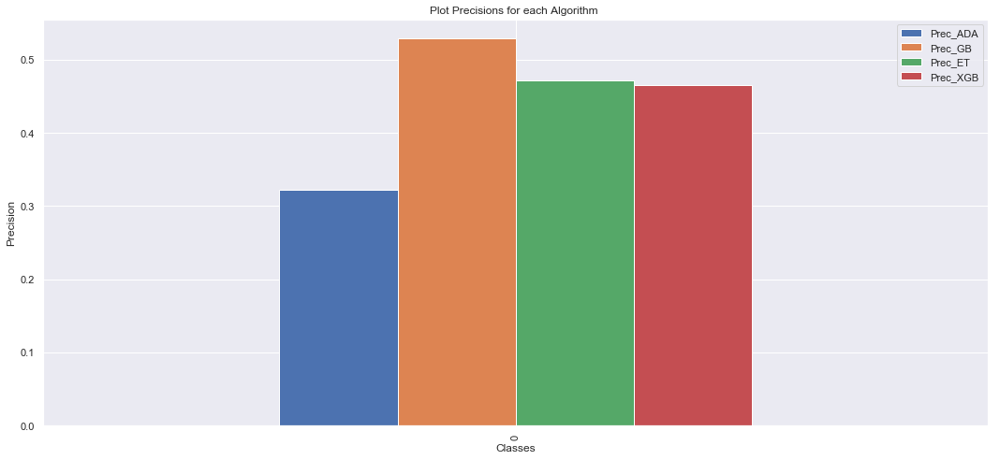

   Prec_ADA   Prec_GB   Prec_ET  Prec_XGB
0   0.32168  0.528724  0.471841  0.465809


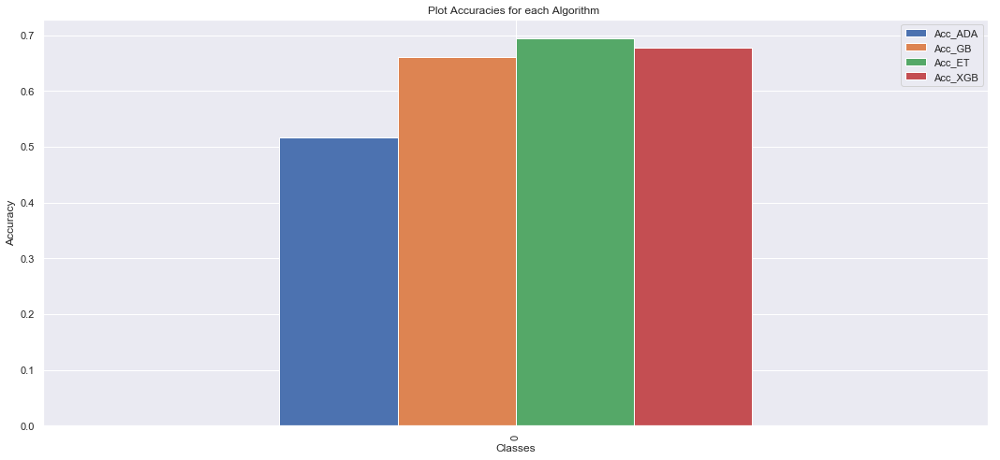

    Acc_ADA   Acc_GB    Acc_ET   Acc_XGB
0  0.516129  0.66129  0.693548  0.677419


In [69]:


ensemble_nofs_df_multi = pd.DataFrame()
ensemble_nofs_df_multi['Acc_ADA'] =  [scores_ada_nofs_multi[0][0]] 
ensemble_nofs_df_multi['Rec_ADA'] =  [scores_ada_nofs_multi[0][1]] 
ensemble_nofs_df_multi['Prec_ADA'] =  [scores_ada_nofs_multi[0][2]] 


ensemble_nofs_df_multi['Acc_GB'] =  [scores_gb_nofs_multi[0][0]] 
ensemble_nofs_df_multi['Rec_GB'] =  [scores_gb_nofs_multi[0][1]] 
ensemble_nofs_df_multi['Prec_GB'] =  [scores_gb_nofs_multi[0][2]] 

ensemble_nofs_df_multi['Acc_ET'] =  [scores_et_nofs_multi[0][0]]
ensemble_nofs_df_multi['Rec_ET'] =  [scores_et_nofs_multi[0][1]] 
ensemble_nofs_df_multi['Prec_ET'] =  [scores_et_nofs_multi[0][2]] 

ensemble_nofs_df_multi['Acc_XGB'] =  [scores_xgb_nofs_multi[0][0]] 
ensemble_nofs_df_multi['Rec_XGB'] =  [scores_xgb_nofs_multi[0][1]] 
ensemble_nofs_df_multi['Prec_XGB'] =  [scores_xgb_nofs_multi[0][2]] 

fig, ax = plt.subplots(figsize=(15,7))
ensemble_nofs_df_multi[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Recalls for each Algorithm ")
ax.set_ylabel('Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_nofs_df_multi[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_nofs_df_multi[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Precisions for each Algorithm ")
ax.set_ylabel('Precision')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_nofs_df_multi[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_nofs_df_multi[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_nofs_df_multi[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']])


In [70]:
scores_ada_rfe_multi,scores_gb_rfe_multi,scores_et_rfe_multi, scores_xgb_rfe_multi = training_testing_boosting_algorithms_RFE(Dataset_m,['Stocastic Regression'])

DATASET  Stocastic Regression
ADA-BOOST
Accuracy 0.5806451612903226
Precision 0.376480463980464
Recall 0.40201914098972913
10
12
TEST
{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11}
PREDETTE
{0, 1, 2, 3, 4, 6, 7, 8, 10, 11}
GRADIENT BOOSTING
Accuracy 0.5967741935483871
Precision 0.39324633699633704
Recall 0.4305555555555555
EXTRA TREE
Accuracy 0.6774193548387096
Precision 0.465430402930403
Recall 0.5254689754689754
X-GRADIENT BOOSTING
Accuracy 0.6290322580645161
Precision 0.4174603174603175
Recall 0.42048992673992674


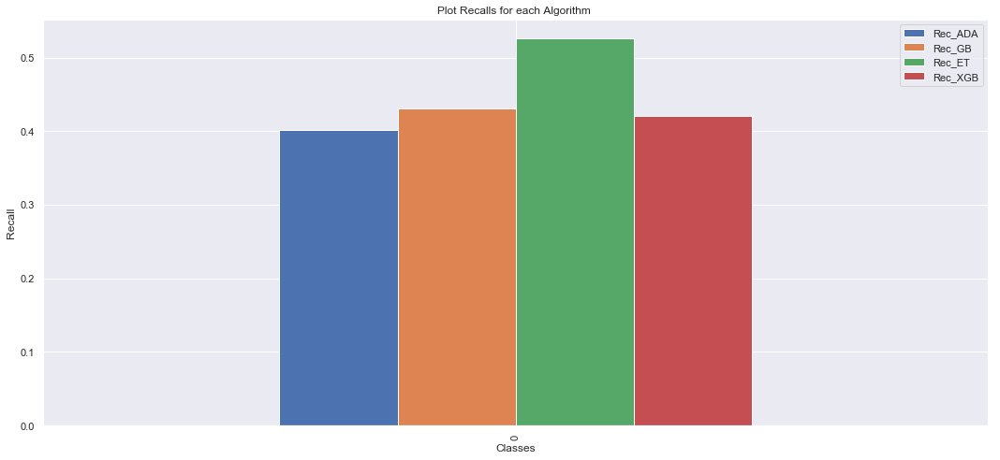

    Rec_ADA    Rec_GB    Rec_ET  Rec_XGB
0  0.402019  0.430556  0.525469  0.42049


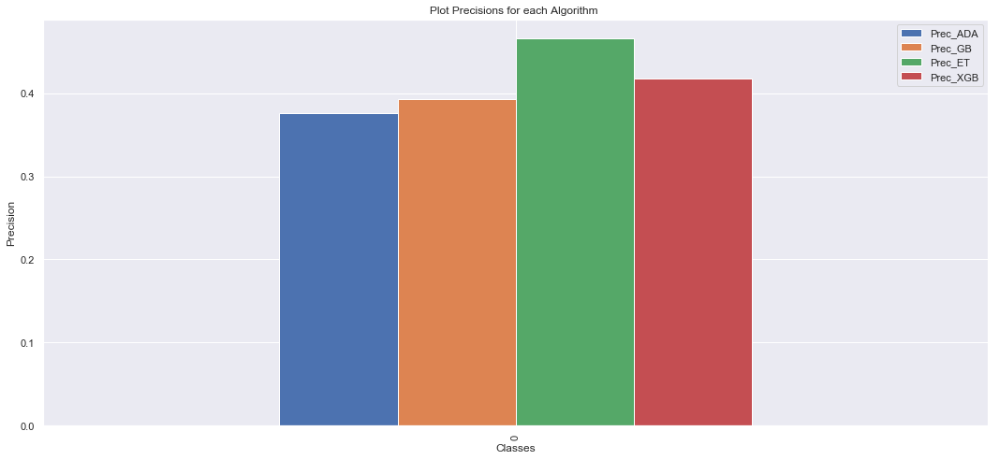

   Prec_ADA   Prec_GB  Prec_ET  Prec_XGB
0   0.37648  0.393246  0.46543   0.41746


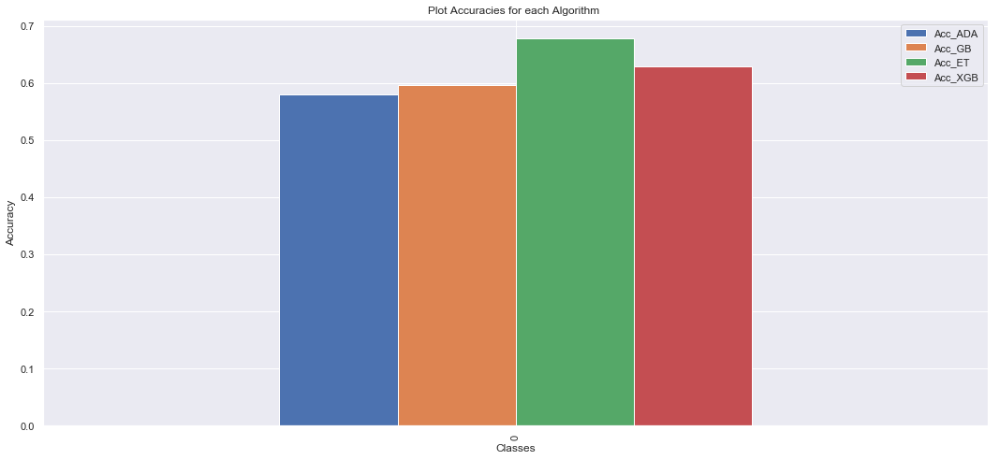

    Acc_ADA    Acc_GB    Acc_ET   Acc_XGB
0  0.580645  0.596774  0.677419  0.629032


In [76]:
ensemble_rfe_df_multi = pd.DataFrame()
ensemble_rfe_df_multi['Acc_ADA'] =  [scores_ada_rfe_multi[0][0]] 
ensemble_rfe_df_multi['Rec_ADA'] =  [scores_ada_rfe_multi[0][1]] 
ensemble_rfe_df_multi['Prec_ADA'] =  [scores_ada_rfe_multi[0][2]] 


ensemble_rfe_df_multi['Acc_GB'] =  [scores_gb_rfe_multi[0][0]] 
ensemble_rfe_df_multi['Rec_GB'] =  [scores_gb_rfe_multi[0][1]] 
ensemble_rfe_df_multi['Prec_GB'] =  [scores_gb_rfe_multi[0][2]] 

ensemble_rfe_df_multi['Acc_ET'] =  [scores_et_rfe_multi[0][0]]
ensemble_rfe_df_multi['Rec_ET'] =  [scores_et_rfe_multi[0][1]] 
ensemble_rfe_df_multi['Prec_ET'] =  [scores_et_rfe_multi[0][2]] 

ensemble_rfe_df_multi['Acc_XGB'] =  [scores_xgb_rfe_multi[0][0]] 
ensemble_rfe_df_multi['Rec_XGB'] =  [scores_xgb_rfe_multi[0][1]] 
ensemble_rfe_df_multi['Prec_XGB'] =  [scores_xgb_rfe_multi[0][2]] 

fig, ax = plt.subplots(figsize=(15,7))
ensemble_rfe_df_multi[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Recalls for each Algorithm ")
ax.set_ylabel('Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_rfe_df_multi[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_rfe_df_multi[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Precisions for each Algorithm ")
ax.set_ylabel('Precision')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_rfe_df_multi[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_rfe_df_multi[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_rfe_df_multi[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']])


In [71]:
scores_ada_pearson_multi,scores_gb_pearson_multi,scores_et_pearson_multi,scores_xgb_pearson_multi =training_testing_boosting_algorithms_Pearson(Dataset_m,['Stocastic Regression'])

DATASET  Stocastic Regression
ADA-BOOST
Accuracy 0.5161290322580645
Precision 0.3147359584859585
Recall 0.3752509337068161
11
12
TEST
{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11}
PREDETTE
{0, 1, 2, 3, 4, 5, 7, 8, 9, 10, 11}
GRADIENT BOOSTING
Accuracy 0.6451612903225806
Precision 0.5257478632478633
Recall 0.48970985155195684
EXTRA TREE
Accuracy 0.6774193548387096
Precision 0.4703525641025641
Recall 0.4661823062558357
X-GRADIENT BOOSTING
Accuracy 0.6290322580645161
Precision 0.43368055555555557
Recall 0.44727564102564105


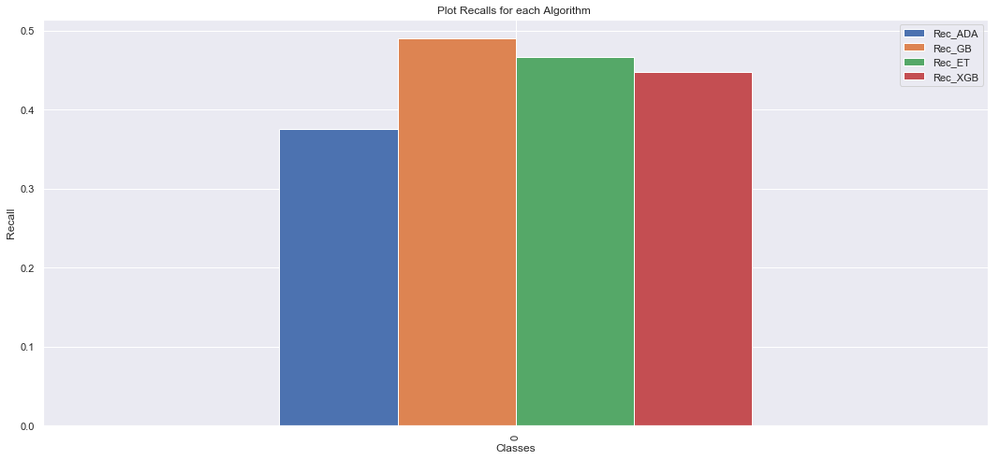

    Rec_ADA   Rec_GB    Rec_ET   Rec_XGB
0  0.375251  0.48971  0.466182  0.447276


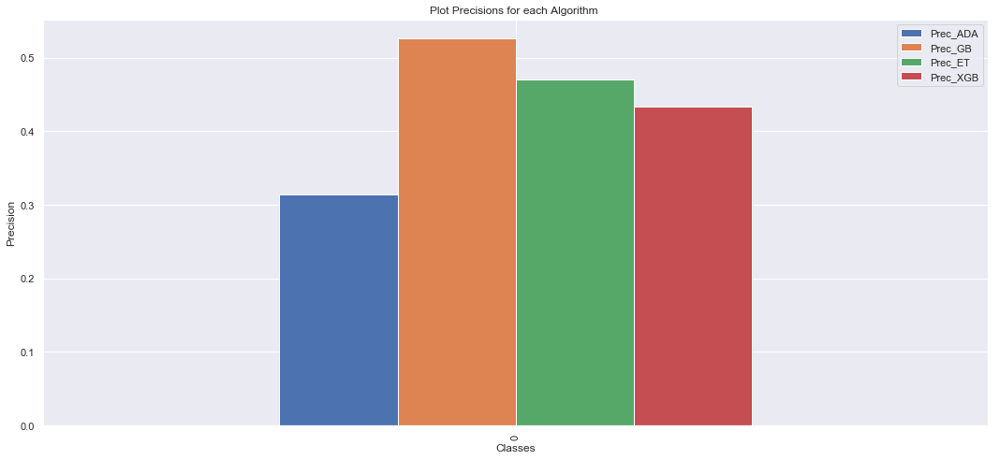

   Prec_ADA   Prec_GB   Prec_ET  Prec_XGB
0  0.314736  0.525748  0.470353  0.433681


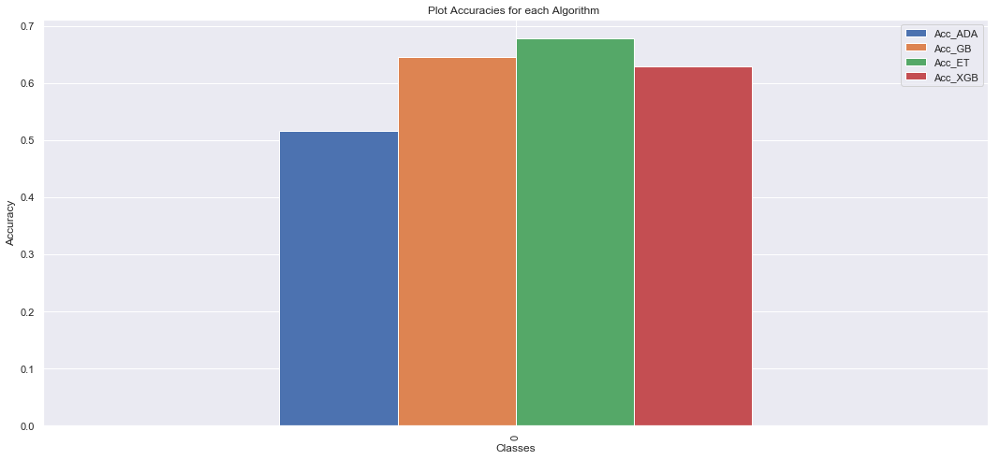

    Acc_ADA    Acc_GB    Acc_ET   Acc_XGB
0  0.516129  0.645161  0.677419  0.629032


In [72]:
ensemble_pear_df_multi = pd.DataFrame()
ensemble_pear_df_multi['Acc_ADA'] =  [scores_ada_pearson_multi[0][0]] 
ensemble_pear_df_multi['Rec_ADA'] =  [scores_ada_pearson_multi[0][1]] 
ensemble_pear_df_multi['Prec_ADA'] =  [scores_ada_pearson_multi[0][2]] 


ensemble_pear_df_multi['Acc_GB'] =  [scores_gb_pearson_multi[0][0]] 
ensemble_pear_df_multi['Rec_GB'] =  [scores_gb_pearson_multi[0][1]] 
ensemble_pear_df_multi['Prec_GB'] =  [scores_gb_pearson_multi[0][2]] 

ensemble_pear_df_multi['Acc_ET'] =  [scores_et_pearson_multi[0][0]]
ensemble_pear_df_multi['Rec_ET'] =  [scores_et_pearson_multi[0][1]] 
ensemble_pear_df_multi['Prec_ET'] =  [scores_et_pearson_multi[0][2]] 

ensemble_pear_df_multi['Acc_XGB'] =  [scores_xgb_pearson_multi[0][0]] 
ensemble_pear_df_multi['Rec_XGB'] =  [scores_xgb_pearson_multi[0][1]] 
ensemble_pear_df_multi['Prec_XGB'] =  [scores_xgb_pearson_multi[0][2]] 

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pear_df_multi[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Recalls for each Algorithm ")
ax.set_ylabel('Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pear_df_multi[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pear_df_multi[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Precisions for each Algorithm ")
ax.set_ylabel('Precision')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pear_df_multi[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pear_df_multi[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pear_df_multi[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']])


In [73]:
scores_ada_pca_multi,scores_gb_pca_multi,scores_et_pca_multi,scores_xgb_pca_multi = training_testing_boosting_algorithms_PCA(Dataset_m,['Stocastic Regression'])

DATASET  Stocastic Regression
ADA-BOOST
Accuracy 0.3709677419354839
Precision 0.2684218559218559
Recall 0.2910714285714286
9
12
TEST
{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11}
PREDETTE
{0, 1, 2, 4, 6, 7, 8, 9, 11}
GRADIENT BOOSTING
Accuracy 0.4838709677419355
Precision 0.31820818070818074
Recall 0.33512293806411453
EXTRA TREE
Accuracy 0.5645161290322581
Precision 0.34348290598290593
Recall 0.3528619528619528
X-GRADIENT BOOSTING
Accuracy 0.41935483870967744
Precision 0.26249999999999996
Recall 0.2686431623931624


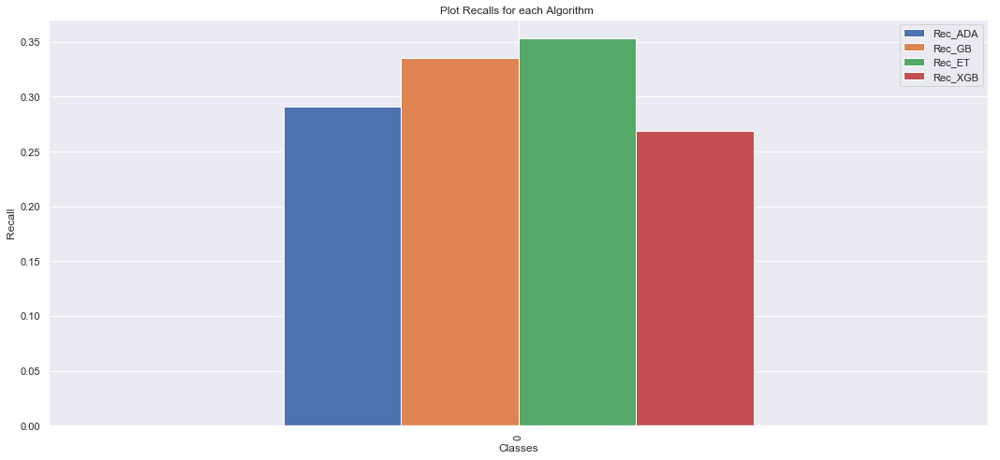

    Rec_ADA    Rec_GB    Rec_ET   Rec_XGB
0  0.291071  0.335123  0.352862  0.268643


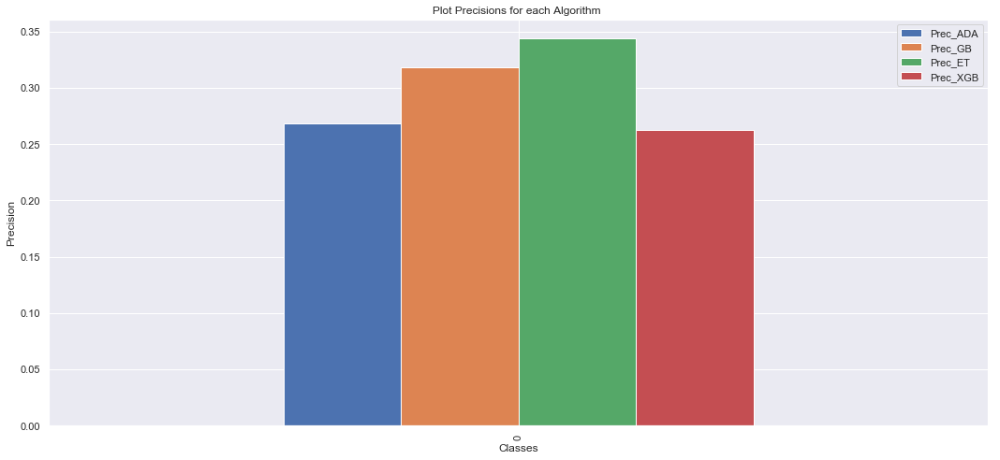

   Prec_ADA   Prec_GB   Prec_ET  Prec_XGB
0  0.268422  0.318208  0.343483    0.2625


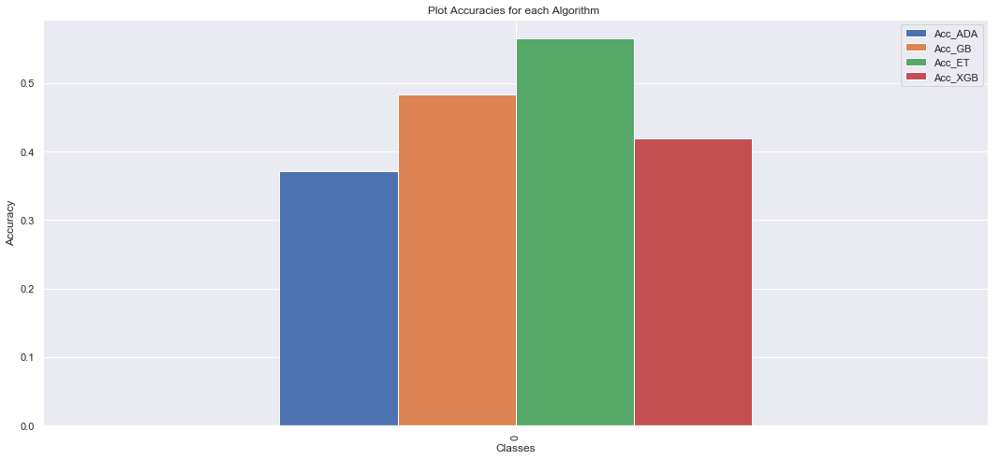

    Acc_ADA    Acc_GB    Acc_ET   Acc_XGB
0  0.370968  0.483871  0.564516  0.419355


In [74]:

ensemble_pca_df_multi = pd.DataFrame()

ensemble_pca_df_multi['Acc_ADA'] =  [scores_ada_pca_multi[0][0]]
ensemble_pca_df_multi['Rec_ADA'] =  [scores_ada_pca_multi[0][1]] 
ensemble_pca_df_multi['Prec_ADA'] =  [scores_ada_pca_multi[0][2]]

ensemble_pca_df_multi['Acc_GB'] =  [scores_gb_pca_multi[0][0]] 
ensemble_pca_df_multi['Rec_GB'] =  [scores_gb_pca_multi[0][1]] 
ensemble_pca_df_multi['Prec_GB'] =  [scores_gb_pca_multi[0][2]] 

ensemble_pca_df_multi['Acc_ET'] =  [scores_et_pca_multi[0][0]] 
ensemble_pca_df_multi['Rec_ET'] =  [scores_et_pca_multi[0][1]] 
ensemble_pca_df_multi['Prec_ET'] =  [scores_et_pca_multi[0][2]]

ensemble_pca_df_multi['Acc_XGB'] =  [scores_xgb_pca_multi[0][0]] 
ensemble_pca_df_multi['Rec_XGB'] =  [scores_xgb_pca_multi[0][1]] 
ensemble_pca_df_multi['Prec_XGB'] =  [scores_xgb_pca_multi[0][2]]
fig, ax = plt.subplots(figsize=(15,7))
ensemble_pca_df_multi[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Recalls for each Algorithm ")
ax.set_ylabel('Recall')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pca_df_multi[['Rec_ADA','Rec_GB','Rec_ET','Rec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pca_df_multi[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Precisions for each Algorithm ")
ax.set_ylabel('Precision')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pca_df_multi[['Prec_ADA','Prec_GB','Prec_ET','Prec_XGB']])

fig, ax = plt.subplots(figsize=(15,7))
ensemble_pca_df_multi[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(ensemble_pca_df_multi[['Acc_ADA','Acc_GB','Acc_ET','Acc_XGB']])


In [78]:
accuracy_overview = pd.DataFrame()

accuracy_overview["ADA_NoFs"] = ensemble_nofs_df_multi['Acc_ADA']
accuracy_overview["GB_NoFs"] = ensemble_nofs_df_multi['Acc_GB']
accuracy_overview["ET_NoFs"] = ensemble_nofs_df_multi['Acc_ET']
accuracy_overview["XGB_NoFs"] = ensemble_nofs_df_multi['Acc_XGB']

accuracy_overview["ADA_Pear"] = ensemble_pear_df_multi['Acc_ADA']
accuracy_overview["GB_Pear"] = ensemble_pear_df_multi['Acc_GB']
accuracy_overview["ET_Pear"] = ensemble_pear_df_multi['Acc_ET']
accuracy_overview["XGB_Pear"] = ensemble_pear_df_multi['Acc_XGB']

accuracy_overview["ADA_RFE"] = ensemble_rfe_df_multi['Acc_ADA']
accuracy_overview["GB_RFE"]  = ensemble_rfe_df_multi['Acc_GB']
accuracy_overview["ET_RFE"]  = ensemble_rfe_df_multi['Acc_ET']
accuracy_overview["XGB_RFE"]  = ensemble_rfe_df_multi['Acc_XGB']

accuracy_overview["ADA_PCA"] = ensemble_pca_df_multi['Acc_ADA']
accuracy_overview["GB_PCA"]  = ensemble_pca_df_multi['Acc_GB']
accuracy_overview["ET_PCA"]  = ensemble_pca_df_multi['Acc_ET']
accuracy_overview["XGB_PCA"]  = ensemble_pca_df_multi['Acc_XGB']

accuracy_overview = accuracy_overview.set_index([["Stocastic Regression"]])



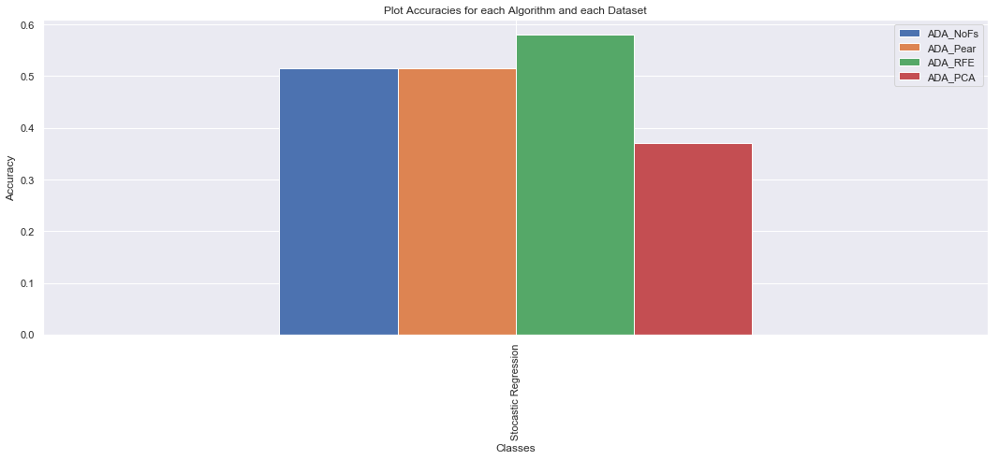

                      ADA_NoFs  ADA_Pear   ADA_RFE   ADA_PCA
Stocastic Regression  0.516129  0.516129  0.580645  0.370968


In [79]:
fig, ax = plt.subplots(figsize=(15,7))
accuracy_overview[["ADA_NoFs","ADA_Pear","ADA_RFE","ADA_PCA"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(accuracy_overview[["ADA_NoFs","ADA_Pear","ADA_RFE","ADA_PCA"]])



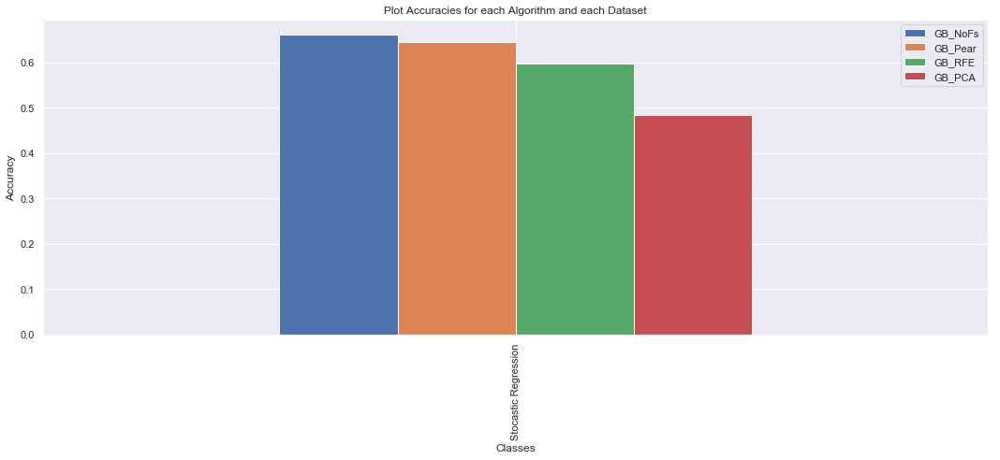

                      GB_NoFs   GB_Pear    GB_RFE    GB_PCA
Stocastic Regression  0.66129  0.645161  0.596774  0.483871


In [80]:
fig, ax = plt.subplots(figsize=(15,7))
accuracy_overview[["GB_NoFs","GB_Pear","GB_RFE","GB_PCA"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(accuracy_overview[["GB_NoFs","GB_Pear","GB_RFE","GB_PCA"]])


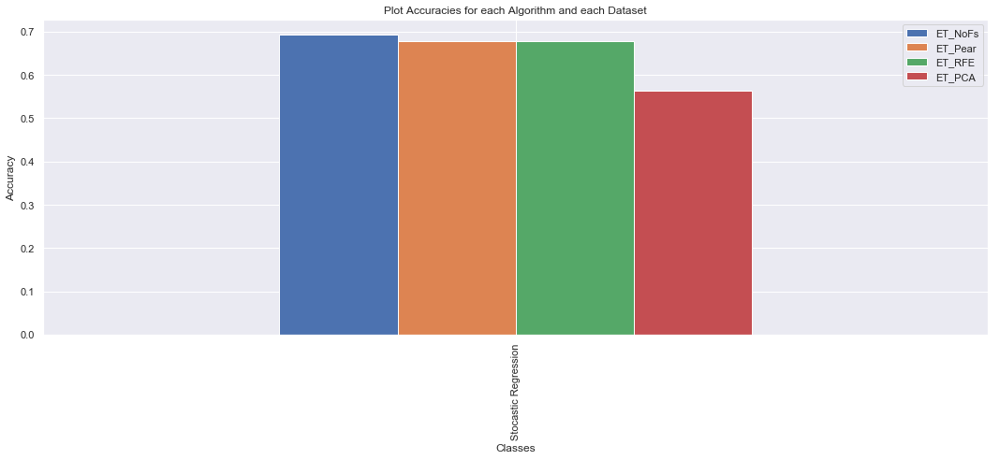

                       ET_NoFs   ET_Pear    ET_RFE    ET_PCA
Stocastic Regression  0.693548  0.677419  0.677419  0.564516


In [81]:

fig, ax = plt.subplots(figsize=(15,7))
accuracy_overview[["ET_NoFs","ET_Pear","ET_RFE","ET_PCA"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(accuracy_overview[["ET_NoFs","ET_Pear","ET_RFE","ET_PCA"]])



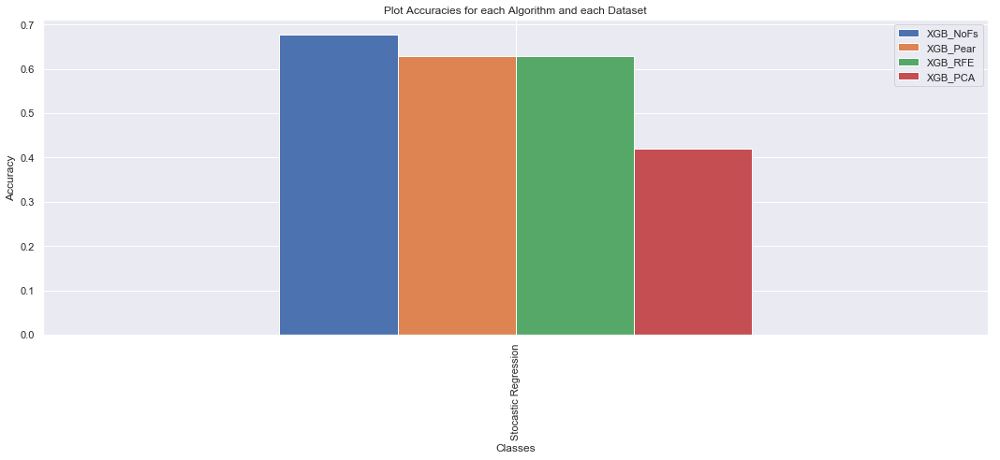

                      XGB_NoFs  XGB_Pear   XGB_RFE   XGB_PCA
Stocastic Regression  0.677419  0.629032  0.629032  0.419355


In [82]:
fig, ax = plt.subplots(figsize=(15,7))
accuracy_overview[["XGB_NoFs","XGB_Pear","XGB_RFE","XGB_PCA"]].plot(kind="bar",ax=ax)
ax.set_title("Plot Accuracies for each Algorithm and each Dataset")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Classes')
fig.tight_layout()
plt.show()
print(accuracy_overview[["XGB_NoFs","XGB_Pear","XGB_RFE","XGB_PCA"]])


<a id="MLPB"></a>
<h3> MLP per capire se un paziente è malato o meno <a href="#indice" style="text-decoration:none;">↑</a></h3>




In [85]:


def MLP_Binary(x_train,y_train_in,x_test,y_test_in):
    print(set(y_train_in))
    print(len(set(y_train_in)))
    n_classes = len(set(y_train_in))
    num_features = x_train.shape[1]
    # 1 to k
    print(x_train.shape)
    y_train_cat = []
    for i in range(len(y_train_in)):
        y_train_cat.append(keras.utils.to_categorical(y_train_in[i], num_classes=len(set(y_train_in))))
    y_train = np.asarray(y_train_cat)
    linmodel = keras.models.Sequential()
    linmodel.add(keras.layers.Dense(units=400, input_dim=num_features,activation='relu'))
    linmodel.add(keras.layers.Dropout(0.2))
    linmodel.add(keras.layers.Dense(units=1000,activation='relu'))
    linmodel.add(keras.layers.Dropout(0.2))
    linmodel.add(keras.layers.Dense(units=500,activation='relu'))
    linmodel.add(keras.layers.Dropout(0.2))
    #linmodel.add(keras.layers.Dense(units=8 ,activation='relu'))
    linmodel.add(keras.layers.Dense(units=len(set(y_train_in)), activation='softmax'))

    linmodel.compile(optimizer='adam', loss='binary_crossentropy',
                            metrics=['accuracy'])
    epochs = 30
    linhistory = linmodel.fit(x_train, 
                              y_train,
                              validation_split=0.1,
                              epochs=epochs, 
                              batch_size=32,
                              verbose=1)
    print(linmodel.summary())
    plt.figure(figsize=(5,3))
    plt.plot(linhistory.epoch,linhistory.history['loss'])
    plt.title('loss')

    plt.figure(figsize=(5,3))
    plt.plot(linhistory.epoch,linhistory.history['accuracy'])
    plt.title('accuracy');

  
    
    
    predictions = linmodel.predict(x_test)
    y_test_cat = []
    for i in range(len(y_test_in)):
        y_test_cat.append(keras.utils.to_categorical(y_test_in[i], num_classes=len(set(y_train_in))))
    y_test = np.asarray(y_test_cat)
    print(linmodel.evaluate(x_test,y_test))
    return(linmodel.evaluate(x_test,y_test))

In [ ]:
x_train = Dataset[0][0]
y_train= Dataset[0][1]

x_test = Dataset[0][2]
y_test = Dataset[0][3]
scoresNN_bin = (MLP_Binary(x_train,y_train,x_test,y_test)[1])

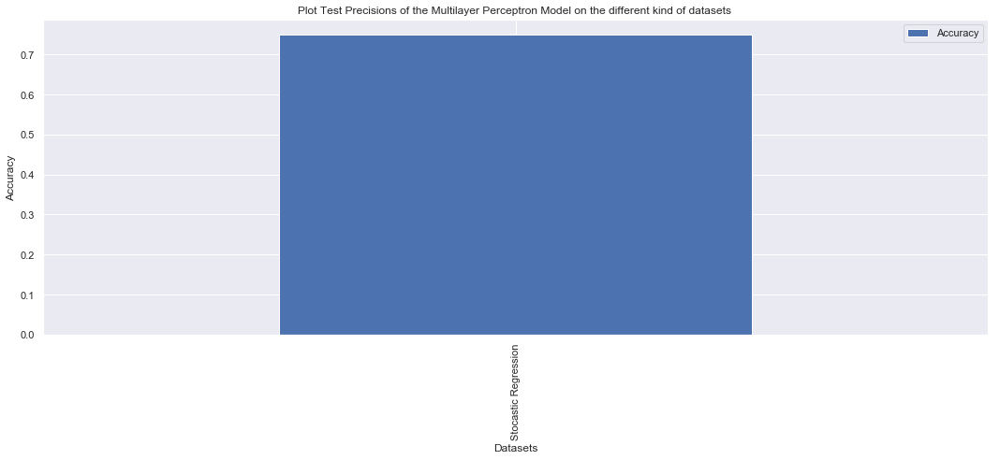

,Accuracy
Stocastic Regression,0.75


In [94]:
dic_mlp = {
    "Accuracy": scoresNN_bin
}
accuracy_mlp_df = pd.DataFrame(dic_mlp,index=['Stocastic Regression'])
fig, ax = plt.subplots(figsize=(15,7))
accuracy_mlp_df.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Precisions of the Multilayer Perceptron Model on the different kind of datasets ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
accuracy_mlp_df

<a id="MLPM"></a>
<h3> MLP per Classificare il tipo di aritmia<a href="#indice" style="text-decoration:none;">↑</a></h3>



In [ ]:
scores_multi = (MLP(X_train_multi,y_train_multi,X_test_multi,y_test_multi)[1])

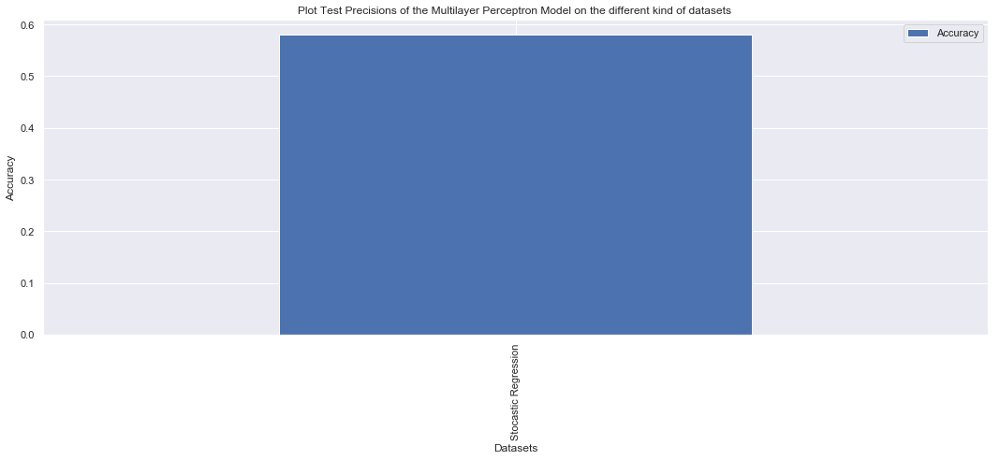

,Accuracy
Stocastic Regression,0.580645


In [72]:
dic_mlp = {
    "Accuracy": scores_multi
}
accuracy_mlp_df = pd.DataFrame(dic_mlp,index=['Stocastic Regression'])
fig, ax = plt.subplots(figsize=(15,7))
accuracy_mlp_df.plot(kind="bar",ax=ax)
ax.set_title("Plot Test Precisions of the Multilayer Perceptron Model on the different kind of datasets ")
ax.set_ylabel('Accuracy')
ax.set_xlabel('Datasets')
fig.tight_layout()
plt.show()
accuracy_mlp_df

<a id="FinalChoice"></a>
<h3> Analisi delle performance e scelta dei due classificatori per l'architettura<a href="#indice" style="text-decoration:none;">↑</a></h3>


##### Analisi delle Accuracy dei modelli per la classificazione Binaria

<style type="text/css">
.tg  {border-collapse:collapse;border-spacing:0;}
.tg td{font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;}
.tg th{font-family:Arial, sans-serif;font-size:14px;font-weight:normal;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;}
.tg .tg-qrkk{background-color:#fe996b;border-color:#000000;text-align:left;vertical-align:top}
.tg .tg-xpce{font-weight:bold;background-color:#67fd9a;text-align:center;vertical-align:top}
.tg .tg-baqh{text-align:center;vertical-align:top}
.tg .tg-w747{background-color:#dae8fc;text-align:left;vertical-align:top}
.tg .tg-c3ow{border-color:inherit;text-align:center;vertical-align:top}
.tg .tg-0pky{border-color:inherit;text-align:left;vertical-align:top}
.tg .tg-x6qq{background-color:#dae8fc;border-color:inherit;text-align:left;vertical-align:top}
.tg .tg-7btt{font-weight:bold;border-color:inherit;text-align:center;vertical-align:top}
.tg .tg-amwm{font-weight:bold;text-align:center;vertical-align:top}
</style>
<table class="tg">
  <tr>
    <th class="tg-0pky"></th>
    <th class="tg-qrkk">Pearson</th>
    <th class="tg-qrkk">RFE</th>
    <th class="tg-qrkk">NOFS</th>
    <th class="tg-qrkk">PCA</th>
  </tr>
  <tr>
    <td class="tg-x6qq">SVM</td>
    <td class="tg-c3ow">0.54</td>
    <td class="tg-c3ow">0.73</td>
    <td class="tg-7btt">0.81</td>
    <td class="tg-c3ow">0.54</td>
  </tr>
  <tr>
    <td class="tg-x6qq">Random Forest</td>
    <td class="tg-7btt">0.83</td>
    <td class="tg-c3ow">0.82</td>
    <td class="tg-c3ow">0.73</td>
    <td class="tg-c3ow">0.74</td>
  </tr>
  <tr>
    <td class="tg-x6qq">ADA Boost</td>
    <td class="tg-c3ow">0.79</td>
    <td class="tg-7btt">0.80</td>
    <td class="tg-c3ow">0.76</td>
    <td class="tg-c3ow">0.74</td>
  </tr>
  <tr>
    <td class="tg-w747">Extra Trees</td>
    <td class="tg-baqh">0.82</td>
    <td class="tg-amwm">0.85</td>
    <td class="tg-baqh">0.81</td>
    <td class="tg-baqh">0.74</td>
  </tr>
  <tr>
    <td class="tg-w747">Gradient Boosting</td>
    <td class="tg-amwm">0.87</td>
    <td class="tg-baqh">0.81</td>
    <td class="tg-baqh">0.86</td>
    <td class="tg-baqh">0.78</td>
  </tr>
  <tr>
    <td class="tg-w747">XGradient Boosting</td>
    <td class="tg-baqh">0.86<br></td>
    <td class="tg-baqh">0.82</td>
    <td class="tg-xpce">0.87</td>
    <td class="tg-baqh">0.75</td>
  </tr>
  <tr>
    <td class="tg-w747">Logistic Regression</td>
    <td class="tg-amwm">0.82</td>
    <td class="tg-baqh">0.79</td>
    <td class="tg-amwm">0.82</td>
    <td class="tg-baqh">0.78</td>
  </tr>
  <tr>
    <td class="tg-w747">MLP<br></td>
    <td class="tg-baqh">X</td>
    <td class="tg-baqh">X</td>
    <td class="tg-amwm">0.75</td>
    <td class="tg-baqh">X</td>
  </tr>
  <tr>
    <td class="tg-w747">K-NN</td>
    <td class="tg-baqh">0.64<br></td>
    <td class="tg-amwm">0.75</td>
    <td class="tg-baqh">0.65</td>
    <td class="tg-baqh">0.67</td>
  </tr>
</table>

Osserviamo esplicitamente che i modell con le migliori perfomance in termini di Accuracy sono il <strong>Gradient Boosting utilizzando la Pearson Correlation</strong> per effettuare Feature Selection e l'<strong>Extreme Gradient Boosting senza utilizzare Feature Selection o PCA</strong>. 

Essi hanno gli stessi score di Precision e Recall.
Possiamo scegliere come classificatore binario uno dei due.



#### Analisi delle Accuracy dei modelli per la rilevazione del tipo di malattia (Classificazione Multiclasse)

<style type="text/css">
.tg  {border-collapse:collapse;border-spacing:0;}
.tg td{font-family:Arial, sans-serif;font-size:14px;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;}
.tg th{font-family:Arial, sans-serif;font-size:14px;font-weight:normal;padding:10px 5px;border-style:solid;border-width:1px;overflow:hidden;word-break:normal;border-color:black;}
.tg .tg-c3ow{border-color:inherit;text-align:center;vertical-align:top}
.tg .tg-0pky{border-color:inherit;text-align:left;vertical-align:top}
</style>
<table class="tg">
  <tr>
    <th class="tg-0pky"></th>
    <th class="tg-0pky">Pearson</th>
    <th class="tg-0pky">RFE</th>
    <th class="tg-0pky">NOFS</th>
    <th class="tg-0pky">PCA</th>
  </tr>
  <tr>
    <td class="tg-0pky">SVM</td>
    <td class="tg-c3ow">0.60</td>
    <td class="tg-c3ow">0.57</td>
    <td class="tg-c3ow">0.55</td>
    <td class="tg-c3ow">0.61</td>
  </tr>
  <tr>
    <td class="tg-0pky">Random Forest</td>
    <td class="tg-c3ow">0.69</td>
    <td class="tg-c3ow">0.61</td>
    <td class="tg-c3ow">0.66</td>
    <td class="tg-c3ow">0.58</td>
  </tr>
  <tr>
    <td class="tg-0pky">ADA Boost</td>
    <td class="tg-c3ow">0.52</td>
    <td class="tg-c3ow">0.58</td>
    <td class="tg-c3ow">0.52</td>
    <td class="tg-c3ow">0.37</td>
  </tr>
  <tr>
    <td class="tg-0pky">Extra Trees</td>
    <td class="tg-c3ow">0.68</td>
    <td class="tg-c3ow">0.68</td>
    <td class="tg-c3ow">0.69</td>
    <td class="tg-c3ow">0.56</td>
  </tr>
  <tr>
    <td class="tg-0pky">Gradient Boosting</td>
    <td class="tg-c3ow">0.65</td>
    <td class="tg-c3ow">0.60</td>
    <td class="tg-c3ow">0.66</td>
    <td class="tg-c3ow">0.48</td>
  </tr>
  <tr>
    <td class="tg-0pky">XGradient Boosting</td>
    <td class="tg-c3ow">0.63</td>
    <td class="tg-c3ow">0.63</td>
    <td class="tg-c3ow">0.68</td>
    <td class="tg-c3ow">0.42</td>
  </tr>
  <tr>
    <td class="tg-0pky">Logistic Regression</td>
    <td class="tg-c3ow">0.68</td>
    <td class="tg-c3ow">0.64</td>
    <td class="tg-c3ow">0.69</td>
    <td class="tg-c3ow">0.56</td>
  </tr>
  <tr>
    <td class="tg-0pky">MLP<br></td>
    <td class="tg-c3ow">X</td>
    <td class="tg-c3ow">X</td>
    <td class="tg-c3ow">0.58</td>
    <td class="tg-c3ow">X</td>
  </tr>
  <tr>
    <td class="tg-0pky">K-NN</td>
    <td class="tg-c3ow">0.55</td>
    <td class="tg-c3ow">0.56</td>
    <td class="tg-c3ow">0.48</td>
    <td class="tg-c3ow">0.44</td>
  </tr>
</table>

Osserviamo esplicitamente che i modell con le migliori perfomance in termini di Accuracy sono il Random Forest utilizzando Pearson Correlation per la Feature Selection, Extra Trees senza utilizzare Feature Selection o PCA, e la Logistic Regression senza utillizare PCA o Feature Selection.

<strong>La Logistic Regression, però, risulta avere score di Precision e Recall più alti rispetto agli altri due modelli.</strong>

Quindi Scegliamo di utilizzare Logistic Regression come secondo classificatore

